# *Forecasting of time series*

__Introduction__

In this notebook, we aim to forecast the time series we have using different methods.
We will first forecast each time serie based on its own data. Then using the clustering we obtained with the clustering algorithms, we will forecast the time series by groups defined by their type.
Finally, we will use the very big set of time series from darts (approximately 48'000 time series), to fit our forecasting algorithms and to predict the behavior of the time series. Naturally, we will also do a grid search to choose for the best hyperparameters of each model.
Ultimately, the goal will be to predict the compare the different forecasting methods and to choose the best one.

IMPORTING LIBRARIES

Before we get started, let's import all necessary libraries for performing our time series classification:

In [2]:
%matplotlib inline

import warnings

warnings.filterwarnings("ignore")


import optuna
from optuna.integration import PyTorchLightningPruningCallback
from pytorch_lightning.callbacks import EarlyStopping
import os
import time
import random
import pandas as pd
import pickle
import numpy as np
from tqdm.auto import tqdm
from datetime import datetime
from itertools import product
import torch
from torch import nn
from typing import List, Tuple, Dict
from sklearn.preprocessing import MaxAbsScaler
from sklearn.linear_model import Ridge
import matplotlib.pyplot as plt
from itertools import chain


from darts import TimeSeries
from darts.utils import statistics
from darts.utils.losses import SmapeLoss
from darts.dataprocessing.transformers import Scaler
from darts.metrics import smape
from darts.utils.utils import SeasonalityMode, TrendMode, ModelMode
from darts.models import *
from darts.datasets import AirPassengersDataset
from darts.models import TCNModel
from darts.utils.likelihood_models import GaussianLikelihood

Let us now import the files we will need to forecast our time series.

In [3]:
infile_dfindices = open('data_indices/dfindices_timeseries','rb')
dfindices = pickle.load(infile_dfindices)
infile_dfindices.close()

In [4]:
infile_dfcluster = open('data_indices/df_tm_tocluster','rb')
dfcluster = pickle.load(infile_dfcluster)
infile_dfcluster.close()

In [5]:
infile_df_interpolation = open('data_indices/df_interpolation_ratio','rb')
df_interpolation = pickle.load(infile_df_interpolation)
infile_df_interpolation.close()

In [6]:
def simple_exp_smooth(d,alpha=0.4):  
    mylist= d  # Transform the input into a numpy array 
    cols = len(mylist)  # Historical period length  

    f = list(np.full(cols,np.nan))  # Forecast array  
    f[0] = mylist[0]  # initialization of first forecast  
      # Create all the t+1 forecasts until end of historical period  
    for t in range(1,cols):  
        f[t] = alpha*mylist[t-1]+(1-alpha)*f[t-1]  
    return f

<div class="alert-info">
1. Filtering the dataframe by interpolation ratio
</div>

As done before, we aim to forecast and consider only the time series that are meaningful, which means the time series that have a low interpolation ratio. This is done to avoid useless noise in our analyses and forecasting. For this reason, we keep only the time series with less than 50% of interpolation ratio.

In [7]:
dfcluster

,concept1,concept2,index,cluster
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,0.0
1,Authentication protocole,Biometrics,index_cit_t1_t2,5.0
2,Authentication protocole,Blockchain,index_cit_t1_t2,5.0
3,Authentication protocole,Digital rights management,index_cit_t1_t2,5.0
4,Authentication protocole,Digital signature,index_cit_t1_t2,5.0
...,...,...,...,...
3120,Zero-knowlegde proof,Symmetric-key algorithm,index_keyword,2.0
3121,Zero-knowlegde proof,Threshold cryptosystem,index_keyword,NaN
3122,Zero-knowlegde proof,Trusted Computing,index_keyword,4.0
3123,Zero-knowlegde proof,Tunneling protocol,index_keyword,NaN


In [8]:
dfindices

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword
0,Authentication protocole,Authentication protocole,1-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,2-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,3-01-2,0.0,0.0,2.699103,2.699103,1.720479
0,Authentication protocole,Authentication protocole,4-01-2,0.836174,0.836174,13.808524,13.77767,7.22864
0,Authentication protocole,Authentication protocole,5-01-2,0.0,0.0,6.284266,6.284266,3.355919
...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,8-01-22,0.0,0.0,54.317264,28.72956,8.031585
624,Zero-knowlegde proof,Zero-knowlegde proof,9-01-22,0.0,0.0,19.811067,19.811067,8.877465
624,Zero-knowlegde proof,Zero-knowlegde proof,10-01-22,6.706388,6.706388,48.748713,44.762499,14.777641
624,Zero-knowlegde proof,Zero-knowlegde proof,11-01-22,0.0,0.0,24.238745,16.901309,6.616964


In [9]:
df_interpolation

,concept1,concept2,interpolation_ratio
548,Threshold cryptosystem,Tunneling protocol,0.944444
596,Tunneling protocol,Threshold cryptosystem,0.944444
577,Tunneling protocol,Blockchain,0.928571
73,Blockchain,Tunneling protocol,0.928571
589,Tunneling protocol,Link encryption,0.924603
...,...,...,...
110,Digital signature,Hash function,0.007937
410,Public-key cryptography,Hash function,0.000000
416,Public-key cryptography,Public-key cryptography,0.000000
266,Hash function,Public-key cryptography,0.000000


In [10]:
df_interpolation.loc[df_interpolation['interpolation_ratio']>=0.5]

,concept1,concept2,interpolation_ratio
548,Threshold cryptosystem,Tunneling protocol,0.944444
596,Tunneling protocol,Threshold cryptosystem,0.944444
577,Tunneling protocol,Blockchain,0.928571
73,Blockchain,Tunneling protocol,0.928571
589,Tunneling protocol,Link encryption,0.924603
...,...,...,...
227,Hardware security module,Blockchain,0.531746
69,Blockchain,Random number generation,0.503968
477,Random number generation,Blockchain,0.503968
602,Zero-knowlegde proof,Blockchain,0.500000


In [11]:
list_concepts= ['Authentication protocole','Biometrics','Blockchain','Digital rights management'
,'Digital signature','Distributed algorithm','Electronic voting','Functional encryption',
'Hardware acceleration','Hardware security module','Hash function','Homomorphic encryption','Identity management',
'Key management','Link encryption','Post-quantum cryptography','Public-key cryptography','Quantum key distribution',
'Quantum cryptography','Random number generation','Symmetric-key algorithm','Threshold cryptosystem',
'Trusted Computing','Tunneling protocol','Zero-knowlegde proof']

In [12]:
list_indices=['index_cit_t1_t2','index_cit_t2_t1','index_colab_increm','index_colab_notincrem','index_keyword']

In [13]:
list_interpolationratio=[]

numbertm_highextrapolation = 0

for concept1 in list_concepts:
    dfinter1=df_interpolation.loc[df_interpolation['concept1']==concept1]
    for concept2 in list_concepts:
        dfinter2=dfinter1.loc[dfinter1['concept2']==concept2]
        interpolation_score = dfinter2.interpolation_ratio.tolist()[0]
        list_interpolationratio=list_interpolationratio+252*[interpolation_score]
        if interpolation_score>=0.5:
            numbertm_highextrapolation=numbertm_highextrapolation+1

In [14]:
print('There are '+str(numbertm_highextrapolation)+' pairs of technologies with a high interpolation rate')

There are 155 pairs of technologies with a high interpolation rate


In [15]:
dfindices['interpolation_score']=list_interpolationratio

In [16]:
dfindices=dfindices.drop(dfindices[dfindices['interpolation_score'] >=0.5].index)

In [17]:
dfindices

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword,interpolation_score
0,Authentication protocole,Authentication protocole,1-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,2-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,3-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,4-01-2,0.836174,0.836174,13.808524,13.77767,7.22864,0.019841
0,Authentication protocole,Authentication protocole,5-01-2,0.0,0.0,6.284266,6.284266,3.355919,0.019841
...,...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,8-01-22,0.0,0.0,54.317264,28.72956,8.031585,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,9-01-22,0.0,0.0,19.811067,19.811067,8.877465,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,10-01-22,6.706388,6.706388,48.748713,44.762499,14.777641,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,11-01-22,0.0,0.0,24.238745,16.901309,6.616964,0.095238


<div class="alert-info">
2. Transforming the datatype of date to obtain darts time series
</div>

We now must transform the datatype of the column 'date' to get it acceptable for darts time series.

In [18]:
dfindices['time'] = pd.Series(['12:00' for x in range(len(dfindices))])

In [19]:
combined = dfindices.date.str.cat(dfindices.time,sep=' ')

In [20]:
dfindices['date_and_time']=pd.to_datetime(combined)

In [21]:
dfindices

,concept1,concept2,date,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword,interpolation_score,time,date_and_time
0,Authentication protocole,Authentication protocole,1-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841,12:00,2002-01-01 12:00:00
0,Authentication protocole,Authentication protocole,2-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841,12:00,2002-02-01 12:00:00
0,Authentication protocole,Authentication protocole,3-01-2,0.0,0.0,2.699103,2.699103,1.720479,0.019841,12:00,2002-03-01 12:00:00
0,Authentication protocole,Authentication protocole,4-01-2,0.836174,0.836174,13.808524,13.77767,7.22864,0.019841,12:00,2002-04-01 12:00:00
0,Authentication protocole,Authentication protocole,5-01-2,0.0,0.0,6.284266,6.284266,3.355919,0.019841,12:00,2002-05-01 12:00:00
...,...,...,...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,8-01-22,0.0,0.0,54.317264,28.72956,8.031585,0.095238,12:00,2022-08-01 12:00:00
624,Zero-knowlegde proof,Zero-knowlegde proof,9-01-22,0.0,0.0,19.811067,19.811067,8.877465,0.095238,12:00,2022-09-01 12:00:00
624,Zero-knowlegde proof,Zero-knowlegde proof,10-01-22,6.706388,6.706388,48.748713,44.762499,14.777641,0.095238,12:00,2022-10-01 12:00:00
624,Zero-knowlegde proof,Zero-knowlegde proof,11-01-22,0.0,0.0,24.238745,16.901309,6.616964,0.095238,12:00,2022-11-01 12:00:00


In [22]:
dfindices = dfindices.drop(['date','time'], axis=1).sort_index(axis=1)

In [23]:
dfindices

,concept1,concept2,date_and_time,index_cit_t1_t2,index_cit_t2_t1,index_colab_increm,index_colab_notincrem,index_keyword,interpolation_score
0,Authentication protocole,Authentication protocole,2002-01-01 12:00:00,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,2002-02-01 12:00:00,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,2002-03-01 12:00:00,0.0,0.0,2.699103,2.699103,1.720479,0.019841
0,Authentication protocole,Authentication protocole,2002-04-01 12:00:00,0.836174,0.836174,13.808524,13.77767,7.22864,0.019841
0,Authentication protocole,Authentication protocole,2002-05-01 12:00:00,0.0,0.0,6.284266,6.284266,3.355919,0.019841
...,...,...,...,...,...,...,...,...,...
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-08-01 12:00:00,0.0,0.0,54.317264,28.72956,8.031585,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-09-01 12:00:00,0.0,0.0,19.811067,19.811067,8.877465,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-10-01 12:00:00,6.706388,6.706388,48.748713,44.762499,14.777641,0.095238
624,Zero-knowlegde proof,Zero-knowlegde proof,2022-11-01 12:00:00,0.0,0.0,24.238745,16.901309,6.616964,0.095238


In [24]:
dfindices.dtypes

concept1                         object
concept2                         object
date_and_time            datetime64[ns]
index_cit_t1_t2                  object
index_cit_t2_t1                  object
index_colab_increm               object
index_colab_notincrem            object
index_keyword                    object
interpolation_score             float64
dtype: object

<div class="alert-info">
3. Creation of a dataframe of darts time series
</div>

In [25]:
listconcept1=[]
listconcept2=[]
listindextype=[]
listdartstm=[]

for concept1 in tqdm(list_concepts):
    dfconcept1 = dfindices.loc[dfindices['concept1']==concept1]
    for concept2 in list_concepts:
        dfconcept2 = dfconcept1.loc[dfconcept1['concept2']==concept2].copy()
        subdf=dfconcept2.set_index('date_and_time')
        if len(subdf)!=0:
            for index in list_indices:
                dftotimeseries=subdf[index]
                firstimeseries = TimeSeries.from_series(dftotimeseries,freq='MS')
                #mytimeseries=statistics.remove_seasonality(firstimeseries,freq=12,model=ModelMode.ADDITIVE,method='STL')
                mytimeseries = firstimeseries[:240]
                myvalues = list(TimeSeries.pd_series(mytimeseries))                
                
                smoothed_tm = simple_exp_smooth(myvalues,alpha=0.1)
                mytm = pd.Series(smoothed_tm)
                mytm.index = TimeSeries.pd_series(mytimeseries).index
                
                darts_tm = TimeSeries.from_series(mytm)
                
                #print(darts_tm)
                listconcept1.append(concept1)
                listconcept2.append(concept2)
                listindextype.append(index)
                listdartstm.append(darts_tm)

  0%|          | 0/25 [00:00<?, ?it/s]

In [26]:
dftm = pd.DataFrame({'concept1':listconcept1,'concept2':listconcept2,'indextype':listindextype,'Time serie':listdartstm})

In [27]:
dftm

,concept1,concept2,indextype,Time serie
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
1,Authentication protocole,Authentication protocole,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
2,Authentication protocole,Authentication protocole,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
3,Authentication protocole,Authentication protocole,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
4,Authentication protocole,Authentication protocole,index_keyword,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
...,...,...,...,...
2345,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
2346,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
2347,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."
2348,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ..."


In [28]:
mylistcluster = dfcluster.cluster.tolist()
len(mylistcluster)

3125

In [29]:
myclusters = [1+int(x) for x in mylistcluster if str(x)!='nan']
len(myclusters)

2350

In [30]:
dftm['cluster']=myclusters

In [31]:
dftm

,concept1,concept2,indextype,Time serie,cluster
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",1
1,Authentication protocole,Authentication protocole,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
2,Authentication protocole,Authentication protocole,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
3,Authentication protocole,Authentication protocole,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
4,Authentication protocole,Authentication protocole,index_keyword,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
...,...,...,...,...,...
2345,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",2
2346,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",2
2347,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",3
2348,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",5


In [32]:
# visualizing some time series

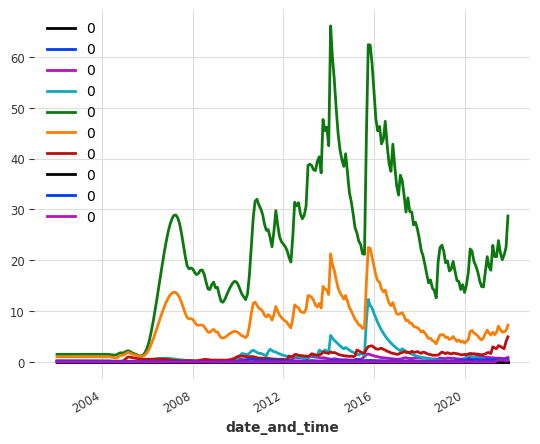

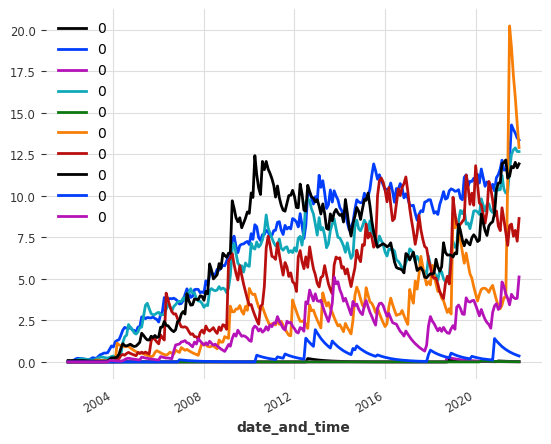

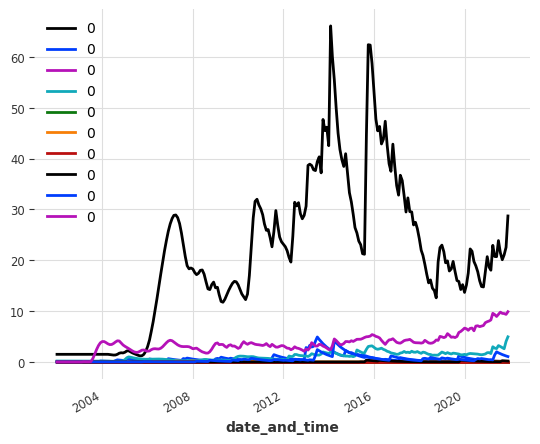

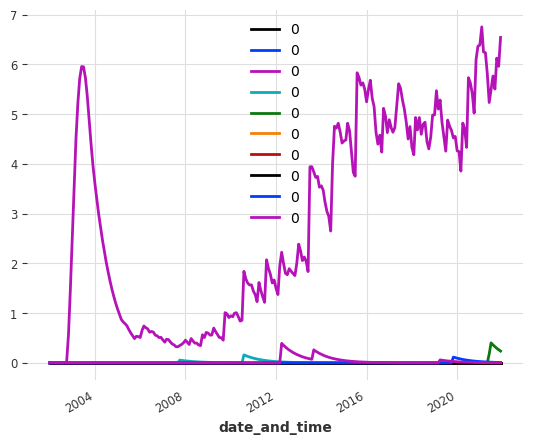

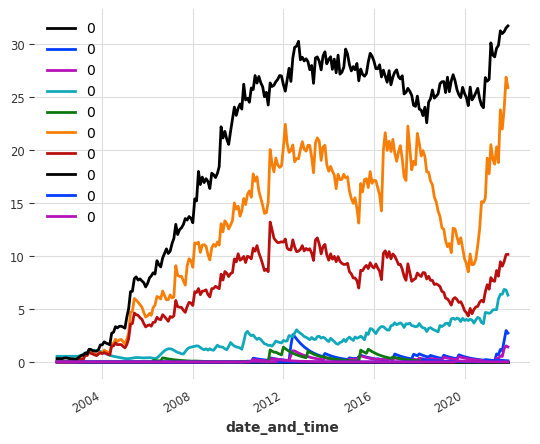

In [33]:
for i in range(1,7):
    mydfnow=dftm.loc[dftm['cluster']==i]

    nowlist =mydfnow['Time serie'].tolist()[40:50]
    for ele in nowlist:
        ele.plot()
    plt.show()

In [34]:
dftm.dtypes

concept1      object
concept2      object
indextype     object
Time serie    object
cluster        int64
dtype: object

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


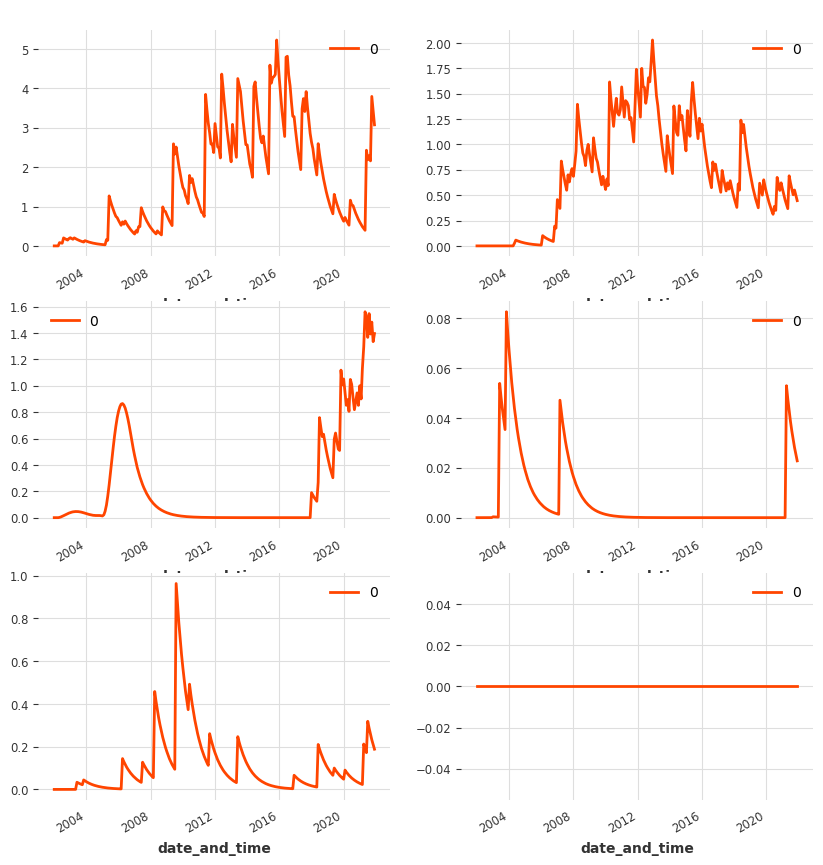

In [35]:
figure, ax = plt.subplots(3, 2, figsize=(10, 10), dpi=100)

for i, idx in enumerate([1, 20, 50, 103, 250, 300]):
    axis = ax[i % 3, i % 2]
    dftm.loc[idx]['Time serie'].plot(ax=axis,c="orangered",lw=2,)
    axis.legend(dftm.loc[idx]['Time serie'].components)
    axis.set_title(" ");

<div class="alert-info">
4. Auxiliary function for forecasting
</div>

Defining auxiliary functions, I will use in my forecasting analyses.

We define a handy function to tell us how good a bunch of forecasted series are:

In [36]:
def mysmape(preds, test_series): 
    listsmapes = []
    vector_local_variances = []
    vector_all_errors = []
    for j in range(len(preds)):
        actual = [x[0] for x in TimeSeries.values(preds[j])]
        forecast=[x[0] for x in TimeSeries.values(test_series[j])]

        actual_new = []
        forecast_new = []
        for i in range(len(actual)):
            if actual[i]!=0 and forecast[i]!=0:
                actual_new.append(actual[i])
                forecast_new.append(forecast[i])
        actual_new = np.array(actual_new)
        forecast_new = np.array(forecast_new)
        listsmapes.append(100*np.sum(2*np.abs(forecast_new - actual_new) / \
        (np.abs(actual_new) + np.abs(forecast_new)))/len(actual))
    
    return listsmapes

In [37]:
def plot_error_var_local(forecaster,horizon,df,mean_allvar):
    model_loaded = forecaster.load("my_model.pkl")
    
    preds = list(TimeSeries.pd_series(model_loaded.predict(n=horizon)))

    actualtm = list(TimeSeries.pd_series(df['Time serie'].tolist()[-1])) 
    
    preds_minusvar =actualtm[:-horizon]
    preds_plusvar = actualtm[:-horizon]
    predictions = actualtm[:-horizon]+preds
    
    for j in range(horizon):
        preds_minusvar.append(preds[j]-np.mean(mean_allvar)) 
        preds_plusvar.append(preds[j]+np.mean(mean_allvar)) 
    
    x_cor =np.arange(0,len(actualtm))
    plt.plot(x_cor,predictions,x_cor,preds_plusvar,x_cor,preds_minusvar)
    
    plt.show()

In [38]:
def plot_error_var_global(forecaster,horizon,df,mean_allvar):
    model_loaded = forecaster.load("my_model.pkl")
    
    preds = list(TimeSeries.pd_series(model_loaded.predict(n=horizon,series=df['Train tm'].tolist()[-1])))

    actualtm = list(TimeSeries.pd_series(df['Time serie'].tolist()[-1])) 
    
    preds_minusvar =actualtm[:-horizon]
    preds_plusvar = actualtm[:-horizon]
    predictions = actualtm[:-horizon]+preds
    
    for j in range(horizon):
        preds_minusvar.append(preds[j]-np.mean(mean_allvar)) 
        preds_plusvar.append(preds[j]+np.mean(mean_allvar)) 
    
    x_cor =np.arange(0,len(actualtm))
    plt.plot(x_cor,predictions,x_cor,preds_plusvar,x_cor,preds_minusvar)
    
    plt.show()

In [39]:
def cross_validation_splitting_window_local(data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    maximal_train_len = 240-horizon
    score_forecaster = []
    allsmapes = []

    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =maximal_train_len//number_cv
            startingtime = i*windowslength
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes =eval_local_model(df['Train tm'].tolist(),df['Test tm'].tolist(),horizon,\
                              modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len-(number_cv-1)*(maximal_train_len//number_cv) # to get the remaining window
            startingtime = i*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes=eval_local_model(df['Train tm'].tolist(),df['Test tm'].tolist(),\
            horizon,modelname,forecaster,**kwargs)
            
        score_forecaster.append(np.median(smapes))
        allsmapes.append(smapes)
        # I save the mean of the all the smapes done over one window
        
        
    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_kcross_forecasts(allsmapes,modelname)


    
    return elapsed_time,np.mean(myscores),np.median(myscores)

In [40]:
def cross_validation_expanding_window_local(data,horizon,list_concepts,number_cv,modelname,forecaster,**kwargs):
    
    time1=time.time()
    
    
    startingtime=0
    maximal_train_len = 240-horizon
    score_forecaster = []
    allsmapes = []

    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =(i+1)*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes=eval_local_model(df['Train tm'].tolist(),\
            df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
            
        else:
            windowslength = maximal_train_len
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            smapes=eval_local_model(df['Train tm'].tolist(),\
            df['Test tm'].tolist(),horizon,modelname,forecaster,**kwargs)
        
        allsmapes.append(smapes)
        
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        

    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
        
    eval_kcross_forecasts(allsmapes,modelname)


    return elapsed_time,np.mean(myscores),np.median(myscores)

In [41]:
def cross_validation_splitting_window_global(data,horizon,list_concepts,number_cv,modelname,forecaster,n_trials):
    
    time1=time.time()
    
    maximal_train_len = 240-horizon
    score_forecaster = []
    allsmapes=[]
    
    global data_training
    global data_tuning
    global windowslength
    
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =maximal_train_len//number_cv
            startingtime = i*windowslength
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            
            data_training, data_tuning=split_data(df)
            hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)

            
        else:
            windowslength = maximal_train_len-(number_cv-1)*(maximal_train_len//number_cv) # to get the remaining window
            startingtime = i*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            
            data_training, data_tuning=split_data(df)
            hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)

        smapes=eval_global_model(data_training['Train tm'].tolist(),data_training['Test tm'].tolist(),\
        horizon,modelname,forecaster,windowslength-hyperparameters['out_len']-horizon,hyperparameters)

        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        
    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_kcross_forecasts(allsmapes,modelname)
    
    return elapsed_time,np.mean(myscores),np.median(myscores)

In [42]:
def cross_validation_expanding_window_global(data,horizon,list_concepts,number_cv,modelname,forecaster,n_trials):
    
    time1=time.time()
    
    startingtime=0
    maximal_train_len = 240-horizon
    score_forecaster = []
    allsmapes=[]
    
    global data_training
    global data_tuning
    global windowslength
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =(i+1)*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            
            data_training, data_tuning=split_data(df)
            hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)

            
        else:
            windowslength = maximal_train_len
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            
            data_training, data_tuning=split_data(df)
            hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)
            
        smapes=eval_global_model(data_training['Train tm'].tolist(),data_training['Test tm'].tolist(),\
        horizon,modelname,forecaster,windowslength-hyperparameters['out_len']-horizon,hyperparameters)
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window

    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_kcross_forecasts(allsmapes,modelname)

    return elapsed_time,np.mean(myscores),np.median(myscores)

In [43]:
def creating_train_test_tm(dftm,startingtime,windowslength,horizon,list_concepts):

    listconcept1=[]
    listconcept2=[]
    listindextype=[]
    
    listdartstm=[]
    listtraintm=[]
    listtesttm=[]
    listcluster=[]

    for concept1 in list_concepts:
        dfconcept1 = dftm.loc[dftm['concept1']==concept1]
        for concept2 in list_concepts:
            dfconcept2 = dfconcept1.loc[dfconcept1['concept2']==concept2]
            for index in list_indices:
                dfindex=dfconcept2.loc[dfconcept2['indextype']==index]
                if len(dfindex)!=0:
                    
                    mycluster = dfindex.cluster.tolist()[0]
                    mytimeseries=dfindex['Time serie'].tolist()[0]
                    if startingtime==0:
                        traintm=mytimeseries[:windowslength]
                    else:
                        traintm=mytimeseries[startingtime-1:startingtime+windowslength]
                        
                    testtm=mytimeseries[startingtime+windowslength:startingtime+windowslength+horizon]
                                    
                    listconcept1.append(concept1)
                    listconcept2.append(concept2)
                    listindextype.append(index)
                    listdartstm.append(mytimeseries)
                    listtraintm.append(traintm)
                    listtesttm.append(testtm)
                    listcluster.append(mycluster)
                    
    df = pd.DataFrame({'concept1':listconcept1,'concept2':listconcept2,'indextype':listindextype,
                         'Time serie':listdartstm,'Train tm':listtraintm,'Test tm':listtesttm,'cluster':listcluster})
    return df

In [44]:
def eval_kcross_forecasts(smapes,modelname):
    
    plt.figure(figsize=(10, 5))
    
    themedians = []
    labels = []
    
    for i in range(len(smapes)):
        themedians.append(np.median(smapes[i]))
        #plt.hist(smapes[i], bins=100,label='K-cross set'+str(i+1))
        labels = labels +['Trained on '+str((i+1)*(100//len(smapes)))+\
        ' % of the data, with a median smape of '+ str(round(np.median(smapes[i]),2))+' %.']
        
    plt.ylabel("Count")
    plt.xlabel("sMAPE")
    plt.title("The median sMAPE for "+str(modelname)+" : %.3f" % np.median(themedians))
    #plt.yscale('log')

    plt.hist(smapes,bins=100,histtype='barstacked',label=labels)
    
    plt.legend()
    plt.show()
    plt.close()

In [45]:
def plot_forecasting_models_local(modelnames,myforecasters,df,horizon,index):
    
    actual = df['Time serie'].tolist()[-1]
    actual.plot(label="Actual time series")
    for i in range(len(modelnames)):
        model = modelnames[i]
        forecaster = myforecasters[i]
        model_loaded = forecaster.load("forecasting_models/"+str(model)+"_model.pkl")
        preds = model_loaded.predict(n=horizon)
        preds.plot(label=model)
    
    plt.legend()
    plt.show()

In [46]:
def plot_forecasting_models_global(modelnames,models,df,horizon,index):
    
    actual = df['Time serie'].tolist()[-1]
    actual.plot(label="Actual time series")
    
    trainingdata = actual[:-horizon]

    
    for i in range(len(modelnames)):
        model = modelnames[i]
        forecaster = myforecasters[i]
        model_loaded = forecaster.load("forecasting_models/"+str(model)+"_model.pkl")
        preds = model_loaded.predict(n=horizon,series=trainingdata)
        preds.plot(label=model)
    
    plt.legend()
    plt.show()

In [47]:
def eval_local_model(train_series, test_series,horizon,modelname, model_cls, **kwargs):
    preds = []

    for series in tqdm(train_series):
        model = model_cls(**kwargs)
        model.fit(series)
        pred = model.predict(n=horizon)
        preds.append(pred)
    
    smapes = mysmape(preds, test_series)
    
    model.save("forecasting_models/"+str(modelname)+"_model.pkl")
    
    return smapes

In [48]:
def eval_global_model(train_series, test_series,horizon,modelname,model_cls,lags, hyperparameters):
    
    if modelname =="LinearRegressionModel":
        model = model_cls(lags=lags,output_chunk_length =hyperparameters['out_len'])
        
    if modelname=="LightGBMModel":
        model = model_cls(lags=lags,output_chunk_length =hyperparameters['out_len'])
        
    if modelname=="RandomForest":
        model = model_cls(lags=lags,output_chunk_length =hyperparameters['out_len'],\
        n_estimators = hyperparameters['n_estimators'],max_depth=hyperparameters['max_depth'])
    
    model.fit(train_series)
    preds = model.predict(n=horizon, series=train_series)

    smapes = mysmape(preds, test_series)
    
    model.save("forecasting_models/"+str(modelname)+"_model.pkl")
    
    return smapes

In [49]:
def plot_models(method_to_elapsed_times, method_to_smapes):
    shapes = ["o", "s", "*"]
    colors = ["tab:blue", "tab:orange", "tab:green", "tab:purple"]
    styles = list(product(shapes, colors))

    plt.figure(figsize=(6, 6), dpi=100)

    for i, method in enumerate(method_to_elapsed_times.keys()):

        t = method_to_elapsed_times[method]
        s = styles[i]
        plt.semilogx(
            [t],
            [np.mean(method_to_smapes[method])],
            s[0],
            color=s[1],
            label=method,
            markersize=13,
        )
    plt.xlabel("elapsed time [s]")
    plt.ylabel("Average sMAPE over all series")
    plt.legend(bbox_to_anchor=(1.4, 1.0), frameon=True)
    plt.show();

In [50]:
def plot_models_global(method_to_elapsed_times, method_to_smapes):
    shapes = ["o", "s", "*"]
    colors = ["tab:blue", "tab:orange", "tab:green"]
    styles = list(product(shapes, colors))

    plt.figure(figsize=(6, 6), dpi=100)

    for i, method in enumerate(method_to_elapsed_times.keys()):

        t = method_to_elapsed_times[method]
        s = styles[i]
        plt.semilogx(
            [t],
            [np.mean(method_to_smapes[method])],
            s[0],
            color=s[1],
            label=method,
            markersize=13,
        )
    plt.xlabel("elapsed time [s]")
    plt.ylabel("Average sMAPE over all series")
    plt.legend(bbox_to_anchor=(1.4, 1.0), frameon=True)
    plt.show();

# **Part 1 -- Local forecasting**

Creating the dataframe I will use with an horizon of 3 months.

In [51]:
def local_forecasting(dftm,horizon,list_concepts,number_cv):
    
    # once I created my dataframe with this specific horizon I train and visualize the results of the forecasting algorithms
    
    naive1_time,naive1_smapes_mean,naive1_smapes_med=\
    cross_validation_expanding_window_local(dftm,\
    horizon,list_concepts,number_cv,'Naive_seasonal_k1',NaiveSeasonal, K=1)
    
    naive12_time,naive12_smapes_mean,naive12_smapes_med\
    =cross_validation_expanding_window_local(dftm,\
    horizon,list_concepts,number_cv,'Naive_seasonal_k12', NaiveSeasonal, K=12)
    
    ets_time,ets_smapes_mean,ets_smapes_med\
    =cross_validation_expanding_window_local(dftm,\
    horizon,list_concepts,number_cv,'ExponentialSmoothing',ExponentialSmoothing,seasonal_periods=12)
    
    theta_time,theta_smapes_mean,theta_smapes_med\
    =cross_validation_expanding_window_local(dftm,\
    horizon,list_concepts,number_cv,'Theta', Theta, theta=2,seasonality_period=12,season_mode=SeasonalityMode.ADDITIVE)
    
    
    smapes_mean = {
    "naive-last": naive1_smapes_mean,
    "naive-seasonal": naive12_smapes_mean,
    "Exponential Smoothing": ets_smapes_mean,
    "Theta": theta_smapes_mean
    }
    
    smapes_med = {
    "naive-last": naive1_smapes_med,
    "naive-seasonal": naive12_smapes_med,
    "Exponential Smoothing": ets_smapes_med,
    "Theta": theta_smapes_med
    }

    elapsed_times = {
    "naive-last": naive1_time,
    "naive-seasonal": naive12_time,
    "Exponential Smoothing": ets_time,
    "Theta": theta_time
    }
    
    # We compare models with respect to precision and computational cost.
    print('Visualization of performances taking the mean of the smapes over cross-validation')
    plot_models(elapsed_times, smapes_mean)
    
    print('Visualization of performances taking the median of the smapes over cross-validation')
    plot_models(elapsed_times, smapes_med)
    
    return naive1_smapes_mean,naive12_smapes_mean,ets_smapes_mean,theta_smapes_mean

In [340]:
list_indices=['index_cit_t1_t2','index_cit_t2_t1','index_colab_increm','index_colab_notincrem','index_keyword']

In [341]:
dftm

,concept1,concept2,indextype,Time serie,cluster
0,Authentication protocole,Authentication protocole,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",1
1,Authentication protocole,Authentication protocole,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
2,Authentication protocole,Authentication protocole,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
3,Authentication protocole,Authentication protocole,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
4,Authentication protocole,Authentication protocole,index_keyword,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",6
...,...,...,...,...,...
2345,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t1_t2,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",2
2346,Zero-knowlegde proof,Zero-knowlegde proof,index_cit_t2_t1,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",2
2347,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_increm,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",3
2348,Zero-knowlegde proof,Zero-knowlegde proof,index_colab_notincrem,"(((<TimeSeries (DataArray) (date_and_time: 1, ...",5


In [342]:
myforecasters = [NaiveSeasonal,NaiveSeasonal,ExponentialSmoothing,Theta]

In [343]:
modelnames = ["Naive_seasonal_k1","Naive_seasonal_k12","ExponentialSmoothing","Theta"]

The results for index_cit_t1_t2 are:
The results for index_cit_t1_t2 with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

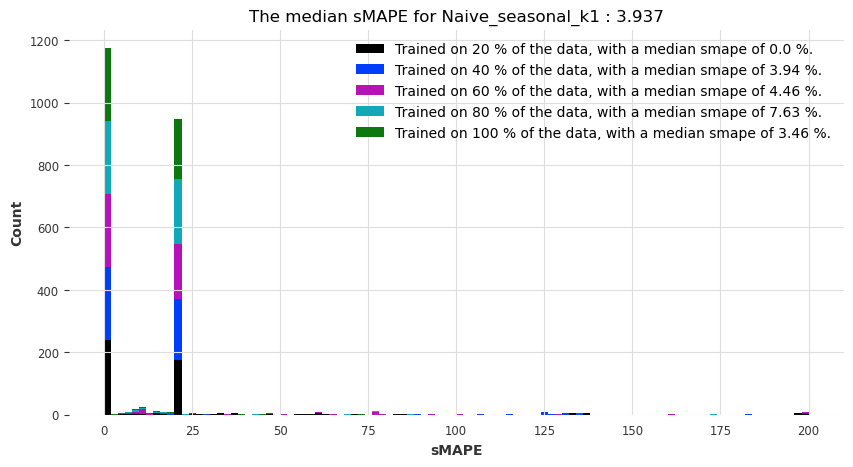

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

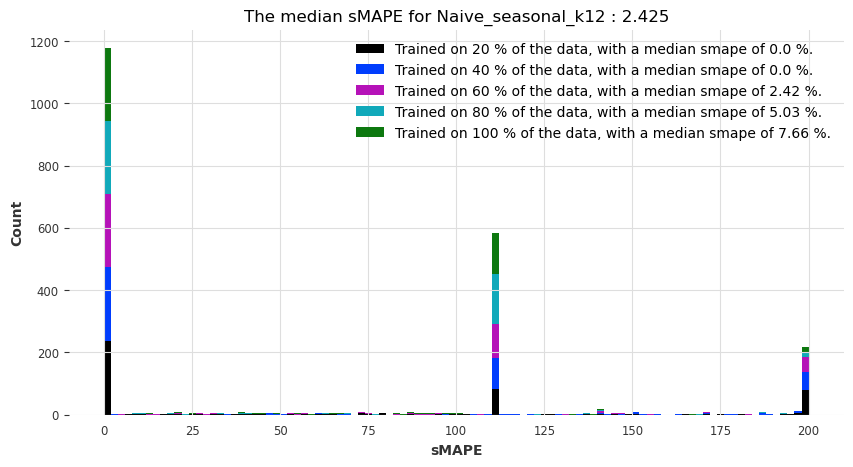

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

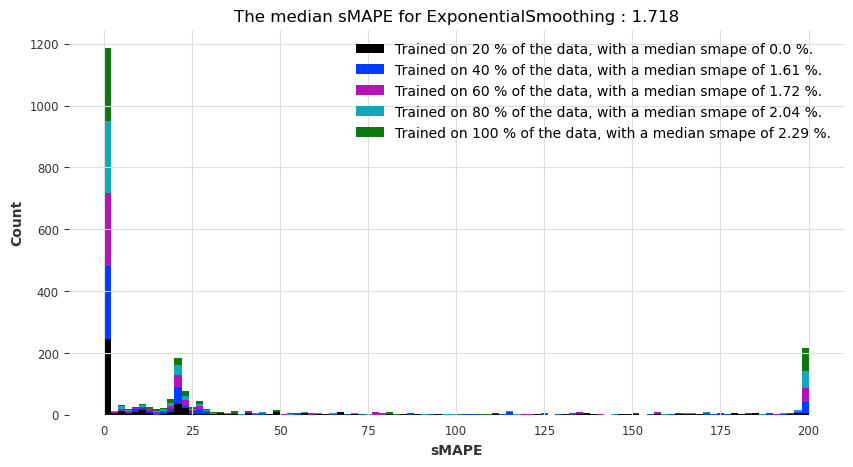

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

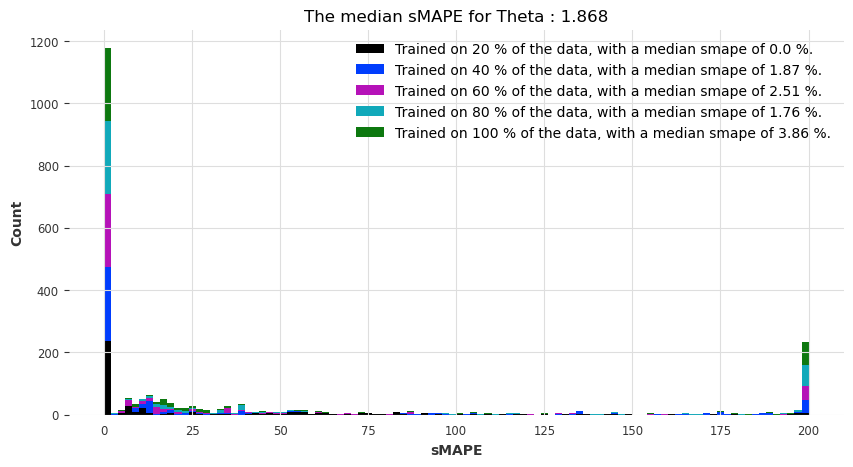

Visualization of performances taking the mean of the smapes over cross-validation


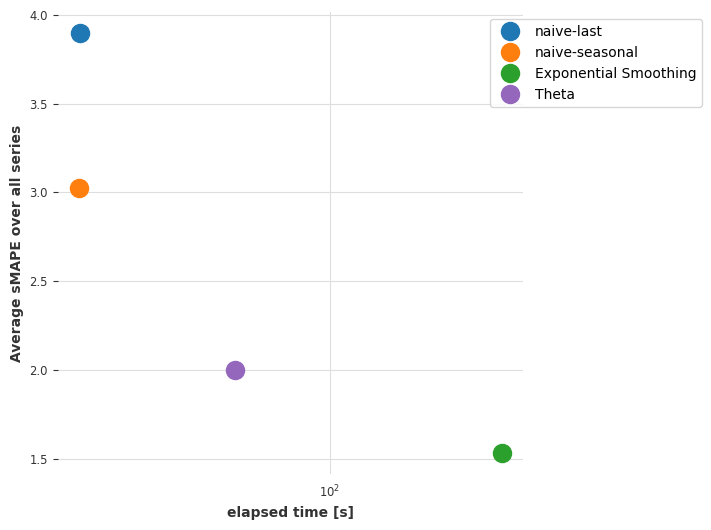

Visualization of performances taking the median of the smapes over cross-validation


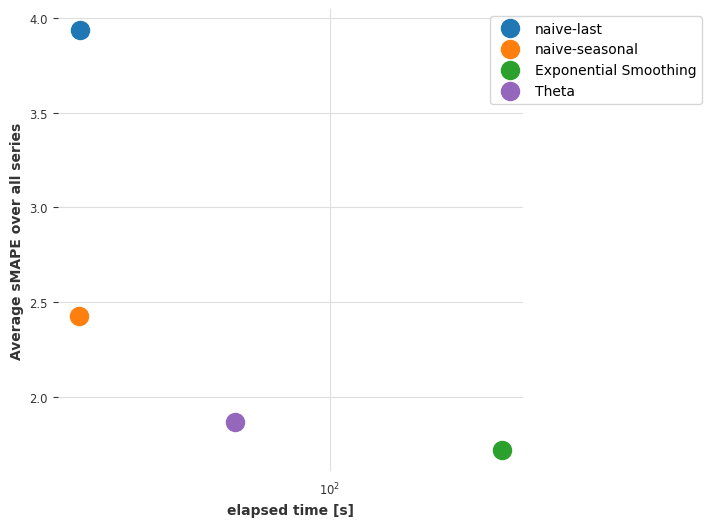

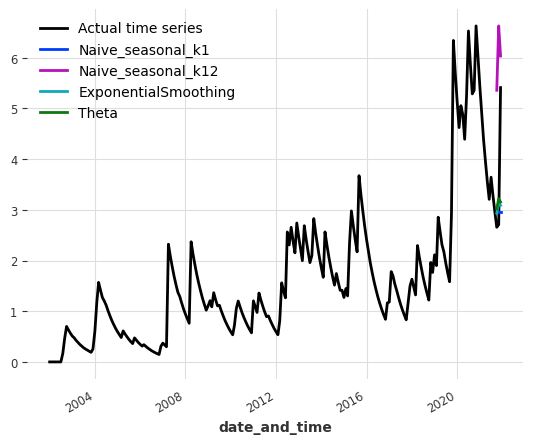

The results for index_cit_t1_t2 with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

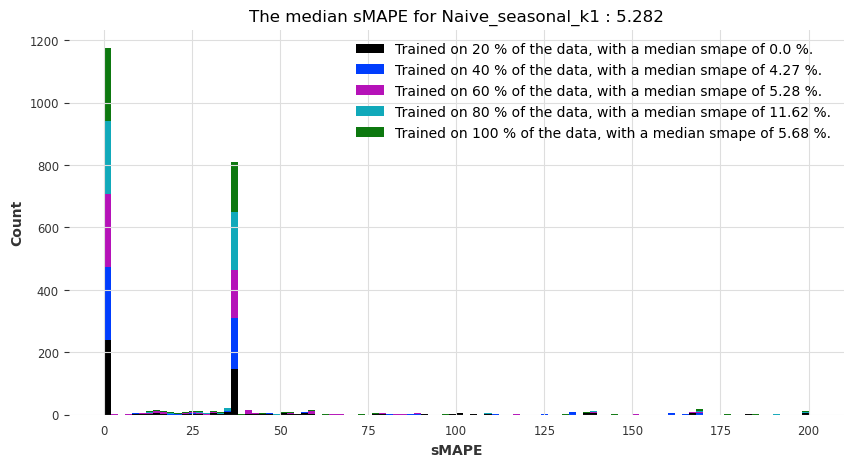

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

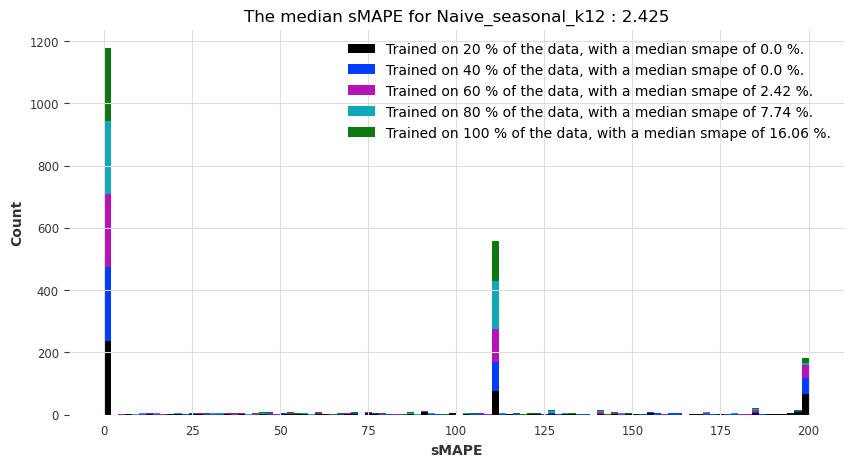

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

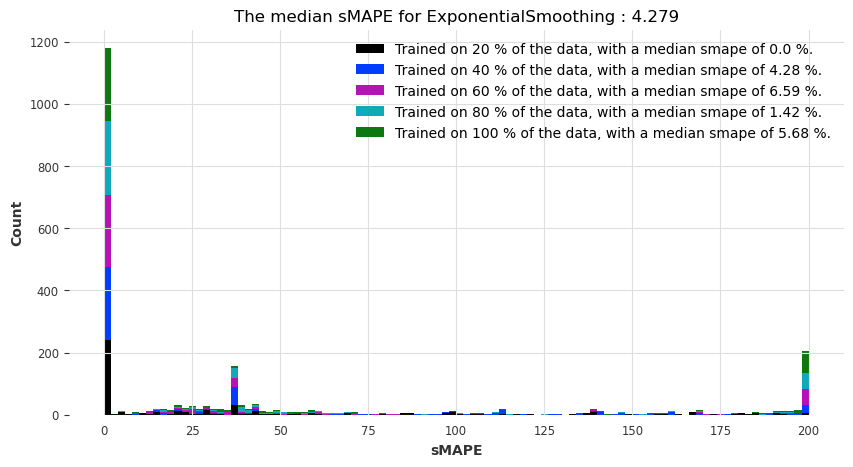

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

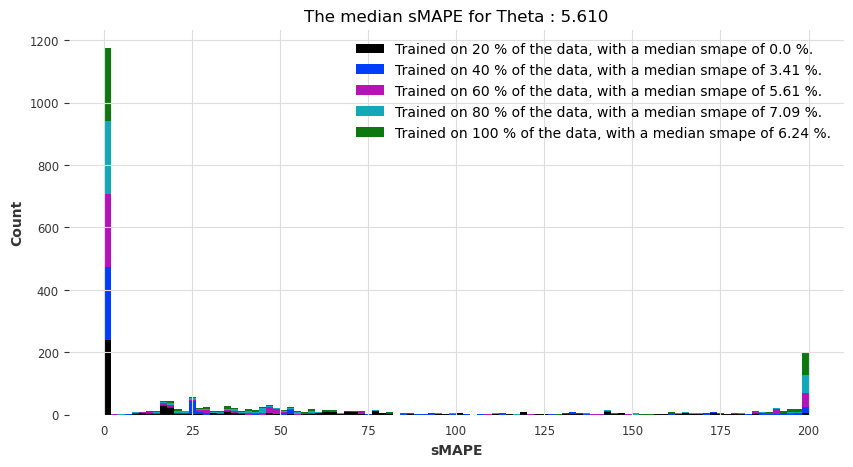

Visualization of performances taking the mean of the smapes over cross-validation


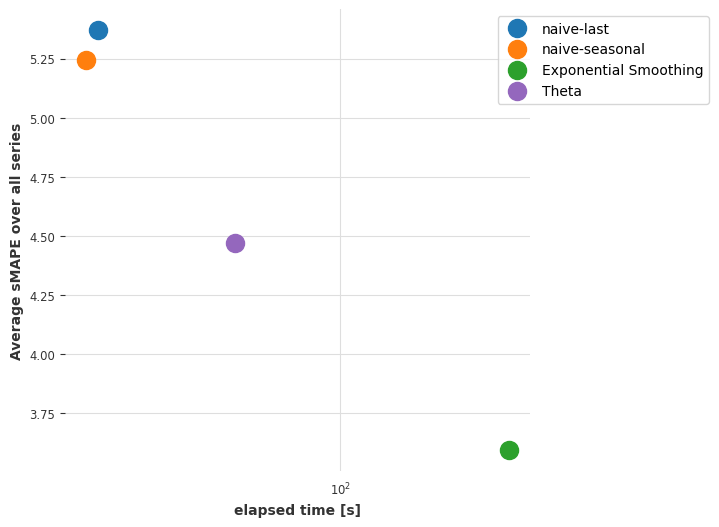

Visualization of performances taking the median of the smapes over cross-validation


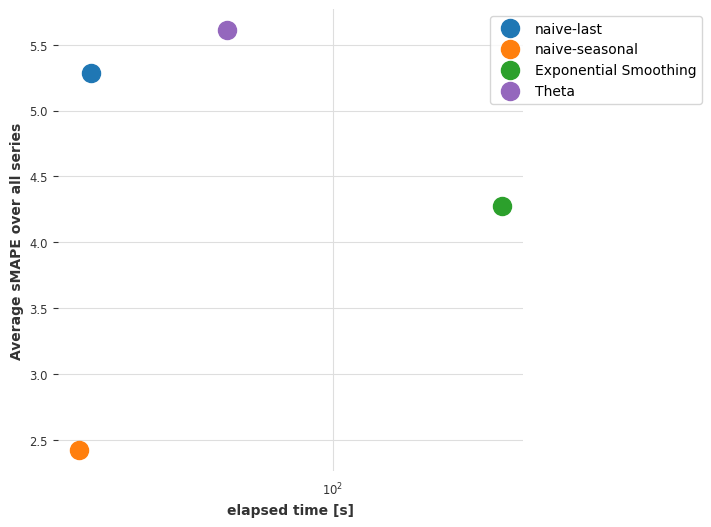

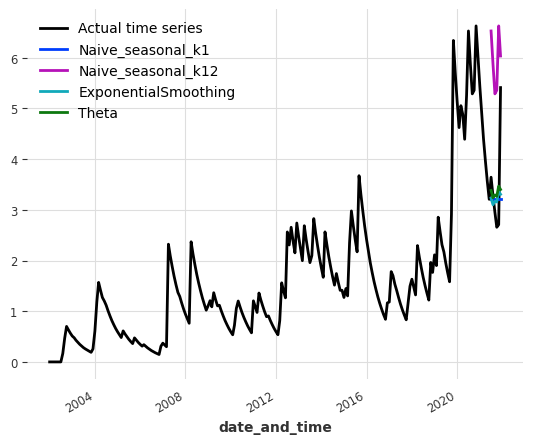

The results for index_cit_t1_t2 with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

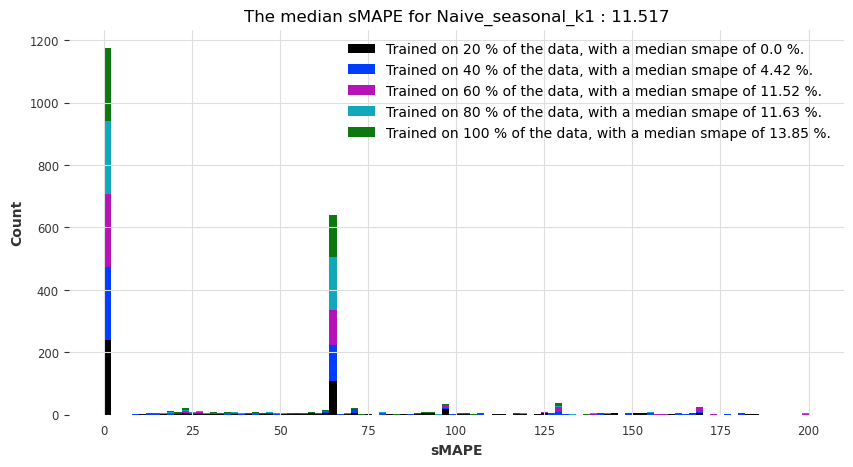

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

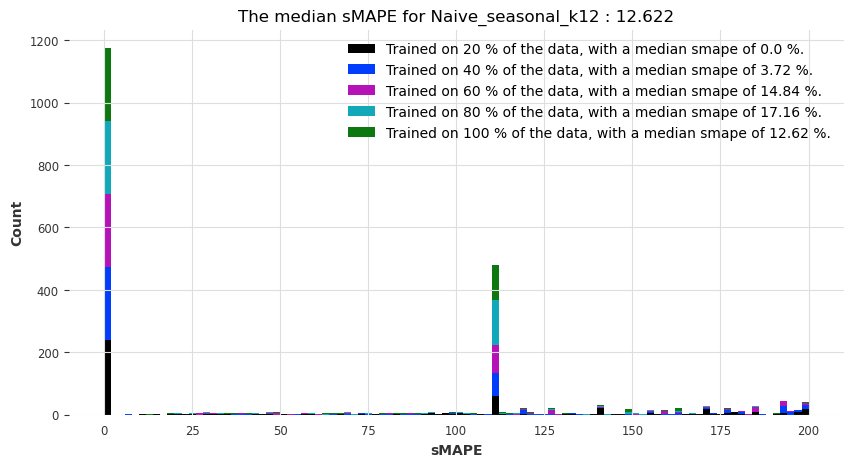

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

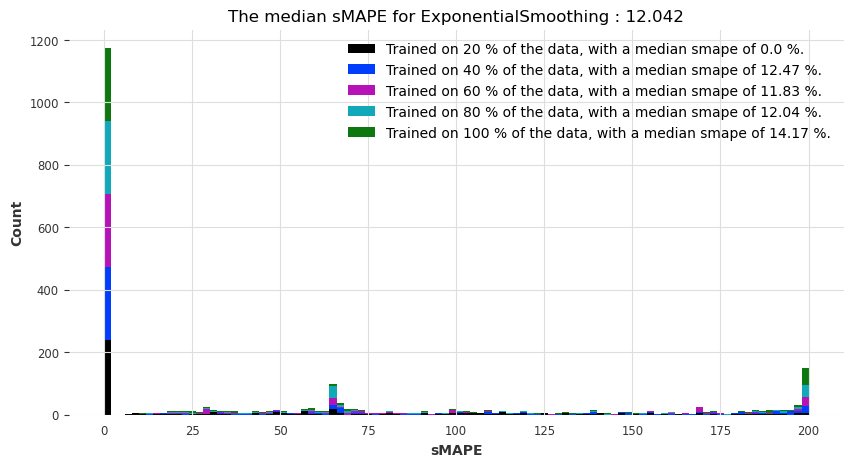

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

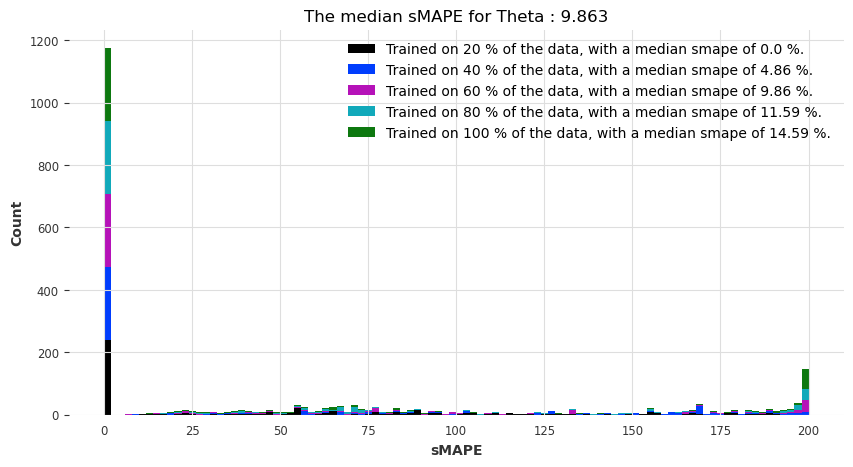

Visualization of performances taking the mean of the smapes over cross-validation


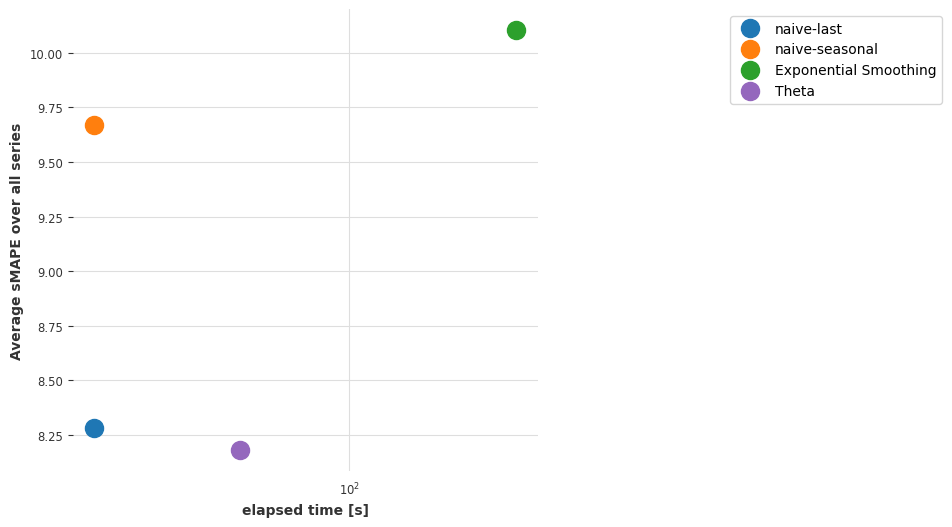

Visualization of performances taking the median of the smapes over cross-validation


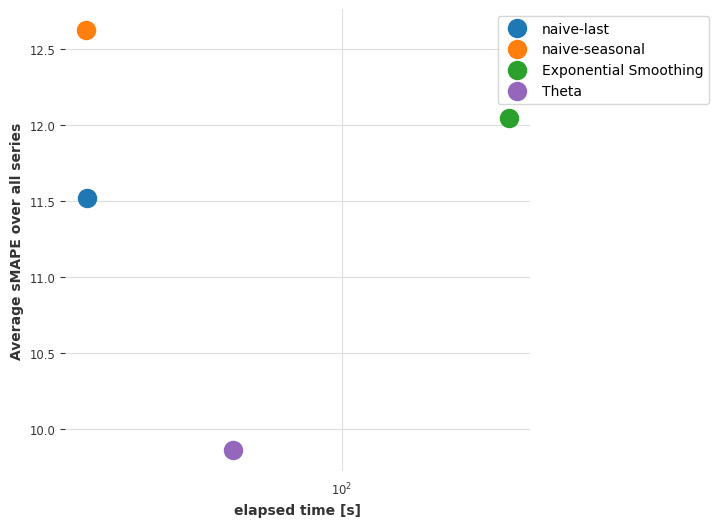

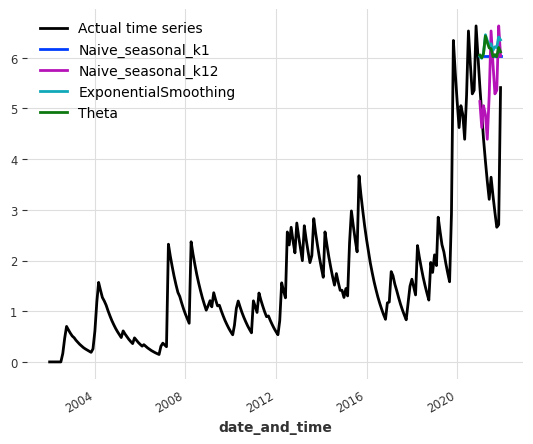

The results for index_cit_t2_t1 are:
The results for index_cit_t2_t1 with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

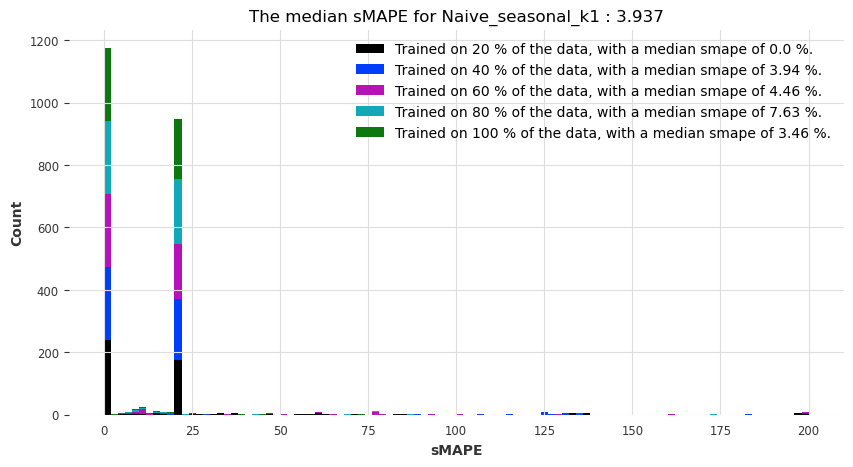

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

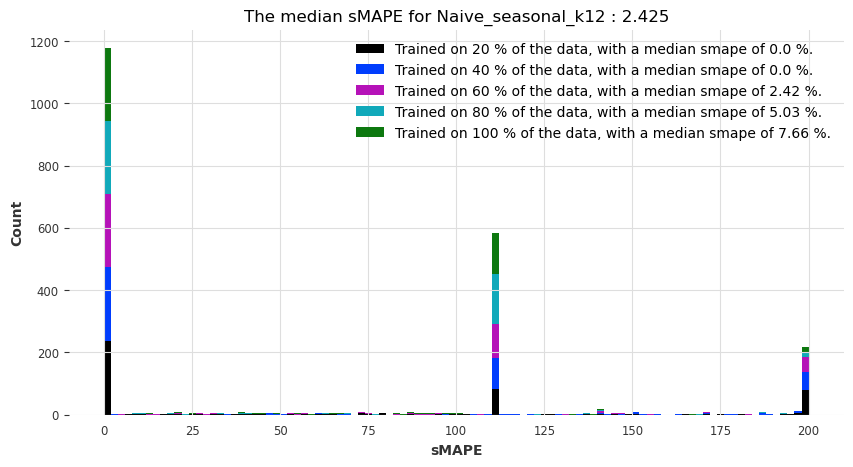

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

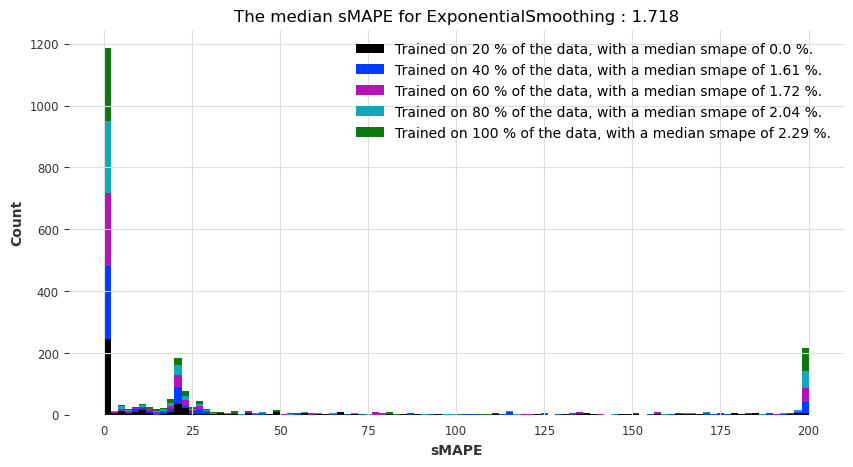

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

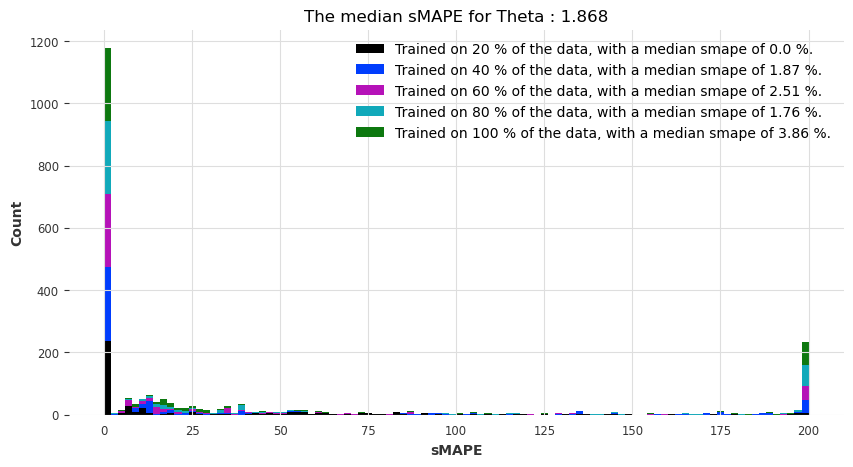

Visualization of performances taking the mean of the smapes over cross-validation


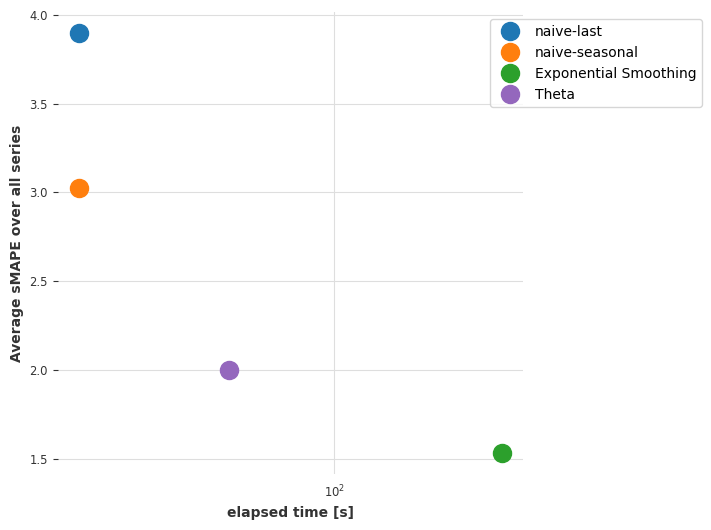

Visualization of performances taking the median of the smapes over cross-validation


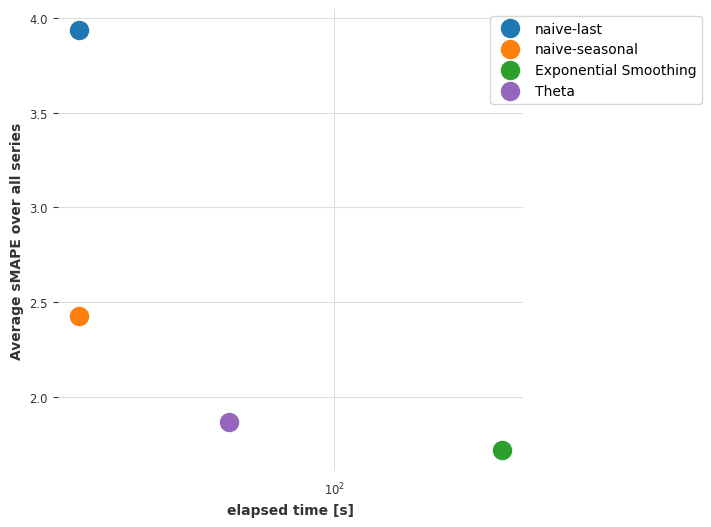

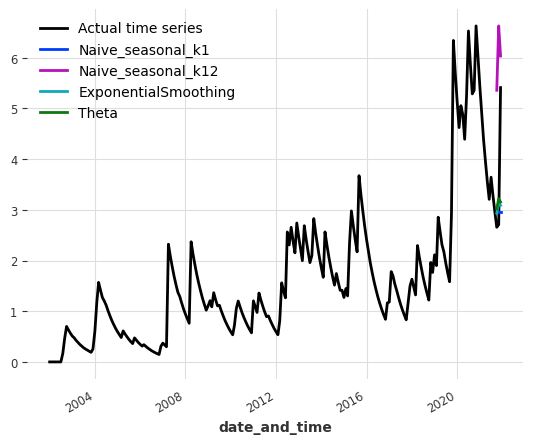

The results for index_cit_t2_t1 with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

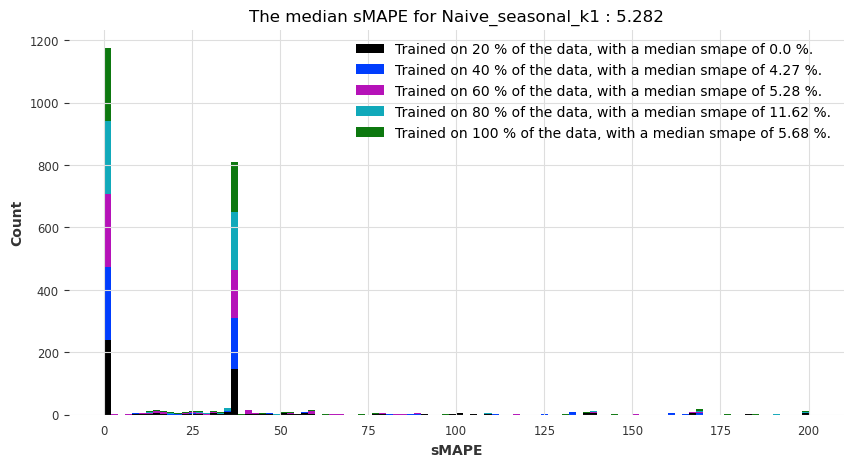

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

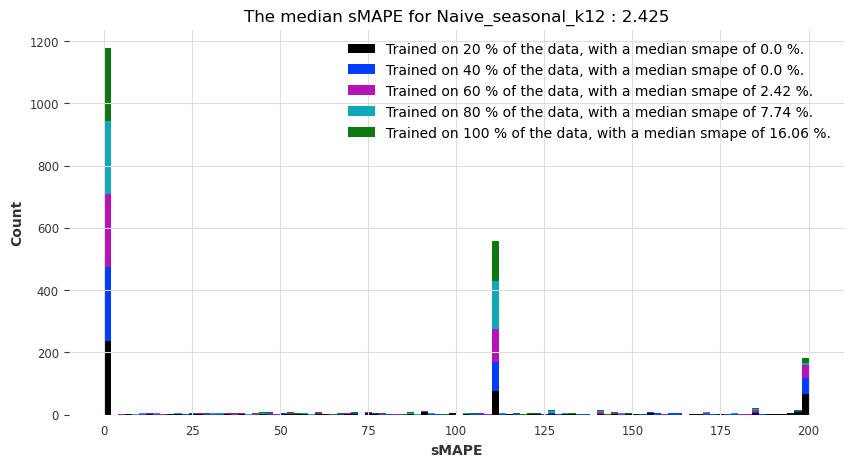

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

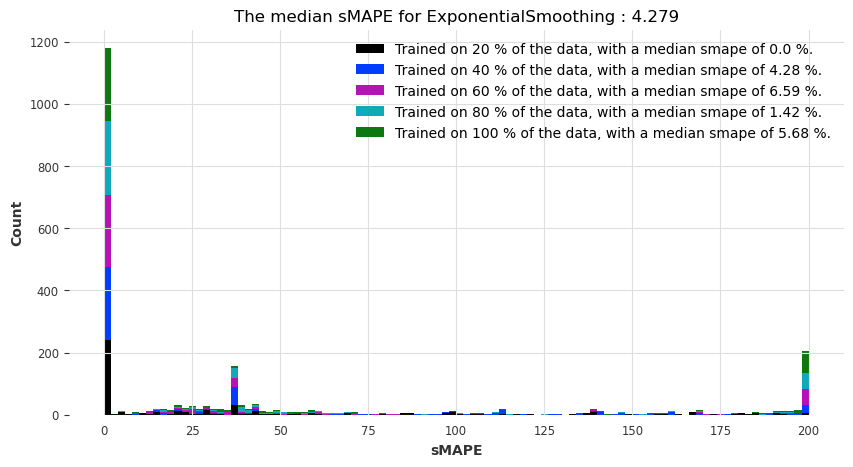

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

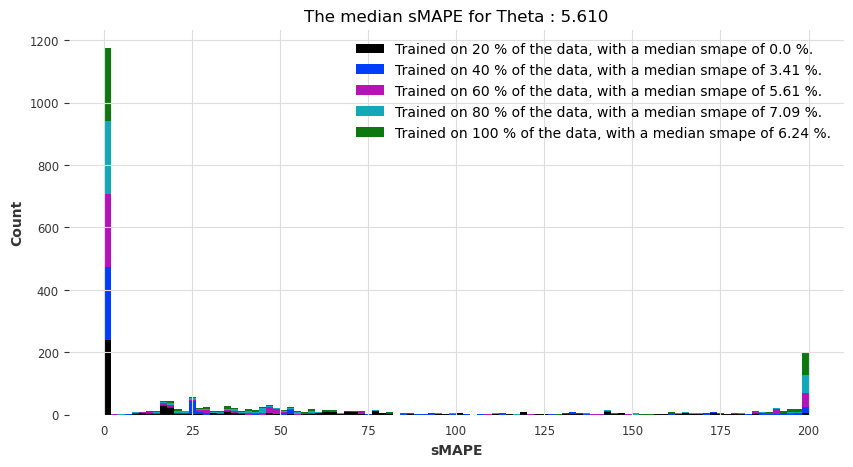

Visualization of performances taking the mean of the smapes over cross-validation


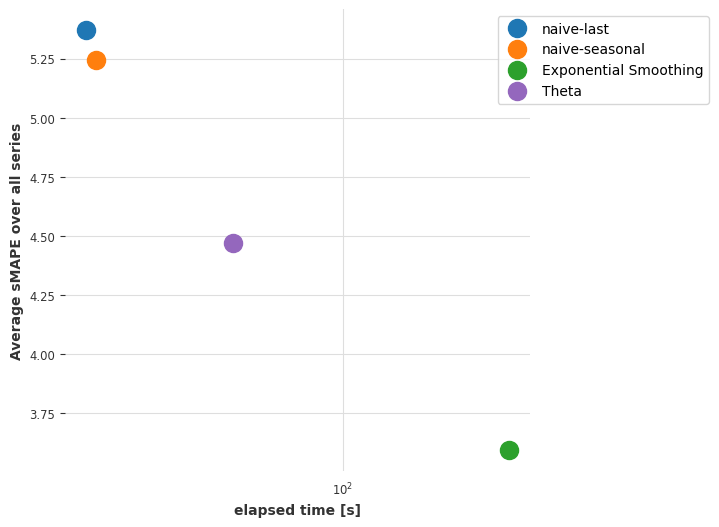

Visualization of performances taking the median of the smapes over cross-validation


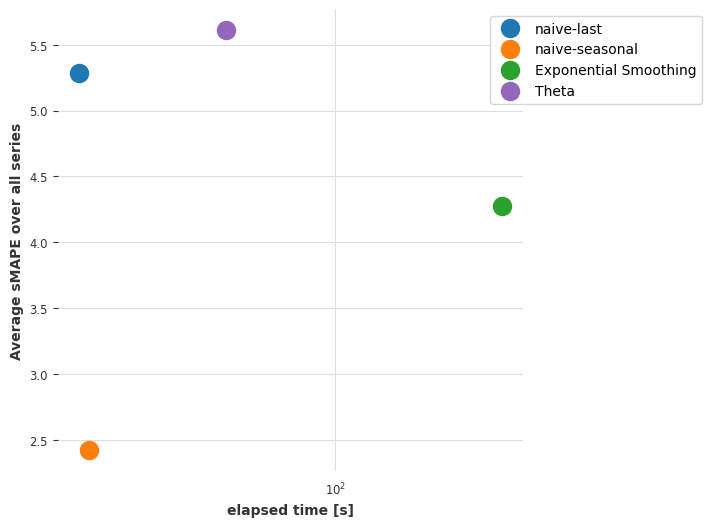

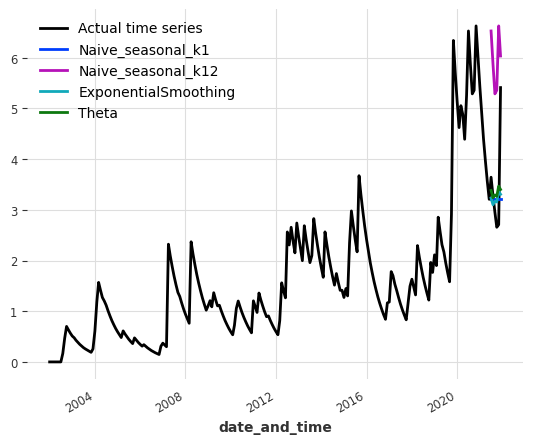

The results for index_cit_t2_t1 with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

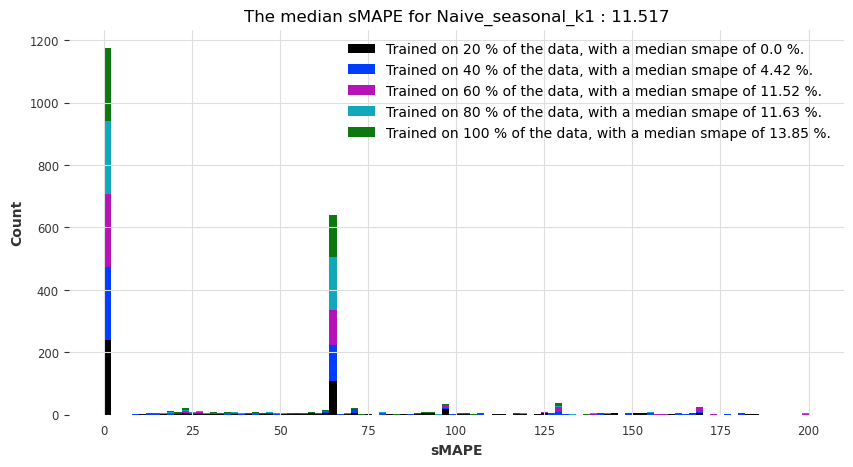

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

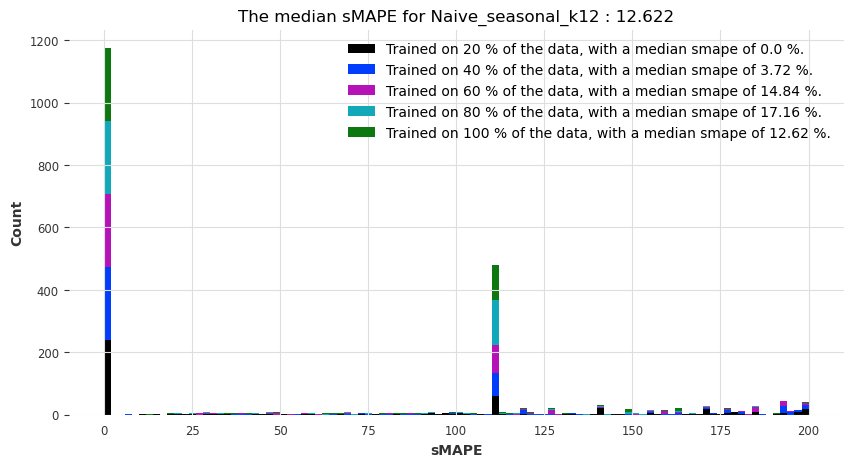

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

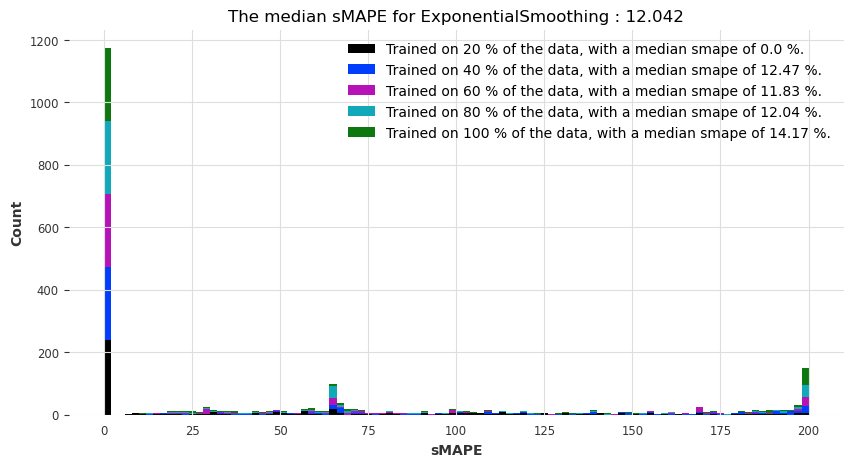

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

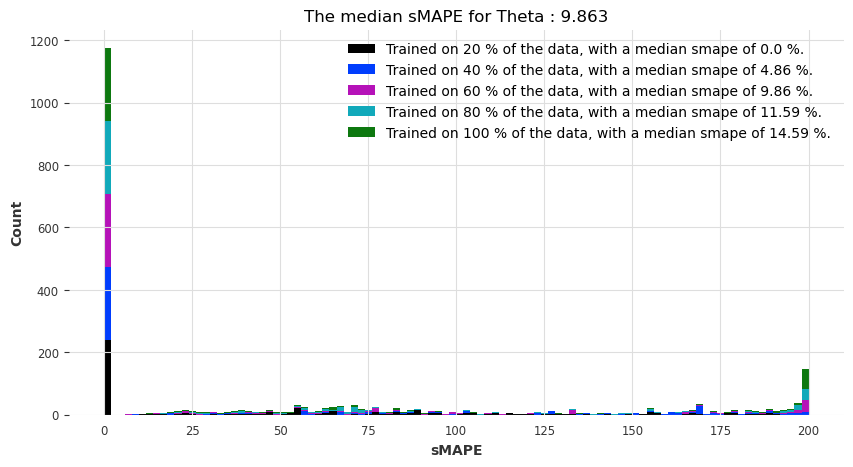

Visualization of performances taking the mean of the smapes over cross-validation


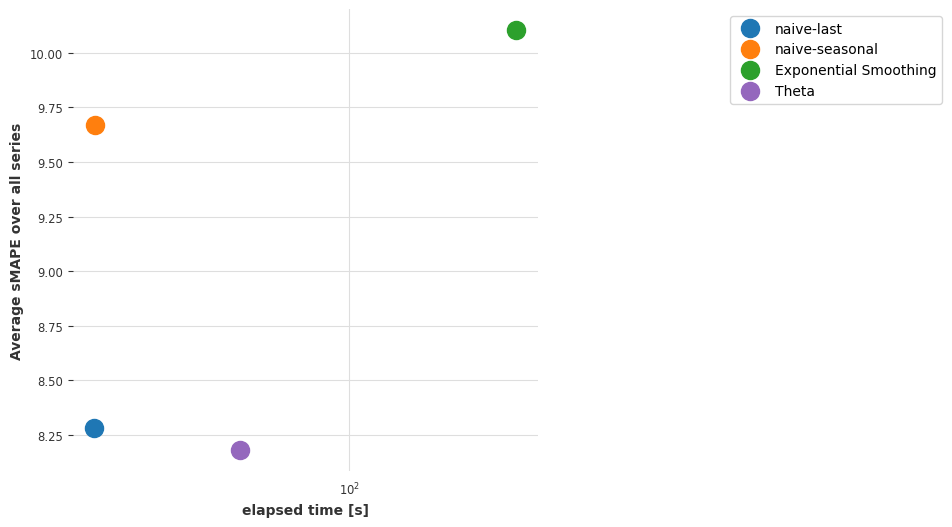

Visualization of performances taking the median of the smapes over cross-validation


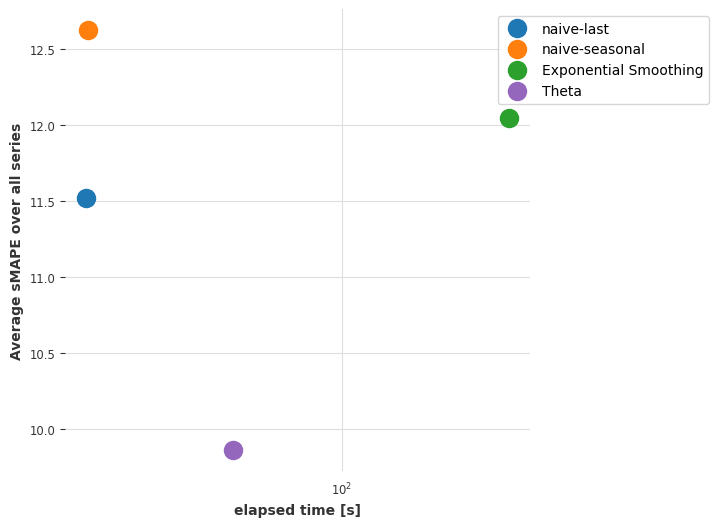

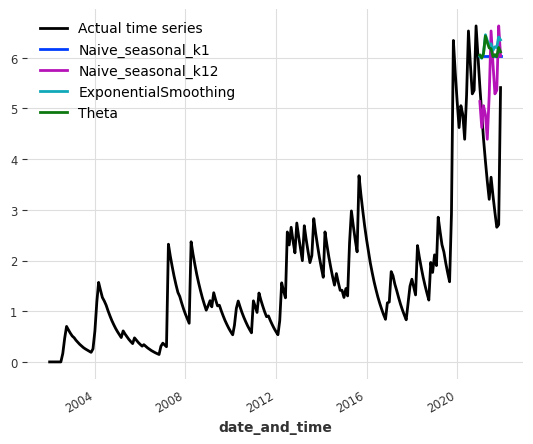

The results for index_colab_increm are:
The results for index_colab_increm with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

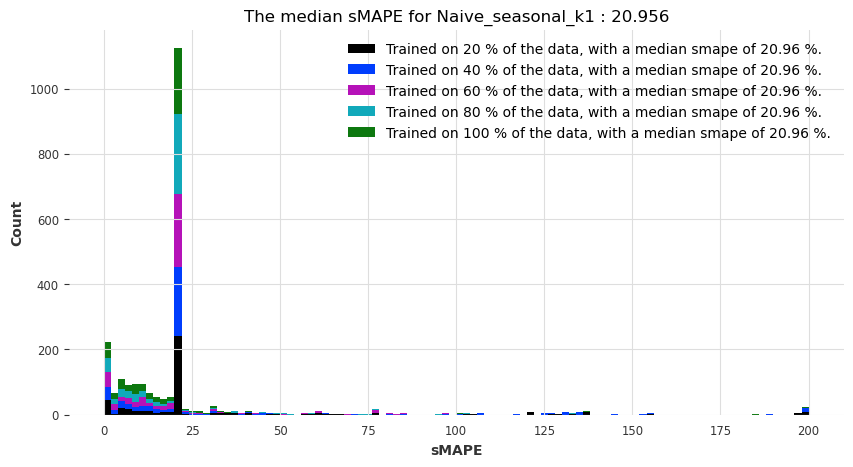

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

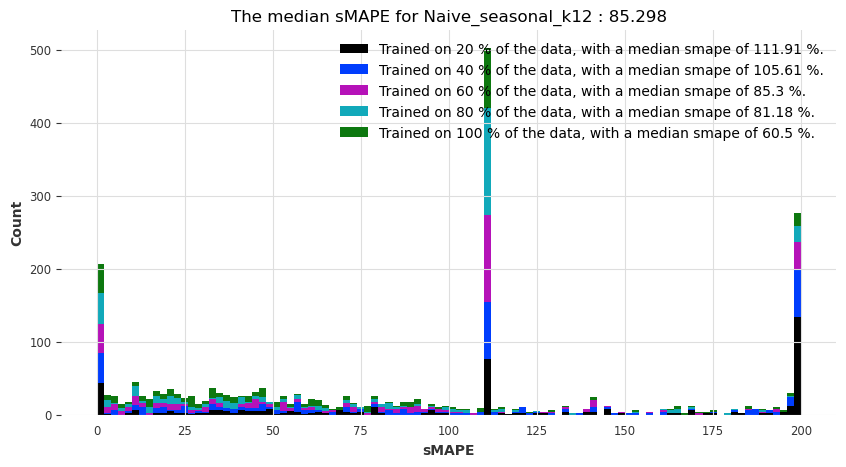

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

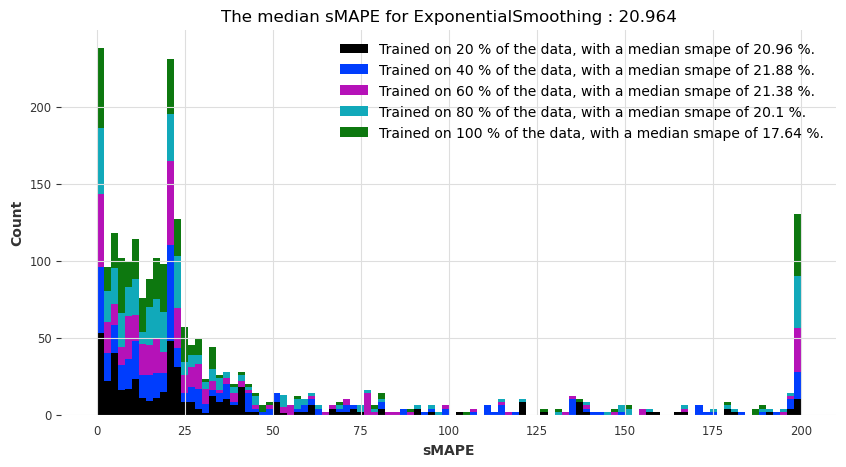

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

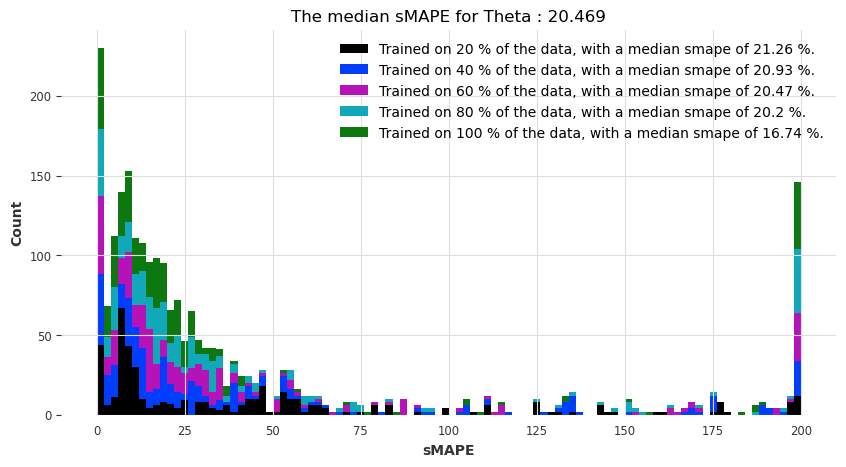

Visualization of performances taking the mean of the smapes over cross-validation


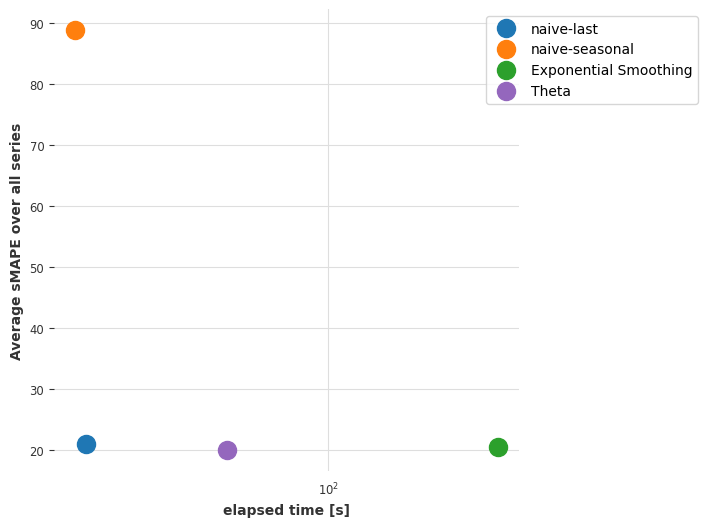

Visualization of performances taking the median of the smapes over cross-validation


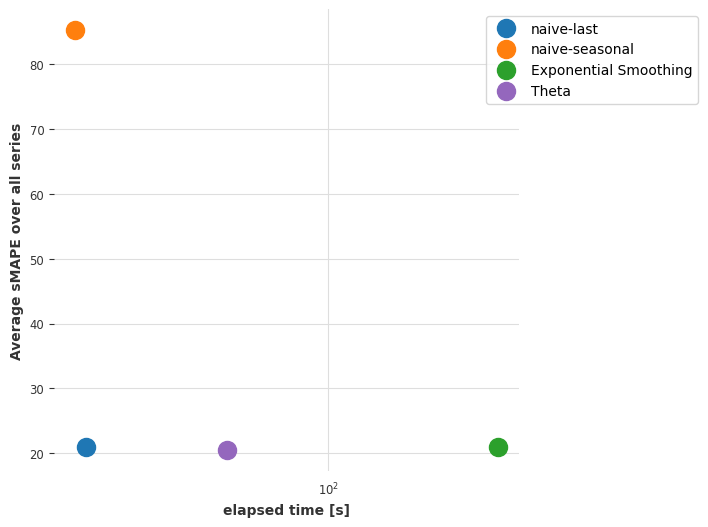

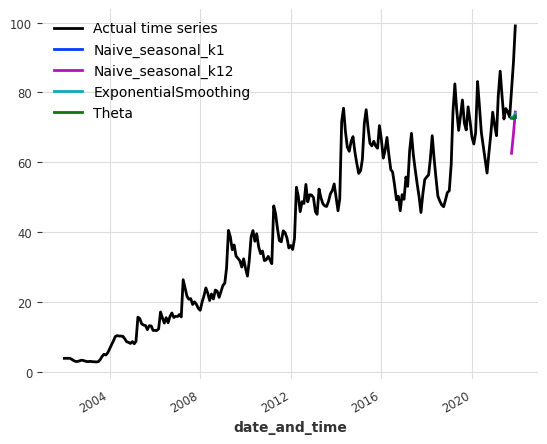

The results for index_colab_increm with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

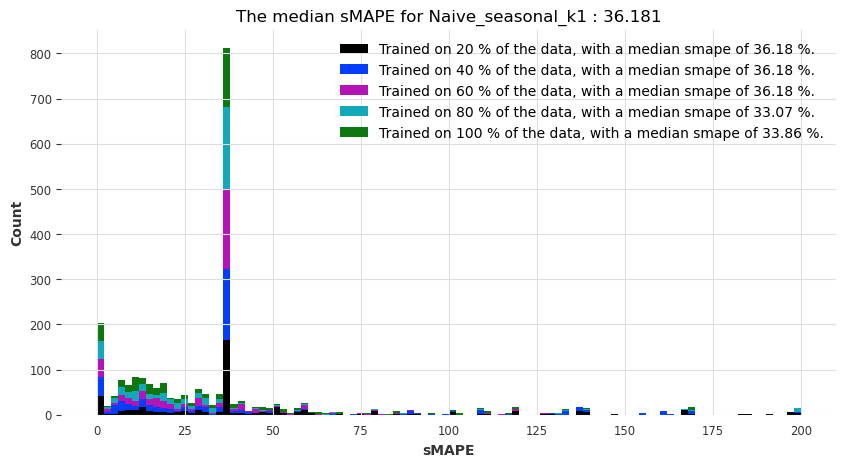

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

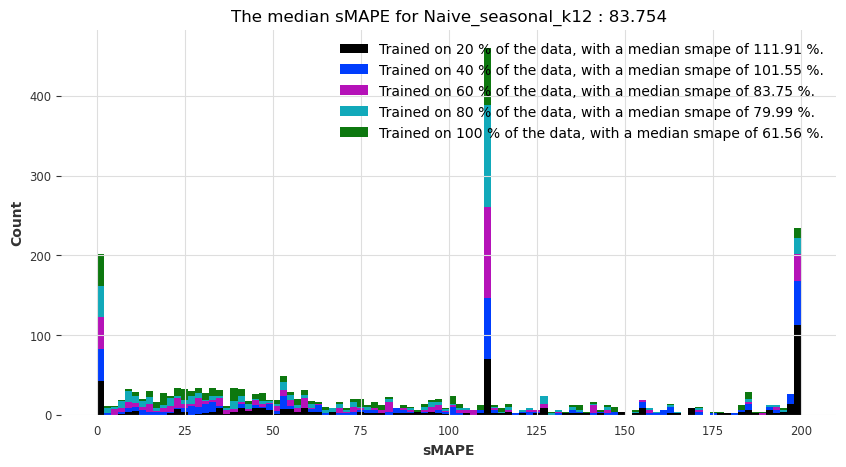

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

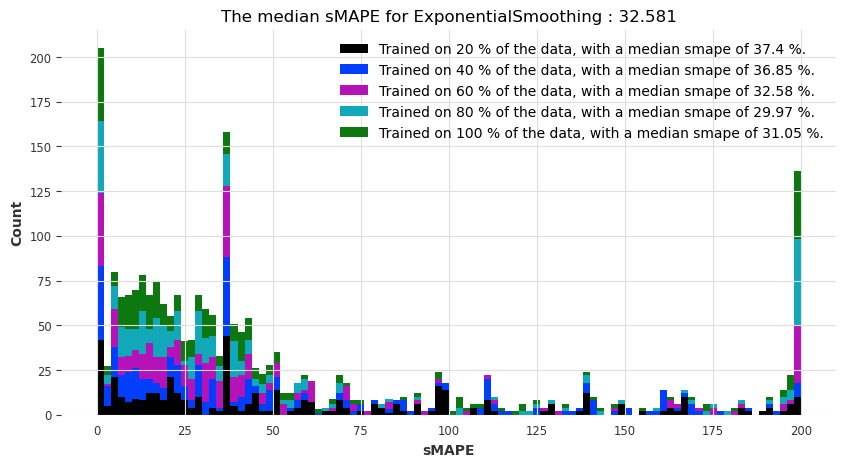

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

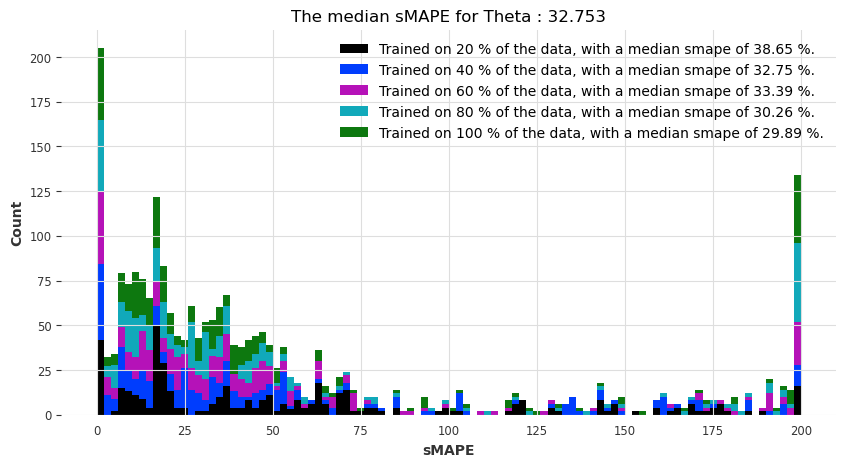

Visualization of performances taking the mean of the smapes over cross-validation


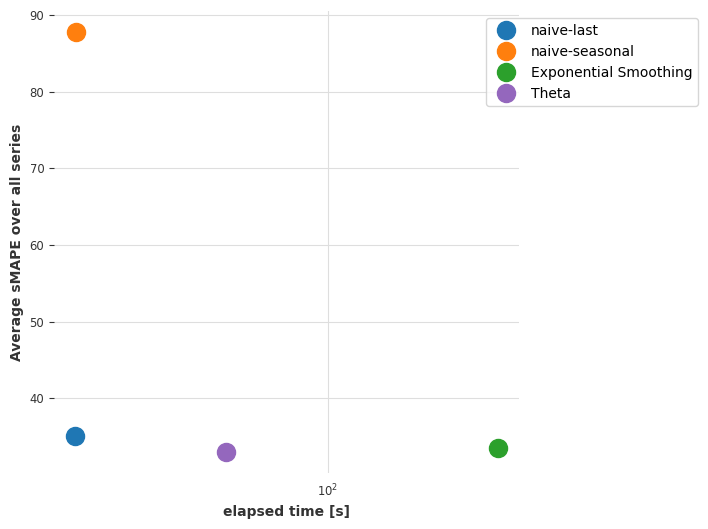

Visualization of performances taking the median of the smapes over cross-validation


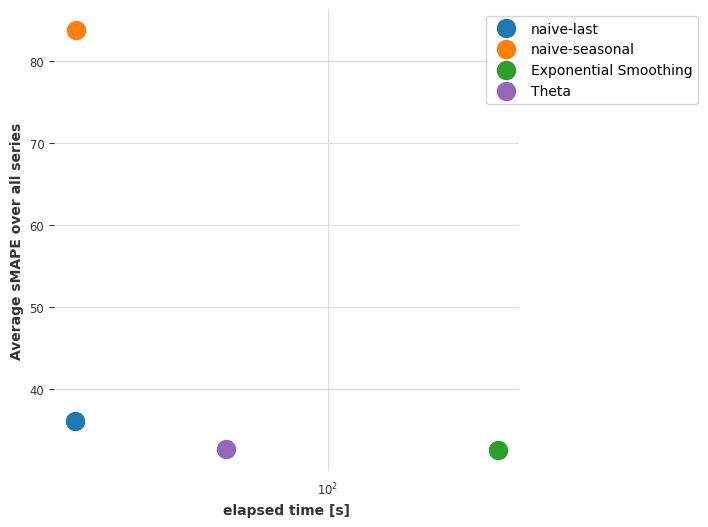

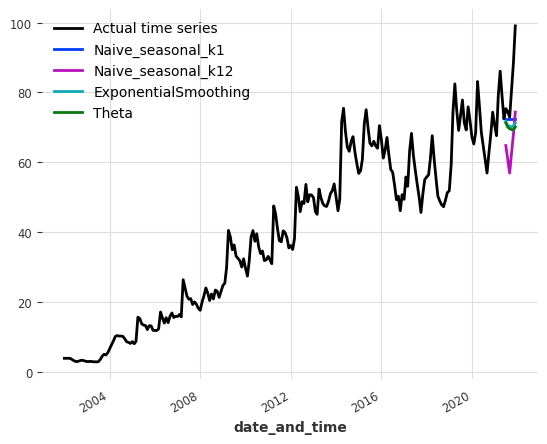

The results for index_colab_increm with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

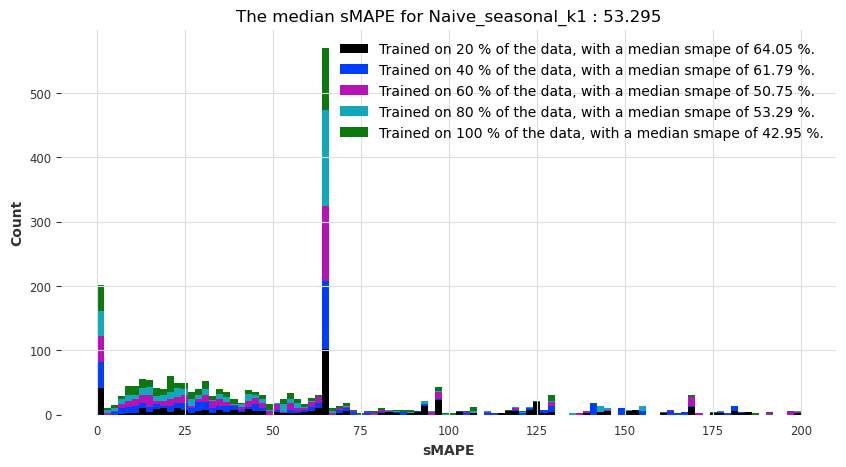

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

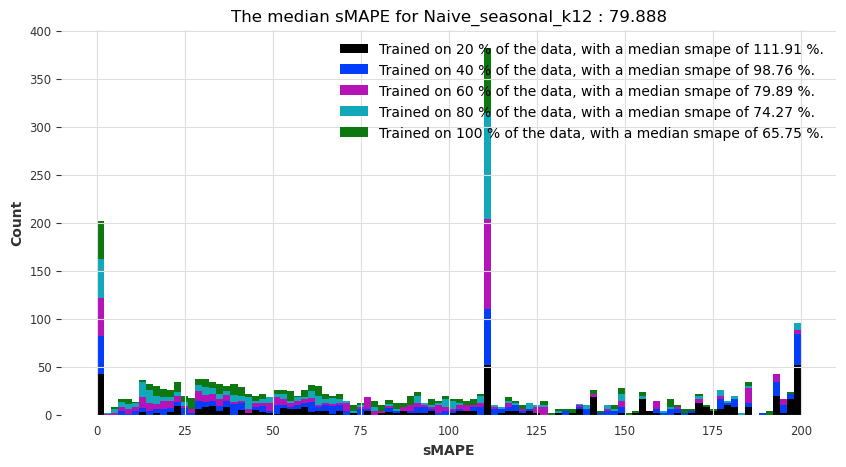

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

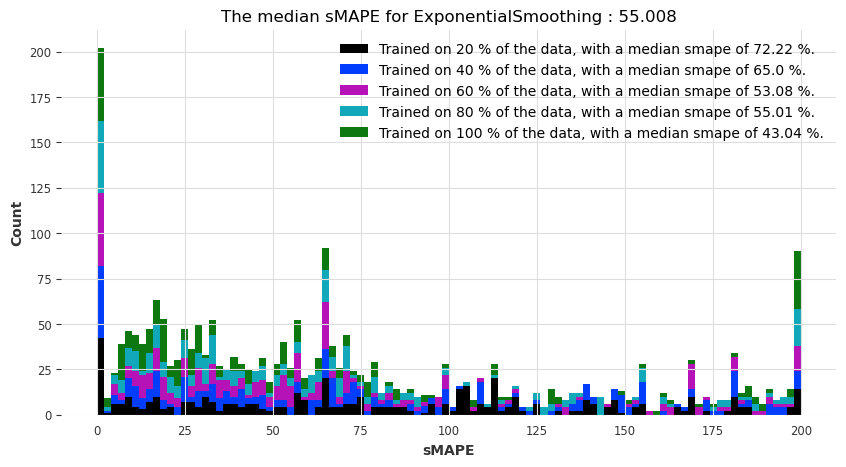

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

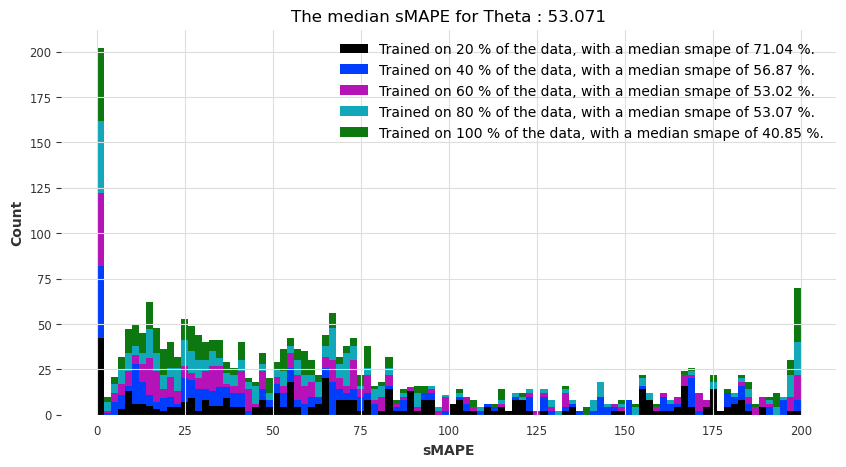

Visualization of performances taking the mean of the smapes over cross-validation


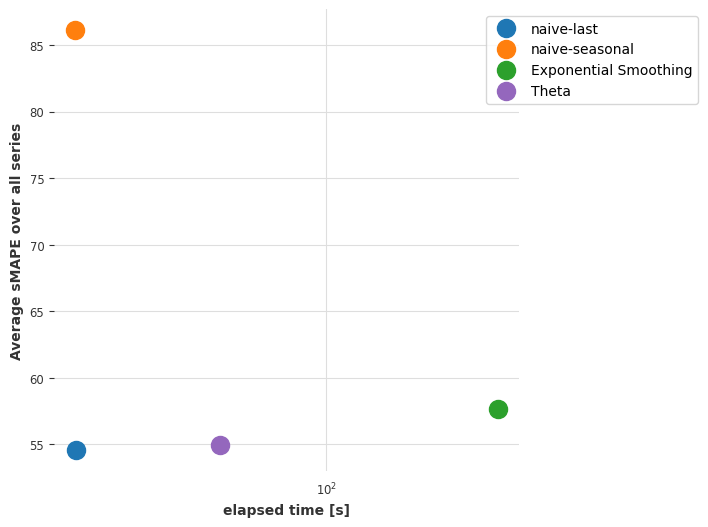

Visualization of performances taking the median of the smapes over cross-validation


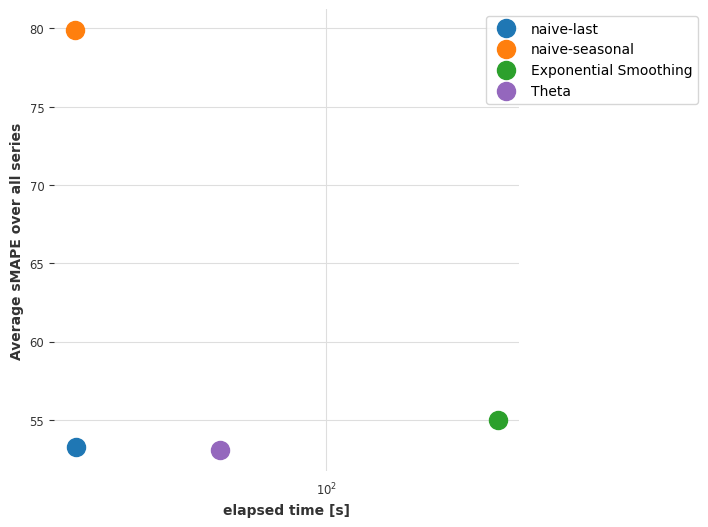

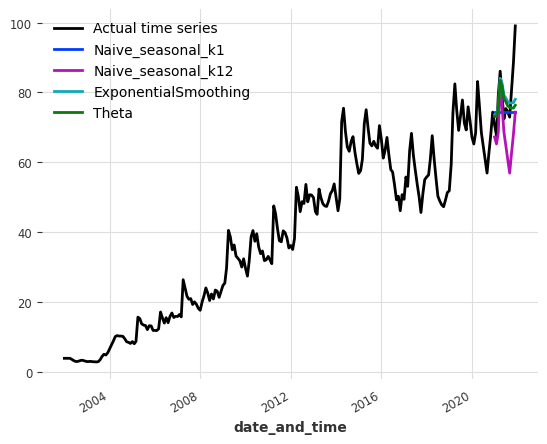

The results for index_colab_notincrem are:
The results for index_colab_notincrem with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

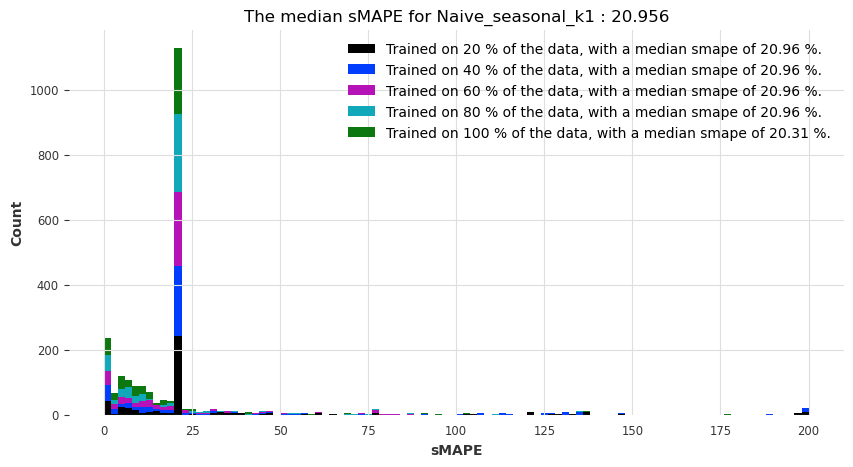

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

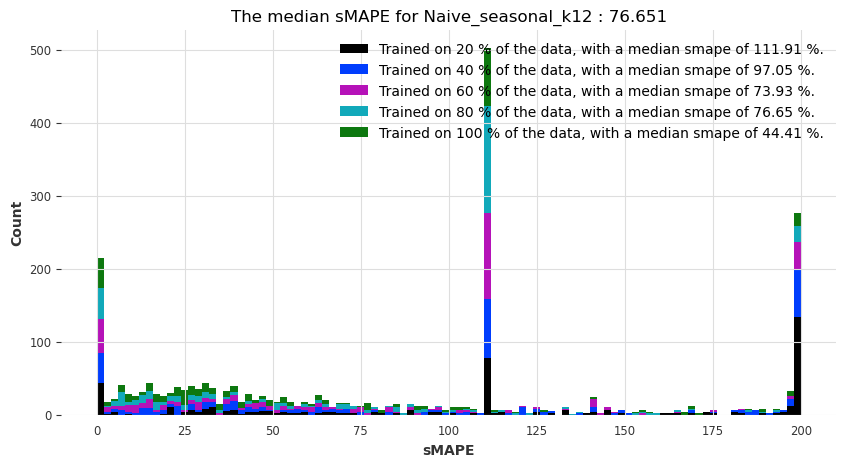

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

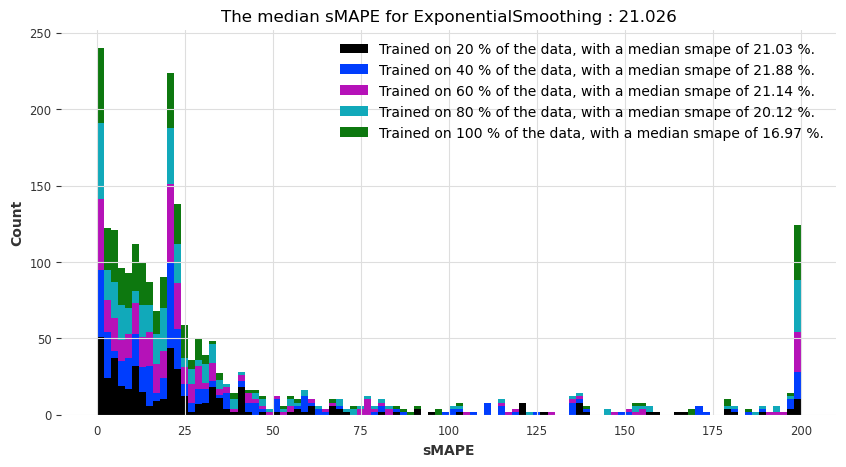

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

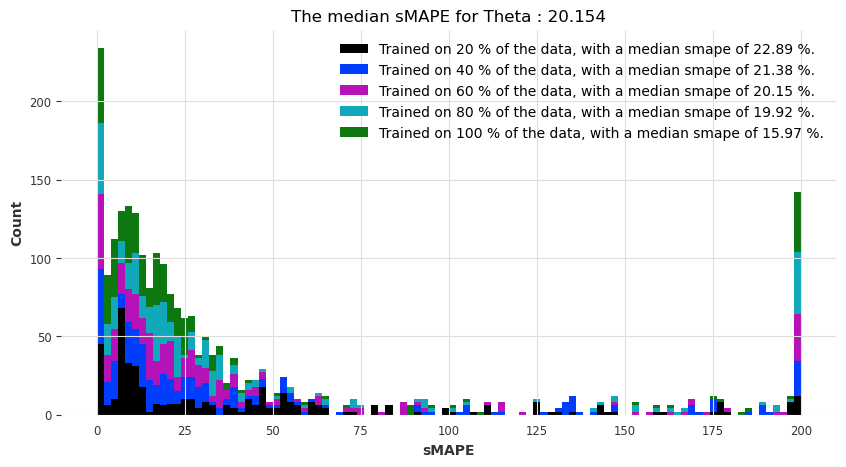

Visualization of performances taking the mean of the smapes over cross-validation


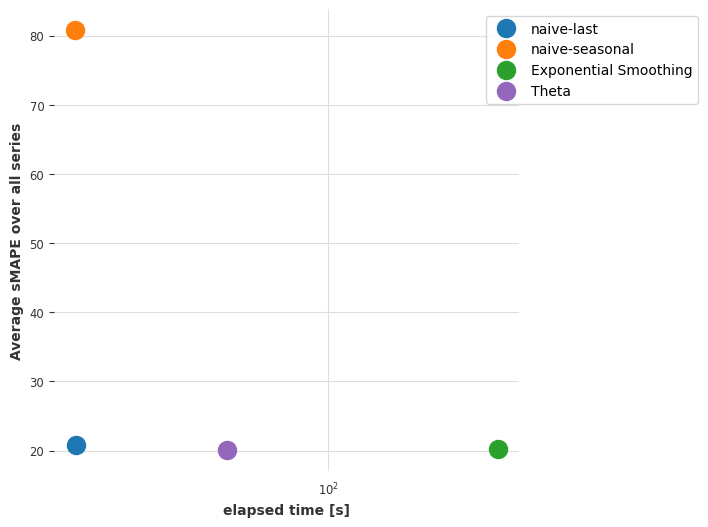

Visualization of performances taking the median of the smapes over cross-validation


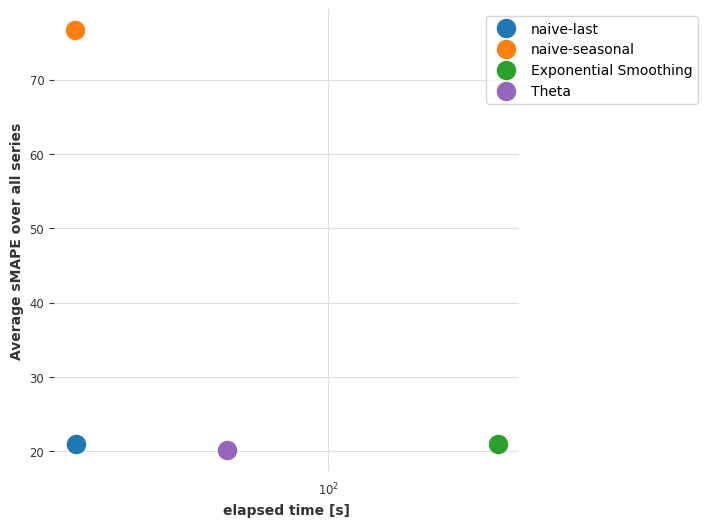

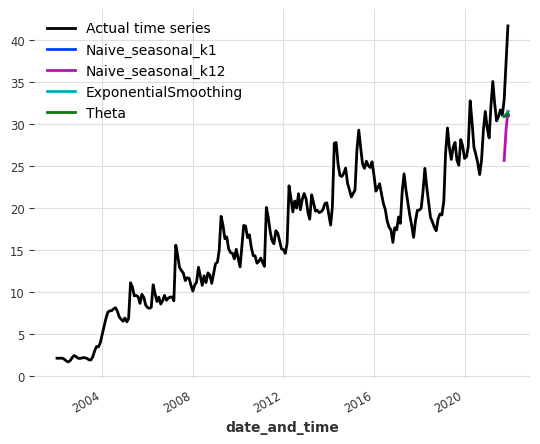

The results for index_colab_notincrem with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

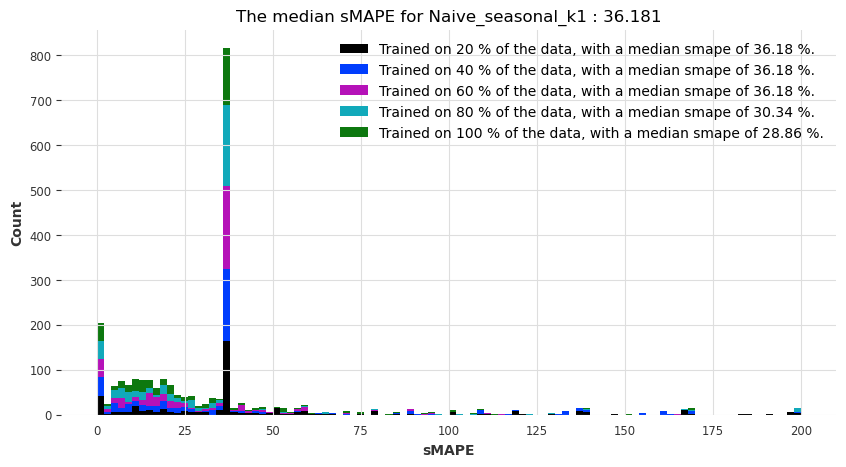

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

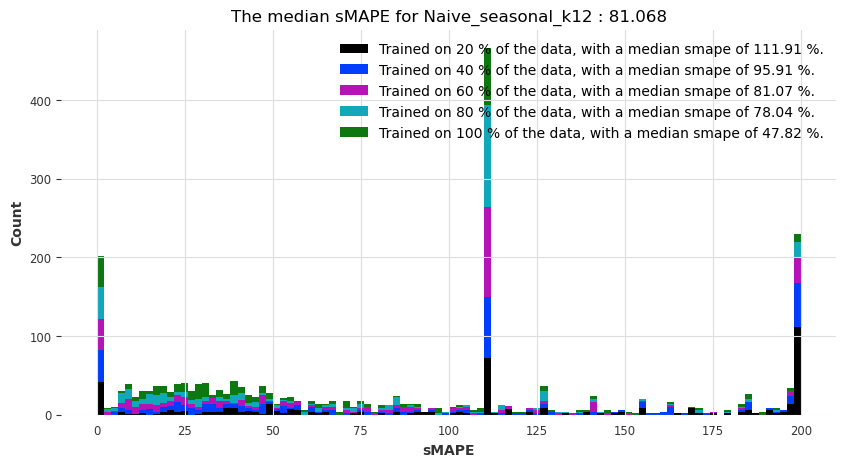

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

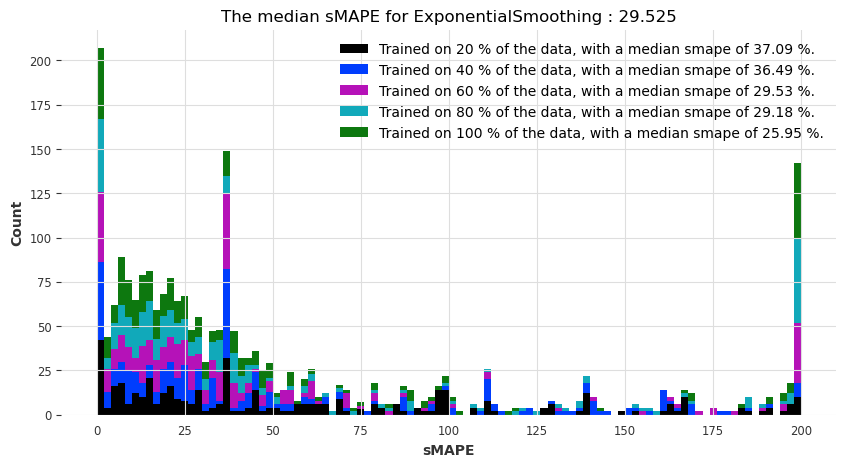

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

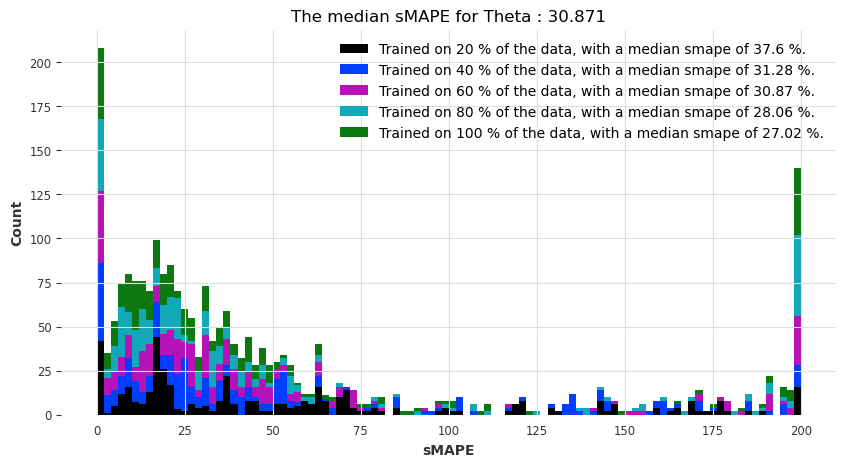

Visualization of performances taking the mean of the smapes over cross-validation


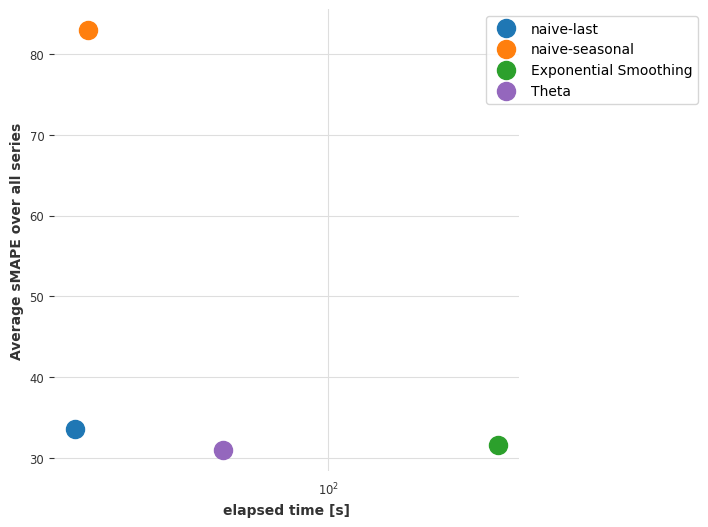

Visualization of performances taking the median of the smapes over cross-validation


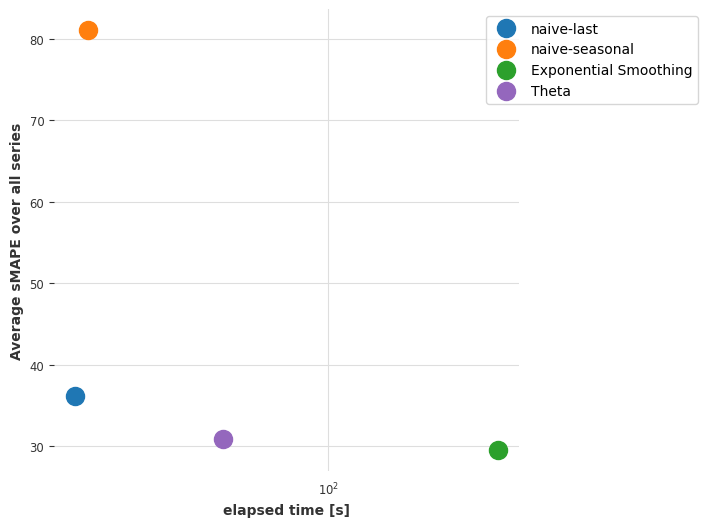

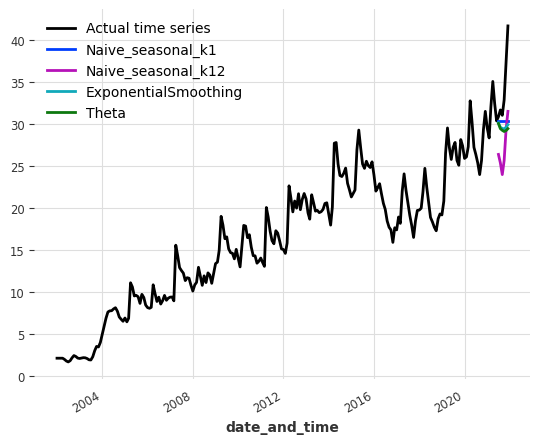

The results for index_colab_notincrem with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

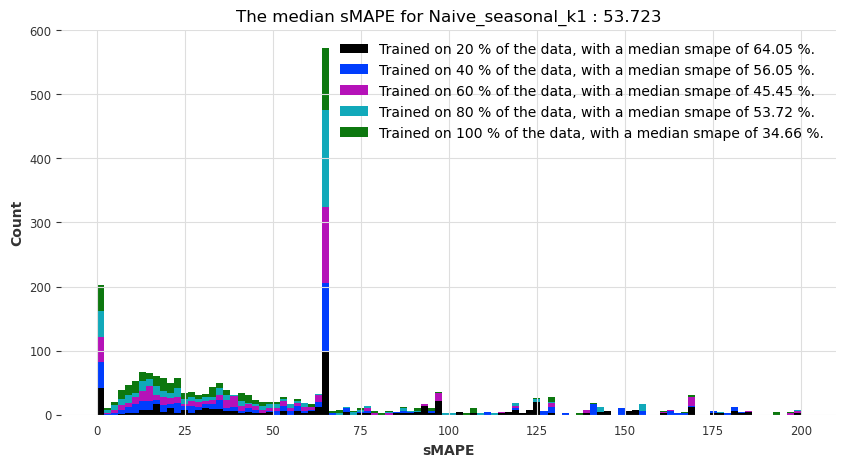

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

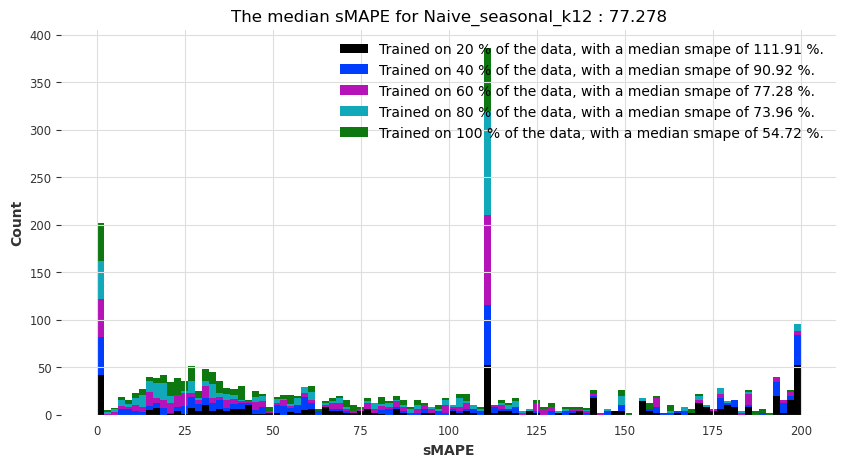

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

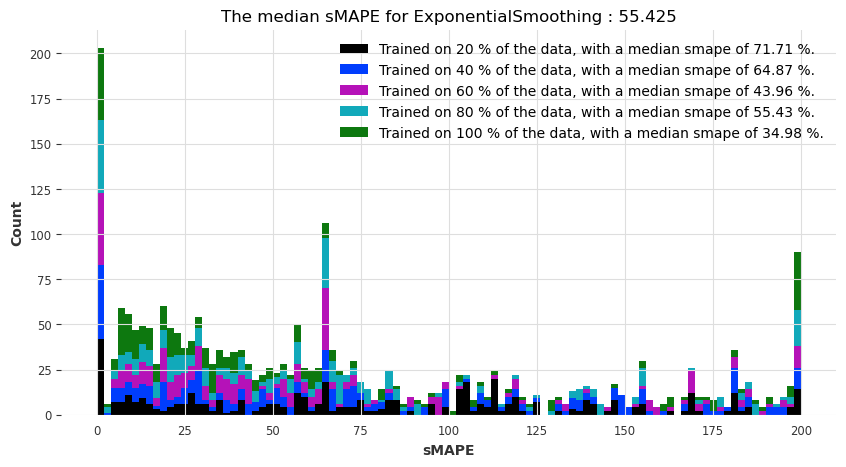

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

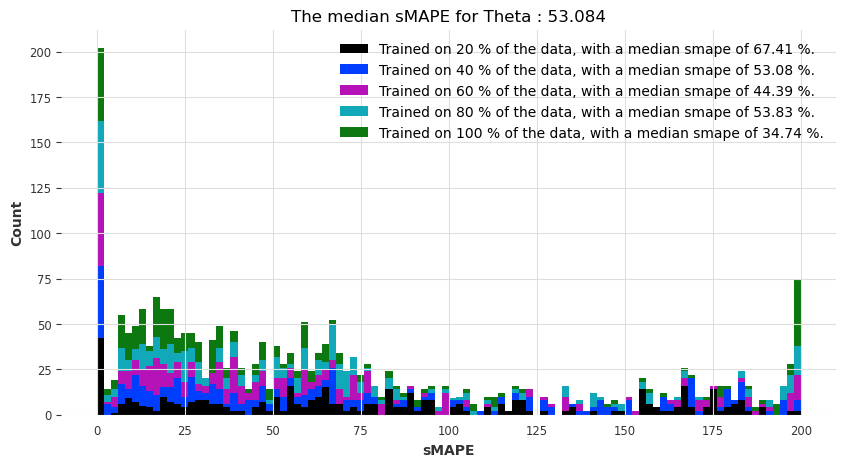

Visualization of performances taking the mean of the smapes over cross-validation


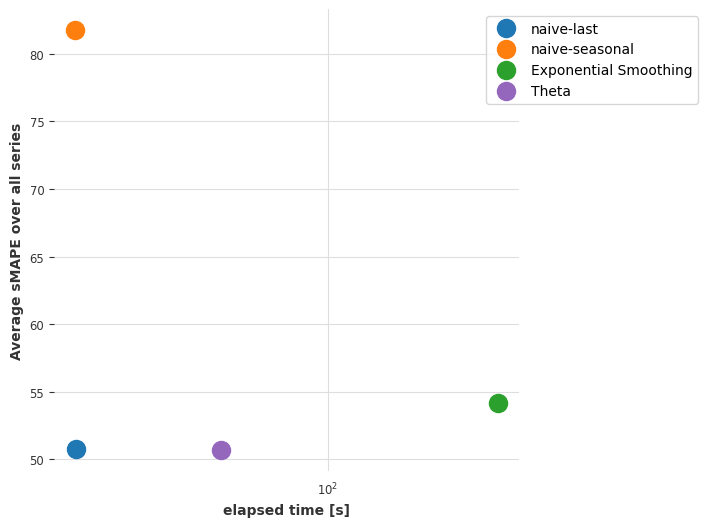

Visualization of performances taking the median of the smapes over cross-validation


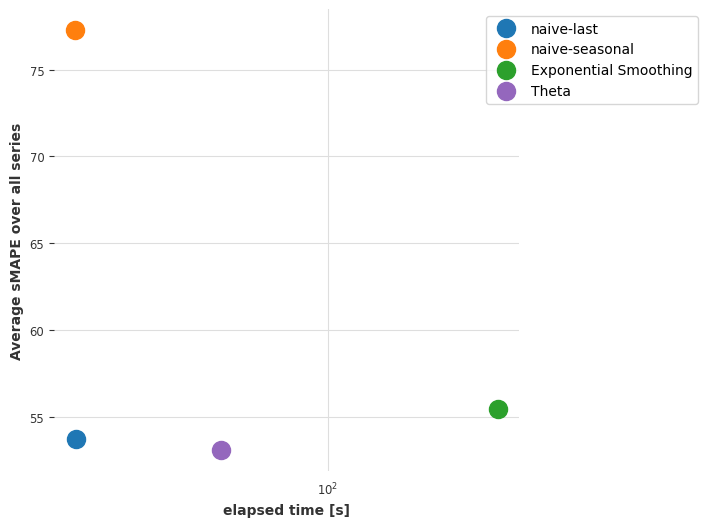

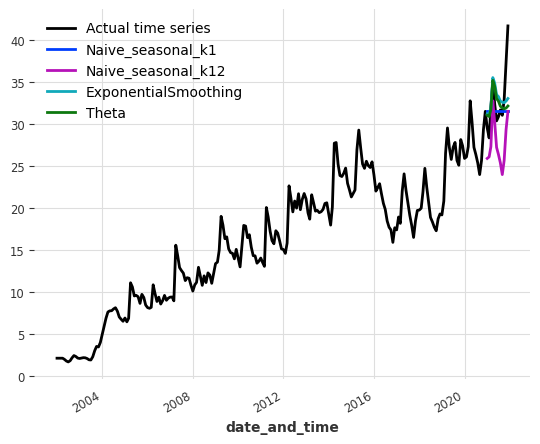

The results for index_keyword are:
The results for index_keyword with an horizon of 3 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

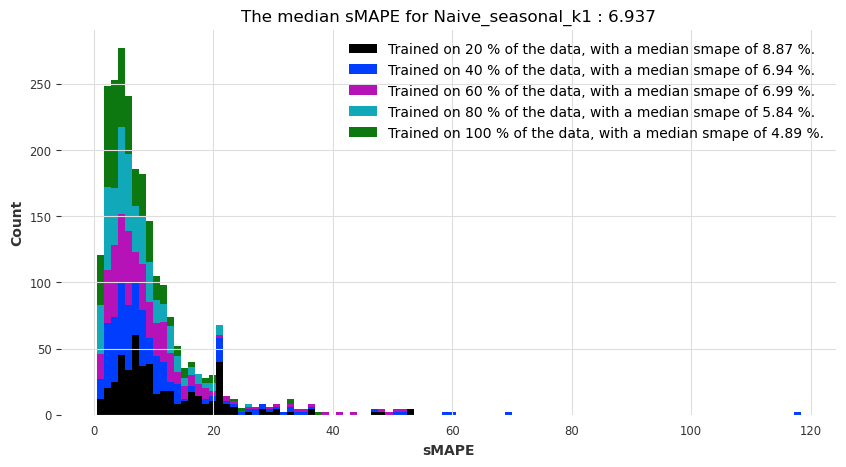

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

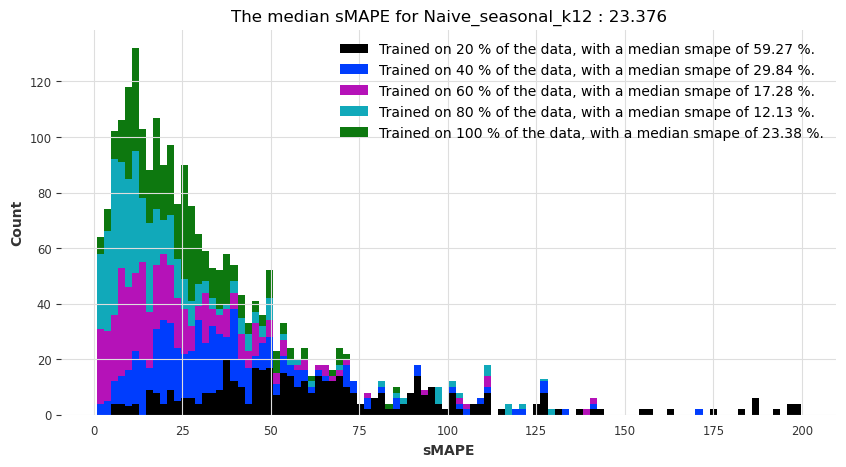

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

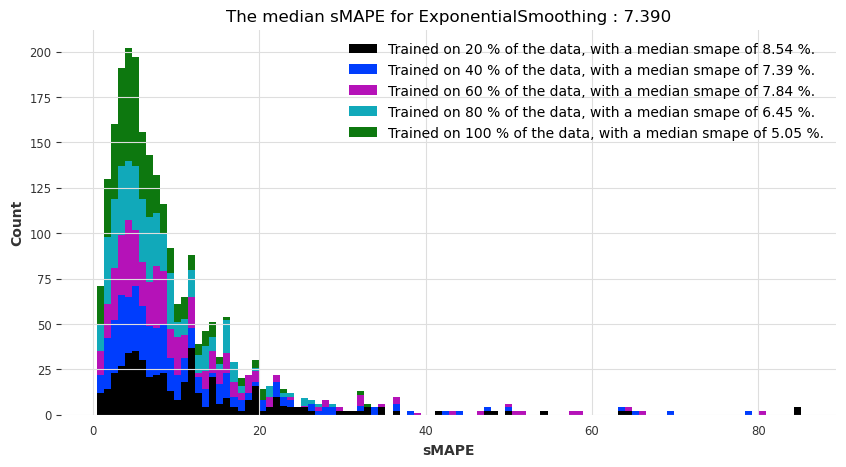

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

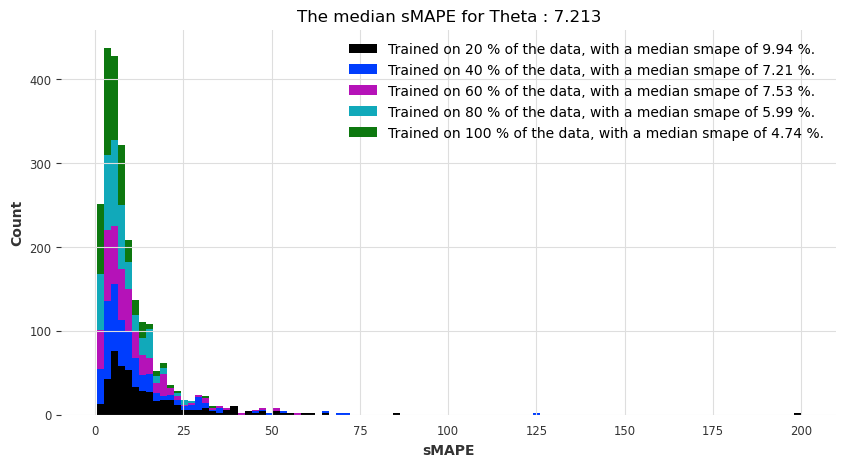

Visualization of performances taking the mean of the smapes over cross-validation


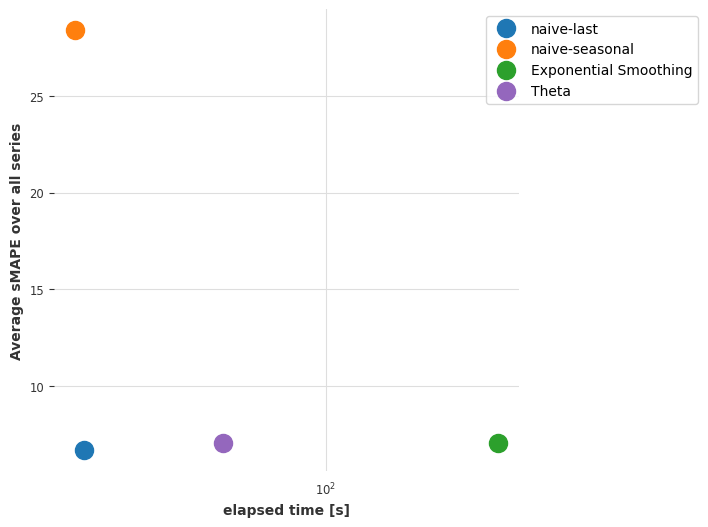

Visualization of performances taking the median of the smapes over cross-validation


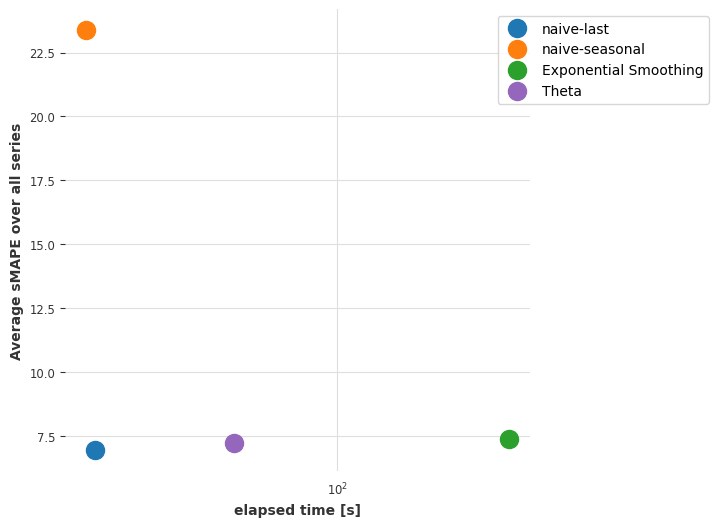

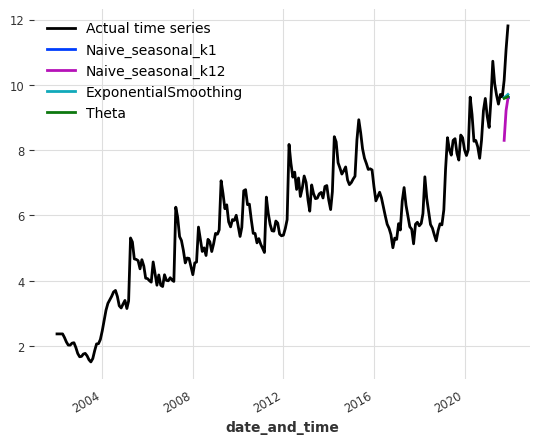

The results for index_keyword with an horizon of 6 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

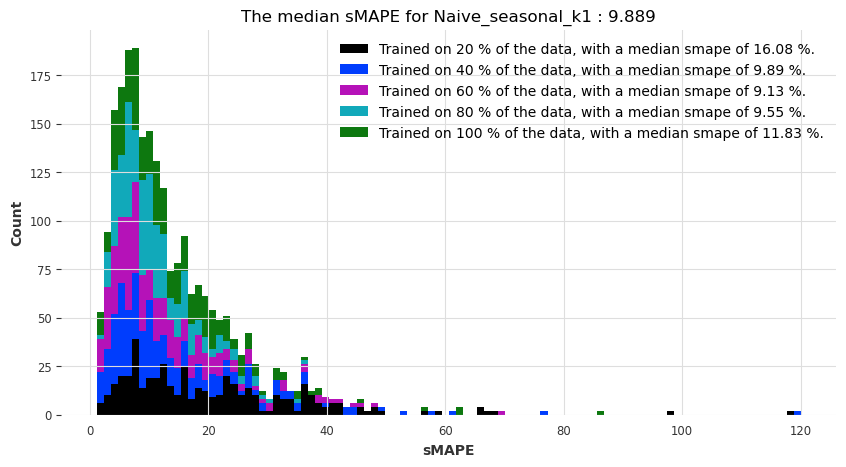

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

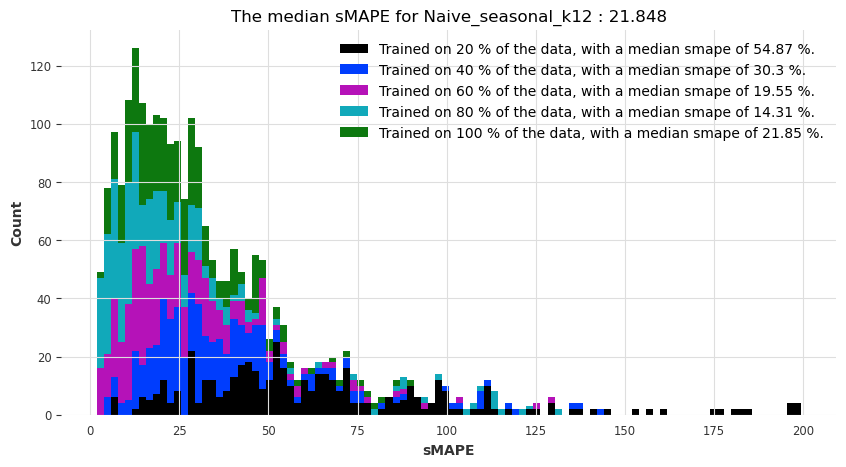

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

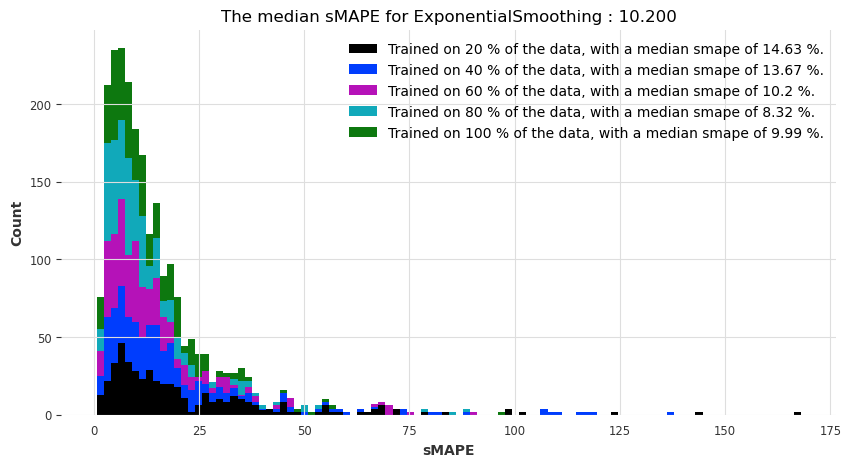

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

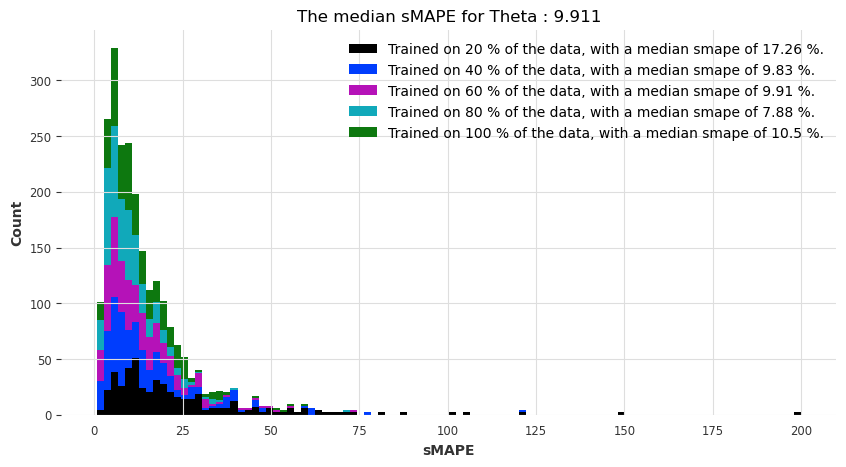

Visualization of performances taking the mean of the smapes over cross-validation


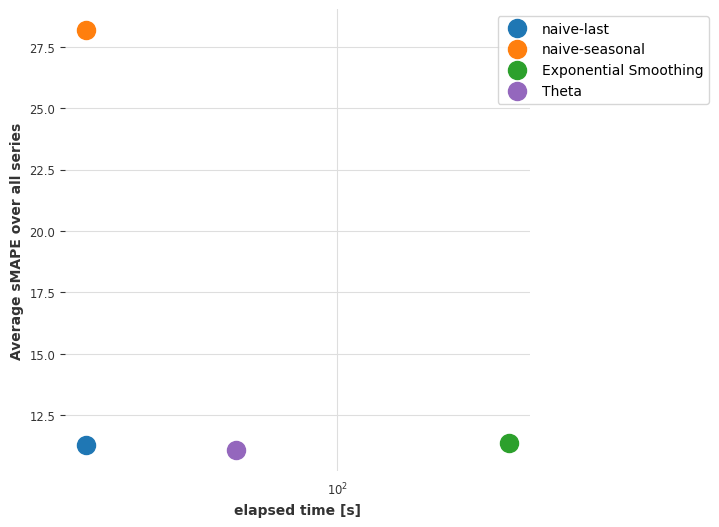

Visualization of performances taking the median of the smapes over cross-validation


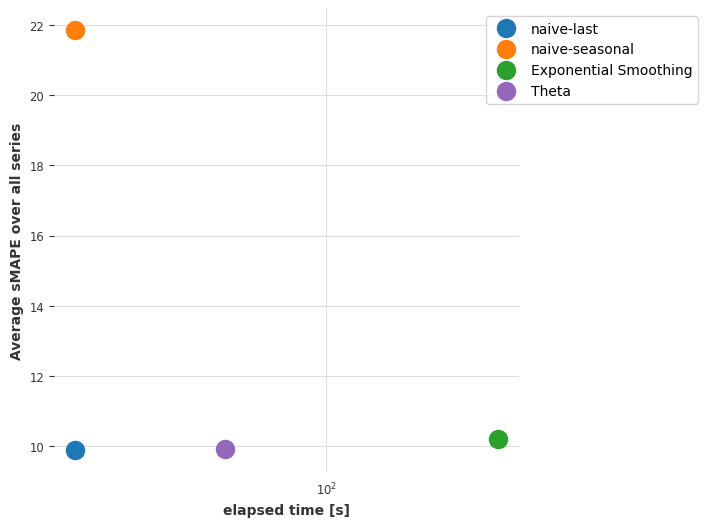

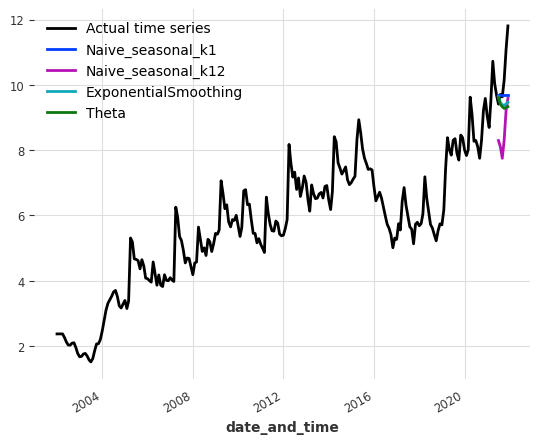

The results for index_keyword with an horizon of 12 are:


  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

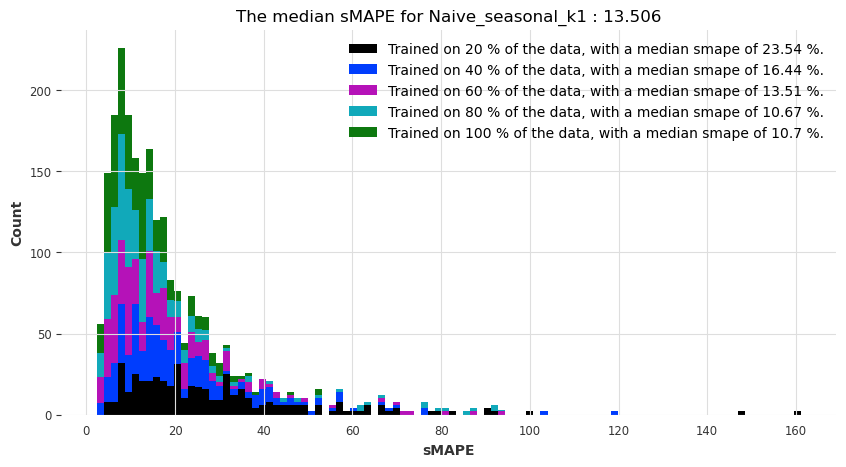

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

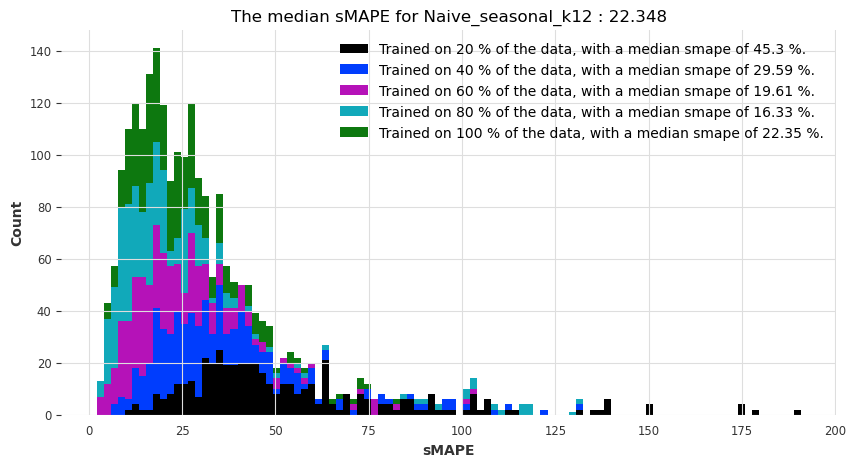

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

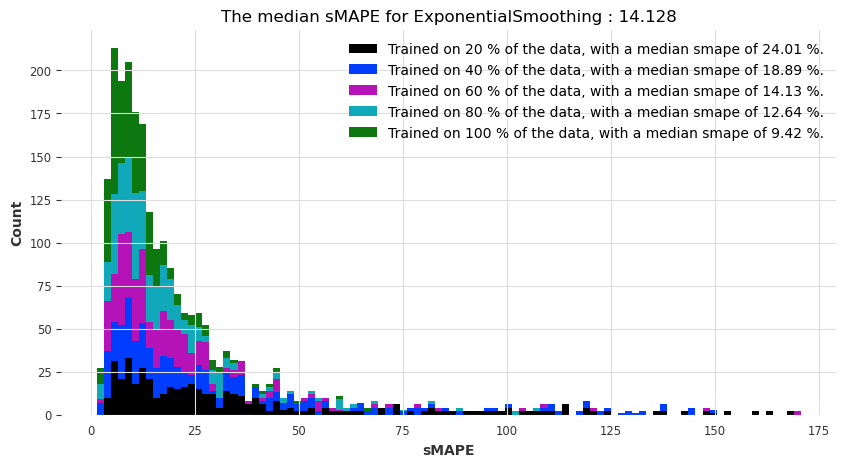

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

  0%|          | 0/470 [00:00<?, ?it/s]

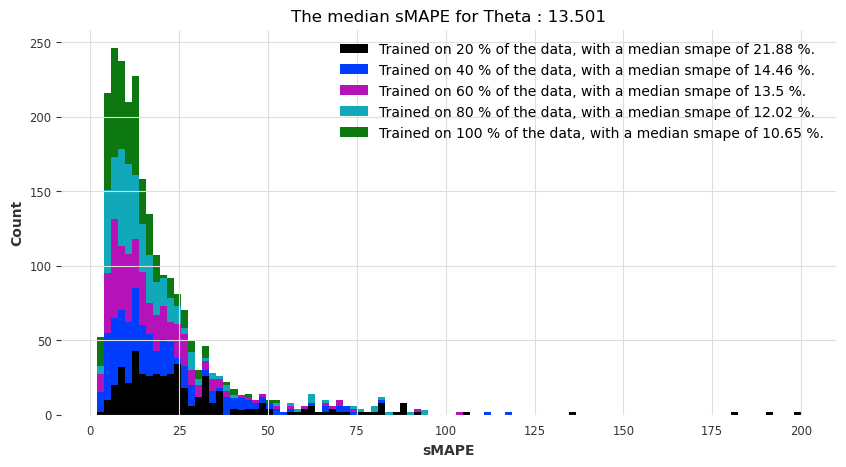

Visualization of performances taking the mean of the smapes over cross-validation


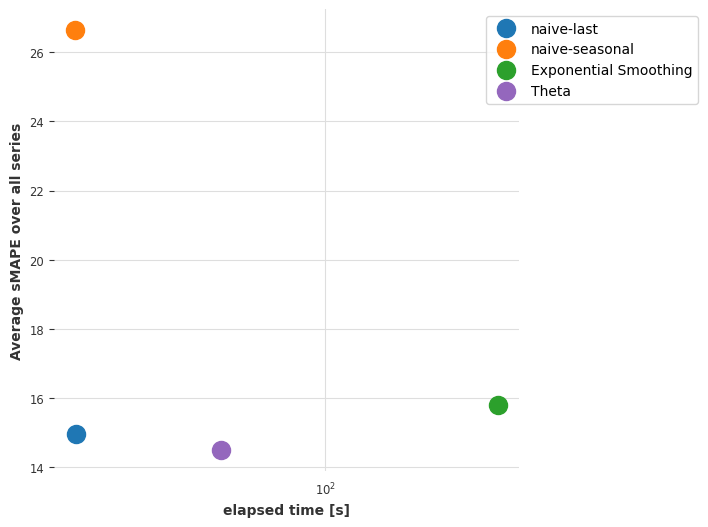

Visualization of performances taking the median of the smapes over cross-validation


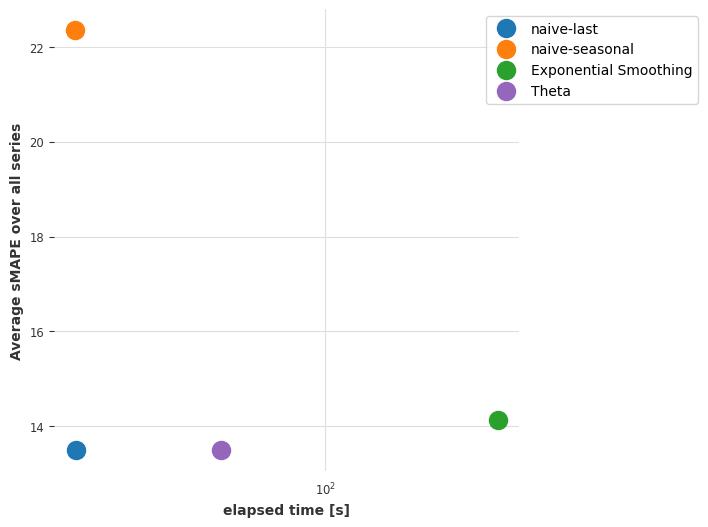

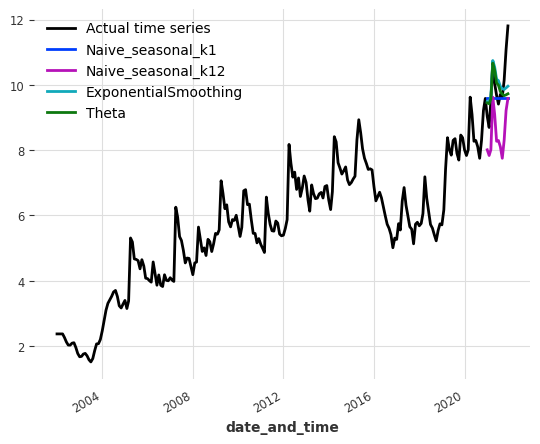

In [344]:
info_table = []
info_table_var=[]

for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    listindex_byalgo=[]

    for horizon in [3,6,12]:
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        
        naive1_smapes_mean,naive12_smapes_mean,ets_smapes_mean,theta_smapes_mean=\
        local_forecasting(dfofindex,horizon,list_concepts,5)
        
        listindex_byalgo =listindex_byalgo+\
        [naive1_smapes_mean,naive12_smapes_mean,ets_smapes_mean,theta_smapes_mean]

        
        plot_forecasting_models_local(modelnames,myforecasters,dfofindex,horizon,index) 
    
    list_toappend=[]    
    for i in range(4):
        for j in range(3):
            list_toappend.append(listindex_byalgo[i+j*4])
    info_table.append(list_toappend)

In [345]:
iterables = [["Naive seasonal (1)","Naive seasonal (12)", "Exponential smoothing","Theta"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0], 'Index citations t2-t1': info_table[1],
                   'Index colaboration incremental': info_table[2],'colaboration not incremental':info_table[3],
                   'Index keywords': info_table[4]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm  Forecasting horizon                          
Naive seasonal (1)    3 months                          3.896800   
                      6 months                          5.370474   
                      12 months                         8.283866   
Naive seasonal (12)   3 months                          3.022051   
                      6 months                          5.243748   
                      12 months                         9.669031   
Exponential smoothing 3 months                          1.530532   
                      6 months                          3.592965   
                      12 months                        10.103879   
Theta                 3 months                          1.997986   
                      6 months                          4.471085   
                      12 months                         8.181186   

                                           Index citations t2-t1  \
Forecaster algorithm  Forecasting horizon                          
Naive seasonal (1)    3 months                          3.896800   
                      6 months                          5.370474   
                      12 months                         8.283866   
Naive seasonal (12)   3 months                          3.022051   
                      6 months                          5.243748   
                      12 months                         9.669031   
Exponential smoothing 3 months                          1.530532   
                      6 months                          3.592965   
                      12 months                        10.103879   
Theta                 3 months                          1.997986   
                      6 months                          4.471085   
                      12 months                         8.181186   

                                           Index colaboration incremental  \
Forecaster algorithm  Forecasting horizon                                   
Naive seasonal (1)    3 months                                  20.956130   
                      6 months                                  35.094853   
                      12 months                                 54.564311   
Naive seasonal (12)   3 months                                  88.899359   
                      6 months                                  87.753683   
                      12 months                                 86.115010   
Exponential smoothing 3 months                                  20.392982   
                      6 months                                  33.568114   
                      12 months                                 57.668587   
Theta                 3 months                                  19.919638   
                      6 months                                  32.989953   
                      12 months                                 54.970471   

                                           colaboration not incremental  \
Forecaster algorithm  Forecasting horizon                                 
Naive seasonal (1)    3 months                                20.827183   
                      6 months                                33.549565   
                      12 months                               50.783428   
Naive seasonal (12)   3 months                                80.788962   
                      6 months                                82.948343   
                      12 months                               81.756129   
Exponential smoothing 3 months                                20.226602   
                      6 months                                31.645319   
                      12 months                               54.189319   
Theta                 3 months                                20.062703   
                      6 months                                30.966253   
                      12 months                               50.691579   

       

There are no models that perform the best overall. Nevertheless, the naive seasonal and exponential smoothing are the models that perform the best the most often. This is probably due to the fact, that a very high percent of time series (~25%) are flat and therefore predicting the last values is very accurate if not completely exact in these cases. Besides, the time series are very chaotic. For this reason, even if the other forecasting algorithms might model the overall tendency of the time series, they fail to be very accurate and this results in big errors. Nevertheless, the exponential algorithm performs very often as well as the naive K=1 model and even better sometimes.\
The index of collaboration are difficult to forecast. But it must be said, that our data is incomplete since many papers and informations from the second half of 2022 have not been uploaded on OpenAlex and for this reason, the indices decrease a lot and are difficult to forecast. I think, the forecasts are good, it is just that we have missing data, and therefore the indices drop even though, with the right data, the forecast would be probably very accurate.

# **Part 2 -- Global forecasting based on clustering**

We now do global forecasting on our time series using the clustering I created. It took 12 hours to run even without using k-cross validation.

<div class="alert-info">
2.1. Randomized clustering of the time series.
</div>

To see whether the clustering makes sense to forecasting we will attribute randomly each sample to the same number of clusters as present in the algorithm, do the forecasting and compare the results. We should keep in mind, that there are 1+numbercluster number of clusters, since I created artifically a cluster with all the time series that are very flat.

In [52]:
def clustering_df_rand(dftm,list_concepts,numbercluster):

    # creating a randomized clustering
    
    listcluster_rand=[]

    for concept1 in list_concepts:
        dfinter1=df_interpolation.loc[df_interpolation['concept1']==concept1]
        for concept2 in list_concepts:
            dfinter2=dfinter1.loc[dfinter1['concept2']==concept2]
            interpolation_score = dfinter2.interpolation_ratio.tolist()[0]
            for index in list_indices:
                if interpolation_score<0.5:
                    cluster_numbering= random.randint(1, numbercluster)
                    listcluster_rand.append(cluster_numbering)
    
    #Creating the dataframe with randomized cluster.
    dftm_rand=dftm.copy()
    dftm_rand['cluster']=listcluster_rand
    
    return dftm_rand

<div class="alert-info">
2.2. Forecasting and comparing the results between the randomized and algorithmic clustering
</div>

In [53]:
def split_data(data):
    lendata =len(data)
    len_train_data = 4*lendata//5
    len_test_tuning = lendata-len_train_data
    
    data_training = data[:len_train_data]
    data_tuning = data[len_train_data:]
    
    return data_training, data_tuning

data_tuning (to train model), data_training(to predict and evaluate smapes) => to plist in to be predicted and testing

In [54]:
def objective_linear_regression(trial):
    
    
    out_len = trial.suggest_int("out_len", 1, 12)
    
    torch.manual_seed(42)
    
    model = LinearRegressionModel(lags=windowslength-15, output_chunk_length=out_len)
    
    model.fit(data_training['Train tm'].tolist())

    preds = model.predict(series=data_tuning['Train tm'].tolist(), n=horizon)
    smapes = mysmape(data_tuning['Test tm'].tolist(), preds)

    
    smape_val = np.mean(smapes)

    return smape_val if smape_val != np.nan else float("inf")

In [55]:
def get_best_hyperparameter_lr(n_trials):
    
    study = optuna.create_study(direction="minimize")
    study.optimize(objective_linear_regression, n_trials=n_trials)

    return study.best_trial.params

In [56]:
def objective_LightGBMModel(trial):
    out_len = trial.suggest_int("out_len", 1, 12)

    
    torch.manual_seed(42)
    
    model = LightGBMModel(lags=windowslength-15, output_chunk_length=out_len)
    
    model.fit(data_training['Train tm'].tolist())

    
    preds = model.predict(series=data_tuning['Train tm'].tolist(), n=horizon)
    smapes = mysmape(data_tuning['Test tm'].tolist(), preds)
    
    smape_val = np.mean(smapes)

    return smape_val if smape_val != np.nan else float("inf")

In [57]:
def get_best_hyperparameter_lg(n_trials):
      
    study = optuna.create_study(direction="minimize")
    study.optimize(objective_LightGBMModel, n_trials=n_trials)

    return study.best_trial.params

In [58]:
def objective_RandomForest(trial):
    out_len = trial.suggest_int("out_len", 1, 12)
    n_estimators = trial.suggest_int("n_estimators", 50, 100)
    max_depth  = trial.suggest_int("max_depth", 5, 30)
    
    torch.manual_seed(42)
    
    model = RandomForest(lags=windowslength-15, output_chunk_length=out_len,n_estimators=n_estimators,max_depth=max_depth)
    
    model.fit(data_training['Train tm'].tolist())

    
    preds = model.predict(series=data_tuning['Train tm'].tolist(), n=horizon)
    smapes = mysmape(data_tuning['Test tm'].tolist(), preds)
    
    smape_val = np.mean(smapes)

    return smape_val if smape_val != np.nan else float("inf")

In [59]:
def get_best_hyperparameter_rf(n_trials):

    study = optuna.create_study(direction="minimize")
    study.optimize(objective_RandomForest, n_trials=n_trials)

    return study.best_trial.params

In [60]:
def return_hyperparameters_foralgo(modelname,n_trials):
    if modelname =="LinearRegressionModel":
        hyperparameters = get_best_hyperparameter_lr(n_trials)
        
    if modelname=="LightGBMModel":
        hyperparameters = get_best_hyperparameter_lg(n_trials)
        
    if modelname=="RandomForest":
        hyperparameters = get_best_hyperparameter_rf(n_trials)
        
    return hyperparameters

Comparing the different forecasting algorithms.

In [61]:
def eval_kcross_forecasts_cluster(smapes,modelname,addinfo):
    
    plt.close('all')
    themedians = []
    labels = []
    
    plt.figure(figsize=(10, 5))

    for i in range(len(smapes)):
        themedians.append(np.median(smapes[i]))
        #plt.hist(smapes[i], bins=100,label='K-cross set'+str(i+1))
        labels = labels +['Trained and forecasted on the cluster '+str(i)+\
        ' , with a median smape of '+ str(round(np.median(smapes[i]),2))+' %.']
        
    #plt.figure(figsize=(10, 5))
    plt.ylabel("Count")
    plt.xlabel("sMAPE")
    plt.title("The median sMAPE for "+str(modelname)+' '+str(addinfo)+" : %.3f" % np.median(themedians))
    #plt.yscale('log')

    
    plt.hist(smapes,bins=100,histtype='barstacked',label=labels)

  
    plt.legend()
    plt.show()
    plt.close()

In [62]:
def cross_validation_splitting_window_global_clustering(data,horizon,list_concepts,number_cv,modelname,forecaster,n_trials):
    
    time1=time.time()
    
    maximal_train_len = 240-horizon
    score_forecaster = []
    allsmapes=[]

    global data_training
    global data_tuning
    global windowslength
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =maximal_train_len//number_cv
            startingtime = i*windowslength
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            

            data_training, data_tuning=split_data(df)
            hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)

            
        else:
            windowslength = maximal_train_len-(number_cv-1)*(maximal_train_len//number_cv) # to get the remaining window
            startingtime = i*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
 
            data_training, data_tuning=split_data(df)
            hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)
     
        smapes=eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),\
        horizon,modelname,forecaster,windowslength-hyperparameters['out_len']-horizon,hyperparameters)
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window
        
    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    
    return elapsed_time,np.mean(myscores),np.median(myscores),allsmapes

In [63]:
def cross_validation_expanding_window_global_clustering(data,horizon,list_concepts,number_cv,modelname,forecaster,n_trials):
    
    time1=time.time()
    
    startingtime=0
    maximal_train_len = 240-horizon
    score_forecaster = []
    allsmapes=[]
    
    global data_training
    global data_tuning
    global windowslength
    
    for i in range(number_cv):
        if i<number_cv-1:
            windowslength =(i+1)*(maximal_train_len//number_cv)
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            
            data_training, data_tuning=split_data(df)
            hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)   
            
        else:
            windowslength = maximal_train_len
            df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
            
            data_training, data_tuning=split_data(df)
            hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)

        smapes=eval_global_model(df['Train tm'].tolist(),df['Test tm'].tolist(),\
        horizon,modelname,forecaster,windowslength-hyperparameters['out_len']-horizon,hyperparameters)
        
        allsmapes.append(smapes)
        score_forecaster.append(np.median(smapes))
        # I save the mean of the all the smapes done over one window


    myscores =np.array(score_forecaster)
    
    time2=time.time()
    elapsed_time = time2-time1
    
    plt.plot()

    return elapsed_time,np.mean(myscores),np.median(myscores),allsmapes

In [64]:
def cluster_computation(dftm, dftm_rand,horizon,numbercluster,list_concepts,number_cv,modelname,forecaster,n_trials):
    
    elapsed_time_rand=[]
    error_rand_mean=[]
    error_rand_med=[]
    
    allsmapes_rand = []
    # once I created my dataframe with this specific horizon I train and visualize the results of the forecasting algorithms

    print('Randomized clustering')
    for i in tqdm(range(1,numbercluster+1)):

        mydf_rand= dftm_rand.loc[dftm_rand['cluster']==int(i)]
        
        time_rand, smapes_rand_mean,smapes_rand_med,smapes_rand =\
        cross_validation_expanding_window_global_clustering(mydf_rand,\
        horizon,list_concepts,number_cv,modelname,forecaster,n_trials)

        elapsed_time_rand.append(time_rand)
        error_rand_mean.append(smapes_rand_mean)
        error_rand_med.append(smapes_rand_med)
        allsmapes_rand.append(list(chain.from_iterable(smapes_rand)))

    
    eval_kcross_forecasts_cluster(allsmapes_rand,modelname,'randomized')
    
        
    elapsed_time=[]
    error_mean=[]
    error_med=[]
    
    allsmapes = []
    
    print('Algorithmic clustering based on similarity')
    for i in tqdm(range(1,numbercluster+1)):     

        mydf= dftm.loc[dftm['cluster']==int(i)]
        
        time_normal, smapes_mean,smapes_med,smapes_normal =\
        cross_validation_expanding_window_global_clustering(mydf,\
        horizon,list_concepts,number_cv,modelname,forecaster,n_trials)
        
        elapsed_time.append(time_normal)
        error_mean.append(smapes_mean)
        error_med.append(smapes_med)
        allsmapes.append(list(chain.from_iterable(smapes_normal)))
    
    eval_kcross_forecasts_cluster(allsmapes,modelname,'not-randomized')
    
    smapes_rand = np.mean(error_rand_mean)
    time_rand = np.mean(elapsed_time_rand)
    smapes = np.mean(error_mean)
    time = np.mean(elapsed_time)
    
    return smapes_rand,time_rand,smapes,time 

In [65]:
def clustering_forecasting(dftm,dftm_rand,horizon,numbercluster,list_concepts,number_cv,n_trials):
    
    # number of datapoints considered to forecast
    # I substracted -3, because I was having problems with the authorized lags in the function  

    print(' ')
    
    lr_smapes_rand,lr_time_rand,lr_smapes,lr_time\
    = cluster_computation(dftm, dftm_rand,horizon,numbercluster,\
    list_concepts,number_cv,'LinearRegressionModel',LinearRegressionModel,n_trials)
        
    print(' ')
        
    lgbm_smapes_rand,lgbm_time_rand,lgbm_smapes,lgbm_time\
    = cluster_computation(dftm, dftm_rand,horizon,numbercluster,\
    list_concepts,number_cv,'LightGBMModel',LightGBMModel, n_trials)
    
    print(' ')
    
    rf_smapes_rand,rf_time_rand,rf_smapes,rf_time\
    = cluster_computation(dftm, dftm_rand,horizon,numbercluster,\
    list_concepts,number_cv,'RandomForest',RandomForest, n_trials)
    
    # visualization of the results 

    
    smapes_2 = {
        "Linear Regression": lr_smapes,
        "LGBM": lgbm_smapes,
        "Random Forest": rf_smapes,
        
        "Linear Regression_rand": lr_smapes_rand,
        "LGBM_rand": lgbm_smapes_rand,
        "Random Forest_rand": rf_smapes_rand,
    }

    elapsed_times_2 = {
        "Linear Regression": lr_time,
        "LGBM": lgbm_time,
        "Random Forest": rf_time,
        
        "Linear Regression_rand": lr_time_rand,
        "LGBM_rand": lgbm_time_rand,
        "Random Forest_rand": rf_time_rand,
    }

    plot_models_global(elapsed_times_2, smapes_2)
    
    return lr_smapes,lgbm_smapes,rf_smapes,lr_smapes_rand,lgbm_smapes_rand,rf_smapes_rand

In [360]:
myforecasters = [LinearRegressionModel,LightGBMModel,RandomForest]
modelnames = ["LinearRegressionModel","LightGBMModel","RandomForest"]

In [361]:
numbercluster = max(dftm.cluster.tolist())
numbercluster

6

In [362]:
dftm_rand=clustering_df_rand(dftm,list_concepts,numbercluster)

We just do without cross-validation, because with cross validation it is way to long. At least this can give us a reasonable idea of the performance of clustering forecasting.

The results for index_cit_t1_t2 are:
The results for index_cit_t1_t2 with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 18:36:51,555] A new study created in memory with name: no-name-8d5b033e-647f-4c39-a2a6-ca244daaac4e
[I 2023-01-27 18:36:55,540] Trial 0 finished with value: 93.9164970621216 and parameters: {'out_len': 11}. Best is trial 0 with value: 93.9164970621216.
[I 2023-01-27 18:36:59,505] Trial 1 finished with value: 93.1720628710435 and parameters: {'out_len': 6}. Best is trial 1 with value: 93.1720628710435.
[I 2023-01-27 18:37:03,785] Trial 2 finished with value: 96.7039371493515 and parameters: {'out_len': 12}. Best is trial 1 with value: 93.1720628710435.
[I 2023-01-27 18:37:09,021] Trial 3 finished with value: 84.75322084517931 and parameters: {'out_len': 7}. Best is trial 3 with value: 84.75322084517931.
[I 2023-01-27 18:37:13,064] Trial 4 finished with value: 93.1720628710435 and parameters: {'out_len': 6}. Best is trial 3 with value: 84.75322084517931.
[I 2023-01-27 18:37:17,194] Trial 5 finished with value: 96.7039371493515 and parameters: {'out_len': 12}. Best is trial 

[I 2023-01-27 18:39:54,413] Trial 1 finished with value: 90.81584102577081 and parameters: {'out_len': 9}. Best is trial 0 with value: 77.17837014082701.
[I 2023-01-27 18:39:58,597] Trial 2 finished with value: 89.01323921427931 and parameters: {'out_len': 4}. Best is trial 0 with value: 77.17837014082701.
[I 2023-01-27 18:40:01,852] Trial 3 finished with value: 90.19011125054737 and parameters: {'out_len': 1}. Best is trial 0 with value: 77.17837014082701.
[I 2023-01-27 18:40:05,056] Trial 4 finished with value: 94.12395673660419 and parameters: {'out_len': 3}. Best is trial 0 with value: 77.17837014082701.
[I 2023-01-27 18:40:08,289] Trial 5 finished with value: 89.01323921427931 and parameters: {'out_len': 4}. Best is trial 0 with value: 77.17837014082701.
[I 2023-01-27 18:40:11,618] Trial 6 finished with value: 99.9999976267948 and parameters: {'out_len': 11}. Best is trial 0 with value: 77.17837014082701.
[I 2023-01-27 18:40:14,901] Trial 7 finished with value: 99.9999976267948 an

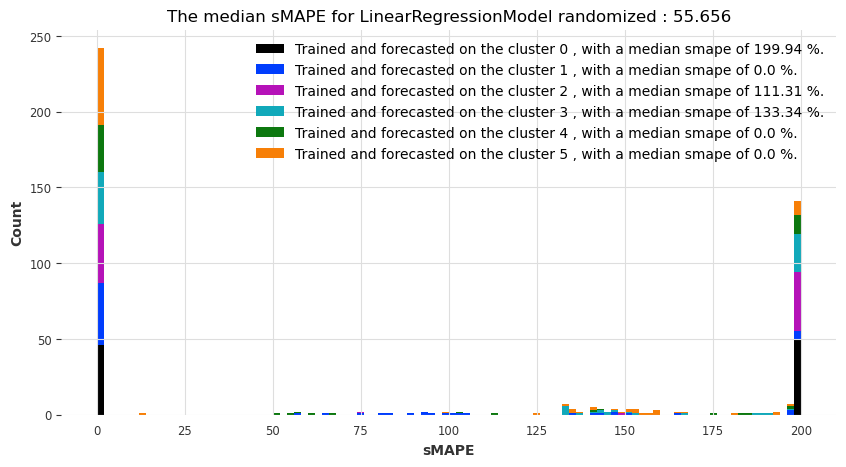

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 18:42:31,425] A new study created in memory with name: no-name-0aab386e-3508-4298-9b6c-59ef3d8212a2
[I 2023-01-27 18:42:34,300] Trial 0 finished with value: 68.5974735725623 and parameters: {'out_len': 4}. Best is trial 0 with value: 68.5974735725623.
[I 2023-01-27 18:42:37,361] Trial 1 finished with value: 72.01504681179065 and parameters: {'out_len': 5}. Best is trial 0 with value: 68.5974735725623.
[I 2023-01-27 18:42:41,401] Trial 2 finished with value: 73.76751683825357 and parameters: {'out_len': 3}. Best is trial 0 with value: 68.5974735725623.
[I 2023-01-27 18:42:44,338] Trial 3 finished with value: 78.70792351962008 and parameters: {'out_len': 1}. Best is trial 0 with value: 68.5974735725623.
[I 2023-01-27 18:42:47,431] Trial 4 finished with value: 78.29739890538161 and parameters: {'out_len': 8}. Best is trial 0 with value: 68.5974735725623.
[I 2023-01-27 18:42:50,489] Trial 5 finished with value: 64.35514393619037 and parameters: {'out_len': 10}. Best is trial 

[I 2023-01-27 18:44:47,401] Trial 1 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:44:47,668] Trial 2 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:44:47,935] Trial 3 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:44:48,186] Trial 4 finished with value: 0.0 and parameters: {'out_len': 2}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:44:48,469] Trial 5 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:44:48,736] Trial 6 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:44:49,018] Trial 7 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:44:49,285] Trial 8 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with va

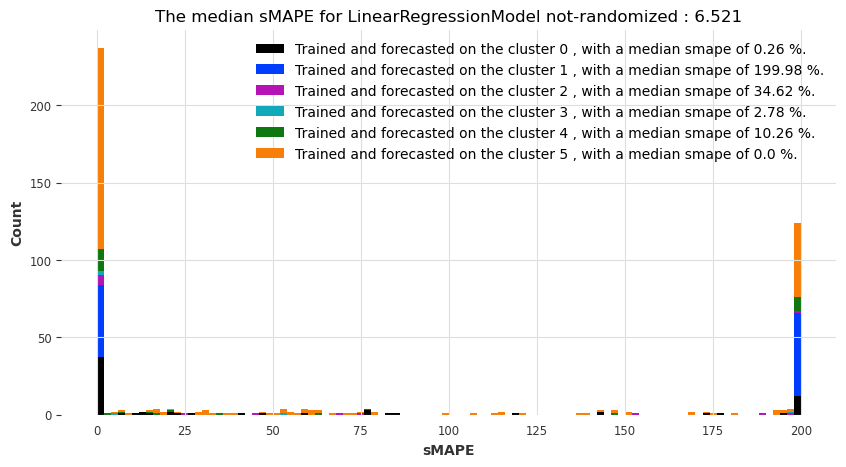

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 18:48:11,425] A new study created in memory with name: no-name-326ee54d-60cf-4632-ae2c-6aaaff89b530
[I 2023-01-27 18:48:17,696] Trial 0 finished with value: 88.59672843777837 and parameters: {'out_len': 10}. Best is trial 0 with value: 88.59672843777837.
[I 2023-01-27 18:48:22,981] Trial 1 finished with value: 88.59672843777837 and parameters: {'out_len': 10}. Best is trial 0 with value: 88.59672843777837.
[I 2023-01-27 18:48:28,385] Trial 2 finished with value: 86.35461226166309 and parameters: {'out_len': 9}. Best is trial 2 with value: 86.35461226166309.
[I 2023-01-27 18:48:32,708] Trial 3 finished with value: 70.85268870669167 and parameters: {'out_len': 1}. Best is trial 3 with value: 70.85268870669167.
[I 2023-01-27 18:48:37,928] Trial 4 finished with value: 74.61221483873639 and parameters: {'out_len': 3}. Best is trial 3 with value: 70.85268870669167.
[I 2023-01-27 18:48:44,388] Trial 5 finished with value: 95.80056984932617 and parameters: {'out_len': 7}. Best is

[I 2023-01-27 18:51:56,927] Trial 1 finished with value: 94.34448093637863 and parameters: {'out_len': 1}. Best is trial 0 with value: 92.85730942411391.
[I 2023-01-27 18:52:01,392] Trial 2 finished with value: 95.9372487591487 and parameters: {'out_len': 10}. Best is trial 0 with value: 92.85730942411391.
[I 2023-01-27 18:52:05,923] Trial 3 finished with value: 95.92639763127715 and parameters: {'out_len': 8}. Best is trial 0 with value: 92.85730942411391.
[I 2023-01-27 18:52:10,272] Trial 4 finished with value: 95.9372487591487 and parameters: {'out_len': 10}. Best is trial 0 with value: 92.85730942411391.
[I 2023-01-27 18:52:13,861] Trial 5 finished with value: 94.34448093637863 and parameters: {'out_len': 1}. Best is trial 0 with value: 92.85730942411391.
[I 2023-01-27 18:52:17,746] Trial 6 finished with value: 97.67298965481096 and parameters: {'out_len': 2}. Best is trial 0 with value: 92.85730942411391.
[I 2023-01-27 18:52:23,109] Trial 7 finished with value: 95.9372487591487 an

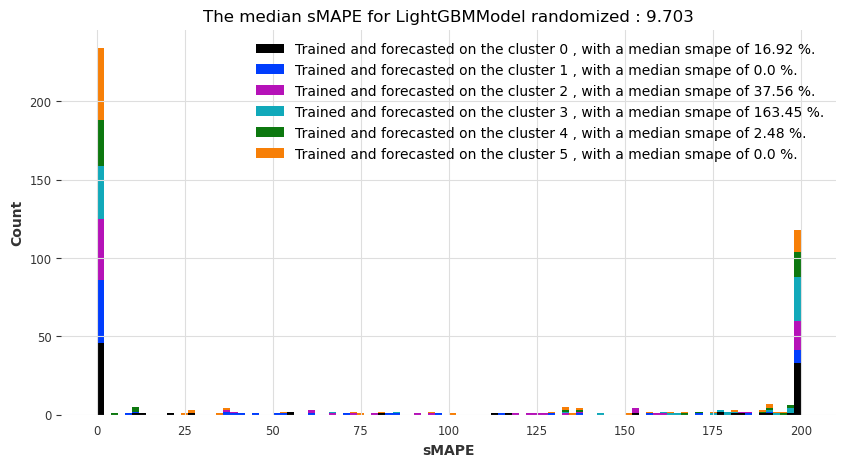

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 18:55:11,328] A new study created in memory with name: no-name-5eb319ef-8319-4a96-8686-dba29b3bd0a9
[I 2023-01-27 18:55:15,287] Trial 0 finished with value: 70.35390457401351 and parameters: {'out_len': 8}. Best is trial 0 with value: 70.35390457401351.
[I 2023-01-27 18:55:19,362] Trial 1 finished with value: 70.35390457401351 and parameters: {'out_len': 8}. Best is trial 0 with value: 70.35390457401351.
[I 2023-01-27 18:55:23,279] Trial 2 finished with value: 67.85292575716213 and parameters: {'out_len': 4}. Best is trial 2 with value: 67.85292575716213.
[I 2023-01-27 18:55:27,022] Trial 3 finished with value: 72.78635992495705 and parameters: {'out_len': 3}. Best is trial 2 with value: 67.85292575716213.
[I 2023-01-27 18:55:32,037] Trial 4 finished with value: 72.325477642698 and parameters: {'out_len': 6}. Best is trial 2 with value: 67.85292575716213.
[I 2023-01-27 18:55:35,368] Trial 5 finished with value: 68.6935010510782 and parameters: {'out_len': 1}. Best is tria

[I 2023-01-27 18:58:06,681] Trial 1 finished with value: 0.0 and parameters: {'out_len': 6}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:58:07,026] Trial 2 finished with value: 0.0 and parameters: {'out_len': 8}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:58:07,450] Trial 3 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:58:07,796] Trial 4 finished with value: 0.0 and parameters: {'out_len': 2}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:58:08,156] Trial 5 finished with value: 0.0 and parameters: {'out_len': 8}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:58:08,472] Trial 6 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:58:08,773] Trial 7 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 18:58:09,145] Trial 8 finished with value: 0.0 and parameters: {'out_len': 6}. Best is trial 0 with valu

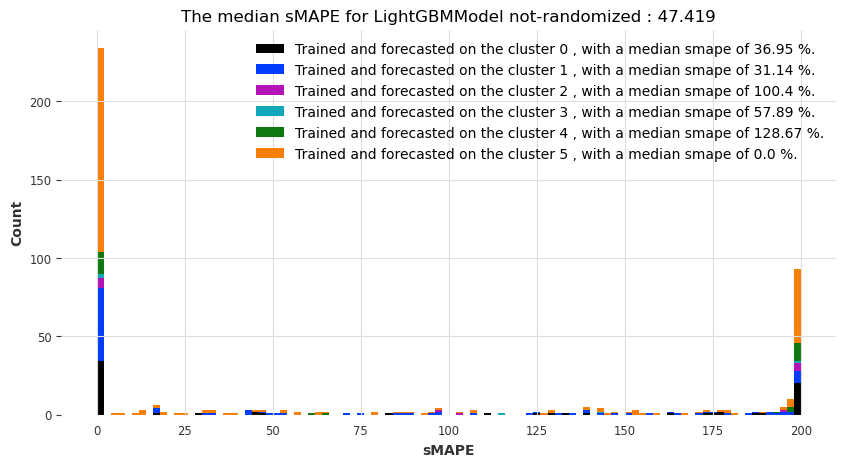

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:02:33,686] A new study created in memory with name: no-name-52c7cd82-1ceb-4700-a689-ca534b615a5d
[I 2023-01-27 19:02:39,336] Trial 0 finished with value: 59.44102095901261 and parameters: {'out_len': 9, 'n_estimators': 73, 'max_depth': 12}. Best is trial 0 with value: 59.44102095901261.
[I 2023-01-27 19:02:44,475] Trial 1 finished with value: 34.27723507130676 and parameters: {'out_len': 10, 'n_estimators': 70, 'max_depth': 21}. Best is trial 1 with value: 34.27723507130676.
[I 2023-01-27 19:02:49,696] Trial 2 finished with value: 43.21450773765561 and parameters: {'out_len': 8, 'n_estimators': 52, 'max_depth': 25}. Best is trial 1 with value: 34.27723507130676.
[I 2023-01-27 19:02:54,926] Trial 3 finished with value: 69.38736807470244 and parameters: {'out_len': 10, 'n_estimators': 95, 'max_depth': 9}. Best is trial 1 with value: 34.27723507130676.
[I 2023-01-27 19:03:01,364] Trial 4 finished with value: 42.760410996504206 and parameters: {'out_len': 5, 'n_estimators'

[I 2023-01-27 19:05:59,270] Trial 9 finished with value: 46.32044801751493 and parameters: {'out_len': 8, 'n_estimators': 51, 'max_depth': 15}. Best is trial 0 with value: 41.24691906597943.
[I 2023-01-27 19:06:03,323] Trial 10 finished with value: 61.40504602925099 and parameters: {'out_len': 5, 'n_estimators': 70, 'max_depth': 5}. Best is trial 0 with value: 41.24691906597943.
[I 2023-01-27 19:06:08,448] Trial 11 finished with value: 46.44219176667241 and parameters: {'out_len': 1, 'n_estimators': 62, 'max_depth': 19}. Best is trial 0 with value: 41.24691906597943.
[I 2023-01-27 19:06:13,434] Trial 12 finished with value: 50.19303111686665 and parameters: {'out_len': 3, 'n_estimators': 62, 'max_depth': 30}. Best is trial 0 with value: 41.24691906597943.
[I 2023-01-27 19:06:18,339] Trial 13 finished with value: 46.45244501507773 and parameters: {'out_len': 3, 'n_estimators': 59, 'max_depth': 21}. Best is trial 0 with value: 41.24691906597943.
[I 2023-01-27 19:06:22,589] Trial 14 finis

[I 2023-01-27 19:09:07,336] Trial 3 finished with value: 83.63833291668789 and parameters: {'out_len': 12, 'n_estimators': 93, 'max_depth': 5}. Best is trial 0 with value: 66.38690389012798.
[I 2023-01-27 19:09:12,384] Trial 4 finished with value: 75.45807195451171 and parameters: {'out_len': 3, 'n_estimators': 57, 'max_depth': 15}. Best is trial 0 with value: 66.38690389012798.
[I 2023-01-27 19:09:16,925] Trial 5 finished with value: 68.32998763694626 and parameters: {'out_len': 11, 'n_estimators': 84, 'max_depth': 19}. Best is trial 0 with value: 66.38690389012798.
[I 2023-01-27 19:09:24,235] Trial 6 finished with value: 77.07662939366602 and parameters: {'out_len': 3, 'n_estimators': 99, 'max_depth': 23}. Best is trial 0 with value: 66.38690389012798.
[I 2023-01-27 19:09:28,607] Trial 7 finished with value: 65.86571510980173 and parameters: {'out_len': 10, 'n_estimators': 62, 'max_depth': 13}. Best is trial 7 with value: 65.86571510980173.
[I 2023-01-27 19:09:33,671] Trial 8 finishe

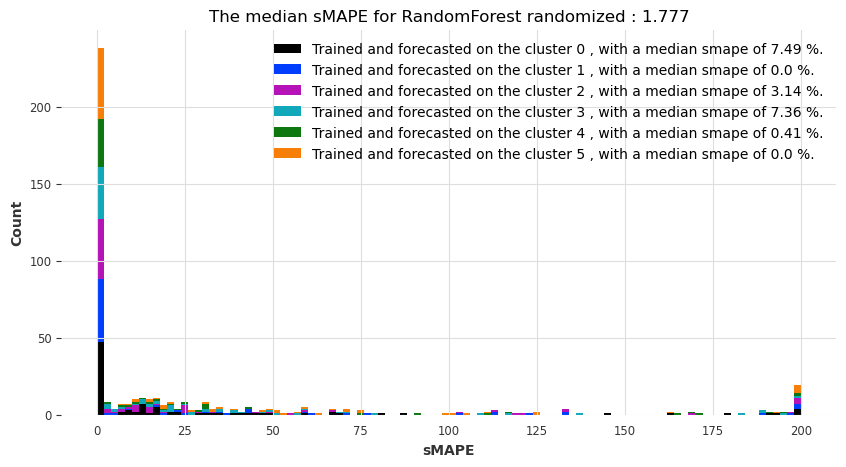

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:10:11,499] A new study created in memory with name: no-name-185b3db1-7192-4260-85a2-d13343ca4047
[I 2023-01-27 19:10:15,867] Trial 0 finished with value: 45.84339379223811 and parameters: {'out_len': 3, 'n_estimators': 66, 'max_depth': 10}. Best is trial 0 with value: 45.84339379223811.
[I 2023-01-27 19:10:19,785] Trial 1 finished with value: 38.23529456040878 and parameters: {'out_len': 10, 'n_estimators': 75, 'max_depth': 12}. Best is trial 1 with value: 38.23529456040878.
[I 2023-01-27 19:10:23,716] Trial 2 finished with value: 61.643998795568 and parameters: {'out_len': 4, 'n_estimators': 64, 'max_depth': 7}. Best is trial 1 with value: 38.23529456040878.
[I 2023-01-27 19:10:29,702] Trial 3 finished with value: 52.74691661297304 and parameters: {'out_len': 2, 'n_estimators': 94, 'max_depth': 9}. Best is trial 1 with value: 38.23529456040878.
[I 2023-01-27 19:10:34,942] Trial 4 finished with value: 26.192957082329787 and parameters: {'out_len': 6, 'n_estimators': 99

[I 2023-01-27 19:13:19,404] Trial 9 finished with value: 163.24060465243537 and parameters: {'out_len': 10, 'n_estimators': 79, 'max_depth': 8}. Best is trial 3 with value: 110.99819982248032.
[I 2023-01-27 19:13:20,047] Trial 10 finished with value: 119.13642255678627 and parameters: {'out_len': 1, 'n_estimators': 50, 'max_depth': 21}. Best is trial 3 with value: 110.99819982248032.
[I 2023-01-27 19:13:20,754] Trial 11 finished with value: 125.91772288548411 and parameters: {'out_len': 3, 'n_estimators': 85, 'max_depth': 12}. Best is trial 3 with value: 110.99819982248032.
[I 2023-01-27 19:13:21,424] Trial 12 finished with value: 110.68942418373346 and parameters: {'out_len': 4, 'n_estimators': 60, 'max_depth': 18}. Best is trial 12 with value: 110.68942418373346.
[I 2023-01-27 19:13:22,069] Trial 13 finished with value: 129.5733412058311 and parameters: {'out_len': 5, 'n_estimators': 50, 'max_depth': 20}. Best is trial 12 with value: 110.68942418373346.
[I 2023-01-27 19:13:22,743] Tr

[I 2023-01-27 19:15:33,526] Trial 5 finished with value: 40.10273155369502 and parameters: {'out_len': 4, 'n_estimators': 100, 'max_depth': 17}. Best is trial 3 with value: 38.44665742058541.
[I 2023-01-27 19:15:51,520] Trial 6 finished with value: 64.98571150619023 and parameters: {'out_len': 1, 'n_estimators': 90, 'max_depth': 11}. Best is trial 3 with value: 38.44665742058541.
[I 2023-01-27 19:16:03,898] Trial 7 finished with value: 32.0578453871503 and parameters: {'out_len': 11, 'n_estimators': 64, 'max_depth': 27}. Best is trial 7 with value: 32.0578453871503.
[I 2023-01-27 19:16:16,082] Trial 8 finished with value: 62.36148257776133 and parameters: {'out_len': 11, 'n_estimators': 56, 'max_depth': 8}. Best is trial 7 with value: 32.0578453871503.
[I 2023-01-27 19:16:28,604] Trial 9 finished with value: 62.4037071614042 and parameters: {'out_len': 4, 'n_estimators': 72, 'max_depth': 5}. Best is trial 7 with value: 32.0578453871503.
[I 2023-01-27 19:16:41,906] Trial 10 finished wit

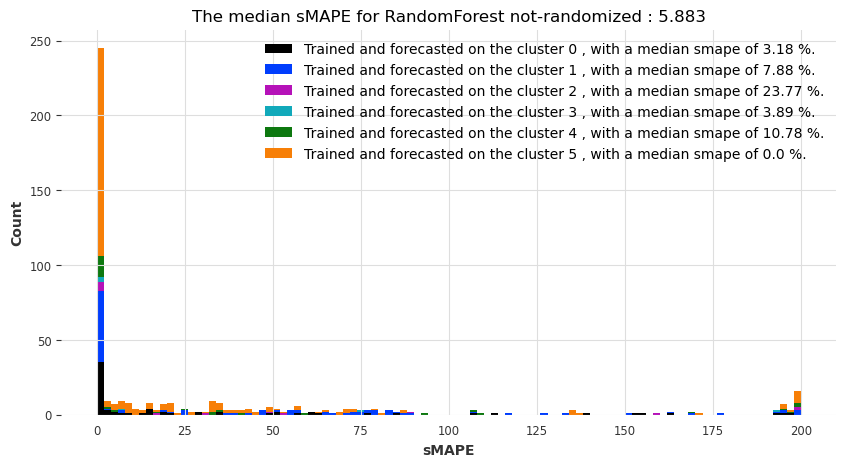

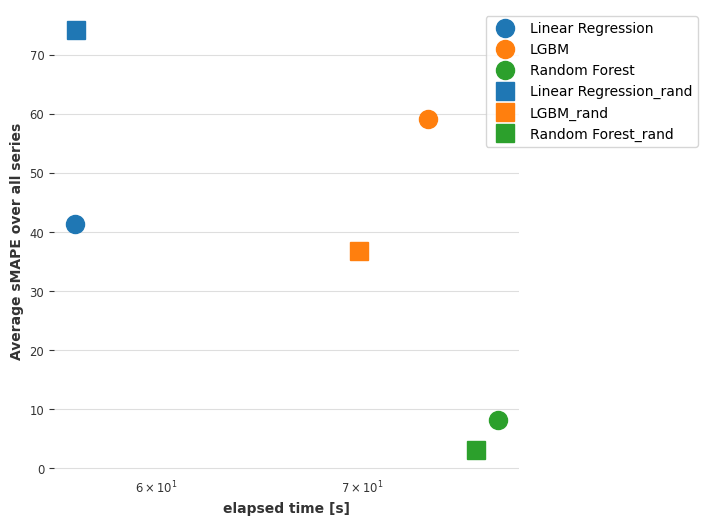

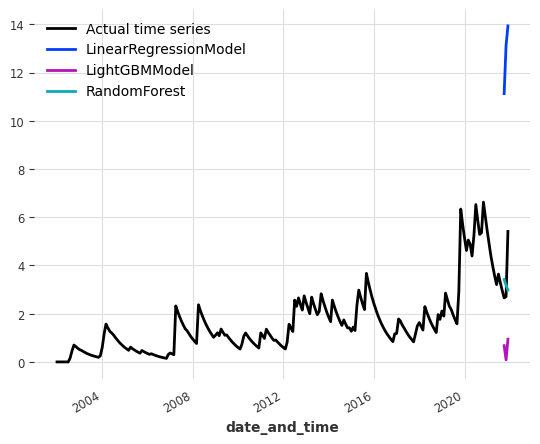

The results for index_cit_t1_t2 with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:17:57,930] A new study created in memory with name: no-name-7ecb815c-2899-44ca-9443-4a340caa646d
[I 2023-01-27 19:18:01,706] Trial 0 finished with value: 89.39452729513484 and parameters: {'out_len': 7}. Best is trial 0 with value: 89.39452729513484.
[I 2023-01-27 19:18:05,491] Trial 1 finished with value: 96.65663375283343 and parameters: {'out_len': 8}. Best is trial 0 with value: 89.39452729513484.
[I 2023-01-27 19:18:09,299] Trial 2 finished with value: 97.82064194526778 and parameters: {'out_len': 9}. Best is trial 0 with value: 89.39452729513484.
[I 2023-01-27 19:18:13,100] Trial 3 finished with value: 97.82064194526778 and parameters: {'out_len': 9}. Best is trial 0 with value: 89.39452729513484.
[I 2023-01-27 19:18:17,943] Trial 4 finished with value: 99.99861409092921 and parameters: {'out_len': 10}. Best is trial 0 with value: 89.39452729513484.
[I 2023-01-27 19:18:21,698] Trial 5 finished with value: 95.59846685697187 and parameters: {'out_len': 5}. Best is 

[I 2023-01-27 19:20:54,623] Trial 1 finished with value: 87.52813114467487 and parameters: {'out_len': 5}. Best is trial 1 with value: 87.52813114467487.
[I 2023-01-27 19:20:57,707] Trial 2 finished with value: 88.02269292337792 and parameters: {'out_len': 3}. Best is trial 1 with value: 87.52813114467487.
[I 2023-01-27 19:21:00,876] Trial 3 finished with value: 92.35920064145951 and parameters: {'out_len': 7}. Best is trial 1 with value: 87.52813114467487.
[I 2023-01-27 19:21:04,076] Trial 4 finished with value: 97.29231521483143 and parameters: {'out_len': 10}. Best is trial 1 with value: 87.52813114467487.
[I 2023-01-27 19:21:07,191] Trial 5 finished with value: 87.52813114467487 and parameters: {'out_len': 5}. Best is trial 1 with value: 87.52813114467487.
[I 2023-01-27 19:21:10,302] Trial 6 finished with value: 88.2607177121308 and parameters: {'out_len': 4}. Best is trial 1 with value: 87.52813114467487.
[I 2023-01-27 19:21:14,314] Trial 7 finished with value: 90.99468423534344 a

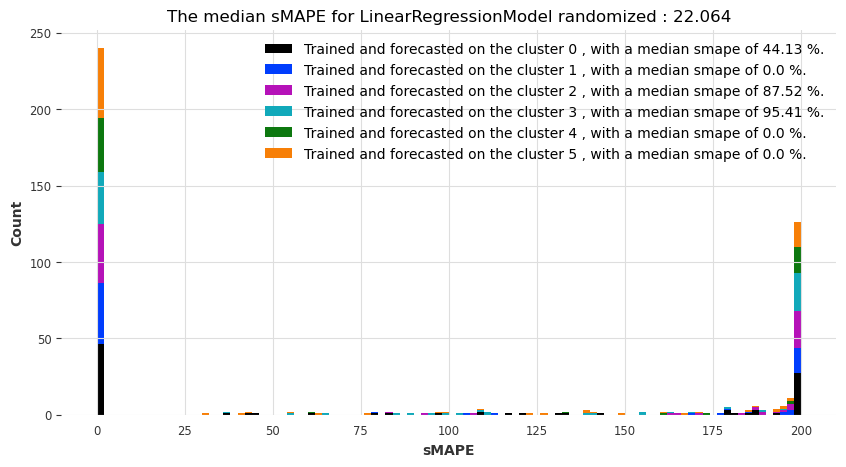

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:23:25,521] A new study created in memory with name: no-name-3a26ce2d-4833-413f-b333-b6663e2e9e6a
[I 2023-01-27 19:23:29,247] Trial 0 finished with value: 79.02568814699913 and parameters: {'out_len': 1}. Best is trial 0 with value: 79.02568814699913.
[I 2023-01-27 19:23:32,089] Trial 1 finished with value: 71.72143475656894 and parameters: {'out_len': 6}. Best is trial 1 with value: 71.72143475656894.
[I 2023-01-27 19:23:34,932] Trial 2 finished with value: 79.8593765798991 and parameters: {'out_len': 3}. Best is trial 1 with value: 71.72143475656894.
[I 2023-01-27 19:23:37,781] Trial 3 finished with value: 78.40344153376095 and parameters: {'out_len': 7}. Best is trial 1 with value: 71.72143475656894.
[I 2023-01-27 19:23:40,686] Trial 4 finished with value: 60.256156562842115 and parameters: {'out_len': 12}. Best is trial 4 with value: 60.256156562842115.
[I 2023-01-27 19:23:43,607] Trial 5 finished with value: 63.675328805105146 and parameters: {'out_len': 11}. Best 

[I 2023-01-27 19:25:38,347] Trial 1 finished with value: 0.0 and parameters: {'out_len': 6}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:25:38,583] Trial 2 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:25:38,834] Trial 3 finished with value: 0.0 and parameters: {'out_len': 12}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:25:39,116] Trial 4 finished with value: 0.0 and parameters: {'out_len': 10}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:25:39,368] Trial 5 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:25:39,635] Trial 6 finished with value: 0.0 and parameters: {'out_len': 6}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:25:39,917] Trial 7 finished with value: 0.0 and parameters: {'out_len': 10}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:25:40,199] Trial 8 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with v

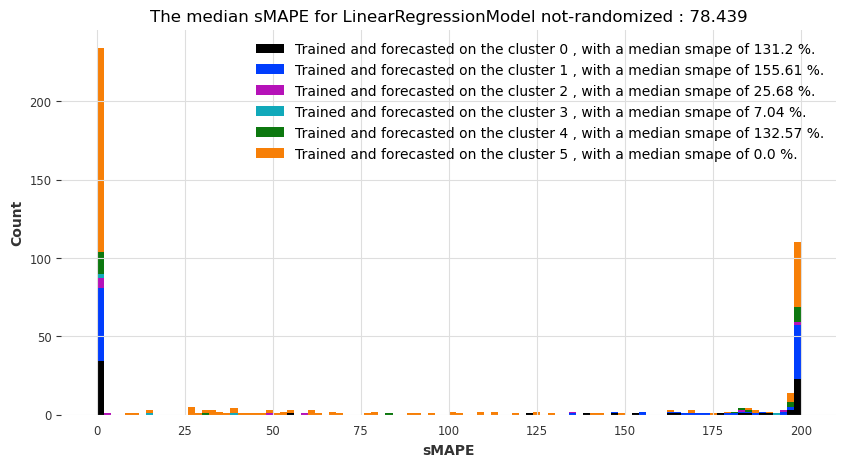

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:28:57,042] A new study created in memory with name: no-name-b44b57c6-72f8-42cc-b8dc-8393326704bb
[I 2023-01-27 19:29:03,114] Trial 0 finished with value: 77.87377002980877 and parameters: {'out_len': 4}. Best is trial 0 with value: 77.87377002980877.
[I 2023-01-27 19:29:08,553] Trial 1 finished with value: 88.1167031621078 and parameters: {'out_len': 9}. Best is trial 0 with value: 77.87377002980877.
[I 2023-01-27 19:29:13,478] Trial 2 finished with value: 90.75626140809578 and parameters: {'out_len': 12}. Best is trial 0 with value: 77.87377002980877.
[I 2023-01-27 19:29:18,620] Trial 3 finished with value: 89.64333260112473 and parameters: {'out_len': 11}. Best is trial 0 with value: 77.87377002980877.
[I 2023-01-27 19:29:22,844] Trial 4 finished with value: 78.99017920657153 and parameters: {'out_len': 1}. Best is trial 0 with value: 77.87377002980877.
[I 2023-01-27 19:29:28,065] Trial 5 finished with value: 77.87377002980877 and parameters: {'out_len': 4}. Best is 

[I 2023-01-27 19:32:42,379] Trial 1 finished with value: 95.97332138355169 and parameters: {'out_len': 5}. Best is trial 1 with value: 95.97332138355169.
[I 2023-01-27 19:32:46,727] Trial 2 finished with value: 93.54383117770118 and parameters: {'out_len': 11}. Best is trial 2 with value: 93.54383117770118.
[I 2023-01-27 19:32:51,121] Trial 3 finished with value: 97.01185381174889 and parameters: {'out_len': 8}. Best is trial 2 with value: 93.54383117770118.
[I 2023-01-27 19:32:55,153] Trial 4 finished with value: 96.69640955187987 and parameters: {'out_len': 3}. Best is trial 2 with value: 93.54383117770118.
[I 2023-01-27 19:32:59,480] Trial 5 finished with value: 95.97539786133169 and parameters: {'out_len': 10}. Best is trial 2 with value: 93.54383117770118.
[I 2023-01-27 19:33:03,042] Trial 6 finished with value: 96.2732471701973 and parameters: {'out_len': 1}. Best is trial 2 with value: 93.54383117770118.
[I 2023-01-27 19:33:08,351] Trial 7 finished with value: 95.44042642424176 

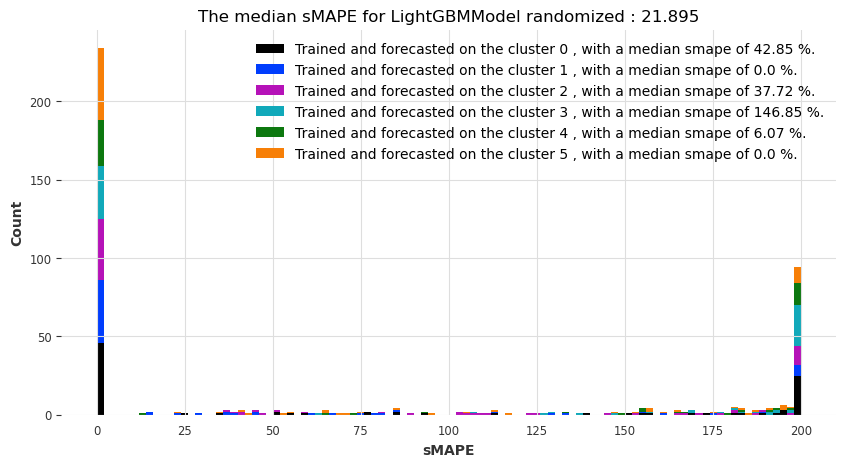

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:35:54,938] A new study created in memory with name: no-name-04a3eade-258a-4d5b-bc6f-c1e09a8517e4
[I 2023-01-27 19:35:58,724] Trial 0 finished with value: 71.09924451145277 and parameters: {'out_len': 5}. Best is trial 0 with value: 71.09924451145277.
[I 2023-01-27 19:36:02,546] Trial 1 finished with value: 79.7221894243603 and parameters: {'out_len': 12}. Best is trial 0 with value: 71.09924451145277.
[I 2023-01-27 19:36:06,041] Trial 2 finished with value: 70.42552066415477 and parameters: {'out_len': 2}. Best is trial 2 with value: 70.42552066415477.
[I 2023-01-27 19:36:10,910] Trial 3 finished with value: 79.62195623955843 and parameters: {'out_len': 11}. Best is trial 2 with value: 70.42552066415477.
[I 2023-01-27 19:36:14,921] Trial 4 finished with value: 76.27723802779104 and parameters: {'out_len': 9}. Best is trial 2 with value: 70.42552066415477.
[I 2023-01-27 19:36:18,898] Trial 5 finished with value: 74.44264152957663 and parameters: {'out_len': 6}. Best is 

[I 2023-01-27 19:38:41,408] Trial 1 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:38:41,816] Trial 2 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:38:42,185] Trial 3 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:38:42,546] Trial 4 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:38:42,938] Trial 5 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:38:43,285] Trial 6 finished with value: 0.0 and parameters: {'out_len': 2}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:38:43,661] Trial 7 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 19:38:44,038] Trial 8 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with val

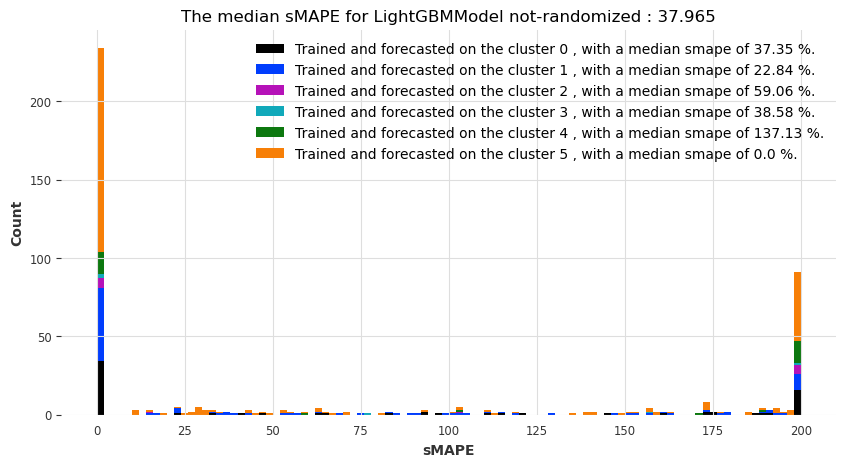

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:42:50,089] A new study created in memory with name: no-name-3230a915-478a-466b-b1f2-650425519a15
[I 2023-01-27 19:42:56,818] Trial 0 finished with value: 45.340361208042474 and parameters: {'out_len': 5, 'n_estimators': 63, 'max_depth': 15}. Best is trial 0 with value: 45.340361208042474.
[I 2023-01-27 19:43:01,722] Trial 1 finished with value: 51.08165195246948 and parameters: {'out_len': 10, 'n_estimators': 64, 'max_depth': 12}. Best is trial 0 with value: 45.340361208042474.
[I 2023-01-27 19:43:07,843] Trial 2 finished with value: 40.74275696974769 and parameters: {'out_len': 6, 'n_estimators': 77, 'max_depth': 27}. Best is trial 2 with value: 40.74275696974769.
[I 2023-01-27 19:43:13,082] Trial 3 finished with value: 35.597377189816726 and parameters: {'out_len': 8, 'n_estimators': 61, 'max_depth': 15}. Best is trial 3 with value: 35.597377189816726.
[I 2023-01-27 19:43:17,960] Trial 4 finished with value: 48.68407915679101 and parameters: {'out_len': 12, 'n_estima

[I 2023-01-27 19:46:07,997] Trial 9 finished with value: 45.842128633578895 and parameters: {'out_len': 6, 'n_estimators': 88, 'max_depth': 27}. Best is trial 3 with value: 44.94087683010983.
[I 2023-01-27 19:46:14,018] Trial 10 finished with value: 41.875177382073 and parameters: {'out_len': 2, 'n_estimators': 100, 'max_depth': 23}. Best is trial 10 with value: 41.875177382073.
[I 2023-01-27 19:46:20,089] Trial 11 finished with value: 42.55915111143446 and parameters: {'out_len': 2, 'n_estimators': 100, 'max_depth': 22}. Best is trial 10 with value: 41.875177382073.
[I 2023-01-27 19:46:26,095] Trial 12 finished with value: 43.27458918367016 and parameters: {'out_len': 2, 'n_estimators': 99, 'max_depth': 24}. Best is trial 10 with value: 41.875177382073.
[I 2023-01-27 19:46:32,546] Trial 13 finished with value: 39.420803529458915 and parameters: {'out_len': 1, 'n_estimators': 100, 'max_depth': 22}. Best is trial 13 with value: 39.420803529458915.
[I 2023-01-27 19:46:38,588] Trial 14 fi

[I 2023-01-27 19:49:25,795] Trial 3 finished with value: 74.55714783401761 and parameters: {'out_len': 12, 'n_estimators': 79, 'max_depth': 8}. Best is trial 2 with value: 36.48569734540169.
[I 2023-01-27 19:49:30,763] Trial 4 finished with value: 68.79687554865123 and parameters: {'out_len': 2, 'n_estimators': 92, 'max_depth': 6}. Best is trial 2 with value: 36.48569734540169.
[I 2023-01-27 19:49:34,996] Trial 5 finished with value: 66.7699782593412 and parameters: {'out_len': 11, 'n_estimators': 76, 'max_depth': 18}. Best is trial 2 with value: 36.48569734540169.
[I 2023-01-27 19:49:40,715] Trial 6 finished with value: 70.71168651598158 and parameters: {'out_len': 2, 'n_estimators': 84, 'max_depth': 6}. Best is trial 2 with value: 36.48569734540169.
[I 2023-01-27 19:49:45,274] Trial 7 finished with value: 67.4701003029146 and parameters: {'out_len': 10, 'n_estimators': 86, 'max_depth': 23}. Best is trial 2 with value: 36.48569734540169.
[I 2023-01-27 19:49:49,869] Trial 8 finished wi

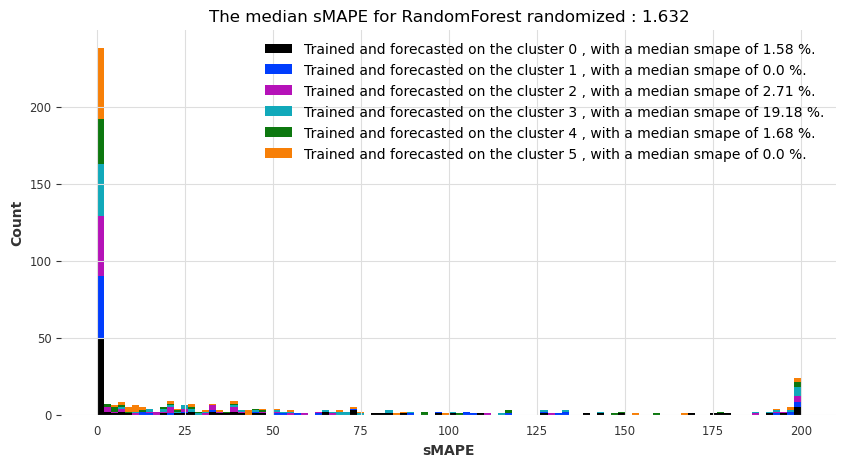

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:50:28,046] A new study created in memory with name: no-name-0326d035-5d46-4b68-9ba4-4e7690034176
[I 2023-01-27 19:50:32,241] Trial 0 finished with value: 16.390578435246734 and parameters: {'out_len': 4, 'n_estimators': 52, 'max_depth': 18}. Best is trial 0 with value: 16.390578435246734.
[I 2023-01-27 19:50:35,464] Trial 1 finished with value: 75.7656171612514 and parameters: {'out_len': 12, 'n_estimators': 71, 'max_depth': 5}. Best is trial 0 with value: 16.390578435246734.
[I 2023-01-27 19:50:41,362] Trial 2 finished with value: 12.816905393288497 and parameters: {'out_len': 1, 'n_estimators': 86, 'max_depth': 21}. Best is trial 2 with value: 12.816905393288497.
[I 2023-01-27 19:50:46,235] Trial 3 finished with value: 57.99206016145084 and parameters: {'out_len': 10, 'n_estimators': 66, 'max_depth': 27}. Best is trial 2 with value: 12.816905393288497.
[I 2023-01-27 19:50:50,687] Trial 4 finished with value: 54.95026971554854 and parameters: {'out_len': 8, 'n_estimat

[I 2023-01-27 19:53:32,430] Trial 8 finished with value: 156.38923652911464 and parameters: {'out_len': 3, 'n_estimators': 64, 'max_depth': 8}. Best is trial 5 with value: 126.16216978855819.
[I 2023-01-27 19:53:33,144] Trial 9 finished with value: 163.38536679054533 and parameters: {'out_len': 4, 'n_estimators': 60, 'max_depth': 25}. Best is trial 5 with value: 126.16216978855819.
[I 2023-01-27 19:53:33,805] Trial 10 finished with value: 166.70129719624356 and parameters: {'out_len': 11, 'n_estimators': 50, 'max_depth': 12}. Best is trial 5 with value: 126.16216978855819.
[I 2023-01-27 19:53:34,501] Trial 11 finished with value: 128.3368321954371 and parameters: {'out_len': 1, 'n_estimators': 66, 'max_depth': 11}. Best is trial 5 with value: 126.16216978855819.
[I 2023-01-27 19:53:35,186] Trial 12 finished with value: 124.64808456058772 and parameters: {'out_len': 1, 'n_estimators': 69, 'max_depth': 13}. Best is trial 12 with value: 124.64808456058772.
[I 2023-01-27 19:53:35,877] Tria

[I 2023-01-27 19:55:27,526] Trial 4 finished with value: 63.45403037272624 and parameters: {'out_len': 3, 'n_estimators': 66, 'max_depth': 5}. Best is trial 0 with value: 38.01636558066623.
[I 2023-01-27 19:55:41,016] Trial 5 finished with value: 66.47892520028458 and parameters: {'out_len': 4, 'n_estimators': 82, 'max_depth': 7}. Best is trial 0 with value: 38.01636558066623.
[I 2023-01-27 19:55:54,887] Trial 6 finished with value: 68.22722498146717 and parameters: {'out_len': 6, 'n_estimators': 60, 'max_depth': 10}. Best is trial 0 with value: 38.01636558066623.
[I 2023-01-27 19:56:06,909] Trial 7 finished with value: 46.16123751124514 and parameters: {'out_len': 12, 'n_estimators': 79, 'max_depth': 17}. Best is trial 0 with value: 38.01636558066623.
[I 2023-01-27 19:56:18,921] Trial 8 finished with value: 43.12666979825174 and parameters: {'out_len': 12, 'n_estimators': 76, 'max_depth': 19}. Best is trial 0 with value: 38.01636558066623.
[I 2023-01-27 19:56:32,840] Trial 9 finished 

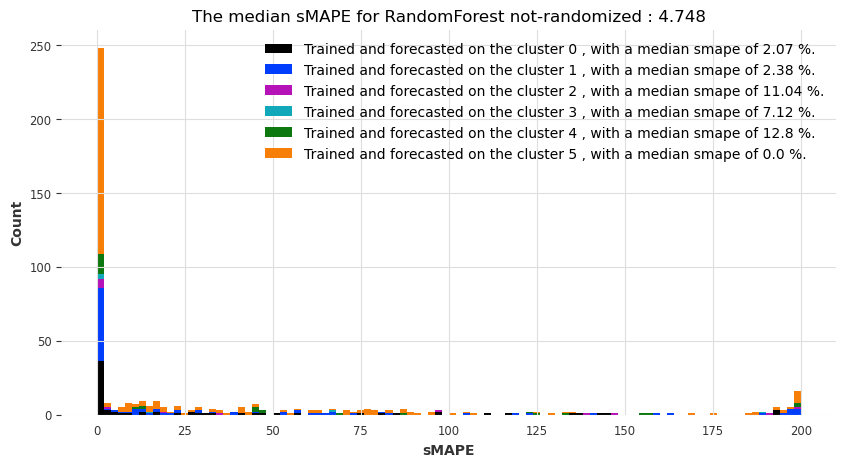

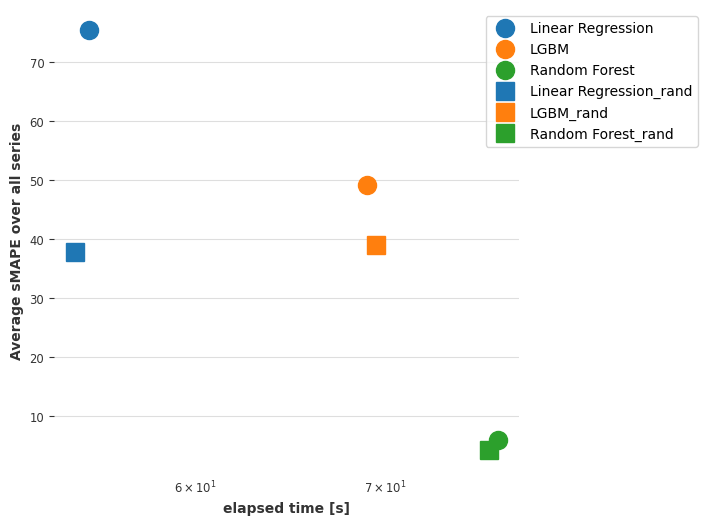

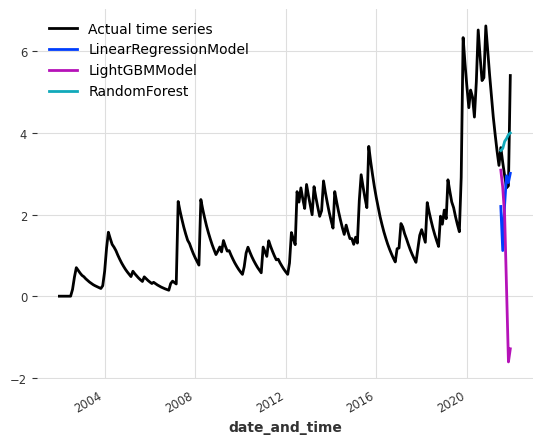

The results for index_cit_t1_t2 with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 19:58:10,025] A new study created in memory with name: no-name-75fc45fe-b20d-4184-98d4-d600a3141f8b
[I 2023-01-27 19:58:13,598] Trial 0 finished with value: 94.33828974941119 and parameters: {'out_len': 4}. Best is trial 0 with value: 94.33828974941119.
[I 2023-01-27 19:58:17,289] Trial 1 finished with value: 99.33330191958547 and parameters: {'out_len': 9}. Best is trial 0 with value: 94.33828974941119.
[I 2023-01-27 19:58:20,924] Trial 2 finished with value: 94.33828974941119 and parameters: {'out_len': 4}. Best is trial 0 with value: 94.33828974941119.
[I 2023-01-27 19:58:24,691] Trial 3 finished with value: 95.85194351332981 and parameters: {'out_len': 12}. Best is trial 0 with value: 94.33828974941119.
[I 2023-01-27 19:58:29,374] Trial 4 finished with value: 96.6910943470637 and parameters: {'out_len': 5}. Best is trial 0 with value: 94.33828974941119.
[I 2023-01-27 19:58:33,044] Trial 5 finished with value: 94.33828974941119 and parameters: {'out_len': 4}. Best is t

[I 2023-01-27 20:01:04,162] Trial 1 finished with value: 93.08093334292393 and parameters: {'out_len': 7}. Best is trial 1 with value: 93.08093334292393.
[I 2023-01-27 20:01:07,320] Trial 2 finished with value: 93.08093334292393 and parameters: {'out_len': 7}. Best is trial 1 with value: 93.08093334292393.
[I 2023-01-27 20:01:10,342] Trial 3 finished with value: 93.7072563240458 and parameters: {'out_len': 5}. Best is trial 1 with value: 93.08093334292393.
[I 2023-01-27 20:01:13,479] Trial 4 finished with value: 99.98888008850656 and parameters: {'out_len': 12}. Best is trial 1 with value: 93.08093334292393.
[I 2023-01-27 20:01:16,491] Trial 5 finished with value: 92.08380633662694 and parameters: {'out_len': 3}. Best is trial 5 with value: 92.08380633662694.
[I 2023-01-27 20:01:19,568] Trial 6 finished with value: 93.7072563240458 and parameters: {'out_len': 5}. Best is trial 5 with value: 92.08380633662694.
[I 2023-01-27 20:01:23,601] Trial 7 finished with value: 92.08380633662694 an

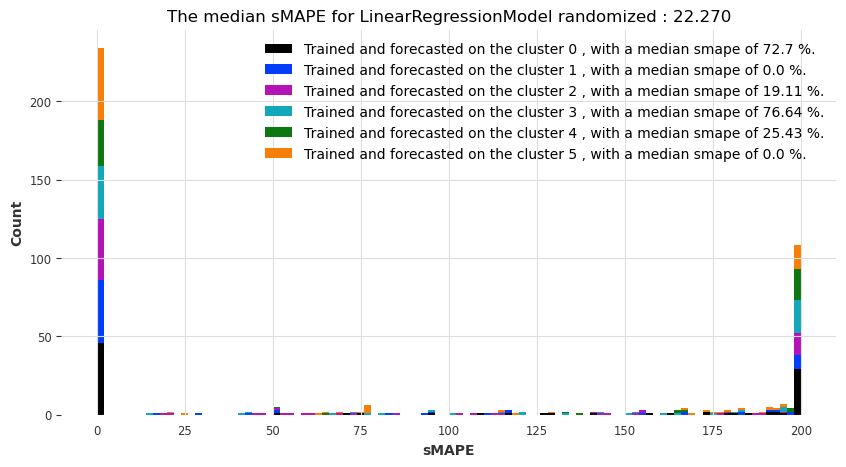

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:03:31,581] A new study created in memory with name: no-name-3e5cafd8-1c7c-43f7-852a-aa2deb5662cc
[I 2023-01-27 20:03:35,350] Trial 0 finished with value: 78.66033778894285 and parameters: {'out_len': 11}. Best is trial 0 with value: 78.66033778894285.
[I 2023-01-27 20:03:38,082] Trial 1 finished with value: 77.63110041900566 and parameters: {'out_len': 3}. Best is trial 1 with value: 77.63110041900566.
[I 2023-01-27 20:03:40,852] Trial 2 finished with value: 76.55627760602614 and parameters: {'out_len': 4}. Best is trial 2 with value: 76.55627760602614.
[I 2023-01-27 20:03:43,704] Trial 3 finished with value: 77.42290318798838 and parameters: {'out_len': 12}. Best is trial 2 with value: 76.55627760602614.
[I 2023-01-27 20:03:46,437] Trial 4 finished with value: 76.55627760602614 and parameters: {'out_len': 4}. Best is trial 2 with value: 76.55627760602614.
[I 2023-01-27 20:03:49,269] Trial 5 finished with value: 79.99940290675707 and parameters: {'out_len': 10}. Best i

[I 2023-01-27 20:05:38,909] Trial 1 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:05:39,178] Trial 2 finished with value: 0.0 and parameters: {'out_len': 10}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:05:39,430] Trial 3 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:05:39,710] Trial 4 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:05:39,964] Trial 5 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:05:40,230] Trial 6 finished with value: 0.0 and parameters: {'out_len': 6}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:05:40,513] Trial 7 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:05:40,780] Trial 8 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with 

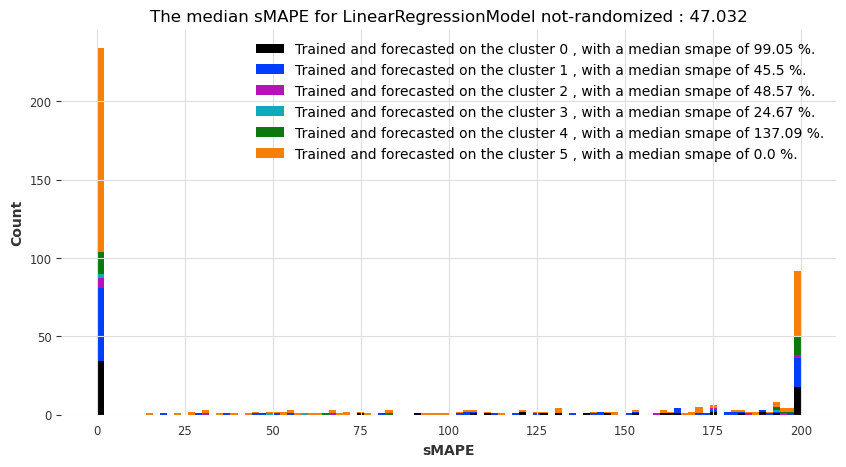

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:08:49,744] A new study created in memory with name: no-name-cf85686f-6a60-43da-b9bd-8ea58bb0cdad
[I 2023-01-27 20:08:54,801] Trial 0 finished with value: 95.41214954142865 and parameters: {'out_len': 5}. Best is trial 0 with value: 95.41214954142865.
[I 2023-01-27 20:08:59,989] Trial 1 finished with value: 97.80145982201142 and parameters: {'out_len': 8}. Best is trial 0 with value: 95.41214954142865.
[I 2023-01-27 20:09:05,053] Trial 2 finished with value: 87.35977934926487 and parameters: {'out_len': 11}. Best is trial 2 with value: 87.35977934926487.
[I 2023-01-27 20:09:11,326] Trial 3 finished with value: 95.8635364810333 and parameters: {'out_len': 6}. Best is trial 2 with value: 87.35977934926487.
[I 2023-01-27 20:09:16,186] Trial 4 finished with value: 90.6801233871936 and parameters: {'out_len': 12}. Best is trial 2 with value: 87.35977934926487.
[I 2023-01-27 20:09:20,683] Trial 5 finished with value: 80.01031366456976 and parameters: {'out_len': 2}. Best is t

[I 2023-01-27 20:12:27,488] Trial 1 finished with value: 93.54045189167331 and parameters: {'out_len': 12}. Best is trial 0 with value: 93.49151182679745.
[I 2023-01-27 20:12:31,483] Trial 2 finished with value: 94.01347003741444 and parameters: {'out_len': 3}. Best is trial 0 with value: 93.49151182679745.
[I 2023-01-27 20:12:35,904] Trial 3 finished with value: 97.03050000386428 and parameters: {'out_len': 8}. Best is trial 0 with value: 93.49151182679745.
[I 2023-01-27 20:12:42,200] Trial 4 finished with value: 97.03050000386428 and parameters: {'out_len': 8}. Best is trial 0 with value: 93.49151182679745.
[I 2023-01-27 20:12:46,729] Trial 5 finished with value: 96.26691388514794 and parameters: {'out_len': 9}. Best is trial 0 with value: 93.49151182679745.
[I 2023-01-27 20:12:50,994] Trial 6 finished with value: 94.122599287538 and parameters: {'out_len': 5}. Best is trial 0 with value: 93.49151182679745.
[I 2023-01-27 20:12:55,274] Trial 7 finished with value: 94.122599287538 and 

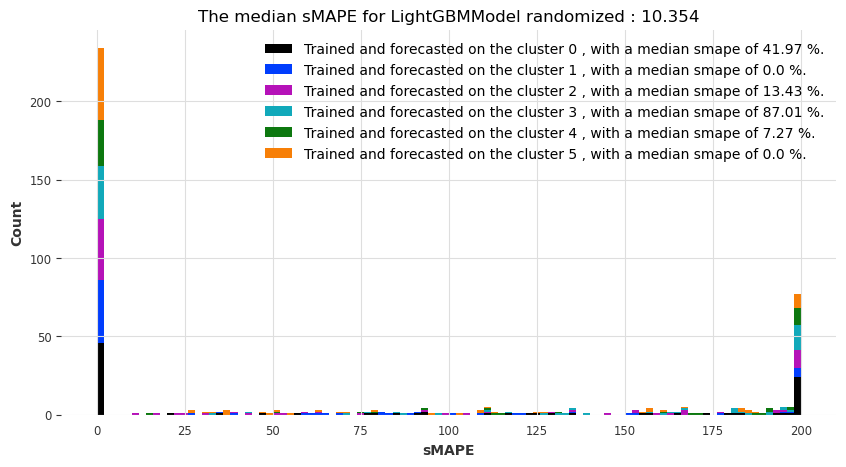

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:15:42,469] A new study created in memory with name: no-name-30e771d2-e2df-4aa8-8c8e-ffb820238bcf
[I 2023-01-27 20:15:46,291] Trial 0 finished with value: 70.37365770703109 and parameters: {'out_len': 8}. Best is trial 0 with value: 70.37365770703109.
[I 2023-01-27 20:15:50,915] Trial 1 finished with value: 70.25625590556923 and parameters: {'out_len': 3}. Best is trial 1 with value: 70.25625590556923.
[I 2023-01-27 20:15:54,801] Trial 2 finished with value: 72.50210328078283 and parameters: {'out_len': 5}. Best is trial 1 with value: 70.25625590556923.
[I 2023-01-27 20:15:58,687] Trial 3 finished with value: 72.50210328078283 and parameters: {'out_len': 5}. Best is trial 1 with value: 70.25625590556923.
[I 2023-01-27 20:16:02,627] Trial 4 finished with value: 78.8825038331997 and parameters: {'out_len': 9}. Best is trial 1 with value: 70.25625590556923.
[I 2023-01-27 20:16:06,531] Trial 5 finished with value: 72.50210328078283 and parameters: {'out_len': 5}. Best is tr

[I 2023-01-27 20:18:33,520] Trial 1 finished with value: 0.0 and parameters: {'out_len': 2}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:18:33,842] Trial 2 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:18:34,202] Trial 3 finished with value: 0.0 and parameters: {'out_len': 7}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:18:34,563] Trial 4 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:18:34,940] Trial 5 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:18:35,301] Trial 6 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:18:35,630] Trial 7 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:18:36,002] Trial 8 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with va

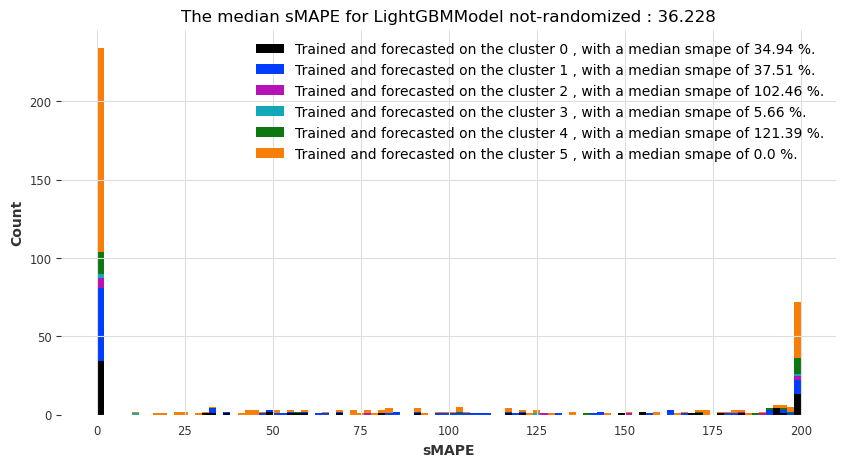

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:22:34,584] A new study created in memory with name: no-name-b3e1e14b-2764-4cd2-9c4e-d6a710b4cdcd
[I 2023-01-27 20:22:41,829] Trial 0 finished with value: 48.071138510089085 and parameters: {'out_len': 5, 'n_estimators': 77, 'max_depth': 22}. Best is trial 0 with value: 48.071138510089085.
[I 2023-01-27 20:22:47,899] Trial 1 finished with value: 66.57008201611728 and parameters: {'out_len': 6, 'n_estimators': 94, 'max_depth': 10}. Best is trial 0 with value: 48.071138510089085.
[I 2023-01-27 20:22:55,443] Trial 2 finished with value: 40.449824587089054 and parameters: {'out_len': 2, 'n_estimators': 95, 'max_depth': 24}. Best is trial 2 with value: 40.449824587089054.
[I 2023-01-27 20:23:00,010] Trial 3 finished with value: 45.5526199422866 and parameters: {'out_len': 12, 'n_estimators': 72, 'max_depth': 25}. Best is trial 2 with value: 40.449824587089054.
[I 2023-01-27 20:23:05,608] Trial 4 finished with value: 66.97740588805358 and parameters: {'out_len': 9, 'n_estimat

[I 2023-01-27 20:25:59,631] Trial 9 finished with value: 45.938880023813546 and parameters: {'out_len': 2, 'n_estimators': 79, 'max_depth': 23}. Best is trial 9 with value: 45.938880023813546.
[I 2023-01-27 20:26:05,364] Trial 10 finished with value: 47.53408778553633 and parameters: {'out_len': 1, 'n_estimators': 93, 'max_depth': 28}. Best is trial 9 with value: 45.938880023813546.
[I 2023-01-27 20:26:11,182] Trial 11 finished with value: 50.03870261776329 and parameters: {'out_len': 5, 'n_estimators': 86, 'max_depth': 12}. Best is trial 9 with value: 45.938880023813546.
[I 2023-01-27 20:26:16,530] Trial 12 finished with value: 44.845920125654715 and parameters: {'out_len': 4, 'n_estimators': 100, 'max_depth': 23}. Best is trial 12 with value: 44.845920125654715.
[I 2023-01-27 20:26:22,127] Trial 13 finished with value: 45.23189059293588 and parameters: {'out_len': 3, 'n_estimators': 98, 'max_depth': 23}. Best is trial 12 with value: 44.845920125654715.
[I 2023-01-27 20:26:27,503] Tri

[I 2023-01-27 20:29:13,082] Trial 3 finished with value: 58.71186189559987 and parameters: {'out_len': 9, 'n_estimators': 68, 'max_depth': 12}. Best is trial 0 with value: 45.960434548399434.
[I 2023-01-27 20:29:17,142] Trial 4 finished with value: 54.358029067536464 and parameters: {'out_len': 11, 'n_estimators': 76, 'max_depth': 18}. Best is trial 0 with value: 45.960434548399434.
[I 2023-01-27 20:29:21,764] Trial 5 finished with value: 53.06040973931658 and parameters: {'out_len': 2, 'n_estimators': 53, 'max_depth': 12}. Best is trial 0 with value: 45.960434548399434.
[I 2023-01-27 20:29:26,106] Trial 6 finished with value: 47.71952911255379 and parameters: {'out_len': 5, 'n_estimators': 51, 'max_depth': 19}. Best is trial 0 with value: 45.960434548399434.
[I 2023-01-27 20:29:30,400] Trial 7 finished with value: 50.87997452702267 and parameters: {'out_len': 5, 'n_estimators': 50, 'max_depth': 30}. Best is trial 0 with value: 45.960434548399434.
[I 2023-01-27 20:29:35,094] Trial 8 fi

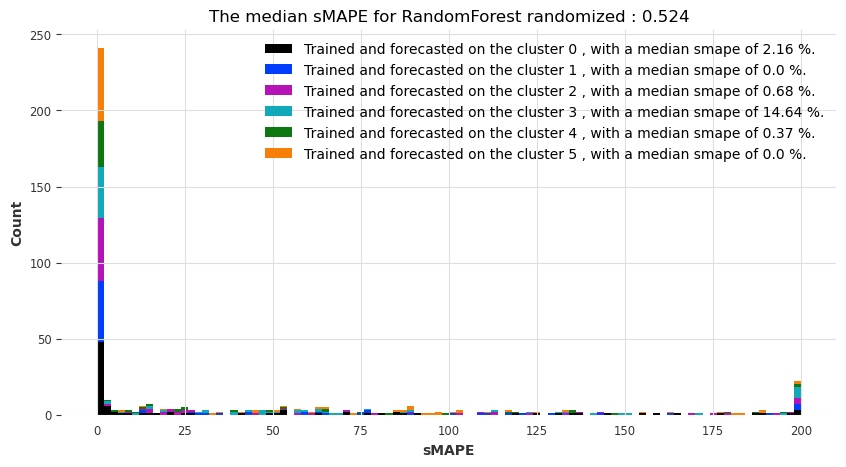

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:30:14,717] A new study created in memory with name: no-name-dd9bbef4-09f8-422d-af3c-54152af7bbe3
[I 2023-01-27 20:30:19,270] Trial 0 finished with value: 32.90962572361525 and parameters: {'out_len': 2, 'n_estimators': 60, 'max_depth': 25}. Best is trial 0 with value: 32.90962572361525.
[I 2023-01-27 20:30:23,416] Trial 1 finished with value: 41.69658442947202 and parameters: {'out_len': 4, 'n_estimators': 57, 'max_depth': 27}. Best is trial 0 with value: 32.90962572361525.
[I 2023-01-27 20:30:28,077] Trial 2 finished with value: 39.86114144742026 and parameters: {'out_len': 7, 'n_estimators': 52, 'max_depth': 27}. Best is trial 0 with value: 32.90962572361525.
[I 2023-01-27 20:30:32,286] Trial 3 finished with value: 33.72963804718475 and parameters: {'out_len': 3, 'n_estimators': 53, 'max_depth': 20}. Best is trial 0 with value: 32.90962572361525.
[I 2023-01-27 20:30:37,783] Trial 4 finished with value: 33.12648380726372 and parameters: {'out_len': 1, 'n_estimators': 

[I 2023-01-27 20:33:21,571] Trial 9 finished with value: 161.45697755465096 and parameters: {'out_len': 8, 'n_estimators': 81, 'max_depth': 13}. Best is trial 8 with value: 158.08632025098686.
[I 2023-01-27 20:33:22,199] Trial 10 finished with value: 156.39445925054648 and parameters: {'out_len': 9, 'n_estimators': 64, 'max_depth': 6}. Best is trial 10 with value: 156.39445925054648.
[I 2023-01-27 20:33:22,827] Trial 11 finished with value: 153.61156293068996 and parameters: {'out_len': 9, 'n_estimators': 65, 'max_depth': 5}. Best is trial 11 with value: 153.61156293068996.
[I 2023-01-27 20:33:23,439] Trial 12 finished with value: 148.5613287400972 and parameters: {'out_len': 9, 'n_estimators': 65, 'max_depth': 5}. Best is trial 12 with value: 148.5613287400972.
[I 2023-01-27 20:33:24,083] Trial 13 finished with value: 161.34016171106595 and parameters: {'out_len': 10, 'n_estimators': 86, 'max_depth': 30}. Best is trial 12 with value: 148.5613287400972.
[I 2023-01-27 20:33:24,720] Tria

[I 2023-01-27 20:35:32,249] Trial 5 finished with value: 71.83231479552677 and parameters: {'out_len': 12, 'n_estimators': 83, 'max_depth': 8}. Best is trial 2 with value: 46.68117066621232.
[I 2023-01-27 20:35:45,026] Trial 6 finished with value: 45.41273258687443 and parameters: {'out_len': 6, 'n_estimators': 53, 'max_depth': 17}. Best is trial 6 with value: 45.41273258687443.
[I 2023-01-27 20:35:56,463] Trial 7 finished with value: 71.47753067891168 and parameters: {'out_len': 11, 'n_estimators': 59, 'max_depth': 5}. Best is trial 6 with value: 45.41273258687443.
[I 2023-01-27 20:36:10,850] Trial 8 finished with value: 45.34543791915088 and parameters: {'out_len': 1, 'n_estimators': 54, 'max_depth': 27}. Best is trial 8 with value: 45.34543791915088.
[I 2023-01-27 20:36:23,647] Trial 9 finished with value: 77.31383192619745 and parameters: {'out_len': 3, 'n_estimators': 71, 'max_depth': 7}. Best is trial 8 with value: 45.34543791915088.
[I 2023-01-27 20:36:38,189] Trial 10 finished 

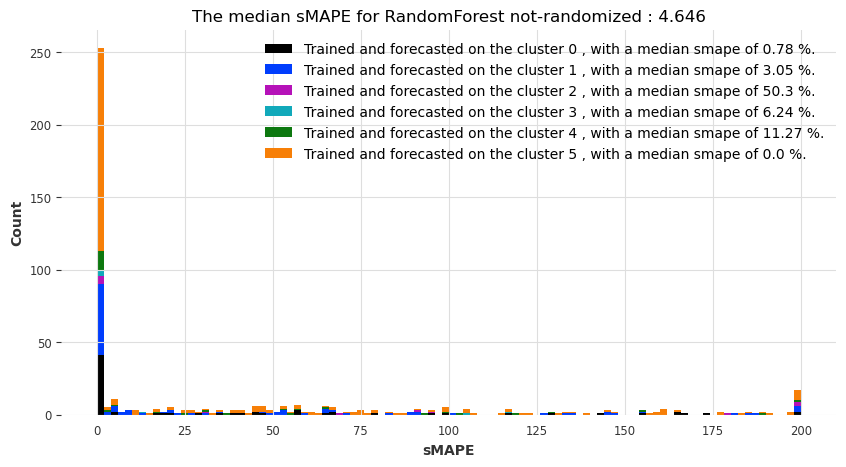

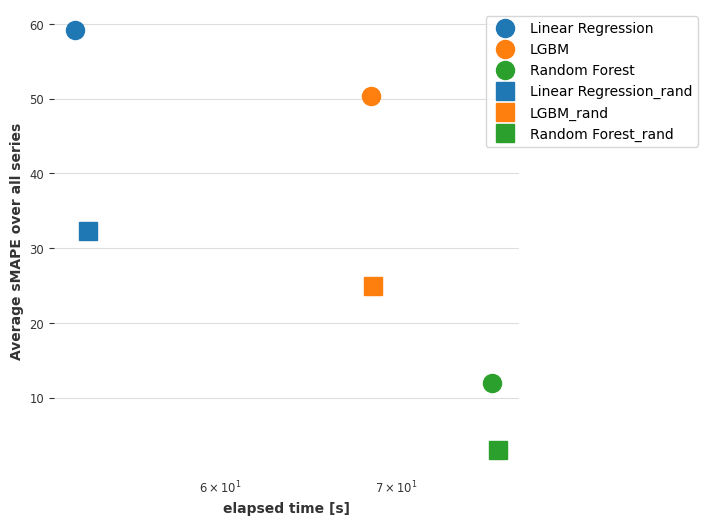

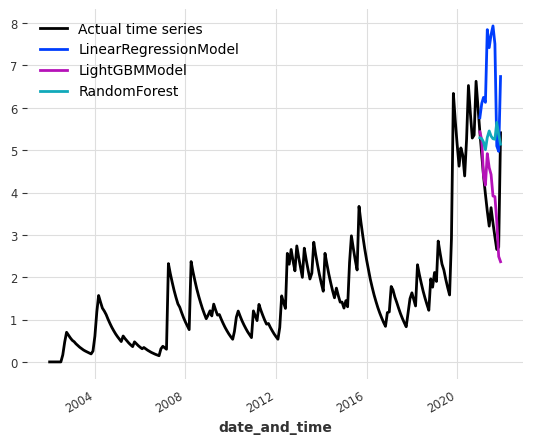

The results for index_cit_t2_t1 are:
The results for index_cit_t2_t1 with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:37:53,473] A new study created in memory with name: no-name-9231f710-be20-4d81-bf24-84214fa23d8c
[I 2023-01-27 20:37:56,307] Trial 0 finished with value: 53.33331012046211 and parameters: {'out_len': 9}. Best is trial 0 with value: 53.33331012046211.
[I 2023-01-27 20:37:59,179] Trial 1 finished with value: 31.659626652432074 and parameters: {'out_len': 5}. Best is trial 1 with value: 31.659626652432074.
[I 2023-01-27 20:38:02,072] Trial 2 finished with value: 35.66198506713325 and parameters: {'out_len': 3}. Best is trial 1 with value: 31.659626652432074.
[I 2023-01-27 20:38:05,011] Trial 3 finished with value: 53.33319730143194 and parameters: {'out_len': 10}. Best is trial 1 with value: 31.659626652432074.
[I 2023-01-27 20:38:07,941] Trial 4 finished with value: 53.33319730143194 and parameters: {'out_len': 10}. Best is trial 1 with value: 31.659626652432074.
[I 2023-01-27 20:38:11,868] Trial 5 finished with value: 53.3330370164177 and parameters: {'out_len': 11}. Be

[I 2023-01-27 20:40:44,814] Trial 1 finished with value: 155.55529521521325 and parameters: {'out_len': 10}. Best is trial 0 with value: 109.3362509722174.
[I 2023-01-27 20:40:48,364] Trial 2 finished with value: 151.7651257883176 and parameters: {'out_len': 6}. Best is trial 0 with value: 109.3362509722174.
[I 2023-01-27 20:40:52,785] Trial 3 finished with value: 142.39704991689166 and parameters: {'out_len': 2}. Best is trial 0 with value: 109.3362509722174.
[I 2023-01-27 20:40:56,333] Trial 4 finished with value: 109.3362509722174 and parameters: {'out_len': 12}. Best is trial 0 with value: 109.3362509722174.
[I 2023-01-27 20:40:59,827] Trial 5 finished with value: 155.54933622888225 and parameters: {'out_len': 8}. Best is trial 0 with value: 109.3362509722174.
[I 2023-01-27 20:41:03,439] Trial 6 finished with value: 109.3362509722174 and parameters: {'out_len': 12}. Best is trial 0 with value: 109.3362509722174.
[I 2023-01-27 20:41:06,886] Trial 7 finished with value: 142.397049916

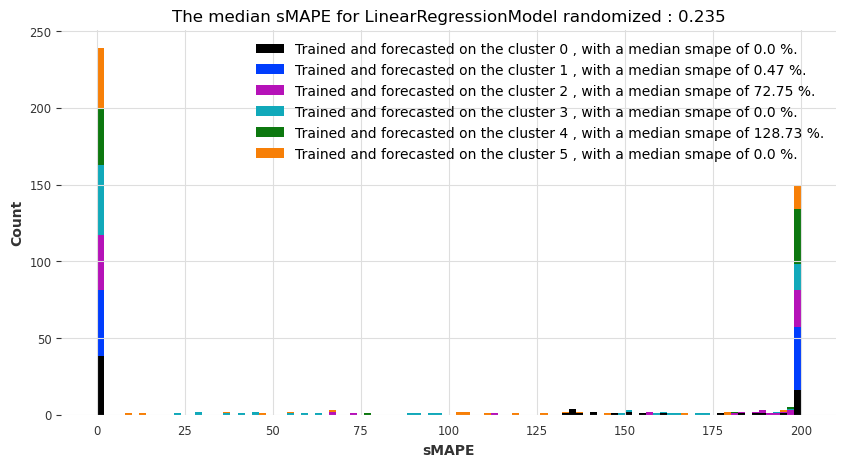

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:43:25,128] A new study created in memory with name: no-name-f498d003-24ae-4812-a44c-50dc845e4874
[I 2023-01-27 20:43:27,672] Trial 0 finished with value: 107.69230769230762 and parameters: {'out_len': 9}. Best is trial 0 with value: 107.69230769230762.
[I 2023-01-27 20:43:30,251] Trial 1 finished with value: 96.14268755907338 and parameters: {'out_len': 4}. Best is trial 1 with value: 96.14268755907338.
[I 2023-01-27 20:43:33,831] Trial 2 finished with value: 98.39218390826062 and parameters: {'out_len': 6}. Best is trial 1 with value: 96.14268755907338.
[I 2023-01-27 20:43:36,350] Trial 3 finished with value: 91.59075058423892 and parameters: {'out_len': 5}. Best is trial 3 with value: 91.59075058423892.
[I 2023-01-27 20:43:38,879] Trial 4 finished with value: 91.59075058423892 and parameters: {'out_len': 5}. Best is trial 3 with value: 91.59075058423892.
[I 2023-01-27 20:43:41,351] Trial 5 finished with value: 96.77781902472104 and parameters: {'out_len': 1}. Best is

[I 2023-01-27 20:45:35,678] Trial 2 finished with value: 0.0 and parameters: {'out_len': 8}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:45:36,339] Trial 3 finished with value: 0.0 and parameters: {'out_len': 8}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:45:37,015] Trial 4 finished with value: 0.0 and parameters: {'out_len': 2}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:45:37,673] Trial 5 finished with value: 0.0 and parameters: {'out_len': 6}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:45:38,333] Trial 6 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:45:38,993] Trial 7 finished with value: 0.0 and parameters: {'out_len': 7}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:45:39,652] Trial 8 finished with value: 0.0 and parameters: {'out_len': 2}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:45:40,312] Trial 9 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with valu

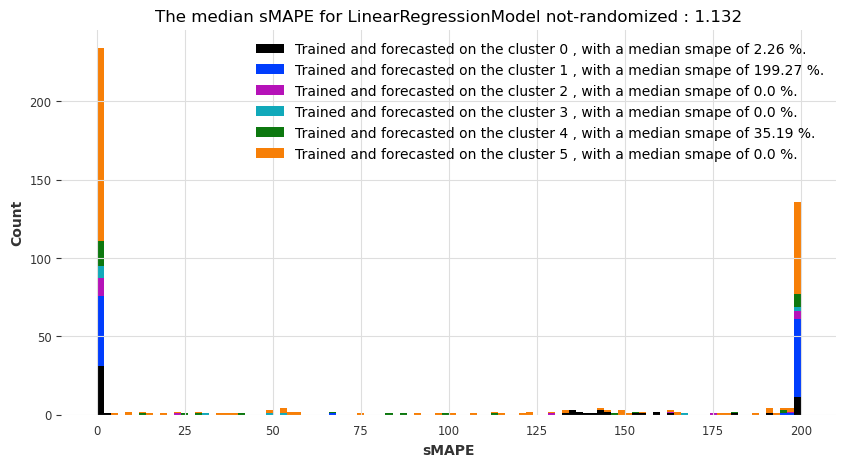

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:48:59,051] A new study created in memory with name: no-name-a99f11e0-b587-4e1a-bdb4-e8ba1ddf4493
[I 2023-01-27 20:49:02,888] Trial 0 finished with value: 32.00162695294877 and parameters: {'out_len': 8}. Best is trial 0 with value: 32.00162695294877.
[I 2023-01-27 20:49:06,900] Trial 1 finished with value: 37.021265735217995 and parameters: {'out_len': 7}. Best is trial 0 with value: 32.00162695294877.
[I 2023-01-27 20:49:11,587] Trial 2 finished with value: 40.179207211411274 and parameters: {'out_len': 4}. Best is trial 0 with value: 32.00162695294877.
[I 2023-01-27 20:49:15,645] Trial 3 finished with value: 31.727517416584416 and parameters: {'out_len': 9}. Best is trial 3 with value: 31.727517416584416.
[I 2023-01-27 20:49:18,866] Trial 4 finished with value: 41.914772471998525 and parameters: {'out_len': 1}. Best is trial 3 with value: 31.727517416584416.
[I 2023-01-27 20:49:22,679] Trial 5 finished with value: 33.71787094366726 and parameters: {'out_len': 12}. Be

[I 2023-01-27 20:52:37,504] Trial 1 finished with value: 135.64092319207236 and parameters: {'out_len': 8}. Best is trial 1 with value: 135.64092319207236.
[I 2023-01-27 20:52:41,703] Trial 2 finished with value: 131.38676506382944 and parameters: {'out_len': 2}. Best is trial 2 with value: 131.38676506382944.
[I 2023-01-27 20:52:47,238] Trial 3 finished with value: 132.89743451132648 and parameters: {'out_len': 4}. Best is trial 2 with value: 131.38676506382944.
[I 2023-01-27 20:52:52,020] Trial 4 finished with value: 135.64092319207236 and parameters: {'out_len': 8}. Best is trial 2 with value: 131.38676506382944.
[I 2023-01-27 20:52:56,753] Trial 5 finished with value: 135.36856150297035 and parameters: {'out_len': 9}. Best is trial 2 with value: 131.38676506382944.
[I 2023-01-27 20:53:01,487] Trial 6 finished with value: 135.36856150297035 and parameters: {'out_len': 9}. Best is trial 2 with value: 131.38676506382944.
[I 2023-01-27 20:53:05,390] Trial 7 finished with value: 130.668

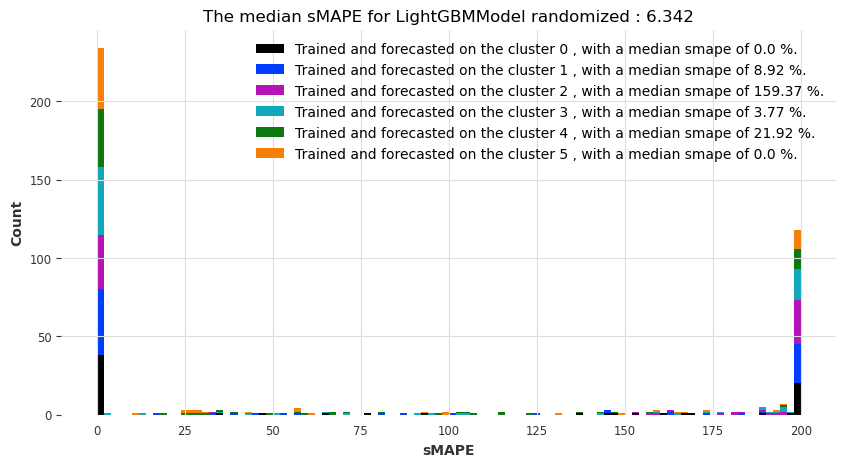

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 20:55:59,203] A new study created in memory with name: no-name-9aea2505-ed5f-4568-a28a-2bfa44f0880d
[I 2023-01-27 20:56:02,303] Trial 0 finished with value: 89.79665795562644 and parameters: {'out_len': 3}. Best is trial 0 with value: 89.79665795562644.
[I 2023-01-27 20:56:05,772] Trial 1 finished with value: 87.79345173597802 and parameters: {'out_len': 5}. Best is trial 1 with value: 87.79345173597802.
[I 2023-01-27 20:56:09,243] Trial 2 finished with value: 93.99095941094801 and parameters: {'out_len': 12}. Best is trial 1 with value: 87.79345173597802.
[I 2023-01-27 20:56:12,775] Trial 3 finished with value: 103.5300285155958 and parameters: {'out_len': 8}. Best is trial 1 with value: 87.79345173597802.
[I 2023-01-27 20:56:16,316] Trial 4 finished with value: 94.47489574714959 and parameters: {'out_len': 10}. Best is trial 1 with value: 87.79345173597802.
[I 2023-01-27 20:56:19,899] Trial 5 finished with value: 104.75988211234423 and parameters: {'out_len': 7}. Best i

[I 2023-01-27 20:58:49,301] Trial 2 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:58:50,085] Trial 3 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:58:50,927] Trial 4 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:58:51,805] Trial 5 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:58:52,751] Trial 6 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:58:53,516] Trial 7 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:58:54,457] Trial 8 finished with value: 0.0 and parameters: {'out_len': 12}. Best is trial 0 with value: 0.0.
[I 2023-01-27 20:58:55,493] Trial 9 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with val

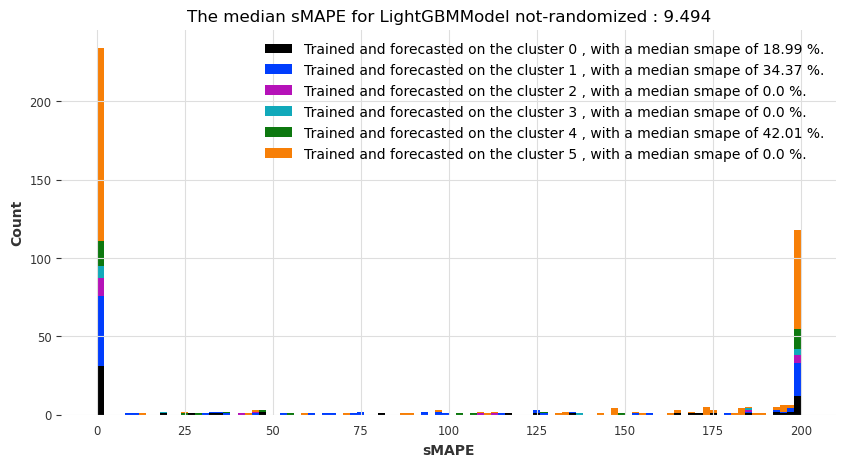

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:03:13,487] A new study created in memory with name: no-name-a2be298d-d649-48b9-bf19-31d97d5dc760
[I 2023-01-27 21:03:17,138] Trial 0 finished with value: 24.628579099909583 and parameters: {'out_len': 9, 'n_estimators': 59, 'max_depth': 23}. Best is trial 0 with value: 24.628579099909583.
[I 2023-01-27 21:03:22,042] Trial 1 finished with value: 23.68702364298815 and parameters: {'out_len': 8, 'n_estimators': 68, 'max_depth': 30}. Best is trial 1 with value: 23.68702364298815.
[I 2023-01-27 21:03:25,929] Trial 2 finished with value: 24.536081689692022 and parameters: {'out_len': 11, 'n_estimators': 99, 'max_depth': 19}. Best is trial 1 with value: 23.68702364298815.
[I 2023-01-27 21:03:29,627] Trial 3 finished with value: 33.42394170538181 and parameters: {'out_len': 3, 'n_estimators': 64, 'max_depth': 5}. Best is trial 1 with value: 23.68702364298815.
[I 2023-01-27 21:03:34,355] Trial 4 finished with value: 22.991264135051203 and parameters: {'out_len': 4, 'n_estimator

[I 2023-01-27 21:06:32,635] Trial 9 finished with value: 56.521041757726394 and parameters: {'out_len': 5, 'n_estimators': 95, 'max_depth': 18}. Best is trial 1 with value: 50.19776414239854.
[I 2023-01-27 21:06:37,112] Trial 10 finished with value: 59.305884349544925 and parameters: {'out_len': 10, 'n_estimators': 99, 'max_depth': 22}. Best is trial 1 with value: 50.19776414239854.
[I 2023-01-27 21:06:42,112] Trial 11 finished with value: 57.12022031659787 and parameters: {'out_len': 4, 'n_estimators': 76, 'max_depth': 29}. Best is trial 1 with value: 50.19776414239854.
[I 2023-01-27 21:06:47,578] Trial 12 finished with value: 55.62143354028541 and parameters: {'out_len': 7, 'n_estimators': 69, 'max_depth': 24}. Best is trial 1 with value: 50.19776414239854.
[I 2023-01-27 21:06:52,995] Trial 13 finished with value: 52.618226284895414 and parameters: {'out_len': 1, 'n_estimators': 80, 'max_depth': 24}. Best is trial 1 with value: 50.19776414239854.
[I 2023-01-27 21:06:57,240] Trial 14 

[I 2023-01-27 21:09:55,143] Trial 3 finished with value: 49.79665832339105 and parameters: {'out_len': 9, 'n_estimators': 68, 'max_depth': 23}. Best is trial 1 with value: 14.248866425828275.
[I 2023-01-27 21:09:58,914] Trial 4 finished with value: 38.66538881198401 and parameters: {'out_len': 7, 'n_estimators': 66, 'max_depth': 12}. Best is trial 1 with value: 14.248866425828275.
[I 2023-01-27 21:10:02,727] Trial 5 finished with value: 33.890844705369446 and parameters: {'out_len': 5, 'n_estimators': 53, 'max_depth': 17}. Best is trial 1 with value: 14.248866425828275.
[I 2023-01-27 21:10:07,557] Trial 6 finished with value: 51.63434779904329 and parameters: {'out_len': 8, 'n_estimators': 88, 'max_depth': 8}. Best is trial 1 with value: 14.248866425828275.
[I 2023-01-27 21:10:11,521] Trial 7 finished with value: 36.84264804951768 and parameters: {'out_len': 7, 'n_estimators': 81, 'max_depth': 10}. Best is trial 1 with value: 14.248866425828275.
[I 2023-01-27 21:10:15,227] Trial 8 fini

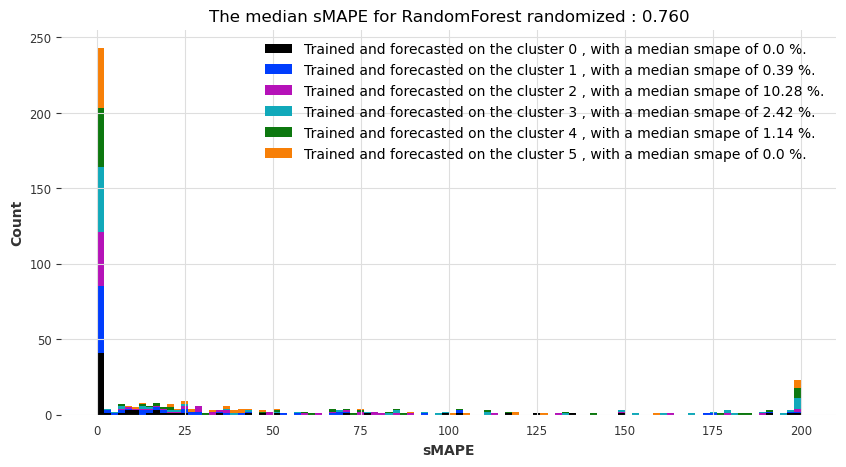

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:10:48,513] A new study created in memory with name: no-name-b5a62b6f-4bab-480f-a5d7-d50946832f19
[I 2023-01-27 21:10:51,677] Trial 0 finished with value: 77.62428832264447 and parameters: {'out_len': 8, 'n_estimators': 69, 'max_depth': 6}. Best is trial 0 with value: 77.62428832264447.
[I 2023-01-27 21:10:55,763] Trial 1 finished with value: 80.21639230191471 and parameters: {'out_len': 6, 'n_estimators': 95, 'max_depth': 24}. Best is trial 0 with value: 77.62428832264447.
[I 2023-01-27 21:10:59,058] Trial 2 finished with value: 84.59109670094738 and parameters: {'out_len': 9, 'n_estimators': 67, 'max_depth': 11}. Best is trial 0 with value: 77.62428832264447.
[I 2023-01-27 21:11:02,230] Trial 3 finished with value: 85.31182944957975 and parameters: {'out_len': 9, 'n_estimators': 54, 'max_depth': 14}. Best is trial 0 with value: 77.62428832264447.
[I 2023-01-27 21:11:05,925] Trial 4 finished with value: 83.89381911467187 and parameters: {'out_len': 9, 'n_estimators': 9

[I 2023-01-27 21:13:41,688] Trial 9 finished with value: 49.7943180665536 and parameters: {'out_len': 4, 'n_estimators': 77, 'max_depth': 20}. Best is trial 4 with value: 48.339426200788786.
[I 2023-01-27 21:13:42,897] Trial 10 finished with value: 47.726953880036326 and parameters: {'out_len': 1, 'n_estimators': 87, 'max_depth': 30}. Best is trial 10 with value: 47.726953880036326.
[I 2023-01-27 21:13:44,076] Trial 11 finished with value: 49.000759444883684 and parameters: {'out_len': 1, 'n_estimators': 86, 'max_depth': 30}. Best is trial 10 with value: 47.726953880036326.
[I 2023-01-27 21:13:45,358] Trial 12 finished with value: 48.426451007200875 and parameters: {'out_len': 1, 'n_estimators': 100, 'max_depth': 30}. Best is trial 10 with value: 47.726953880036326.
[I 2023-01-27 21:13:46,548] Trial 13 finished with value: 48.070005070639716 and parameters: {'out_len': 1, 'n_estimators': 87, 'max_depth': 26}. Best is trial 10 with value: 47.726953880036326.
[I 2023-01-27 21:13:47,521] 

[I 2023-01-27 21:16:07,523] Trial 5 finished with value: 29.536609681175154 and parameters: {'out_len': 8, 'n_estimators': 85, 'max_depth': 27}. Best is trial 5 with value: 29.536609681175154.
[I 2023-01-27 21:16:22,558] Trial 6 finished with value: 38.112322483159375 and parameters: {'out_len': 4, 'n_estimators': 55, 'max_depth': 28}. Best is trial 5 with value: 29.536609681175154.
[I 2023-01-27 21:16:38,085] Trial 7 finished with value: 53.60614363138602 and parameters: {'out_len': 2, 'n_estimators': 50, 'max_depth': 14}. Best is trial 5 with value: 29.536609681175154.
[I 2023-01-27 21:16:54,563] Trial 8 finished with value: 30.58908660038946 and parameters: {'out_len': 8, 'n_estimators': 96, 'max_depth': 24}. Best is trial 5 with value: 29.536609681175154.
[I 2023-01-27 21:17:09,886] Trial 9 finished with value: 31.428221551919027 and parameters: {'out_len': 9, 'n_estimators': 94, 'max_depth': 18}. Best is trial 5 with value: 29.536609681175154.
[I 2023-01-27 21:17:26,832] Trial 10 

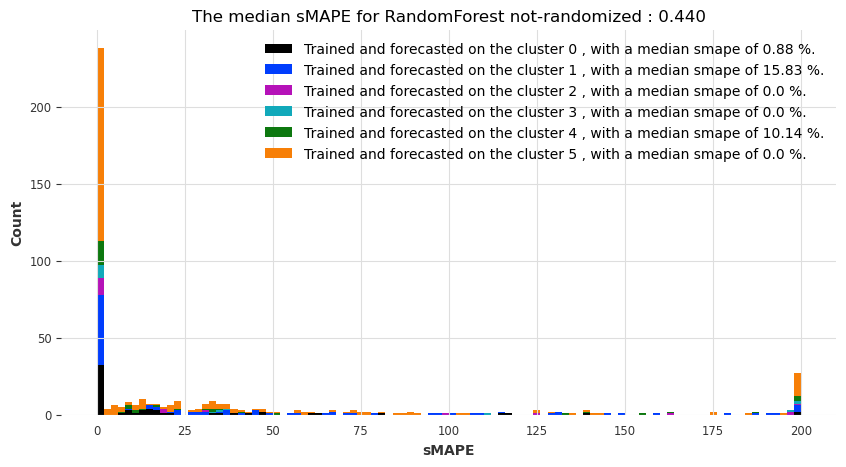

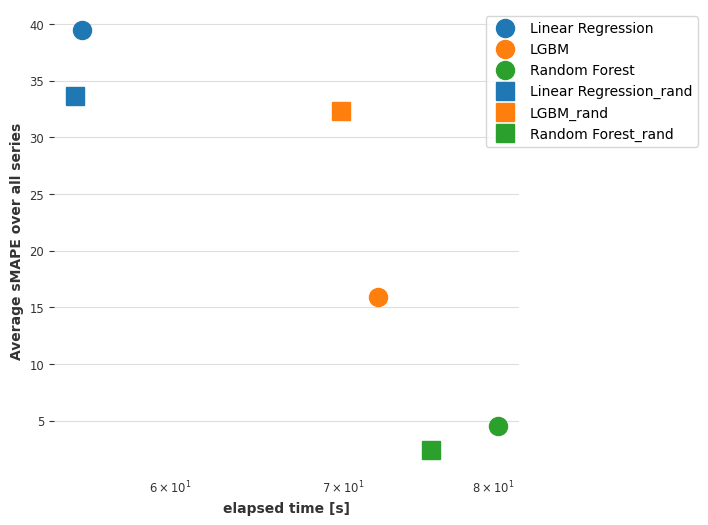

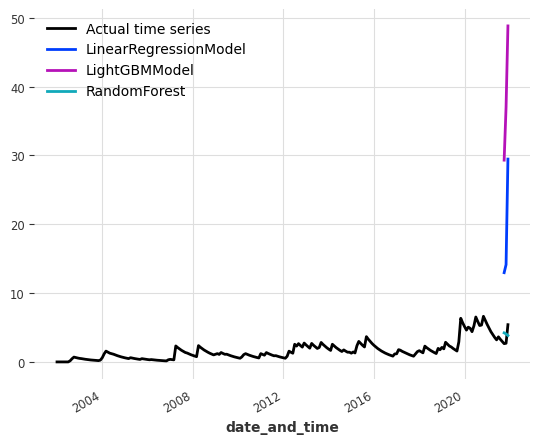

The results for index_cit_t2_t1 with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:18:52,132] A new study created in memory with name: no-name-d633996e-c7a2-4f66-b607-a3a5c6698b2b
[I 2023-01-27 21:18:54,975] Trial 0 finished with value: 38.62288242014084 and parameters: {'out_len': 12}. Best is trial 0 with value: 38.62288242014084.
[I 2023-01-27 21:18:57,745] Trial 1 finished with value: 28.904737681027008 and parameters: {'out_len': 2}. Best is trial 1 with value: 28.904737681027008.
[I 2023-01-27 21:19:00,650] Trial 2 finished with value: 49.42918027756082 and parameters: {'out_len': 10}. Best is trial 1 with value: 28.904737681027008.
[I 2023-01-27 21:19:04,530] Trial 3 finished with value: 53.33325234015111 and parameters: {'out_len': 9}. Best is trial 1 with value: 28.904737681027008.
[I 2023-01-27 21:19:07,359] Trial 4 finished with value: 27.88252549936292 and parameters: {'out_len': 3}. Best is trial 4 with value: 27.88252549936292.
[I 2023-01-27 21:19:10,221] Trial 5 finished with value: 53.33330602582079 and parameters: {'out_len': 8}. Bes

[I 2023-01-27 21:21:41,721] Trial 1 finished with value: 153.68373357062293 and parameters: {'out_len': 5}. Best is trial 0 with value: 136.36153901886968.
[I 2023-01-27 21:21:45,206] Trial 2 finished with value: 136.36153901886968 and parameters: {'out_len': 2}. Best is trial 0 with value: 136.36153901886968.
[I 2023-01-27 21:21:48,582] Trial 3 finished with value: 136.36153901886968 and parameters: {'out_len': 2}. Best is trial 0 with value: 136.36153901886968.
[I 2023-01-27 21:21:51,991] Trial 4 finished with value: 137.8397804627252 and parameters: {'out_len': 3}. Best is trial 0 with value: 136.36153901886968.
[I 2023-01-27 21:21:55,367] Trial 5 finished with value: 153.0601465847061 and parameters: {'out_len': 4}. Best is trial 0 with value: 136.36153901886968.
[I 2023-01-27 21:21:58,728] Trial 6 finished with value: 132.14528786813185 and parameters: {'out_len': 1}. Best is trial 6 with value: 132.14528786813185.
[I 2023-01-27 21:22:03,204] Trial 7 finished with value: 155.55555

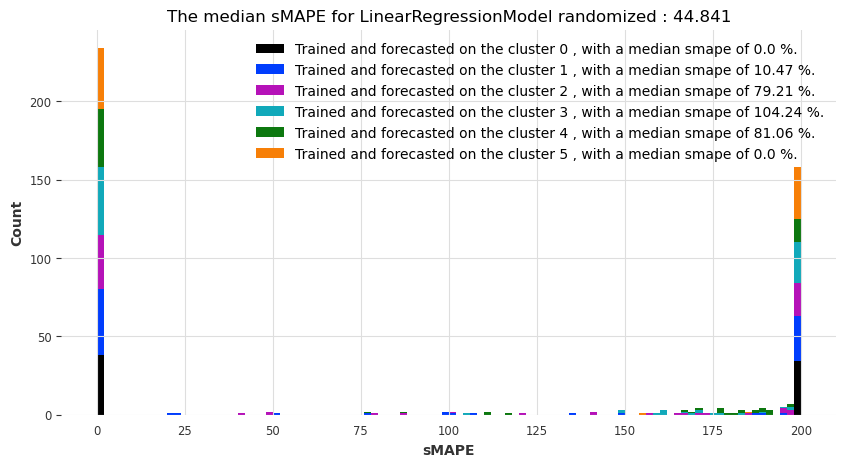

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:24:19,386] A new study created in memory with name: no-name-c8ee0527-c604-40a1-9eca-f68f54cd2d58
[I 2023-01-27 21:24:21,795] Trial 0 finished with value: 92.13922705927362 and parameters: {'out_len': 1}. Best is trial 0 with value: 92.13922705927362.
[I 2023-01-27 21:24:24,308] Trial 1 finished with value: 92.51516212379511 and parameters: {'out_len': 3}. Best is trial 0 with value: 92.13922705927362.
[I 2023-01-27 21:24:26,826] Trial 2 finished with value: 88.31674904142376 and parameters: {'out_len': 5}. Best is trial 2 with value: 88.31674904142376.
[I 2023-01-27 21:24:29,308] Trial 3 finished with value: 89.28242461780863 and parameters: {'out_len': 2}. Best is trial 2 with value: 88.31674904142376.
[I 2023-01-27 21:24:31,765] Trial 4 finished with value: 92.13922705927362 and parameters: {'out_len': 1}. Best is trial 2 with value: 88.31674904142376.
[I 2023-01-27 21:24:34,276] Trial 5 finished with value: 88.31674904142376 and parameters: {'out_len': 5}. Best is t

[I 2023-01-27 21:26:28,482] Trial 2 finished with value: 0.0 and parameters: {'out_len': 6}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:26:29,157] Trial 3 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:26:29,805] Trial 4 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:26:30,476] Trial 5 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:26:31,136] Trial 6 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:26:31,795] Trial 7 finished with value: 0.0 and parameters: {'out_len': 12}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:26:32,470] Trial 8 finished with value: 0.0 and parameters: {'out_len': 12}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:26:33,130] Trial 9 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with v

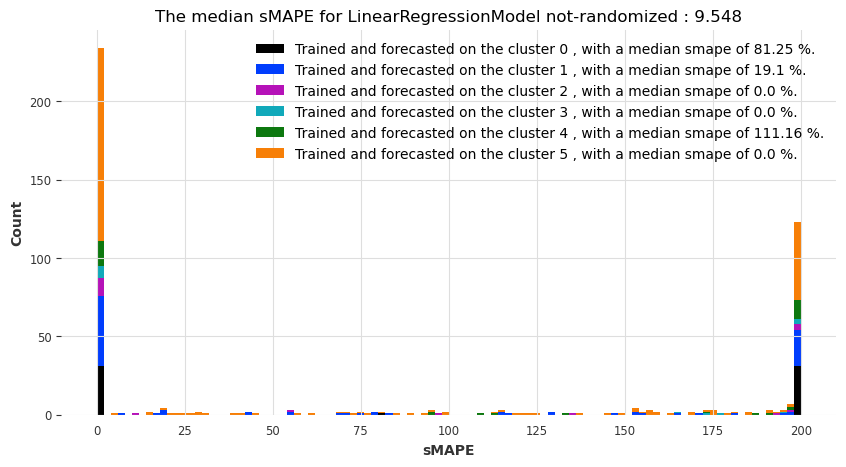

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:29:47,391] A new study created in memory with name: no-name-3dbab057-02e5-488c-b29f-0c7167261784
[I 2023-01-27 21:29:52,218] Trial 0 finished with value: 37.32188845018574 and parameters: {'out_len': 7}. Best is trial 0 with value: 37.32188845018574.
[I 2023-01-27 21:29:56,080] Trial 1 finished with value: 40.11852692923676 and parameters: {'out_len': 4}. Best is trial 0 with value: 37.32188845018574.
[I 2023-01-27 21:29:59,968] Trial 2 finished with value: 37.97371709643643 and parameters: {'out_len': 5}. Best is trial 0 with value: 37.32188845018574.
[I 2023-01-27 21:30:03,823] Trial 3 finished with value: 40.11852692923676 and parameters: {'out_len': 4}. Best is trial 0 with value: 37.32188845018574.
[I 2023-01-27 21:30:07,001] Trial 4 finished with value: 39.296636957596014 and parameters: {'out_len': 1}. Best is trial 0 with value: 37.32188845018574.
[I 2023-01-27 21:30:10,959] Trial 5 finished with value: 31.363998242253846 and parameters: {'out_len': 8}. Best is

[I 2023-01-27 21:33:23,920] Trial 1 finished with value: 132.63690948429561 and parameters: {'out_len': 5}. Best is trial 0 with value: 132.63690948429561.
[I 2023-01-27 21:33:29,449] Trial 2 finished with value: 134.61693698828404 and parameters: {'out_len': 11}. Best is trial 0 with value: 132.63690948429561.
[I 2023-01-27 21:33:34,130] Trial 3 finished with value: 134.4288051499188 and parameters: {'out_len': 9}. Best is trial 0 with value: 132.63690948429561.
[I 2023-01-27 21:33:38,180] Trial 4 finished with value: 131.89431835854137 and parameters: {'out_len': 2}. Best is trial 4 with value: 131.89431835854137.
[I 2023-01-27 21:33:42,631] Trial 5 finished with value: 133.31584619197307 and parameters: {'out_len': 12}. Best is trial 4 with value: 131.89431835854137.
[I 2023-01-27 21:33:46,731] Trial 6 finished with value: 131.89431835854137 and parameters: {'out_len': 2}. Best is trial 4 with value: 131.89431835854137.
[I 2023-01-27 21:33:51,392] Trial 7 finished with value: 134.42

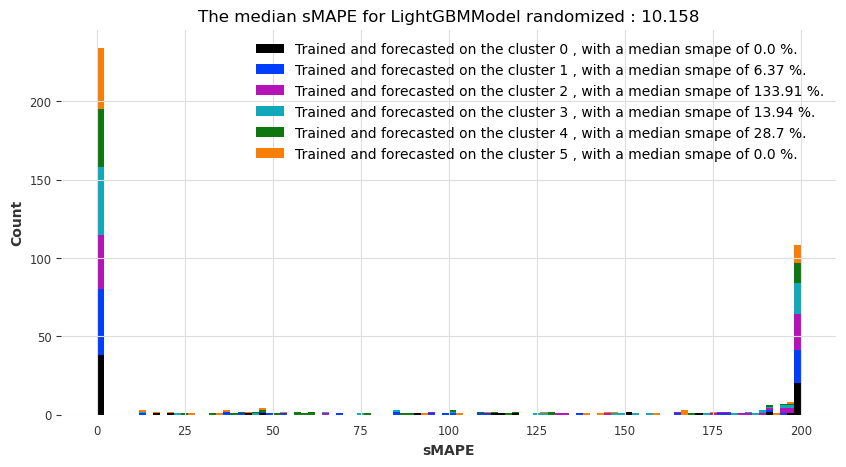

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:36:41,522] A new study created in memory with name: no-name-186a849e-987b-4f2f-b66e-0b2189dafa09
[I 2023-01-27 21:36:44,363] Trial 0 finished with value: 89.32364766773237 and parameters: {'out_len': 2}. Best is trial 0 with value: 89.32364766773237.
[I 2023-01-27 21:36:47,864] Trial 1 finished with value: 94.42184602649793 and parameters: {'out_len': 5}. Best is trial 0 with value: 89.32364766773237.
[I 2023-01-27 21:36:51,319] Trial 2 finished with value: 93.55218978901097 and parameters: {'out_len': 9}. Best is trial 0 with value: 89.32364766773237.
[I 2023-01-27 21:36:54,687] Trial 3 finished with value: 91.95321314140232 and parameters: {'out_len': 11}. Best is trial 0 with value: 89.32364766773237.
[I 2023-01-27 21:36:58,163] Trial 4 finished with value: 88.49310359792652 and parameters: {'out_len': 10}. Best is trial 4 with value: 88.49310359792652.
[I 2023-01-27 21:37:02,404] Trial 5 finished with value: 93.92488956788124 and parameters: {'out_len': 4}. Best is

[I 2023-01-27 21:39:27,909] Trial 2 finished with value: 0.0 and parameters: {'out_len': 2}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:39:28,757] Trial 3 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:39:29,717] Trial 4 finished with value: 0.0 and parameters: {'out_len': 7}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:39:30,688] Trial 5 finished with value: 0.0 and parameters: {'out_len': 7}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:39:31,631] Trial 6 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:39:32,630] Trial 7 finished with value: 0.0 and parameters: {'out_len': 8}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:39:33,477] Trial 8 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with value: 0.0.
[I 2023-01-27 21:39:34,482] Trial 9 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with valu

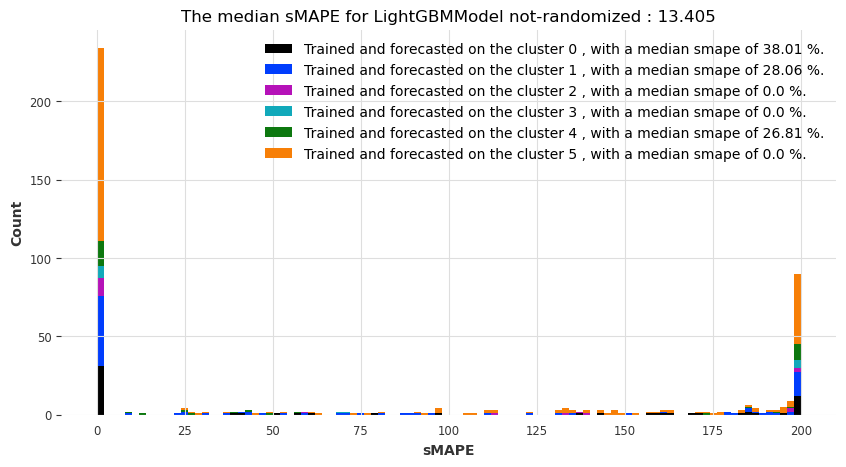

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:43:41,037] A new study created in memory with name: no-name-a028b398-4678-4b95-8ae9-a4e74dac23f6
[I 2023-01-27 21:43:45,528] Trial 0 finished with value: 24.854805768829934 and parameters: {'out_len': 5, 'n_estimators': 79, 'max_depth': 28}. Best is trial 0 with value: 24.854805768829934.
[I 2023-01-27 21:43:49,101] Trial 1 finished with value: 21.236028106071554 and parameters: {'out_len': 12, 'n_estimators': 83, 'max_depth': 20}. Best is trial 1 with value: 21.236028106071554.
[I 2023-01-27 21:43:53,349] Trial 2 finished with value: 23.532890478648618 and parameters: {'out_len': 4, 'n_estimators': 62, 'max_depth': 25}. Best is trial 1 with value: 21.236028106071554.
[I 2023-01-27 21:43:57,485] Trial 3 finished with value: 24.694908183914084 and parameters: {'out_len': 6, 'n_estimators': 72, 'max_depth': 11}. Best is trial 1 with value: 21.236028106071554.
[I 2023-01-27 21:44:01,413] Trial 4 finished with value: 22.110390957095944 and parameters: {'out_len': 11, 'n_es

[I 2023-01-27 21:47:01,270] Trial 9 finished with value: 64.41597904670867 and parameters: {'out_len': 1, 'n_estimators': 68, 'max_depth': 10}. Best is trial 5 with value: 52.18389377452016.
[I 2023-01-27 21:47:05,234] Trial 10 finished with value: 64.07758088465997 and parameters: {'out_len': 7, 'n_estimators': 50, 'max_depth': 30}. Best is trial 5 with value: 52.18389377452016.
[I 2023-01-27 21:47:10,800] Trial 11 finished with value: 64.33278298376759 and parameters: {'out_len': 3, 'n_estimators': 99, 'max_depth': 19}. Best is trial 5 with value: 52.18389377452016.
[I 2023-01-27 21:47:15,188] Trial 12 finished with value: 66.57891444538362 and parameters: {'out_len': 5, 'n_estimators': 63, 'max_depth': 18}. Best is trial 5 with value: 52.18389377452016.
[I 2023-01-27 21:47:20,200] Trial 13 finished with value: 61.22281809343646 and parameters: {'out_len': 2, 'n_estimators': 75, 'max_depth': 14}. Best is trial 5 with value: 52.18389377452016.
[I 2023-01-27 21:47:24,886] Trial 14 fini

[I 2023-01-27 21:50:25,155] Trial 3 finished with value: 65.24142050407328 and parameters: {'out_len': 5, 'n_estimators': 98, 'max_depth': 16}. Best is trial 1 with value: 51.29281377720047.
[I 2023-01-27 21:50:28,553] Trial 4 finished with value: 78.52293191106558 and parameters: {'out_len': 12, 'n_estimators': 74, 'max_depth': 17}. Best is trial 1 with value: 51.29281377720047.
[I 2023-01-27 21:50:32,644] Trial 5 finished with value: 71.07207275119852 and parameters: {'out_len': 7, 'n_estimators': 91, 'max_depth': 30}. Best is trial 1 with value: 51.29281377720047.
[I 2023-01-27 21:50:36,240] Trial 6 finished with value: 80.79655455782216 and parameters: {'out_len': 11, 'n_estimators': 92, 'max_depth': 12}. Best is trial 1 with value: 51.29281377720047.
[I 2023-01-27 21:50:40,089] Trial 7 finished with value: 81.28945917496894 and parameters: {'out_len': 3, 'n_estimators': 76, 'max_depth': 5}. Best is trial 1 with value: 51.29281377720047.
[I 2023-01-27 21:50:43,819] Trial 8 finished

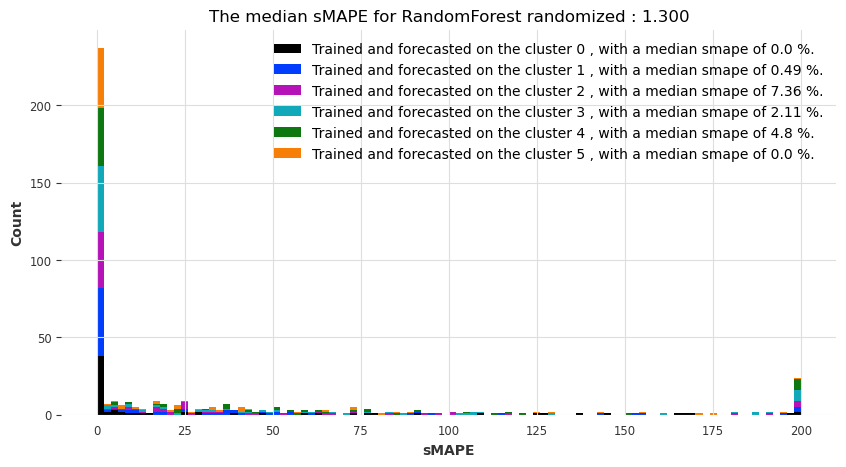

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:51:15,435] A new study created in memory with name: no-name-9efcd5cd-0cd7-477c-bbe5-d73457805982
[I 2023-01-27 21:51:19,479] Trial 0 finished with value: 84.7119193826471 and parameters: {'out_len': 6, 'n_estimators': 96, 'max_depth': 22}. Best is trial 0 with value: 84.7119193826471.
[I 2023-01-27 21:51:24,488] Trial 1 finished with value: 80.18886922197557 and parameters: {'out_len': 4, 'n_estimators': 84, 'max_depth': 26}. Best is trial 1 with value: 80.18886922197557.
[I 2023-01-27 21:51:27,842] Trial 2 finished with value: 79.37751549335448 and parameters: {'out_len': 9, 'n_estimators': 74, 'max_depth': 25}. Best is trial 2 with value: 79.37751549335448.
[I 2023-01-27 21:51:31,093] Trial 3 finished with value: 79.33627740280704 and parameters: {'out_len': 10, 'n_estimators': 74, 'max_depth': 26}. Best is trial 3 with value: 79.33627740280704.
[I 2023-01-27 21:51:35,191] Trial 4 finished with value: 85.28774669989177 and parameters: {'out_len': 5, 'n_estimators': 9

[I 2023-01-27 21:54:08,883] Trial 9 finished with value: 74.58901843768061 and parameters: {'out_len': 10, 'n_estimators': 87, 'max_depth': 19}. Best is trial 8 with value: 48.02467874860199.
[I 2023-01-27 21:54:09,872] Trial 10 finished with value: 61.35084332230373 and parameters: {'out_len': 6, 'n_estimators': 55, 'max_depth': 9}. Best is trial 8 with value: 48.02467874860199.
[I 2023-01-27 21:54:11,051] Trial 11 finished with value: 48.52966164754722 and parameters: {'out_len': 1, 'n_estimators': 83, 'max_depth': 12}. Best is trial 8 with value: 48.02467874860199.
[I 2023-01-27 21:54:12,298] Trial 12 finished with value: 47.99147074239632 and parameters: {'out_len': 1, 'n_estimators': 98, 'max_depth': 22}. Best is trial 12 with value: 47.99147074239632.
[I 2023-01-27 21:54:13,468] Trial 13 finished with value: 47.82195735763815 and parameters: {'out_len': 3, 'n_estimators': 97, 'max_depth': 22}. Best is trial 13 with value: 47.82195735763815.
[I 2023-01-27 21:54:14,632] Trial 14 fi

[I 2023-01-27 21:56:47,923] Trial 5 finished with value: 41.206359153797344 and parameters: {'out_len': 4, 'n_estimators': 97, 'max_depth': 15}. Best is trial 4 with value: 29.30008420200721.
[I 2023-01-27 21:57:03,949] Trial 6 finished with value: 36.32206665947827 and parameters: {'out_len': 8, 'n_estimators': 87, 'max_depth': 15}. Best is trial 4 with value: 29.30008420200721.
[I 2023-01-27 21:57:16,993] Trial 7 finished with value: 36.259081778020516 and parameters: {'out_len': 10, 'n_estimators': 72, 'max_depth': 26}. Best is trial 4 with value: 29.30008420200721.
[I 2023-01-27 21:57:31,142] Trial 8 finished with value: 29.87517964914364 and parameters: {'out_len': 9, 'n_estimators': 66, 'max_depth': 29}. Best is trial 4 with value: 29.30008420200721.
[I 2023-01-27 21:57:42,753] Trial 9 finished with value: 57.944413346537715 and parameters: {'out_len': 10, 'n_estimators': 66, 'max_depth': 9}. Best is trial 4 with value: 29.30008420200721.
[I 2023-01-27 21:57:54,070] Trial 10 fini

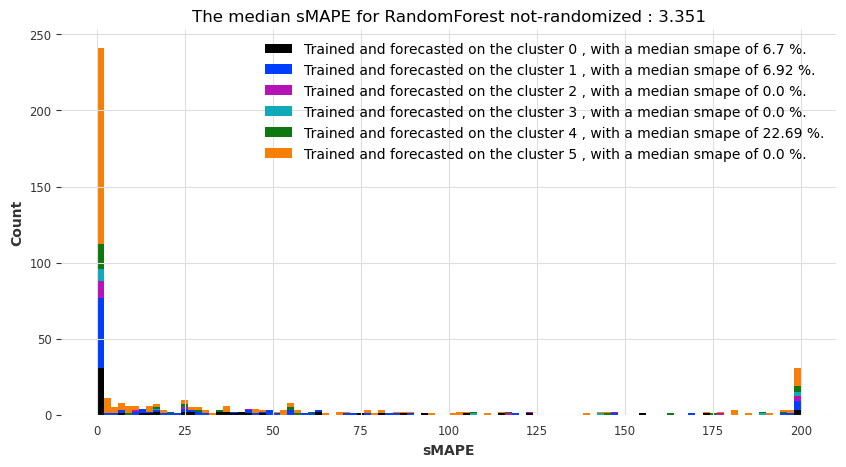

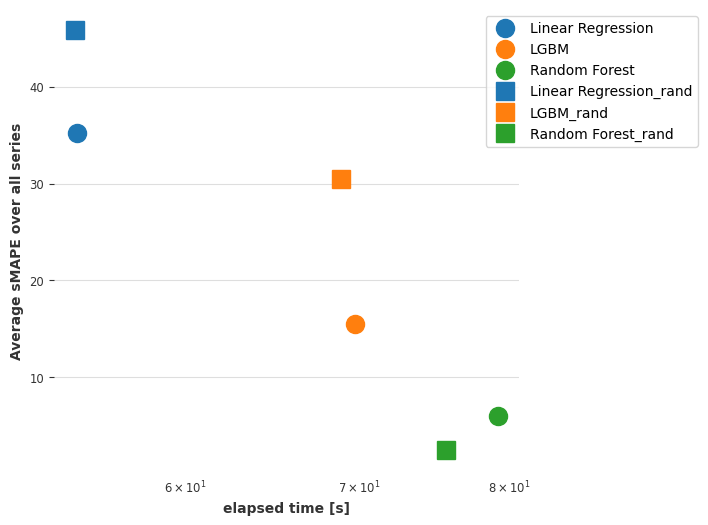

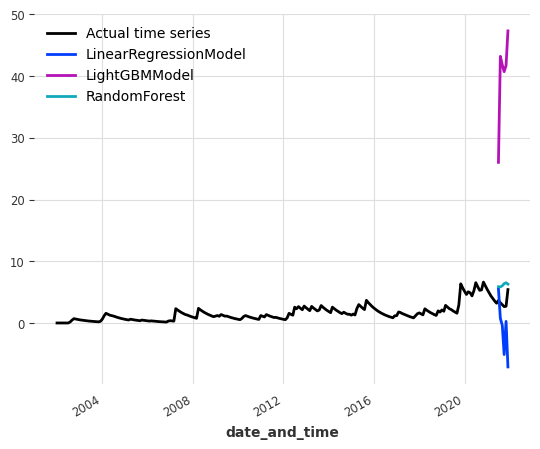

The results for index_cit_t2_t1 with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 21:59:12,207] A new study created in memory with name: no-name-cb0098d6-7b1a-4367-88fe-73910a029597
[I 2023-01-27 21:59:14,933] Trial 0 finished with value: 52.68923089261948 and parameters: {'out_len': 10}. Best is trial 0 with value: 52.68923089261948.
[I 2023-01-27 21:59:17,713] Trial 1 finished with value: 46.058310681525455 and parameters: {'out_len': 5}. Best is trial 1 with value: 46.058310681525455.
[I 2023-01-27 21:59:20,499] Trial 2 finished with value: 53.28905059280428 and parameters: {'out_len': 8}. Best is trial 1 with value: 46.058310681525455.
[I 2023-01-27 21:59:23,349] Trial 3 finished with value: 52.68923089261948 and parameters: {'out_len': 10}. Best is trial 1 with value: 46.058310681525455.
[I 2023-01-27 21:59:26,188] Trial 4 finished with value: 52.68923089261948 and parameters: {'out_len': 10}. Best is trial 1 with value: 46.058310681525455.
[I 2023-01-27 21:59:28,965] Trial 5 finished with value: 46.4173694066607 and parameters: {'out_len': 4}. Be

[I 2023-01-27 22:01:56,090] Trial 1 finished with value: 125.97207103479542 and parameters: {'out_len': 1}. Best is trial 1 with value: 125.97207103479542.
[I 2023-01-27 22:01:59,459] Trial 2 finished with value: 155.5388119257565 and parameters: {'out_len': 9}. Best is trial 1 with value: 125.97207103479542.
[I 2023-01-27 22:02:02,789] Trial 3 finished with value: 125.97207103479542 and parameters: {'out_len': 1}. Best is trial 1 with value: 125.97207103479542.
[I 2023-01-27 22:02:06,126] Trial 4 finished with value: 123.47421294213956 and parameters: {'out_len': 3}. Best is trial 4 with value: 123.47421294213956.
[I 2023-01-27 22:02:09,477] Trial 5 finished with value: 123.47421294213956 and parameters: {'out_len': 3}. Best is trial 4 with value: 123.47421294213956.
[I 2023-01-27 22:02:12,774] Trial 6 finished with value: 125.97207103479542 and parameters: {'out_len': 1}. Best is trial 4 with value: 123.47421294213956.
[I 2023-01-27 22:02:16,192] Trial 7 finished with value: 155.5555

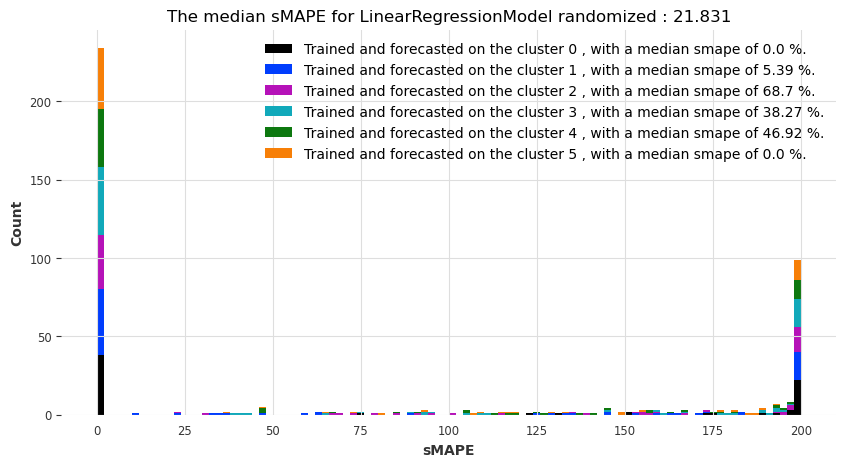

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:04:28,659] A new study created in memory with name: no-name-7c28e701-fa5d-4600-8a5f-90a6137de066
[I 2023-01-27 22:04:31,080] Trial 0 finished with value: 105.01749695670354 and parameters: {'out_len': 8}. Best is trial 0 with value: 105.01749695670354.
[I 2023-01-27 22:04:33,550] Trial 1 finished with value: 102.1111085204078 and parameters: {'out_len': 9}. Best is trial 1 with value: 102.1111085204078.
[I 2023-01-27 22:04:36,031] Trial 2 finished with value: 105.01749695670354 and parameters: {'out_len': 8}. Best is trial 1 with value: 102.1111085204078.
[I 2023-01-27 22:04:38,608] Trial 3 finished with value: 88.60060520414059 and parameters: {'out_len': 2}. Best is trial 3 with value: 88.60060520414059.
[I 2023-01-27 22:04:41,026] Trial 4 finished with value: 85.20455343753744 and parameters: {'out_len': 1}. Best is trial 4 with value: 85.20455343753744.
[I 2023-01-27 22:04:44,406] Trial 5 finished with value: 85.20455343753744 and parameters: {'out_len': 1}. Best i

[I 2023-01-27 22:06:33,377] Trial 2 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:06:35,012] Trial 3 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:06:35,624] Trial 4 finished with value: 0.0 and parameters: {'out_len': 11}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:06:36,283] Trial 5 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:06:37,100] Trial 6 finished with value: 0.0 and parameters: {'out_len': 5}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:06:37,760] Trial 7 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:06:38,403] Trial 8 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:06:39,032] Trial 9 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with va

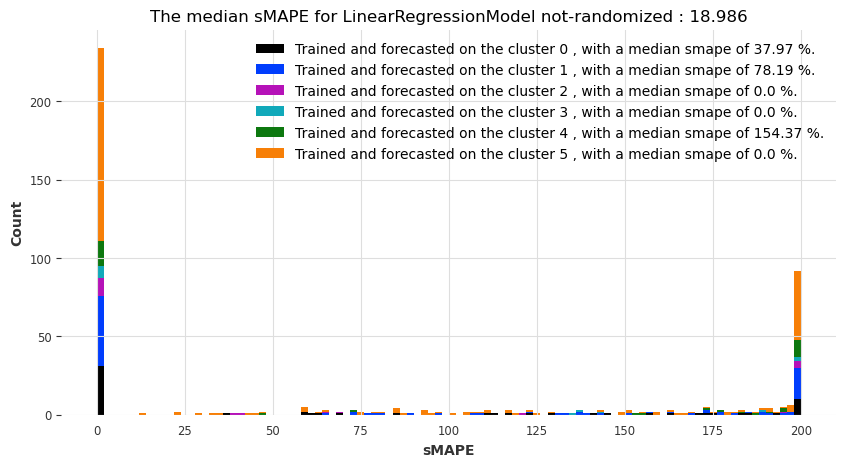

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:09:46,939] A new study created in memory with name: no-name-cb68a689-4439-43b9-a0c8-c7dab1260c75
[I 2023-01-27 22:09:50,556] Trial 0 finished with value: 30.550373228017026 and parameters: {'out_len': 11}. Best is trial 0 with value: 30.550373228017026.
[I 2023-01-27 22:09:54,193] Trial 1 finished with value: 37.38096007748886 and parameters: {'out_len': 4}. Best is trial 0 with value: 30.550373228017026.
[I 2023-01-27 22:09:57,725] Trial 2 finished with value: 37.93599110026479 and parameters: {'out_len': 3}. Best is trial 0 with value: 30.550373228017026.
[I 2023-01-27 22:10:01,409] Trial 3 finished with value: 37.38096007748886 and parameters: {'out_len': 4}. Best is trial 0 with value: 30.550373228017026.
[I 2023-01-27 22:10:05,069] Trial 4 finished with value: 31.554511603062014 and parameters: {'out_len': 12}. Best is trial 0 with value: 30.550373228017026.
[I 2023-01-27 22:10:08,785] Trial 5 finished with value: 30.550373228017026 and parameters: {'out_len': 11}

[I 2023-01-27 22:13:18,811] Trial 1 finished with value: 136.02046084623413 and parameters: {'out_len': 11}. Best is trial 0 with value: 133.37496145572882.
[I 2023-01-27 22:13:22,974] Trial 2 finished with value: 132.2063846431425 and parameters: {'out_len': 3}. Best is trial 2 with value: 132.2063846431425.
[I 2023-01-27 22:13:27,418] Trial 3 finished with value: 136.02046084623413 and parameters: {'out_len': 11}. Best is trial 2 with value: 132.2063846431425.
[I 2023-01-27 22:13:32,065] Trial 4 finished with value: 135.35090747742848 and parameters: {'out_len': 9}. Best is trial 2 with value: 132.2063846431425.
[I 2023-01-27 22:13:36,557] Trial 5 finished with value: 136.02046084623413 and parameters: {'out_len': 11}. Best is trial 2 with value: 132.2063846431425.
[I 2023-01-27 22:13:40,867] Trial 6 finished with value: 130.91038124842896 and parameters: {'out_len': 4}. Best is trial 6 with value: 130.91038124842896.
[I 2023-01-27 22:13:46,355] Trial 7 finished with value: 131.77534

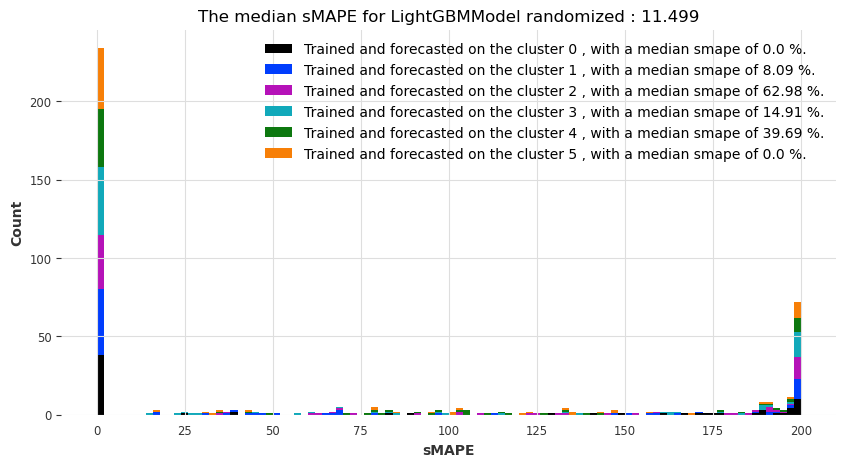

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:16:26,768] A new study created in memory with name: no-name-dd721a90-39f1-4768-b905-c5a7206bd7d8
[I 2023-01-27 22:16:29,971] Trial 0 finished with value: 95.57894663480141 and parameters: {'out_len': 4}. Best is trial 0 with value: 95.57894663480141.
[I 2023-01-27 22:16:33,395] Trial 1 finished with value: 100.40724400229783 and parameters: {'out_len': 10}. Best is trial 0 with value: 95.57894663480141.
[I 2023-01-27 22:16:36,947] Trial 2 finished with value: 91.34432160200602 and parameters: {'out_len': 7}. Best is trial 2 with value: 91.34432160200602.
[I 2023-01-27 22:16:41,309] Trial 3 finished with value: 95.50353992171645 and parameters: {'out_len': 12}. Best is trial 2 with value: 91.34432160200602.
[I 2023-01-27 22:16:44,598] Trial 4 finished with value: 95.9846675917387 and parameters: {'out_len': 6}. Best is trial 2 with value: 91.34432160200602.
[I 2023-01-27 22:16:47,724] Trial 5 finished with value: 92.73682919247442 and parameters: {'out_len': 3}. Best is

[I 2023-01-27 22:19:09,401] Trial 2 finished with value: 0.0 and parameters: {'out_len': 9}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:19:10,420] Trial 3 finished with value: 0.0 and parameters: {'out_len': 10}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:19:11,393] Trial 4 finished with value: 0.0 and parameters: {'out_len': 8}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:19:12,272] Trial 5 finished with value: 0.0 and parameters: {'out_len': 4}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:19:13,057] Trial 6 finished with value: 0.0 and parameters: {'out_len': 2}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:19:13,983] Trial 7 finished with value: 0.0 and parameters: {'out_len': 6}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:19:14,736] Trial 8 finished with value: 0.0 and parameters: {'out_len': 1}. Best is trial 0 with value: 0.0.
[I 2023-01-27 22:19:15,521] Trial 9 finished with value: 0.0 and parameters: {'out_len': 3}. Best is trial 0 with val

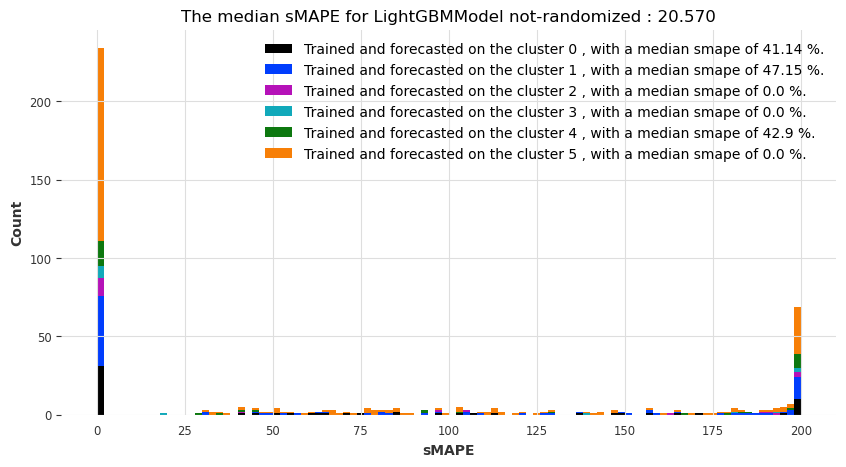

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:23:26,779] A new study created in memory with name: no-name-e57eff27-1c7d-496e-9b58-2ecfaaab8f1a
[I 2023-01-27 22:23:31,672] Trial 0 finished with value: 32.92993312248658 and parameters: {'out_len': 3, 'n_estimators': 87, 'max_depth': 13}. Best is trial 0 with value: 32.92993312248658.
[I 2023-01-27 22:23:37,044] Trial 1 finished with value: 32.99800309717883 and parameters: {'out_len': 2, 'n_estimators': 69, 'max_depth': 12}. Best is trial 0 with value: 32.92993312248658.
[I 2023-01-27 22:23:40,637] Trial 2 finished with value: 29.456952850549147 and parameters: {'out_len': 11, 'n_estimators': 75, 'max_depth': 15}. Best is trial 2 with value: 29.456952850549147.
[I 2023-01-27 22:23:45,145] Trial 3 finished with value: 35.04265894841124 and parameters: {'out_len': 1, 'n_estimators': 63, 'max_depth': 21}. Best is trial 2 with value: 29.456952850549147.
[I 2023-01-27 22:23:49,030] Trial 4 finished with value: 35.85551406697299 and parameters: {'out_len': 4, 'n_estimator

[I 2023-01-27 22:26:40,401] Trial 9 finished with value: 62.67443370311233 and parameters: {'out_len': 7, 'n_estimators': 97, 'max_depth': 19}. Best is trial 9 with value: 62.67443370311233.
[I 2023-01-27 22:26:44,190] Trial 10 finished with value: 62.16612976807706 and parameters: {'out_len': 12, 'n_estimators': 99, 'max_depth': 26}. Best is trial 10 with value: 62.16612976807706.
[I 2023-01-27 22:26:48,087] Trial 11 finished with value: 65.18434097532989 and parameters: {'out_len': 12, 'n_estimators': 100, 'max_depth': 27}. Best is trial 10 with value: 62.16612976807706.
[I 2023-01-27 22:26:53,229] Trial 12 finished with value: 57.36911041758746 and parameters: {'out_len': 10, 'n_estimators': 100, 'max_depth': 25}. Best is trial 12 with value: 57.36911041758746.
[I 2023-01-27 22:26:57,093] Trial 13 finished with value: 65.98036406174738 and parameters: {'out_len': 10, 'n_estimators': 77, 'max_depth': 25}. Best is trial 12 with value: 57.36911041758746.
[I 2023-01-27 22:27:01,262] Tri

[I 2023-01-27 22:29:56,557] Trial 3 finished with value: 93.22036650970445 and parameters: {'out_len': 12, 'n_estimators': 84, 'max_depth': 26}. Best is trial 2 with value: 61.60306105869337.
[I 2023-01-27 22:30:01,573] Trial 4 finished with value: 71.38459460978756 and parameters: {'out_len': 6, 'n_estimators': 78, 'max_depth': 19}. Best is trial 2 with value: 61.60306105869337.
[I 2023-01-27 22:30:05,098] Trial 5 finished with value: 77.02414489464245 and parameters: {'out_len': 7, 'n_estimators': 54, 'max_depth': 24}. Best is trial 2 with value: 61.60306105869337.
[I 2023-01-27 22:30:09,314] Trial 6 finished with value: 69.3634424022607 and parameters: {'out_len': 5, 'n_estimators': 91, 'max_depth': 15}. Best is trial 2 with value: 61.60306105869337.
[I 2023-01-27 22:30:13,069] Trial 7 finished with value: 77.70078016012597 and parameters: {'out_len': 6, 'n_estimators': 68, 'max_depth': 30}. Best is trial 2 with value: 61.60306105869337.
[I 2023-01-27 22:30:16,440] Trial 8 finished 

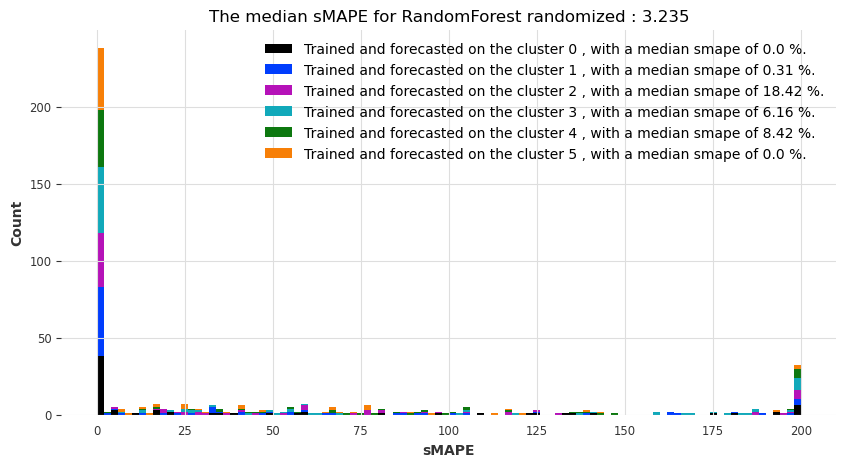

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:30:54,159] A new study created in memory with name: no-name-be62430e-950e-4f9f-bb35-687437ecf5e3
[I 2023-01-27 22:30:57,708] Trial 0 finished with value: 80.7516364283419 and parameters: {'out_len': 4, 'n_estimators': 68, 'max_depth': 24}. Best is trial 0 with value: 80.7516364283419.
[I 2023-01-27 22:31:00,487] Trial 1 finished with value: 90.24443710145773 and parameters: {'out_len': 12, 'n_estimators': 55, 'max_depth': 10}. Best is trial 0 with value: 80.7516364283419.
[I 2023-01-27 22:31:03,661] Trial 2 finished with value: 90.45351724088816 and parameters: {'out_len': 9, 'n_estimators': 96, 'max_depth': 6}. Best is trial 0 with value: 80.7516364283419.
[I 2023-01-27 22:31:07,345] Trial 3 finished with value: 88.52836807183851 and parameters: {'out_len': 1, 'n_estimators': 59, 'max_depth': 26}. Best is trial 0 with value: 80.7516364283419.
[I 2023-01-27 22:31:10,805] Trial 4 finished with value: 84.28574002866799 and parameters: {'out_len': 8, 'n_estimators': 95, '

[I 2023-01-27 22:33:42,903] Trial 9 finished with value: 69.6355097740538 and parameters: {'out_len': 11, 'n_estimators': 91, 'max_depth': 30}. Best is trial 4 with value: 61.577386267970326.
[I 2023-01-27 22:33:43,814] Trial 10 finished with value: 65.64479703675093 and parameters: {'out_len': 9, 'n_estimators': 50, 'max_depth': 19}. Best is trial 4 with value: 61.577386267970326.
[I 2023-01-27 22:33:44,747] Trial 11 finished with value: 62.33100979302791 and parameters: {'out_len': 9, 'n_estimators': 64, 'max_depth': 6}. Best is trial 4 with value: 61.577386267970326.
[I 2023-01-27 22:33:45,674] Trial 12 finished with value: 62.83478549291084 and parameters: {'out_len': 9, 'n_estimators': 68, 'max_depth': 14}. Best is trial 4 with value: 61.577386267970326.
[I 2023-01-27 22:33:46,630] Trial 13 finished with value: 61.313364177359105 and parameters: {'out_len': 8, 'n_estimators': 68, 'max_depth': 14}. Best is trial 13 with value: 61.313364177359105.
[I 2023-01-27 22:33:47,573] Trial 1

[I 2023-01-27 22:36:12,122] Trial 5 finished with value: 41.850490079618226 and parameters: {'out_len': 8, 'n_estimators': 82, 'max_depth': 23}. Best is trial 5 with value: 41.850490079618226.
[I 2023-01-27 22:36:23,269] Trial 6 finished with value: 50.114582838063455 and parameters: {'out_len': 12, 'n_estimators': 68, 'max_depth': 20}. Best is trial 5 with value: 41.850490079618226.
[I 2023-01-27 22:36:34,881] Trial 7 finished with value: 51.965393987884184 and parameters: {'out_len': 12, 'n_estimators': 86, 'max_depth': 16}. Best is trial 5 with value: 41.850490079618226.
[I 2023-01-27 22:36:53,911] Trial 8 finished with value: 44.84342266180551 and parameters: {'out_len': 3, 'n_estimators': 90, 'max_depth': 27}. Best is trial 5 with value: 41.850490079618226.
[I 2023-01-27 22:37:05,162] Trial 9 finished with value: 57.49910074736007 and parameters: {'out_len': 8, 'n_estimators': 65, 'max_depth': 6}. Best is trial 5 with value: 41.850490079618226.
[I 2023-01-27 22:37:20,381] Trial 10

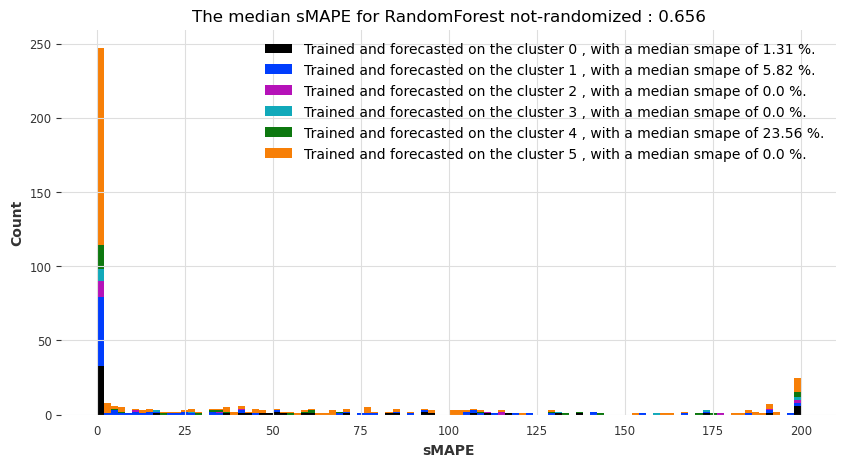

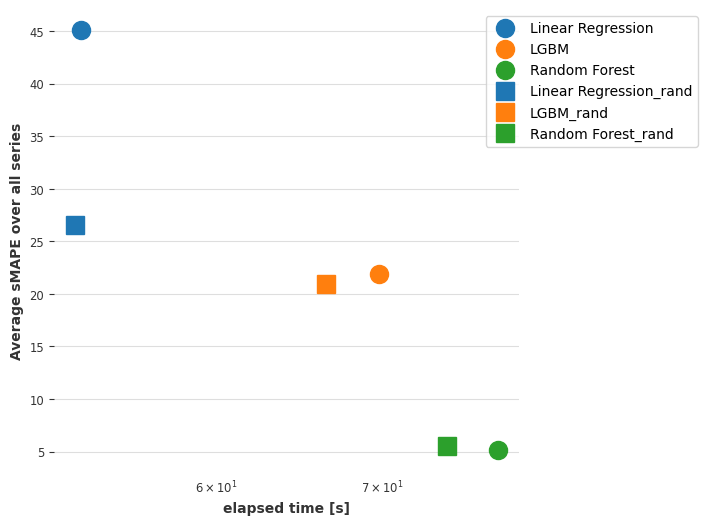

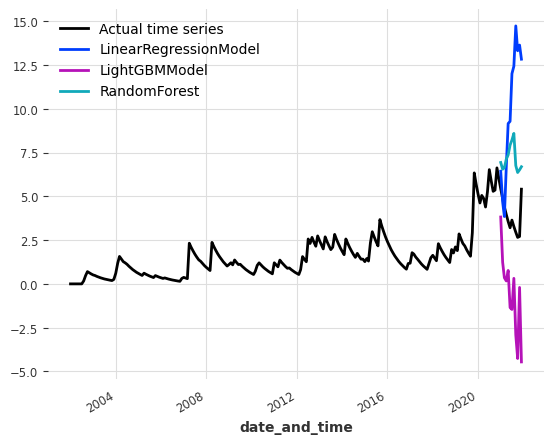

The results for index_colab_increm are:
The results for index_colab_increm with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:38:43,955] A new study created in memory with name: no-name-e8ca4504-1b02-4a09-beb6-68a5744ee10f
[I 2023-01-27 22:38:48,453] Trial 0 finished with value: 161.36609463865133 and parameters: {'out_len': 11}. Best is trial 0 with value: 161.36609463865133.
[I 2023-01-27 22:38:51,912] Trial 1 finished with value: 96.31139582591713 and parameters: {'out_len': 7}. Best is trial 1 with value: 96.31139582591713.
[I 2023-01-27 22:38:55,313] Trial 2 finished with value: 91.3445023474981 and parameters: {'out_len': 3}. Best is trial 2 with value: 91.3445023474981.
[I 2023-01-27 22:38:58,720] Trial 3 finished with value: 91.3445023474981 and parameters: {'out_len': 3}. Best is trial 2 with value: 91.3445023474981.
[I 2023-01-27 22:39:02,221] Trial 4 finished with value: 96.31139582591713 and parameters: {'out_len': 7}. Best is trial 2 with value: 91.3445023474981.
[I 2023-01-27 22:39:05,630] Trial 5 finished with value: 91.3445023474981 and parameters: {'out_len': 3}. Best is tria

[I 2023-01-27 22:41:38,890] Trial 1 finished with value: 84.63068078254929 and parameters: {'out_len': 9}. Best is trial 1 with value: 84.63068078254929.
[I 2023-01-27 22:41:42,356] Trial 2 finished with value: 89.92491097481305 and parameters: {'out_len': 8}. Best is trial 1 with value: 84.63068078254929.
[I 2023-01-27 22:41:45,753] Trial 3 finished with value: 93.32881530428114 and parameters: {'out_len': 3}. Best is trial 1 with value: 84.63068078254929.
[I 2023-01-27 22:41:50,141] Trial 4 finished with value: 88.11722463235013 and parameters: {'out_len': 6}. Best is trial 1 with value: 84.63068078254929.
[I 2023-01-27 22:41:53,501] Trial 5 finished with value: 100.90055697667293 and parameters: {'out_len': 1}. Best is trial 1 with value: 84.63068078254929.
[I 2023-01-27 22:41:56,949] Trial 6 finished with value: 88.1136739749607 and parameters: {'out_len': 5}. Best is trial 1 with value: 84.63068078254929.
[I 2023-01-27 22:42:00,412] Trial 7 finished with value: 85.30683026997306 a

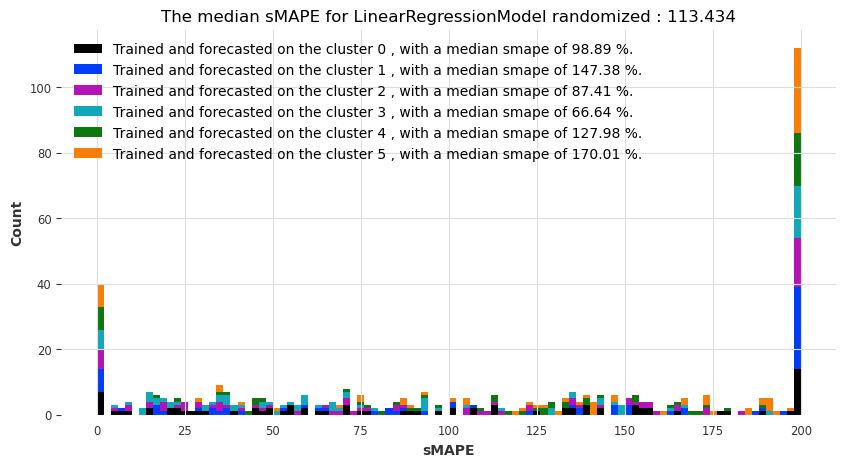

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:44:14,518] A new study created in memory with name: no-name-348245d7-1c0e-4b73-b810-5da3ebd180aa
[I 2023-01-27 22:44:17,126] Trial 0 finished with value: 114.92026296726777 and parameters: {'out_len': 8}. Best is trial 0 with value: 114.92026296726777.
[I 2023-01-27 22:44:19,718] Trial 1 finished with value: 86.38990143779064 and parameters: {'out_len': 1}. Best is trial 1 with value: 86.38990143779064.
[I 2023-01-27 22:44:22,419] Trial 2 finished with value: 151.49135563900933 and parameters: {'out_len': 11}. Best is trial 1 with value: 86.38990143779064.
[I 2023-01-27 22:44:26,054] Trial 3 finished with value: 102.568912703754 and parameters: {'out_len': 6}. Best is trial 1 with value: 86.38990143779064.
[I 2023-01-27 22:44:28,803] Trial 4 finished with value: 109.60775285294493 and parameters: {'out_len': 10}. Best is trial 1 with value: 86.38990143779064.
[I 2023-01-27 22:44:31,510] Trial 5 finished with value: 151.49135563900933 and parameters: {'out_len': 11}. Be

[I 2023-01-27 22:46:30,178] Trial 1 finished with value: 47.045993545300085 and parameters: {'out_len': 6}. Best is trial 0 with value: 38.28053647081696.
[I 2023-01-27 22:46:30,366] Trial 2 finished with value: 55.259446018341144 and parameters: {'out_len': 9}. Best is trial 0 with value: 38.28053647081696.
[I 2023-01-27 22:46:30,554] Trial 3 finished with value: 38.28053647081696 and parameters: {'out_len': 11}. Best is trial 0 with value: 38.28053647081696.
[I 2023-01-27 22:46:30,758] Trial 4 finished with value: 56.35951463986141 and parameters: {'out_len': 12}. Best is trial 0 with value: 38.28053647081696.
[I 2023-01-27 22:46:30,993] Trial 5 finished with value: 45.79534700199927 and parameters: {'out_len': 5}. Best is trial 0 with value: 38.28053647081696.
[I 2023-01-27 22:46:31,201] Trial 6 finished with value: 32.22110071235706 and parameters: {'out_len': 10}. Best is trial 6 with value: 32.22110071235706.
[I 2023-01-27 22:46:31,418] Trial 7 finished with value: 52.30361644465

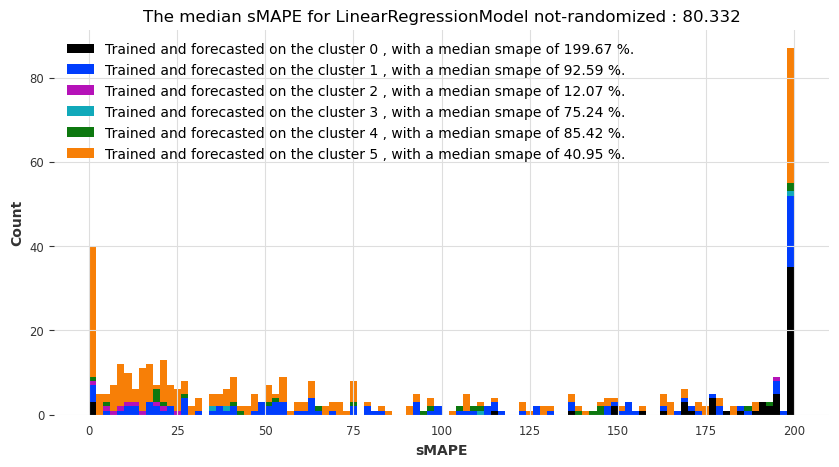

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:49:48,675] A new study created in memory with name: no-name-374e8091-88b9-4d9b-ac95-5a6572fcd397
[I 2023-01-27 22:49:54,491] Trial 0 finished with value: 99.7003994024175 and parameters: {'out_len': 6}. Best is trial 0 with value: 99.7003994024175.
[I 2023-01-27 22:50:00,474] Trial 1 finished with value: 96.40288221695566 and parameters: {'out_len': 5}. Best is trial 1 with value: 96.40288221695566.
[I 2023-01-27 22:50:06,667] Trial 2 finished with value: 176.26157146240018 and parameters: {'out_len': 11}. Best is trial 1 with value: 96.40288221695566.
[I 2023-01-27 22:50:12,694] Trial 3 finished with value: 120.43242035331208 and parameters: {'out_len': 7}. Best is trial 1 with value: 96.40288221695566.
[I 2023-01-27 22:50:18,482] Trial 4 finished with value: 153.68068913489074 and parameters: {'out_len': 9}. Best is trial 1 with value: 96.40288221695566.
[I 2023-01-27 22:50:23,396] Trial 5 finished with value: 175.62194025897222 and parameters: {'out_len': 12}. Best 

[I 2023-01-27 22:54:06,648] Trial 1 finished with value: 80.91574643936832 and parameters: {'out_len': 9}. Best is trial 0 with value: 80.91574643936832.
[I 2023-01-27 22:54:11,720] Trial 2 finished with value: 103.40540940284092 and parameters: {'out_len': 12}. Best is trial 0 with value: 80.91574643936832.
[I 2023-01-27 22:54:17,825] Trial 3 finished with value: 78.62076363110211 and parameters: {'out_len': 7}. Best is trial 3 with value: 78.62076363110211.
[I 2023-01-27 22:54:23,943] Trial 4 finished with value: 78.30649164349964 and parameters: {'out_len': 3}. Best is trial 4 with value: 78.30649164349964.
[I 2023-01-27 22:54:30,013] Trial 5 finished with value: 78.62076363110211 and parameters: {'out_len': 7}. Best is trial 4 with value: 78.30649164349964.
[I 2023-01-27 22:54:34,984] Trial 6 finished with value: 103.40540940284092 and parameters: {'out_len': 12}. Best is trial 4 with value: 78.30649164349964.
[I 2023-01-27 22:54:40,509] Trial 7 finished with value: 78.306491643499

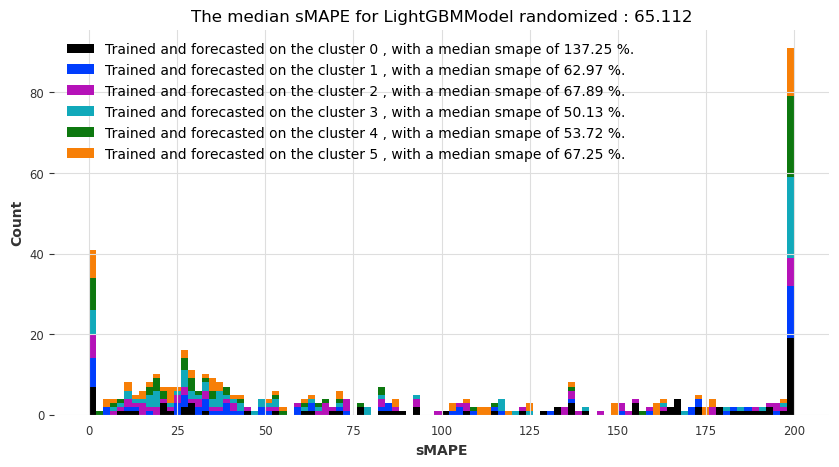

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 22:57:57,226] A new study created in memory with name: no-name-c241e2be-6be4-484f-8c59-edd7b55966d4
[I 2023-01-27 22:58:01,628] Trial 0 finished with value: 73.47562288510801 and parameters: {'out_len': 8}. Best is trial 0 with value: 73.47562288510801.
[I 2023-01-27 22:58:05,453] Trial 1 finished with value: 95.64196895793833 and parameters: {'out_len': 12}. Best is trial 0 with value: 73.47562288510801.
[I 2023-01-27 22:58:09,486] Trial 2 finished with value: 126.95500075277845 and parameters: {'out_len': 11}. Best is trial 0 with value: 73.47562288510801.
[I 2023-01-27 22:58:13,703] Trial 3 finished with value: 68.93140823976832 and parameters: {'out_len': 10}. Best is trial 3 with value: 68.93140823976832.
[I 2023-01-27 22:58:16,884] Trial 4 finished with value: 70.70391582696732 and parameters: {'out_len': 1}. Best is trial 3 with value: 68.93140823976832.
[I 2023-01-27 22:58:20,927] Trial 5 finished with value: 126.95500075277845 and parameters: {'out_len': 11}. Bes

[I 2023-01-27 23:01:11,357] Trial 1 finished with value: 98.38352769944657 and parameters: {'out_len': 4}. Best is trial 1 with value: 98.38352769944657.
[I 2023-01-27 23:01:11,655] Trial 2 finished with value: 86.99987808292047 and parameters: {'out_len': 10}. Best is trial 2 with value: 86.99987808292047.
[I 2023-01-27 23:01:11,938] Trial 3 finished with value: 200.0 and parameters: {'out_len': 2}. Best is trial 2 with value: 86.99987808292047.
[I 2023-01-27 23:01:12,221] Trial 4 finished with value: 200.0 and parameters: {'out_len': 2}. Best is trial 2 with value: 86.99987808292047.
[I 2023-01-27 23:01:12,487] Trial 5 finished with value: 99.36745023721726 and parameters: {'out_len': 3}. Best is trial 2 with value: 86.99987808292047.
[I 2023-01-27 23:01:12,770] Trial 6 finished with value: 200.0 and parameters: {'out_len': 2}. Best is trial 2 with value: 86.99987808292047.
[I 2023-01-27 23:01:13,083] Trial 7 finished with value: 60.95127146504348 and parameters: {'out_len': 12}. Bes

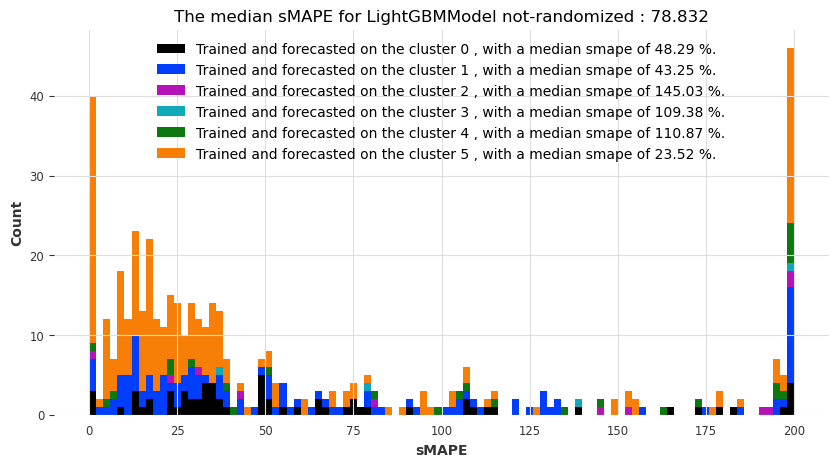

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 23:05:24,320] A new study created in memory with name: no-name-7a99cd36-e8fe-4004-a465-bfd8378f51d0
[I 2023-01-27 23:05:31,614] Trial 0 finished with value: 50.42267367666582 and parameters: {'out_len': 5, 'n_estimators': 72, 'max_depth': 26}. Best is trial 0 with value: 50.42267367666582.
[I 2023-01-27 23:05:37,511] Trial 1 finished with value: 54.974043784261674 and parameters: {'out_len': 8, 'n_estimators': 64, 'max_depth': 22}. Best is trial 0 with value: 50.42267367666582.
[I 2023-01-27 23:05:42,386] Trial 2 finished with value: 57.38073678321052 and parameters: {'out_len': 12, 'n_estimators': 73, 'max_depth': 24}. Best is trial 0 with value: 50.42267367666582.
[I 2023-01-27 23:05:47,308] Trial 3 finished with value: 69.22503256613638 and parameters: {'out_len': 12, 'n_estimators': 92, 'max_depth': 9}. Best is trial 0 with value: 50.42267367666582.
[I 2023-01-27 23:05:51,999] Trial 4 finished with value: 55.832086338883066 and parameters: {'out_len': 12, 'n_estimator

[I 2023-01-27 23:10:02,008] Trial 9 finished with value: 48.20372884632351 and parameters: {'out_len': 9, 'n_estimators': 63, 'max_depth': 29}. Best is trial 6 with value: 46.28887713081332.
[I 2023-01-27 23:10:07,748] Trial 10 finished with value: 44.0086007650116 and parameters: {'out_len': 5, 'n_estimators': 52, 'max_depth': 21}. Best is trial 10 with value: 44.0086007650116.
[I 2023-01-27 23:10:13,513] Trial 11 finished with value: 44.4135206344512 and parameters: {'out_len': 5, 'n_estimators': 52, 'max_depth': 21}. Best is trial 10 with value: 44.0086007650116.
[I 2023-01-27 23:10:19,096] Trial 12 finished with value: 43.63379944921161 and parameters: {'out_len': 5, 'n_estimators': 50, 'max_depth': 21}. Best is trial 12 with value: 43.63379944921161.
[I 2023-01-27 23:10:24,539] Trial 13 finished with value: 54.924546853409595 and parameters: {'out_len': 7, 'n_estimators': 52, 'max_depth': 19}. Best is trial 12 with value: 43.63379944921161.
[I 2023-01-27 23:10:30,206] Trial 14 fin

[I 2023-01-27 23:14:03,202] Trial 3 finished with value: 64.59212567506435 and parameters: {'out_len': 3, 'n_estimators': 84, 'max_depth': 27}. Best is trial 2 with value: 58.667482850437594.
[I 2023-01-27 23:14:08,799] Trial 4 finished with value: 80.3683894410357 and parameters: {'out_len': 12, 'n_estimators': 81, 'max_depth': 21}. Best is trial 2 with value: 58.667482850437594.
[I 2023-01-27 23:14:13,670] Trial 5 finished with value: 77.04251160915254 and parameters: {'out_len': 12, 'n_estimators': 96, 'max_depth': 23}. Best is trial 2 with value: 58.667482850437594.
[I 2023-01-27 23:14:17,946] Trial 6 finished with value: 71.40095376988053 and parameters: {'out_len': 12, 'n_estimators': 90, 'max_depth': 6}. Best is trial 2 with value: 58.667482850437594.
[I 2023-01-27 23:14:24,928] Trial 7 finished with value: 69.94837963845634 and parameters: {'out_len': 2, 'n_estimators': 84, 'max_depth': 9}. Best is trial 2 with value: 58.667482850437594.
[I 2023-01-27 23:14:30,767] Trial 8 fini

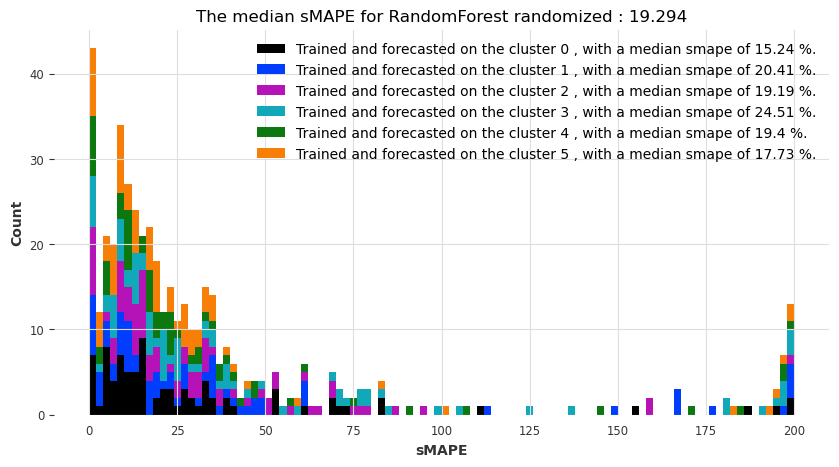

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 23:15:21,252] A new study created in memory with name: no-name-5036e927-41a3-4503-8d57-e97d14f332b8
[I 2023-01-27 23:15:26,095] Trial 0 finished with value: 70.0305904796391 and parameters: {'out_len': 6, 'n_estimators': 59, 'max_depth': 23}. Best is trial 0 with value: 70.0305904796391.
[I 2023-01-27 23:15:30,305] Trial 1 finished with value: 63.771199745454965 and parameters: {'out_len': 8, 'n_estimators': 57, 'max_depth': 17}. Best is trial 1 with value: 63.771199745454965.
[I 2023-01-27 23:15:37,683] Trial 2 finished with value: 65.94524664263994 and parameters: {'out_len': 2, 'n_estimators': 83, 'max_depth': 13}. Best is trial 1 with value: 63.771199745454965.
[I 2023-01-27 23:15:42,150] Trial 3 finished with value: 69.19800473875775 and parameters: {'out_len': 10, 'n_estimators': 86, 'max_depth': 27}. Best is trial 1 with value: 63.771199745454965.
[I 2023-01-27 23:15:48,165] Trial 4 finished with value: 64.98462920535381 and parameters: {'out_len': 6, 'n_estimators

[I 2023-01-27 23:19:39,539] Trial 9 finished with value: 99.14620397051617 and parameters: {'out_len': 10, 'n_estimators': 80, 'max_depth': 29}. Best is trial 1 with value: 93.76134270562083.
[I 2023-01-27 23:19:40,372] Trial 10 finished with value: 94.93143951400442 and parameters: {'out_len': 1, 'n_estimators': 100, 'max_depth': 15}. Best is trial 1 with value: 93.76134270562083.
[I 2023-01-27 23:19:41,032] Trial 11 finished with value: 76.79477912994571 and parameters: {'out_len': 4, 'n_estimators': 70, 'max_depth': 26}. Best is trial 11 with value: 76.79477912994571.
[I 2023-01-27 23:19:41,613] Trial 12 finished with value: 77.2124897451905 and parameters: {'out_len': 4, 'n_estimators': 50, 'max_depth': 30}. Best is trial 11 with value: 76.79477912994571.
[I 2023-01-27 23:19:42,193] Trial 13 finished with value: 93.82780509625474 and parameters: {'out_len': 4, 'n_estimators': 51, 'max_depth': 30}. Best is trial 11 with value: 76.79477912994571.
[I 2023-01-27 23:19:42,774] Trial 14 

[I 2023-01-27 23:21:44,185] Trial 3 finished with value: 40.42400020180354 and parameters: {'out_len': 3, 'n_estimators': 63, 'max_depth': 6}. Best is trial 1 with value: 35.27373588112457.
[I 2023-01-27 23:22:06,096] Trial 4 finished with value: 35.59809662229397 and parameters: {'out_len': 7, 'n_estimators': 81, 'max_depth': 12}. Best is trial 1 with value: 35.27373588112457.
[I 2023-01-27 23:22:40,020] Trial 5 finished with value: 28.635563499703782 and parameters: {'out_len': 2, 'n_estimators': 86, 'max_depth': 29}. Best is trial 5 with value: 28.635563499703782.
[I 2023-01-27 23:23:03,383] Trial 6 finished with value: 30.966253968571845 and parameters: {'out_len': 7, 'n_estimators': 69, 'max_depth': 26}. Best is trial 5 with value: 28.635563499703782.
[I 2023-01-27 23:23:36,014] Trial 7 finished with value: 34.588617537619044 and parameters: {'out_len': 4, 'n_estimators': 95, 'max_depth': 22}. Best is trial 5 with value: 28.635563499703782.
[I 2023-01-27 23:23:55,692] Trial 8 fini

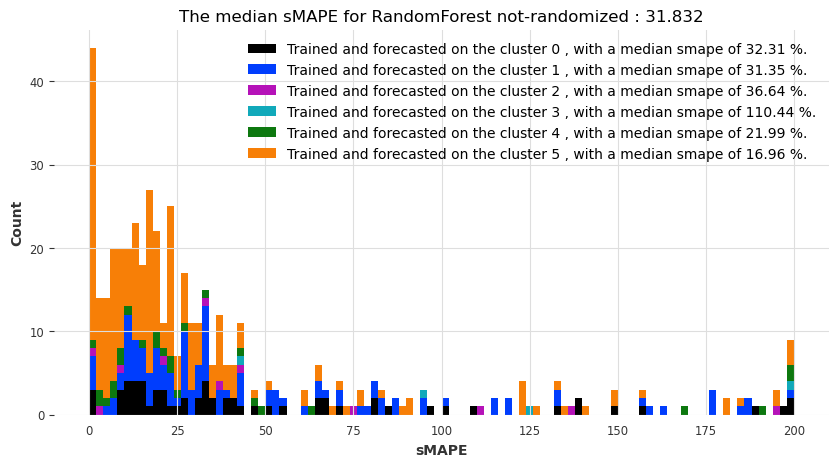

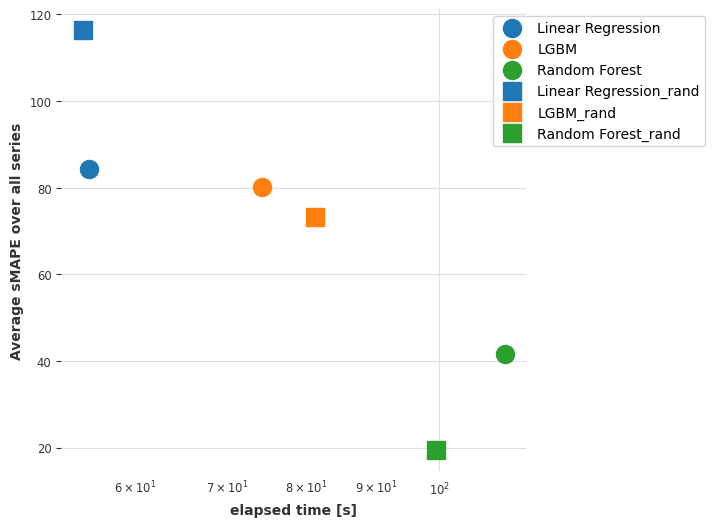

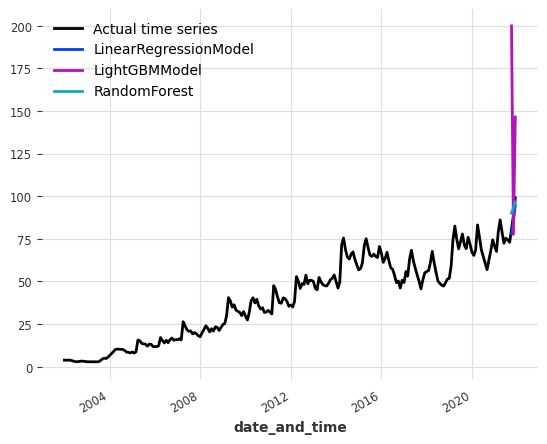

The results for index_colab_increm with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 23:26:33,188] A new study created in memory with name: no-name-d70b7362-2080-4fab-a73a-6bb91a4fe282
[I 2023-01-27 23:26:36,613] Trial 0 finished with value: 113.65446967779712 and parameters: {'out_len': 8}. Best is trial 0 with value: 113.65446967779712.
[I 2023-01-27 23:26:40,201] Trial 1 finished with value: 101.03254889655737 and parameters: {'out_len': 7}. Best is trial 1 with value: 101.03254889655737.
[I 2023-01-27 23:26:43,544] Trial 2 finished with value: 113.65446967779712 and parameters: {'out_len': 8}. Best is trial 1 with value: 101.03254889655737.
[I 2023-01-27 23:26:48,025] Trial 3 finished with value: 105.62185673614789 and parameters: {'out_len': 4}. Best is trial 1 with value: 101.03254889655737.
[I 2023-01-27 23:26:51,480] Trial 4 finished with value: 195.11586878342365 and parameters: {'out_len': 12}. Best is trial 1 with value: 101.03254889655737.
[I 2023-01-27 23:26:54,791] Trial 5 finished with value: 101.65224440966723 and parameters: {'out_len': 2

[I 2023-01-27 23:29:27,410] Trial 1 finished with value: 102.63598717164354 and parameters: {'out_len': 3}. Best is trial 1 with value: 102.63598717164354.
[I 2023-01-27 23:29:30,849] Trial 2 finished with value: 142.75881290522926 and parameters: {'out_len': 12}. Best is trial 1 with value: 102.63598717164354.
[I 2023-01-27 23:29:34,154] Trial 3 finished with value: 106.66152257295352 and parameters: {'out_len': 5}. Best is trial 1 with value: 102.63598717164354.
[I 2023-01-27 23:29:37,476] Trial 4 finished with value: 100.21834744824154 and parameters: {'out_len': 1}. Best is trial 4 with value: 100.21834744824154.
[I 2023-01-27 23:29:40,855] Trial 5 finished with value: 102.18684910852734 and parameters: {'out_len': 7}. Best is trial 4 with value: 100.21834744824154.
[I 2023-01-27 23:29:44,235] Trial 6 finished with value: 102.18684910852734 and parameters: {'out_len': 7}. Best is trial 4 with value: 100.21834744824154.
[I 2023-01-27 23:29:48,674] Trial 7 finished with value: 142.75

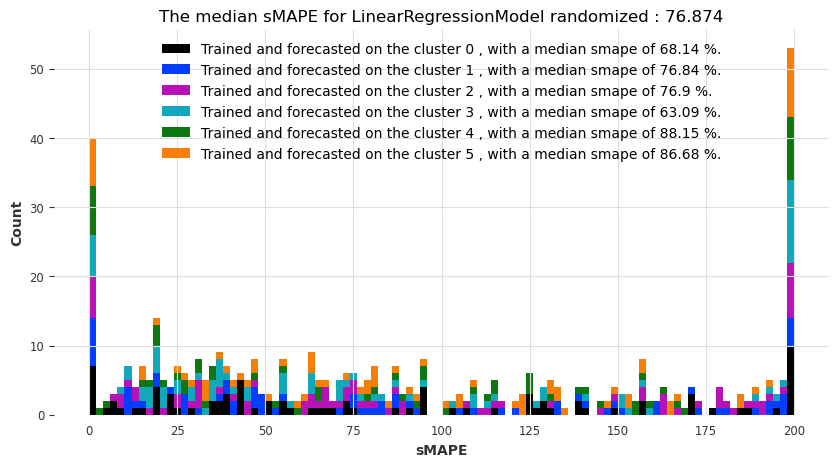

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 23:32:00,724] A new study created in memory with name: no-name-9fb4fed0-f636-41ee-9ca3-e77dff031a4b
[I 2023-01-27 23:32:03,243] Trial 0 finished with value: 112.35933274212013 and parameters: {'out_len': 3}. Best is trial 0 with value: 112.35933274212013.
[I 2023-01-27 23:32:05,804] Trial 1 finished with value: 109.98249167921033 and parameters: {'out_len': 2}. Best is trial 1 with value: 109.98249167921033.
[I 2023-01-27 23:32:08,494] Trial 2 finished with value: 139.5513062720126 and parameters: {'out_len': 10}. Best is trial 1 with value: 109.98249167921033.
[I 2023-01-27 23:32:11,102] Trial 3 finished with value: 139.06337290179988 and parameters: {'out_len': 9}. Best is trial 1 with value: 109.98249167921033.
[I 2023-01-27 23:32:13,795] Trial 4 finished with value: 133.83973405597231 and parameters: {'out_len': 12}. Best is trial 1 with value: 109.98249167921033.
[I 2023-01-27 23:32:17,350] Trial 5 finished with value: 109.98249167921033 and parameters: {'out_len': 2

[I 2023-01-27 23:34:14,476] Trial 1 finished with value: 67.3636015632025 and parameters: {'out_len': 4}. Best is trial 1 with value: 67.3636015632025.
[I 2023-01-27 23:34:14,664] Trial 2 finished with value: 74.07563063812228 and parameters: {'out_len': 12}. Best is trial 1 with value: 67.3636015632025.
[I 2023-01-27 23:34:14,868] Trial 3 finished with value: 74.07563063812228 and parameters: {'out_len': 12}. Best is trial 1 with value: 67.3636015632025.
[I 2023-01-27 23:34:15,104] Trial 4 finished with value: 45.96446520837818 and parameters: {'out_len': 7}. Best is trial 4 with value: 45.96446520837818.
[I 2023-01-27 23:34:15,307] Trial 5 finished with value: 66.90037247671314 and parameters: {'out_len': 3}. Best is trial 4 with value: 45.96446520837818.
[I 2023-01-27 23:34:15,535] Trial 6 finished with value: 74.07563063812228 and parameters: {'out_len': 12}. Best is trial 4 with value: 45.96446520837818.
[I 2023-01-27 23:34:15,716] Trial 7 finished with value: 55.43027696510749 an

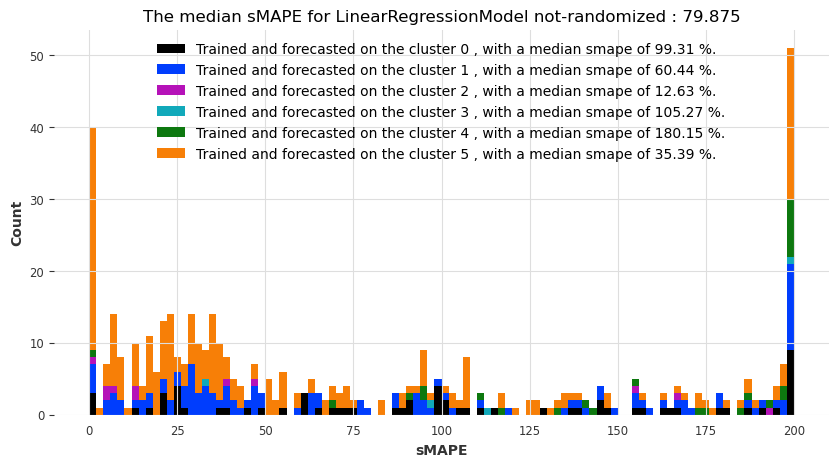

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 23:37:29,224] A new study created in memory with name: no-name-201a165b-94fc-408d-a1b6-8936947d681d
[I 2023-01-27 23:37:33,039] Trial 0 finished with value: 80.83804599316396 and parameters: {'out_len': 1}. Best is trial 0 with value: 80.83804599316396.
[I 2023-01-27 23:37:38,196] Trial 1 finished with value: 162.2544155784612 and parameters: {'out_len': 11}. Best is trial 0 with value: 80.83804599316396.
[I 2023-01-27 23:37:44,036] Trial 2 finished with value: 110.24613623960782 and parameters: {'out_len': 6}. Best is trial 0 with value: 80.83804599316396.
[I 2023-01-27 23:37:48,615] Trial 3 finished with value: 89.77758317192492 and parameters: {'out_len': 2}. Best is trial 0 with value: 80.83804599316396.
[I 2023-01-27 23:37:54,306] Trial 4 finished with value: 150.00410967018846 and parameters: {'out_len': 9}. Best is trial 0 with value: 80.83804599316396.
[I 2023-01-27 23:37:59,950] Trial 5 finished with value: 150.00410967018846 and parameters: {'out_len': 9}. Best 

[I 2023-01-27 23:41:43,783] Trial 1 finished with value: 89.19426829270067 and parameters: {'out_len': 5}. Best is trial 1 with value: 89.19426829270067.
[I 2023-01-27 23:41:49,822] Trial 2 finished with value: 103.21468524100464 and parameters: {'out_len': 8}. Best is trial 1 with value: 89.19426829270067.
[I 2023-01-27 23:41:55,728] Trial 3 finished with value: 103.21468524100464 and parameters: {'out_len': 8}. Best is trial 1 with value: 89.19426829270067.
[I 2023-01-27 23:42:01,298] Trial 4 finished with value: 100.56168995377271 and parameters: {'out_len': 10}. Best is trial 1 with value: 89.19426829270067.
[I 2023-01-27 23:42:07,175] Trial 5 finished with value: 103.21468524100464 and parameters: {'out_len': 8}. Best is trial 1 with value: 89.19426829270067.
[I 2023-01-27 23:42:11,161] Trial 6 finished with value: 87.10696658447473 and parameters: {'out_len': 1}. Best is trial 6 with value: 87.10696658447473.
[I 2023-01-27 23:42:17,825] Trial 7 finished with value: 101.8805188692

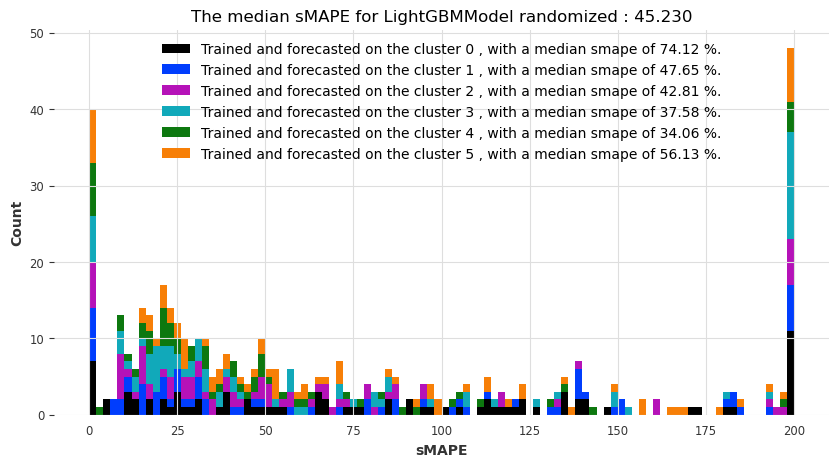

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 23:45:21,970] A new study created in memory with name: no-name-9e51c027-3bb3-4597-a10c-2b279a141f0a
[I 2023-01-27 23:45:26,277] Trial 0 finished with value: 93.85451719654444 and parameters: {'out_len': 6}. Best is trial 0 with value: 93.85451719654444.
[I 2023-01-27 23:45:30,687] Trial 1 finished with value: 85.64853681182265 and parameters: {'out_len': 8}. Best is trial 1 with value: 85.64853681182265.
[I 2023-01-27 23:45:34,854] Trial 2 finished with value: 88.15401388791312 and parameters: {'out_len': 4}. Best is trial 1 with value: 85.64853681182265.
[I 2023-01-27 23:45:40,280] Trial 3 finished with value: 93.85451719654444 and parameters: {'out_len': 6}. Best is trial 1 with value: 85.64853681182265.
[I 2023-01-27 23:45:44,462] Trial 4 finished with value: 98.12984607681041 and parameters: {'out_len': 10}. Best is trial 1 with value: 85.64853681182265.
[I 2023-01-27 23:45:48,866] Trial 5 finished with value: 93.85451719654444 and parameters: {'out_len': 6}. Best is 

[I 2023-01-27 23:48:38,242] Trial 1 finished with value: 73.9538000150474 and parameters: {'out_len': 7}. Best is trial 0 with value: 47.70130052893372.
[I 2023-01-27 23:48:38,556] Trial 2 finished with value: 54.64477699601395 and parameters: {'out_len': 10}. Best is trial 0 with value: 47.70130052893372.
[I 2023-01-27 23:48:38,885] Trial 3 finished with value: 41.60481669316155 and parameters: {'out_len': 12}. Best is trial 3 with value: 41.60481669316155.
[I 2023-01-27 23:48:39,186] Trial 4 finished with value: 73.9538000150474 and parameters: {'out_len': 7}. Best is trial 3 with value: 41.60481669316155.
[I 2023-01-27 23:48:39,465] Trial 5 finished with value: 76.57953015593516 and parameters: {'out_len': 4}. Best is trial 3 with value: 41.60481669316155.
[I 2023-01-27 23:48:39,787] Trial 6 finished with value: 41.60481669316155 and parameters: {'out_len': 12}. Best is trial 3 with value: 41.60481669316155.
[I 2023-01-27 23:48:40,077] Trial 7 finished with value: 67.58978176754358 

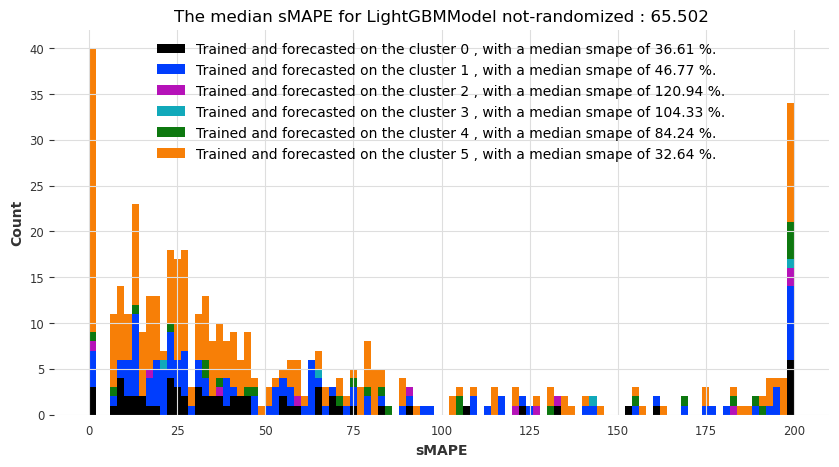

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-27 23:52:47,280] A new study created in memory with name: no-name-5d55d2b1-a4f7-45ce-a22d-ac4fc16ab2e2
[I 2023-01-27 23:52:52,956] Trial 0 finished with value: 73.32781716758817 and parameters: {'out_len': 8, 'n_estimators': 81, 'max_depth': 8}. Best is trial 0 with value: 73.32781716758817.
[I 2023-01-27 23:52:57,361] Trial 1 finished with value: 67.14142078435447 and parameters: {'out_len': 11, 'n_estimators': 56, 'max_depth': 8}. Best is trial 1 with value: 67.14142078435447.
[I 2023-01-27 23:53:06,290] Trial 2 finished with value: 50.40059678586721 and parameters: {'out_len': 3, 'n_estimators': 88, 'max_depth': 29}. Best is trial 2 with value: 50.40059678586721.
[I 2023-01-27 23:53:12,567] Trial 3 finished with value: 58.592377537853686 and parameters: {'out_len': 5, 'n_estimators': 63, 'max_depth': 11}. Best is trial 2 with value: 50.40059678586721.
[I 2023-01-27 23:53:18,616] Trial 4 finished with value: 61.30504201587174 and parameters: {'out_len': 10, 'n_estimators':

[I 2023-01-27 23:57:24,246] Trial 9 finished with value: 57.85807840799628 and parameters: {'out_len': 6, 'n_estimators': 90, 'max_depth': 12}. Best is trial 4 with value: 44.76226877302951.
[I 2023-01-27 23:57:31,540] Trial 10 finished with value: 42.70523163207023 and parameters: {'out_len': 1, 'n_estimators': 68, 'max_depth': 29}. Best is trial 10 with value: 42.70523163207023.
[I 2023-01-27 23:57:38,734] Trial 11 finished with value: 37.74745604659116 and parameters: {'out_len': 1, 'n_estimators': 67, 'max_depth': 30}. Best is trial 11 with value: 37.74745604659116.
[I 2023-01-27 23:57:45,924] Trial 12 finished with value: 40.0497251949509 and parameters: {'out_len': 1, 'n_estimators': 67, 'max_depth': 29}. Best is trial 11 with value: 37.74745604659116.
[I 2023-01-27 23:57:52,719] Trial 13 finished with value: 49.064986699413886 and parameters: {'out_len': 3, 'n_estimators': 66, 'max_depth': 30}. Best is trial 11 with value: 37.74745604659116.
[I 2023-01-27 23:57:59,060] Trial 14 

[I 2023-01-28 00:01:37,697] Trial 3 finished with value: 89.85001950785662 and parameters: {'out_len': 10, 'n_estimators': 78, 'max_depth': 18}. Best is trial 2 with value: 84.03736920754864.
[I 2023-01-28 00:01:41,827] Trial 4 finished with value: 96.9477715218699 and parameters: {'out_len': 12, 'n_estimators': 55, 'max_depth': 16}. Best is trial 2 with value: 84.03736920754864.
[I 2023-01-28 00:01:49,205] Trial 5 finished with value: 83.34072275818937 and parameters: {'out_len': 5, 'n_estimators': 68, 'max_depth': 27}. Best is trial 5 with value: 83.34072275818937.
[I 2023-01-28 00:01:57,611] Trial 6 finished with value: 91.3054294888685 and parameters: {'out_len': 2, 'n_estimators': 91, 'max_depth': 21}. Best is trial 5 with value: 83.34072275818937.
[I 2023-01-28 00:02:03,350] Trial 7 finished with value: 79.97558990666505 and parameters: {'out_len': 2, 'n_estimators': 92, 'max_depth': 5}. Best is trial 7 with value: 79.97558990666505.
[I 2023-01-28 00:02:08,937] Trial 8 finished w

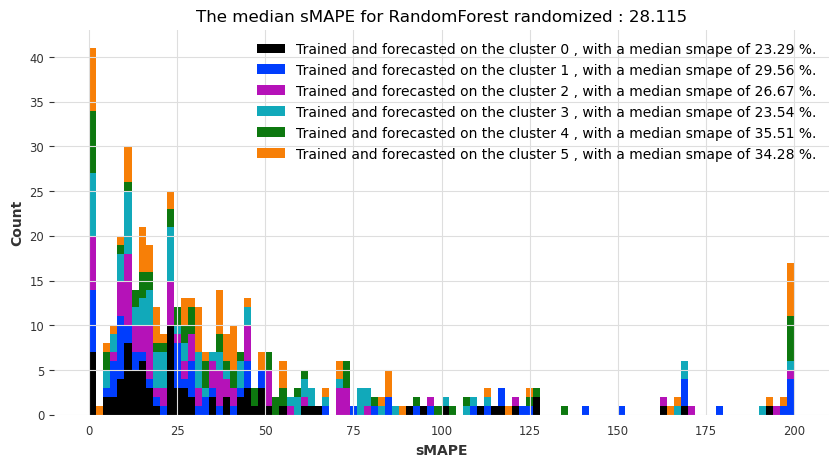

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 00:02:56,744] A new study created in memory with name: no-name-1d5647c8-7ce1-41d6-9d19-e3bb1329478b
[I 2023-01-28 00:03:03,252] Trial 0 finished with value: 77.47641560497362 and parameters: {'out_len': 5, 'n_estimators': 99, 'max_depth': 21}. Best is trial 0 with value: 77.47641560497362.
[I 2023-01-28 00:03:07,064] Trial 1 finished with value: 93.49654326964901 and parameters: {'out_len': 12, 'n_estimators': 89, 'max_depth': 28}. Best is trial 0 with value: 77.47641560497362.
[I 2023-01-28 00:03:13,835] Trial 2 finished with value: 85.6733130880253 and parameters: {'out_len': 2, 'n_estimators': 67, 'max_depth': 29}. Best is trial 0 with value: 77.47641560497362.
[I 2023-01-28 00:03:18,177] Trial 3 finished with value: 88.74423823724078 and parameters: {'out_len': 7, 'n_estimators': 79, 'max_depth': 7}. Best is trial 0 with value: 77.47641560497362.
[I 2023-01-28 00:03:24,288] Trial 4 finished with value: 84.94098423996522 and parameters: {'out_len': 1, 'n_estimators': 8

[I 2023-01-28 00:07:07,996] Trial 9 finished with value: 40.02568077038678 and parameters: {'out_len': 3, 'n_estimators': 64, 'max_depth': 14}. Best is trial 5 with value: 31.956464524962588.
[I 2023-01-28 00:07:08,765] Trial 10 finished with value: 44.51540670359427 and parameters: {'out_len': 1, 'n_estimators': 84, 'max_depth': 21}. Best is trial 5 with value: 31.956464524962588.
[I 2023-01-28 00:07:09,519] Trial 11 finished with value: 44.97564397018198 and parameters: {'out_len': 1, 'n_estimators': 79, 'max_depth': 12}. Best is trial 5 with value: 31.956464524962588.
[I 2023-01-28 00:07:10,289] Trial 12 finished with value: 51.95324183831875 and parameters: {'out_len': 3, 'n_estimators': 99, 'max_depth': 19}. Best is trial 5 with value: 31.956464524962588.
[I 2023-01-28 00:07:10,964] Trial 13 finished with value: 52.819715328485415 and parameters: {'out_len': 3, 'n_estimators': 73, 'max_depth': 30}. Best is trial 5 with value: 31.956464524962588.
[I 2023-01-28 00:07:11,719] Trial 1

[I 2023-01-28 00:09:29,037] Trial 3 finished with value: 40.353677389011544 and parameters: {'out_len': 4, 'n_estimators': 64, 'max_depth': 18}. Best is trial 3 with value: 40.353677389011544.
[I 2023-01-28 00:09:44,147] Trial 4 finished with value: 50.3476539731276 and parameters: {'out_len': 12, 'n_estimators': 56, 'max_depth': 21}. Best is trial 3 with value: 40.353677389011544.
[I 2023-01-28 00:10:09,821] Trial 5 finished with value: 43.81329421663605 and parameters: {'out_len': 6, 'n_estimators': 82, 'max_depth': 29}. Best is trial 3 with value: 40.353677389011544.
[I 2023-01-28 00:10:34,759] Trial 6 finished with value: 43.85083389725348 and parameters: {'out_len': 8, 'n_estimators': 93, 'max_depth': 25}. Best is trial 3 with value: 40.353677389011544.
[I 2023-01-28 00:10:53,216] Trial 7 finished with value: 44.477249549522746 and parameters: {'out_len': 10, 'n_estimators': 71, 'max_depth': 26}. Best is trial 3 with value: 40.353677389011544.
[I 2023-01-28 00:11:20,764] Trial 8 f

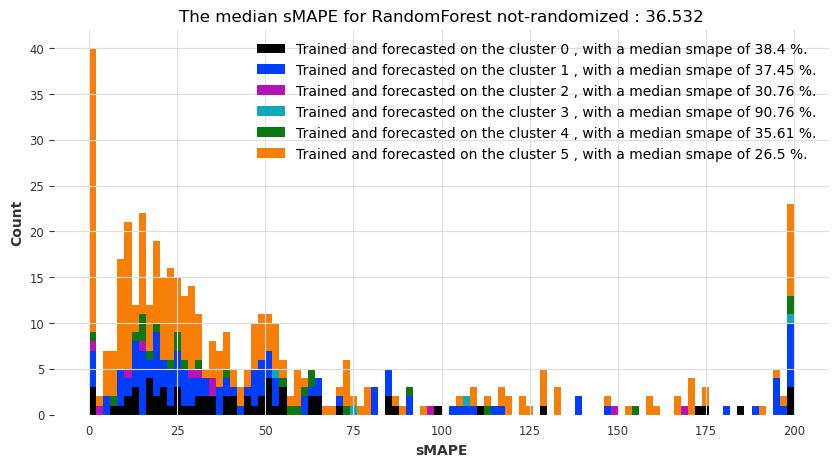

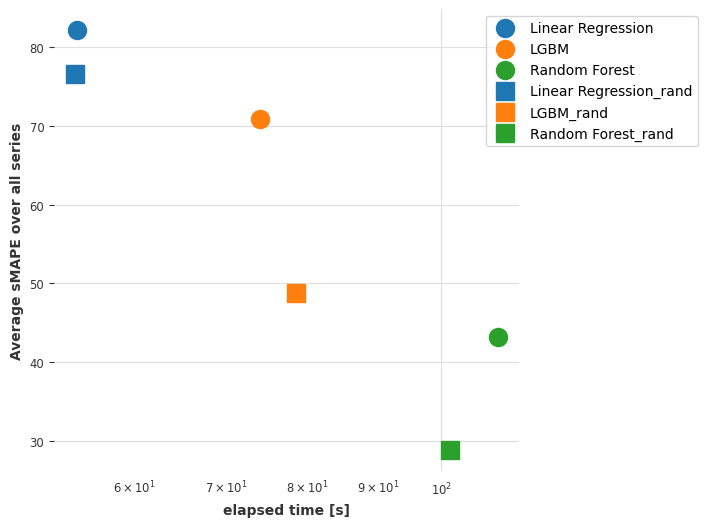

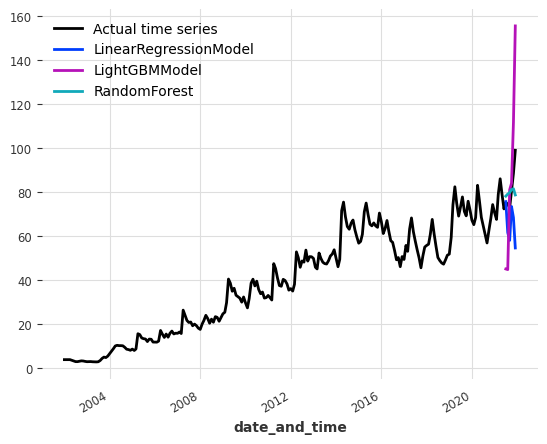

The results for index_colab_increm with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 00:13:57,551] A new study created in memory with name: no-name-fe45dad1-3b6c-4031-9358-8e859d7fcd92
[I 2023-01-28 00:14:00,806] Trial 0 finished with value: 115.08495089402615 and parameters: {'out_len': 5}. Best is trial 0 with value: 115.08495089402615.
[I 2023-01-28 00:14:04,017] Trial 1 finished with value: 123.62397013457569 and parameters: {'out_len': 3}. Best is trial 0 with value: 115.08495089402615.
[I 2023-01-28 00:14:07,347] Trial 2 finished with value: 133.22423835441128 and parameters: {'out_len': 10}. Best is trial 0 with value: 115.08495089402615.
[I 2023-01-28 00:14:10,745] Trial 3 finished with value: 199.99998733936218 and parameters: {'out_len': 12}. Best is trial 0 with value: 115.08495089402615.
[I 2023-01-28 00:14:13,940] Trial 4 finished with value: 121.47243011268809 and parameters: {'out_len': 1}. Best is trial 0 with value: 115.08495089402615.
[I 2023-01-28 00:14:18,265] Trial 5 finished with value: 103.65527697085784 and parameters: {'out_len': 

[I 2023-01-28 00:16:45,649] Trial 1 finished with value: 106.24132350923742 and parameters: {'out_len': 2}. Best is trial 1 with value: 106.24132350923742.
[I 2023-01-28 00:16:49,077] Trial 2 finished with value: 120.7808442880784 and parameters: {'out_len': 10}. Best is trial 1 with value: 106.24132350923742.
[I 2023-01-28 00:16:52,360] Trial 3 finished with value: 113.10975054328317 and parameters: {'out_len': 5}. Best is trial 1 with value: 106.24132350923742.
[I 2023-01-28 00:16:55,747] Trial 4 finished with value: 157.95860193477952 and parameters: {'out_len': 12}. Best is trial 1 with value: 106.24132350923742.
[I 2023-01-28 00:16:59,000] Trial 5 finished with value: 106.24132350923742 and parameters: {'out_len': 2}. Best is trial 1 with value: 106.24132350923742.
[I 2023-01-28 00:17:02,407] Trial 6 finished with value: 118.59113354883809 and parameters: {'out_len': 7}. Best is trial 1 with value: 106.24132350923742.
[I 2023-01-28 00:17:06,735] Trial 7 finished with value: 134.91

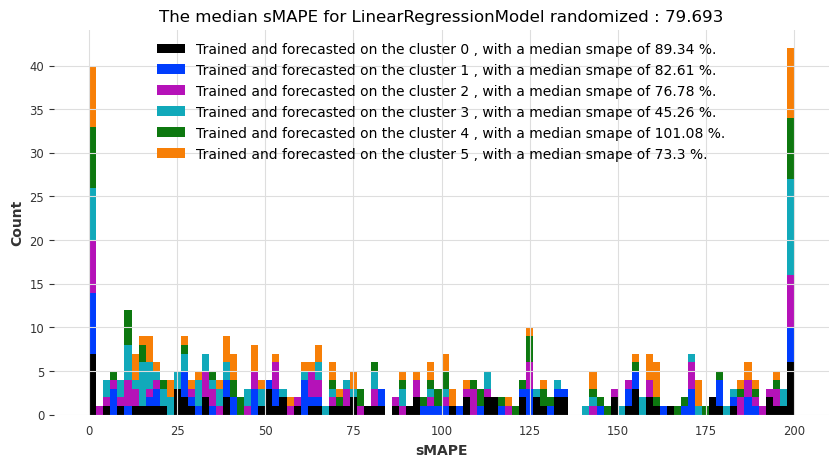

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 00:19:14,739] A new study created in memory with name: no-name-502e17df-4afd-4e4b-84ec-b3545ae3bd49
[I 2023-01-28 00:19:17,190] Trial 0 finished with value: 123.3487504731061 and parameters: {'out_len': 5}. Best is trial 0 with value: 123.3487504731061.
[I 2023-01-28 00:19:19,774] Trial 1 finished with value: 157.2754935887835 and parameters: {'out_len': 11}. Best is trial 0 with value: 123.3487504731061.
[I 2023-01-28 00:19:22,350] Trial 2 finished with value: 116.34762714068653 and parameters: {'out_len': 7}. Best is trial 2 with value: 116.34762714068653.
[I 2023-01-28 00:19:24,851] Trial 3 finished with value: 120.34009333952093 and parameters: {'out_len': 3}. Best is trial 2 with value: 116.34762714068653.
[I 2023-01-28 00:19:27,380] Trial 4 finished with value: 111.68378866812972 and parameters: {'out_len': 6}. Best is trial 4 with value: 111.68378866812972.
[I 2023-01-28 00:19:30,872] Trial 5 finished with value: 106.54007103391197 and parameters: {'out_len': 2}. B

[I 2023-01-28 00:21:24,382] Trial 1 finished with value: 76.18085937603938 and parameters: {'out_len': 7}. Best is trial 1 with value: 76.18085937603938.
[I 2023-01-28 00:21:24,571] Trial 2 finished with value: 79.29341219062066 and parameters: {'out_len': 10}. Best is trial 1 with value: 76.18085937603938.
[I 2023-01-28 00:21:24,759] Trial 3 finished with value: 65.01384111321975 and parameters: {'out_len': 6}. Best is trial 3 with value: 65.01384111321975.
[I 2023-01-28 00:21:24,979] Trial 4 finished with value: 30.443137348586774 and parameters: {'out_len': 1}. Best is trial 4 with value: 30.443137348586774.
[I 2023-01-28 00:21:25,199] Trial 5 finished with value: 105.59287195311394 and parameters: {'out_len': 3}. Best is trial 4 with value: 30.443137348586774.
[I 2023-01-28 00:21:25,434] Trial 6 finished with value: 79.29341219062066 and parameters: {'out_len': 10}. Best is trial 4 with value: 30.443137348586774.
[I 2023-01-28 00:21:25,669] Trial 7 finished with value: 81.133545679

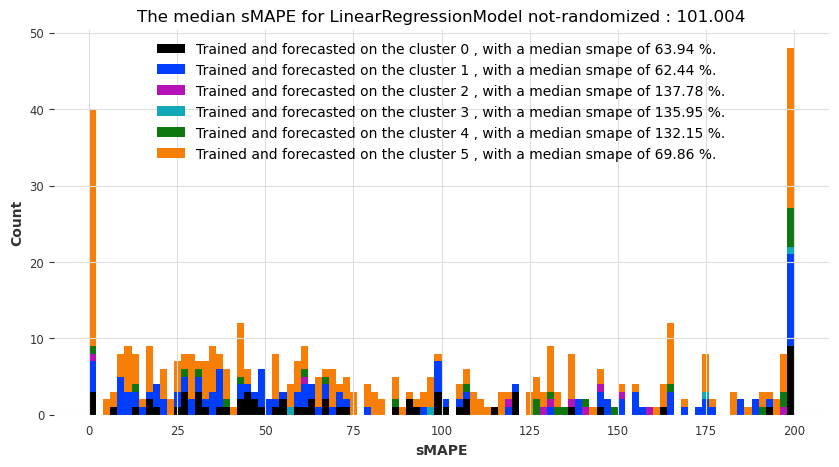

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 00:24:31,593] A new study created in memory with name: no-name-aea67710-c7eb-4f65-8aa5-5dd3f68e7e83
[I 2023-01-28 00:24:35,306] Trial 0 finished with value: 97.85301106681253 and parameters: {'out_len': 1}. Best is trial 0 with value: 97.85301106681253.
[I 2023-01-28 00:24:42,331] Trial 1 finished with value: 124.91740680651186 and parameters: {'out_len': 6}. Best is trial 0 with value: 97.85301106681253.
[I 2023-01-28 00:24:48,274] Trial 2 finished with value: 119.31374147421272 and parameters: {'out_len': 7}. Best is trial 0 with value: 97.85301106681253.
[I 2023-01-28 00:24:53,683] Trial 3 finished with value: 108.4305771953085 and parameters: {'out_len': 4}. Best is trial 0 with value: 97.85301106681253.
[I 2023-01-28 00:24:59,186] Trial 4 finished with value: 156.81608859662214 and parameters: {'out_len': 9}. Best is trial 0 with value: 97.85301106681253.
[I 2023-01-28 00:25:03,670] Trial 5 finished with value: 111.41106499925954 and parameters: {'out_len': 2}. Best 

[I 2023-01-28 00:28:40,385] Trial 1 finished with value: 98.72548889397537 and parameters: {'out_len': 7}. Best is trial 1 with value: 98.72548889397537.
[I 2023-01-28 00:28:45,457] Trial 2 finished with value: 99.75017915274225 and parameters: {'out_len': 3}. Best is trial 1 with value: 98.72548889397537.
[I 2023-01-28 00:28:51,116] Trial 3 finished with value: 98.21235787873294 and parameters: {'out_len': 5}. Best is trial 3 with value: 98.21235787873294.
[I 2023-01-28 00:28:55,584] Trial 4 finished with value: 103.3963192603781 and parameters: {'out_len': 2}. Best is trial 3 with value: 98.21235787873294.
[I 2023-01-28 00:29:02,312] Trial 5 finished with value: 105.03179398398174 and parameters: {'out_len': 9}. Best is trial 3 with value: 98.21235787873294.
[I 2023-01-28 00:29:08,287] Trial 6 finished with value: 102.32057430567662 and parameters: {'out_len': 6}. Best is trial 3 with value: 98.21235787873294.
[I 2023-01-28 00:29:14,143] Trial 7 finished with value: 104.2334350623744

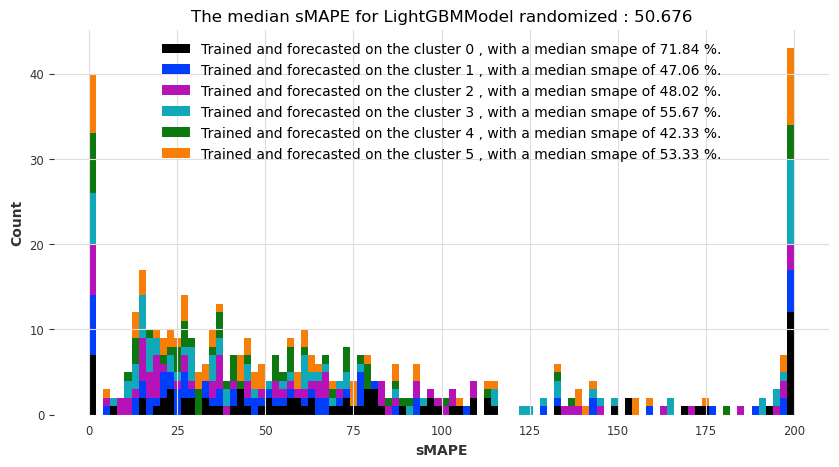

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 00:32:25,206] A new study created in memory with name: no-name-b5c822c3-c186-4003-acf2-bf233faa3b13
[I 2023-01-28 00:32:29,437] Trial 0 finished with value: 89.60846411678762 and parameters: {'out_len': 7}. Best is trial 0 with value: 89.60846411678762.
[I 2023-01-28 00:32:34,299] Trial 1 finished with value: 155.6323891028048 and parameters: {'out_len': 11}. Best is trial 0 with value: 89.60846411678762.
[I 2023-01-28 00:32:38,579] Trial 2 finished with value: 101.36904128864488 and parameters: {'out_len': 10}. Best is trial 0 with value: 89.60846411678762.
[I 2023-01-28 00:32:41,672] Trial 3 finished with value: 93.42120251877765 and parameters: {'out_len': 1}. Best is trial 0 with value: 89.60846411678762.
[I 2023-01-28 00:32:45,446] Trial 4 finished with value: 127.07755613282417 and parameters: {'out_len': 12}. Best is trial 0 with value: 89.60846411678762.
[I 2023-01-28 00:32:49,151] Trial 5 finished with value: 127.07755613282417 and parameters: {'out_len': 12}. Be

[I 2023-01-28 00:35:44,517] Trial 1 finished with value: 29.647986765033508 and parameters: {'out_len': 12}. Best is trial 0 with value: 26.792656719193932.
[I 2023-01-28 00:35:44,768] Trial 2 finished with value: 25.163697864789615 and parameters: {'out_len': 2}. Best is trial 2 with value: 25.163697864789615.
[I 2023-01-28 00:35:45,082] Trial 3 finished with value: 29.647986765033508 and parameters: {'out_len': 12}. Best is trial 2 with value: 25.163697864789615.
[I 2023-01-28 00:35:45,395] Trial 4 finished with value: 26.792656719193932 and parameters: {'out_len': 10}. Best is trial 2 with value: 25.163697864789615.
[I 2023-01-28 00:35:45,678] Trial 5 finished with value: 30.09430020856838 and parameters: {'out_len': 6}. Best is trial 2 with value: 25.163697864789615.
[I 2023-01-28 00:35:45,992] Trial 6 finished with value: 26.629263320094157 and parameters: {'out_len': 11}. Best is trial 2 with value: 25.163697864789615.
[I 2023-01-28 00:35:46,274] Trial 7 finished with value: 25.1

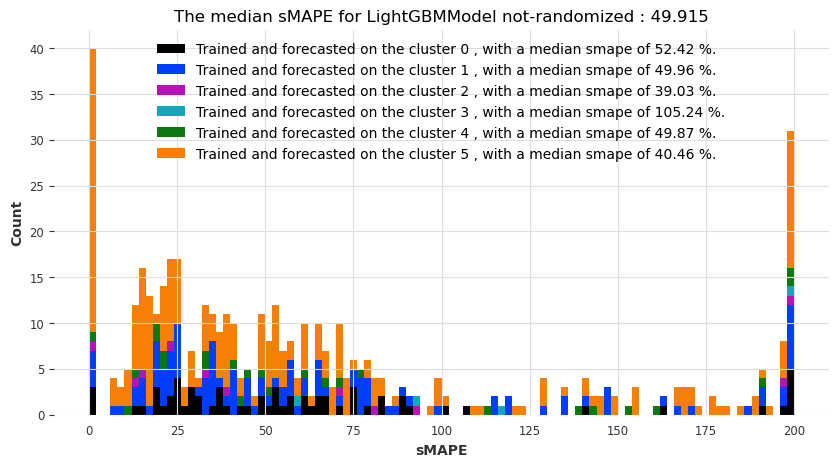

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 00:39:53,409] A new study created in memory with name: no-name-05334343-4b7a-4c3e-85cb-9f429c9c91c6
[I 2023-01-28 00:39:58,164] Trial 0 finished with value: 64.24718278881889 and parameters: {'out_len': 11, 'n_estimators': 58, 'max_depth': 14}. Best is trial 0 with value: 64.24718278881889.
[I 2023-01-28 00:40:04,768] Trial 1 finished with value: 73.36307919697225 and parameters: {'out_len': 3, 'n_estimators': 73, 'max_depth': 6}. Best is trial 0 with value: 64.24718278881889.
[I 2023-01-28 00:40:10,113] Trial 2 finished with value: 70.5432981640794 and parameters: {'out_len': 9, 'n_estimators': 59, 'max_depth': 26}. Best is trial 0 with value: 64.24718278881889.
[I 2023-01-28 00:40:14,707] Trial 3 finished with value: 67.11673384645331 and parameters: {'out_len': 11, 'n_estimators': 52, 'max_depth': 24}. Best is trial 0 with value: 64.24718278881889.
[I 2023-01-28 00:40:21,509] Trial 4 finished with value: 53.36140837472524 and parameters: {'out_len': 1, 'n_estimators': 

[I 2023-01-28 00:44:14,865] Trial 9 finished with value: 58.88254820807109 and parameters: {'out_len': 11, 'n_estimators': 88, 'max_depth': 21}. Best is trial 1 with value: 49.315941874660105.
[I 2023-01-28 00:44:22,765] Trial 10 finished with value: 37.47592359982744 and parameters: {'out_len': 1, 'n_estimators': 62, 'max_depth': 30}. Best is trial 10 with value: 37.47592359982744.
[I 2023-01-28 00:44:29,593] Trial 11 finished with value: 40.74519470300772 and parameters: {'out_len': 1, 'n_estimators': 61, 'max_depth': 30}. Best is trial 10 with value: 37.47592359982744.
[I 2023-01-28 00:44:36,542] Trial 12 finished with value: 40.023798263682366 and parameters: {'out_len': 1, 'n_estimators': 62, 'max_depth': 27}. Best is trial 10 with value: 37.47592359982744.
[I 2023-01-28 00:44:43,617] Trial 13 finished with value: 40.16928158086631 and parameters: {'out_len': 1, 'n_estimators': 62, 'max_depth': 26}. Best is trial 10 with value: 37.47592359982744.
[I 2023-01-28 00:44:50,225] Trial 

[I 2023-01-28 00:48:22,263] Trial 3 finished with value: 111.33539805678924 and parameters: {'out_len': 2, 'n_estimators': 71, 'max_depth': 28}. Best is trial 2 with value: 104.87161834707344.
[I 2023-01-28 00:48:28,774] Trial 4 finished with value: 114.66105093901719 and parameters: {'out_len': 1, 'n_estimators': 61, 'max_depth': 14}. Best is trial 2 with value: 104.87161834707344.
[I 2023-01-28 00:48:35,237] Trial 5 finished with value: 108.08167244351574 and parameters: {'out_len': 7, 'n_estimators': 94, 'max_depth': 11}. Best is trial 2 with value: 104.87161834707344.
[I 2023-01-28 00:48:40,944] Trial 6 finished with value: 110.17207327933129 and parameters: {'out_len': 6, 'n_estimators': 61, 'max_depth': 14}. Best is trial 2 with value: 104.87161834707344.
[I 2023-01-28 00:48:47,140] Trial 7 finished with value: 105.74807881058123 and parameters: {'out_len': 10, 'n_estimators': 91, 'max_depth': 9}. Best is trial 2 with value: 104.87161834707344.
[I 2023-01-28 00:48:51,340] Trial 8

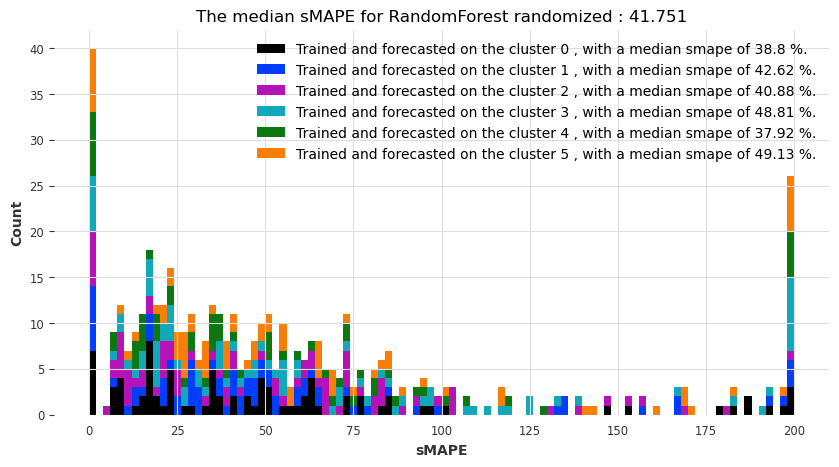

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 00:49:34,101] A new study created in memory with name: no-name-61e77ba9-9364-4c00-9ebb-2f8e2ff98d61
[I 2023-01-28 00:49:38,300] Trial 0 finished with value: 87.36166810883795 and parameters: {'out_len': 11, 'n_estimators': 99, 'max_depth': 20}. Best is trial 0 with value: 87.36166810883795.
[I 2023-01-28 00:49:44,116] Trial 1 finished with value: 94.87009479480687 and parameters: {'out_len': 2, 'n_estimators': 94, 'max_depth': 9}. Best is trial 0 with value: 87.36166810883795.
[I 2023-01-28 00:49:48,334] Trial 2 finished with value: 83.09377599370583 and parameters: {'out_len': 7, 'n_estimators': 56, 'max_depth': 30}. Best is trial 2 with value: 83.09377599370583.
[I 2023-01-28 00:49:51,962] Trial 3 finished with value: 94.22054973056521 and parameters: {'out_len': 12, 'n_estimators': 83, 'max_depth': 23}. Best is trial 2 with value: 83.09377599370583.
[I 2023-01-28 00:49:57,625] Trial 4 finished with value: 87.30311627470206 and parameters: {'out_len': 5, 'n_estimators':

[I 2023-01-28 00:53:25,677] Trial 9 finished with value: 40.16247955141366 and parameters: {'out_len': 2, 'n_estimators': 66, 'max_depth': 12}. Best is trial 9 with value: 40.16247955141366.
[I 2023-01-28 00:53:26,195] Trial 10 finished with value: 68.00694218080493 and parameters: {'out_len': 8, 'n_estimators': 52, 'max_depth': 12}. Best is trial 9 with value: 40.16247955141366.
[I 2023-01-28 00:53:26,840] Trial 11 finished with value: 68.03618036015881 and parameters: {'out_len': 8, 'n_estimators': 88, 'max_depth': 15}. Best is trial 9 with value: 40.16247955141366.
[I 2023-01-28 00:53:27,335] Trial 12 finished with value: 57.145746293234275 and parameters: {'out_len': 12, 'n_estimators': 56, 'max_depth': 15}. Best is trial 9 with value: 40.16247955141366.
[I 2023-01-28 00:53:27,924] Trial 13 finished with value: 51.72768250419424 and parameters: {'out_len': 9, 'n_estimators': 86, 'max_depth': 5}. Best is trial 9 with value: 40.16247955141366.
[I 2023-01-28 00:53:28,523] Trial 14 fin

[I 2023-01-28 00:55:24,181] Trial 3 finished with value: 68.65767280496624 and parameters: {'out_len': 6, 'n_estimators': 68, 'max_depth': 7}. Best is trial 2 with value: 68.25601697284068.
[I 2023-01-28 00:55:42,289] Trial 4 finished with value: 68.77923432067297 and parameters: {'out_len': 11, 'n_estimators': 82, 'max_depth': 20}. Best is trial 2 with value: 68.25601697284068.
[I 2023-01-28 00:56:04,331] Trial 5 finished with value: 68.75831358326224 and parameters: {'out_len': 6, 'n_estimators': 67, 'max_depth': 29}. Best is trial 2 with value: 68.25601697284068.
[I 2023-01-28 00:56:23,606] Trial 6 finished with value: 74.85027860189646 and parameters: {'out_len': 5, 'n_estimators': 63, 'max_depth': 11}. Best is trial 2 with value: 68.25601697284068.
[I 2023-01-28 00:56:42,795] Trial 7 finished with value: 70.88554185993665 and parameters: {'out_len': 4, 'n_estimators': 83, 'max_depth': 6}. Best is trial 2 with value: 68.25601697284068.
[I 2023-01-28 00:57:05,172] Trial 8 finished w

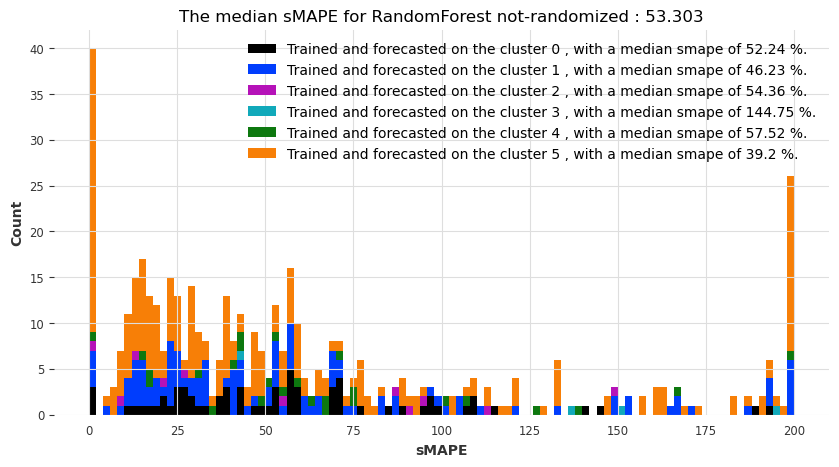

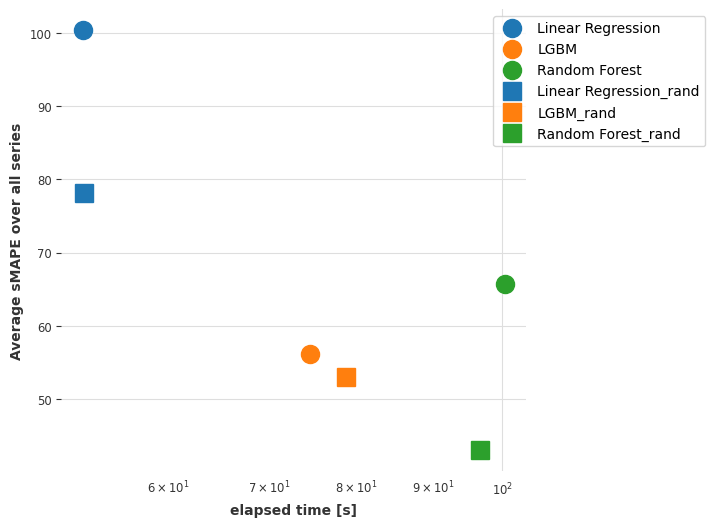

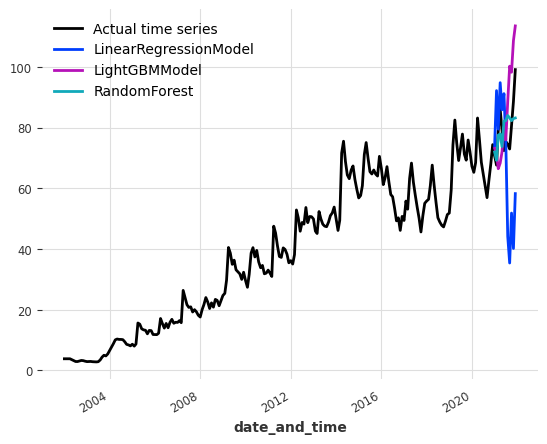

The results for index_colab_notincrem are:
The results for index_colab_notincrem with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 00:59:38,803] A new study created in memory with name: no-name-42bd63f5-6f3c-4455-a5b6-92068485948a
[I 2023-01-28 00:59:41,850] Trial 0 finished with value: 123.9837566485593 and parameters: {'out_len': 8}. Best is trial 0 with value: 123.9837566485593.
[I 2023-01-28 00:59:44,987] Trial 1 finished with value: 123.9837566485593 and parameters: {'out_len': 8}. Best is trial 0 with value: 123.9837566485593.
[I 2023-01-28 00:59:48,109] Trial 2 finished with value: 146.97614002871572 and parameters: {'out_len': 12}. Best is trial 0 with value: 123.9837566485593.
[I 2023-01-28 00:59:51,140] Trial 3 finished with value: 84.90358329396528 and parameters: {'out_len': 4}. Best is trial 3 with value: 84.90358329396528.
[I 2023-01-28 00:59:54,171] Trial 4 finished with value: 102.74720621493611 and parameters: {'out_len': 7}. Best is trial 3 with value: 84.90358329396528.
[I 2023-01-28 00:59:58,224] Trial 5 finished with value: 93.73444946021225 and parameters: {'out_len': 6}. Best i

[I 2023-01-28 01:02:23,646] Trial 1 finished with value: 79.15379420642013 and parameters: {'out_len': 4}. Best is trial 1 with value: 79.15379420642013.
[I 2023-01-28 01:02:27,573] Trial 2 finished with value: 84.82848830843956 and parameters: {'out_len': 10}. Best is trial 1 with value: 79.15379420642013.
[I 2023-01-28 01:02:31,442] Trial 3 finished with value: 79.15379420642013 and parameters: {'out_len': 4}. Best is trial 1 with value: 79.15379420642013.
[I 2023-01-28 01:02:35,313] Trial 4 finished with value: 85.13613327966452 and parameters: {'out_len': 5}. Best is trial 1 with value: 79.15379420642013.
[I 2023-01-28 01:02:40,438] Trial 5 finished with value: 74.32064646692194 and parameters: {'out_len': 7}. Best is trial 5 with value: 74.32064646692194.
[I 2023-01-28 01:02:44,318] Trial 6 finished with value: 81.32208829799076 and parameters: {'out_len': 6}. Best is trial 5 with value: 74.32064646692194.
[I 2023-01-28 01:02:48,362] Trial 7 finished with value: 84.82848830843956 

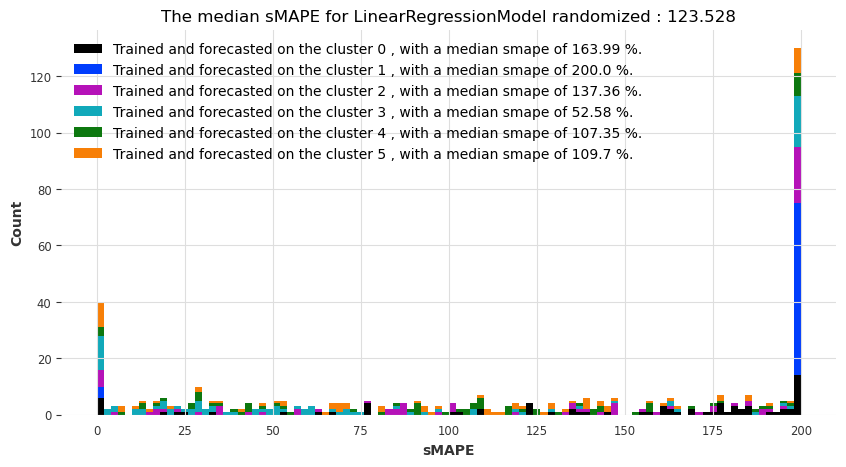

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 01:05:14,008] A new study created in memory with name: no-name-ef8950ff-c2e3-4818-b7e7-d87464cd7838
[I 2023-01-28 01:05:17,196] Trial 0 finished with value: 120.40716206998319 and parameters: {'out_len': 8}. Best is trial 0 with value: 120.40716206998319.
[I 2023-01-28 01:05:19,522] Trial 1 finished with value: 199.99904378446254 and parameters: {'out_len': 12}. Best is trial 0 with value: 120.40716206998319.
[I 2023-01-28 01:05:21,774] Trial 2 finished with value: 199.99918806543303 and parameters: {'out_len': 10}. Best is trial 0 with value: 120.40716206998319.
[I 2023-01-28 01:05:24,004] Trial 3 finished with value: 116.74255737500252 and parameters: {'out_len': 5}. Best is trial 3 with value: 116.74255737500252.
[I 2023-01-28 01:05:26,256] Trial 4 finished with value: 107.36852939932642 and parameters: {'out_len': 6}. Best is trial 4 with value: 107.36852939932642.
[I 2023-01-28 01:05:28,517] Trial 5 finished with value: 199.9997234033457 and parameters: {'out_len': 1

[I 2023-01-28 01:07:19,607] Trial 1 finished with value: 139.4331846850916 and parameters: {'out_len': 12}. Best is trial 1 with value: 139.4331846850916.
[I 2023-01-28 01:07:19,848] Trial 2 finished with value: 123.6163471246495 and parameters: {'out_len': 6}. Best is trial 2 with value: 123.6163471246495.
[I 2023-01-28 01:07:20,108] Trial 3 finished with value: 120.74418152536684 and parameters: {'out_len': 4}. Best is trial 3 with value: 120.74418152536684.
[I 2023-01-28 01:07:20,374] Trial 4 finished with value: 123.6163471246495 and parameters: {'out_len': 6}. Best is trial 3 with value: 120.74418152536684.
[I 2023-01-28 01:07:20,671] Trial 5 finished with value: 121.57369551445818 and parameters: {'out_len': 5}. Best is trial 3 with value: 120.74418152536684.
[I 2023-01-28 01:07:20,923] Trial 6 finished with value: 135.4569054295753 and parameters: {'out_len': 7}. Best is trial 3 with value: 120.74418152536684.
[I 2023-01-28 01:07:21,189] Trial 7 finished with value: 139.43318468

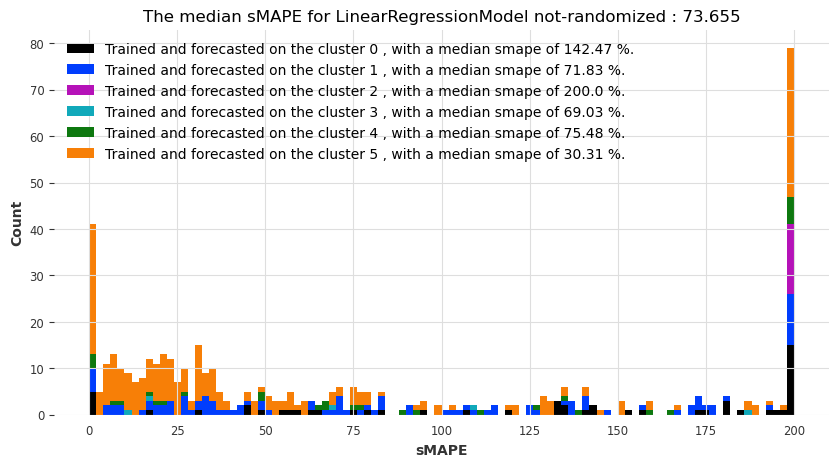

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 01:10:49,176] A new study created in memory with name: no-name-4fd1f303-fc73-48f2-8dbd-29ebcd34331c
[I 2023-01-28 01:10:53,625] Trial 0 finished with value: 91.87576437858971 and parameters: {'out_len': 12}. Best is trial 0 with value: 91.87576437858971.
[I 2023-01-28 01:10:58,721] Trial 1 finished with value: 59.297162211099106 and parameters: {'out_len': 7}. Best is trial 1 with value: 59.297162211099106.
[I 2023-01-28 01:11:03,126] Trial 2 finished with value: 91.87576437858971 and parameters: {'out_len': 12}. Best is trial 1 with value: 59.297162211099106.
[I 2023-01-28 01:11:07,632] Trial 3 finished with value: 116.87489631240811 and parameters: {'out_len': 11}. Best is trial 1 with value: 59.297162211099106.
[I 2023-01-28 01:11:12,395] Trial 4 finished with value: 145.22213223264367 and parameters: {'out_len': 10}. Best is trial 1 with value: 59.297162211099106.
[I 2023-01-28 01:11:17,246] Trial 5 finished with value: 145.22213223264367 and parameters: {'out_len': 1

[I 2023-01-28 01:14:48,809] Trial 1 finished with value: 98.37696572400196 and parameters: {'out_len': 9}. Best is trial 1 with value: 98.37696572400196.
[I 2023-01-28 01:14:53,734] Trial 2 finished with value: 63.74976265770157 and parameters: {'out_len': 2}. Best is trial 2 with value: 63.74976265770157.
[I 2023-01-28 01:15:01,378] Trial 3 finished with value: 72.24951137261019 and parameters: {'out_len': 5}. Best is trial 2 with value: 63.74976265770157.
[I 2023-01-28 01:15:06,379] Trial 4 finished with value: 63.74976265770157 and parameters: {'out_len': 2}. Best is trial 2 with value: 63.74976265770157.
[I 2023-01-28 01:15:13,153] Trial 5 finished with value: 81.57275550722119 and parameters: {'out_len': 7}. Best is trial 2 with value: 63.74976265770157.
[I 2023-01-28 01:15:19,677] Trial 6 finished with value: 98.37696572400196 and parameters: {'out_len': 9}. Best is trial 2 with value: 63.74976265770157.
[I 2023-01-28 01:15:25,823] Trial 7 finished with value: 66.763514782094 and

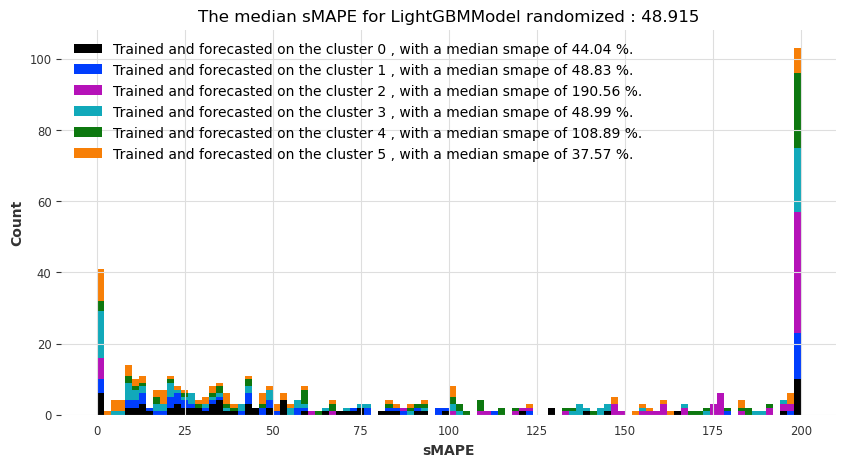

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 01:18:46,064] A new study created in memory with name: no-name-39623a62-2ee0-4579-841a-6b38e9429f7e
[I 2023-01-28 01:18:49,237] Trial 0 finished with value: 135.0471930404404 and parameters: {'out_len': 11}. Best is trial 0 with value: 135.0471930404404.
[I 2023-01-28 01:18:52,472] Trial 1 finished with value: 156.262095751322 and parameters: {'out_len': 12}. Best is trial 0 with value: 135.0471930404404.
[I 2023-01-28 01:18:56,065] Trial 2 finished with value: 106.99738156365129 and parameters: {'out_len': 6}. Best is trial 2 with value: 106.99738156365129.
[I 2023-01-28 01:18:59,408] Trial 3 finished with value: 103.31326627160419 and parameters: {'out_len': 4}. Best is trial 3 with value: 103.31326627160419.
[I 2023-01-28 01:19:03,947] Trial 4 finished with value: 113.54437213429581 and parameters: {'out_len': 8}. Best is trial 3 with value: 103.31326627160419.
[I 2023-01-28 01:19:07,134] Trial 5 finished with value: 99.04560867599203 and parameters: {'out_len': 3}. Be

[I 2023-01-28 01:21:43,846] Trial 1 finished with value: 192.82088351707134 and parameters: {'out_len': 3}. Best is trial 1 with value: 192.82088351707134.
[I 2023-01-28 01:21:44,144] Trial 2 finished with value: 190.9988436736824 and parameters: {'out_len': 1}. Best is trial 2 with value: 190.9988436736824.
[I 2023-01-28 01:21:44,521] Trial 3 finished with value: 197.89953126819736 and parameters: {'out_len': 6}. Best is trial 2 with value: 190.9988436736824.
[I 2023-01-28 01:21:44,898] Trial 4 finished with value: 197.89953126819736 and parameters: {'out_len': 6}. Best is trial 2 with value: 190.9988436736824.
[I 2023-01-28 01:21:45,259] Trial 5 finished with value: 193.3869704707131 and parameters: {'out_len': 4}. Best is trial 2 with value: 190.9988436736824.
[I 2023-01-28 01:21:45,628] Trial 6 finished with value: 194.05501512716123 and parameters: {'out_len': 8}. Best is trial 2 with value: 190.9988436736824.
[I 2023-01-28 01:21:45,957] Trial 7 finished with value: 194.1459358839

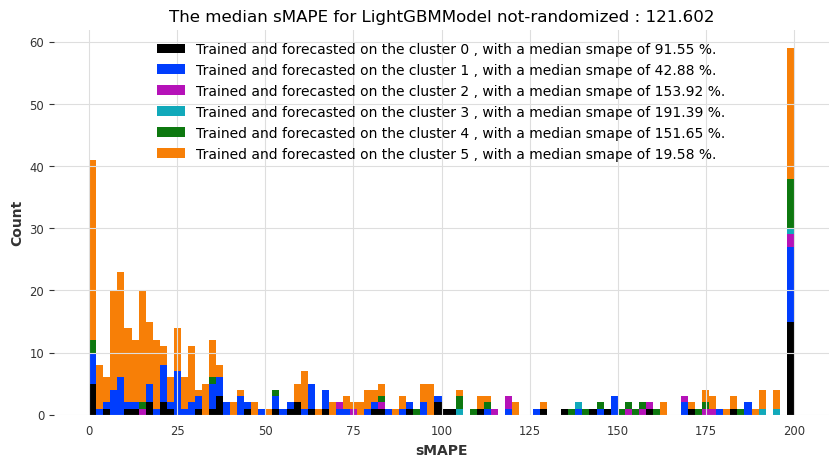

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 01:26:15,991] A new study created in memory with name: no-name-3d7e59b4-60d9-42ab-a9d1-067bbde27733
[I 2023-01-28 01:26:22,499] Trial 0 finished with value: 30.838943637096598 and parameters: {'out_len': 1, 'n_estimators': 66, 'max_depth': 8}. Best is trial 0 with value: 30.838943637096598.
[I 2023-01-28 01:26:27,203] Trial 1 finished with value: 53.218283391781725 and parameters: {'out_len': 9, 'n_estimators': 67, 'max_depth': 17}. Best is trial 0 with value: 30.838943637096598.
[I 2023-01-28 01:26:34,040] Trial 2 finished with value: 37.25679018398319 and parameters: {'out_len': 1, 'n_estimators': 86, 'max_depth': 10}. Best is trial 0 with value: 30.838943637096598.
[I 2023-01-28 01:26:40,632] Trial 3 finished with value: 43.908628017966905 and parameters: {'out_len': 6, 'n_estimators': 94, 'max_depth': 26}. Best is trial 0 with value: 30.838943637096598.
[I 2023-01-28 01:26:45,297] Trial 4 finished with value: 46.721156303965486 and parameters: {'out_len': 1, 'n_estima

[I 2023-01-28 01:30:18,277] Trial 9 finished with value: 53.899928563068514 and parameters: {'out_len': 1, 'n_estimators': 66, 'max_depth': 18}. Best is trial 4 with value: 45.19398788419944.
[I 2023-01-28 01:30:22,940] Trial 10 finished with value: 39.9102018823358 and parameters: {'out_len': 4, 'n_estimators': 51, 'max_depth': 6}. Best is trial 10 with value: 39.9102018823358.
[I 2023-01-28 01:30:27,316] Trial 11 finished with value: 52.91322866062706 and parameters: {'out_len': 4, 'n_estimators': 50, 'max_depth': 5}. Best is trial 10 with value: 39.9102018823358.
[I 2023-01-28 01:30:34,264] Trial 12 finished with value: 46.11269843182554 and parameters: {'out_len': 5, 'n_estimators': 100, 'max_depth': 9}. Best is trial 10 with value: 39.9102018823358.
[I 2023-01-28 01:30:40,050] Trial 13 finished with value: 47.06031325732407 and parameters: {'out_len': 5, 'n_estimators': 50, 'max_depth': 30}. Best is trial 10 with value: 39.9102018823358.
[I 2023-01-28 01:30:45,139] Trial 14 finish

[I 2023-01-28 01:35:17,101] Trial 3 finished with value: 51.02438139969123 and parameters: {'out_len': 8, 'n_estimators': 93, 'max_depth': 20}. Best is trial 2 with value: 45.46865953421419.
[I 2023-01-28 01:35:23,000] Trial 4 finished with value: 47.10640354786095 and parameters: {'out_len': 7, 'n_estimators': 67, 'max_depth': 28}. Best is trial 2 with value: 45.46865953421419.
[I 2023-01-28 01:35:29,044] Trial 5 finished with value: 43.33304535842041 and parameters: {'out_len': 4, 'n_estimators': 61, 'max_depth': 13}. Best is trial 5 with value: 43.33304535842041.
[I 2023-01-28 01:35:35,803] Trial 6 finished with value: 43.05747066390781 and parameters: {'out_len': 5, 'n_estimators': 74, 'max_depth': 25}. Best is trial 6 with value: 43.05747066390781.
[I 2023-01-28 01:35:44,112] Trial 7 finished with value: 35.715262385630474 and parameters: {'out_len': 1, 'n_estimators': 70, 'max_depth': 16}. Best is trial 7 with value: 35.715262385630474.
[I 2023-01-28 01:35:49,345] Trial 8 finishe

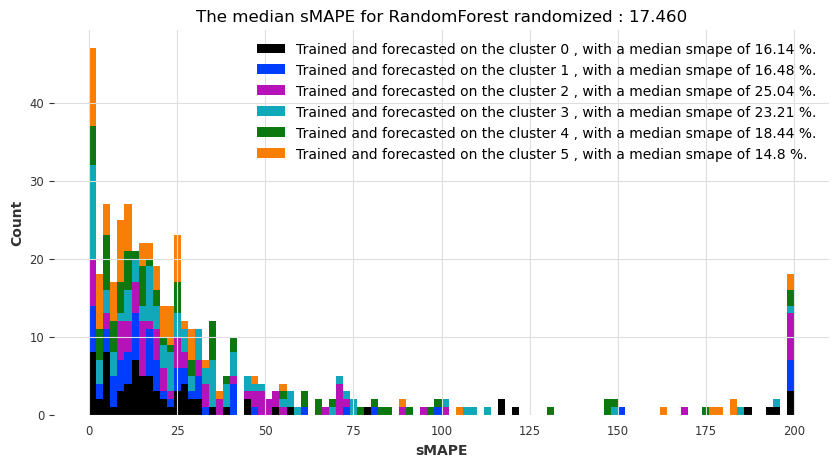

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 01:36:37,438] A new study created in memory with name: no-name-0a49be3b-6b55-4bed-8f66-4c8d966bb7fc
[I 2023-01-28 01:36:41,098] Trial 0 finished with value: 100.95814246583983 and parameters: {'out_len': 5, 'n_estimators': 52, 'max_depth': 27}. Best is trial 0 with value: 100.95814246583983.
[I 2023-01-28 01:36:44,968] Trial 1 finished with value: 99.72050000957965 and parameters: {'out_len': 4, 'n_estimators': 55, 'max_depth': 27}. Best is trial 1 with value: 99.72050000957965.
[I 2023-01-28 01:36:49,952] Trial 2 finished with value: 95.14349419010642 and parameters: {'out_len': 2, 'n_estimators': 95, 'max_depth': 9}. Best is trial 2 with value: 95.14349419010642.
[I 2023-01-28 01:36:53,000] Trial 3 finished with value: 109.10902181168223 and parameters: {'out_len': 10, 'n_estimators': 51, 'max_depth': 17}. Best is trial 2 with value: 95.14349419010642.
[I 2023-01-28 01:36:56,531] Trial 4 finished with value: 106.5822779942153 and parameters: {'out_len': 8, 'n_estimators

[I 2023-01-28 01:40:24,561] Trial 9 finished with value: 80.50193111064397 and parameters: {'out_len': 4, 'n_estimators': 52, 'max_depth': 19}. Best is trial 1 with value: 68.54282224791557.
[I 2023-01-28 01:40:25,426] Trial 10 finished with value: 72.36037737154463 and parameters: {'out_len': 12, 'n_estimators': 98, 'max_depth': 13}. Best is trial 1 with value: 68.54282224791557.
[I 2023-01-28 01:40:26,282] Trial 11 finished with value: 68.97169588411937 and parameters: {'out_len': 12, 'n_estimators': 97, 'max_depth': 12}. Best is trial 1 with value: 68.54282224791557.
[I 2023-01-28 01:40:27,145] Trial 12 finished with value: 66.63721285914248 and parameters: {'out_len': 12, 'n_estimators': 97, 'max_depth': 13}. Best is trial 12 with value: 66.63721285914248.
[I 2023-01-28 01:40:28,197] Trial 13 finished with value: 72.86662286043025 and parameters: {'out_len': 2, 'n_estimators': 63, 'max_depth': 13}. Best is trial 12 with value: 66.63721285914248.
[I 2023-01-28 01:40:29,280] Trial 14

[I 2023-01-28 01:43:01,769] Trial 3 finished with value: 35.02331737880705 and parameters: {'out_len': 3, 'n_estimators': 99, 'max_depth': 27}. Best is trial 2 with value: 33.85457467486228.
[I 2023-01-28 01:43:25,030] Trial 4 finished with value: 36.585098880671495 and parameters: {'out_len': 5, 'n_estimators': 54, 'max_depth': 17}. Best is trial 2 with value: 33.85457467486228.
[I 2023-01-28 01:43:45,801] Trial 5 finished with value: 39.81399882048542 and parameters: {'out_len': 11, 'n_estimators': 96, 'max_depth': 24}. Best is trial 2 with value: 33.85457467486228.
[I 2023-01-28 01:44:11,156] Trial 6 finished with value: 34.7673418390891 and parameters: {'out_len': 2, 'n_estimators': 84, 'max_depth': 8}. Best is trial 2 with value: 33.85457467486228.
[I 2023-01-28 01:44:29,925] Trial 7 finished with value: 41.9687035808142 and parameters: {'out_len': 11, 'n_estimators': 79, 'max_depth': 20}. Best is trial 2 with value: 33.85457467486228.
[I 2023-01-28 01:44:56,861] Trial 8 finished 

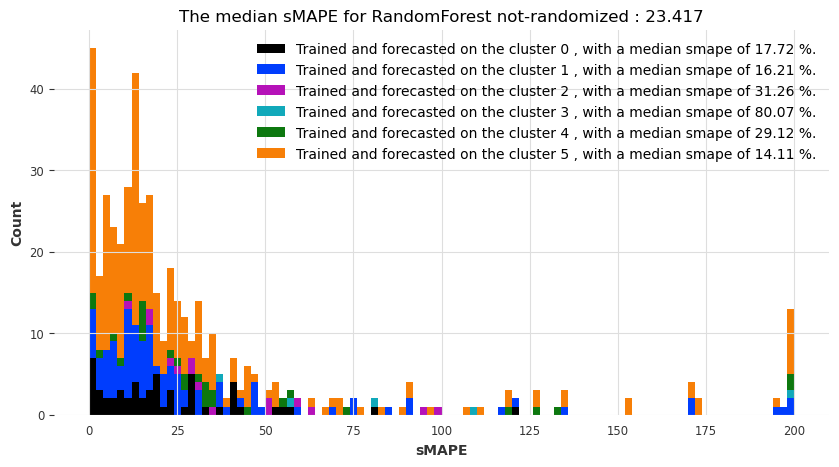

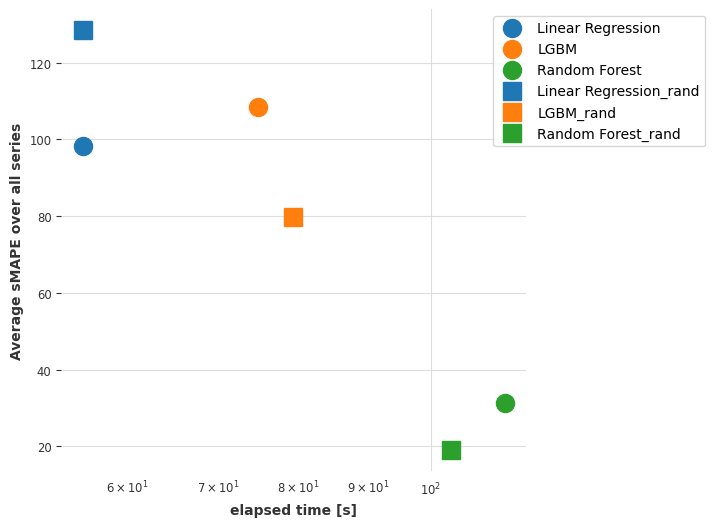

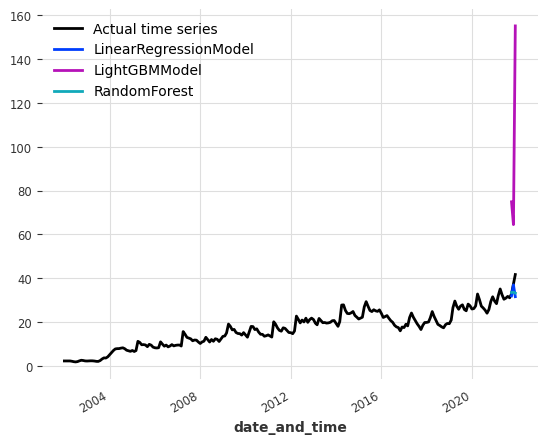

The results for index_colab_notincrem with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 01:47:59,141] A new study created in memory with name: no-name-fec5865d-b4ca-4e7d-aed1-47b43fe04ee4
[I 2023-01-28 01:48:02,127] Trial 0 finished with value: 182.53345368906622 and parameters: {'out_len': 11}. Best is trial 0 with value: 182.53345368906622.
[I 2023-01-28 01:48:05,129] Trial 1 finished with value: 142.56906544766724 and parameters: {'out_len': 8}. Best is trial 1 with value: 142.56906544766724.
[I 2023-01-28 01:48:08,194] Trial 2 finished with value: 152.49957942825483 and parameters: {'out_len': 10}. Best is trial 1 with value: 142.56906544766724.
[I 2023-01-28 01:48:11,146] Trial 3 finished with value: 89.40641841857612 and parameters: {'out_len': 3}. Best is trial 3 with value: 89.40641841857612.
[I 2023-01-28 01:48:15,099] Trial 4 finished with value: 92.08534147180987 and parameters: {'out_len': 4}. Best is trial 3 with value: 89.40641841857612.
[I 2023-01-28 01:48:18,066] Trial 5 finished with value: 92.08534147180987 and parameters: {'out_len': 4}. B

[I 2023-01-28 01:50:41,734] Trial 1 finished with value: 82.24398787106294 and parameters: {'out_len': 4}. Best is trial 0 with value: 80.6425192767975.
[I 2023-01-28 01:50:45,677] Trial 2 finished with value: 86.00681303816405 and parameters: {'out_len': 3}. Best is trial 0 with value: 80.6425192767975.
[I 2023-01-28 01:50:49,688] Trial 3 finished with value: 85.9887143685199 and parameters: {'out_len': 11}. Best is trial 0 with value: 80.6425192767975.
[I 2023-01-28 01:50:53,558] Trial 4 finished with value: 82.24398787106294 and parameters: {'out_len': 4}. Best is trial 0 with value: 80.6425192767975.
[I 2023-01-28 01:50:57,517] Trial 5 finished with value: 77.92110065586974 and parameters: {'out_len': 9}. Best is trial 5 with value: 77.92110065586974.
[I 2023-01-28 01:51:01,439] Trial 6 finished with value: 70.19380486750882 and parameters: {'out_len': 7}. Best is trial 6 with value: 70.19380486750882.
[I 2023-01-28 01:51:06,309] Trial 7 finished with value: 77.23339972340491 and p

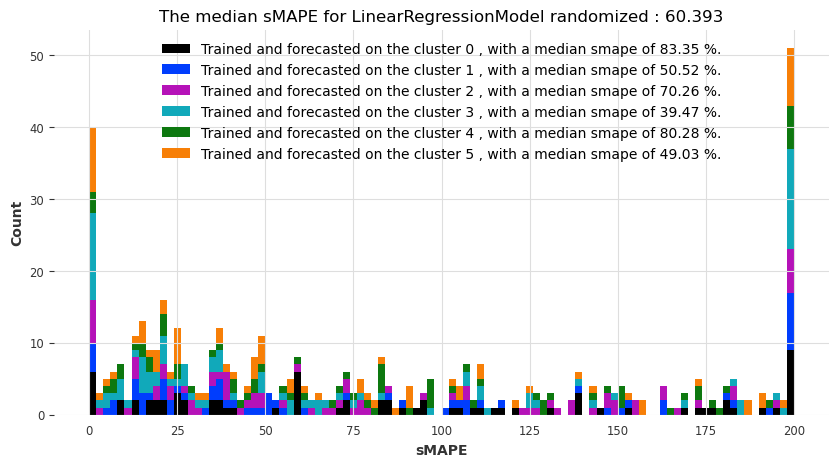

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 01:53:31,431] A new study created in memory with name: no-name-a9efec3d-9d9c-4f5d-bfbe-0022298072b3
[I 2023-01-28 01:53:33,629] Trial 0 finished with value: 187.87034334283328 and parameters: {'out_len': 10}. Best is trial 0 with value: 187.87034334283328.
[I 2023-01-28 01:53:35,859] Trial 1 finished with value: 114.97777399975415 and parameters: {'out_len': 5}. Best is trial 1 with value: 114.97777399975415.
[I 2023-01-28 01:53:38,113] Trial 2 finished with value: 171.0479854653556 and parameters: {'out_len': 11}. Best is trial 1 with value: 114.97777399975415.
[I 2023-01-28 01:53:40,375] Trial 3 finished with value: 151.7625406101171 and parameters: {'out_len': 9}. Best is trial 1 with value: 114.97777399975415.
[I 2023-01-28 01:53:42,592] Trial 4 finished with value: 187.87034334283328 and parameters: {'out_len': 10}. Best is trial 1 with value: 114.97777399975415.
[I 2023-01-28 01:53:44,854] Trial 5 finished with value: 151.7625406101171 and parameters: {'out_len': 9}

[I 2023-01-28 01:55:33,103] Trial 1 finished with value: 155.77796863675977 and parameters: {'out_len': 10}. Best is trial 0 with value: 150.95304555549055.
[I 2023-01-28 01:55:33,338] Trial 2 finished with value: 154.19739373845786 and parameters: {'out_len': 11}. Best is trial 0 with value: 150.95304555549055.
[I 2023-01-28 01:55:33,621] Trial 3 finished with value: 156.0553543366042 and parameters: {'out_len': 9}. Best is trial 0 with value: 150.95304555549055.
[I 2023-01-28 01:55:33,872] Trial 4 finished with value: 150.42107456109082 and parameters: {'out_len': 12}. Best is trial 4 with value: 150.42107456109082.
[I 2023-01-28 01:55:34,139] Trial 5 finished with value: 109.22901748147859 and parameters: {'out_len': 1}. Best is trial 5 with value: 109.22901748147859.
[I 2023-01-28 01:55:34,406] Trial 6 finished with value: 156.0553543366042 and parameters: {'out_len': 9}. Best is trial 5 with value: 109.22901748147859.
[I 2023-01-28 01:55:34,657] Trial 7 finished with value: 131.77

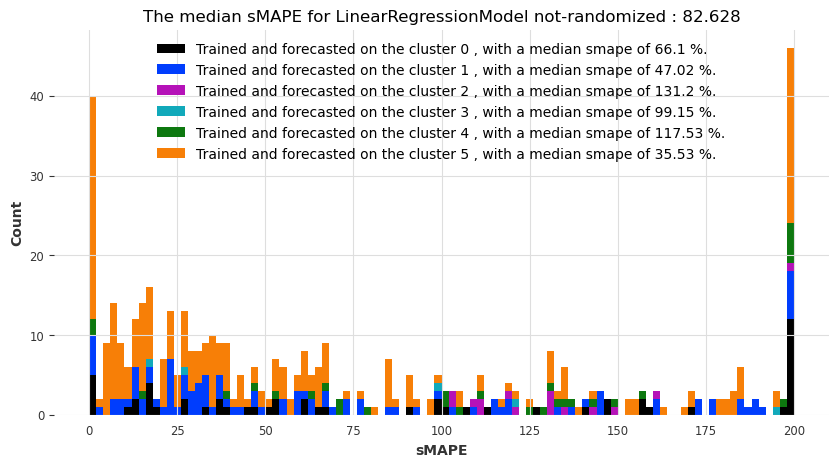

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 01:59:02,220] A new study created in memory with name: no-name-16d96289-44a9-496d-b0fb-9de7546fc3ec
[I 2023-01-28 01:59:06,567] Trial 0 finished with value: 64.68946077728432 and parameters: {'out_len': 3}. Best is trial 0 with value: 64.68946077728432.
[I 2023-01-28 01:59:11,536] Trial 1 finished with value: 124.95808015360048 and parameters: {'out_len': 9}. Best is trial 0 with value: 64.68946077728432.
[I 2023-01-28 01:59:15,567] Trial 2 finished with value: 62.165994472191734 and parameters: {'out_len': 2}. Best is trial 2 with value: 62.165994472191734.
[I 2023-01-28 01:59:21,607] Trial 3 finished with value: 68.86172266782617 and parameters: {'out_len': 5}. Best is trial 2 with value: 62.165994472191734.
[I 2023-01-28 01:59:26,644] Trial 4 finished with value: 70.09910423825981 and parameters: {'out_len': 6}. Best is trial 2 with value: 62.165994472191734.
[I 2023-01-28 01:59:31,084] Trial 5 finished with value: 64.68946077728432 and parameters: {'out_len': 3}. Best

[I 2023-01-28 02:02:58,585] Trial 1 finished with value: 85.62588104339667 and parameters: {'out_len': 6}. Best is trial 0 with value: 72.9937864314037.
[I 2023-01-28 02:03:03,584] Trial 2 finished with value: 72.9937864314037 and parameters: {'out_len': 2}. Best is trial 0 with value: 72.9937864314037.
[I 2023-01-28 02:03:09,840] Trial 3 finished with value: 102.88439287225542 and parameters: {'out_len': 10}. Best is trial 0 with value: 72.9937864314037.
[I 2023-01-28 02:03:16,411] Trial 4 finished with value: 76.1710033067104 and parameters: {'out_len': 5}. Best is trial 0 with value: 72.9937864314037.
[I 2023-01-28 02:03:21,390] Trial 5 finished with value: 72.9937864314037 and parameters: {'out_len': 2}. Best is trial 0 with value: 72.9937864314037.
[I 2023-01-28 02:03:27,249] Trial 6 finished with value: 131.30677988915645 and parameters: {'out_len': 11}. Best is trial 0 with value: 72.9937864314037.
[I 2023-01-28 02:03:34,987] Trial 7 finished with value: 88.17186672990888 and pa

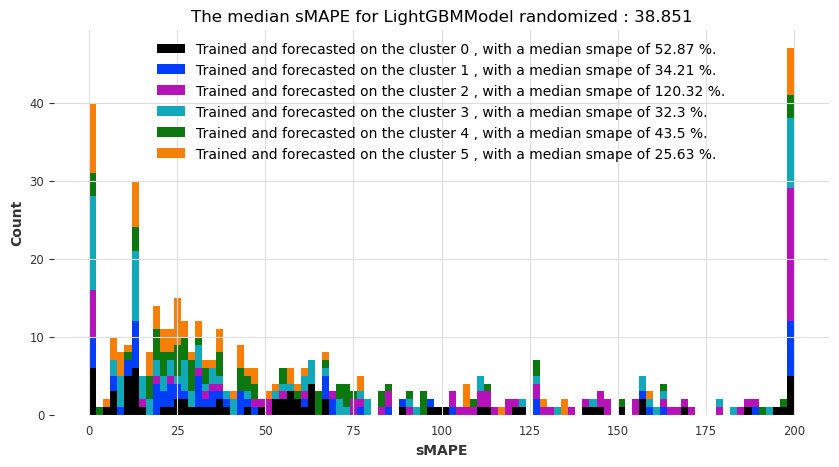

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 02:07:04,417] A new study created in memory with name: no-name-83bc60de-e143-4cdb-acd9-441f29735160
[I 2023-01-28 02:07:08,428] Trial 0 finished with value: 153.20453874413028 and parameters: {'out_len': 12}. Best is trial 0 with value: 153.20453874413028.
[I 2023-01-28 02:07:11,836] Trial 1 finished with value: 116.23543564976693 and parameters: {'out_len': 10}. Best is trial 1 with value: 116.23543564976693.
[I 2023-01-28 02:07:15,076] Trial 2 finished with value: 129.72963065008562 and parameters: {'out_len': 11}. Best is trial 1 with value: 116.23543564976693.
[I 2023-01-28 02:07:18,326] Trial 3 finished with value: 153.20453874413028 and parameters: {'out_len': 12}. Best is trial 1 with value: 116.23543564976693.
[I 2023-01-28 02:07:21,874] Trial 4 finished with value: 107.15691282672752 and parameters: {'out_len': 7}. Best is trial 4 with value: 107.15691282672752.
[I 2023-01-28 02:07:24,479] Trial 5 finished with value: 101.08457582623768 and parameters: {'out_len'

[I 2023-01-28 02:10:01,308] Trial 1 finished with value: 195.8129680836645 and parameters: {'out_len': 11}. Best is trial 0 with value: 193.9309334671516.
[I 2023-01-28 02:10:01,654] Trial 2 finished with value: 195.83016505079763 and parameters: {'out_len': 10}. Best is trial 0 with value: 193.9309334671516.
[I 2023-01-28 02:10:02,015] Trial 3 finished with value: 195.85566541367896 and parameters: {'out_len': 9}. Best is trial 0 with value: 193.9309334671516.
[I 2023-01-28 02:10:02,392] Trial 4 finished with value: 195.83016505079763 and parameters: {'out_len': 10}. Best is trial 0 with value: 193.9309334671516.
[I 2023-01-28 02:10:02,763] Trial 5 finished with value: 198.53504992233624 and parameters: {'out_len': 6}. Best is trial 0 with value: 193.9309334671516.
[I 2023-01-28 02:10:03,155] Trial 6 finished with value: 197.39149249174088 and parameters: {'out_len': 5}. Best is trial 0 with value: 193.9309334671516.
[I 2023-01-28 02:10:03,491] Trial 7 finished with value: 195.9461745

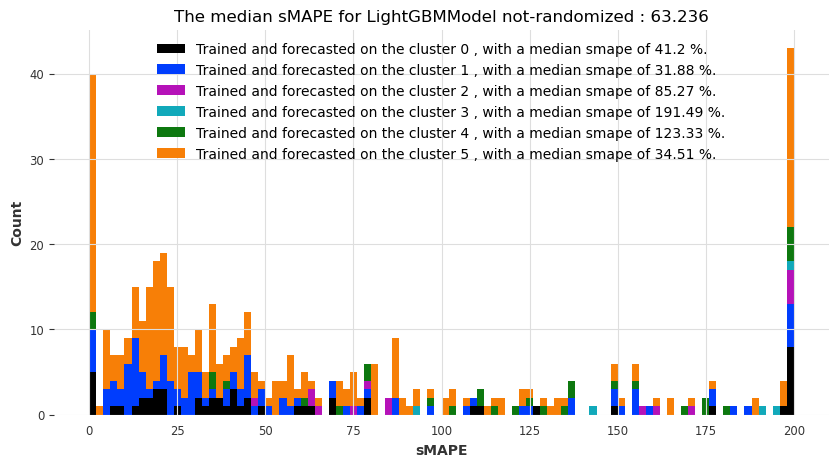

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 02:14:28,612] A new study created in memory with name: no-name-426c550d-2e5a-4a6d-8a4b-7309426a8bb6
[I 2023-01-28 02:14:32,922] Trial 0 finished with value: 72.57805181328872 and parameters: {'out_len': 10, 'n_estimators': 92, 'max_depth': 6}. Best is trial 0 with value: 72.57805181328872.
[I 2023-01-28 02:14:37,509] Trial 1 finished with value: 68.16509050990328 and parameters: {'out_len': 5, 'n_estimators': 68, 'max_depth': 5}. Best is trial 1 with value: 68.16509050990328.
[I 2023-01-28 02:14:43,459] Trial 2 finished with value: 52.369463467718035 and parameters: {'out_len': 4, 'n_estimators': 70, 'max_depth': 29}. Best is trial 2 with value: 52.369463467718035.
[I 2023-01-28 02:14:49,631] Trial 3 finished with value: 68.466064719407 and parameters: {'out_len': 1, 'n_estimators': 65, 'max_depth': 13}. Best is trial 2 with value: 52.369463467718035.
[I 2023-01-28 02:14:56,451] Trial 4 finished with value: 66.50207797388413 and parameters: {'out_len': 4, 'n_estimators': 

[I 2023-01-28 02:18:21,294] Trial 9 finished with value: 59.95556949977328 and parameters: {'out_len': 6, 'n_estimators': 67, 'max_depth': 6}. Best is trial 8 with value: 51.35967919572128.
[I 2023-01-28 02:18:27,120] Trial 10 finished with value: 56.12521531544041 and parameters: {'out_len': 9, 'n_estimators': 85, 'max_depth': 15}. Best is trial 8 with value: 51.35967919572128.
[I 2023-01-28 02:18:34,978] Trial 11 finished with value: 53.95045784965845 and parameters: {'out_len': 1, 'n_estimators': 61, 'max_depth': 19}. Best is trial 8 with value: 51.35967919572128.
[I 2023-01-28 02:18:43,142] Trial 12 finished with value: 53.4514346249316 and parameters: {'out_len': 3, 'n_estimators': 87, 'max_depth': 16}. Best is trial 8 with value: 51.35967919572128.
[I 2023-01-28 02:18:47,970] Trial 13 finished with value: 53.02910877328389 and parameters: {'out_len': 10, 'n_estimators': 58, 'max_depth': 23}. Best is trial 8 with value: 51.35967919572128.
[I 2023-01-28 02:18:53,850] Trial 14 finis

[I 2023-01-28 02:23:16,904] Trial 3 finished with value: 50.985545412716725 and parameters: {'out_len': 2, 'n_estimators': 72, 'max_depth': 6}. Best is trial 3 with value: 50.985545412716725.
[I 2023-01-28 02:23:21,905] Trial 4 finished with value: 58.19967084363854 and parameters: {'out_len': 9, 'n_estimators': 58, 'max_depth': 20}. Best is trial 3 with value: 50.985545412716725.
[I 2023-01-28 02:23:28,986] Trial 5 finished with value: 53.82524224248085 and parameters: {'out_len': 7, 'n_estimators': 96, 'max_depth': 29}. Best is trial 3 with value: 50.985545412716725.
[I 2023-01-28 02:23:34,019] Trial 6 finished with value: 62.004717719074904 and parameters: {'out_len': 10, 'n_estimators': 75, 'max_depth': 11}. Best is trial 3 with value: 50.985545412716725.
[I 2023-01-28 02:23:41,877] Trial 7 finished with value: 46.37544722476186 and parameters: {'out_len': 2, 'n_estimators': 90, 'max_depth': 13}. Best is trial 7 with value: 46.37544722476186.
[I 2023-01-28 02:23:48,358] Trial 8 fin

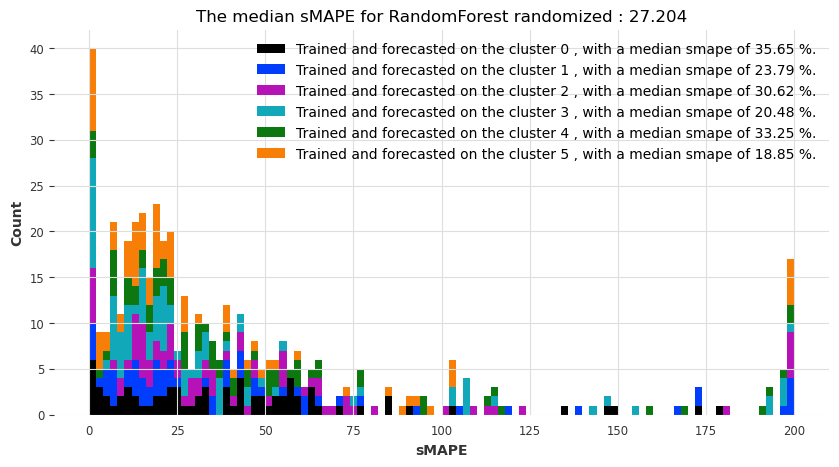

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 02:24:41,556] A new study created in memory with name: no-name-db839523-7aa1-47b8-be46-175b18db65ce
[I 2023-01-28 02:24:46,703] Trial 0 finished with value: 93.88852691279452 and parameters: {'out_len': 2, 'n_estimators': 87, 'max_depth': 13}. Best is trial 0 with value: 93.88852691279452.
[I 2023-01-28 02:24:51,925] Trial 1 finished with value: 95.72800352436356 and parameters: {'out_len': 1, 'n_estimators': 88, 'max_depth': 14}. Best is trial 0 with value: 93.88852691279452.
[I 2023-01-28 02:24:55,245] Trial 2 finished with value: 104.39031048437083 and parameters: {'out_len': 10, 'n_estimators': 71, 'max_depth': 14}. Best is trial 0 with value: 93.88852691279452.
[I 2023-01-28 02:25:00,747] Trial 3 finished with value: 94.11708999006714 and parameters: {'out_len': 3, 'n_estimators': 100, 'max_depth': 22}. Best is trial 0 with value: 93.88852691279452.
[I 2023-01-28 02:25:04,858] Trial 4 finished with value: 94.71253356699754 and parameters: {'out_len': 3, 'n_estimators

[I 2023-01-28 02:28:23,738] Trial 9 finished with value: 77.74749719962985 and parameters: {'out_len': 10, 'n_estimators': 60, 'max_depth': 11}. Best is trial 7 with value: 58.54592920867464.
[I 2023-01-28 02:28:24,727] Trial 10 finished with value: 74.2246194905356 and parameters: {'out_len': 1, 'n_estimators': 50, 'max_depth': 17}. Best is trial 7 with value: 58.54592920867464.
[I 2023-01-28 02:28:25,811] Trial 11 finished with value: 70.3763682776489 and parameters: {'out_len': 2, 'n_estimators': 69, 'max_depth': 18}. Best is trial 7 with value: 58.54592920867464.
[I 2023-01-28 02:28:26,866] Trial 12 finished with value: 80.62633734888341 and parameters: {'out_len': 3, 'n_estimators': 68, 'max_depth': 17}. Best is trial 7 with value: 58.54592920867464.
[I 2023-01-28 02:28:28,106] Trial 13 finished with value: 69.47580163759946 and parameters: {'out_len': 4, 'n_estimators': 100, 'max_depth': 30}. Best is trial 7 with value: 58.54592920867464.
[I 2023-01-28 02:28:29,095] Trial 14 fini

[I 2023-01-28 02:30:49,302] Trial 3 finished with value: 55.08294218519632 and parameters: {'out_len': 12, 'n_estimators': 85, 'max_depth': 24}. Best is trial 1 with value: 49.88035331265004.
[I 2023-01-28 02:31:16,299] Trial 4 finished with value: 54.11753226399629 and parameters: {'out_len': 5, 'n_estimators': 75, 'max_depth': 17}. Best is trial 1 with value: 49.88035331265004.
[I 2023-01-28 02:31:43,341] Trial 5 finished with value: 54.11610600178647 and parameters: {'out_len': 7, 'n_estimators': 80, 'max_depth': 24}. Best is trial 1 with value: 49.88035331265004.
[I 2023-01-28 02:32:05,073] Trial 6 finished with value: 57.23328626934545 and parameters: {'out_len': 7, 'n_estimators': 76, 'max_depth': 11}. Best is trial 1 with value: 49.88035331265004.
[I 2023-01-28 02:32:30,653] Trial 7 finished with value: 52.292068372896594 and parameters: {'out_len': 4, 'n_estimators': 69, 'max_depth': 13}. Best is trial 1 with value: 49.88035331265004.
[I 2023-01-28 02:32:44,062] Trial 8 finishe

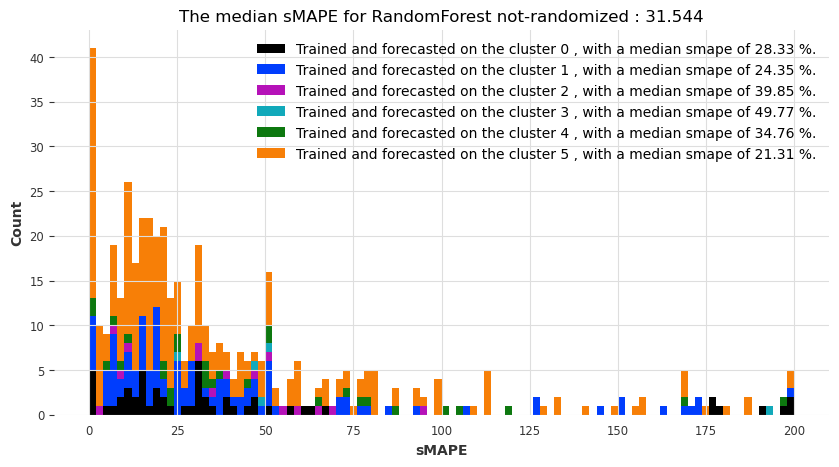

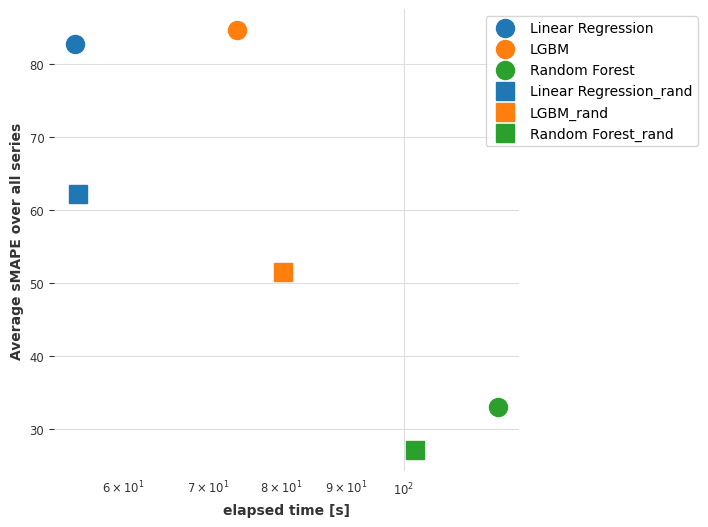

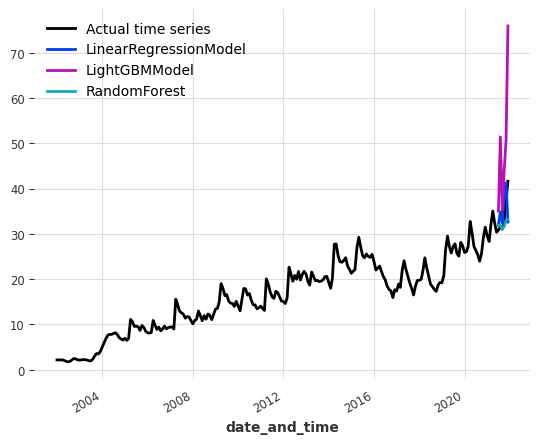

The results for index_colab_notincrem with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 02:36:35,599] A new study created in memory with name: no-name-89ee05a8-607c-4539-a89e-3d8ddf52b724
[I 2023-01-28 02:36:38,857] Trial 0 finished with value: 133.53789620637642 and parameters: {'out_len': 7}. Best is trial 0 with value: 133.53789620637642.
[I 2023-01-28 02:36:41,872] Trial 1 finished with value: 133.53789620637642 and parameters: {'out_len': 7}. Best is trial 0 with value: 133.53789620637642.
[I 2023-01-28 02:36:44,861] Trial 2 finished with value: 109.80331773531567 and parameters: {'out_len': 3}. Best is trial 2 with value: 109.80331773531567.
[I 2023-01-28 02:36:47,956] Trial 3 finished with value: 144.96612320354876 and parameters: {'out_len': 9}. Best is trial 2 with value: 109.80331773531567.
[I 2023-01-28 02:36:51,920] Trial 4 finished with value: 109.80331773531567 and parameters: {'out_len': 3}. Best is trial 2 with value: 109.80331773531567.
[I 2023-01-28 02:36:54,927] Trial 5 finished with value: 144.22413899536025 and parameters: {'out_len': 10

[I 2023-01-28 02:39:12,047] Trial 1 finished with value: 94.16673683836521 and parameters: {'out_len': 2}. Best is trial 0 with value: 84.46460673470368.
[I 2023-01-28 02:39:16,828] Trial 2 finished with value: 98.63238030881497 and parameters: {'out_len': 11}. Best is trial 0 with value: 84.46460673470368.
[I 2023-01-28 02:39:20,525] Trial 3 finished with value: 94.07150221008588 and parameters: {'out_len': 3}. Best is trial 0 with value: 84.46460673470368.
[I 2023-01-28 02:39:24,191] Trial 4 finished with value: 94.07150221008588 and parameters: {'out_len': 3}. Best is trial 0 with value: 84.46460673470368.
[I 2023-01-28 02:39:27,969] Trial 5 finished with value: 84.46460673470368 and parameters: {'out_len': 9}. Best is trial 0 with value: 84.46460673470368.
[I 2023-01-28 02:39:31,643] Trial 6 finished with value: 93.56891263493502 and parameters: {'out_len': 1}. Best is trial 0 with value: 84.46460673470368.
[I 2023-01-28 02:39:35,318] Trial 7 finished with value: 93.56891263493502 

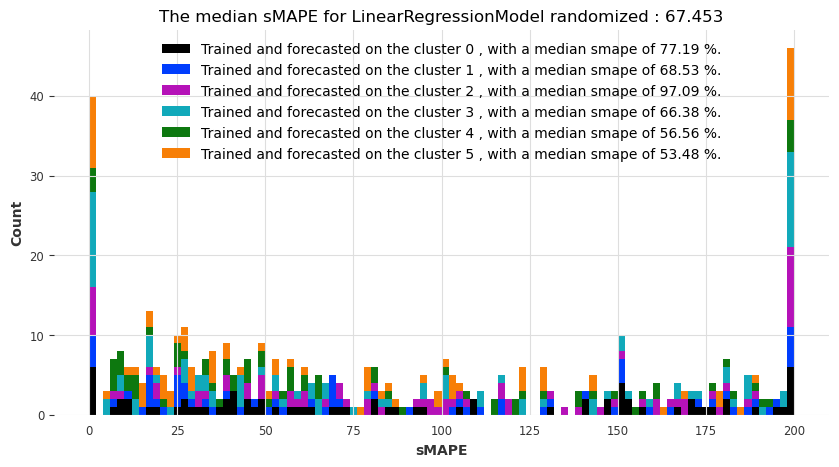

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 02:41:55,354] A new study created in memory with name: no-name-8d38fdfa-e051-4111-bdb8-833e7aed2b3c
[I 2023-01-28 02:41:57,427] Trial 0 finished with value: 111.149285829777 and parameters: {'out_len': 4}. Best is trial 0 with value: 111.149285829777.
[I 2023-01-28 02:41:59,561] Trial 1 finished with value: 103.3684828592348 and parameters: {'out_len': 2}. Best is trial 1 with value: 103.3684828592348.
[I 2023-01-28 02:42:01,729] Trial 2 finished with value: 114.75936299598995 and parameters: {'out_len': 3}. Best is trial 1 with value: 103.3684828592348.
[I 2023-01-28 02:42:03,856] Trial 3 finished with value: 104.34679703482571 and parameters: {'out_len': 1}. Best is trial 1 with value: 103.3684828592348.
[I 2023-01-28 02:42:07,013] Trial 4 finished with value: 199.2728567005339 and parameters: {'out_len': 10}. Best is trial 1 with value: 103.3684828592348.
[I 2023-01-28 02:42:09,124] Trial 5 finished with value: 104.34679703482571 and parameters: {'out_len': 1}. Best is

[I 2023-01-28 02:43:53,350] Trial 1 finished with value: 160.60874469737726 and parameters: {'out_len': 6}. Best is trial 0 with value: 156.31012527505987.
[I 2023-01-28 02:43:53,585] Trial 2 finished with value: 167.13539379785993 and parameters: {'out_len': 1}. Best is trial 0 with value: 156.31012527505987.
[I 2023-01-28 02:43:53,836] Trial 3 finished with value: 167.13539379785993 and parameters: {'out_len': 1}. Best is trial 0 with value: 156.31012527505987.
[I 2023-01-28 02:43:54,088] Trial 4 finished with value: 160.60874469737726 and parameters: {'out_len': 6}. Best is trial 0 with value: 156.31012527505987.
[I 2023-01-28 02:43:54,369] Trial 5 finished with value: 157.2532363480604 and parameters: {'out_len': 5}. Best is trial 0 with value: 156.31012527505987.
[I 2023-01-28 02:43:54,636] Trial 6 finished with value: 148.36223512199206 and parameters: {'out_len': 9}. Best is trial 6 with value: 148.36223512199206.
[I 2023-01-28 02:43:54,887] Trial 7 finished with value: 157.2532

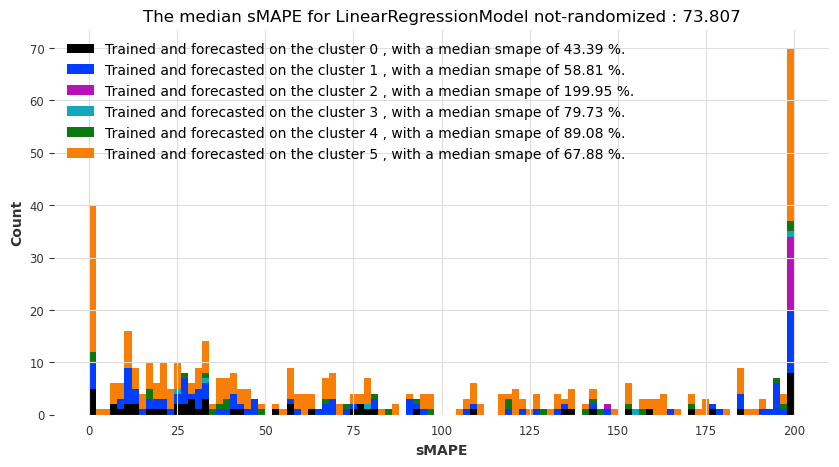

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 02:47:15,035] A new study created in memory with name: no-name-6f7f96ea-111b-4636-ae41-70ee9479bfa8
[I 2023-01-28 02:47:19,624] Trial 0 finished with value: 86.6080000516078 and parameters: {'out_len': 2}. Best is trial 0 with value: 86.6080000516078.
[I 2023-01-28 02:47:25,577] Trial 1 finished with value: 116.00382753424564 and parameters: {'out_len': 7}. Best is trial 0 with value: 86.6080000516078.
[I 2023-01-28 02:47:29,071] Trial 2 finished with value: 85.49968071314429 and parameters: {'out_len': 1}. Best is trial 2 with value: 85.49968071314429.
[I 2023-01-28 02:47:34,032] Trial 3 finished with value: 119.6834149706856 and parameters: {'out_len': 6}. Best is trial 2 with value: 85.49968071314429.
[I 2023-01-28 02:47:38,634] Trial 4 finished with value: 88.1050963084098 and parameters: {'out_len': 4}. Best is trial 2 with value: 85.49968071314429.
[I 2023-01-28 02:47:43,458] Trial 5 finished with value: 114.32895691227341 and parameters: {'out_len': 8}. Best is tri

[I 2023-01-28 02:51:09,845] Trial 1 finished with value: 97.72950447695844 and parameters: {'out_len': 8}. Best is trial 0 with value: 93.66186443851416.
[I 2023-01-28 02:51:14,173] Trial 2 finished with value: 80.37154605764324 and parameters: {'out_len': 1}. Best is trial 2 with value: 80.37154605764324.
[I 2023-01-28 02:51:19,674] Trial 3 finished with value: 138.78731829958969 and parameters: {'out_len': 12}. Best is trial 2 with value: 80.37154605764324.
[I 2023-01-28 02:51:25,459] Trial 4 finished with value: 133.7593426725217 and parameters: {'out_len': 11}. Best is trial 2 with value: 80.37154605764324.
[I 2023-01-28 02:51:30,768] Trial 5 finished with value: 80.37154605764324 and parameters: {'out_len': 1}. Best is trial 2 with value: 80.37154605764324.
[I 2023-01-28 02:51:36,913] Trial 6 finished with value: 110.7014331509019 and parameters: {'out_len': 10}. Best is trial 2 with value: 80.37154605764324.
[I 2023-01-28 02:51:41,206] Trial 7 finished with value: 80.371546057643

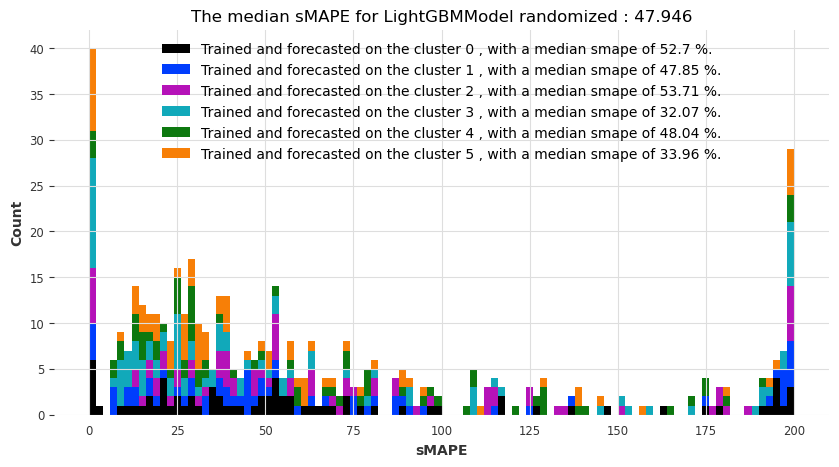

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 02:55:09,880] A new study created in memory with name: no-name-6145f381-fc68-4a6c-b3f4-739cf47c015a
[I 2023-01-28 02:55:12,811] Trial 0 finished with value: 149.90227842813044 and parameters: {'out_len': 12}. Best is trial 0 with value: 149.90227842813044.
[I 2023-01-28 02:55:16,287] Trial 1 finished with value: 112.72105663532035 and parameters: {'out_len': 6}. Best is trial 1 with value: 112.72105663532035.
[I 2023-01-28 02:55:19,451] Trial 2 finished with value: 149.90227842813044 and parameters: {'out_len': 12}. Best is trial 1 with value: 112.72105663532035.
[I 2023-01-28 02:55:22,857] Trial 3 finished with value: 109.72848672035607 and parameters: {'out_len': 5}. Best is trial 3 with value: 109.72848672035607.
[I 2023-01-28 02:55:26,006] Trial 4 finished with value: 149.90227842813044 and parameters: {'out_len': 12}. Best is trial 3 with value: 109.72848672035607.
[I 2023-01-28 02:55:29,783] Trial 5 finished with value: 149.90227842813044 and parameters: {'out_len':

[I 2023-01-28 02:58:16,653] Trial 1 finished with value: 195.79513695661993 and parameters: {'out_len': 7}. Best is trial 1 with value: 195.79513695661993.
[I 2023-01-28 02:58:17,080] Trial 2 finished with value: 195.95047915862597 and parameters: {'out_len': 3}. Best is trial 1 with value: 195.79513695661993.
[I 2023-01-28 02:58:17,500] Trial 3 finished with value: 196.23166221766675 and parameters: {'out_len': 2}. Best is trial 1 with value: 195.79513695661993.
[I 2023-01-28 02:58:17,956] Trial 4 finished with value: 195.85031755573996 and parameters: {'out_len': 11}. Best is trial 1 with value: 195.79513695661993.
[I 2023-01-28 02:58:18,395] Trial 5 finished with value: 195.85031755573996 and parameters: {'out_len': 11}. Best is trial 1 with value: 195.79513695661993.
[I 2023-01-28 02:58:18,764] Trial 6 finished with value: 194.76210721557686 and parameters: {'out_len': 1}. Best is trial 6 with value: 194.76210721557686.
[I 2023-01-28 02:58:19,177] Trial 7 finished with value: 195.7

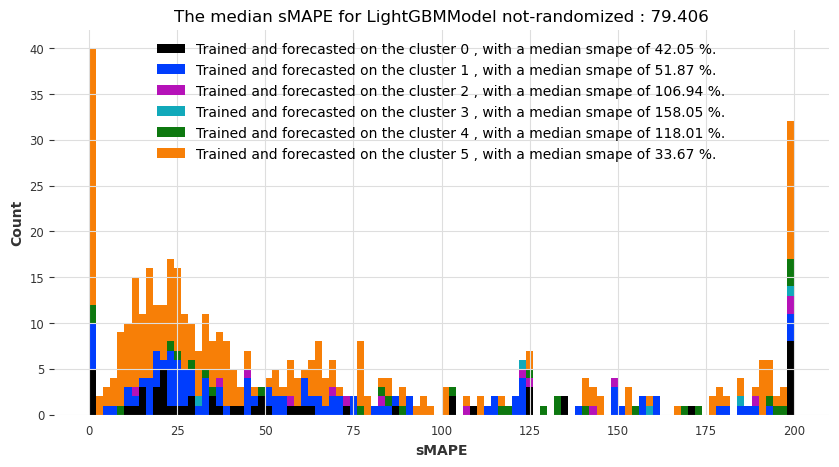

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 03:02:35,728] A new study created in memory with name: no-name-1666db93-b7de-4acc-9d4b-e84e2dbbaa4e
[I 2023-01-28 03:02:40,900] Trial 0 finished with value: 83.65141018440335 and parameters: {'out_len': 10, 'n_estimators': 52, 'max_depth': 15}. Best is trial 0 with value: 83.65141018440335.
[I 2023-01-28 03:02:47,591] Trial 1 finished with value: 75.20296571058987 and parameters: {'out_len': 3, 'n_estimators': 77, 'max_depth': 28}. Best is trial 1 with value: 75.20296571058987.
[I 2023-01-28 03:02:52,343] Trial 2 finished with value: 81.46685694471672 and parameters: {'out_len': 10, 'n_estimators': 83, 'max_depth': 29}. Best is trial 1 with value: 75.20296571058987.
[I 2023-01-28 03:02:57,501] Trial 3 finished with value: 80.60998937527246 and parameters: {'out_len': 9, 'n_estimators': 87, 'max_depth': 14}. Best is trial 1 with value: 75.20296571058987.
[I 2023-01-28 03:03:04,043] Trial 4 finished with value: 73.38409501042827 and parameters: {'out_len': 2, 'n_estimators'

[I 2023-01-28 03:06:33,505] Trial 9 finished with value: 66.27041552691588 and parameters: {'out_len': 7, 'n_estimators': 54, 'max_depth': 6}. Best is trial 9 with value: 66.27041552691588.
[I 2023-01-28 03:06:38,217] Trial 10 finished with value: 58.18397876226358 and parameters: {'out_len': 4, 'n_estimators': 51, 'max_depth': 5}. Best is trial 10 with value: 58.18397876226358.
[I 2023-01-28 03:06:42,676] Trial 11 finished with value: 59.84634864652809 and parameters: {'out_len': 4, 'n_estimators': 50, 'max_depth': 5}. Best is trial 10 with value: 58.18397876226358.
[I 2023-01-28 03:06:48,818] Trial 12 finished with value: 78.7822099501278 and parameters: {'out_len': 3, 'n_estimators': 62, 'max_depth': 12}. Best is trial 10 with value: 58.18397876226358.
[I 2023-01-28 03:06:54,324] Trial 13 finished with value: 82.295771318518 and parameters: {'out_len': 4, 'n_estimators': 61, 'max_depth': 9}. Best is trial 10 with value: 58.18397876226358.
[I 2023-01-28 03:07:01,506] Trial 14 finishe

[I 2023-01-28 03:11:12,497] Trial 3 finished with value: 62.836175739093854 and parameters: {'out_len': 11, 'n_estimators': 85, 'max_depth': 17}. Best is trial 2 with value: 57.59496214737376.
[I 2023-01-28 03:11:20,142] Trial 4 finished with value: 54.72588624438609 and parameters: {'out_len': 2, 'n_estimators': 83, 'max_depth': 20}. Best is trial 4 with value: 54.72588624438609.
[I 2023-01-28 03:11:28,123] Trial 5 finished with value: 61.55258646575335 and parameters: {'out_len': 5, 'n_estimators': 79, 'max_depth': 25}. Best is trial 4 with value: 54.72588624438609.
[I 2023-01-28 03:11:34,477] Trial 6 finished with value: 60.67170944009381 and parameters: {'out_len': 3, 'n_estimators': 97, 'max_depth': 7}. Best is trial 4 with value: 54.72588624438609.
[I 2023-01-28 03:11:38,811] Trial 7 finished with value: 60.02703407671456 and parameters: {'out_len': 11, 'n_estimators': 59, 'max_depth': 17}. Best is trial 4 with value: 54.72588624438609.
[I 2023-01-28 03:11:43,269] Trial 8 finishe

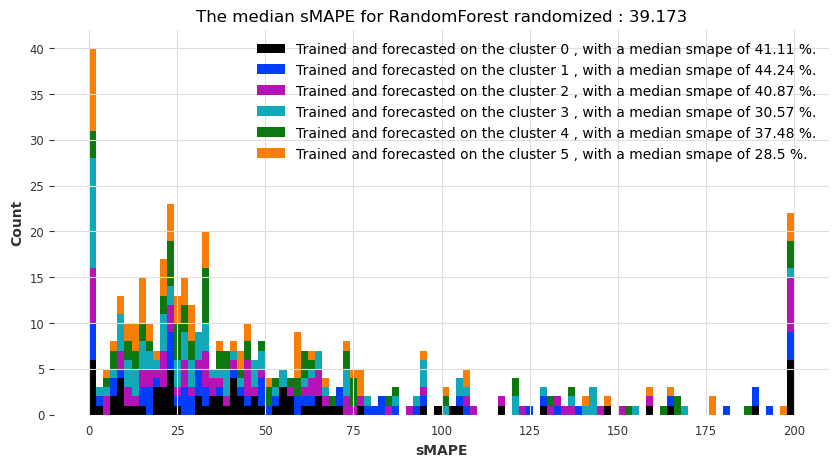

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 03:12:39,696] A new study created in memory with name: no-name-61692482-0b2d-432a-a8f7-6203bd6ae5d1
[I 2023-01-28 03:12:43,618] Trial 0 finished with value: 100.70221779282383 and parameters: {'out_len': 3, 'n_estimators': 57, 'max_depth': 15}. Best is trial 0 with value: 100.70221779282383.
[I 2023-01-28 03:12:48,331] Trial 1 finished with value: 99.77018918880714 and parameters: {'out_len': 3, 'n_estimators': 82, 'max_depth': 15}. Best is trial 1 with value: 99.77018918880714.
[I 2023-01-28 03:12:51,411] Trial 2 finished with value: 113.64636607562792 and parameters: {'out_len': 9, 'n_estimators': 57, 'max_depth': 10}. Best is trial 1 with value: 99.77018918880714.
[I 2023-01-28 03:12:54,495] Trial 3 finished with value: 112.94065336319653 and parameters: {'out_len': 10, 'n_estimators': 76, 'max_depth': 8}. Best is trial 1 with value: 99.77018918880714.
[I 2023-01-28 03:12:58,286] Trial 4 finished with value: 114.01383907705844 and parameters: {'out_len': 7, 'n_estimato

[I 2023-01-28 03:16:18,107] Trial 9 finished with value: 64.25602874680199 and parameters: {'out_len': 2, 'n_estimators': 76, 'max_depth': 7}. Best is trial 4 with value: 45.49217809747051.
[I 2023-01-28 03:16:18,908] Trial 10 finished with value: 85.5106454323913 and parameters: {'out_len': 9, 'n_estimators': 50, 'max_depth': 20}. Best is trial 4 with value: 45.49217809747051.
[I 2023-01-28 03:16:19,959] Trial 11 finished with value: 49.251788830794275 and parameters: {'out_len': 1, 'n_estimators': 60, 'max_depth': 13}. Best is trial 4 with value: 45.49217809747051.
[I 2023-01-28 03:16:20,990] Trial 12 finished with value: 46.042220873969406 and parameters: {'out_len': 1, 'n_estimators': 59, 'max_depth': 16}. Best is trial 4 with value: 45.49217809747051.
[I 2023-01-28 03:16:22,041] Trial 13 finished with value: 47.150426618778624 and parameters: {'out_len': 1, 'n_estimators': 60, 'max_depth': 17}. Best is trial 4 with value: 45.49217809747051.
[I 2023-01-28 03:16:22,857] Trial 14 fin

[I 2023-01-28 03:18:50,032] Trial 3 finished with value: 66.66404806191849 and parameters: {'out_len': 8, 'n_estimators': 69, 'max_depth': 29}. Best is trial 2 with value: 59.949767288256425.
[I 2023-01-28 03:19:28,249] Trial 4 finished with value: 60.09852757803918 and parameters: {'out_len': 2, 'n_estimators': 100, 'max_depth': 25}. Best is trial 2 with value: 59.949767288256425.
[I 2023-01-28 03:19:41,587] Trial 5 finished with value: 69.07418679208465 and parameters: {'out_len': 10, 'n_estimators': 55, 'max_depth': 6}. Best is trial 2 with value: 59.949767288256425.
[I 2023-01-28 03:20:02,352] Trial 6 finished with value: 66.42635593852398 and parameters: {'out_len': 8, 'n_estimators': 66, 'max_depth': 22}. Best is trial 2 with value: 59.949767288256425.
[I 2023-01-28 03:20:18,990] Trial 7 finished with value: 67.13682398864604 and parameters: {'out_len': 10, 'n_estimators': 73, 'max_depth': 8}. Best is trial 2 with value: 59.949767288256425.
[I 2023-01-28 03:20:37,350] Trial 8 fin

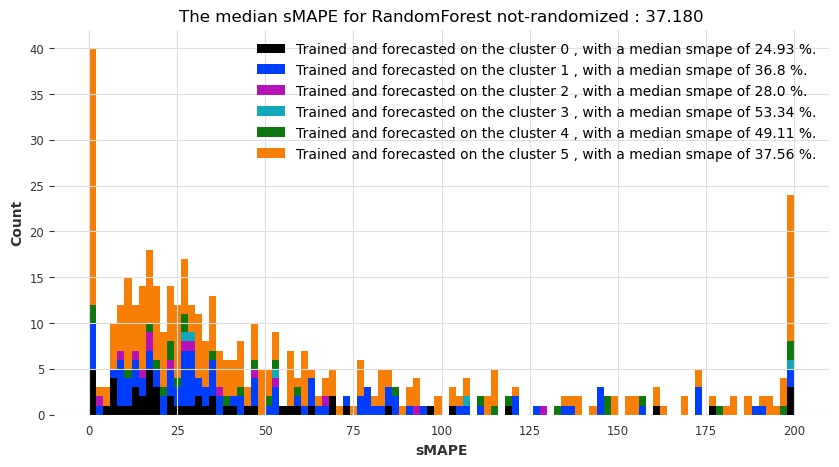

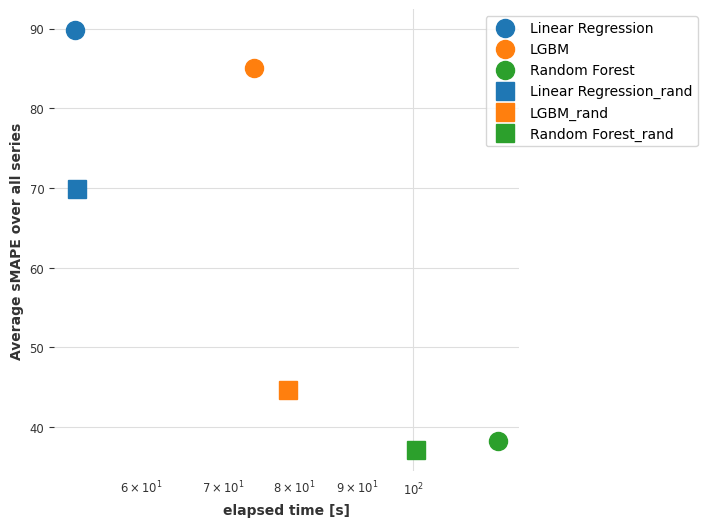

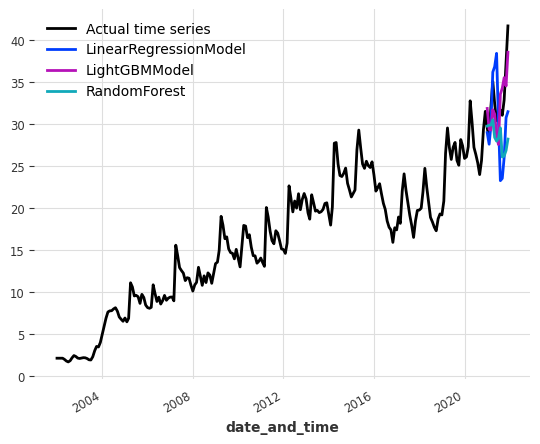

The results for index_keyword are:
The results for index_keyword with an horizon of 3 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 03:24:25,438] A new study created in memory with name: no-name-6f53cfe9-8e82-4fac-a987-7bb901d10bfe
[I 2023-01-28 03:24:28,438] Trial 0 finished with value: 26.986562474757584 and parameters: {'out_len': 10}. Best is trial 0 with value: 26.986562474757584.
[I 2023-01-28 03:24:31,507] Trial 1 finished with value: 28.431109885435504 and parameters: {'out_len': 11}. Best is trial 0 with value: 26.986562474757584.
[I 2023-01-28 03:24:34,552] Trial 2 finished with value: 25.093453719177695 and parameters: {'out_len': 9}. Best is trial 2 with value: 25.093453719177695.
[I 2023-01-28 03:24:37,810] Trial 3 finished with value: 28.431109885435504 and parameters: {'out_len': 11}. Best is trial 2 with value: 25.093453719177695.
[I 2023-01-28 03:24:40,804] Trial 4 finished with value: 11.297758083087924 and parameters: {'out_len': 2}. Best is trial 4 with value: 11.297758083087924.
[I 2023-01-28 03:24:43,849] Trial 5 finished with value: 16.573803967516525 and parameters: {'out_len':

[I 2023-01-28 03:27:18,296] Trial 1 finished with value: 29.594001864901962 and parameters: {'out_len': 10}. Best is trial 0 with value: 25.80494653718995.
[I 2023-01-28 03:27:21,522] Trial 2 finished with value: 21.595689806086835 and parameters: {'out_len': 5}. Best is trial 2 with value: 21.595689806086835.
[I 2023-01-28 03:27:24,695] Trial 3 finished with value: 14.99947698165839 and parameters: {'out_len': 3}. Best is trial 3 with value: 14.99947698165839.
[I 2023-01-28 03:27:27,890] Trial 4 finished with value: 25.386261645774308 and parameters: {'out_len': 7}. Best is trial 3 with value: 14.99947698165839.
[I 2023-01-28 03:27:31,079] Trial 5 finished with value: 16.82784509980775 and parameters: {'out_len': 2}. Best is trial 3 with value: 14.99947698165839.
[I 2023-01-28 03:27:34,313] Trial 6 finished with value: 25.80494653718995 and parameters: {'out_len': 8}. Best is trial 3 with value: 14.99947698165839.
[I 2023-01-28 03:27:38,547] Trial 7 finished with value: 29.09849618124

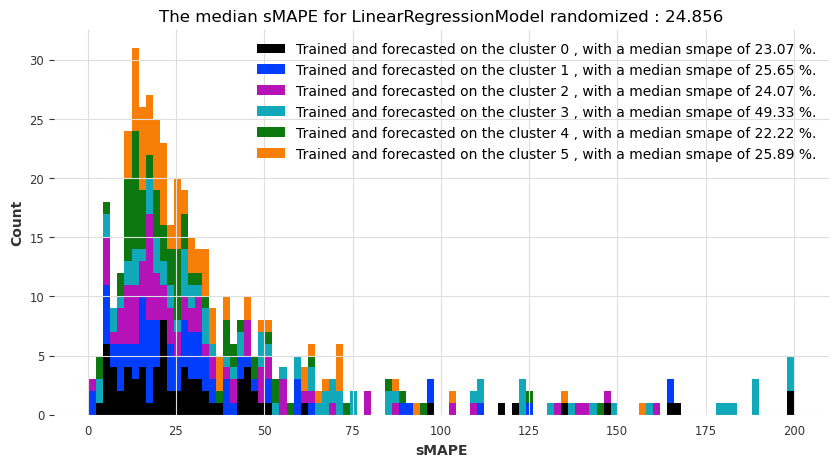

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 03:29:55,304] A new study created in memory with name: no-name-d2593a0b-466c-4dc6-82cf-5dfa031c4e75
[I 2023-01-28 03:29:58,028] Trial 0 finished with value: 18.25278059363971 and parameters: {'out_len': 2}. Best is trial 0 with value: 18.25278059363971.
[I 2023-01-28 03:30:00,976] Trial 1 finished with value: 12.200580190113719 and parameters: {'out_len': 4}. Best is trial 1 with value: 12.200580190113719.
[I 2023-01-28 03:30:03,831] Trial 2 finished with value: 18.1371908579048 and parameters: {'out_len': 6}. Best is trial 1 with value: 12.200580190113719.
[I 2023-01-28 03:30:07,717] Trial 3 finished with value: 25.217191096925728 and parameters: {'out_len': 10}. Best is trial 1 with value: 12.200580190113719.
[I 2023-01-28 03:30:10,565] Trial 4 finished with value: 12.200580190113719 and parameters: {'out_len': 4}. Best is trial 1 with value: 12.200580190113719.
[I 2023-01-28 03:30:13,376] Trial 5 finished with value: 18.25278059363971 and parameters: {'out_len': 2}. Be

[I 2023-01-28 03:32:13,046] Trial 1 finished with value: 26.492583319956974 and parameters: {'out_len': 9}. Best is trial 1 with value: 26.492583319956974.
[I 2023-01-28 03:32:13,235] Trial 2 finished with value: 18.338477537158212 and parameters: {'out_len': 1}. Best is trial 2 with value: 18.338477537158212.
[I 2023-01-28 03:32:13,486] Trial 3 finished with value: 19.15949648193673 and parameters: {'out_len': 5}. Best is trial 2 with value: 18.338477537158212.
[I 2023-01-28 03:32:13,705] Trial 4 finished with value: 14.847530300200551 and parameters: {'out_len': 2}. Best is trial 4 with value: 14.847530300200551.
[I 2023-01-28 03:32:13,894] Trial 5 finished with value: 21.45346484551689 and parameters: {'out_len': 6}. Best is trial 4 with value: 14.847530300200551.
[I 2023-01-28 03:32:14,129] Trial 6 finished with value: 26.877846308259098 and parameters: {'out_len': 10}. Best is trial 4 with value: 14.847530300200551.
[I 2023-01-28 03:32:14,349] Trial 7 finished with value: 16.43961

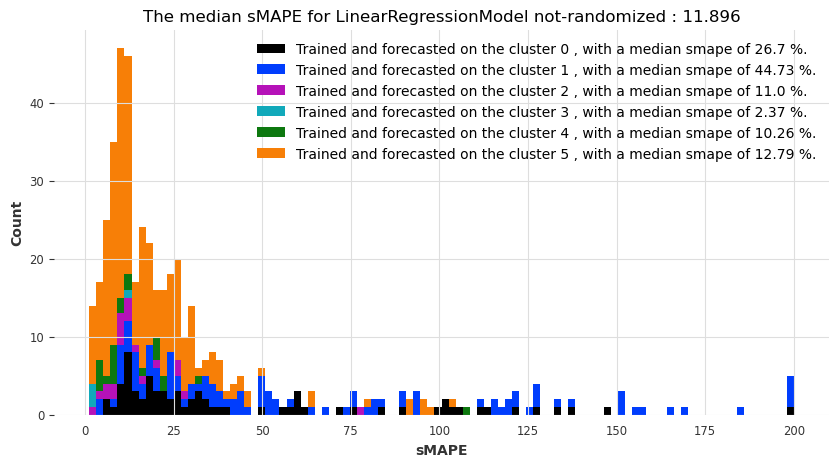

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 03:35:27,113] A new study created in memory with name: no-name-f77a9f74-017f-465f-b750-9f628008ca6e
[I 2023-01-28 03:35:32,127] Trial 0 finished with value: 18.31142243570747 and parameters: {'out_len': 8}. Best is trial 0 with value: 18.31142243570747.
[I 2023-01-28 03:35:36,909] Trial 1 finished with value: 22.05495476489539 and parameters: {'out_len': 10}. Best is trial 0 with value: 18.31142243570747.
[I 2023-01-28 03:35:43,040] Trial 2 finished with value: 21.27599369244392 and parameters: {'out_len': 9}. Best is trial 0 with value: 18.31142243570747.
[I 2023-01-28 03:35:48,418] Trial 3 finished with value: 18.012874378500996 and parameters: {'out_len': 7}. Best is trial 3 with value: 18.012874378500996.
[I 2023-01-28 03:35:53,513] Trial 4 finished with value: 12.893523088944306 and parameters: {'out_len': 4}. Best is trial 4 with value: 12.893523088944306.
[I 2023-01-28 03:35:58,218] Trial 5 finished with value: 10.895233675856826 and parameters: {'out_len': 3}. Bes

[I 2023-01-28 03:39:47,314] Trial 1 finished with value: 8.789611372038314 and parameters: {'out_len': 4}. Best is trial 1 with value: 8.789611372038314.
[I 2023-01-28 03:39:52,670] Trial 2 finished with value: 8.789611372038314 and parameters: {'out_len': 4}. Best is trial 1 with value: 8.789611372038314.
[I 2023-01-28 03:39:58,509] Trial 3 finished with value: 13.059627526661398 and parameters: {'out_len': 11}. Best is trial 1 with value: 8.789611372038314.
[I 2023-01-28 03:40:02,914] Trial 4 finished with value: 10.209300401984116 and parameters: {'out_len': 2}. Best is trial 1 with value: 8.789611372038314.
[I 2023-01-28 03:40:08,338] Trial 5 finished with value: 8.789611372038314 and parameters: {'out_len': 4}. Best is trial 1 with value: 8.789611372038314.
[I 2023-01-28 03:40:13,983] Trial 6 finished with value: 9.965716594552154 and parameters: {'out_len': 8}. Best is trial 1 with value: 8.789611372038314.
[I 2023-01-28 03:40:18,342] Trial 7 finished with value: 10.2093004019841

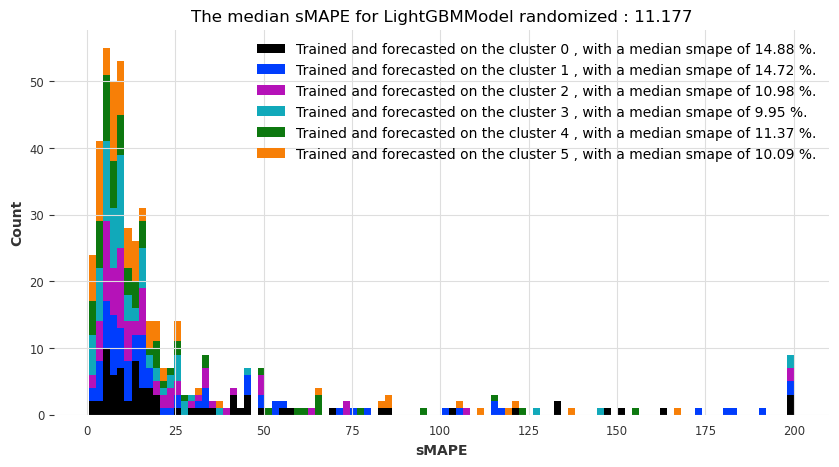

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 03:43:46,794] A new study created in memory with name: no-name-ad15c9d3-fdda-47b1-a400-28acf15b85a8
[I 2023-01-28 03:43:51,470] Trial 0 finished with value: 9.674996206893763 and parameters: {'out_len': 8}. Best is trial 0 with value: 9.674996206893763.
[I 2023-01-28 03:43:55,925] Trial 1 finished with value: 13.357527009916254 and parameters: {'out_len': 10}. Best is trial 0 with value: 9.674996206893763.
[I 2023-01-28 03:44:00,865] Trial 2 finished with value: 9.290624009591491 and parameters: {'out_len': 5}. Best is trial 2 with value: 9.290624009591491.
[I 2023-01-28 03:44:05,662] Trial 3 finished with value: 9.674996206893763 and parameters: {'out_len': 8}. Best is trial 2 with value: 9.290624009591491.
[I 2023-01-28 03:44:09,794] Trial 4 finished with value: 17.661262583784968 and parameters: {'out_len': 12}. Best is trial 2 with value: 9.290624009591491.
[I 2023-01-28 03:44:13,225] Trial 5 finished with value: 8.92200968610135 and parameters: {'out_len': 1}. Best i

[I 2023-01-28 03:47:03,529] Trial 1 finished with value: 72.36750247175307 and parameters: {'out_len': 5}. Best is trial 1 with value: 72.36750247175307.
[I 2023-01-28 03:47:03,796] Trial 2 finished with value: 72.42506665012849 and parameters: {'out_len': 6}. Best is trial 1 with value: 72.36750247175307.
[I 2023-01-28 03:47:04,110] Trial 3 finished with value: 73.91558749099543 and parameters: {'out_len': 10}. Best is trial 1 with value: 72.36750247175307.
[I 2023-01-28 03:47:04,376] Trial 4 finished with value: 34.34654332287932 and parameters: {'out_len': 1}. Best is trial 4 with value: 34.34654332287932.
[I 2023-01-28 03:47:04,658] Trial 5 finished with value: 72.42506665012849 and parameters: {'out_len': 6}. Best is trial 4 with value: 34.34654332287932.
[I 2023-01-28 03:47:04,941] Trial 6 finished with value: 72.36750247175307 and parameters: {'out_len': 5}. Best is trial 4 with value: 34.34654332287932.
[I 2023-01-28 03:47:05,255] Trial 7 finished with value: 75.1105496406834 a

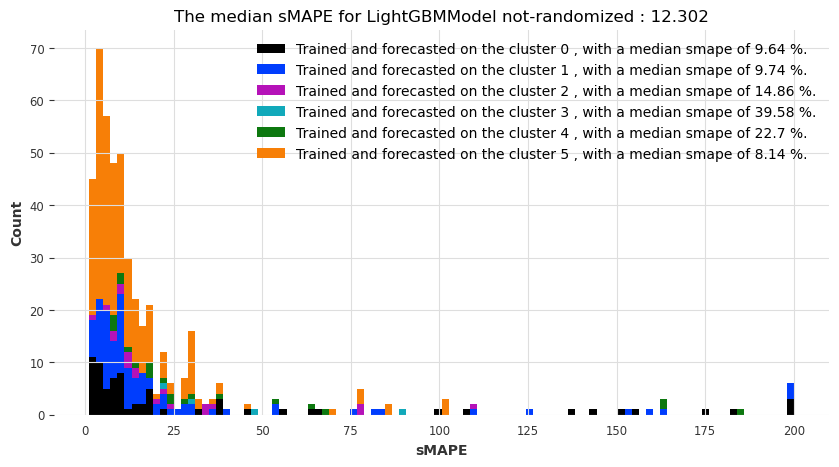

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 03:51:21,056] A new study created in memory with name: no-name-897da31c-5add-478b-a41d-5e7d26ecb8f6
[I 2023-01-28 03:51:30,052] Trial 0 finished with value: 13.946952723468284 and parameters: {'out_len': 2, 'n_estimators': 80, 'max_depth': 21}. Best is trial 0 with value: 13.946952723468284.
[I 2023-01-28 03:51:35,238] Trial 1 finished with value: 15.5023268679456 and parameters: {'out_len': 9, 'n_estimators': 64, 'max_depth': 22}. Best is trial 0 with value: 13.946952723468284.
[I 2023-01-28 03:51:41,663] Trial 2 finished with value: 15.075700561980142 and parameters: {'out_len': 8, 'n_estimators': 90, 'max_depth': 22}. Best is trial 0 with value: 13.946952723468284.
[I 2023-01-28 03:51:46,830] Trial 3 finished with value: 14.740294262320722 and parameters: {'out_len': 9, 'n_estimators': 65, 'max_depth': 14}. Best is trial 0 with value: 13.946952723468284.
[I 2023-01-28 03:51:54,675] Trial 4 finished with value: 12.973700420481943 and parameters: {'out_len': 4, 'n_estima

[I 2023-01-28 03:56:07,224] Trial 8 finished with value: 12.286826629395328 and parameters: {'out_len': 6, 'n_estimators': 69, 'max_depth': 26}. Best is trial 3 with value: 11.269146213329792.
[I 2023-01-28 03:56:13,387] Trial 9 finished with value: 10.980584520192679 and parameters: {'out_len': 2, 'n_estimators': 88, 'max_depth': 5}. Best is trial 9 with value: 10.980584520192679.
[I 2023-01-28 03:56:19,668] Trial 10 finished with value: 12.030202453789157 and parameters: {'out_len': 3, 'n_estimators': 82, 'max_depth': 6}. Best is trial 9 with value: 10.980584520192679.
[I 2023-01-28 03:56:30,253] Trial 11 finished with value: 13.02011841419528 and parameters: {'out_len': 1, 'n_estimators': 99, 'max_depth': 17}. Best is trial 9 with value: 10.980584520192679.
[I 2023-01-28 03:56:36,647] Trial 12 finished with value: 11.258324532091361 and parameters: {'out_len': 1, 'n_estimators': 89, 'max_depth': 5}. Best is trial 9 with value: 10.980584520192679.
[I 2023-01-28 03:56:42,831] Trial 13

[I 2023-01-28 04:00:49,329] Trial 2 finished with value: 8.861658225825133 and parameters: {'out_len': 7, 'n_estimators': 70, 'max_depth': 8}. Best is trial 2 with value: 8.861658225825133.
[I 2023-01-28 04:00:56,634] Trial 3 finished with value: 8.934004396265378 and parameters: {'out_len': 7, 'n_estimators': 92, 'max_depth': 19}. Best is trial 2 with value: 8.861658225825133.
[I 2023-01-28 04:01:02,002] Trial 4 finished with value: 9.171416434833054 and parameters: {'out_len': 8, 'n_estimators': 72, 'max_depth': 7}. Best is trial 2 with value: 8.861658225825133.
[I 2023-01-28 04:01:06,904] Trial 5 finished with value: 12.176975473483273 and parameters: {'out_len': 12, 'n_estimators': 89, 'max_depth': 30}. Best is trial 2 with value: 8.861658225825133.
[I 2023-01-28 04:01:11,318] Trial 6 finished with value: 13.329775984728439 and parameters: {'out_len': 11, 'n_estimators': 70, 'max_depth': 6}. Best is trial 2 with value: 8.861658225825133.
[I 2023-01-28 04:01:18,006] Trial 7 finished

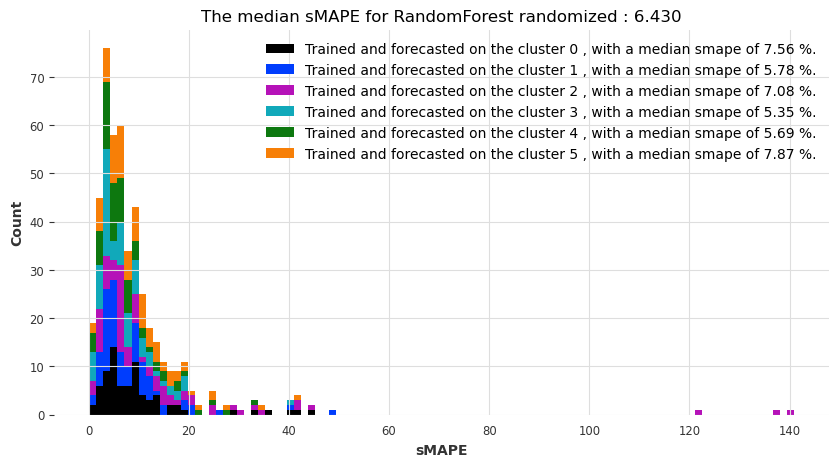

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 04:02:13,193] A new study created in memory with name: no-name-44a2de63-e0b4-428d-86a6-0f116cc1e434
[I 2023-01-28 04:02:19,954] Trial 0 finished with value: 10.745486068583883 and parameters: {'out_len': 5, 'n_estimators': 93, 'max_depth': 16}. Best is trial 0 with value: 10.745486068583883.
[I 2023-01-28 04:02:24,844] Trial 1 finished with value: 13.846464446348968 and parameters: {'out_len': 10, 'n_estimators': 82, 'max_depth': 27}. Best is trial 0 with value: 10.745486068583883.
[I 2023-01-28 04:02:32,139] Trial 2 finished with value: 11.478970733904351 and parameters: {'out_len': 2, 'n_estimators': 90, 'max_depth': 12}. Best is trial 0 with value: 10.745486068583883.
[I 2023-01-28 04:02:37,578] Trial 3 finished with value: 12.614187270846042 and parameters: {'out_len': 3, 'n_estimators': 50, 'max_depth': 18}. Best is trial 0 with value: 10.745486068583883.
[I 2023-01-28 04:02:45,865] Trial 4 finished with value: 11.397844103405253 and parameters: {'out_len': 3, 'n_est

[I 2023-01-28 04:06:04,276] Trial 9 finished with value: 40.398812677030264 and parameters: {'out_len': 12, 'n_estimators': 86, 'max_depth': 14}. Best is trial 5 with value: 26.10291016186501.
[I 2023-01-28 04:06:05,972] Trial 10 finished with value: 23.063075727337058 and parameters: {'out_len': 1, 'n_estimators': 81, 'max_depth': 24}. Best is trial 10 with value: 23.063075727337058.
[I 2023-01-28 04:06:07,598] Trial 11 finished with value: 19.012457405751515 and parameters: {'out_len': 1, 'n_estimators': 76, 'max_depth': 24}. Best is trial 11 with value: 19.012457405751515.
[I 2023-01-28 04:06:09,101] Trial 12 finished with value: 31.42644578994907 and parameters: {'out_len': 4, 'n_estimators': 77, 'max_depth': 24}. Best is trial 11 with value: 19.012457405751515.
[I 2023-01-28 04:06:10,739] Trial 13 finished with value: 22.001286552783593 and parameters: {'out_len': 1, 'n_estimators': 77, 'max_depth': 23}. Best is trial 11 with value: 19.012457405751515.
[I 2023-01-28 04:06:12,189] 

[I 2023-01-28 04:08:12,332] Trial 2 finished with value: 7.574293810466749 and parameters: {'out_len': 7, 'n_estimators': 59, 'max_depth': 24}. Best is trial 0 with value: 6.934453489626319.
[I 2023-01-28 04:08:40,371] Trial 3 finished with value: 7.298338460094634 and parameters: {'out_len': 2, 'n_estimators': 60, 'max_depth': 11}. Best is trial 0 with value: 6.934453489626319.
[I 2023-01-28 04:09:08,735] Trial 4 finished with value: 7.639828869142884 and parameters: {'out_len': 3, 'n_estimators': 72, 'max_depth': 26}. Best is trial 0 with value: 6.934453489626319.
[I 2023-01-28 04:09:35,516] Trial 5 finished with value: 6.622098078337634 and parameters: {'out_len': 1, 'n_estimators': 55, 'max_depth': 23}. Best is trial 5 with value: 6.622098078337634.
[I 2023-01-28 04:09:59,423] Trial 6 finished with value: 6.386352436026544 and parameters: {'out_len': 1, 'n_estimators': 53, 'max_depth': 14}. Best is trial 6 with value: 6.386352436026544.
[I 2023-01-28 04:10:21,819] Trial 7 finished 

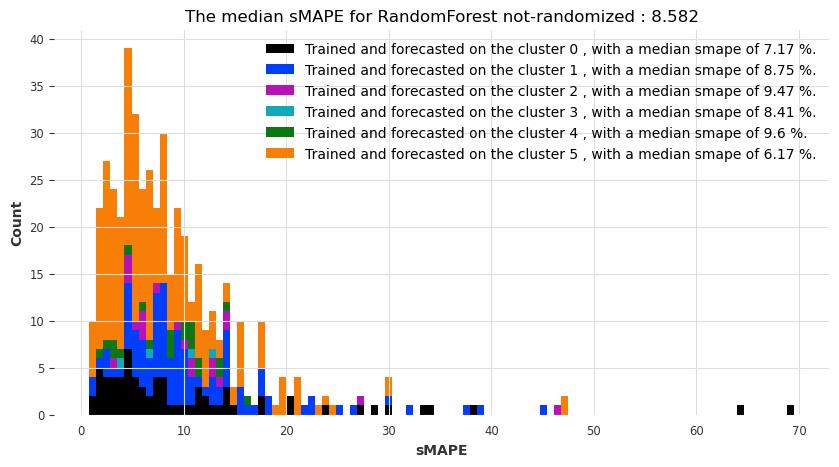

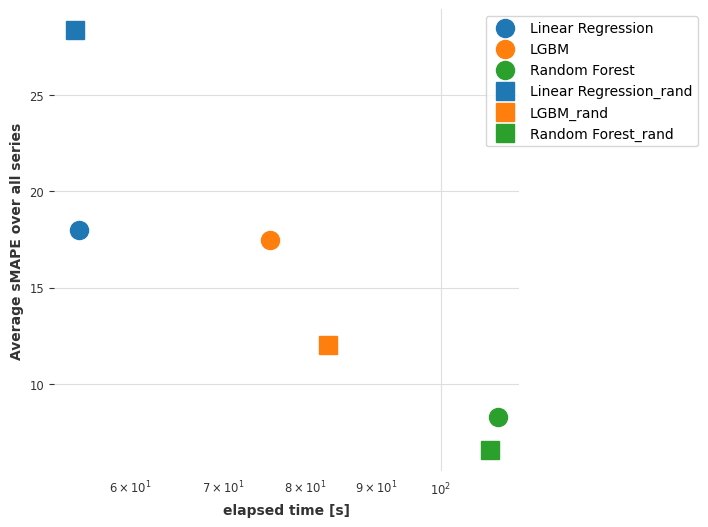

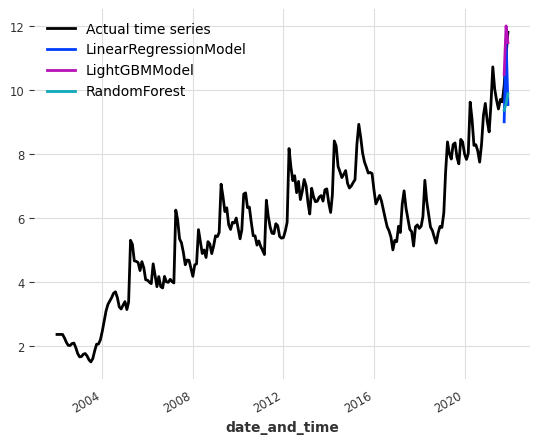

The results for index_keyword with an horizon of 6 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 04:13:14,319] A new study created in memory with name: no-name-6400d86f-0881-4dc6-a1e3-e9c4419552a1
[I 2023-01-28 04:13:17,321] Trial 0 finished with value: 51.016022377253094 and parameters: {'out_len': 11}. Best is trial 0 with value: 51.016022377253094.
[I 2023-01-28 04:13:20,320] Trial 1 finished with value: 32.946435131829205 and parameters: {'out_len': 8}. Best is trial 1 with value: 32.946435131829205.
[I 2023-01-28 04:13:24,347] Trial 2 finished with value: 56.249893970560585 and parameters: {'out_len': 10}. Best is trial 1 with value: 32.946435131829205.
[I 2023-01-28 04:13:27,337] Trial 3 finished with value: 23.436945344354562 and parameters: {'out_len': 4}. Best is trial 3 with value: 23.436945344354562.
[I 2023-01-28 04:13:30,353] Trial 4 finished with value: 23.436945344354562 and parameters: {'out_len': 4}. Best is trial 3 with value: 23.436945344354562.
[I 2023-01-28 04:13:33,409] Trial 5 finished with value: 26.039757678959766 and parameters: {'out_len': 

[I 2023-01-28 04:16:05,275] Trial 1 finished with value: 101.55543429515163 and parameters: {'out_len': 11}. Best is trial 0 with value: 28.445641383823652.
[I 2023-01-28 04:16:08,488] Trial 2 finished with value: 27.608998407286073 and parameters: {'out_len': 7}. Best is trial 2 with value: 27.608998407286073.
[I 2023-01-28 04:16:11,711] Trial 3 finished with value: 28.445641383823652 and parameters: {'out_len': 8}. Best is trial 2 with value: 27.608998407286073.
[I 2023-01-28 04:16:14,947] Trial 4 finished with value: 38.12187420667496 and parameters: {'out_len': 9}. Best is trial 2 with value: 27.608998407286073.
[I 2023-01-28 04:16:18,137] Trial 5 finished with value: 23.284515747123482 and parameters: {'out_len': 5}. Best is trial 5 with value: 23.284515747123482.
[I 2023-01-28 04:16:22,335] Trial 6 finished with value: 23.284515747123482 and parameters: {'out_len': 5}. Best is trial 5 with value: 23.284515747123482.
[I 2023-01-28 04:16:25,539] Trial 7 finished with value: 17.7526

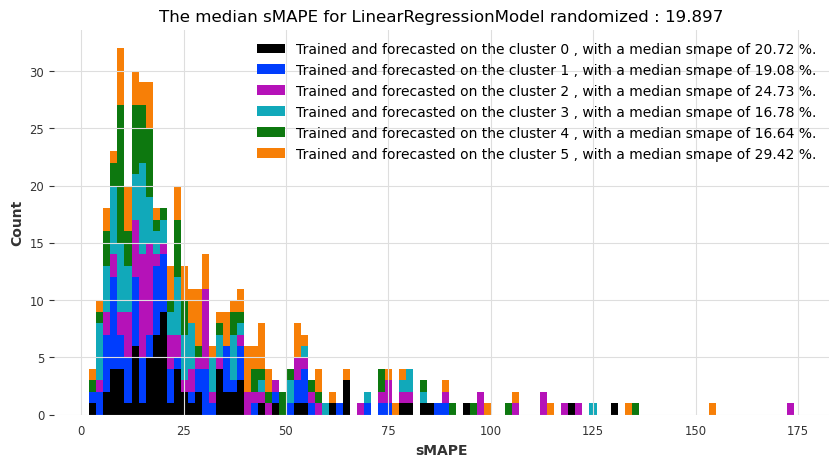

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 04:18:40,828] A new study created in memory with name: no-name-78fc7212-b738-4c01-af6a-563099264322
[I 2023-01-28 04:18:43,620] Trial 0 finished with value: 32.382425968275825 and parameters: {'out_len': 9}. Best is trial 0 with value: 32.382425968275825.
[I 2023-01-28 04:18:46,565] Trial 1 finished with value: 64.42937848454451 and parameters: {'out_len': 11}. Best is trial 0 with value: 32.382425968275825.
[I 2023-01-28 04:18:49,436] Trial 2 finished with value: 57.005431317973276 and parameters: {'out_len': 10}. Best is trial 0 with value: 32.382425968275825.
[I 2023-01-28 04:18:52,257] Trial 3 finished with value: 22.51636378702141 and parameters: {'out_len': 2}. Best is trial 3 with value: 22.51636378702141.
[I 2023-01-28 04:18:56,112] Trial 4 finished with value: 28.801885570019635 and parameters: {'out_len': 4}. Best is trial 3 with value: 22.51636378702141.
[I 2023-01-28 04:18:58,874] Trial 5 finished with value: 20.9863412172917 and parameters: {'out_len': 1}. Be

[I 2023-01-28 04:20:57,588] Trial 1 finished with value: 22.428597460687453 and parameters: {'out_len': 3}. Best is trial 1 with value: 22.428597460687453.
[I 2023-01-28 04:20:57,776] Trial 2 finished with value: 34.00091724402489 and parameters: {'out_len': 9}. Best is trial 1 with value: 22.428597460687453.
[I 2023-01-28 04:20:57,980] Trial 3 finished with value: 24.463812388415302 and parameters: {'out_len': 5}. Best is trial 1 with value: 22.428597460687453.
[I 2023-01-28 04:20:58,184] Trial 4 finished with value: 34.00091724402489 and parameters: {'out_len': 9}. Best is trial 1 with value: 22.428597460687453.
[I 2023-01-28 04:20:58,388] Trial 5 finished with value: 39.12697555548222 and parameters: {'out_len': 11}. Best is trial 1 with value: 22.428597460687453.
[I 2023-01-28 04:20:58,608] Trial 6 finished with value: 34.00091724402489 and parameters: {'out_len': 9}. Best is trial 1 with value: 22.428597460687453.
[I 2023-01-28 04:20:58,828] Trial 7 finished with value: 22.4285974

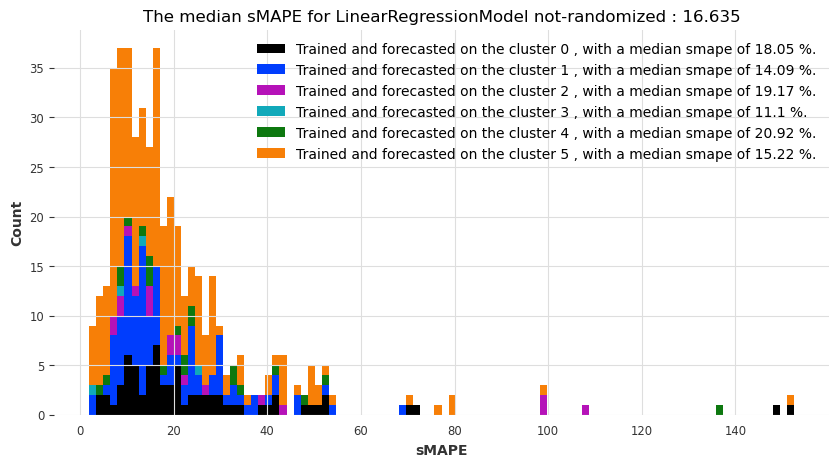

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 04:24:08,672] A new study created in memory with name: no-name-7a548975-4082-4a8a-959e-69a74e9811c8
[I 2023-01-28 04:24:12,971] Trial 0 finished with value: 31.50444531120467 and parameters: {'out_len': 12}. Best is trial 0 with value: 31.50444531120467.
[I 2023-01-28 04:24:18,147] Trial 1 finished with value: 17.49531944936706 and parameters: {'out_len': 8}. Best is trial 1 with value: 17.49531944936706.
[I 2023-01-28 04:24:22,253] Trial 2 finished with value: 11.623928783455103 and parameters: {'out_len': 2}. Best is trial 2 with value: 11.623928783455103.
[I 2023-01-28 04:24:27,458] Trial 3 finished with value: 18.126767068276912 and parameters: {'out_len': 7}. Best is trial 2 with value: 11.623928783455103.
[I 2023-01-28 04:24:32,067] Trial 4 finished with value: 11.176050227694503 and parameters: {'out_len': 1}. Best is trial 4 with value: 11.176050227694503.
[I 2023-01-28 04:24:37,178] Trial 5 finished with value: 12.849828043353618 and parameters: {'out_len': 4}. B

[I 2023-01-28 04:28:22,234] Trial 1 finished with value: 18.73009902576269 and parameters: {'out_len': 11}. Best is trial 0 with value: 18.73009902576269.
[I 2023-01-28 04:28:27,628] Trial 2 finished with value: 12.898708585097735 and parameters: {'out_len': 4}. Best is trial 2 with value: 12.898708585097735.
[I 2023-01-28 04:28:32,253] Trial 3 finished with value: 18.936126155323254 and parameters: {'out_len': 12}. Best is trial 2 with value: 12.898708585097735.
[I 2023-01-28 04:28:36,884] Trial 4 finished with value: 18.936126155323254 and parameters: {'out_len': 12}. Best is trial 2 with value: 12.898708585097735.
[I 2023-01-28 04:28:42,631] Trial 5 finished with value: 18.936126155323254 and parameters: {'out_len': 12}. Best is trial 2 with value: 12.898708585097735.
[I 2023-01-28 04:28:48,041] Trial 6 finished with value: 12.898708585097735 and parameters: {'out_len': 4}. Best is trial 2 with value: 12.898708585097735.
[I 2023-01-28 04:28:52,976] Trial 7 finished with value: 14.55

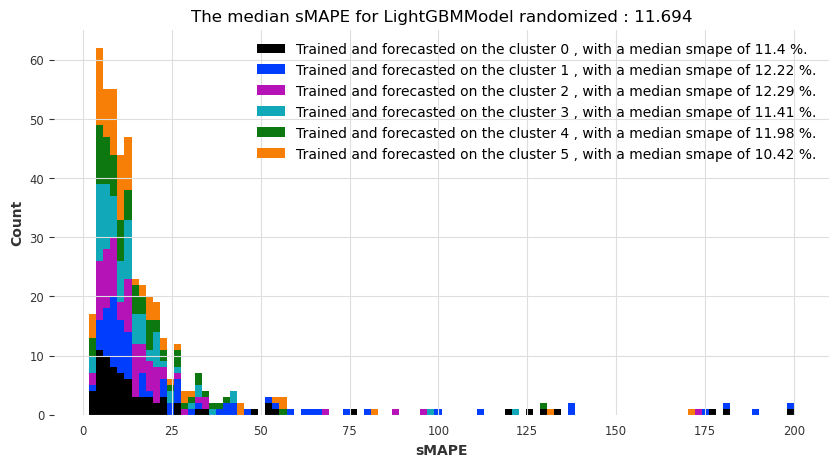

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 04:32:18,998] A new study created in memory with name: no-name-ec33a49e-e675-4505-a55c-efce0d6d6730
[I 2023-01-28 04:32:23,560] Trial 0 finished with value: 12.608509053754327 and parameters: {'out_len': 8}. Best is trial 0 with value: 12.608509053754327.
[I 2023-01-28 04:32:27,948] Trial 1 finished with value: 9.507890238526498 and parameters: {'out_len': 1}. Best is trial 1 with value: 9.507890238526498.
[I 2023-01-28 04:32:32,658] Trial 2 finished with value: 12.608509053754327 and parameters: {'out_len': 8}. Best is trial 1 with value: 9.507890238526498.
[I 2023-01-28 04:32:36,561] Trial 3 finished with value: 8.255342043165333 and parameters: {'out_len': 2}. Best is trial 3 with value: 8.255342043165333.
[I 2023-01-28 04:32:41,837] Trial 4 finished with value: 11.108949080698702 and parameters: {'out_len': 4}. Best is trial 3 with value: 8.255342043165333.
[I 2023-01-28 04:32:45,722] Trial 5 finished with value: 8.255342043165333 and parameters: {'out_len': 2}. Best 

[I 2023-01-28 04:35:47,502] Trial 1 finished with value: 76.00085503977202 and parameters: {'out_len': 11}. Best is trial 0 with value: 73.75299741134997.
[I 2023-01-28 04:35:47,752] Trial 2 finished with value: 73.57185314528873 and parameters: {'out_len': 3}. Best is trial 2 with value: 73.57185314528873.
[I 2023-01-28 04:35:48,019] Trial 3 finished with value: 73.53676839905927 and parameters: {'out_len': 4}. Best is trial 3 with value: 73.53676839905927.
[I 2023-01-28 04:35:48,301] Trial 4 finished with value: 73.56370326436351 and parameters: {'out_len': 5}. Best is trial 3 with value: 73.53676839905927.
[I 2023-01-28 04:35:48,568] Trial 5 finished with value: 73.41742652247676 and parameters: {'out_len': 6}. Best is trial 5 with value: 73.41742652247676.
[I 2023-01-28 04:35:48,851] Trial 6 finished with value: 73.56370326436351 and parameters: {'out_len': 5}. Best is trial 5 with value: 73.41742652247676.
[I 2023-01-28 04:35:49,134] Trial 7 finished with value: 74.31332104382744 

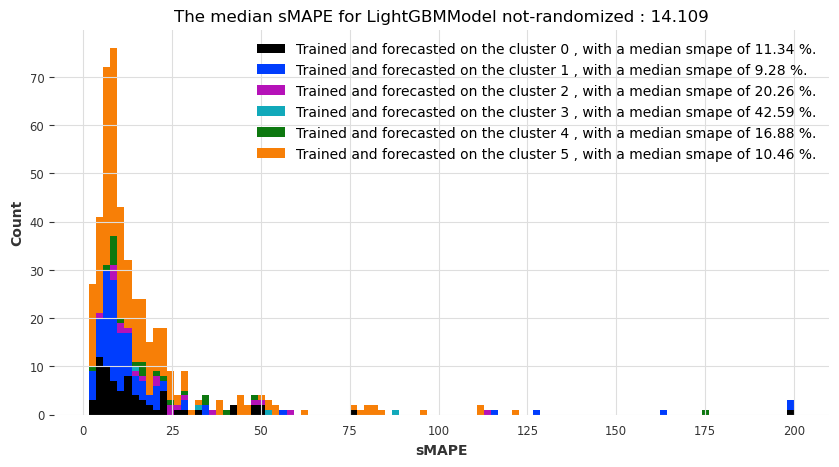

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 04:40:24,060] A new study created in memory with name: no-name-bc5f447b-f4ee-4738-a5fc-44b60ca27b2b
[I 2023-01-28 04:40:29,187] Trial 0 finished with value: 14.01771216901853 and parameters: {'out_len': 8, 'n_estimators': 58, 'max_depth': 22}. Best is trial 0 with value: 14.01771216901853.
[I 2023-01-28 04:40:33,591] Trial 1 finished with value: 16.246136993989776 and parameters: {'out_len': 12, 'n_estimators': 77, 'max_depth': 26}. Best is trial 0 with value: 14.01771216901853.
[I 2023-01-28 04:40:39,520] Trial 2 finished with value: 14.56198449953929 and parameters: {'out_len': 11, 'n_estimators': 82, 'max_depth': 24}. Best is trial 0 with value: 14.01771216901853.
[I 2023-01-28 04:40:44,245] Trial 3 finished with value: 16.778030739981578 and parameters: {'out_len': 12, 'n_estimators': 79, 'max_depth': 20}. Best is trial 0 with value: 14.01771216901853.
[I 2023-01-28 04:40:49,576] Trial 4 finished with value: 14.371490213283408 and parameters: {'out_len': 9, 'n_estimat

[I 2023-01-28 04:44:58,492] Trial 8 finished with value: 15.909226069959347 and parameters: {'out_len': 1, 'n_estimators': 85, 'max_depth': 29}. Best is trial 3 with value: 13.87003184205306.
[I 2023-01-28 04:45:07,112] Trial 9 finished with value: 14.883984247358898 and parameters: {'out_len': 2, 'n_estimators': 88, 'max_depth': 28}. Best is trial 3 with value: 13.87003184205306.
[I 2023-01-28 04:45:12,839] Trial 10 finished with value: 18.451189116426757 and parameters: {'out_len': 5, 'n_estimators': 51, 'max_depth': 21}. Best is trial 3 with value: 13.87003184205306.
[I 2023-01-28 04:45:18,116] Trial 11 finished with value: 15.573245019498653 and parameters: {'out_len': 8, 'n_estimators': 55, 'max_depth': 22}. Best is trial 3 with value: 13.87003184205306.
[I 2023-01-28 04:45:24,141] Trial 12 finished with value: 14.633704703003083 and parameters: {'out_len': 7, 'n_estimators': 67, 'max_depth': 24}. Best is trial 3 with value: 13.87003184205306.
[I 2023-01-28 04:45:31,334] Trial 13 

[I 2023-01-28 04:49:15,693] Trial 1 finished with value: 13.250945327245676 and parameters: {'out_len': 3, 'n_estimators': 53, 'max_depth': 5}. Best is trial 1 with value: 13.250945327245676.
[I 2023-01-28 04:49:21,634] Trial 2 finished with value: 14.78985536504973 and parameters: {'out_len': 10, 'n_estimators': 68, 'max_depth': 9}. Best is trial 1 with value: 13.250945327245676.
[I 2023-01-28 04:49:28,088] Trial 3 finished with value: 12.077729385134019 and parameters: {'out_len': 6, 'n_estimators': 76, 'max_depth': 11}. Best is trial 3 with value: 12.077729385134019.
[I 2023-01-28 04:49:36,538] Trial 4 finished with value: 13.384310080272988 and parameters: {'out_len': 2, 'n_estimators': 89, 'max_depth': 15}. Best is trial 3 with value: 12.077729385134019.
[I 2023-01-28 04:49:42,755] Trial 5 finished with value: 14.546437579792233 and parameters: {'out_len': 9, 'n_estimators': 93, 'max_depth': 12}. Best is trial 3 with value: 12.077729385134019.
[I 2023-01-28 04:49:51,384] Trial 6 f

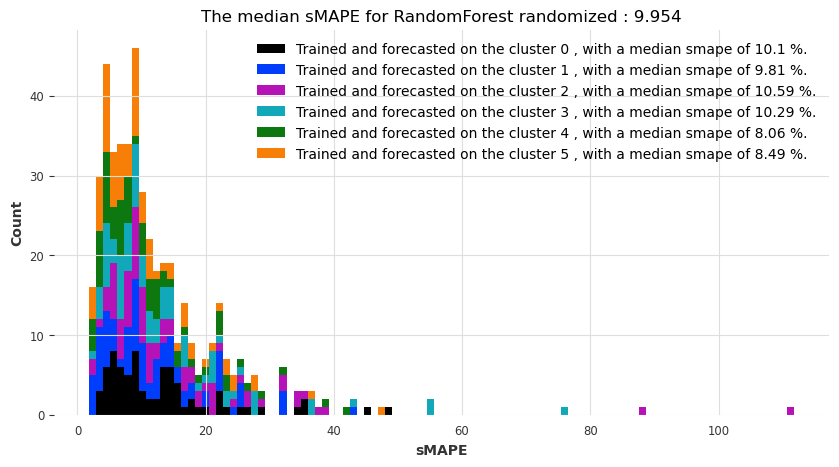

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 04:50:52,129] A new study created in memory with name: no-name-7500036e-49c0-4339-917a-8220305695f4
[I 2023-01-28 04:50:59,622] Trial 0 finished with value: 9.930790778104276 and parameters: {'out_len': 3, 'n_estimators': 97, 'max_depth': 21}. Best is trial 0 with value: 9.930790778104276.
[I 2023-01-28 04:51:04,541] Trial 1 finished with value: 11.494379710054647 and parameters: {'out_len': 7, 'n_estimators': 55, 'max_depth': 15}. Best is trial 0 with value: 9.930790778104276.
[I 2023-01-28 04:51:09,774] Trial 2 finished with value: 12.058758435453433 and parameters: {'out_len': 10, 'n_estimators': 98, 'max_depth': 24}. Best is trial 0 with value: 9.930790778104276.
[I 2023-01-28 04:51:14,534] Trial 3 finished with value: 9.370580626057535 and parameters: {'out_len': 6, 'n_estimators': 89, 'max_depth': 5}. Best is trial 3 with value: 9.370580626057535.
[I 2023-01-28 04:51:19,958] Trial 4 finished with value: 10.644961919707567 and parameters: {'out_len': 7, 'n_estimators

[I 2023-01-28 04:55:01,567] Trial 9 finished with value: 46.660495512028234 and parameters: {'out_len': 10, 'n_estimators': 100, 'max_depth': 6}. Best is trial 2 with value: 34.171810045679464.
[I 2023-01-28 04:55:03,192] Trial 10 finished with value: 35.095227652088106 and parameters: {'out_len': 2, 'n_estimators': 83, 'max_depth': 12}. Best is trial 2 with value: 34.171810045679464.
[I 2023-01-28 04:55:04,890] Trial 11 finished with value: 30.732134801397045 and parameters: {'out_len': 1, 'n_estimators': 86, 'max_depth': 12}. Best is trial 11 with value: 30.732134801397045.
[I 2023-01-28 04:55:06,633] Trial 12 finished with value: 31.957366259411163 and parameters: {'out_len': 1, 'n_estimators': 90, 'max_depth': 12}. Best is trial 11 with value: 30.732134801397045.
[I 2023-01-28 04:55:08,193] Trial 13 finished with value: 34.50490093439125 and parameters: {'out_len': 4, 'n_estimators': 86, 'max_depth': 13}. Best is trial 11 with value: 30.732134801397045.
[I 2023-01-28 04:55:09,781] 

[I 2023-01-28 04:57:21,960] Trial 3 finished with value: 9.709323656384221 and parameters: {'out_len': 5, 'n_estimators': 89, 'max_depth': 12}. Best is trial 2 with value: 9.515015947771403.
[I 2023-01-28 04:57:45,720] Trial 4 finished with value: 11.615025478271498 and parameters: {'out_len': 8, 'n_estimators': 80, 'max_depth': 23}. Best is trial 2 with value: 9.515015947771403.
[I 2023-01-28 04:58:19,024] Trial 5 finished with value: 10.510131107481364 and parameters: {'out_len': 1, 'n_estimators': 86, 'max_depth': 18}. Best is trial 2 with value: 9.515015947771403.
[I 2023-01-28 04:58:53,240] Trial 6 finished with value: 9.310349600203208 and parameters: {'out_len': 4, 'n_estimators': 92, 'max_depth': 15}. Best is trial 6 with value: 9.310349600203208.
[I 2023-01-28 04:59:11,333] Trial 7 finished with value: 11.942477879686765 and parameters: {'out_len': 9, 'n_estimators': 54, 'max_depth': 30}. Best is trial 6 with value: 9.310349600203208.
[I 2023-01-28 04:59:40,387] Trial 8 finish

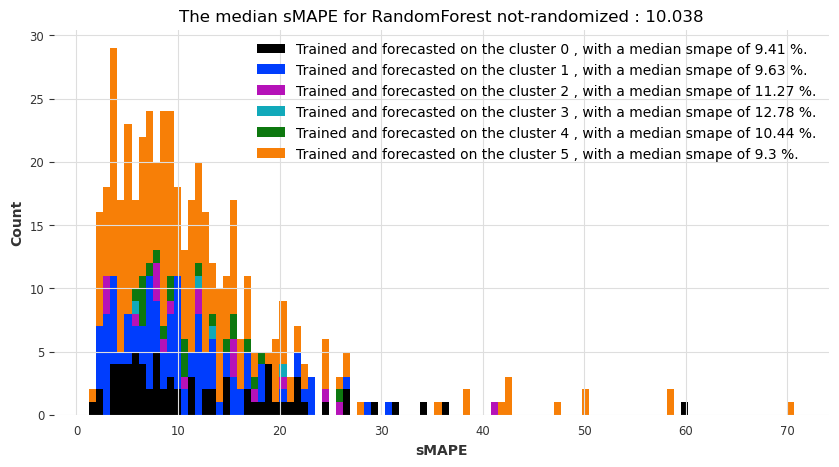

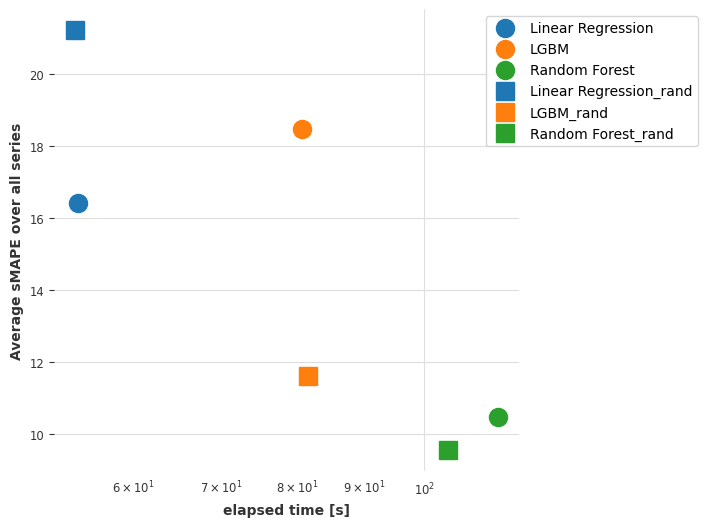

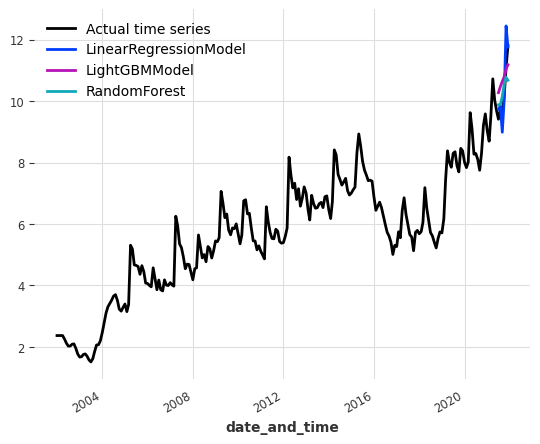

The results for index_keyword with an horizon of 12 are:
 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 05:02:16,884] A new study created in memory with name: no-name-dda2309f-0b71-4f63-b782-2cb9b90e5df5
[I 2023-01-28 05:02:19,859] Trial 0 finished with value: 33.69997986733611 and parameters: {'out_len': 6}. Best is trial 0 with value: 33.69997986733611.
[I 2023-01-28 05:02:22,958] Trial 1 finished with value: 99.23120886966134 and parameters: {'out_len': 12}. Best is trial 0 with value: 33.69997986733611.
[I 2023-01-28 05:02:26,004] Trial 2 finished with value: 75.38764583538668 and parameters: {'out_len': 11}. Best is trial 0 with value: 33.69997986733611.
[I 2023-01-28 05:02:29,067] Trial 3 finished with value: 79.66899877566703 and parameters: {'out_len': 10}. Best is trial 0 with value: 33.69997986733611.
[I 2023-01-28 05:02:32,003] Trial 4 finished with value: 27.59295802739299 and parameters: {'out_len': 2}. Best is trial 4 with value: 27.59295802739299.
[I 2023-01-28 05:02:34,978] Trial 5 finished with value: 33.69997986733611 and parameters: {'out_len': 6}. Best i

[I 2023-01-28 05:05:05,095] Trial 1 finished with value: 29.226049017215363 and parameters: {'out_len': 1}. Best is trial 1 with value: 29.226049017215363.
[I 2023-01-28 05:05:08,222] Trial 2 finished with value: 39.12133936752707 and parameters: {'out_len': 7}. Best is trial 1 with value: 29.226049017215363.
[I 2023-01-28 05:05:11,427] Trial 3 finished with value: 49.420758123807346 and parameters: {'out_len': 10}. Best is trial 1 with value: 29.226049017215363.
[I 2023-01-28 05:05:14,479] Trial 4 finished with value: 29.226049017215363 and parameters: {'out_len': 1}. Best is trial 1 with value: 29.226049017215363.
[I 2023-01-28 05:05:17,658] Trial 5 finished with value: 49.420758123807346 and parameters: {'out_len': 10}. Best is trial 1 with value: 29.226049017215363.
[I 2023-01-28 05:05:20,825] Trial 6 finished with value: 100.17810982748631 and parameters: {'out_len': 11}. Best is trial 1 with value: 29.226049017215363.
[I 2023-01-28 05:05:24,911] Trial 7 finished with value: 30.27

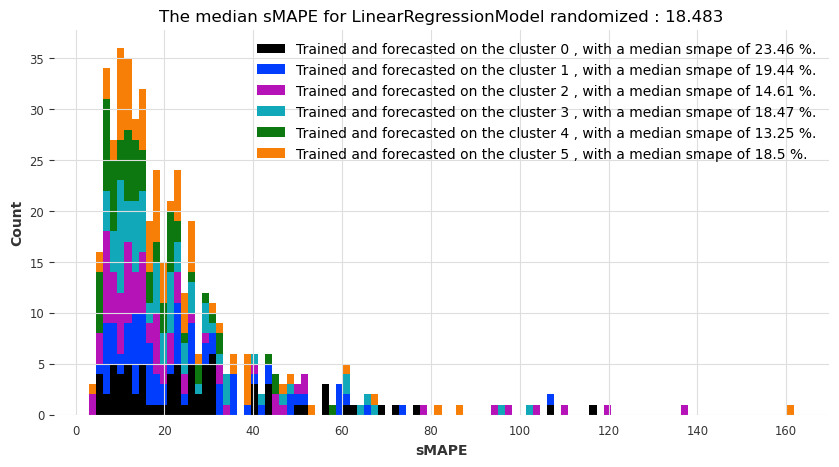

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 05:07:36,348] A new study created in memory with name: no-name-6c8ca787-6ff1-48cb-8f8f-687819b49215
[I 2023-01-28 05:07:39,046] Trial 0 finished with value: 41.57677161804725 and parameters: {'out_len': 9}. Best is trial 0 with value: 41.57677161804725.
[I 2023-01-28 05:07:41,808] Trial 1 finished with value: 25.849851462128704 and parameters: {'out_len': 5}. Best is trial 1 with value: 25.849851462128704.
[I 2023-01-28 05:07:44,571] Trial 2 finished with value: 25.849851462128704 and parameters: {'out_len': 5}. Best is trial 1 with value: 25.849851462128704.
[I 2023-01-28 05:07:48,370] Trial 3 finished with value: 65.03995098011022 and parameters: {'out_len': 10}. Best is trial 1 with value: 25.849851462128704.
[I 2023-01-28 05:07:51,133] Trial 4 finished with value: 32.08764876182774 and parameters: {'out_len': 6}. Best is trial 1 with value: 25.849851462128704.
[I 2023-01-28 05:07:53,896] Trial 5 finished with value: 25.849851462128704 and parameters: {'out_len': 5}. B

[I 2023-01-28 05:09:48,600] Trial 1 finished with value: 32.96601561469911 and parameters: {'out_len': 2}. Best is trial 0 with value: 26.058438860065888.
[I 2023-01-28 05:09:48,804] Trial 2 finished with value: 42.725012670524585 and parameters: {'out_len': 12}. Best is trial 0 with value: 26.058438860065888.
[I 2023-01-28 05:09:48,992] Trial 3 finished with value: 39.493987892136815 and parameters: {'out_len': 5}. Best is trial 0 with value: 26.058438860065888.
[I 2023-01-28 05:09:49,227] Trial 4 finished with value: 38.70276415574104 and parameters: {'out_len': 6}. Best is trial 0 with value: 26.058438860065888.
[I 2023-01-28 05:09:49,415] Trial 5 finished with value: 36.786575821337415 and parameters: {'out_len': 3}. Best is trial 0 with value: 26.058438860065888.
[I 2023-01-28 05:09:49,619] Trial 6 finished with value: 32.96601561469911 and parameters: {'out_len': 2}. Best is trial 0 with value: 26.058438860065888.
[I 2023-01-28 05:09:49,823] Trial 7 finished with value: 36.786575

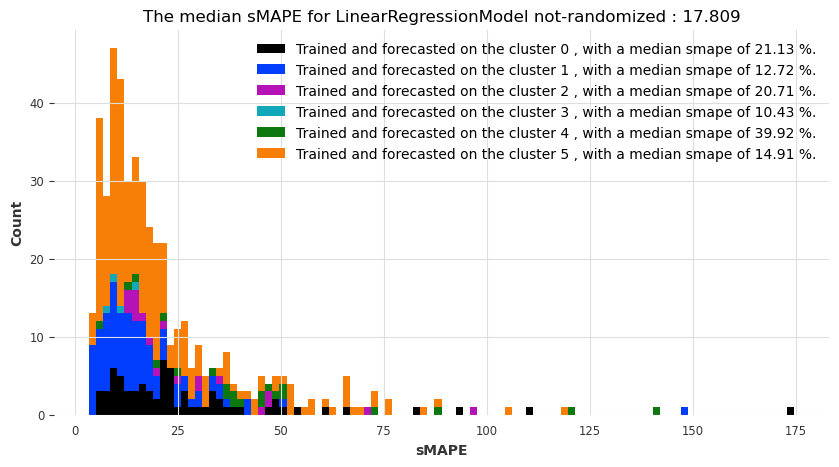

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 05:13:01,758] A new study created in memory with name: no-name-8dc4ecff-9b78-4b1c-8f4d-7115f6a7ba6a
[I 2023-01-28 05:13:06,316] Trial 0 finished with value: 29.370998541177144 and parameters: {'out_len': 11}. Best is trial 0 with value: 29.370998541177144.
[I 2023-01-28 05:13:12,604] Trial 1 finished with value: 17.89769162745625 and parameters: {'out_len': 6}. Best is trial 1 with value: 17.89769162745625.
[I 2023-01-28 05:13:16,146] Trial 2 finished with value: 16.223113726479966 and parameters: {'out_len': 1}. Best is trial 2 with value: 16.223113726479966.
[I 2023-01-28 05:13:20,784] Trial 3 finished with value: 29.370998541177144 and parameters: {'out_len': 11}. Best is trial 2 with value: 16.223113726479966.
[I 2023-01-28 05:13:25,963] Trial 4 finished with value: 19.145752380868167 and parameters: {'out_len': 8}. Best is trial 2 with value: 16.223113726479966.
[I 2023-01-28 05:13:30,573] Trial 5 finished with value: 16.909115725480504 and parameters: {'out_len': 3}

[I 2023-01-28 05:17:23,189] Trial 1 finished with value: 18.01130554598385 and parameters: {'out_len': 9}. Best is trial 0 with value: 17.20943046271582.
[I 2023-01-28 05:17:28,959] Trial 2 finished with value: 18.333709104045628 and parameters: {'out_len': 6}. Best is trial 0 with value: 17.20943046271582.
[I 2023-01-28 05:17:34,838] Trial 3 finished with value: 19.655765145094826 and parameters: {'out_len': 11}. Best is trial 0 with value: 17.20943046271582.
[I 2023-01-28 05:17:39,183] Trial 4 finished with value: 18.459079488707008 and parameters: {'out_len': 2}. Best is trial 0 with value: 17.20943046271582.
[I 2023-01-28 05:17:43,911] Trial 5 finished with value: 18.459079488707008 and parameters: {'out_len': 2}. Best is trial 0 with value: 17.20943046271582.
[I 2023-01-28 05:17:49,756] Trial 6 finished with value: 18.333709104045628 and parameters: {'out_len': 6}. Best is trial 0 with value: 17.20943046271582.
[I 2023-01-28 05:17:55,259] Trial 7 finished with value: 18.0113055459

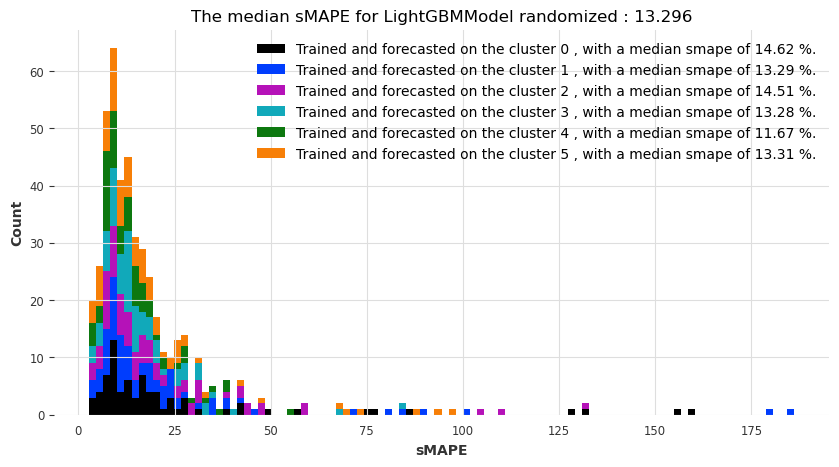

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 05:21:31,780] A new study created in memory with name: no-name-c5c69dfe-e04b-4e95-b4dc-d2fc55fd8649
[I 2023-01-28 05:21:35,587] Trial 0 finished with value: 17.758070215633573 and parameters: {'out_len': 12}. Best is trial 0 with value: 17.758070215633573.
[I 2023-01-28 05:21:40,266] Trial 1 finished with value: 10.976741319673106 and parameters: {'out_len': 5}. Best is trial 1 with value: 10.976741319673106.
[I 2023-01-28 05:21:45,413] Trial 2 finished with value: 10.756481511446667 and parameters: {'out_len': 7}. Best is trial 2 with value: 10.756481511446667.
[I 2023-01-28 05:21:49,928] Trial 3 finished with value: 13.08569402265643 and parameters: {'out_len': 9}. Best is trial 2 with value: 10.756481511446667.
[I 2023-01-28 05:21:53,925] Trial 4 finished with value: 17.758070215633573 and parameters: {'out_len': 12}. Best is trial 2 with value: 10.756481511446667.
[I 2023-01-28 05:21:58,549] Trial 5 finished with value: 10.759712730220782 and parameters: {'out_len': 4

[I 2023-01-28 05:24:59,508] Trial 1 finished with value: 49.06698334377435 and parameters: {'out_len': 2}. Best is trial 1 with value: 49.06698334377435.
[I 2023-01-28 05:24:59,774] Trial 2 finished with value: 71.8244783087701 and parameters: {'out_len': 5}. Best is trial 1 with value: 49.06698334377435.
[I 2023-01-28 05:25:00,073] Trial 3 finished with value: 71.94124964699776 and parameters: {'out_len': 7}. Best is trial 1 with value: 49.06698334377435.
[I 2023-01-28 05:25:00,403] Trial 4 finished with value: 71.88057118859479 and parameters: {'out_len': 11}. Best is trial 1 with value: 49.06698334377435.
[I 2023-01-28 05:25:00,717] Trial 5 finished with value: 71.93016570227996 and parameters: {'out_len': 10}. Best is trial 1 with value: 49.06698334377435.
[I 2023-01-28 05:25:01,015] Trial 6 finished with value: 49.06698334377435 and parameters: {'out_len': 2}. Best is trial 1 with value: 49.06698334377435.
[I 2023-01-28 05:25:01,297] Trial 7 finished with value: 49.06698334377435 

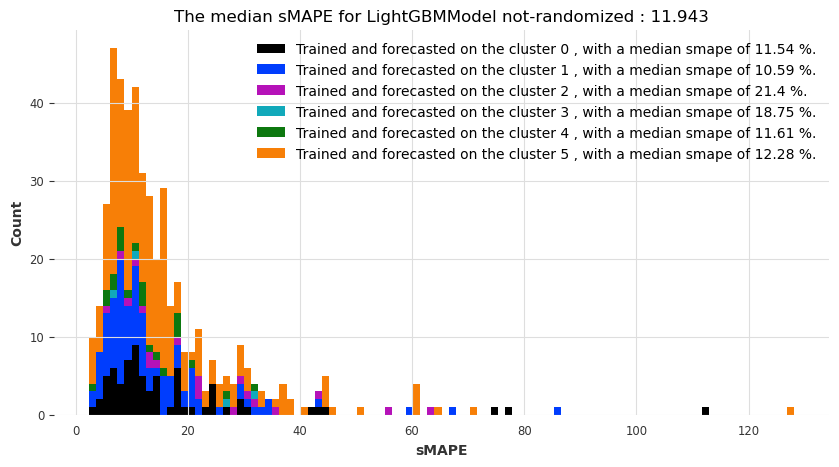

 
Randomized clustering


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 05:29:40,444] A new study created in memory with name: no-name-17be1c66-2997-4e8e-b359-4f79b90391ed
[I 2023-01-28 05:29:46,861] Trial 0 finished with value: 16.055153091679255 and parameters: {'out_len': 6, 'n_estimators': 82, 'max_depth': 13}. Best is trial 0 with value: 16.055153091679255.
[I 2023-01-28 05:29:52,097] Trial 1 finished with value: 14.263087875134334 and parameters: {'out_len': 8, 'n_estimators': 65, 'max_depth': 27}. Best is trial 1 with value: 14.263087875134334.
[I 2023-01-28 05:29:57,423] Trial 2 finished with value: 15.551276553470853 and parameters: {'out_len': 7, 'n_estimators': 61, 'max_depth': 13}. Best is trial 1 with value: 14.263087875134334.
[I 2023-01-28 05:30:02,177] Trial 3 finished with value: 15.331556519580996 and parameters: {'out_len': 9, 'n_estimators': 55, 'max_depth': 23}. Best is trial 1 with value: 14.263087875134334.
[I 2023-01-28 05:30:08,382] Trial 4 finished with value: 16.203768830916992 and parameters: {'out_len': 4, 'n_esti

[I 2023-01-28 05:34:09,523] Trial 8 finished with value: 16.565779403327543 and parameters: {'out_len': 1, 'n_estimators': 91, 'max_depth': 8}. Best is trial 1 with value: 15.513135577435367.
[I 2023-01-28 05:34:15,117] Trial 9 finished with value: 20.613001866642257 and parameters: {'out_len': 9, 'n_estimators': 59, 'max_depth': 7}. Best is trial 1 with value: 15.513135577435367.
[I 2023-01-28 05:34:20,950] Trial 10 finished with value: 18.865050257057526 and parameters: {'out_len': 7, 'n_estimators': 62, 'max_depth': 26}. Best is trial 1 with value: 15.513135577435367.
[I 2023-01-28 05:34:27,535] Trial 11 finished with value: 17.67693020312679 and parameters: {'out_len': 5, 'n_estimators': 70, 'max_depth': 19}. Best is trial 1 with value: 15.513135577435367.
[I 2023-01-28 05:34:34,020] Trial 12 finished with value: 17.540081741133914 and parameters: {'out_len': 5, 'n_estimators': 68, 'max_depth': 18}. Best is trial 1 with value: 15.513135577435367.
[I 2023-01-28 05:34:40,650] Trial 1

[I 2023-01-28 05:38:40,298] Trial 1 finished with value: 17.791320114986803 and parameters: {'out_len': 12, 'n_estimators': 98, 'max_depth': 21}. Best is trial 0 with value: 17.11486767438515.
[I 2023-01-28 05:38:48,539] Trial 2 finished with value: 14.428602524210534 and parameters: {'out_len': 1, 'n_estimators': 82, 'max_depth': 20}. Best is trial 2 with value: 14.428602524210534.
[I 2023-01-28 05:38:56,184] Trial 3 finished with value: 18.829599323988568 and parameters: {'out_len': 2, 'n_estimators': 78, 'max_depth': 16}. Best is trial 2 with value: 14.428602524210534.
[I 2023-01-28 05:39:02,409] Trial 4 finished with value: 16.829746253844718 and parameters: {'out_len': 7, 'n_estimators': 76, 'max_depth': 20}. Best is trial 2 with value: 14.428602524210534.
[I 2023-01-28 05:39:12,080] Trial 5 finished with value: 18.752154614808415 and parameters: {'out_len': 2, 'n_estimators': 96, 'max_depth': 26}. Best is trial 2 with value: 14.428602524210534.
[I 2023-01-28 05:39:17,884] Trial 6

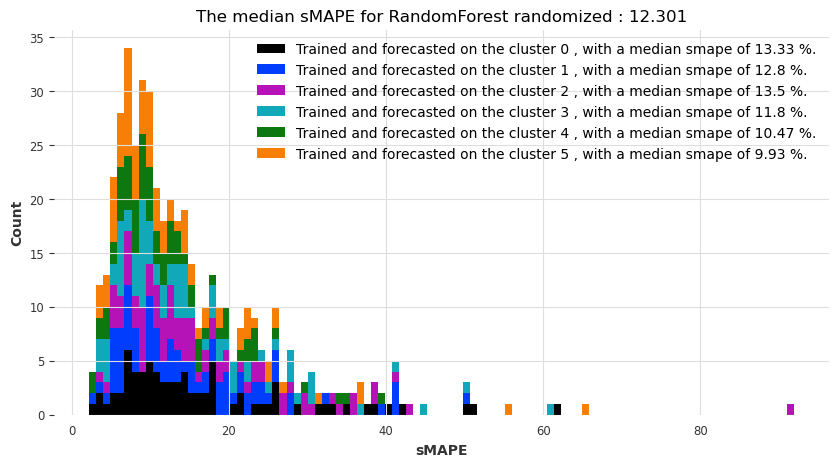

Algorithmic clustering based on similarity


  0%|          | 0/6 [00:00<?, ?it/s]

[I 2023-01-28 05:40:26,120] A new study created in memory with name: no-name-df8f1b14-eb89-4728-92dd-7daaabf68910
[I 2023-01-28 05:40:32,001] Trial 0 finished with value: 13.707491784778222 and parameters: {'out_len': 1, 'n_estimators': 64, 'max_depth': 29}. Best is trial 0 with value: 13.707491784778222.
[I 2023-01-28 05:40:38,439] Trial 1 finished with value: 10.57705216359487 and parameters: {'out_len': 5, 'n_estimators': 92, 'max_depth': 28}. Best is trial 1 with value: 10.57705216359487.
[I 2023-01-28 05:40:44,521] Trial 2 finished with value: 9.69217662165979 and parameters: {'out_len': 8, 'n_estimators': 100, 'max_depth': 11}. Best is trial 2 with value: 9.69217662165979.
[I 2023-01-28 05:40:49,286] Trial 3 finished with value: 10.15691444076785 and parameters: {'out_len': 7, 'n_estimators': 59, 'max_depth': 24}. Best is trial 2 with value: 9.69217662165979.
[I 2023-01-28 05:40:53,606] Trial 4 finished with value: 9.748042537549596 and parameters: {'out_len': 11, 'n_estimators':

[I 2023-01-28 05:44:26,215] Trial 9 finished with value: 49.47850437830514 and parameters: {'out_len': 8, 'n_estimators': 100, 'max_depth': 12}. Best is trial 7 with value: 36.51116755228001.
[I 2023-01-28 05:44:27,894] Trial 10 finished with value: 47.36782197672035 and parameters: {'out_len': 1, 'n_estimators': 85, 'max_depth': 20}. Best is trial 7 with value: 36.51116755228001.
[I 2023-01-28 05:44:28,900] Trial 11 finished with value: 41.43767801963247 and parameters: {'out_len': 12, 'n_estimators': 67, 'max_depth': 9}. Best is trial 7 with value: 36.51116755228001.
[I 2023-01-28 05:44:29,999] Trial 12 finished with value: 43.39172949994287 and parameters: {'out_len': 10, 'n_estimators': 69, 'max_depth': 30}. Best is trial 7 with value: 36.51116755228001.
[I 2023-01-28 05:44:31,067] Trial 13 finished with value: 33.21423900862048 and parameters: {'out_len': 10, 'n_estimators': 64, 'max_depth': 21}. Best is trial 13 with value: 33.21423900862048.
[I 2023-01-28 05:44:32,152] Trial 14 

[I 2023-01-28 05:46:48,402] Trial 3 finished with value: 13.61620852374913 and parameters: {'out_len': 3, 'n_estimators': 89, 'max_depth': 26}. Best is trial 1 with value: 13.374685346433514.
[I 2023-01-28 05:47:11,385] Trial 4 finished with value: 13.018886854054182 and parameters: {'out_len': 2, 'n_estimators': 78, 'max_depth': 8}. Best is trial 4 with value: 13.018886854054182.
[I 2023-01-28 05:47:37,140] Trial 5 finished with value: 13.045639854895732 and parameters: {'out_len': 6, 'n_estimators': 86, 'max_depth': 20}. Best is trial 4 with value: 13.018886854054182.
[I 2023-01-28 05:47:56,144] Trial 6 finished with value: 13.52482553466564 and parameters: {'out_len': 9, 'n_estimators': 63, 'max_depth': 18}. Best is trial 4 with value: 13.018886854054182.
[I 2023-01-28 05:48:16,586] Trial 7 finished with value: 13.19334747278347 and parameters: {'out_len': 9, 'n_estimators': 80, 'max_depth': 17}. Best is trial 4 with value: 13.018886854054182.
[I 2023-01-28 05:48:47,849] Trial 8 fin

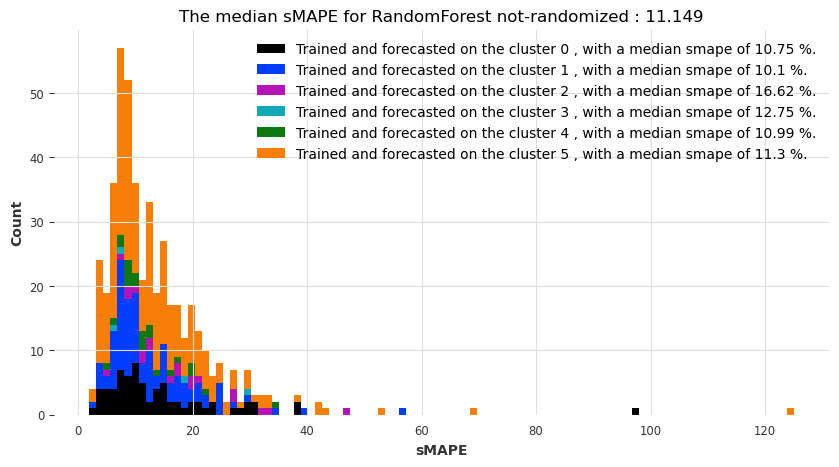

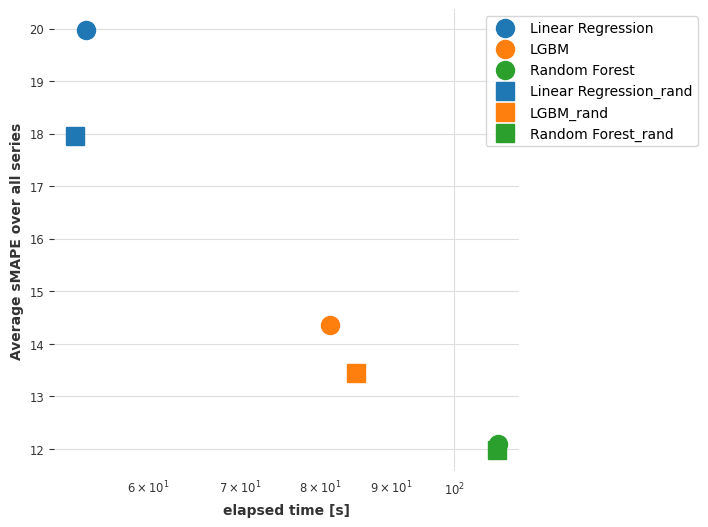

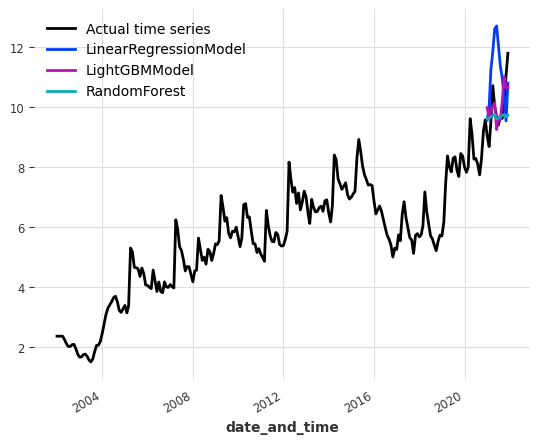

In [363]:
info_table = []

global horizon

for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    listindex_byalgo=[]
    dfofindex_rand = dftm_rand.loc[dftm_rand['indextype']==index]
    
    
    for horizon in [3,6,12]:
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        lr_smapes,lgbm_smapes,rf_smapes,lr_smapes_rand,lgbm_smapes_rand,rf_smapes_rand\
        =clustering_forecasting(dfofindex,dfofindex_rand,horizon,numbercluster,list_concepts,1,15)
        
        listindex_byalgo=listindex_byalgo+\
        [lr_smapes,lgbm_smapes,rf_smapes,lr_smapes_rand,lgbm_smapes_rand,\
        rf_smapes_rand]

        
        plot_forecasting_models_global(modelnames,myforecasters,dfofindex,horizon,index) 
        
    list_toappend=[]    
    for i in range(6):
        for j in range(3):
            list_toappend.append(listindex_byalgo[i+j*6])
    info_table.append(list_toappend)

not randomized clustering

In [364]:
iterables = [["Linear Regression","LGBM", "Random Forest"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0][:9], 'Index citations t2-t1': info_table[1][:9],
                   'Index colaboration incremental': info_table[2][:9],'colaboration not incremental':info_table[3][:9],
                   'Index keywords': info_table[4][:9]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                         41.316777   
                     6 months                         75.349367   
                     12 months                        59.144846   
LGBM                 3 months                         59.176532   
                     6 months                         49.160538   
                     12 months                        50.327261   
Random Forest        3 months                          8.249618   
                     6 months                          5.901076   
                     12 months                        11.940786   

                                          Index citations t2-t1  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                         39.453267   
                     6 months                         35.251810   
                     12 months                        45.089670   
LGBM                 3 months                         15.894548   
                     6 months                         15.479267   
                     12 months                        21.864207   
Random Forest        3 months                          4.475133   
                     6 months                          6.051961   
                     12 months                         5.114899   

                                          Index colaboration incremental  \
Forecaster algorithm Forecasting horizon                                   
Linear Regression    3 months                                  84.322925   
                     6 months                                  82.198344   
                     12 months                                100.351919   
LGBM                 3 months                                  80.056040   
                     6 months                                  70.921868   
                     12 months                                 56.162919   
Random Forest        3 months                                  41.615026   
                     6 months                                  43.247641   
                     12 months                                 65.719616   

                                          colaboration not incremental  \
Forecaster algorithm Forecasting horizon                                 
Linear Regression    3 months                                98.186837   
                     6 months                                82.755193   
                     12 months                               89.807070   
LGBM                 3 months                               108.496861   
                     6 months                                84.614370   
                     12 months                               85.096960   
Random Forest        3 months                                31.413510   
                     6 months                                33.062002   
                     12 months                               38.290974   

                                          Index keywords  
Forecaster algorithm Forecasting horizon                  
Linear Regression    3 months                  17.974364  
                     6 months                  16.425074  
                     12 months                 19.969668  
LGBM                 3 months                  17.443451  
                     6 months                  18.468212  
                     12 months                 14.360488  
Random Forest        3 months                   8.261528  
                     6 months                  10.473481  
                     12 months                 12.086119

randomized clustering

In [365]:
iterables = [["Linear Regression","LGBM", "Random Forest"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0][9:], 'Index citations t2-t1': info_table[1][9:],
                   'Index colaboration incremental': info_table[2][9:],'colaboration not incremental':info_table[3][9:],
                   'Index keywords': info_table[4][9:]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                         74.098019   
                     6 months                         37.843768   
                     12 months                        32.312216   
LGBM                 3 months                         36.735704   
                     6 months                         38.915397   
                     12 months                        24.947747   
Random Forest        3 months                          3.068277   
                     6 months                          4.192774   
                     12 months                         2.974348   

                                          Index citations t2-t1  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                         33.657905   
                     6 months                         45.830615   
                     12 months                        26.546501   
LGBM                 3 months                         32.329806   
                     6 months                         30.486776   
                     12 months                        20.944595   
Random Forest        3 months                          2.369402   
                     6 months                          2.460809   
                     12 months                         5.552056   

                                          Index colaboration incremental  \
Forecaster algorithm Forecasting horizon                                   
Linear Regression    3 months                                 116.383939   
                     6 months                                  76.634246   
                     12 months                                 78.060466   
LGBM                 3 months                                  73.202652   
                     6 months                                  48.726922   
                     12 months                                 53.040457   
Random Forest        3 months                                  19.412989   
                     6 months                                  28.808807   
                     12 months                                 43.028235   

                                          colaboration not incremental  \
Forecaster algorithm Forecasting horizon                                 
Linear Regression    3 months                               128.495952   
                     6 months                                62.152582   
                     12 months                               69.871607   
LGBM                 3 months                                79.813092   
                     6 months                                51.470901   
                     12 months                               44.722286   
Random Forest        3 months                                19.017123   
                     6 months                                27.107513   
                     12 months                               37.127506   

                                          Index keywords  
Forecaster algorithm Forecasting horizon                  
Linear Regression    3 months                  28.368643  
                     6 months                  21.227741  
                     12 months                 17.955097  
LGBM                 3 months                  11.998116  
                     6 months                  11.618011  
                     12 months                 13.446113  
Random Forest        3 months                   6.554992  
                     6 months                   9.557112  
                     12 months                 11.972688

As a conclusion, we observe that randomized clustering are better than not randomized clustering. For this reason, probably, global forecasting will be better than clustering forecasting. In addition, clustering forecasting performs worse than local forecasting, this can be seen looking at the errors. Random forests and linear regression are the models which perform the best overall.

# **Part 3 -- Global forecasting based on my own data**

This takes 12 hours to run.

In [366]:
def global_forecasting_mydata(dftm,horizon,list_concepts,number_cv,n_trials):

    # regression models
            
    lr_time, lr_smapes_mean,lr_smapes_med =\
    cross_validation_expanding_window_global(dftm,\
    horizon,list_concepts,number_cv,'LinearRegressionModel', LinearRegressionModel,n_trials)
    
    lgbm_time, lgbm_smapes_mean,lgbm_smapes_med =\
    cross_validation_expanding_window_global(dftm,\
    horizon,list_concepts,number_cv,'LightGBMModel', LightGBMModel,n_trials)
  
    rf_time, rf_smapes_mean,rf_smapes_med\
    =cross_validation_expanding_window_global(dftm,\
    horizon,list_concepts,number_cv,'RandomForest', RandomForest,n_trials)
    
    
    smapes_mean = {
        "Linear Regression": lr_smapes_mean,
        "LGBM": lgbm_smapes_mean,
        "Random Forest": rf_smapes_mean
    }

    elapsed_times = {
        "Linear Regression": lr_time,
        "LGBM": lgbm_time,
        "Random Forest": rf_time
    }

    smapes_med = {
        "Linear Regression": lr_smapes_med,
        "LGBM": lgbm_smapes_med,
        "Random Forest": rf_smapes_med
    }


    print('Visualization of performances taking the mean of the smapes over cross-validation')
    plot_models_global(elapsed_times, smapes_mean)
    
        
    print('Visualization of performances taking the median of the smapes over cross-validation')
    plot_models_global(elapsed_times, smapes_med)
    
    return lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean

In [367]:
myforecasters = [LinearRegressionModel,LightGBMModel,RandomForest]
modelnames = ["LinearRegressionModel","LightGBMModel","RandomForest"]

The results for index_cit_t1_t2 are:
The results for index_cit_t1_t2 with an horizon of 3 are:


[I 2023-01-28 05:51:14,465] A new study created in memory with name: no-name-1185aabc-1f28-4746-ba04-d027b4cc4858
[I 2023-01-28 05:51:17,700] Trial 0 finished with value: 79.04032969801501 and parameters: {'out_len': 1}. Best is trial 0 with value: 79.04032969801501.
[I 2023-01-28 05:51:21,586] Trial 1 finished with value: 82.65431219257748 and parameters: {'out_len': 9}. Best is trial 0 with value: 79.04032969801501.
[I 2023-01-28 05:51:25,573] Trial 2 finished with value: 80.9551483082483 and parameters: {'out_len': 10}. Best is trial 0 with value: 79.04032969801501.
[I 2023-01-28 05:51:29,480] Trial 3 finished with value: 82.65431219257748 and parameters: {'out_len': 9}. Best is trial 0 with value: 79.04032969801501.
[I 2023-01-28 05:51:32,861] Trial 4 finished with value: 78.73143593855843 and parameters: {'out_len': 2}. Best is trial 4 with value: 78.73143593855843.
[I 2023-01-28 05:51:36,432] Trial 5 finished with value: 80.4663810287377 and parameters: {'out_len': 4}. Best is tr

[I 2023-01-28 05:58:01,277] Trial 1 finished with value: 81.90506173607426 and parameters: {'out_len': 10}. Best is trial 0 with value: 77.993714448956.
[I 2023-01-28 05:58:15,756] Trial 2 finished with value: 77.286917876959 and parameters: {'out_len': 4}. Best is trial 2 with value: 77.286917876959.
[I 2023-01-28 05:58:31,434] Trial 3 finished with value: 74.048136678189 and parameters: {'out_len': 6}. Best is trial 3 with value: 74.048136678189.
[I 2023-01-28 05:58:46,720] Trial 4 finished with value: 78.3217451706143 and parameters: {'out_len': 9}. Best is trial 3 with value: 74.048136678189.
[I 2023-01-28 05:59:01,589] Trial 5 finished with value: 76.98885641866131 and parameters: {'out_len': 7}. Best is trial 3 with value: 74.048136678189.
[I 2023-01-28 05:59:17,073] Trial 6 finished with value: 72.78247938629137 and parameters: {'out_len': 3}. Best is trial 6 with value: 72.78247938629137.
[I 2023-01-28 05:59:34,451] Trial 7 finished with value: 77.92307530943438 and parameters:

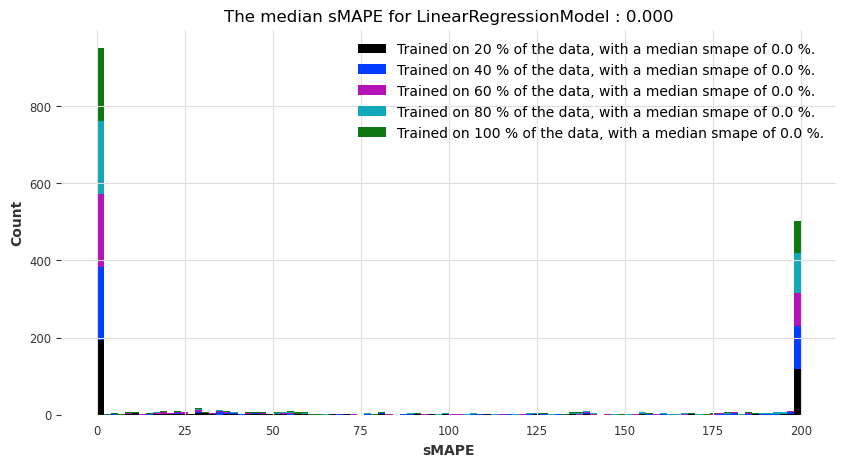

[I 2023-01-28 06:06:56,715] A new study created in memory with name: no-name-6d0eb6eb-6e3f-4b2d-8bb4-0f99cf28163f
[I 2023-01-28 06:07:02,024] Trial 0 finished with value: 81.70639933319805 and parameters: {'out_len': 9}. Best is trial 0 with value: 81.70639933319805.
[I 2023-01-28 06:07:07,388] Trial 1 finished with value: 85.59516278942877 and parameters: {'out_len': 10}. Best is trial 0 with value: 81.70639933319805.
[I 2023-01-28 06:07:11,526] Trial 2 finished with value: 77.33840167169411 and parameters: {'out_len': 3}. Best is trial 2 with value: 77.33840167169411.
[I 2023-01-28 06:07:16,848] Trial 3 finished with value: 83.88584789512758 and parameters: {'out_len': 11}. Best is trial 2 with value: 77.33840167169411.
[I 2023-01-28 06:07:20,923] Trial 4 finished with value: 77.33840167169411 and parameters: {'out_len': 3}. Best is trial 2 with value: 77.33840167169411.
[I 2023-01-28 06:07:26,012] Trial 5 finished with value: 82.13472784333781 and parameters: {'out_len': 7}. Best is

[I 2023-01-28 06:15:12,048] Trial 1 finished with value: 67.68772038385912 and parameters: {'out_len': 12}. Best is trial 0 with value: 67.68772038385912.
[I 2023-01-28 06:15:33,899] Trial 2 finished with value: 67.68772038385912 and parameters: {'out_len': 12}. Best is trial 0 with value: 67.68772038385912.
[I 2023-01-28 06:15:54,831] Trial 3 finished with value: 67.68772038385912 and parameters: {'out_len': 12}. Best is trial 0 with value: 67.68772038385912.
[I 2023-01-28 06:16:13,280] Trial 4 finished with value: 65.31997560903358 and parameters: {'out_len': 4}. Best is trial 4 with value: 65.31997560903358.
[I 2023-01-28 06:16:31,595] Trial 5 finished with value: 65.96701541629014 and parameters: {'out_len': 5}. Best is trial 4 with value: 65.31997560903358.
[I 2023-01-28 06:16:50,092] Trial 6 finished with value: 65.96701541629014 and parameters: {'out_len': 5}. Best is trial 4 with value: 65.31997560903358.
[I 2023-01-28 06:17:12,336] Trial 7 finished with value: 64.9431144200031

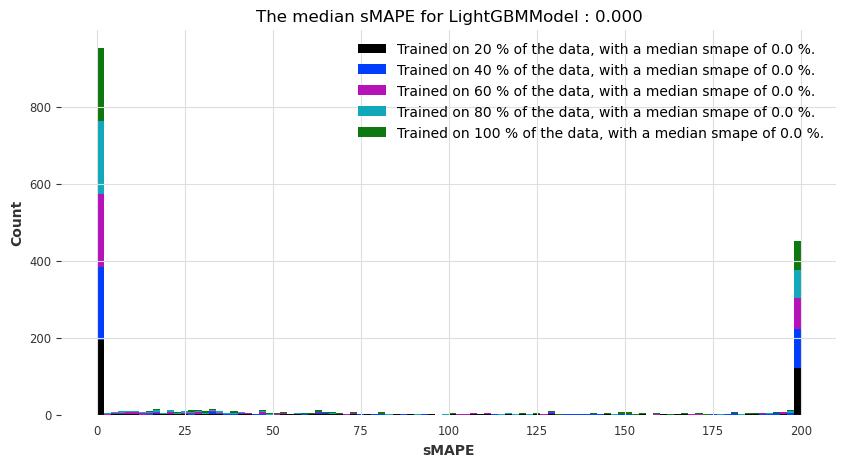

[I 2023-01-28 06:25:59,868] A new study created in memory with name: no-name-0b49a913-608f-4334-8fe7-2070c40c4d0e
[I 2023-01-28 06:26:04,704] Trial 0 finished with value: 75.21445294766525 and parameters: {'out_len': 7, 'n_estimators': 93, 'max_depth': 27}. Best is trial 0 with value: 75.21445294766525.
[I 2023-01-28 06:26:09,000] Trial 1 finished with value: 75.66955517602526 and parameters: {'out_len': 8, 'n_estimators': 61, 'max_depth': 10}. Best is trial 0 with value: 75.21445294766525.
[I 2023-01-28 06:26:13,523] Trial 2 finished with value: 77.55057675405082 and parameters: {'out_len': 11, 'n_estimators': 86, 'max_depth': 29}. Best is trial 0 with value: 75.21445294766525.
[I 2023-01-28 06:26:17,826] Trial 3 finished with value: 77.8476789840949 and parameters: {'out_len': 12, 'n_estimators': 52, 'max_depth': 11}. Best is trial 0 with value: 75.21445294766525.
[I 2023-01-28 06:26:22,323] Trial 4 finished with value: 78.17290324344926 and parameters: {'out_len': 12, 'n_estimators'

[I 2023-01-28 06:32:58,610] Trial 9 finished with value: 38.539733168980035 and parameters: {'out_len': 4, 'n_estimators': 71, 'max_depth': 25}. Best is trial 9 with value: 38.539733168980035.
[I 2023-01-28 06:33:20,648] Trial 10 finished with value: 40.26880449769447 and parameters: {'out_len': 1, 'n_estimators': 82, 'max_depth': 21}. Best is trial 9 with value: 38.539733168980035.
[I 2023-01-28 06:33:39,421] Trial 11 finished with value: 38.709013460221584 and parameters: {'out_len': 4, 'n_estimators': 76, 'max_depth': 27}. Best is trial 9 with value: 38.539733168980035.
[I 2023-01-28 06:33:57,037] Trial 12 finished with value: 36.849372344127225 and parameters: {'out_len': 5, 'n_estimators': 70, 'max_depth': 25}. Best is trial 12 with value: 36.849372344127225.
[I 2023-01-28 06:34:14,737] Trial 13 finished with value: 38.72906089149426 and parameters: {'out_len': 6, 'n_estimators': 65, 'max_depth': 23}. Best is trial 12 with value: 36.849372344127225.
[I 2023-01-28 06:34:32,101] Tri

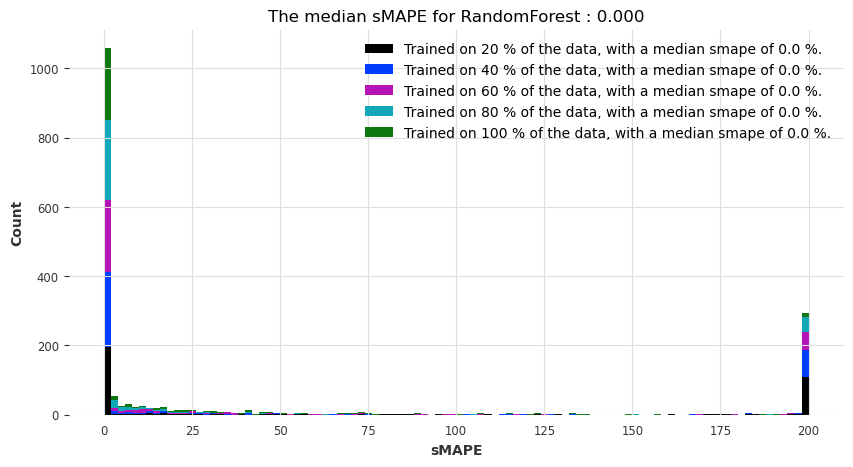

Visualization of performances taking the mean of the smapes over cross-validation


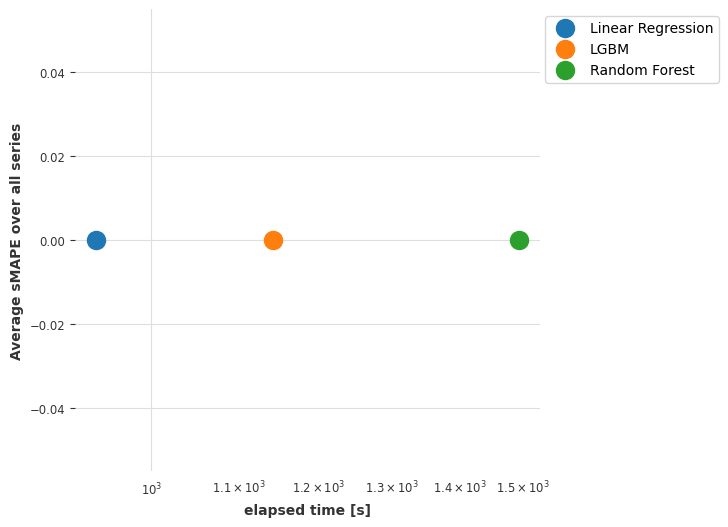

Visualization of performances taking the median of the smapes over cross-validation


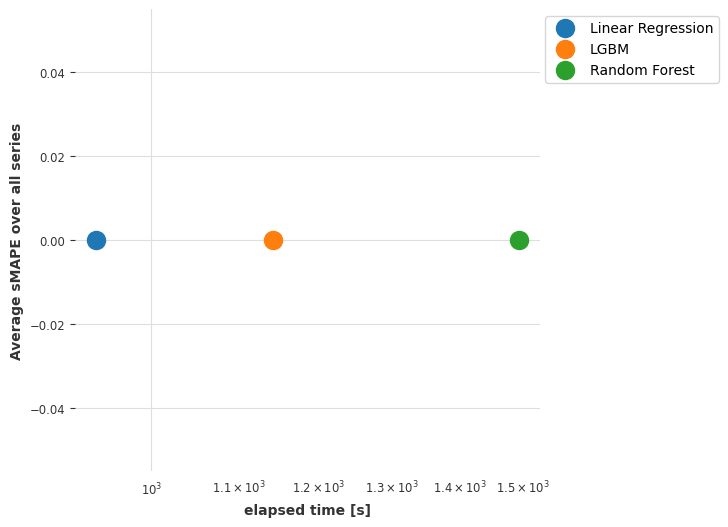

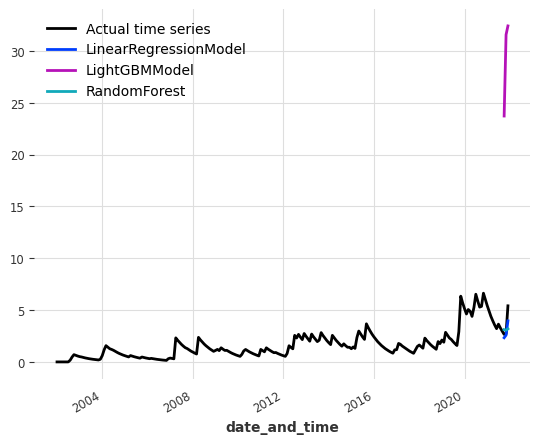

The results for index_cit_t1_t2 with an horizon of 6 are:


[I 2023-01-28 06:50:55,128] A new study created in memory with name: no-name-c5b61dd6-5bd8-46a7-b16c-d17714894997
[I 2023-01-28 06:50:59,011] Trial 0 finished with value: 84.05431065197854 and parameters: {'out_len': 10}. Best is trial 0 with value: 84.05431065197854.
[I 2023-01-28 06:51:02,396] Trial 1 finished with value: 79.86745518759685 and parameters: {'out_len': 3}. Best is trial 1 with value: 79.86745518759685.
[I 2023-01-28 06:51:06,284] Trial 2 finished with value: 84.2345356401582 and parameters: {'out_len': 8}. Best is trial 1 with value: 79.86745518759685.
[I 2023-01-28 06:51:10,135] Trial 3 finished with value: 84.2345356401582 and parameters: {'out_len': 8}. Best is trial 1 with value: 79.86745518759685.
[I 2023-01-28 06:51:13,817] Trial 4 finished with value: 82.21232352090252 and parameters: {'out_len': 7}. Best is trial 1 with value: 79.86745518759685.
[I 2023-01-28 06:51:17,884] Trial 5 finished with value: 82.25661107253546 and parameters: {'out_len': 12}. Best is t

[I 2023-01-28 06:57:27,599] Trial 1 finished with value: 78.71194006740377 and parameters: {'out_len': 4}. Best is trial 0 with value: 74.78492456468717.
[I 2023-01-28 06:57:43,357] Trial 2 finished with value: 75.31893947267638 and parameters: {'out_len': 11}. Best is trial 0 with value: 74.78492456468717.
[I 2023-01-28 06:57:57,239] Trial 3 finished with value: 77.30942870759675 and parameters: {'out_len': 1}. Best is trial 0 with value: 74.78492456468717.
[I 2023-01-28 06:58:11,615] Trial 4 finished with value: 73.5561274572321 and parameters: {'out_len': 5}. Best is trial 4 with value: 73.5561274572321.
[I 2023-01-28 06:58:26,163] Trial 5 finished with value: 75.96392562377129 and parameters: {'out_len': 9}. Best is trial 4 with value: 73.5561274572321.
[I 2023-01-28 06:58:42,222] Trial 6 finished with value: 74.16787212818092 and parameters: {'out_len': 10}. Best is trial 4 with value: 73.5561274572321.
[I 2023-01-28 06:58:58,049] Trial 7 finished with value: 74.16787212818092 and

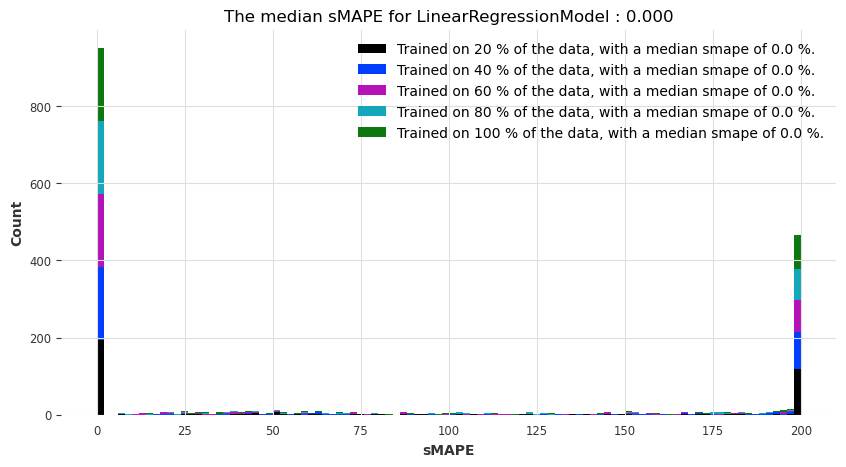

[I 2023-01-28 07:06:19,327] A new study created in memory with name: no-name-ac1d26c2-48fe-4054-b522-9f08c6f77f03
[I 2023-01-28 07:06:23,521] Trial 0 finished with value: 81.94586408496502 and parameters: {'out_len': 4}. Best is trial 0 with value: 81.94586408496502.
[I 2023-01-28 07:06:27,533] Trial 1 finished with value: 82.17007567468542 and parameters: {'out_len': 3}. Best is trial 0 with value: 81.94586408496502.
[I 2023-01-28 07:06:31,314] Trial 2 finished with value: 80.28412348407535 and parameters: {'out_len': 2}. Best is trial 2 with value: 80.28412348407535.
[I 2023-01-28 07:06:36,600] Trial 3 finished with value: 86.37287407223674 and parameters: {'out_len': 10}. Best is trial 2 with value: 80.28412348407535.
[I 2023-01-28 07:06:41,898] Trial 4 finished with value: 82.58117853134459 and parameters: {'out_len': 7}. Best is trial 2 with value: 80.28412348407535.
[I 2023-01-28 07:06:45,401] Trial 5 finished with value: 79.22703474420408 and parameters: {'out_len': 1}. Best is 

[I 2023-01-28 07:14:25,574] Trial 1 finished with value: 66.79060946959243 and parameters: {'out_len': 11}. Best is trial 0 with value: 66.28442090816817.
[I 2023-01-28 07:14:46,629] Trial 2 finished with value: 67.53158721491374 and parameters: {'out_len': 8}. Best is trial 0 with value: 66.28442090816817.
[I 2023-01-28 07:15:05,592] Trial 3 finished with value: 67.05157834669956 and parameters: {'out_len': 5}. Best is trial 0 with value: 66.28442090816817.
[I 2023-01-28 07:15:23,268] Trial 4 finished with value: 67.05157834669956 and parameters: {'out_len': 5}. Best is trial 0 with value: 66.28442090816817.
[I 2023-01-28 07:15:43,836] Trial 5 finished with value: 66.28442090816817 and parameters: {'out_len': 10}. Best is trial 0 with value: 66.28442090816817.
[I 2023-01-28 07:16:04,820] Trial 6 finished with value: 66.79060946959243 and parameters: {'out_len': 11}. Best is trial 0 with value: 66.28442090816817.
[I 2023-01-28 07:16:26,002] Trial 7 finished with value: 65.8618660604560

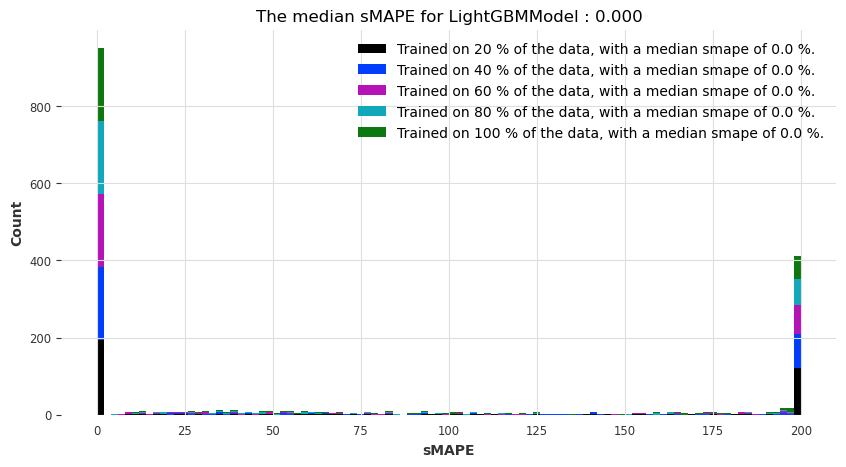

[I 2023-01-28 07:25:10,594] A new study created in memory with name: no-name-aabad6c8-053b-4647-a838-82fdb9813f58
[I 2023-01-28 07:25:15,122] Trial 0 finished with value: 81.34876667253975 and parameters: {'out_len': 12, 'n_estimators': 99, 'max_depth': 22}. Best is trial 0 with value: 81.34876667253975.
[I 2023-01-28 07:25:20,155] Trial 1 finished with value: 75.98502206321506 and parameters: {'out_len': 2, 'n_estimators': 97, 'max_depth': 24}. Best is trial 1 with value: 75.98502206321506.
[I 2023-01-28 07:25:24,737] Trial 2 finished with value: 78.29963801407865 and parameters: {'out_len': 1, 'n_estimators': 70, 'max_depth': 19}. Best is trial 1 with value: 75.98502206321506.
[I 2023-01-28 07:25:29,156] Trial 3 finished with value: 75.92776248284191 and parameters: {'out_len': 6, 'n_estimators': 64, 'max_depth': 30}. Best is trial 3 with value: 75.92776248284191.
[I 2023-01-28 07:25:33,916] Trial 4 finished with value: 75.41257638845735 and parameters: {'out_len': 5, 'n_estimators':

[I 2023-01-28 07:32:17,689] Trial 9 finished with value: 41.82162271701094 and parameters: {'out_len': 4, 'n_estimators': 78, 'max_depth': 29}. Best is trial 8 with value: 41.14308509534533.
[I 2023-01-28 07:32:38,515] Trial 10 finished with value: 41.81657812470497 and parameters: {'out_len': 1, 'n_estimators': 85, 'max_depth': 24}. Best is trial 8 with value: 41.14308509534533.
[I 2023-01-28 07:32:59,979] Trial 11 finished with value: 42.52115755274751 and parameters: {'out_len': 3, 'n_estimators': 100, 'max_depth': 19}. Best is trial 8 with value: 41.14308509534533.
[I 2023-01-28 07:33:21,265] Trial 12 finished with value: 41.80103636970978 and parameters: {'out_len': 1, 'n_estimators': 89, 'max_depth': 22}. Best is trial 8 with value: 41.14308509534533.
[I 2023-01-28 07:33:41,171] Trial 13 finished with value: 51.44812114302486 and parameters: {'out_len': 5, 'n_estimators': 93, 'max_depth': 14}. Best is trial 8 with value: 41.14308509534533.
[I 2023-01-28 07:34:01,015] Trial 14 fin

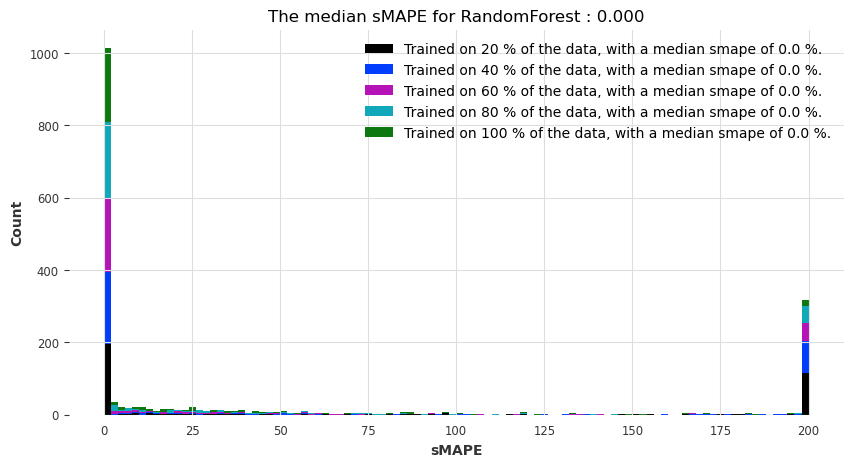

Visualization of performances taking the mean of the smapes over cross-validation


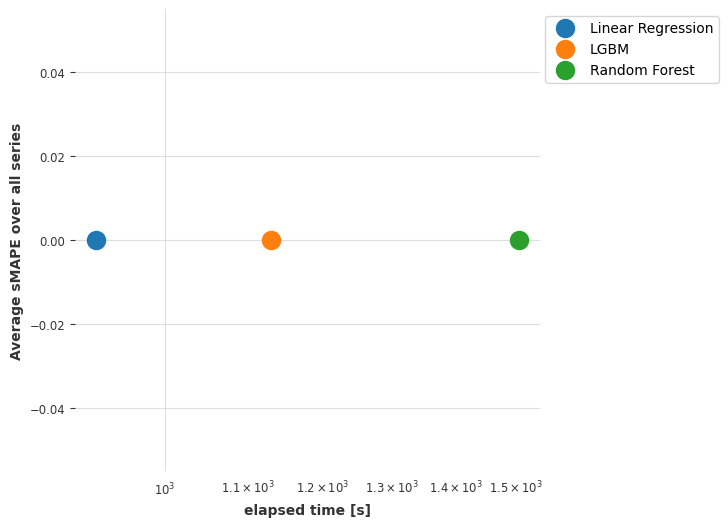

Visualization of performances taking the median of the smapes over cross-validation


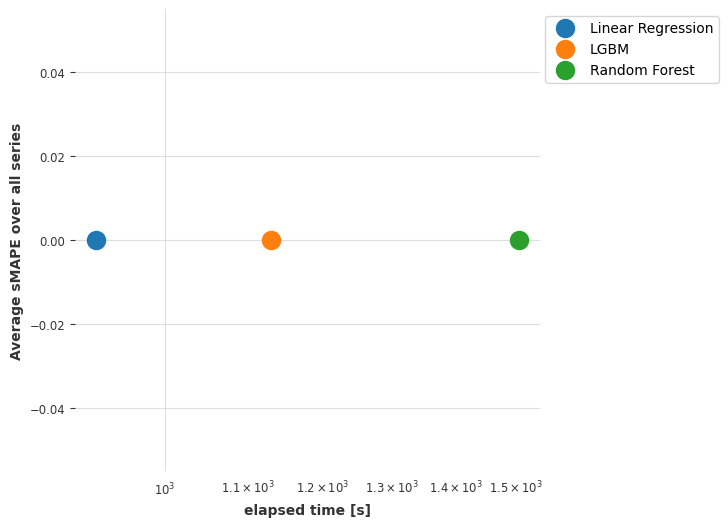

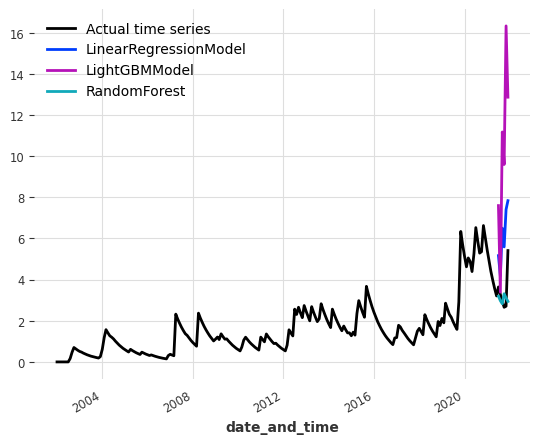

The results for index_cit_t1_t2 with an horizon of 12 are:


[I 2023-01-28 07:50:17,288] A new study created in memory with name: no-name-5db573d1-0a81-4df3-9c35-22661e19e0a0
[I 2023-01-28 07:50:20,812] Trial 0 finished with value: 87.61823755581483 and parameters: {'out_len': 6}. Best is trial 0 with value: 87.61823755581483.
[I 2023-01-28 07:50:24,564] Trial 1 finished with value: 85.96905891828747 and parameters: {'out_len': 8}. Best is trial 1 with value: 85.96905891828747.
[I 2023-01-28 07:50:28,486] Trial 2 finished with value: 88.39814082985427 and parameters: {'out_len': 10}. Best is trial 1 with value: 85.96905891828747.
[I 2023-01-28 07:50:32,058] Trial 3 finished with value: 87.61823755581483 and parameters: {'out_len': 6}. Best is trial 1 with value: 85.96905891828747.
[I 2023-01-28 07:50:36,056] Trial 4 finished with value: 88.31998287235338 and parameters: {'out_len': 11}. Best is trial 1 with value: 85.96905891828747.
[I 2023-01-28 07:50:39,409] Trial 5 finished with value: 84.69912018795029 and parameters: {'out_len': 3}. Best is

[I 2023-01-28 07:56:43,865] Trial 1 finished with value: 77.98159606308026 and parameters: {'out_len': 2}. Best is trial 0 with value: 74.89633216467311.
[I 2023-01-28 07:56:58,830] Trial 2 finished with value: 77.98159606308026 and parameters: {'out_len': 2}. Best is trial 0 with value: 74.89633216467311.
[I 2023-01-28 07:57:13,198] Trial 3 finished with value: 79.61857451252288 and parameters: {'out_len': 6}. Best is trial 0 with value: 74.89633216467311.
[I 2023-01-28 07:57:27,754] Trial 4 finished with value: 81.96473601357155 and parameters: {'out_len': 10}. Best is trial 0 with value: 74.89633216467311.
[I 2023-01-28 07:57:41,421] Trial 5 finished with value: 76.2029320553671 and parameters: {'out_len': 1}. Best is trial 0 with value: 74.89633216467311.
[I 2023-01-28 07:57:56,275] Trial 6 finished with value: 77.13986008944926 and parameters: {'out_len': 3}. Best is trial 0 with value: 74.89633216467311.
[I 2023-01-28 07:58:10,335] Trial 7 finished with value: 78.07801224962247 a

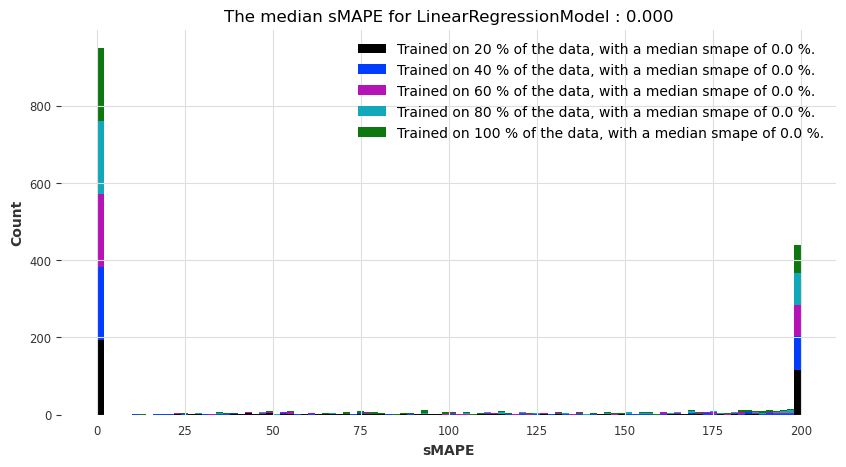

[I 2023-01-28 08:05:19,778] A new study created in memory with name: no-name-64f1ba7a-4e0f-4e75-9e29-5dad5c1d5468
[I 2023-01-28 08:05:24,301] Trial 0 finished with value: 84.72305291559685 and parameters: {'out_len': 6}. Best is trial 0 with value: 84.72305291559685.
[I 2023-01-28 08:05:29,474] Trial 1 finished with value: 87.6693540892099 and parameters: {'out_len': 9}. Best is trial 0 with value: 84.72305291559685.
[I 2023-01-28 08:05:34,295] Trial 2 finished with value: 86.05090114395819 and parameters: {'out_len': 7}. Best is trial 0 with value: 84.72305291559685.
[I 2023-01-28 08:05:38,894] Trial 3 finished with value: 84.72305291559685 and parameters: {'out_len': 6}. Best is trial 0 with value: 84.72305291559685.
[I 2023-01-28 08:05:45,724] Trial 4 finished with value: 89.17190553942243 and parameters: {'out_len': 10}. Best is trial 0 with value: 84.72305291559685.
[I 2023-01-28 08:05:50,506] Trial 5 finished with value: 83.57199194521749 and parameters: {'out_len': 5}. Best is t

[I 2023-01-28 08:13:14,956] Trial 1 finished with value: 72.17696509819211 and parameters: {'out_len': 3}. Best is trial 0 with value: 70.81315790490959.
[I 2023-01-28 08:13:36,589] Trial 2 finished with value: 73.62599953153753 and parameters: {'out_len': 11}. Best is trial 0 with value: 70.81315790490959.
[I 2023-01-28 08:13:56,931] Trial 3 finished with value: 70.16271215369905 and parameters: {'out_len': 9}. Best is trial 3 with value: 70.16271215369905.
[I 2023-01-28 08:14:14,665] Trial 4 finished with value: 71.02226201536159 and parameters: {'out_len': 4}. Best is trial 3 with value: 70.16271215369905.
[I 2023-01-28 08:14:35,283] Trial 5 finished with value: 73.62599953153753 and parameters: {'out_len': 11}. Best is trial 3 with value: 70.16271215369905.
[I 2023-01-28 08:14:53,329] Trial 6 finished with value: 71.02226201536159 and parameters: {'out_len': 4}. Best is trial 3 with value: 70.16271215369905.
[I 2023-01-28 08:15:09,331] Trial 7 finished with value: 72.17696509819211

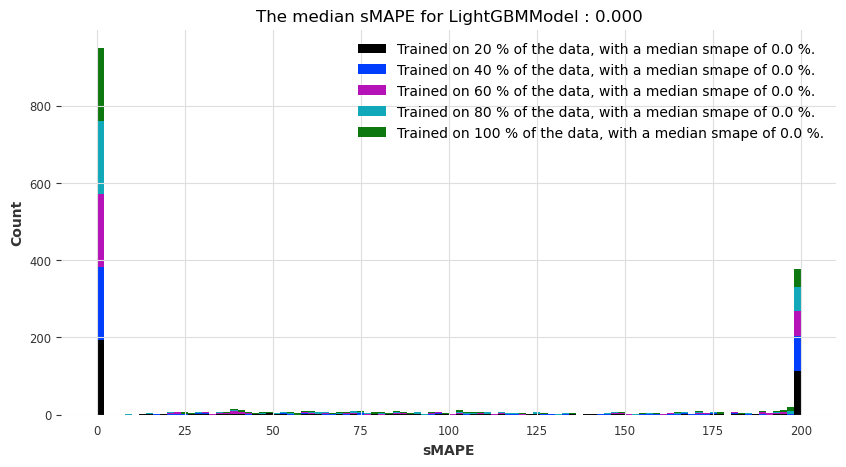

[I 2023-01-28 08:23:50,851] A new study created in memory with name: no-name-6fb8b75d-51d1-42f0-9fd0-d862db2bbac8
[I 2023-01-28 08:23:55,359] Trial 0 finished with value: 83.39772098476676 and parameters: {'out_len': 2, 'n_estimators': 78, 'max_depth': 20}. Best is trial 0 with value: 83.39772098476676.
[I 2023-01-28 08:23:59,474] Trial 1 finished with value: 85.43174278286932 and parameters: {'out_len': 11, 'n_estimators': 68, 'max_depth': 6}. Best is trial 0 with value: 83.39772098476676.
[I 2023-01-28 08:24:03,858] Trial 2 finished with value: 87.10118686449157 and parameters: {'out_len': 12, 'n_estimators': 99, 'max_depth': 24}. Best is trial 0 with value: 83.39772098476676.
[I 2023-01-28 08:24:08,173] Trial 3 finished with value: 87.55269318358468 and parameters: {'out_len': 12, 'n_estimators': 84, 'max_depth': 30}. Best is trial 0 with value: 83.39772098476676.
[I 2023-01-28 08:24:12,320] Trial 4 finished with value: 87.17150031040254 and parameters: {'out_len': 12, 'n_estimators

[I 2023-01-28 08:30:18,801] Trial 9 finished with value: 68.56388293993064 and parameters: {'out_len': 10, 'n_estimators': 83, 'max_depth': 12}. Best is trial 7 with value: 57.47374883846639.
[I 2023-01-28 08:30:42,004] Trial 10 finished with value: 57.681124467275986 and parameters: {'out_len': 1, 'n_estimators': 100, 'max_depth': 30}. Best is trial 7 with value: 57.47374883846639.
[I 2023-01-28 08:31:04,052] Trial 11 finished with value: 56.95224929833555 and parameters: {'out_len': 1, 'n_estimators': 100, 'max_depth': 29}. Best is trial 11 with value: 56.95224929833555.
[I 2023-01-28 08:31:22,444] Trial 12 finished with value: 57.35599581666009 and parameters: {'out_len': 5, 'n_estimators': 89, 'max_depth': 24}. Best is trial 11 with value: 56.95224929833555.
[I 2023-01-28 08:31:42,884] Trial 13 finished with value: 58.43119104493481 and parameters: {'out_len': 1, 'n_estimators': 87, 'max_depth': 30}. Best is trial 11 with value: 56.95224929833555.
[I 2023-01-28 08:32:01,459] Trial 

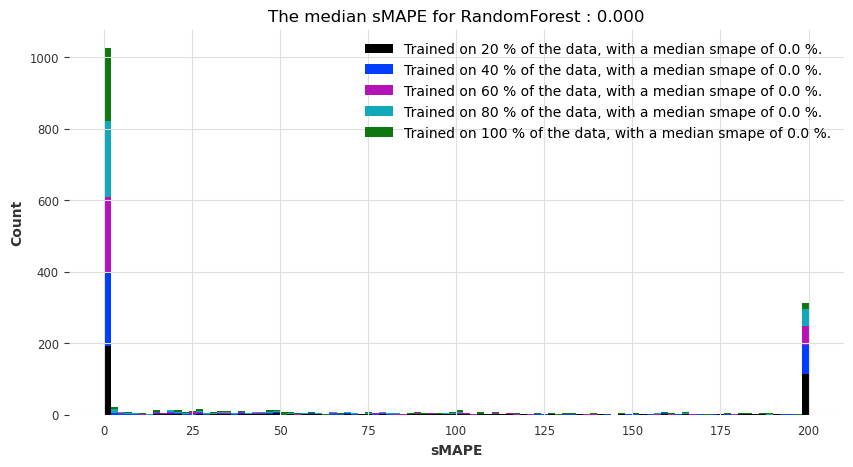

Visualization of performances taking the mean of the smapes over cross-validation


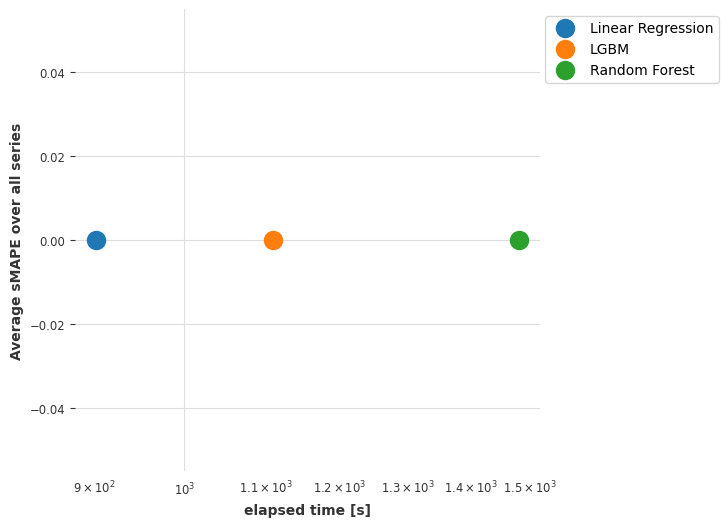

Visualization of performances taking the median of the smapes over cross-validation


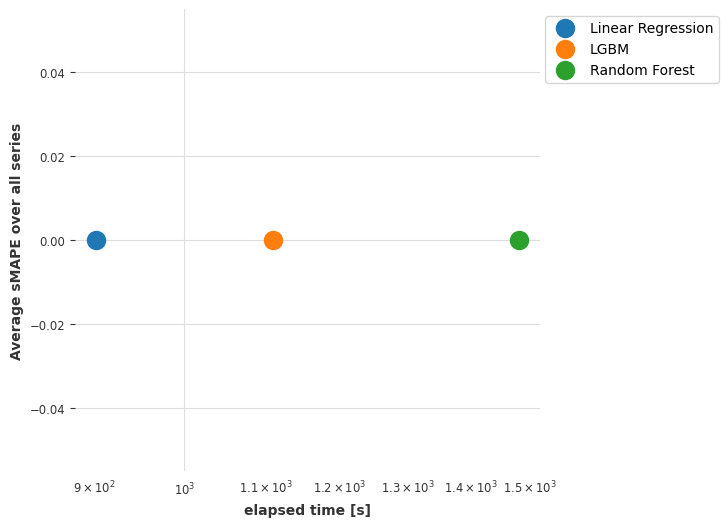

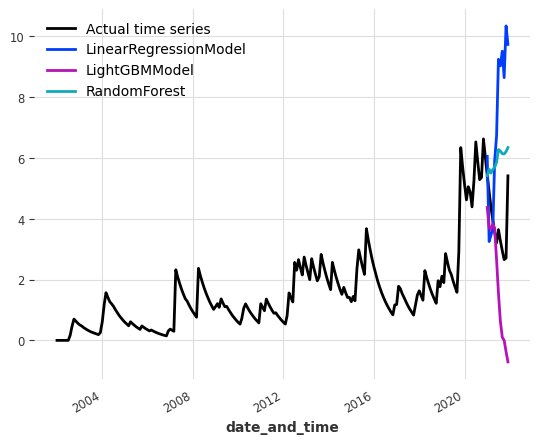

The results for index_cit_t2_t1 are:
The results for index_cit_t2_t1 with an horizon of 3 are:


[I 2023-01-28 08:48:33,647] A new study created in memory with name: no-name-0b9aa345-8860-4b84-b9d6-00852d98700e
[I 2023-01-28 08:48:37,000] Trial 0 finished with value: 78.10190998587933 and parameters: {'out_len': 2}. Best is trial 0 with value: 78.10190998587933.
[I 2023-01-28 08:48:40,643] Trial 1 finished with value: 78.10190998587933 and parameters: {'out_len': 2}. Best is trial 0 with value: 78.10190998587933.
[I 2023-01-28 08:48:44,609] Trial 2 finished with value: 81.08040061432419 and parameters: {'out_len': 9}. Best is trial 0 with value: 78.10190998587933.
[I 2023-01-28 08:48:48,478] Trial 3 finished with value: 77.90915010282644 and parameters: {'out_len': 8}. Best is trial 3 with value: 77.90915010282644.
[I 2023-01-28 08:48:52,222] Trial 4 finished with value: 79.86986971421521 and parameters: {'out_len': 6}. Best is trial 3 with value: 77.90915010282644.
[I 2023-01-28 08:48:56,023] Trial 5 finished with value: 77.90915010282644 and parameters: {'out_len': 8}. Best is t

[I 2023-01-28 08:55:18,325] Trial 1 finished with value: 71.01485776147658 and parameters: {'out_len': 9}. Best is trial 1 with value: 71.01485776147658.
[I 2023-01-28 08:55:32,458] Trial 2 finished with value: 70.60308625252257 and parameters: {'out_len': 1}. Best is trial 2 with value: 70.60308625252257.
[I 2023-01-28 08:55:47,209] Trial 3 finished with value: 69.79136855336075 and parameters: {'out_len': 8}. Best is trial 3 with value: 69.79136855336075.
[I 2023-01-28 08:56:03,211] Trial 4 finished with value: 75.9493634608088 and parameters: {'out_len': 11}. Best is trial 3 with value: 69.79136855336075.
[I 2023-01-28 08:56:18,088] Trial 5 finished with value: 78.06689666056928 and parameters: {'out_len': 10}. Best is trial 3 with value: 69.79136855336075.
[I 2023-01-28 08:56:33,882] Trial 6 finished with value: 69.73279358613844 and parameters: {'out_len': 7}. Best is trial 6 with value: 69.73279358613844.
[I 2023-01-28 08:56:49,366] Trial 7 finished with value: 75.9493634608088 a

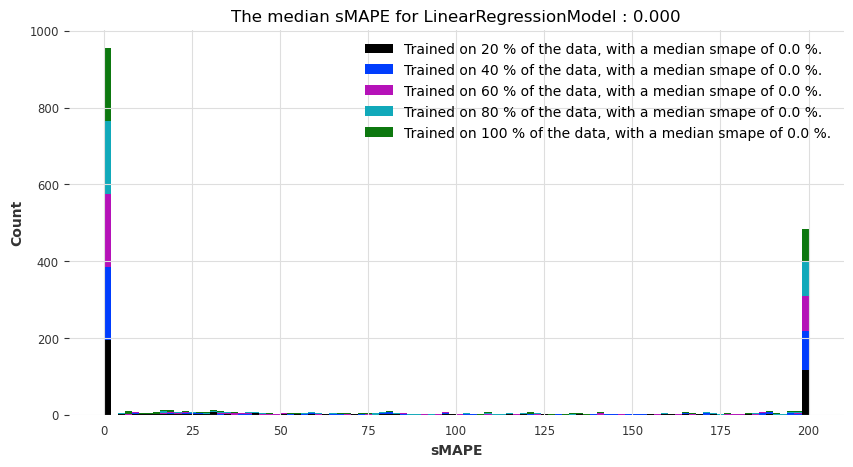

[I 2023-01-28 09:04:16,023] A new study created in memory with name: no-name-d53ea65e-0e44-488f-a0e9-231e7d56b3f2
[I 2023-01-28 09:04:20,480] Trial 0 finished with value: 76.93766127226237 and parameters: {'out_len': 5}. Best is trial 0 with value: 76.93766127226237.
[I 2023-01-28 09:04:25,859] Trial 1 finished with value: 78.91957969277372 and parameters: {'out_len': 9}. Best is trial 0 with value: 76.93766127226237.
[I 2023-01-28 09:04:29,713] Trial 2 finished with value: 76.27973693847959 and parameters: {'out_len': 2}. Best is trial 2 with value: 76.27973693847959.
[I 2023-01-28 09:04:34,017] Trial 3 finished with value: 77.55984785459854 and parameters: {'out_len': 4}. Best is trial 2 with value: 76.27973693847959.
[I 2023-01-28 09:04:38,305] Trial 4 finished with value: 77.55984785459854 and parameters: {'out_len': 4}. Best is trial 2 with value: 76.27973693847959.
[I 2023-01-28 09:04:42,129] Trial 5 finished with value: 75.66291228150413 and parameters: {'out_len': 1}. Best is t

[I 2023-01-28 09:12:28,281] Trial 1 finished with value: 60.59088003585216 and parameters: {'out_len': 4}. Best is trial 1 with value: 60.59088003585216.
[I 2023-01-28 09:12:47,793] Trial 2 finished with value: 61.774580567331206 and parameters: {'out_len': 6}. Best is trial 1 with value: 60.59088003585216.
[I 2023-01-28 09:13:05,457] Trial 3 finished with value: 60.59088003585216 and parameters: {'out_len': 4}. Best is trial 1 with value: 60.59088003585216.
[I 2023-01-28 09:13:24,022] Trial 4 finished with value: 60.59088003585216 and parameters: {'out_len': 4}. Best is trial 1 with value: 60.59088003585216.
[I 2023-01-28 09:13:44,464] Trial 5 finished with value: 60.04810226826136 and parameters: {'out_len': 8}. Best is trial 5 with value: 60.04810226826136.
[I 2023-01-28 09:14:03,806] Trial 6 finished with value: 63.9254266565711 and parameters: {'out_len': 5}. Best is trial 5 with value: 60.04810226826136.
[I 2023-01-28 09:14:24,685] Trial 7 finished with value: 67.052913808419 and

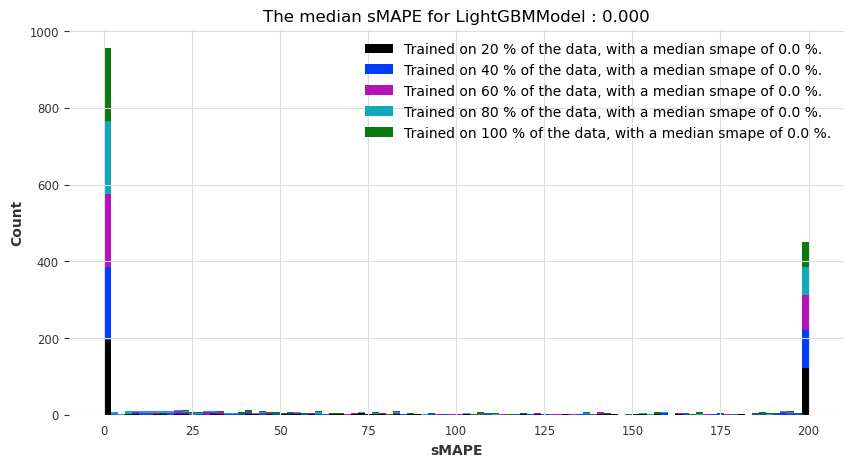

[I 2023-01-28 09:23:28,991] A new study created in memory with name: no-name-c82b9b54-77ef-46fc-808c-f39a4b2425e3
[I 2023-01-28 09:23:33,295] Trial 0 finished with value: 75.00875349719404 and parameters: {'out_len': 4, 'n_estimators': 75, 'max_depth': 7}. Best is trial 0 with value: 75.00875349719404.
[I 2023-01-28 09:23:37,747] Trial 1 finished with value: 74.10813613932325 and parameters: {'out_len': 10, 'n_estimators': 74, 'max_depth': 17}. Best is trial 1 with value: 74.10813613932325.
[I 2023-01-28 09:23:42,444] Trial 2 finished with value: 72.33868148274675 and parameters: {'out_len': 1, 'n_estimators': 80, 'max_depth': 21}. Best is trial 2 with value: 72.33868148274675.
[I 2023-01-28 09:23:46,627] Trial 3 finished with value: 74.71541938389527 and parameters: {'out_len': 7, 'n_estimators': 56, 'max_depth': 8}. Best is trial 2 with value: 72.33868148274675.
[I 2023-01-28 09:23:51,262] Trial 4 finished with value: 75.18367299131137 and parameters: {'out_len': 10, 'n_estimators': 

[I 2023-01-28 09:30:15,115] Trial 9 finished with value: 45.348959305612844 and parameters: {'out_len': 12, 'n_estimators': 62, 'max_depth': 16}. Best is trial 5 with value: 40.08370964781493.
[I 2023-01-28 09:30:32,022] Trial 10 finished with value: 42.43087236156915 and parameters: {'out_len': 4, 'n_estimators': 50, 'max_depth': 30}. Best is trial 5 with value: 40.08370964781493.
[I 2023-01-28 09:30:51,314] Trial 11 finished with value: 43.029655494541316 and parameters: {'out_len': 5, 'n_estimators': 87, 'max_depth': 20}. Best is trial 5 with value: 40.08370964781493.
[I 2023-01-28 09:31:09,918] Trial 12 finished with value: 40.9865392666933 and parameters: {'out_len': 3, 'n_estimators': 72, 'max_depth': 24}. Best is trial 5 with value: 40.08370964781493.
[I 2023-01-28 09:31:29,377] Trial 13 finished with value: 41.829989768339665 and parameters: {'out_len': 3, 'n_estimators': 71, 'max_depth': 25}. Best is trial 5 with value: 40.08370964781493.
[I 2023-01-28 09:31:48,410] Trial 14 f

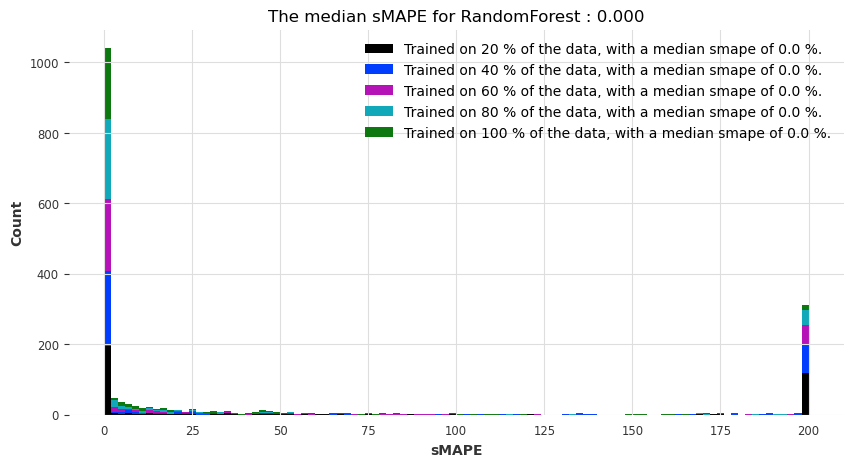

Visualization of performances taking the mean of the smapes over cross-validation


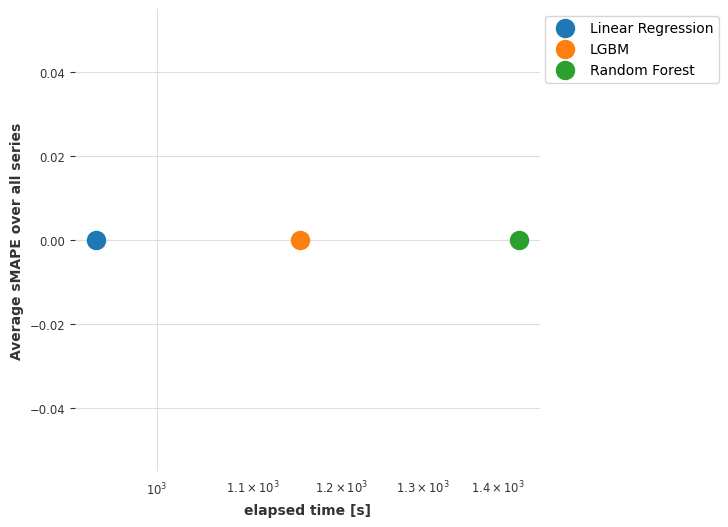

Visualization of performances taking the median of the smapes over cross-validation


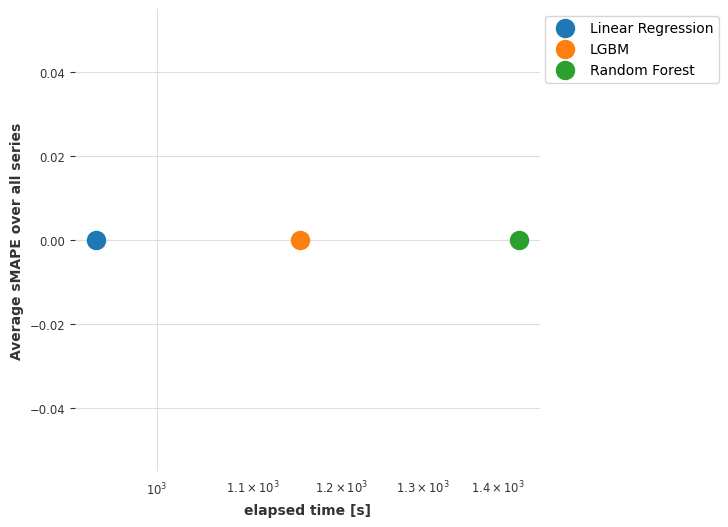

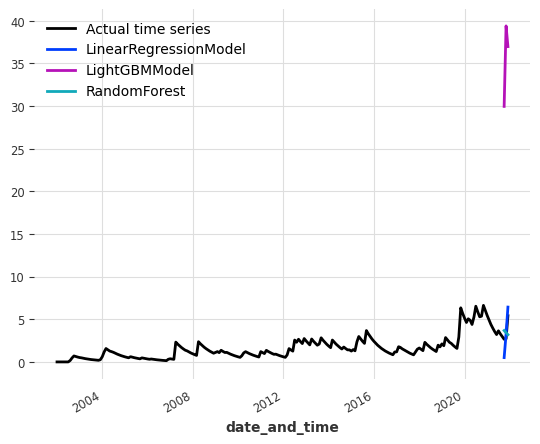

The results for index_cit_t2_t1 with an horizon of 6 are:


[I 2023-01-28 09:47:20,272] A new study created in memory with name: no-name-276d8fb9-aa56-49d9-8a3a-c9df48815112
[I 2023-01-28 09:47:23,953] Trial 0 finished with value: 82.91610682557999 and parameters: {'out_len': 7}. Best is trial 0 with value: 82.91610682557999.
[I 2023-01-28 09:47:27,770] Trial 1 finished with value: 83.66484275086657 and parameters: {'out_len': 8}. Best is trial 0 with value: 82.91610682557999.
[I 2023-01-28 09:47:31,562] Trial 2 finished with value: 83.66484275086657 and parameters: {'out_len': 8}. Best is trial 0 with value: 82.91610682557999.
[I 2023-01-28 09:47:35,620] Trial 3 finished with value: 80.94286772032237 and parameters: {'out_len': 11}. Best is trial 3 with value: 80.94286772032237.
[I 2023-01-28 09:47:39,673] Trial 4 finished with value: 80.94286772032237 and parameters: {'out_len': 11}. Best is trial 3 with value: 80.94286772032237.
[I 2023-01-28 09:47:43,147] Trial 5 finished with value: 79.74101154062376 and parameters: {'out_len': 4}. Best is

[I 2023-01-28 09:53:57,110] Trial 1 finished with value: 73.95155231075024 and parameters: {'out_len': 2}. Best is trial 1 with value: 73.95155231075024.
[I 2023-01-28 09:54:12,582] Trial 2 finished with value: 73.95155231075024 and parameters: {'out_len': 2}. Best is trial 1 with value: 73.95155231075024.
[I 2023-01-28 09:54:26,985] Trial 3 finished with value: 73.95155231075024 and parameters: {'out_len': 2}. Best is trial 1 with value: 73.95155231075024.
[I 2023-01-28 09:54:43,007] Trial 4 finished with value: 72.37598781959028 and parameters: {'out_len': 6}. Best is trial 4 with value: 72.37598781959028.
[I 2023-01-28 09:54:57,845] Trial 5 finished with value: 71.24300176349023 and parameters: {'out_len': 8}. Best is trial 5 with value: 71.24300176349023.
[I 2023-01-28 09:55:12,783] Trial 6 finished with value: 74.4085092516959 and parameters: {'out_len': 10}. Best is trial 5 with value: 71.24300176349023.
[I 2023-01-28 09:55:28,761] Trial 7 finished with value: 78.3973692078647 an

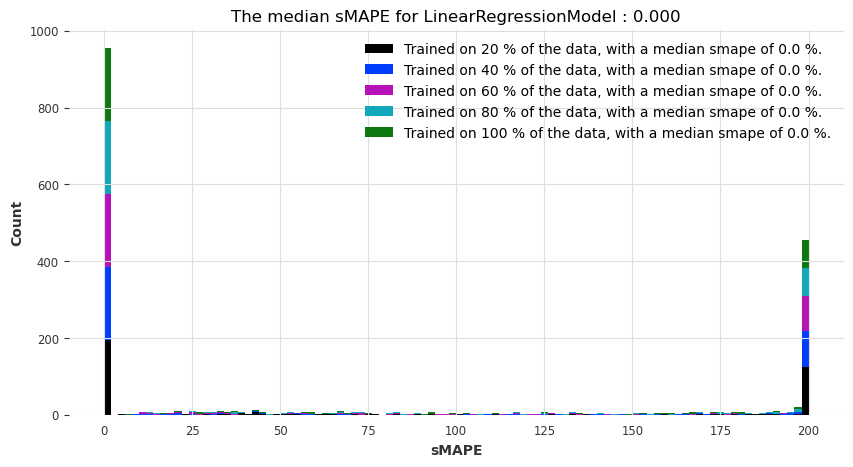

[I 2023-01-28 10:02:56,217] A new study created in memory with name: no-name-92f5adf2-2d0b-43dd-a134-953cfa1cad86
[I 2023-01-28 10:02:59,704] Trial 0 finished with value: 77.17381989736137 and parameters: {'out_len': 1}. Best is trial 0 with value: 77.17381989736137.
[I 2023-01-28 10:03:04,752] Trial 1 finished with value: 86.8136419810794 and parameters: {'out_len': 12}. Best is trial 0 with value: 77.17381989736137.
[I 2023-01-28 10:03:09,973] Trial 2 finished with value: 81.52278535571794 and parameters: {'out_len': 9}. Best is trial 0 with value: 77.17381989736137.
[I 2023-01-28 10:03:14,628] Trial 3 finished with value: 79.81772829792757 and parameters: {'out_len': 6}. Best is trial 0 with value: 77.17381989736137.
[I 2023-01-28 10:03:19,817] Trial 4 finished with value: 81.52278535571794 and parameters: {'out_len': 9}. Best is trial 0 with value: 77.17381989736137.
[I 2023-01-28 10:03:23,807] Trial 5 finished with value: 78.5425233357532 and parameters: {'out_len': 3}. Best is tr

[I 2023-01-28 10:11:00,515] Trial 1 finished with value: 65.6363978706134 and parameters: {'out_len': 10}. Best is trial 1 with value: 65.6363978706134.
[I 2023-01-28 10:11:17,803] Trial 2 finished with value: 64.74700365500766 and parameters: {'out_len': 3}. Best is trial 2 with value: 64.74700365500766.
[I 2023-01-28 10:11:37,955] Trial 3 finished with value: 66.3079855078077 and parameters: {'out_len': 7}. Best is trial 2 with value: 64.74700365500766.
[I 2023-01-28 10:11:58,392] Trial 4 finished with value: 66.3079855078077 and parameters: {'out_len': 7}. Best is trial 2 with value: 64.74700365500766.
[I 2023-01-28 10:12:18,847] Trial 5 finished with value: 68.424017096391 and parameters: {'out_len': 12}. Best is trial 2 with value: 64.74700365500766.
[I 2023-01-28 10:12:35,863] Trial 6 finished with value: 66.07272315001683 and parameters: {'out_len': 4}. Best is trial 2 with value: 64.74700365500766.
[I 2023-01-28 10:12:56,355] Trial 7 finished with value: 66.48185724572043 and p

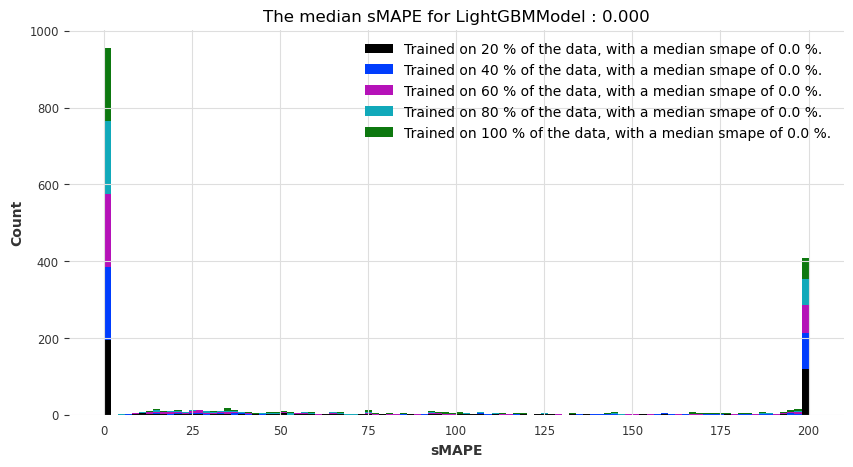

[I 2023-01-28 10:21:28,442] A new study created in memory with name: no-name-2fe88d72-f90e-48b1-8a9a-8e099546475e
[I 2023-01-28 10:21:32,611] Trial 0 finished with value: 76.01369457349738 and parameters: {'out_len': 2, 'n_estimators': 61, 'max_depth': 12}. Best is trial 0 with value: 76.01369457349738.
[I 2023-01-28 10:21:36,522] Trial 1 finished with value: 78.01945471289417 and parameters: {'out_len': 2, 'n_estimators': 71, 'max_depth': 5}. Best is trial 0 with value: 76.01369457349738.
[I 2023-01-28 10:21:41,361] Trial 2 finished with value: 77.34868627388997 and parameters: {'out_len': 1, 'n_estimators': 94, 'max_depth': 22}. Best is trial 0 with value: 76.01369457349738.
[I 2023-01-28 10:21:45,703] Trial 3 finished with value: 77.1903046873659 and parameters: {'out_len': 11, 'n_estimators': 72, 'max_depth': 17}. Best is trial 0 with value: 76.01369457349738.
[I 2023-01-28 10:21:50,012] Trial 4 finished with value: 76.65656219368734 and parameters: {'out_len': 3, 'n_estimators': 6

[I 2023-01-28 10:27:53,564] Trial 9 finished with value: 53.78147901278563 and parameters: {'out_len': 7, 'n_estimators': 96, 'max_depth': 13}. Best is trial 4 with value: 46.83480820716697.
[I 2023-01-28 10:28:10,974] Trial 10 finished with value: 48.809323939170504 and parameters: {'out_len': 1, 'n_estimators': 59, 'max_depth': 24}. Best is trial 4 with value: 46.83480820716697.
[I 2023-01-28 10:28:26,082] Trial 11 finished with value: 48.63860483714518 and parameters: {'out_len': 9, 'n_estimators': 70, 'max_depth': 25}. Best is trial 4 with value: 46.83480820716697.
[I 2023-01-28 10:28:42,985] Trial 12 finished with value: 49.408982538991175 and parameters: {'out_len': 8, 'n_estimators': 65, 'max_depth': 22}. Best is trial 4 with value: 46.83480820716697.
[I 2023-01-28 10:29:01,428] Trial 13 finished with value: 44.39366664868464 and parameters: {'out_len': 5, 'n_estimators': 85, 'max_depth': 30}. Best is trial 13 with value: 44.39366664868464.
[I 2023-01-28 10:29:20,023] Trial 14 f

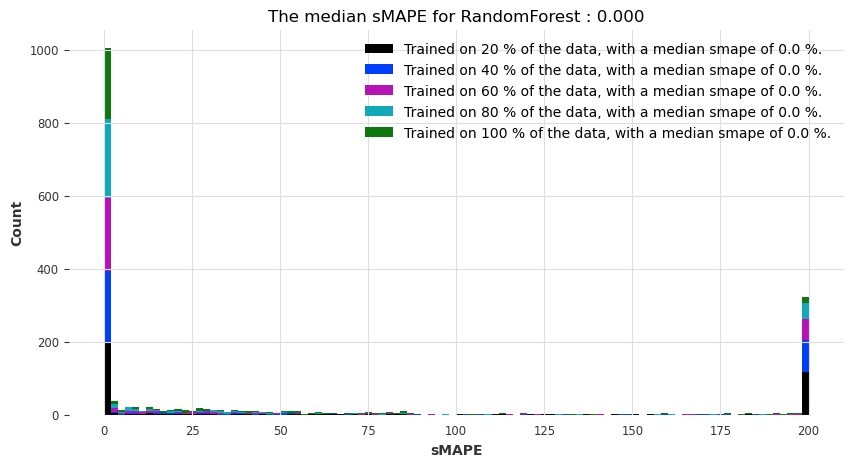

Visualization of performances taking the mean of the smapes over cross-validation


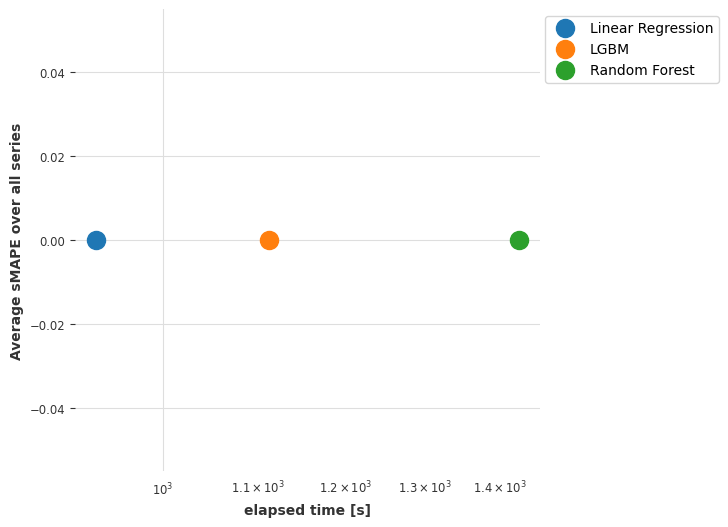

Visualization of performances taking the median of the smapes over cross-validation


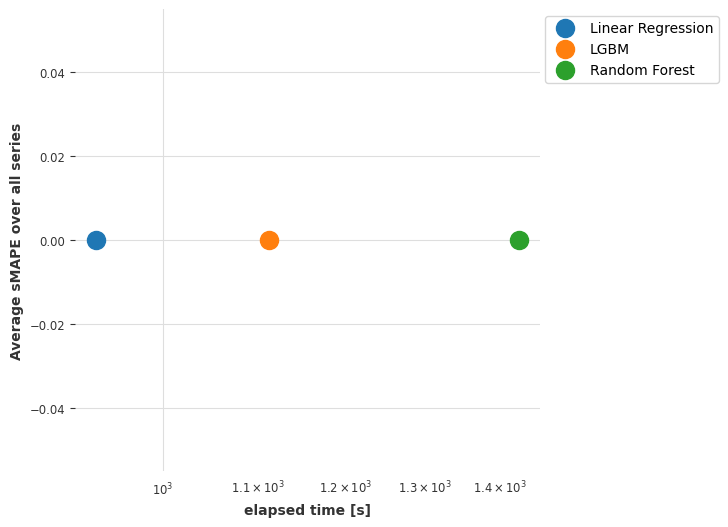

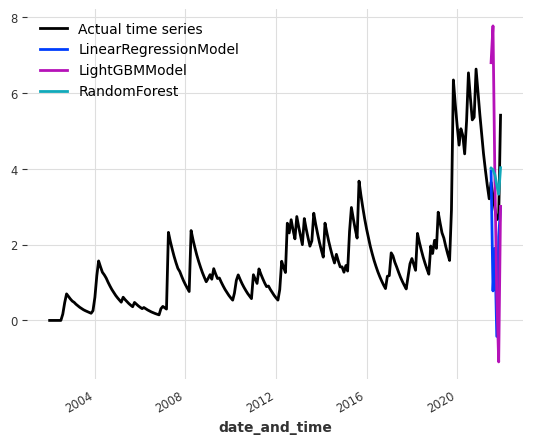

The results for index_cit_t2_t1 with an horizon of 12 are:


[I 2023-01-28 10:45:17,339] A new study created in memory with name: no-name-974cf96a-d3d8-4b77-a775-dde0705b4779
[I 2023-01-28 10:45:20,605] Trial 0 finished with value: 84.16185018776625 and parameters: {'out_len': 3}. Best is trial 0 with value: 84.16185018776625.
[I 2023-01-28 10:45:24,151] Trial 1 finished with value: 86.97848485687861 and parameters: {'out_len': 6}. Best is trial 0 with value: 84.16185018776625.
[I 2023-01-28 10:45:27,576] Trial 2 finished with value: 86.35807497410619 and parameters: {'out_len': 5}. Best is trial 0 with value: 84.16185018776625.
[I 2023-01-28 10:45:30,765] Trial 3 finished with value: 85.51206090997361 and parameters: {'out_len': 1}. Best is trial 0 with value: 84.16185018776625.
[I 2023-01-28 10:45:34,266] Trial 4 finished with value: 86.97848485687861 and parameters: {'out_len': 6}. Best is trial 0 with value: 84.16185018776625.
[I 2023-01-28 10:45:38,106] Trial 5 finished with value: 88.5250403280235 and parameters: {'out_len': 10}. Best is t

[I 2023-01-28 10:51:56,738] Trial 2 finished with value: 76.91798612101313 and parameters: {'out_len': 2}. Best is trial 2 with value: 76.91798612101313.
[I 2023-01-28 10:52:10,478] Trial 3 finished with value: 77.14160579956437 and parameters: {'out_len': 1}. Best is trial 2 with value: 76.91798612101313.
[I 2023-01-28 10:52:24,378] Trial 4 finished with value: 75.81392701470332 and parameters: {'out_len': 3}. Best is trial 4 with value: 75.81392701470332.
[I 2023-01-28 10:52:39,944] Trial 5 finished with value: 80.83143864286141 and parameters: {'out_len': 11}. Best is trial 4 with value: 75.81392701470332.
[I 2023-01-28 10:52:54,499] Trial 6 finished with value: 78.33394187380445 and parameters: {'out_len': 6}. Best is trial 4 with value: 75.81392701470332.
[I 2023-01-28 10:53:08,353] Trial 7 finished with value: 75.81392701470332 and parameters: {'out_len': 3}. Best is trial 4 with value: 75.81392701470332.
[I 2023-01-28 10:53:23,888] Trial 8 finished with value: 80.83143864286141 

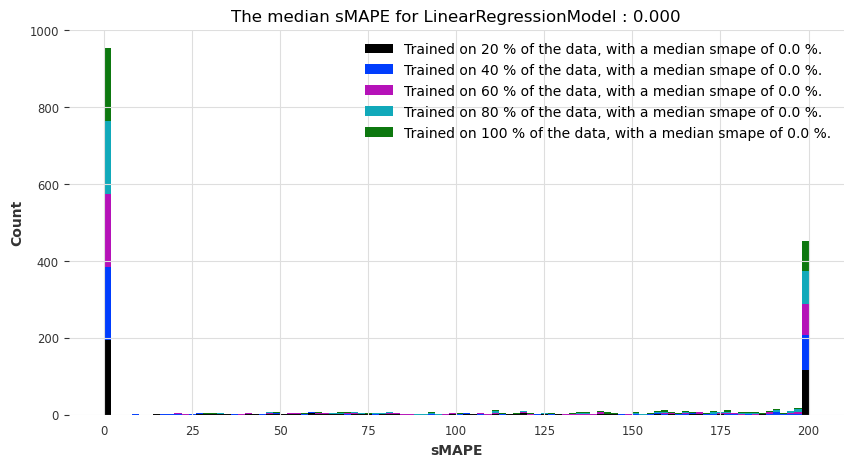

[I 2023-01-28 11:00:17,978] A new study created in memory with name: no-name-56a3b4ed-1da7-40d3-86ff-4124076f5401
[I 2023-01-28 11:00:22,568] Trial 0 finished with value: 81.97189163949378 and parameters: {'out_len': 6}. Best is trial 0 with value: 81.97189163949378.
[I 2023-01-28 11:00:27,443] Trial 1 finished with value: 84.18378645480486 and parameters: {'out_len': 7}. Best is trial 0 with value: 81.97189163949378.
[I 2023-01-28 11:00:32,553] Trial 2 finished with value: 85.86190512835493 and parameters: {'out_len': 9}. Best is trial 0 with value: 81.97189163949378.
[I 2023-01-28 11:00:36,025] Trial 3 finished with value: 80.17624597551904 and parameters: {'out_len': 1}. Best is trial 3 with value: 80.17624597551904.
[I 2023-01-28 11:00:41,535] Trial 4 finished with value: 85.86190512835493 and parameters: {'out_len': 9}. Best is trial 3 with value: 80.17624597551904.
[I 2023-01-28 11:00:46,685] Trial 5 finished with value: 85.86190512835493 and parameters: {'out_len': 9}. Best is t

[I 2023-01-28 11:07:58,427] Trial 1 finished with value: 70.87874055785234 and parameters: {'out_len': 4}. Best is trial 1 with value: 70.87874055785234.
[I 2023-01-28 11:08:18,024] Trial 2 finished with value: 69.58913039716333 and parameters: {'out_len': 7}. Best is trial 2 with value: 69.58913039716333.
[I 2023-01-28 11:08:38,634] Trial 3 finished with value: 70.16584659553943 and parameters: {'out_len': 11}. Best is trial 2 with value: 69.58913039716333.
[I 2023-01-28 11:08:56,843] Trial 4 finished with value: 70.87874055785234 and parameters: {'out_len': 4}. Best is trial 2 with value: 69.58913039716333.
[I 2023-01-28 11:09:14,536] Trial 5 finished with value: 70.87874055785234 and parameters: {'out_len': 4}. Best is trial 2 with value: 69.58913039716333.
[I 2023-01-28 11:09:34,694] Trial 6 finished with value: 69.68484295623776 and parameters: {'out_len': 10}. Best is trial 2 with value: 69.58913039716333.
[I 2023-01-28 11:09:54,870] Trial 7 finished with value: 69.68484295623776

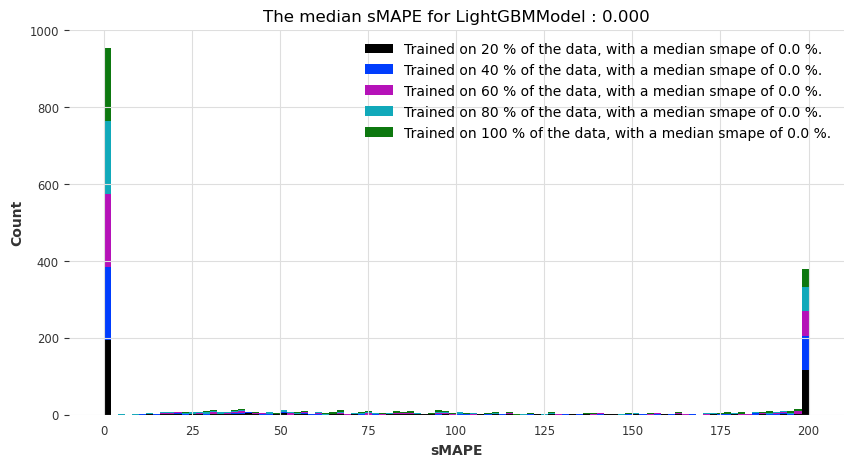

[I 2023-01-28 11:18:28,539] A new study created in memory with name: no-name-1d4e1d81-10f3-4dba-8b6e-a64999f8817e
[I 2023-01-28 11:18:32,851] Trial 0 finished with value: 82.28199160740958 and parameters: {'out_len': 7, 'n_estimators': 73, 'max_depth': 21}. Best is trial 0 with value: 82.28199160740958.
[I 2023-01-28 11:18:37,038] Trial 1 finished with value: 80.7175768288649 and parameters: {'out_len': 6, 'n_estimators': 64, 'max_depth': 25}. Best is trial 1 with value: 80.7175768288649.
[I 2023-01-28 11:18:41,565] Trial 2 finished with value: 82.22016573804508 and parameters: {'out_len': 11, 'n_estimators': 51, 'max_depth': 25}. Best is trial 1 with value: 80.7175768288649.
[I 2023-01-28 11:18:45,873] Trial 3 finished with value: 80.54937765467699 and parameters: {'out_len': 10, 'n_estimators': 80, 'max_depth': 27}. Best is trial 3 with value: 80.54937765467699.
[I 2023-01-28 11:18:50,102] Trial 4 finished with value: 80.89169706612397 and parameters: {'out_len': 7, 'n_estimators': 7

[I 2023-01-28 11:24:57,976] Trial 9 finished with value: 67.46556722444448 and parameters: {'out_len': 5, 'n_estimators': 90, 'max_depth': 7}. Best is trial 3 with value: 52.65661325257086.
[I 2023-01-28 11:25:14,620] Trial 10 finished with value: 58.779741022769024 and parameters: {'out_len': 7, 'n_estimators': 70, 'max_depth': 22}. Best is trial 3 with value: 52.65661325257086.
[I 2023-01-28 11:25:27,834] Trial 11 finished with value: 61.77207831353753 and parameters: {'out_len': 10, 'n_estimators': 51, 'max_depth': 15}. Best is trial 3 with value: 52.65661325257086.
[I 2023-01-28 11:25:42,082] Trial 12 finished with value: 59.45966244935644 and parameters: {'out_len': 7, 'n_estimators': 51, 'max_depth': 17}. Best is trial 3 with value: 52.65661325257086.
[I 2023-01-28 11:25:56,368] Trial 13 finished with value: 61.3446724487125 and parameters: {'out_len': 9, 'n_estimators': 62, 'max_depth': 22}. Best is trial 3 with value: 52.65661325257086.
[I 2023-01-28 11:26:13,664] Trial 14 fini

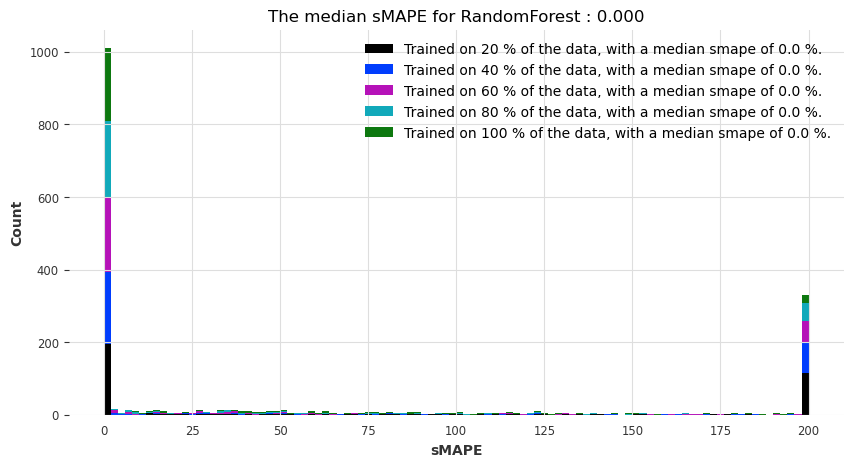

Visualization of performances taking the mean of the smapes over cross-validation


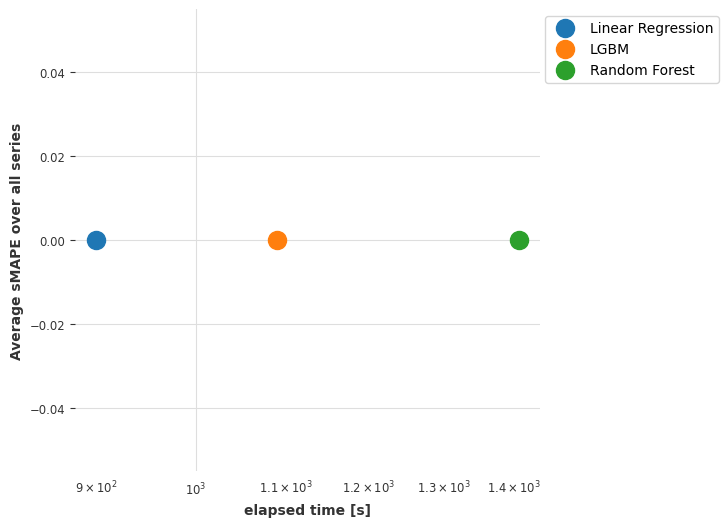

Visualization of performances taking the median of the smapes over cross-validation


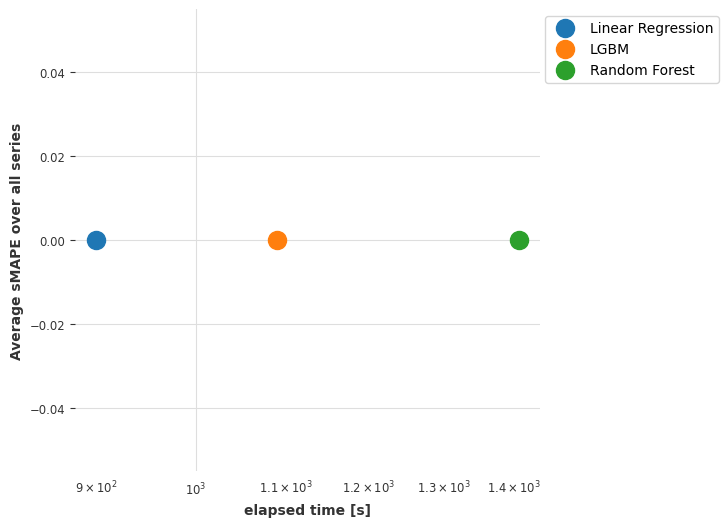

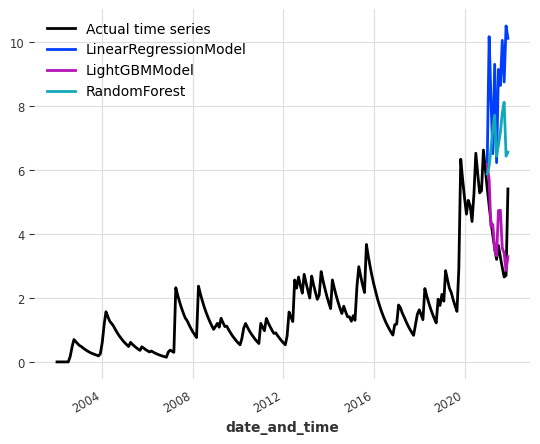

The results for index_colab_increm are:
The results for index_colab_increm with an horizon of 3 are:


[I 2023-01-28 11:41:56,833] A new study created in memory with name: no-name-56820193-ee14-45c2-a973-a999e3f1e2f4
[I 2023-01-28 11:42:00,320] Trial 0 finished with value: 119.46635214944553 and parameters: {'out_len': 3}. Best is trial 0 with value: 119.46635214944553.
[I 2023-01-28 11:42:03,897] Trial 1 finished with value: 119.46635214944553 and parameters: {'out_len': 3}. Best is trial 0 with value: 119.46635214944553.
[I 2023-01-28 11:42:08,097] Trial 2 finished with value: 132.27607168014745 and parameters: {'out_len': 12}. Best is trial 0 with value: 119.46635214944553.
[I 2023-01-28 11:42:12,244] Trial 3 finished with value: 122.31823747060585 and parameters: {'out_len': 11}. Best is trial 0 with value: 119.46635214944553.
[I 2023-01-28 11:42:16,460] Trial 4 finished with value: 132.27607168014745 and parameters: {'out_len': 12}. Best is trial 0 with value: 119.46635214944553.
[I 2023-01-28 11:42:20,060] Trial 5 finished with value: 121.26629636571467 and parameters: {'out_len':

[I 2023-01-28 11:48:47,776] Trial 1 finished with value: 89.7924542367079 and parameters: {'out_len': 3}. Best is trial 0 with value: 87.12154511544135.
[I 2023-01-28 11:49:02,621] Trial 2 finished with value: 87.74921677647393 and parameters: {'out_len': 4}. Best is trial 0 with value: 87.12154511544135.
[I 2023-01-28 11:49:17,162] Trial 3 finished with value: 87.51529121434373 and parameters: {'out_len': 1}. Best is trial 0 with value: 87.12154511544135.
[I 2023-01-28 11:49:31,919] Trial 4 finished with value: 87.74921677647393 and parameters: {'out_len': 4}. Best is trial 0 with value: 87.12154511544135.
[I 2023-01-28 11:49:48,721] Trial 5 finished with value: 98.97134224046943 and parameters: {'out_len': 12}. Best is trial 0 with value: 87.12154511544135.
[I 2023-01-28 11:50:03,783] Trial 6 finished with value: 87.74921677647393 and parameters: {'out_len': 4}. Best is trial 0 with value: 87.12154511544135.
[I 2023-01-28 11:50:20,169] Trial 7 finished with value: 88.18064604831171 a

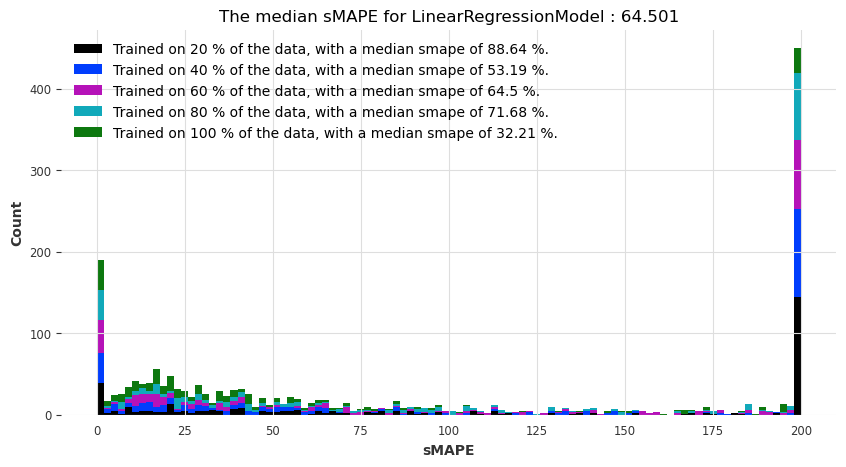

[I 2023-01-28 11:57:53,958] A new study created in memory with name: no-name-44e271bc-b215-470f-8a05-0cda56a0787c
[I 2023-01-28 11:57:57,759] Trial 0 finished with value: 113.3301041175397 and parameters: {'out_len': 3}. Best is trial 0 with value: 113.3301041175397.
[I 2023-01-28 11:58:01,873] Trial 1 finished with value: 113.64792888464112 and parameters: {'out_len': 4}. Best is trial 0 with value: 113.3301041175397.
[I 2023-01-28 11:58:06,402] Trial 2 finished with value: 115.63931394018759 and parameters: {'out_len': 6}. Best is trial 0 with value: 113.3301041175397.
[I 2023-01-28 11:58:11,922] Trial 3 finished with value: 114.25170597445342 and parameters: {'out_len': 11}. Best is trial 0 with value: 113.3301041175397.
[I 2023-01-28 11:58:15,329] Trial 4 finished with value: 111.48212977537119 and parameters: {'out_len': 1}. Best is trial 4 with value: 111.48212977537119.
[I 2023-01-28 11:58:19,874] Trial 5 finished with value: 115.63931394018759 and parameters: {'out_len': 6}. Be

[I 2023-01-28 12:05:59,171] Trial 1 finished with value: 69.61310203156738 and parameters: {'out_len': 6}. Best is trial 0 with value: 67.07991136809964.
[I 2023-01-28 12:06:21,120] Trial 2 finished with value: 72.6274264099894 and parameters: {'out_len': 11}. Best is trial 0 with value: 67.07991136809964.
[I 2023-01-28 12:06:42,281] Trial 3 finished with value: 74.75233308098545 and parameters: {'out_len': 9}. Best is trial 0 with value: 67.07991136809964.
[I 2023-01-28 12:07:00,083] Trial 4 finished with value: 68.92363154728771 and parameters: {'out_len': 5}. Best is trial 0 with value: 67.07991136809964.
[I 2023-01-28 12:07:16,164] Trial 5 finished with value: 63.624675282030246 and parameters: {'out_len': 1}. Best is trial 5 with value: 63.624675282030246.
[I 2023-01-28 12:07:37,421] Trial 6 finished with value: 75.35939195699962 and parameters: {'out_len': 10}. Best is trial 5 with value: 63.624675282030246.
[I 2023-01-28 12:07:57,307] Trial 7 finished with value: 74.752333080985

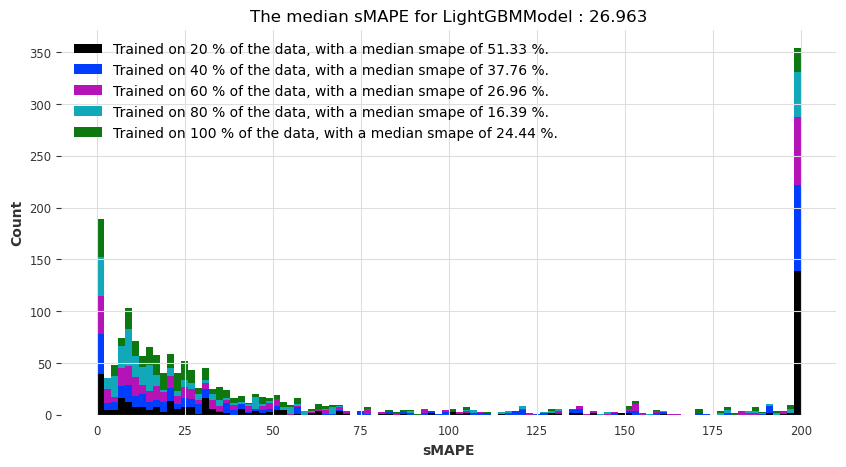

[I 2023-01-28 12:16:28,053] A new study created in memory with name: no-name-8a341bcc-41f8-4203-a3d6-9e94df47dd56
[I 2023-01-28 12:16:33,525] Trial 0 finished with value: 113.07338114875728 and parameters: {'out_len': 7, 'n_estimators': 60, 'max_depth': 25}. Best is trial 0 with value: 113.07338114875728.
[I 2023-01-28 12:16:40,206] Trial 1 finished with value: 109.81140785635864 and parameters: {'out_len': 2, 'n_estimators': 66, 'max_depth': 27}. Best is trial 1 with value: 109.81140785635864.
[I 2023-01-28 12:16:45,867] Trial 2 finished with value: 113.94214497670347 and parameters: {'out_len': 7, 'n_estimators': 63, 'max_depth': 16}. Best is trial 1 with value: 109.81140785635864.
[I 2023-01-28 12:16:52,283] Trial 3 finished with value: 110.42733195674437 and parameters: {'out_len': 1, 'n_estimators': 72, 'max_depth': 11}. Best is trial 1 with value: 109.81140785635864.
[I 2023-01-28 12:16:57,608] Trial 4 finished with value: 112.22980034868604 and parameters: {'out_len': 10, 'n_est

[I 2023-01-28 12:26:01,935] Trial 9 finished with value: 48.55464005812592 and parameters: {'out_len': 11, 'n_estimators': 51, 'max_depth': 21}. Best is trial 7 with value: 34.662491831682665.
[I 2023-01-28 12:26:33,427] Trial 10 finished with value: 35.23307055720042 and parameters: {'out_len': 1, 'n_estimators': 67, 'max_depth': 29}. Best is trial 7 with value: 34.662491831682665.
[I 2023-01-28 12:27:04,021] Trial 11 finished with value: 35.5839154551999 and parameters: {'out_len': 1, 'n_estimators': 65, 'max_depth': 30}. Best is trial 7 with value: 34.662491831682665.
[I 2023-01-28 12:27:31,640] Trial 12 finished with value: 37.088215604132486 and parameters: {'out_len': 4, 'n_estimators': 69, 'max_depth': 26}. Best is trial 7 with value: 34.662491831682665.
[I 2023-01-28 12:28:01,132] Trial 13 finished with value: 37.00775823746778 and parameters: {'out_len': 3, 'n_estimators': 72, 'max_depth': 24}. Best is trial 7 with value: 34.662491831682665.
[I 2023-01-28 12:28:29,677] Trial 1

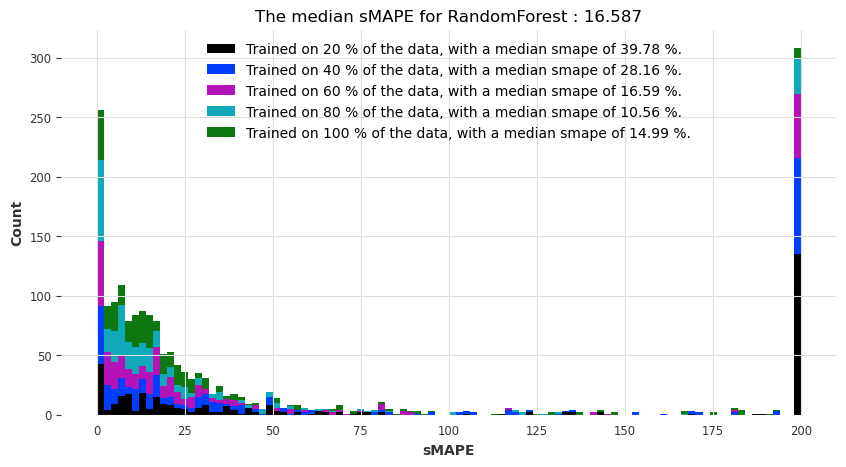

Visualization of performances taking the mean of the smapes over cross-validation


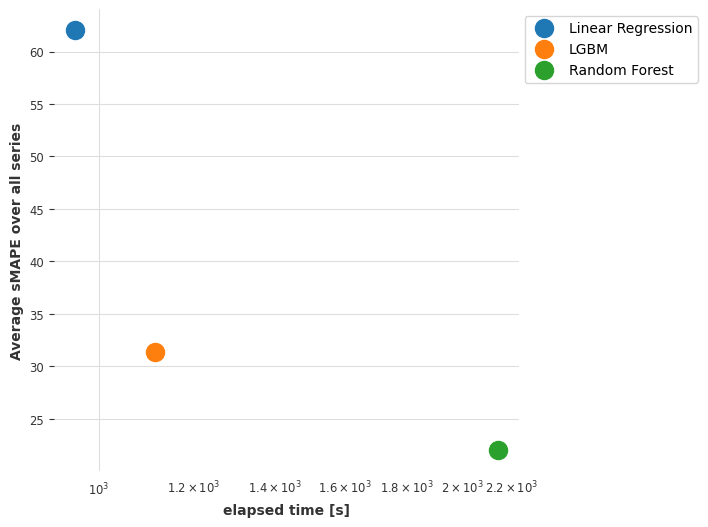

Visualization of performances taking the median of the smapes over cross-validation


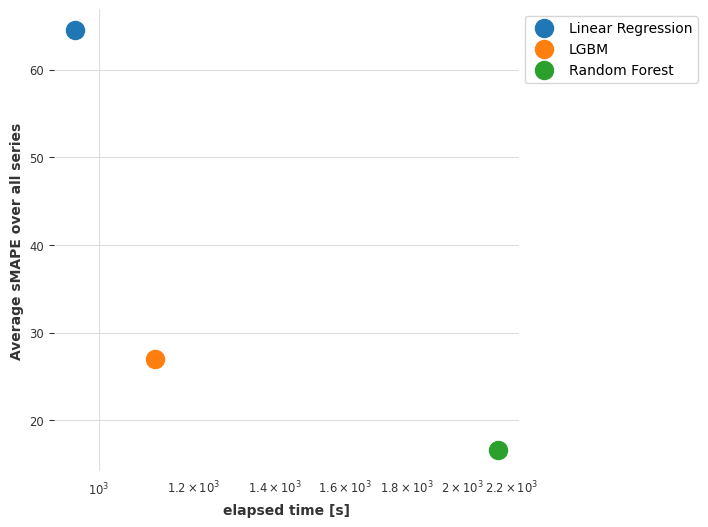

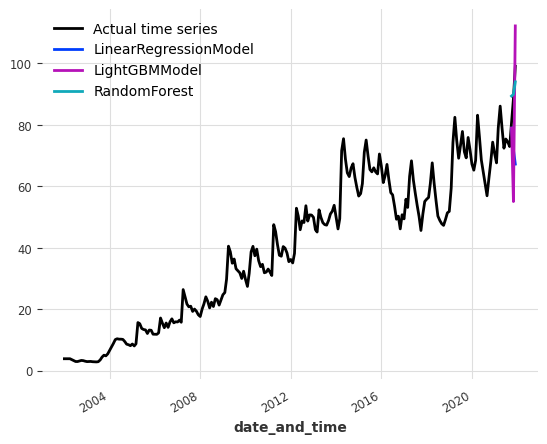

The results for index_colab_increm with an horizon of 6 are:


[I 2023-01-28 12:52:12,132] A new study created in memory with name: no-name-4b732ecc-86a3-40a0-8692-d1cc4904e03c
[I 2023-01-28 12:52:15,681] Trial 0 finished with value: 130.50499547649844 and parameters: {'out_len': 6}. Best is trial 0 with value: 130.50499547649844.
[I 2023-01-28 12:52:19,552] Trial 1 finished with value: 127.7348236116682 and parameters: {'out_len': 10}. Best is trial 1 with value: 127.7348236116682.
[I 2023-01-28 12:52:23,327] Trial 2 finished with value: 129.39171630326325 and parameters: {'out_len': 8}. Best is trial 1 with value: 127.7348236116682.
[I 2023-01-28 12:52:26,601] Trial 3 finished with value: 129.8796032522174 and parameters: {'out_len': 2}. Best is trial 1 with value: 127.7348236116682.
[I 2023-01-28 12:52:29,868] Trial 4 finished with value: 129.8796032522174 and parameters: {'out_len': 2}. Best is trial 1 with value: 127.7348236116682.
[I 2023-01-28 12:52:33,765] Trial 5 finished with value: 127.7348236116682 and parameters: {'out_len': 10}. Best

[I 2023-01-28 12:58:51,371] Trial 1 finished with value: 92.6731207635252 and parameters: {'out_len': 2}. Best is trial 1 with value: 92.6731207635252.
[I 2023-01-28 12:59:06,215] Trial 2 finished with value: 101.00652419821606 and parameters: {'out_len': 11}. Best is trial 1 with value: 92.6731207635252.
[I 2023-01-28 12:59:21,969] Trial 3 finished with value: 101.00652419821606 and parameters: {'out_len': 11}. Best is trial 1 with value: 92.6731207635252.
[I 2023-01-28 12:59:36,115] Trial 4 finished with value: 96.42683856330115 and parameters: {'out_len': 3}. Best is trial 1 with value: 92.6731207635252.
[I 2023-01-28 12:59:51,778] Trial 5 finished with value: 95.8087503654541 and parameters: {'out_len': 9}. Best is trial 1 with value: 92.6731207635252.
[I 2023-01-28 13:00:06,677] Trial 6 finished with value: 107.99757389694234 and parameters: {'out_len': 12}. Best is trial 1 with value: 92.6731207635252.
[I 2023-01-28 13:00:21,278] Trial 7 finished with value: 95.23135114445466 and

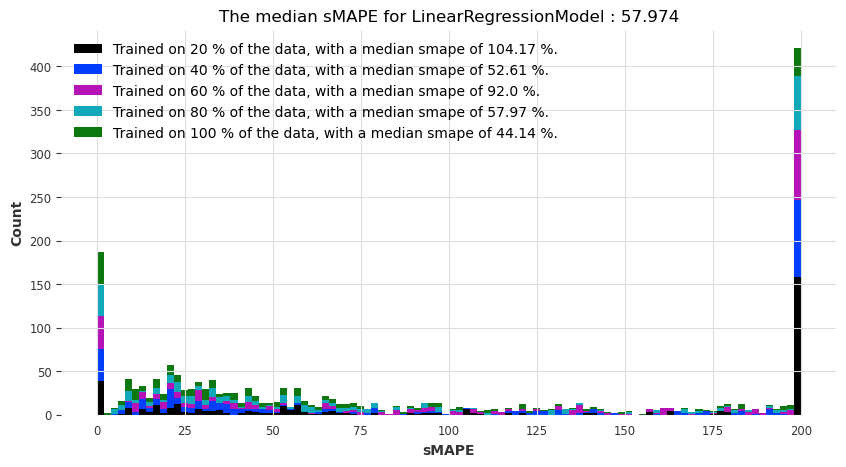

[I 2023-01-28 13:07:39,170] A new study created in memory with name: no-name-491bb6e5-4833-4a64-bb55-0d4fecf2f918
[I 2023-01-28 13:07:44,476] Trial 0 finished with value: 121.22008282138684 and parameters: {'out_len': 9}. Best is trial 0 with value: 121.22008282138684.
[I 2023-01-28 13:07:49,886] Trial 1 finished with value: 121.22008282138684 and parameters: {'out_len': 9}. Best is trial 0 with value: 121.22008282138684.
[I 2023-01-28 13:07:55,815] Trial 2 finished with value: 119.78094172973745 and parameters: {'out_len': 12}. Best is trial 2 with value: 119.78094172973745.
[I 2023-01-28 13:07:59,857] Trial 3 finished with value: 118.07506445689886 and parameters: {'out_len': 1}. Best is trial 3 with value: 118.07506445689886.
[I 2023-01-28 13:08:03,382] Trial 4 finished with value: 118.07506445689886 and parameters: {'out_len': 1}. Best is trial 3 with value: 118.07506445689886.
[I 2023-01-28 13:08:08,099] Trial 5 finished with value: 120.69889675839397 and parameters: {'out_len': 6

[I 2023-01-28 13:15:26,019] Trial 1 finished with value: 87.33870277897992 and parameters: {'out_len': 11}. Best is trial 0 with value: 76.63913671055465.
[I 2023-01-28 13:15:42,957] Trial 2 finished with value: 76.63913671055465 and parameters: {'out_len': 3}. Best is trial 0 with value: 76.63913671055465.
[I 2023-01-28 13:16:01,478] Trial 3 finished with value: 81.44840090151743 and parameters: {'out_len': 7}. Best is trial 0 with value: 76.63913671055465.
[I 2023-01-28 13:16:19,245] Trial 4 finished with value: 79.69202605043448 and parameters: {'out_len': 6}. Best is trial 0 with value: 76.63913671055465.
[I 2023-01-28 13:16:41,440] Trial 5 finished with value: 87.33870277897992 and parameters: {'out_len': 11}. Best is trial 0 with value: 76.63913671055465.
[I 2023-01-28 13:17:02,678] Trial 6 finished with value: 84.36881536136072 and parameters: {'out_len': 12}. Best is trial 0 with value: 76.63913671055465.
[I 2023-01-28 13:17:21,032] Trial 7 finished with value: 80.0211315576848

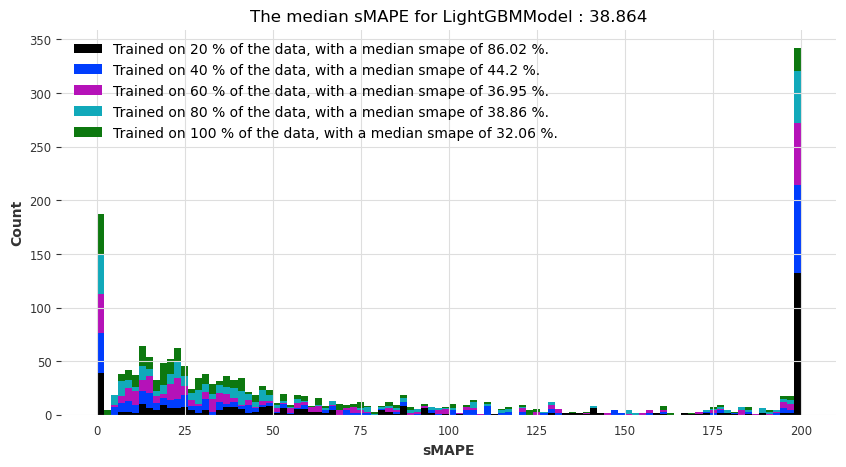

[I 2023-01-28 13:26:13,097] A new study created in memory with name: no-name-b1e5594e-231f-45ad-b557-0bdd7b709ad6
[I 2023-01-28 13:26:18,442] Trial 0 finished with value: 117.81792639732494 and parameters: {'out_len': 8, 'n_estimators': 68, 'max_depth': 20}. Best is trial 0 with value: 117.81792639732494.
[I 2023-01-28 13:26:23,598] Trial 1 finished with value: 115.2449352342405 and parameters: {'out_len': 10, 'n_estimators': 71, 'max_depth': 22}. Best is trial 1 with value: 115.2449352342405.
[I 2023-01-28 13:26:28,334] Trial 2 finished with value: 119.93136265276003 and parameters: {'out_len': 6, 'n_estimators': 78, 'max_depth': 5}. Best is trial 1 with value: 115.2449352342405.
[I 2023-01-28 13:26:34,968] Trial 3 finished with value: 117.28849113387 and parameters: {'out_len': 8, 'n_estimators': 80, 'max_depth': 13}. Best is trial 1 with value: 115.2449352342405.
[I 2023-01-28 13:26:40,300] Trial 4 finished with value: 117.45619752894505 and parameters: {'out_len': 11, 'n_estimators

[I 2023-01-28 13:34:46,705] Trial 8 finished with value: 50.87517778132878 and parameters: {'out_len': 1, 'n_estimators': 56, 'max_depth': 26}. Best is trial 8 with value: 50.87517778132878.
[I 2023-01-28 13:35:12,576] Trial 9 finished with value: 47.25370259047055 and parameters: {'out_len': 4, 'n_estimators': 60, 'max_depth': 25}. Best is trial 9 with value: 47.25370259047055.
[I 2023-01-28 13:35:35,045] Trial 10 finished with value: 62.0197017154462 and parameters: {'out_len': 4, 'n_estimators': 71, 'max_depth': 10}. Best is trial 9 with value: 47.25370259047055.
[I 2023-01-28 13:36:00,324] Trial 11 finished with value: 43.495595569066786 and parameters: {'out_len': 1, 'n_estimators': 52, 'max_depth': 27}. Best is trial 11 with value: 43.495595569066786.
[I 2023-01-28 13:36:26,168] Trial 12 finished with value: 46.326521657334574 and parameters: {'out_len': 1, 'n_estimators': 54, 'max_depth': 26}. Best is trial 11 with value: 43.495595569066786.
[I 2023-01-28 13:36:43,598] Trial 13 

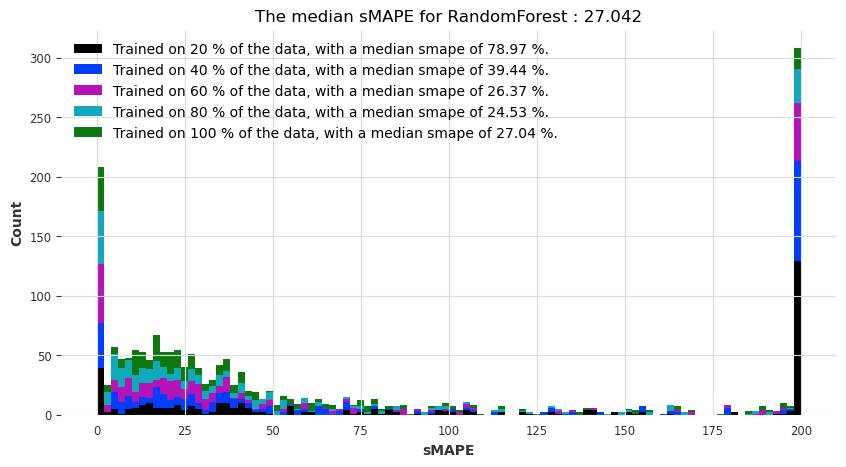

Visualization of performances taking the mean of the smapes over cross-validation


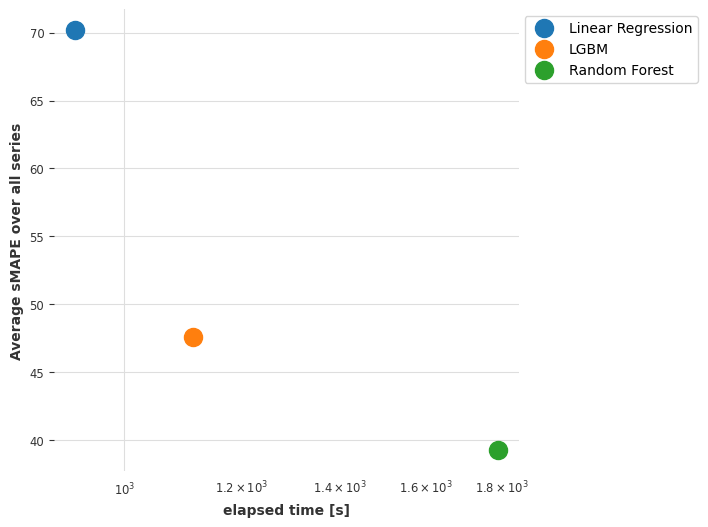

Visualization of performances taking the median of the smapes over cross-validation


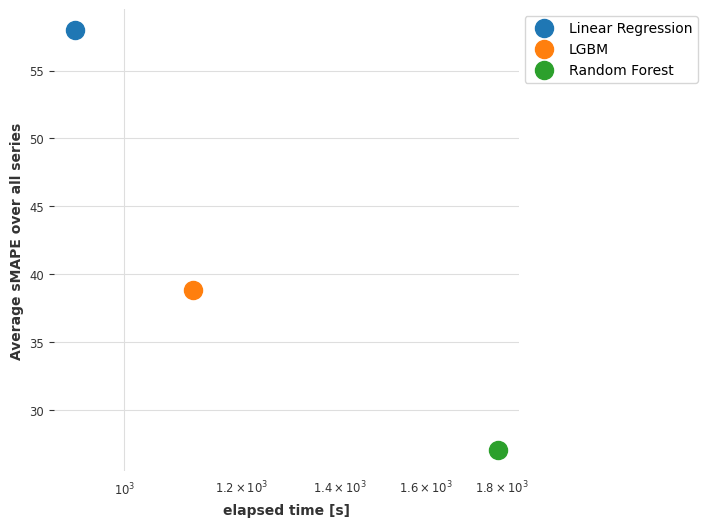

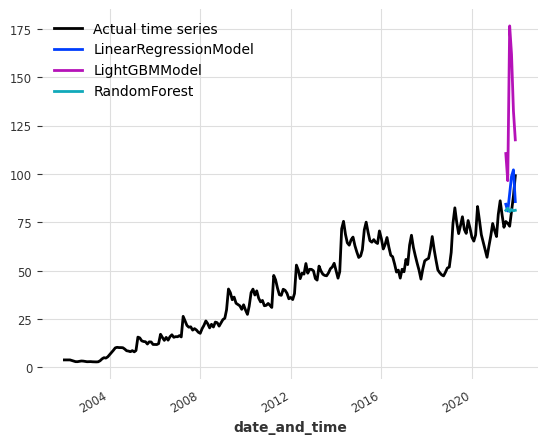

The results for index_colab_increm with an horizon of 12 are:


[I 2023-01-28 13:56:04,178] A new study created in memory with name: no-name-701eef75-cd9e-4ac7-b2a6-880ffc45d958
[I 2023-01-28 13:56:08,131] Trial 0 finished with value: 137.4579390791613 and parameters: {'out_len': 12}. Best is trial 0 with value: 137.4579390791613.
[I 2023-01-28 13:56:11,894] Trial 1 finished with value: 136.7115725777964 and parameters: {'out_len': 9}. Best is trial 1 with value: 136.7115725777964.
[I 2023-01-28 13:56:15,645] Trial 2 finished with value: 136.7115725777964 and parameters: {'out_len': 9}. Best is trial 1 with value: 136.7115725777964.
[I 2023-01-28 13:56:19,427] Trial 3 finished with value: 136.7115725777964 and parameters: {'out_len': 9}. Best is trial 1 with value: 136.7115725777964.
[I 2023-01-28 13:56:22,788] Trial 4 finished with value: 138.09028797182336 and parameters: {'out_len': 4}. Best is trial 1 with value: 136.7115725777964.
[I 2023-01-28 13:56:26,094] Trial 5 finished with value: 137.7331139128728 and parameters: {'out_len': 3}. Best is

[I 2023-01-28 14:02:27,279] Trial 1 finished with value: 101.09108056248013 and parameters: {'out_len': 5}. Best is trial 1 with value: 101.09108056248013.
[I 2023-01-28 14:02:43,189] Trial 2 finished with value: 109.49294799863148 and parameters: {'out_len': 11}. Best is trial 1 with value: 101.09108056248013.
[I 2023-01-28 14:02:56,995] Trial 3 finished with value: 108.17282263544159 and parameters: {'out_len': 1}. Best is trial 1 with value: 101.09108056248013.
[I 2023-01-28 14:03:11,575] Trial 4 finished with value: 117.35456740609901 and parameters: {'out_len': 12}. Best is trial 1 with value: 101.09108056248013.
[I 2023-01-28 14:03:26,813] Trial 5 finished with value: 103.22205152942283 and parameters: {'out_len': 8}. Best is trial 1 with value: 101.09108056248013.
[I 2023-01-28 14:03:40,993] Trial 6 finished with value: 101.56204612629237 and parameters: {'out_len': 6}. Best is trial 1 with value: 101.09108056248013.
[I 2023-01-28 14:03:54,850] Trial 7 finished with value: 106.0

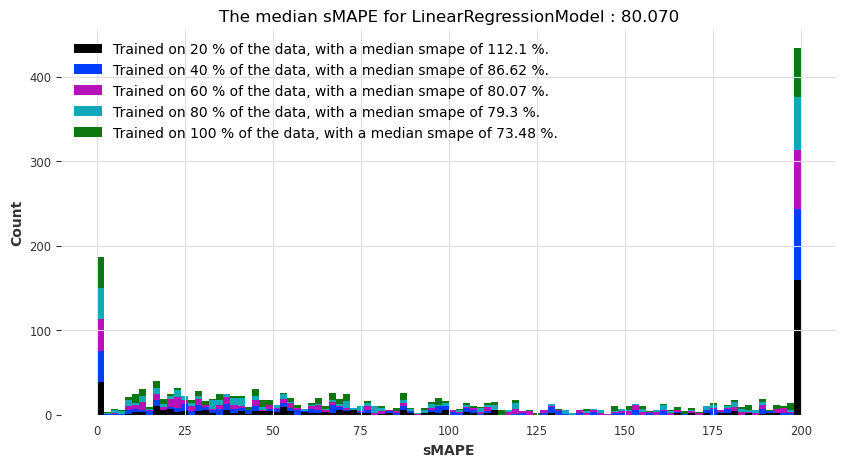

[I 2023-01-28 14:11:03,954] A new study created in memory with name: no-name-793ccebc-2765-4fb6-a6eb-fd0dc37a9f81
[I 2023-01-28 14:11:10,791] Trial 0 finished with value: 125.77151915019205 and parameters: {'out_len': 12}. Best is trial 0 with value: 125.77151915019205.
[I 2023-01-28 14:11:15,699] Trial 1 finished with value: 121.10886909342821 and parameters: {'out_len': 7}. Best is trial 1 with value: 121.10886909342821.
[I 2023-01-28 14:11:20,788] Trial 2 finished with value: 122.64364208097163 and parameters: {'out_len': 8}. Best is trial 1 with value: 121.10886909342821.
[I 2023-01-28 14:11:26,338] Trial 3 finished with value: 121.89988177784709 and parameters: {'out_len': 10}. Best is trial 1 with value: 121.10886909342821.
[I 2023-01-28 14:11:32,216] Trial 4 finished with value: 125.77151915019205 and parameters: {'out_len': 12}. Best is trial 1 with value: 121.10886909342821.
[I 2023-01-28 14:11:36,372] Trial 5 finished with value: 124.72983327913127 and parameters: {'out_len':

[I 2023-01-28 14:18:58,675] Trial 1 finished with value: 88.26254586988247 and parameters: {'out_len': 3}. Best is trial 0 with value: 85.31859142662795.
[I 2023-01-28 14:19:18,928] Trial 2 finished with value: 91.2769085679877 and parameters: {'out_len': 9}. Best is trial 0 with value: 85.31859142662795.
[I 2023-01-28 14:19:39,503] Trial 3 finished with value: 92.44556346628268 and parameters: {'out_len': 12}. Best is trial 0 with value: 85.31859142662795.
[I 2023-01-28 14:19:55,719] Trial 4 finished with value: 88.68822313568924 and parameters: {'out_len': 2}. Best is trial 0 with value: 85.31859142662795.
[I 2023-01-28 14:20:16,551] Trial 5 finished with value: 92.94149328929272 and parameters: {'out_len': 10}. Best is trial 0 with value: 85.31859142662795.
[I 2023-01-28 14:20:34,128] Trial 6 finished with value: 85.31859142662795 and parameters: {'out_len': 6}. Best is trial 0 with value: 85.31859142662795.
[I 2023-01-28 14:20:54,391] Trial 7 finished with value: 92.94149328929272 

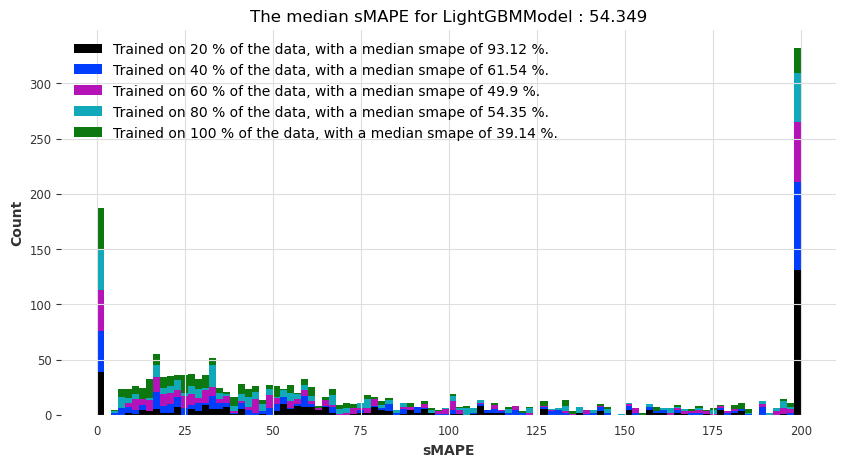

[I 2023-01-28 14:29:25,523] A new study created in memory with name: no-name-5168fb3a-c66f-4aa6-85d8-ea60d15cc9a1
[I 2023-01-28 14:29:31,147] Trial 0 finished with value: 118.5182420215087 and parameters: {'out_len': 6, 'n_estimators': 68, 'max_depth': 21}. Best is trial 0 with value: 118.5182420215087.
[I 2023-01-28 14:29:36,762] Trial 1 finished with value: 120.09860178024839 and parameters: {'out_len': 11, 'n_estimators': 52, 'max_depth': 14}. Best is trial 0 with value: 118.5182420215087.
[I 2023-01-28 14:29:42,924] Trial 2 finished with value: 114.71511460279987 and parameters: {'out_len': 1, 'n_estimators': 72, 'max_depth': 12}. Best is trial 2 with value: 114.71511460279987.
[I 2023-01-28 14:29:48,516] Trial 3 finished with value: 118.33039839469578 and parameters: {'out_len': 5, 'n_estimators': 61, 'max_depth': 27}. Best is trial 2 with value: 114.71511460279987.
[I 2023-01-28 14:29:54,722] Trial 4 finished with value: 117.08118689327223 and parameters: {'out_len': 3, 'n_estima

[I 2023-01-28 14:38:28,757] Trial 9 finished with value: 65.03620285299785 and parameters: {'out_len': 2, 'n_estimators': 54, 'max_depth': 19}. Best is trial 9 with value: 65.03620285299785.
[I 2023-01-28 14:38:59,225] Trial 10 finished with value: 70.56419779141335 and parameters: {'out_len': 1, 'n_estimators': 75, 'max_depth': 18}. Best is trial 9 with value: 65.03620285299785.
[I 2023-01-28 14:39:26,337] Trial 11 finished with value: 66.85245553550835 and parameters: {'out_len': 3, 'n_estimators': 63, 'max_depth': 21}. Best is trial 9 with value: 65.03620285299785.
[I 2023-01-28 14:39:53,848] Trial 12 finished with value: 66.50814545627198 and parameters: {'out_len': 1, 'n_estimators': 63, 'max_depth': 22}. Best is trial 9 with value: 65.03620285299785.
[I 2023-01-28 14:40:17,588] Trial 13 finished with value: 77.2905310263977 and parameters: {'out_len': 1, 'n_estimators': 59, 'max_depth': 13}. Best is trial 9 with value: 65.03620285299785.
[I 2023-01-28 14:40:45,473] Trial 14 finis

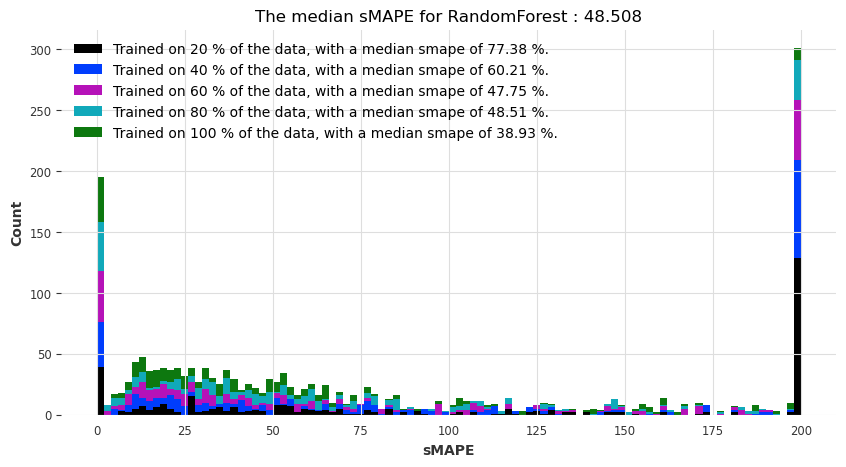

Visualization of performances taking the mean of the smapes over cross-validation


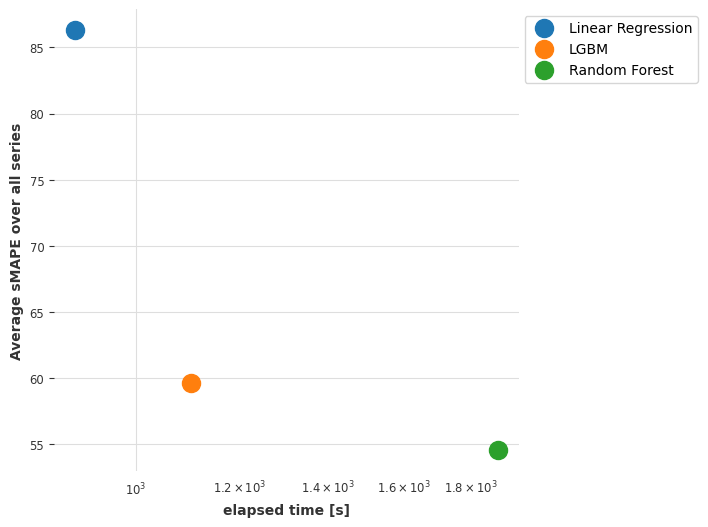

Visualization of performances taking the median of the smapes over cross-validation


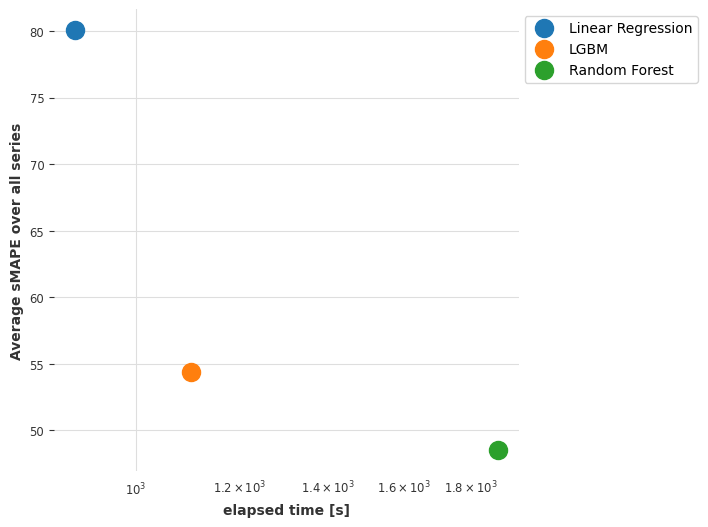

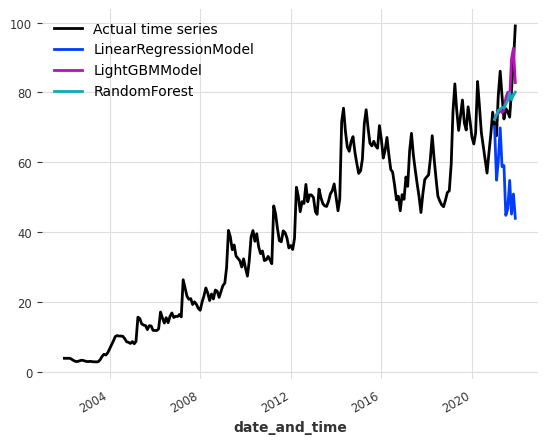

The results for index_colab_notincrem are:
The results for index_colab_notincrem with an horizon of 3 are:


[I 2023-01-28 15:00:54,283] A new study created in memory with name: no-name-ca6d10b2-29af-43a0-b409-5063072df7a8
[I 2023-01-28 15:00:57,776] Trial 0 finished with value: 118.1507584002662 and parameters: {'out_len': 4}. Best is trial 0 with value: 118.1507584002662.
[I 2023-01-28 15:01:01,928] Trial 1 finished with value: 130.49089344278414 and parameters: {'out_len': 12}. Best is trial 0 with value: 118.1507584002662.
[I 2023-01-28 15:01:05,352] Trial 2 finished with value: 117.17246817320763 and parameters: {'out_len': 3}. Best is trial 2 with value: 117.17246817320763.
[I 2023-01-28 15:01:08,625] Trial 3 finished with value: 117.96578295203 and parameters: {'out_len': 1}. Best is trial 2 with value: 117.17246817320763.
[I 2023-01-28 15:01:12,686] Trial 4 finished with value: 122.17780830925821 and parameters: {'out_len': 11}. Best is trial 2 with value: 117.17246817320763.
[I 2023-01-28 15:01:16,124] Trial 5 finished with value: 117.17246817320763 and parameters: {'out_len': 3}. Be

[I 2023-01-28 15:07:38,042] Trial 1 finished with value: 87.13762175740004 and parameters: {'out_len': 10}. Best is trial 0 with value: 87.09336172795915.
[I 2023-01-28 15:07:53,408] Trial 2 finished with value: 87.09336172795915 and parameters: {'out_len': 1}. Best is trial 0 with value: 87.09336172795915.
[I 2023-01-28 15:08:07,918] Trial 3 finished with value: 85.11565777295054 and parameters: {'out_len': 4}. Best is trial 3 with value: 85.11565777295054.
[I 2023-01-28 15:08:23,020] Trial 4 finished with value: 90.93463184475902 and parameters: {'out_len': 12}. Best is trial 3 with value: 85.11565777295054.
[I 2023-01-28 15:08:39,287] Trial 5 finished with value: 90.93463184475902 and parameters: {'out_len': 12}. Best is trial 3 with value: 85.11565777295054.
[I 2023-01-28 15:08:54,691] Trial 6 finished with value: 87.13762175740004 and parameters: {'out_len': 10}. Best is trial 3 with value: 85.11565777295054.
[I 2023-01-28 15:09:10,584] Trial 7 finished with value: 87.093361727959

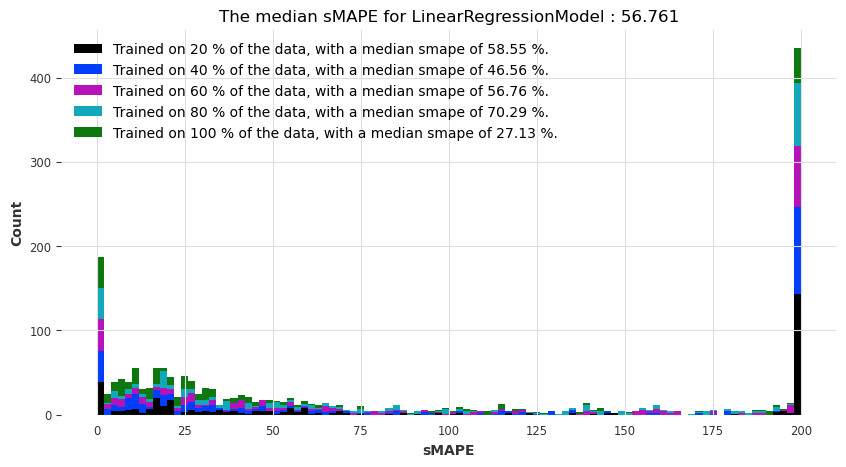

[I 2023-01-28 15:16:33,306] A new study created in memory with name: no-name-e89b8d48-2603-4b33-963f-d671cbe7a69e
[I 2023-01-28 15:16:38,507] Trial 0 finished with value: 114.00840840264769 and parameters: {'out_len': 8}. Best is trial 0 with value: 114.00840840264769.
[I 2023-01-28 15:16:44,205] Trial 1 finished with value: 114.00840840264769 and parameters: {'out_len': 8}. Best is trial 0 with value: 114.00840840264769.
[I 2023-01-28 15:16:50,439] Trial 2 finished with value: 113.67469351479313 and parameters: {'out_len': 12}. Best is trial 2 with value: 113.67469351479313.
[I 2023-01-28 15:16:55,224] Trial 3 finished with value: 112.74134559884973 and parameters: {'out_len': 2}. Best is trial 3 with value: 112.74134559884973.
[I 2023-01-28 15:17:00,285] Trial 4 finished with value: 114.06237081110311 and parameters: {'out_len': 7}. Best is trial 3 with value: 112.74134559884973.
[I 2023-01-28 15:17:06,340] Trial 5 finished with value: 113.67469351479313 and parameters: {'out_len': 1

[I 2023-01-28 15:24:41,484] Trial 1 finished with value: 62.15883403978298 and parameters: {'out_len': 2}. Best is trial 1 with value: 62.15883403978298.
[I 2023-01-28 15:24:57,422] Trial 2 finished with value: 62.15883403978298 and parameters: {'out_len': 2}. Best is trial 1 with value: 62.15883403978298.
[I 2023-01-28 15:25:13,789] Trial 3 finished with value: 64.77056824714064 and parameters: {'out_len': 3}. Best is trial 1 with value: 62.15883403978298.
[I 2023-01-28 15:25:35,415] Trial 4 finished with value: 64.60947908487908 and parameters: {'out_len': 10}. Best is trial 1 with value: 62.15883403978298.
[I 2023-01-28 15:25:56,080] Trial 5 finished with value: 64.60947908487908 and parameters: {'out_len': 10}. Best is trial 1 with value: 62.15883403978298.
[I 2023-01-28 15:26:12,159] Trial 6 finished with value: 62.20038599484539 and parameters: {'out_len': 1}. Best is trial 1 with value: 62.15883403978298.
[I 2023-01-28 15:26:29,749] Trial 7 finished with value: 67.22109154571847

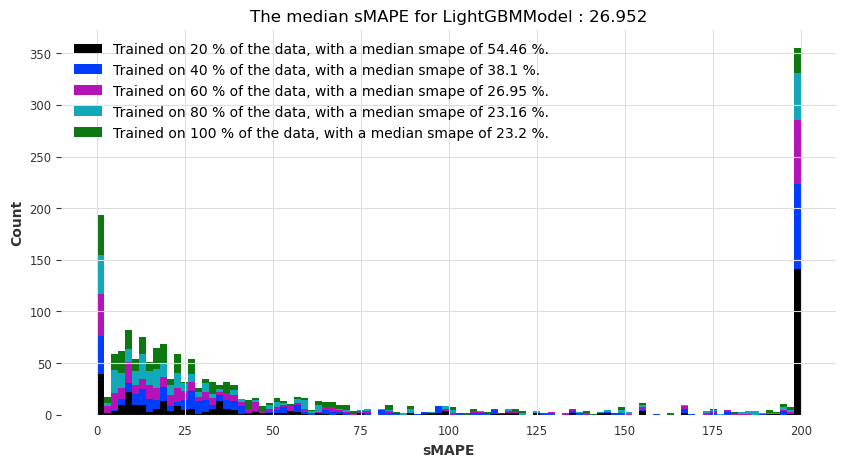

[I 2023-01-28 15:35:21,335] A new study created in memory with name: no-name-fdb4676f-9ecf-44b5-84f4-9aafd2ba199a
[I 2023-01-28 15:35:28,808] Trial 0 finished with value: 111.66276972347798 and parameters: {'out_len': 4, 'n_estimators': 99, 'max_depth': 18}. Best is trial 0 with value: 111.66276972347798.
[I 2023-01-28 15:35:34,775] Trial 1 finished with value: 112.42971196262235 and parameters: {'out_len': 8, 'n_estimators': 88, 'max_depth': 23}. Best is trial 0 with value: 111.66276972347798.
[I 2023-01-28 15:35:40,264] Trial 2 finished with value: 111.8504057497635 and parameters: {'out_len': 5, 'n_estimators': 78, 'max_depth': 8}. Best is trial 0 with value: 111.66276972347798.
[I 2023-01-28 15:35:46,145] Trial 3 finished with value: 111.46146572413635 and parameters: {'out_len': 9, 'n_estimators': 94, 'max_depth': 23}. Best is trial 3 with value: 111.46146572413635.
[I 2023-01-28 15:35:51,854] Trial 4 finished with value: 112.53942684484059 and parameters: {'out_len': 4, 'n_estima

[I 2023-01-28 15:45:15,769] Trial 9 finished with value: 51.032106857897546 and parameters: {'out_len': 10, 'n_estimators': 55, 'max_depth': 18}. Best is trial 7 with value: 35.11946629415997.
[I 2023-01-28 15:45:42,812] Trial 10 finished with value: 41.57009638038466 and parameters: {'out_len': 8, 'n_estimators': 99, 'max_depth': 30}. Best is trial 7 with value: 35.11946629415997.
[I 2023-01-28 15:46:13,050] Trial 11 finished with value: 39.13161618227244 and parameters: {'out_len': 6, 'n_estimators': 89, 'max_depth': 30}. Best is trial 7 with value: 35.11946629415997.
[I 2023-01-28 15:46:41,413] Trial 12 finished with value: 40.24532704029988 and parameters: {'out_len': 7, 'n_estimators': 94, 'max_depth': 26}. Best is trial 7 with value: 35.11946629415997.
[I 2023-01-28 15:47:04,809] Trial 13 finished with value: 38.52592193053879 and parameters: {'out_len': 6, 'n_estimators': 62, 'max_depth': 30}. Best is trial 7 with value: 35.11946629415997.
[I 2023-01-28 15:47:25,418] Trial 14 fi

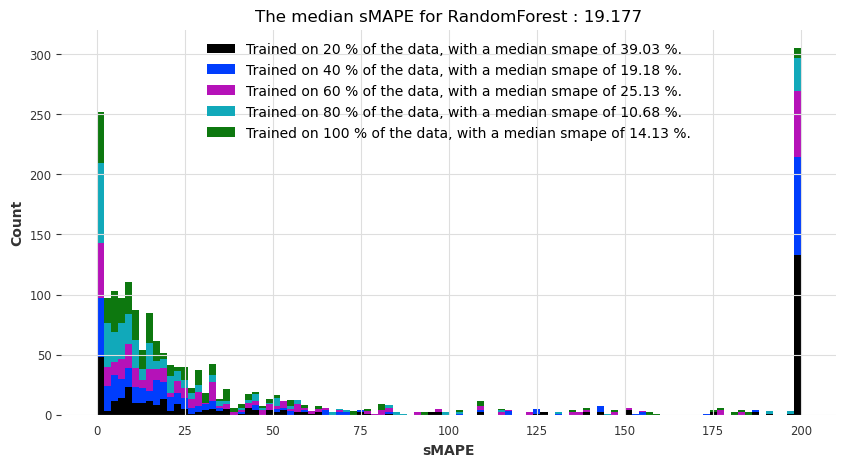

Visualization of performances taking the mean of the smapes over cross-validation


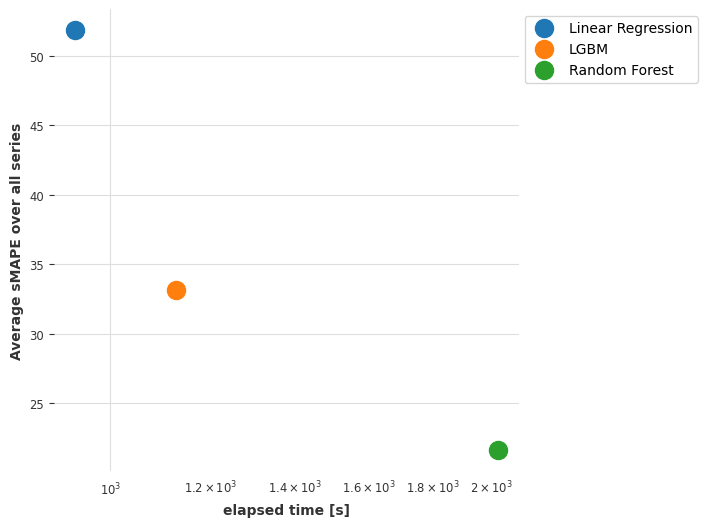

Visualization of performances taking the median of the smapes over cross-validation


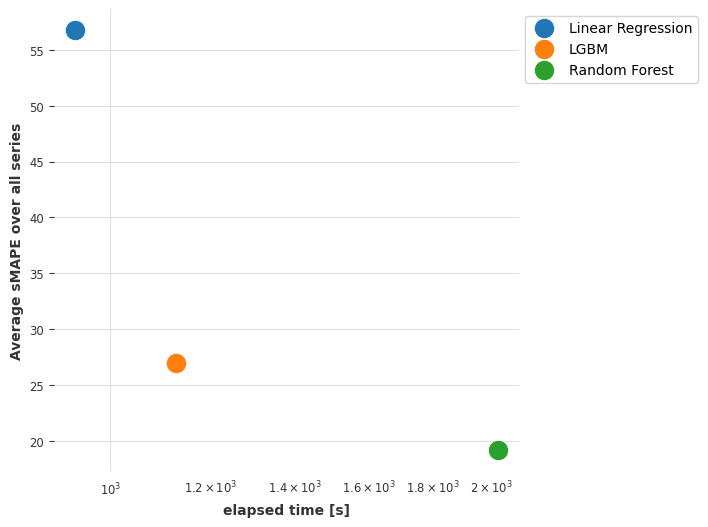

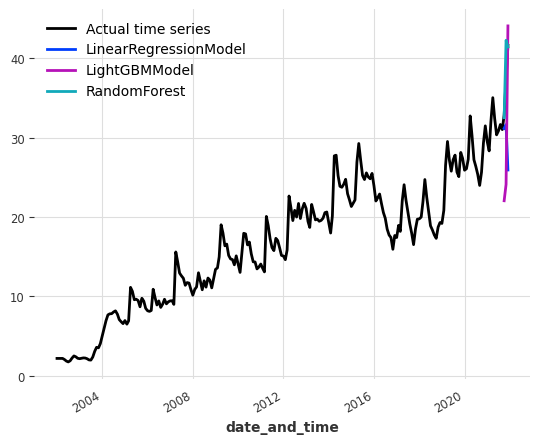

The results for index_colab_notincrem with an horizon of 6 are:


[I 2023-01-28 16:09:08,191] A new study created in memory with name: no-name-14e7952f-42c1-4e80-a6e6-f9373c5c3d68
[I 2023-01-28 16:09:11,941] Trial 0 finished with value: 127.74418673605977 and parameters: {'out_len': 8}. Best is trial 0 with value: 127.74418673605977.
[I 2023-01-28 16:09:15,167] Trial 1 finished with value: 127.96855709153422 and parameters: {'out_len': 1}. Best is trial 0 with value: 127.74418673605977.
[I 2023-01-28 16:09:18,763] Trial 2 finished with value: 128.72724463471354 and parameters: {'out_len': 6}. Best is trial 0 with value: 127.74418673605977.
[I 2023-01-28 16:09:22,752] Trial 3 finished with value: 128.6608178710255 and parameters: {'out_len': 11}. Best is trial 0 with value: 127.74418673605977.
[I 2023-01-28 16:09:26,683] Trial 4 finished with value: 127.84250504369601 and parameters: {'out_len': 10}. Best is trial 0 with value: 127.74418673605977.
[I 2023-01-28 16:09:31,119] Trial 5 finished with value: 127.84250504369601 and parameters: {'out_len': 1

[I 2023-01-28 16:15:40,617] Trial 1 finished with value: 99.32038426988115 and parameters: {'out_len': 8}. Best is trial 0 with value: 94.79573955587406.
[I 2023-01-28 16:15:55,684] Trial 2 finished with value: 93.61282321051456 and parameters: {'out_len': 1}. Best is trial 2 with value: 93.61282321051456.
[I 2023-01-28 16:16:09,741] Trial 3 finished with value: 91.43247226026777 and parameters: {'out_len': 2}. Best is trial 3 with value: 91.43247226026777.
[I 2023-01-28 16:16:25,176] Trial 4 finished with value: 94.79573955587406 and parameters: {'out_len': 6}. Best is trial 3 with value: 91.43247226026777.
[I 2023-01-28 16:16:41,037] Trial 5 finished with value: 100.37347822191309 and parameters: {'out_len': 10}. Best is trial 3 with value: 91.43247226026777.
[I 2023-01-28 16:16:57,047] Trial 6 finished with value: 106.6532797862626 and parameters: {'out_len': 12}. Best is trial 3 with value: 91.43247226026777.
[I 2023-01-28 16:17:12,412] Trial 7 finished with value: 92.412902041016 

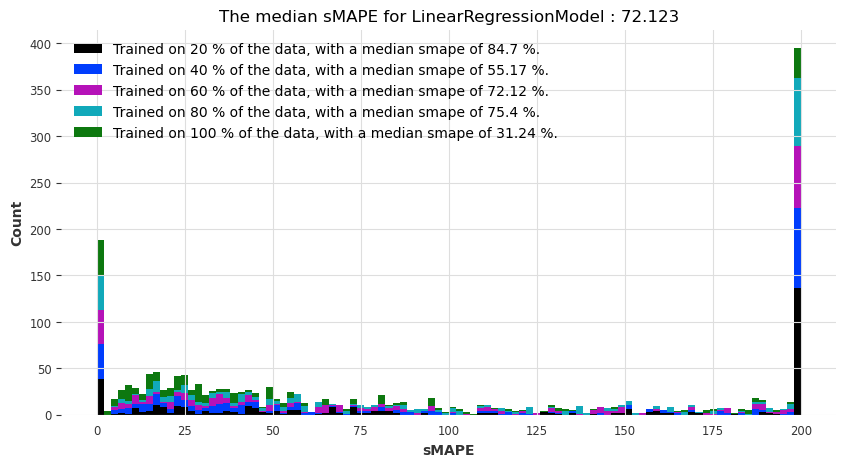

[I 2023-01-28 16:24:28,524] A new study created in memory with name: no-name-43a6a56c-ba4c-4046-9b07-96d42a4abfec
[I 2023-01-28 16:24:34,080] Trial 0 finished with value: 118.91582791621188 and parameters: {'out_len': 10}. Best is trial 0 with value: 118.91582791621188.
[I 2023-01-28 16:24:38,552] Trial 1 finished with value: 120.89462914260068 and parameters: {'out_len': 5}. Best is trial 0 with value: 118.91582791621188.
[I 2023-01-28 16:24:43,550] Trial 2 finished with value: 120.92716539549863 and parameters: {'out_len': 6}. Best is trial 0 with value: 118.91582791621188.
[I 2023-01-28 16:24:49,249] Trial 3 finished with value: 118.91582791621188 and parameters: {'out_len': 10}. Best is trial 0 with value: 118.91582791621188.
[I 2023-01-28 16:24:53,992] Trial 4 finished with value: 120.92716539549863 and parameters: {'out_len': 6}. Best is trial 0 with value: 118.91582791621188.
[I 2023-01-28 16:24:58,256] Trial 5 finished with value: 119.3932314162275 and parameters: {'out_len': 4

[I 2023-01-28 16:32:31,009] Trial 1 finished with value: 74.62385242528887 and parameters: {'out_len': 1}. Best is trial 0 with value: 71.72393966729702.
[I 2023-01-28 16:32:51,092] Trial 2 finished with value: 74.07334972094455 and parameters: {'out_len': 7}. Best is trial 0 with value: 71.72393966729702.
[I 2023-01-28 16:33:06,796] Trial 3 finished with value: 74.62385242528887 and parameters: {'out_len': 1}. Best is trial 0 with value: 71.72393966729702.
[I 2023-01-28 16:33:26,149] Trial 4 finished with value: 74.07334972094455 and parameters: {'out_len': 7}. Best is trial 0 with value: 71.72393966729702.
[I 2023-01-28 16:33:46,290] Trial 5 finished with value: 78.41683518833136 and parameters: {'out_len': 10}. Best is trial 0 with value: 71.72393966729702.
[I 2023-01-28 16:34:00,987] Trial 6 finished with value: 74.62385242528887 and parameters: {'out_len': 1}. Best is trial 0 with value: 71.72393966729702.
[I 2023-01-28 16:34:20,927] Trial 7 finished with value: 78.41683518833136 

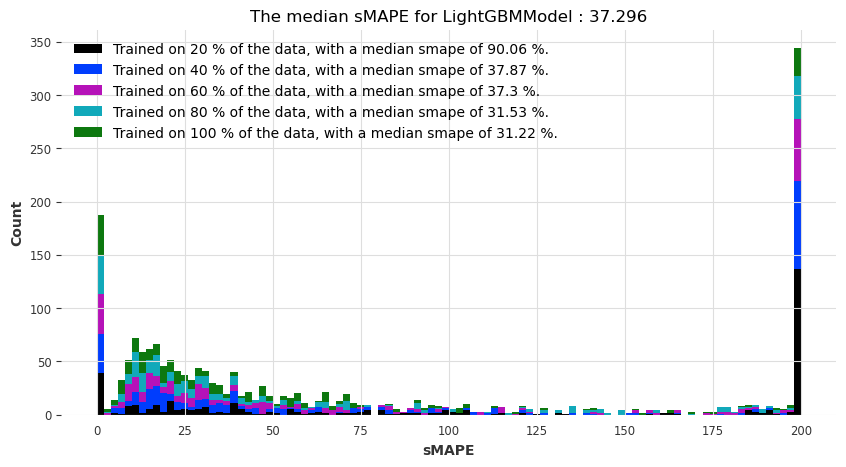

[I 2023-01-28 16:42:49,620] A new study created in memory with name: no-name-6536893e-6843-4214-ac08-d20f08aa3be3
[I 2023-01-28 16:42:55,191] Trial 0 finished with value: 115.75305911398608 and parameters: {'out_len': 4, 'n_estimators': 55, 'max_depth': 27}. Best is trial 0 with value: 115.75305911398608.
[I 2023-01-28 16:43:02,424] Trial 1 finished with value: 115.586304367327 and parameters: {'out_len': 3, 'n_estimators': 92, 'max_depth': 15}. Best is trial 1 with value: 115.586304367327.
[I 2023-01-28 16:43:08,360] Trial 2 finished with value: 116.86257928823669 and parameters: {'out_len': 5, 'n_estimators': 71, 'max_depth': 25}. Best is trial 1 with value: 115.586304367327.
[I 2023-01-28 16:43:12,909] Trial 3 finished with value: 115.64947039236921 and parameters: {'out_len': 12, 'n_estimators': 54, 'max_depth': 10}. Best is trial 1 with value: 115.586304367327.
[I 2023-01-28 16:43:17,562] Trial 4 finished with value: 118.1593140333683 and parameters: {'out_len': 3, 'n_estimators':

[I 2023-01-28 16:52:47,007] Trial 9 finished with value: 49.17047449781634 and parameters: {'out_len': 4, 'n_estimators': 86, 'max_depth': 18}. Best is trial 1 with value: 42.78127566088546.
[I 2023-01-28 16:53:11,241] Trial 10 finished with value: 46.462123427992246 and parameters: {'out_len': 7, 'n_estimators': 69, 'max_depth': 24}. Best is trial 1 with value: 42.78127566088546.
[I 2023-01-28 16:53:27,290] Trial 11 finished with value: 49.66299385813808 and parameters: {'out_len': 11, 'n_estimators': 51, 'max_depth': 28}. Best is trial 1 with value: 42.78127566088546.
[I 2023-01-28 16:53:44,611] Trial 12 finished with value: 46.57123388612603 and parameters: {'out_len': 11, 'n_estimators': 65, 'max_depth': 25}. Best is trial 1 with value: 42.78127566088546.
[I 2023-01-28 16:54:07,793] Trial 13 finished with value: 46.554539092364976 and parameters: {'out_len': 8, 'n_estimators': 78, 'max_depth': 30}. Best is trial 1 with value: 42.78127566088546.
[I 2023-01-28 16:54:27,872] Trial 14 

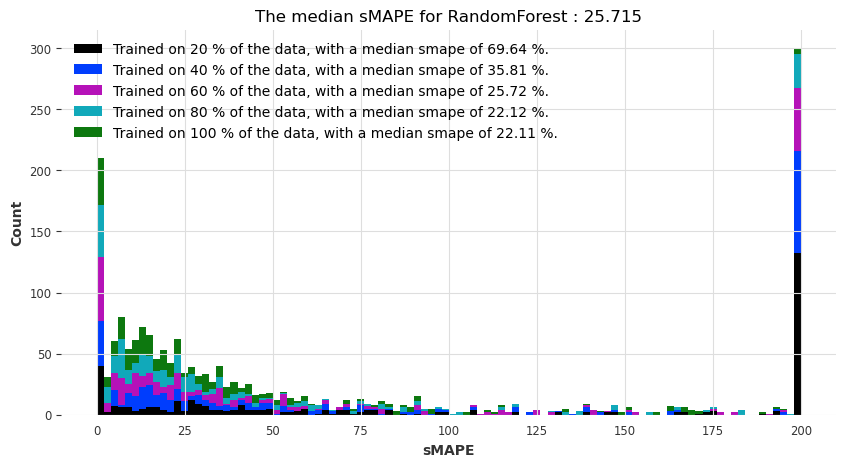

Visualization of performances taking the mean of the smapes over cross-validation


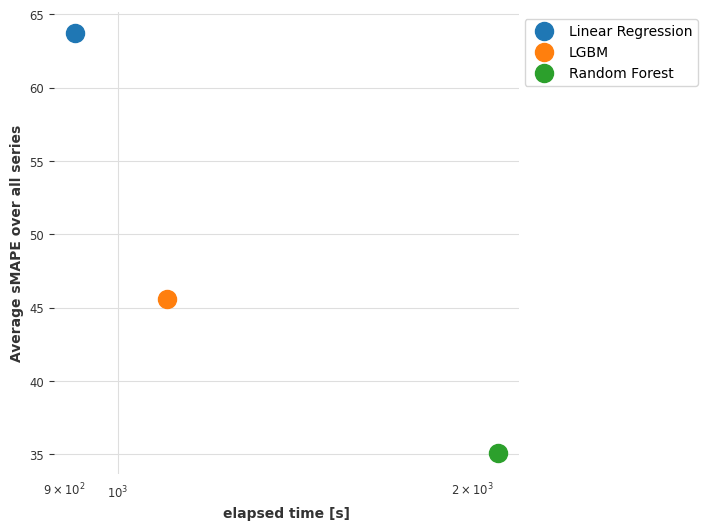

Visualization of performances taking the median of the smapes over cross-validation


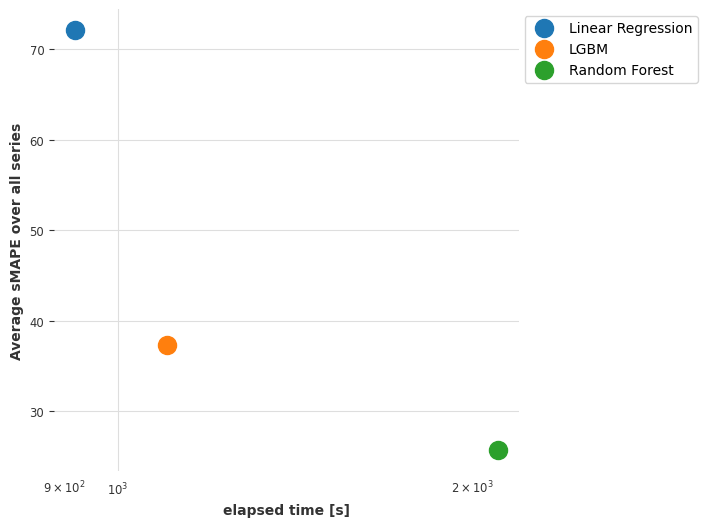

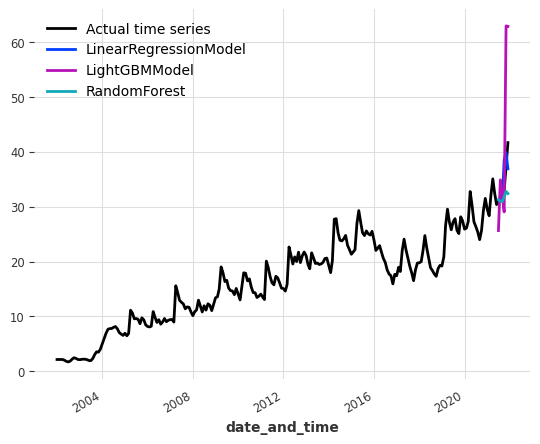

The results for index_colab_notincrem with an horizon of 12 are:


[I 2023-01-28 17:17:52,760] A new study created in memory with name: no-name-c96aadac-1a72-4e08-b41b-2a55d7c8ce60
[I 2023-01-28 17:17:56,311] Trial 0 finished with value: 133.7220544210809 and parameters: {'out_len': 7}. Best is trial 0 with value: 133.7220544210809.
[I 2023-01-28 17:17:59,452] Trial 1 finished with value: 134.11716524006974 and parameters: {'out_len': 1}. Best is trial 0 with value: 133.7220544210809.
[I 2023-01-28 17:18:03,007] Trial 2 finished with value: 136.09563931484143 and parameters: {'out_len': 6}. Best is trial 0 with value: 133.7220544210809.
[I 2023-01-28 17:18:06,221] Trial 3 finished with value: 134.09275970524956 and parameters: {'out_len': 2}. Best is trial 0 with value: 133.7220544210809.
[I 2023-01-28 17:18:09,659] Trial 4 finished with value: 136.66578294244505 and parameters: {'out_len': 5}. Best is trial 0 with value: 133.7220544210809.
[I 2023-01-28 17:18:13,192] Trial 5 finished with value: 136.09563931484143 and parameters: {'out_len': 6}. Best

[I 2023-01-28 17:24:15,977] Trial 1 finished with value: 105.54125538859728 and parameters: {'out_len': 8}. Best is trial 0 with value: 104.58798113148366.
[I 2023-01-28 17:24:31,340] Trial 2 finished with value: 106.66901765103047 and parameters: {'out_len': 9}. Best is trial 0 with value: 104.58798113148366.
[I 2023-01-28 17:24:46,766] Trial 3 finished with value: 100.43878671433536 and parameters: {'out_len': 6}. Best is trial 3 with value: 100.43878671433536.
[I 2023-01-28 17:25:02,127] Trial 4 finished with value: 102.23475017938702 and parameters: {'out_len': 7}. Best is trial 3 with value: 100.43878671433536.
[I 2023-01-28 17:25:16,448] Trial 5 finished with value: 106.66901765103047 and parameters: {'out_len': 9}. Best is trial 3 with value: 100.43878671433536.
[I 2023-01-28 17:25:30,516] Trial 6 finished with value: 98.79515228174006 and parameters: {'out_len': 5}. Best is trial 6 with value: 98.79515228174006.
[I 2023-01-28 17:25:44,579] Trial 7 finished with value: 100.43878

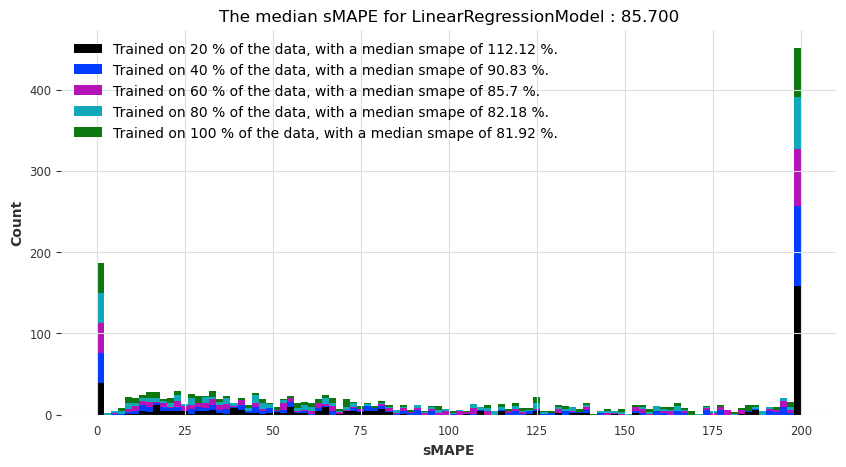

[I 2023-01-28 17:32:52,747] A new study created in memory with name: no-name-8c89d94d-2480-4f4d-b34d-5880f5c0f31b
[I 2023-01-28 17:32:57,082] Trial 0 finished with value: 120.9666872181044 and parameters: {'out_len': 5}. Best is trial 0 with value: 120.9666872181044.
[I 2023-01-28 17:33:00,821] Trial 1 finished with value: 119.54141909517774 and parameters: {'out_len': 2}. Best is trial 1 with value: 119.54141909517774.
[I 2023-01-28 17:33:06,362] Trial 2 finished with value: 122.76754876607573 and parameters: {'out_len': 10}. Best is trial 1 with value: 119.54141909517774.
[I 2023-01-28 17:33:11,883] Trial 3 finished with value: 122.76754876607573 and parameters: {'out_len': 10}. Best is trial 1 with value: 119.54141909517774.
[I 2023-01-28 17:33:16,986] Trial 4 finished with value: 121.12428420893146 and parameters: {'out_len': 8}. Best is trial 1 with value: 119.54141909517774.
[I 2023-01-28 17:33:20,912] Trial 5 finished with value: 120.26115634887468 and parameters: {'out_len': 3}

[I 2023-01-28 17:40:49,730] Trial 1 finished with value: 82.07650582966448 and parameters: {'out_len': 5}. Best is trial 1 with value: 82.07650582966448.
[I 2023-01-28 17:41:10,438] Trial 2 finished with value: 83.46656795312143 and parameters: {'out_len': 12}. Best is trial 1 with value: 82.07650582966448.
[I 2023-01-28 17:41:30,479] Trial 3 finished with value: 83.63574866080312 and parameters: {'out_len': 8}. Best is trial 1 with value: 82.07650582966448.
[I 2023-01-28 17:41:50,782] Trial 4 finished with value: 83.87353174486188 and parameters: {'out_len': 9}. Best is trial 1 with value: 82.07650582966448.
[I 2023-01-28 17:42:09,162] Trial 5 finished with value: 84.70819147241204 and parameters: {'out_len': 7}. Best is trial 1 with value: 82.07650582966448.
[I 2023-01-28 17:42:27,869] Trial 6 finished with value: 83.63574866080312 and parameters: {'out_len': 8}. Best is trial 1 with value: 82.07650582966448.
[I 2023-01-28 17:42:47,844] Trial 7 finished with value: 83.63574866080312 

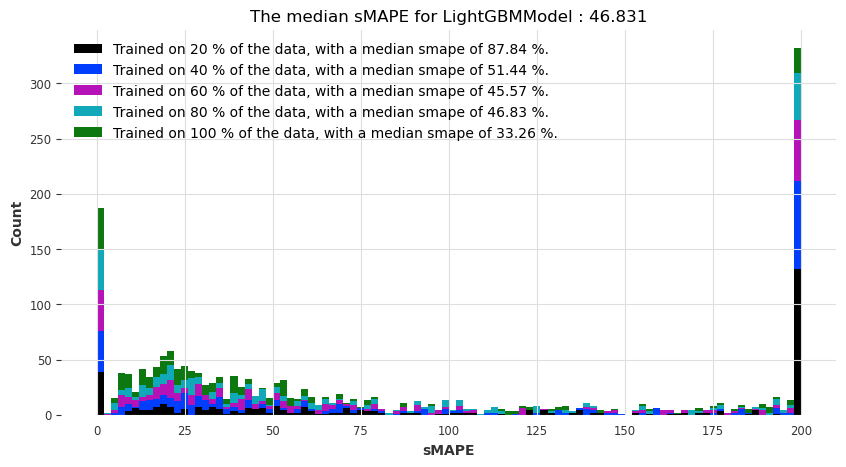

[I 2023-01-28 17:51:14,070] A new study created in memory with name: no-name-ed36e3a7-f2a4-46e5-9484-76d1ecd02cc7
[I 2023-01-28 17:51:21,365] Trial 0 finished with value: 116.40616412216943 and parameters: {'out_len': 1, 'n_estimators': 82, 'max_depth': 21}. Best is trial 0 with value: 116.40616412216943.
[I 2023-01-28 17:51:28,036] Trial 1 finished with value: 115.77392641523218 and parameters: {'out_len': 4, 'n_estimators': 100, 'max_depth': 12}. Best is trial 1 with value: 115.77392641523218.
[I 2023-01-28 17:51:34,728] Trial 2 finished with value: 116.30276030437551 and parameters: {'out_len': 2, 'n_estimators': 84, 'max_depth': 13}. Best is trial 1 with value: 115.77392641523218.
[I 2023-01-28 17:51:40,501] Trial 3 finished with value: 116.56343045218635 and parameters: {'out_len': 6, 'n_estimators': 72, 'max_depth': 30}. Best is trial 1 with value: 115.77392641523218.
[I 2023-01-28 17:51:46,745] Trial 4 finished with value: 116.28364263291427 and parameters: {'out_len': 5, 'n_est

[I 2023-01-28 18:00:11,361] Trial 9 finished with value: 74.55370524126707 and parameters: {'out_len': 2, 'n_estimators': 71, 'max_depth': 6}. Best is trial 2 with value: 59.83335640423365.
[I 2023-01-28 18:00:33,045] Trial 10 finished with value: 60.136967942571495 and parameters: {'out_len': 4, 'n_estimators': 50, 'max_depth': 25}. Best is trial 2 with value: 59.83335640423365.
[I 2023-01-28 18:00:56,108] Trial 11 finished with value: 61.91627664004722 and parameters: {'out_len': 4, 'n_estimators': 50, 'max_depth': 23}. Best is trial 2 with value: 59.83335640423365.
[I 2023-01-28 18:01:20,955] Trial 12 finished with value: 64.20141976726849 and parameters: {'out_len': 4, 'n_estimators': 64, 'max_depth': 24}. Best is trial 2 with value: 59.83335640423365.
[I 2023-01-28 18:01:43,818] Trial 13 finished with value: 62.69919444845836 and parameters: {'out_len': 4, 'n_estimators': 51, 'max_depth': 24}. Best is trial 2 with value: 59.83335640423365.
[I 2023-01-28 18:02:10,215] Trial 14 fini

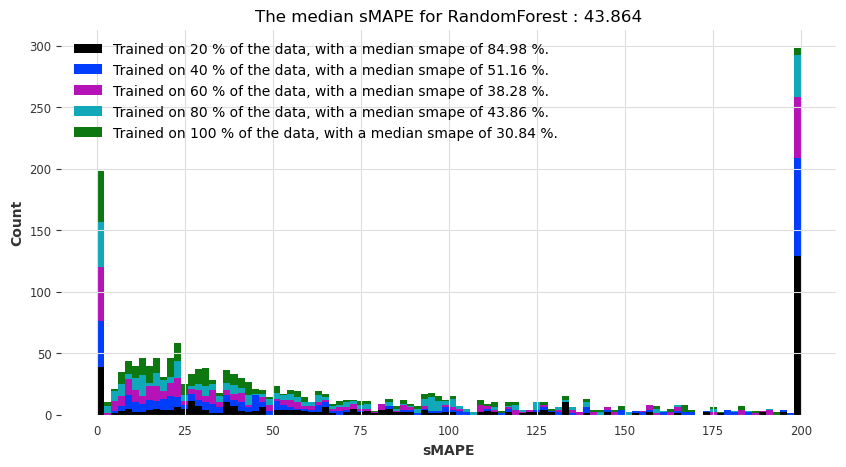

Visualization of performances taking the mean of the smapes over cross-validation


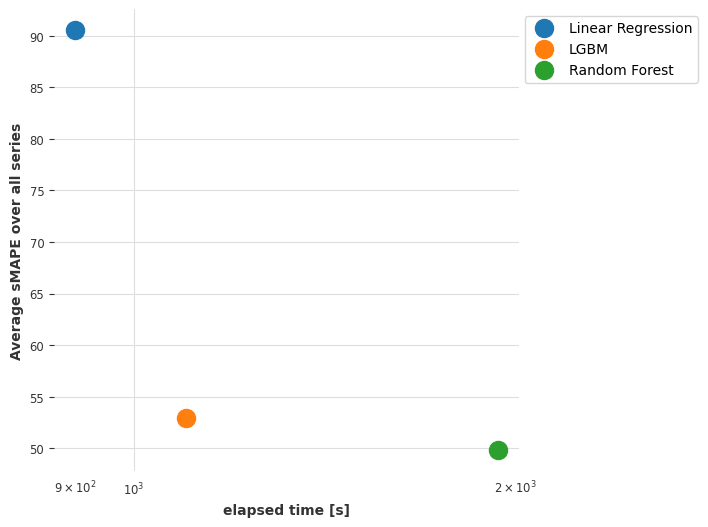

Visualization of performances taking the median of the smapes over cross-validation


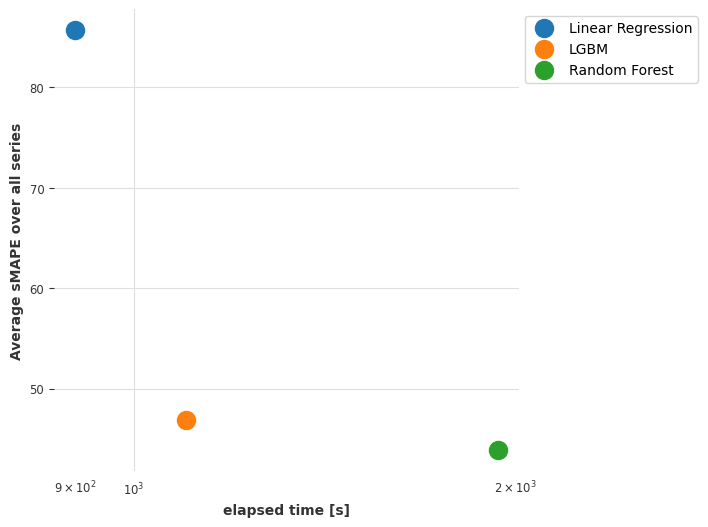

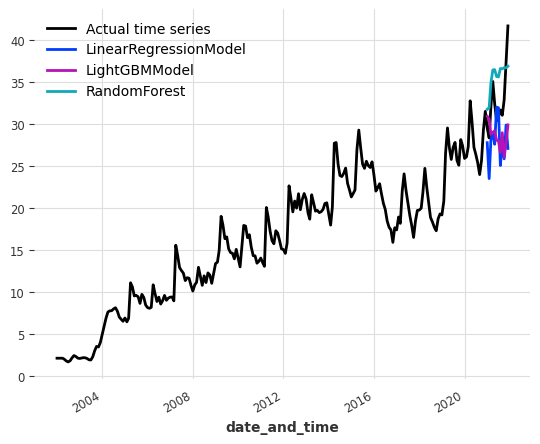

The results for index_keyword are:
The results for index_keyword with an horizon of 3 are:


[I 2023-01-28 18:23:31,735] A new study created in memory with name: no-name-93688214-d3a0-4809-a6c2-7a179f7568f2
[I 2023-01-28 18:23:36,417] Trial 0 finished with value: 21.231959572113333 and parameters: {'out_len': 6}. Best is trial 0 with value: 21.231959572113333.
[I 2023-01-28 18:23:40,099] Trial 1 finished with value: 21.231959572113333 and parameters: {'out_len': 6}. Best is trial 0 with value: 21.231959572113333.
[I 2023-01-28 18:23:44,032] Trial 2 finished with value: 21.48412562154088 and parameters: {'out_len': 9}. Best is trial 0 with value: 21.231959572113333.
[I 2023-01-28 18:23:47,834] Trial 3 finished with value: 22.032140776747653 and parameters: {'out_len': 8}. Best is trial 0 with value: 21.231959572113333.
[I 2023-01-28 18:23:51,310] Trial 4 finished with value: 20.71250644085541 and parameters: {'out_len': 4}. Best is trial 4 with value: 20.71250644085541.
[I 2023-01-28 18:23:54,552] Trial 5 finished with value: 18.96772595893212 and parameters: {'out_len': 1}. Be

[I 2023-01-28 18:30:18,840] Trial 1 finished with value: 11.617726810744129 and parameters: {'out_len': 5}. Best is trial 1 with value: 11.617726810744129.
[I 2023-01-28 18:30:34,959] Trial 2 finished with value: 11.461345411186151 and parameters: {'out_len': 11}. Best is trial 2 with value: 11.461345411186151.
[I 2023-01-28 18:30:50,300] Trial 3 finished with value: 12.337278341705268 and parameters: {'out_len': 7}. Best is trial 2 with value: 11.461345411186151.
[I 2023-01-28 18:31:06,069] Trial 4 finished with value: 11.846972855979574 and parameters: {'out_len': 6}. Best is trial 2 with value: 11.461345411186151.
[I 2023-01-28 18:31:22,314] Trial 5 finished with value: 12.310791959049531 and parameters: {'out_len': 12}. Best is trial 2 with value: 11.461345411186151.
[I 2023-01-28 18:31:37,689] Trial 6 finished with value: 11.448597065768187 and parameters: {'out_len': 2}. Best is trial 6 with value: 11.448597065768187.
[I 2023-01-28 18:31:52,692] Trial 7 finished with value: 11.88

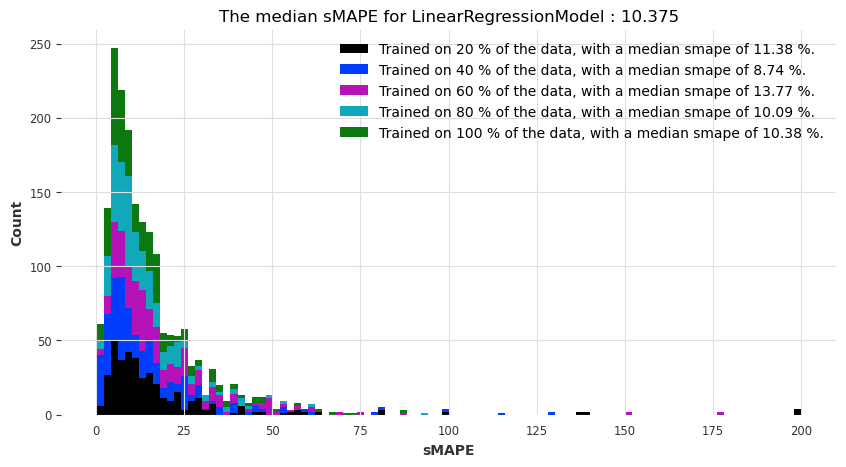

[I 2023-01-28 18:39:13,036] A new study created in memory with name: no-name-209c4e5e-4838-4dd2-931d-daf0451a8de6
[I 2023-01-28 18:39:18,044] Trial 0 finished with value: 20.844586621837088 and parameters: {'out_len': 8}. Best is trial 0 with value: 20.844586621837088.
[I 2023-01-28 18:39:21,837] Trial 1 finished with value: 18.131686353572448 and parameters: {'out_len': 2}. Best is trial 1 with value: 18.131686353572448.
[I 2023-01-28 18:39:27,549] Trial 2 finished with value: 18.552782399615214 and parameters: {'out_len': 11}. Best is trial 1 with value: 18.131686353572448.
[I 2023-01-28 18:39:32,862] Trial 3 finished with value: 17.627307322726683 and parameters: {'out_len': 9}. Best is trial 3 with value: 17.627307322726683.
[I 2023-01-28 18:39:39,556] Trial 4 finished with value: 18.552782399615214 and parameters: {'out_len': 11}. Best is trial 3 with value: 17.627307322726683.
[I 2023-01-28 18:39:44,691] Trial 5 finished with value: 20.844586621837088 and parameters: {'out_len': 

[I 2023-01-28 18:47:26,820] Trial 1 finished with value: 7.864303052160708 and parameters: {'out_len': 7}. Best is trial 0 with value: 7.838968947002877.
[I 2023-01-28 18:47:44,365] Trial 2 finished with value: 7.015647947184715 and parameters: {'out_len': 3}. Best is trial 2 with value: 7.015647947184715.
[I 2023-01-28 18:48:03,339] Trial 3 finished with value: 8.268161719634849 and parameters: {'out_len': 5}. Best is trial 2 with value: 7.015647947184715.
[I 2023-01-28 18:48:19,707] Trial 4 finished with value: 7.015647947184715 and parameters: {'out_len': 3}. Best is trial 2 with value: 7.015647947184715.
[I 2023-01-28 18:48:40,928] Trial 5 finished with value: 10.570062124854003 and parameters: {'out_len': 11}. Best is trial 2 with value: 7.015647947184715.
[I 2023-01-28 18:48:57,013] Trial 6 finished with value: 7.269582518897523 and parameters: {'out_len': 2}. Best is trial 2 with value: 7.015647947184715.
[I 2023-01-28 18:49:19,489] Trial 7 finished with value: 12.20473731245366

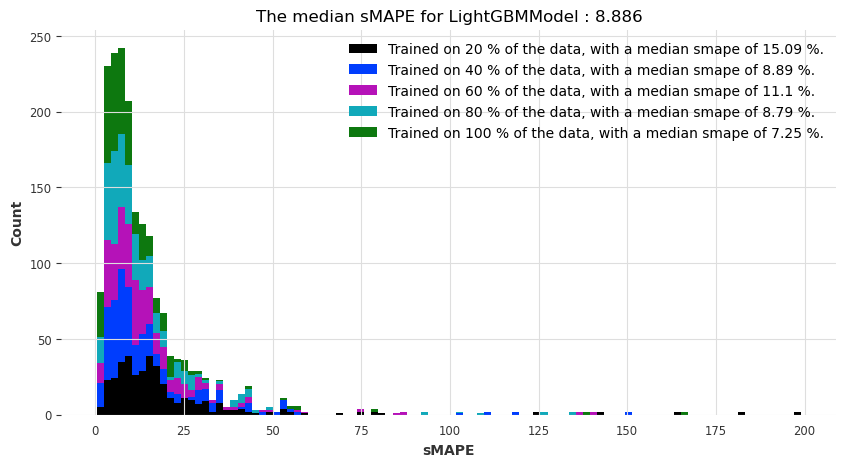

[I 2023-01-28 18:57:59,157] A new study created in memory with name: no-name-fc00f757-708a-4d29-a58c-5aa7dbdc9d6c
[I 2023-01-28 18:58:06,220] Trial 0 finished with value: 18.244745538540517 and parameters: {'out_len': 1, 'n_estimators': 51, 'max_depth': 19}. Best is trial 0 with value: 18.244745538540517.
[I 2023-01-28 18:58:17,103] Trial 1 finished with value: 17.131163090478445 and parameters: {'out_len': 1, 'n_estimators': 100, 'max_depth': 30}. Best is trial 1 with value: 17.131163090478445.
[I 2023-01-28 18:58:22,527] Trial 2 finished with value: 16.824340788236416 and parameters: {'out_len': 11, 'n_estimators': 61, 'max_depth': 12}. Best is trial 2 with value: 16.824340788236416.
[I 2023-01-28 18:58:28,376] Trial 3 finished with value: 16.798436424065308 and parameters: {'out_len': 12, 'n_estimators': 93, 'max_depth': 13}. Best is trial 3 with value: 16.798436424065308.
[I 2023-01-28 18:58:35,197] Trial 4 finished with value: 19.8162934748997 and parameters: {'out_len': 7, 'n_est

[I 2023-01-28 19:08:26,032] Trial 8 finished with value: 10.57424035001276 and parameters: {'out_len': 2, 'n_estimators': 87, 'max_depth': 12}. Best is trial 0 with value: 10.381455223085503.
[I 2023-01-28 19:08:57,762] Trial 9 finished with value: 10.000845923064027 and parameters: {'out_len': 1, 'n_estimators': 73, 'max_depth': 13}. Best is trial 9 with value: 10.000845923064027.
[I 2023-01-28 19:09:14,783] Trial 10 finished with value: 13.449560226276917 and parameters: {'out_len': 12, 'n_estimators': 69, 'max_depth': 16}. Best is trial 9 with value: 10.000845923064027.
[I 2023-01-28 19:09:35,918] Trial 11 finished with value: 13.39043672075701 and parameters: {'out_len': 1, 'n_estimators': 74, 'max_depth': 5}. Best is trial 9 with value: 10.000845923064027.
[I 2023-01-28 19:10:04,442] Trial 12 finished with value: 10.499166315651893 and parameters: {'out_len': 4, 'n_estimators': 76, 'max_depth': 11}. Best is trial 9 with value: 10.000845923064027.
[I 2023-01-28 19:10:34,444] Trial 

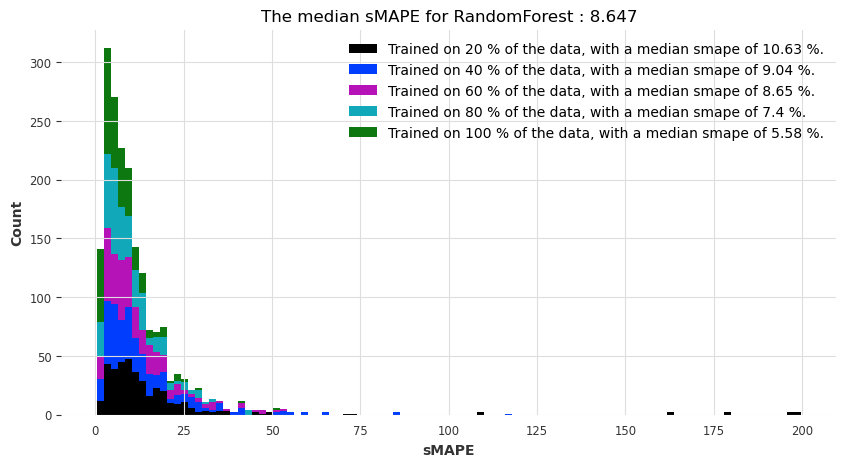

Visualization of performances taking the mean of the smapes over cross-validation


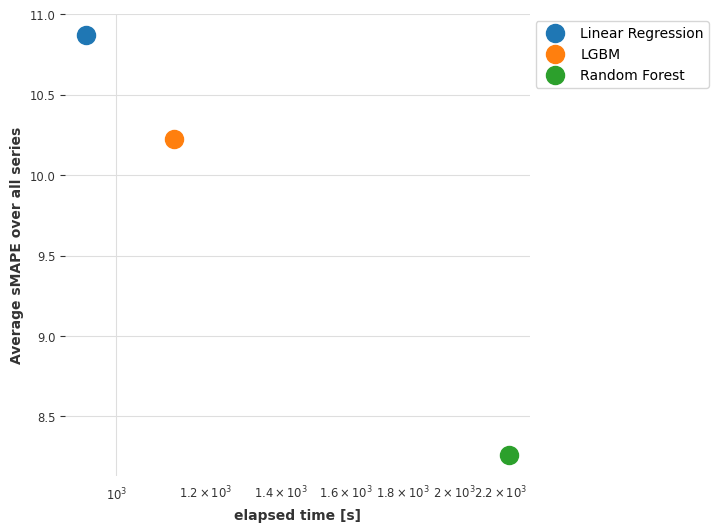

Visualization of performances taking the median of the smapes over cross-validation


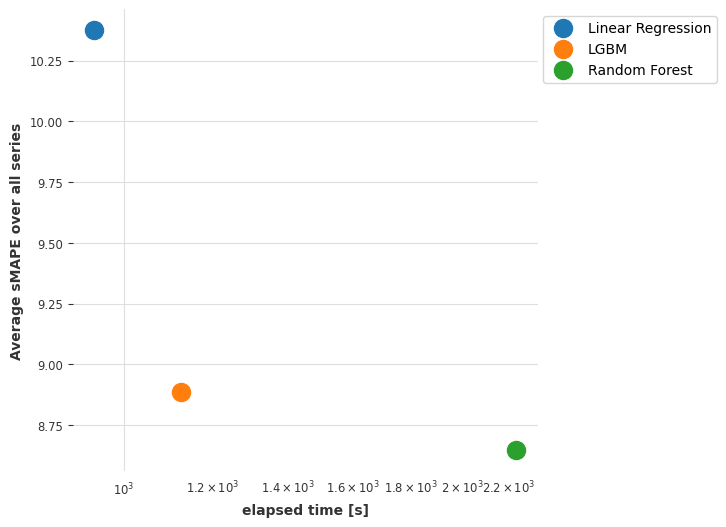

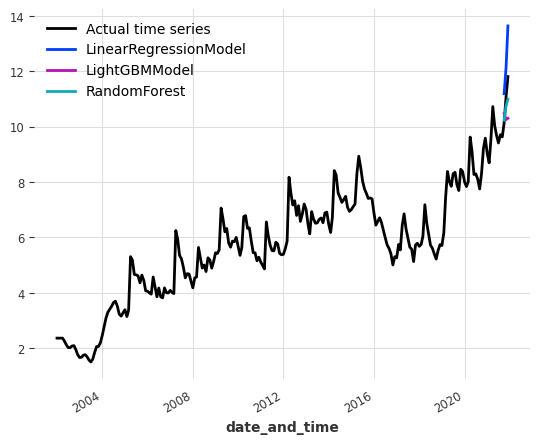

The results for index_keyword with an horizon of 6 are:


[I 2023-01-28 19:35:17,909] A new study created in memory with name: no-name-445ed5c7-44b0-4cd1-8cc3-406564f0bec7
[I 2023-01-28 19:35:21,302] Trial 0 finished with value: 25.003069682214722 and parameters: {'out_len': 4}. Best is trial 0 with value: 25.003069682214722.
[I 2023-01-28 19:35:24,887] Trial 1 finished with value: 26.278331646762126 and parameters: {'out_len': 6}. Best is trial 0 with value: 25.003069682214722.
[I 2023-01-28 19:35:28,932] Trial 2 finished with value: 23.643487211815764 and parameters: {'out_len': 12}. Best is trial 2 with value: 23.643487211815764.
[I 2023-01-28 19:35:32,314] Trial 3 finished with value: 25.003069682214722 and parameters: {'out_len': 4}. Best is trial 2 with value: 23.643487211815764.
[I 2023-01-28 19:35:36,225] Trial 4 finished with value: 23.94552031703578 and parameters: {'out_len': 10}. Best is trial 2 with value: 23.643487211815764.
[I 2023-01-28 19:35:39,949] Trial 5 finished with value: 27.500563854254 and parameters: {'out_len': 7}. 

[I 2023-01-28 19:42:07,312] Trial 1 finished with value: 13.301198383522367 and parameters: {'out_len': 2}. Best is trial 1 with value: 13.301198383522367.
[I 2023-01-28 19:42:22,071] Trial 2 finished with value: 14.255235458215632 and parameters: {'out_len': 7}. Best is trial 1 with value: 13.301198383522367.
[I 2023-01-28 19:42:38,201] Trial 3 finished with value: 12.523711125772852 and parameters: {'out_len': 10}. Best is trial 3 with value: 12.523711125772852.
[I 2023-01-28 19:42:54,209] Trial 4 finished with value: 12.523711125772852 and parameters: {'out_len': 10}. Best is trial 3 with value: 12.523711125772852.
[I 2023-01-28 19:43:08,978] Trial 5 finished with value: 13.87683875045184 and parameters: {'out_len': 3}. Best is trial 3 with value: 12.523711125772852.
[I 2023-01-28 19:43:23,399] Trial 6 finished with value: 13.87683875045184 and parameters: {'out_len': 3}. Best is trial 3 with value: 12.523711125772852.
[I 2023-01-28 19:43:39,208] Trial 7 finished with value: 13.5290

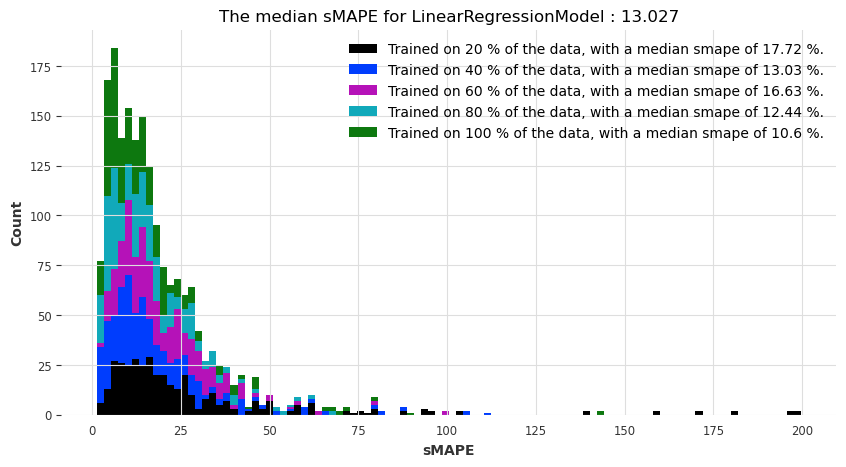

[I 2023-01-28 19:51:05,266] A new study created in memory with name: no-name-6a760301-1d05-445a-8001-51057495c0d9
[I 2023-01-28 19:51:09,149] Trial 0 finished with value: 21.971774558361414 and parameters: {'out_len': 3}. Best is trial 0 with value: 21.971774558361414.
[I 2023-01-28 19:51:14,417] Trial 1 finished with value: 22.3549810022626 and parameters: {'out_len': 9}. Best is trial 0 with value: 21.971774558361414.
[I 2023-01-28 19:51:17,894] Trial 2 finished with value: 20.80382385224596 and parameters: {'out_len': 1}. Best is trial 2 with value: 20.80382385224596.
[I 2023-01-28 19:51:23,170] Trial 3 finished with value: 22.3549810022626 and parameters: {'out_len': 9}. Best is trial 2 with value: 20.80382385224596.
[I 2023-01-28 19:51:26,671] Trial 4 finished with value: 20.80382385224596 and parameters: {'out_len': 1}. Best is trial 2 with value: 20.80382385224596.
[I 2023-01-28 19:51:30,873] Trial 5 finished with value: 22.1792475636151 and parameters: {'out_len': 4}. Best is t

[I 2023-01-28 19:58:53,942] Trial 1 finished with value: 11.969033787399665 and parameters: {'out_len': 6}. Best is trial 1 with value: 11.969033787399665.
[I 2023-01-28 19:59:14,970] Trial 2 finished with value: 13.74168389238112 and parameters: {'out_len': 10}. Best is trial 1 with value: 11.969033787399665.
[I 2023-01-28 19:59:33,567] Trial 3 finished with value: 12.061016284974063 and parameters: {'out_len': 5}. Best is trial 1 with value: 11.969033787399665.
[I 2023-01-28 19:59:49,981] Trial 4 finished with value: 12.781748296898087 and parameters: {'out_len': 2}. Best is trial 1 with value: 11.969033787399665.
[I 2023-01-28 20:00:09,085] Trial 5 finished with value: 12.156583191500879 and parameters: {'out_len': 8}. Best is trial 1 with value: 11.969033787399665.
[I 2023-01-28 20:00:26,450] Trial 6 finished with value: 12.061016284974063 and parameters: {'out_len': 5}. Best is trial 1 with value: 11.969033787399665.
[I 2023-01-28 20:00:47,426] Trial 7 finished with value: 16.5221

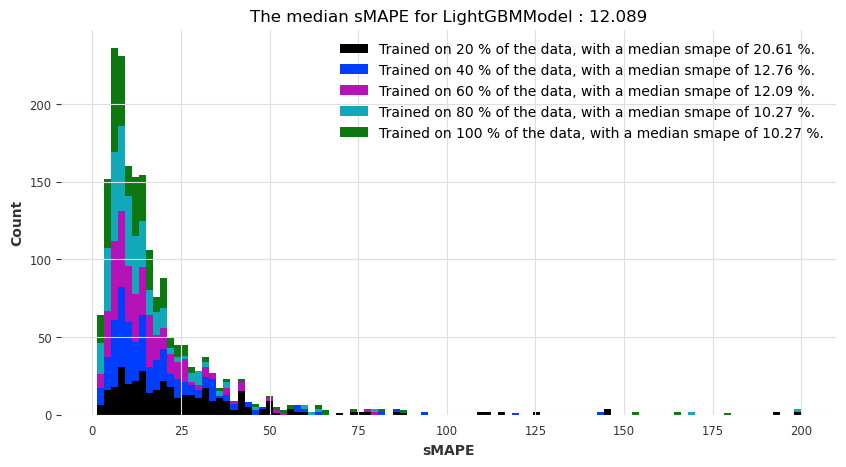

[I 2023-01-28 20:09:28,675] A new study created in memory with name: no-name-0f332985-8069-4953-a85d-92da1c7b6038
[I 2023-01-28 20:09:35,119] Trial 0 finished with value: 21.650755354550125 and parameters: {'out_len': 9, 'n_estimators': 74, 'max_depth': 22}. Best is trial 0 with value: 21.650755354550125.
[I 2023-01-28 20:09:42,349] Trial 1 finished with value: 21.542956155584825 and parameters: {'out_len': 9, 'n_estimators': 99, 'max_depth': 16}. Best is trial 1 with value: 21.542956155584825.
[I 2023-01-28 20:09:48,281] Trial 2 finished with value: 22.079219488022396 and parameters: {'out_len': 5, 'n_estimators': 56, 'max_depth': 10}. Best is trial 1 with value: 21.542956155584825.
[I 2023-01-28 20:09:53,690] Trial 3 finished with value: 22.31874763847463 and parameters: {'out_len': 11, 'n_estimators': 54, 'max_depth': 24}. Best is trial 1 with value: 21.542956155584825.
[I 2023-01-28 20:10:01,851] Trial 4 finished with value: 23.45143933288988 and parameters: {'out_len': 3, 'n_estim

[I 2023-01-28 20:20:04,184] Trial 9 finished with value: 12.202114506322854 and parameters: {'out_len': 6, 'n_estimators': 87, 'max_depth': 29}. Best is trial 6 with value: 11.812520394409624.
[I 2023-01-28 20:20:30,942] Trial 10 finished with value: 11.308291182470336 and parameters: {'out_len': 2, 'n_estimators': 65, 'max_depth': 12}. Best is trial 10 with value: 11.308291182470336.
[I 2023-01-28 20:20:59,974] Trial 11 finished with value: 11.0477312358482 and parameters: {'out_len': 1, 'n_estimators': 64, 'max_depth': 12}. Best is trial 11 with value: 11.0477312358482.
[I 2023-01-28 20:21:26,666] Trial 12 finished with value: 11.489190268727189 and parameters: {'out_len': 1, 'n_estimators': 59, 'max_depth': 13}. Best is trial 11 with value: 11.0477312358482.
[I 2023-01-28 20:21:51,749] Trial 13 finished with value: 11.966341836189644 and parameters: {'out_len': 3, 'n_estimators': 64, 'max_depth': 11}. Best is trial 11 with value: 11.0477312358482.
[I 2023-01-28 20:22:17,476] Trial 1

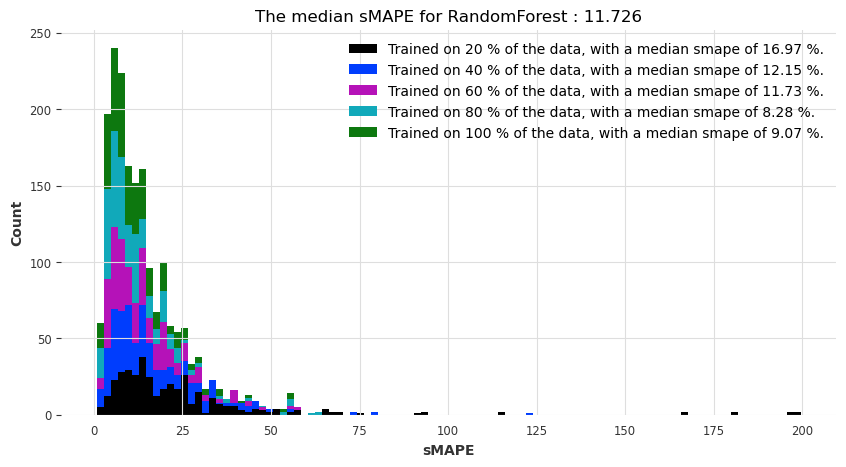

Visualization of performances taking the mean of the smapes over cross-validation


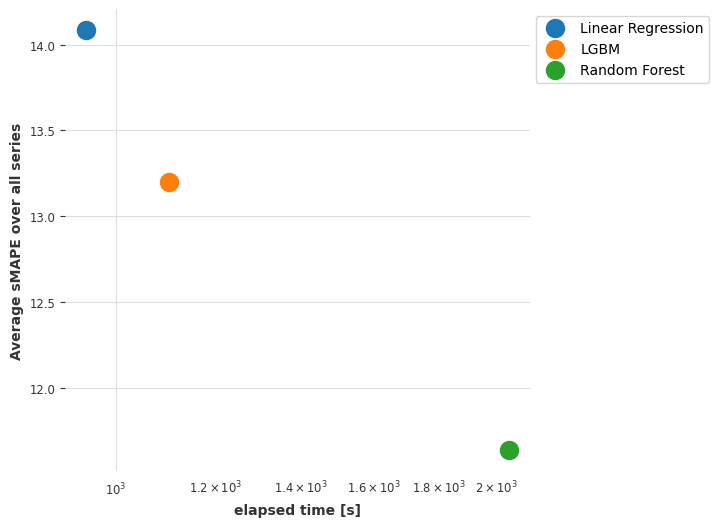

Visualization of performances taking the median of the smapes over cross-validation


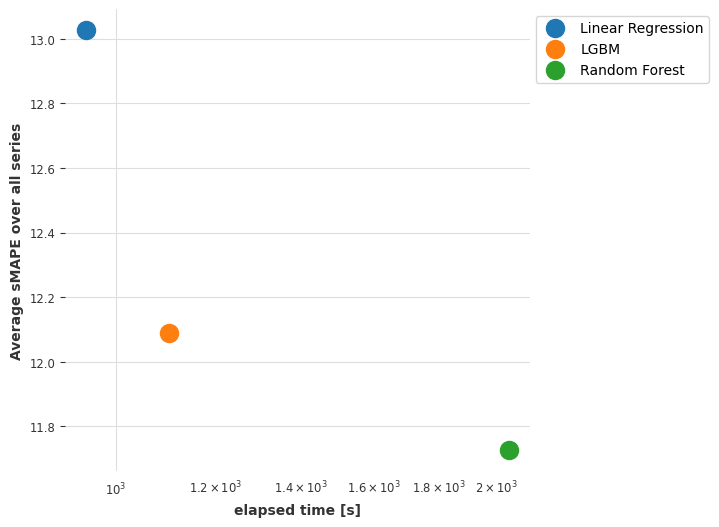

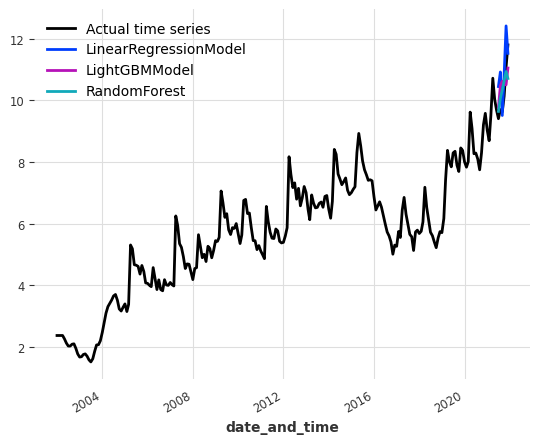

The results for index_keyword with an horizon of 12 are:


[I 2023-01-28 20:43:37,583] A new study created in memory with name: no-name-7bd72d93-2157-42c1-8639-ed37a43a4d6e
[I 2023-01-28 20:43:41,162] Trial 0 finished with value: 30.20741687033209 and parameters: {'out_len': 7}. Best is trial 0 with value: 30.20741687033209.
[I 2023-01-28 20:43:45,221] Trial 1 finished with value: 30.416307398735388 and parameters: {'out_len': 12}. Best is trial 0 with value: 30.20741687033209.
[I 2023-01-28 20:43:48,735] Trial 2 finished with value: 30.175733836063007 and parameters: {'out_len': 6}. Best is trial 2 with value: 30.175733836063007.
[I 2023-01-28 20:43:52,421] Trial 3 finished with value: 33.83383341896026 and parameters: {'out_len': 8}. Best is trial 2 with value: 30.175733836063007.
[I 2023-01-28 20:43:55,883] Trial 4 finished with value: 29.37522417766374 and parameters: {'out_len': 5}. Best is trial 4 with value: 29.37522417766374.
[I 2023-01-28 20:43:59,466] Trial 5 finished with value: 30.20741687033209 and parameters: {'out_len': 7}. Best

[I 2023-01-28 20:50:01,244] Trial 1 finished with value: 14.98477978176435 and parameters: {'out_len': 3}. Best is trial 1 with value: 14.98477978176435.
[I 2023-01-28 20:50:16,099] Trial 2 finished with value: 14.75922879845022 and parameters: {'out_len': 4}. Best is trial 2 with value: 14.75922879845022.
[I 2023-01-28 20:50:29,924] Trial 3 finished with value: 14.98477978176435 and parameters: {'out_len': 3}. Best is trial 2 with value: 14.75922879845022.
[I 2023-01-28 20:50:45,847] Trial 4 finished with value: 18.489902415131425 and parameters: {'out_len': 10}. Best is trial 2 with value: 14.75922879845022.
[I 2023-01-28 20:51:01,196] Trial 5 finished with value: 16.23917722942806 and parameters: {'out_len': 8}. Best is trial 2 with value: 14.75922879845022.
[I 2023-01-28 20:51:15,269] Trial 6 finished with value: 14.75922879845022 and parameters: {'out_len': 4}. Best is trial 2 with value: 14.75922879845022.
[I 2023-01-28 20:51:29,636] Trial 7 finished with value: 22.13713121825852

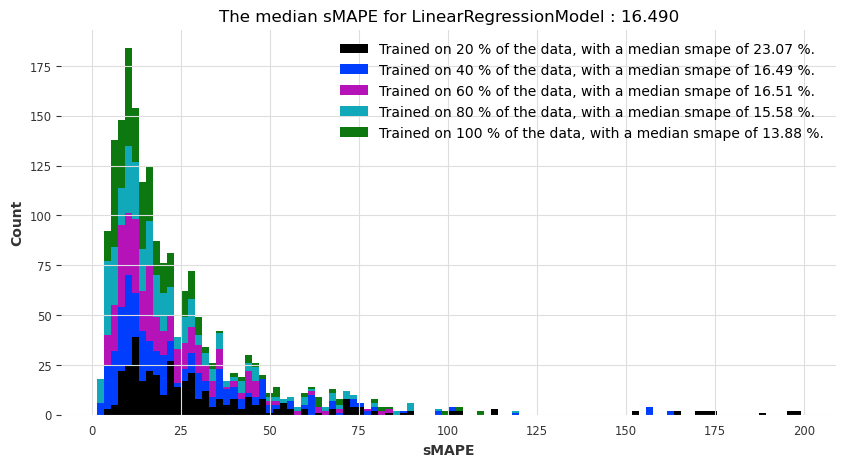

[I 2023-01-28 20:58:34,285] A new study created in memory with name: no-name-cf9ad786-5451-4de2-9457-78a84bf1cc45
[I 2023-01-28 20:58:39,176] Trial 0 finished with value: 32.35097466067604 and parameters: {'out_len': 8}. Best is trial 0 with value: 32.35097466067604.
[I 2023-01-28 20:58:42,952] Trial 1 finished with value: 29.410417577078988 and parameters: {'out_len': 1}. Best is trial 1 with value: 29.410417577078988.
[I 2023-01-28 20:58:47,752] Trial 2 finished with value: 32.448738336426096 and parameters: {'out_len': 7}. Best is trial 1 with value: 29.410417577078988.
[I 2023-01-28 20:58:52,607] Trial 3 finished with value: 32.448738336426096 and parameters: {'out_len': 7}. Best is trial 1 with value: 29.410417577078988.
[I 2023-01-28 20:58:56,682] Trial 4 finished with value: 33.25244657964383 and parameters: {'out_len': 4}. Best is trial 1 with value: 29.410417577078988.
[I 2023-01-28 20:59:01,063] Trial 5 finished with value: 33.30618143995567 and parameters: {'out_len': 5}. Be

[I 2023-01-28 21:06:17,637] Trial 1 finished with value: 15.521520562937367 and parameters: {'out_len': 4}. Best is trial 0 with value: 13.90984212784095.
[I 2023-01-28 21:06:38,026] Trial 2 finished with value: 21.293624667519385 and parameters: {'out_len': 12}. Best is trial 0 with value: 13.90984212784095.
[I 2023-01-28 21:06:57,009] Trial 3 finished with value: 16.875556609696332 and parameters: {'out_len': 8}. Best is trial 0 with value: 13.90984212784095.
[I 2023-01-28 21:07:17,148] Trial 4 finished with value: 19.779943216279463 and parameters: {'out_len': 11}. Best is trial 0 with value: 13.90984212784095.
[I 2023-01-28 21:07:35,612] Trial 5 finished with value: 15.841882730344231 and parameters: {'out_len': 6}. Best is trial 0 with value: 13.90984212784095.
[I 2023-01-28 21:07:53,230] Trial 6 finished with value: 15.841882730344231 and parameters: {'out_len': 6}. Best is trial 0 with value: 13.90984212784095.
[I 2023-01-28 21:08:13,697] Trial 7 finished with value: 21.29362466

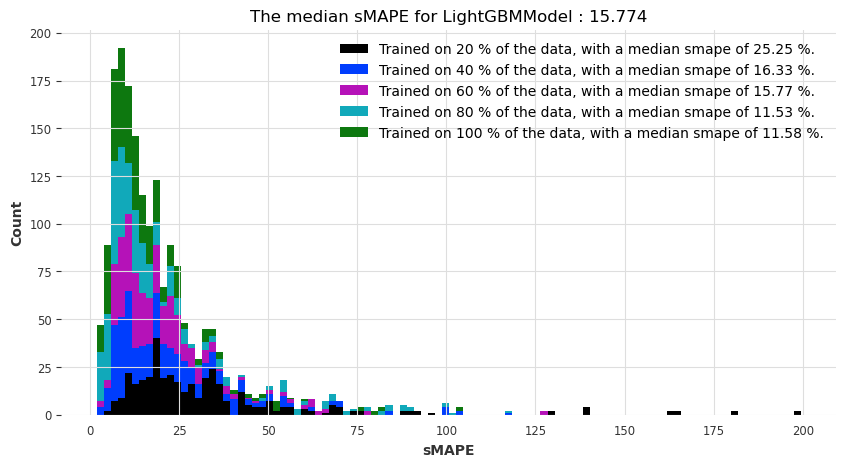

[I 2023-01-28 21:16:26,851] A new study created in memory with name: no-name-d4149f00-914c-4fa5-8b33-7f72c1553902
[I 2023-01-28 21:16:35,574] Trial 0 finished with value: 34.90109855693003 and parameters: {'out_len': 4, 'n_estimators': 90, 'max_depth': 19}. Best is trial 0 with value: 34.90109855693003.
[I 2023-01-28 21:16:41,512] Trial 1 finished with value: 30.44130341563204 and parameters: {'out_len': 11, 'n_estimators': 71, 'max_depth': 27}. Best is trial 1 with value: 30.44130341563204.
[I 2023-01-28 21:16:46,324] Trial 2 finished with value: 28.973682097287487 and parameters: {'out_len': 9, 'n_estimators': 55, 'max_depth': 7}. Best is trial 2 with value: 28.973682097287487.
[I 2023-01-28 21:16:54,468] Trial 3 finished with value: 34.9721779337847 and parameters: {'out_len': 3, 'n_estimators': 79, 'max_depth': 16}. Best is trial 2 with value: 28.973682097287487.
[I 2023-01-28 21:17:01,196] Trial 4 finished with value: 33.748897101246506 and parameters: {'out_len': 6, 'n_estimators

[I 2023-01-28 21:26:19,198] Trial 8 finished with value: 15.031581278853615 and parameters: {'out_len': 3, 'n_estimators': 75, 'max_depth': 23}. Best is trial 5 with value: 14.832360145120628.
[I 2023-01-28 21:26:36,626] Trial 9 finished with value: 14.771948123964036 and parameters: {'out_len': 5, 'n_estimators': 50, 'max_depth': 7}. Best is trial 9 with value: 14.771948123964036.
[I 2023-01-28 21:26:58,843] Trial 10 finished with value: 15.42506261956642 and parameters: {'out_len': 5, 'n_estimators': 50, 'max_depth': 20}. Best is trial 9 with value: 14.771948123964036.
[I 2023-01-28 21:27:16,575] Trial 11 finished with value: 15.733205919972994 and parameters: {'out_len': 5, 'n_estimators': 68, 'max_depth': 5}. Best is trial 9 with value: 14.771948123964036.
[I 2023-01-28 21:27:37,583] Trial 12 finished with value: 15.023726123692311 and parameters: {'out_len': 5, 'n_estimators': 52, 'max_depth': 10}. Best is trial 9 with value: 14.771948123964036.
[I 2023-01-28 21:28:04,393] Trial 1

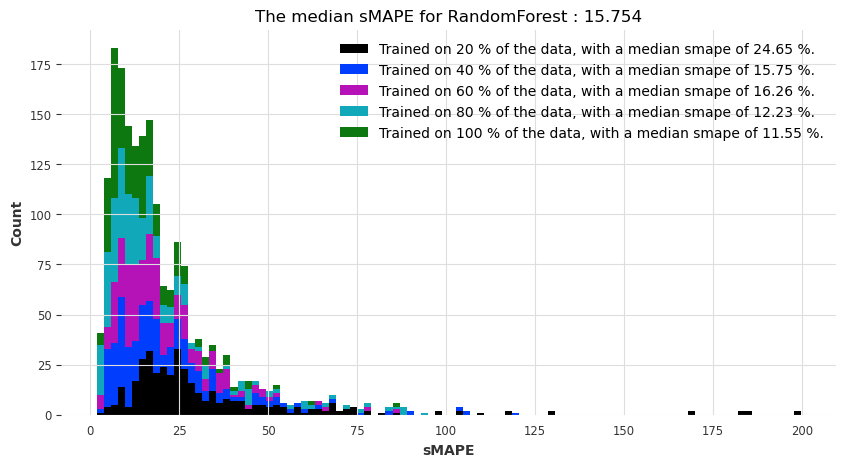

Visualization of performances taking the mean of the smapes over cross-validation


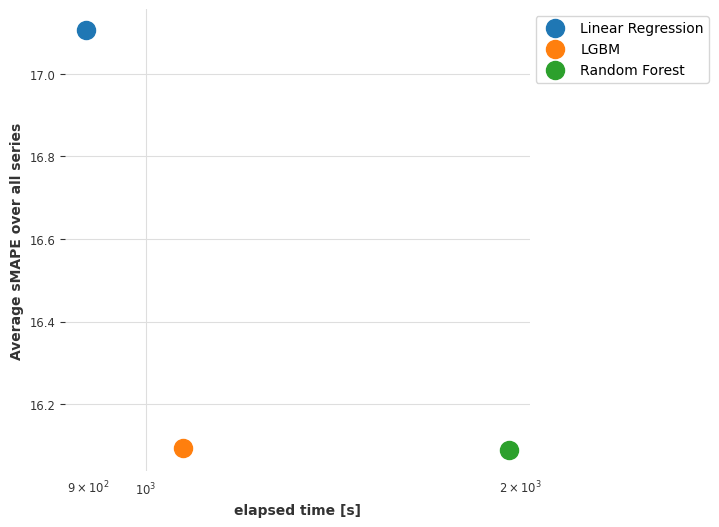

Visualization of performances taking the median of the smapes over cross-validation


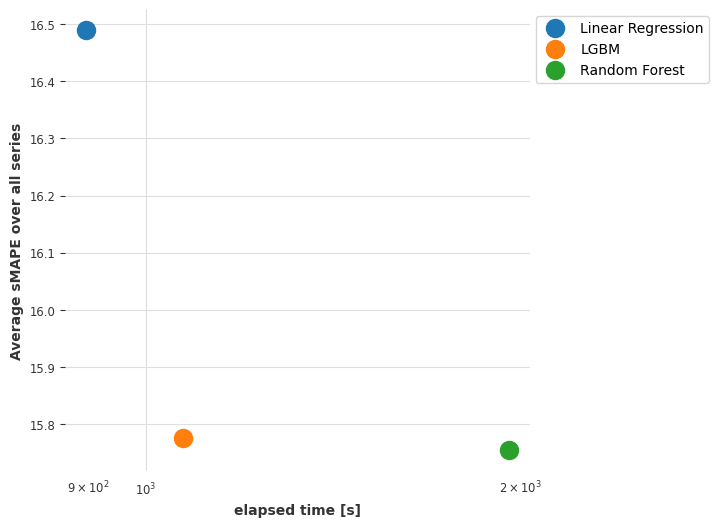

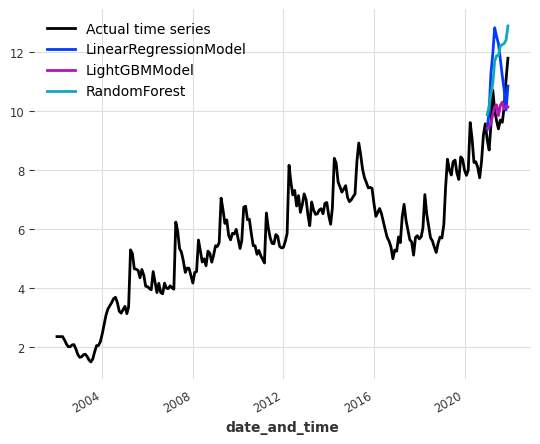

In [368]:
info_table = []


for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    listindex_byalgo=[]
    
    for horizon in [3,6,12]:
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean\
        =global_forecasting_mydata(dfofindex,horizon,list_concepts,5,15)
        
        listindex_byalgo=listindex_byalgo+\
        [lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean]
        
        plot_forecasting_models_global(modelnames,myforecasters,dfofindex,horizon,index) 
    
    list_toappend=[]    
    for i in range(3):
        for j in range(3):
            list_toappend.append(listindex_byalgo[i+j*3])
    info_table.append(list_toappend)

Global forecasting table of results.

In [369]:
iterables = [["Linear Regression","LGBM", "Random Forest"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0], 'Index citations t2-t1': info_table[1],
                   'Index colaboration incremental': info_table[2],'colaboration not incremental':info_table[3],
                   'Index keywords': info_table[4]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                               0.0   
                     6 months                               0.0   
                     12 months                              0.0   
LGBM                 3 months                               0.0   
                     6 months                               0.0   
                     12 months                              0.0   
Random Forest        3 months                               0.0   
                     6 months                               0.0   
                     12 months                              0.0   

                                          Index citations t2-t1  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                               0.0   
                     6 months                               0.0   
                     12 months                              0.0   
LGBM                 3 months                               0.0   
                     6 months                               0.0   
                     12 months                              0.0   
Random Forest        3 months                               0.0   
                     6 months                               0.0   
                     12 months                              0.0   

                                          Index colaboration incremental  \
Forecaster algorithm Forecasting horizon                                   
Linear Regression    3 months                                  62.044366   
                     6 months                                  70.179566   
                     12 months                                 86.313186   
LGBM                 3 months                                  31.374550   
                     6 months                                  47.618228   
                     12 months                                 59.608790   
Random Forest        3 months                                  22.013848   
                     6 months                                  39.270726   
                     12 months                                 54.555767   

                                          colaboration not incremental  \
Forecaster algorithm Forecasting horizon                                 
Linear Regression    3 months                                51.857979   
                     6 months                                63.726810   
                     12 months                               90.550199   
LGBM                 3 months                                33.173692   
                     6 months                                45.593515   
                     12 months                               52.987287   
Random Forest        3 months                                21.627798   
                     6 months                                35.079091   
                     12 months                               49.824204   

                                          Index keywords  
Forecaster algorithm Forecasting horizon                  
Linear Regression    3 months                  10.871062  
                     6 months                  14.084699  
                     12 months                 17.105690  
LGBM                 3 months                  10.223297  
                     6 months                  13.198650  
                     12 months                 16.093783  
Random Forest        3 months                   8.259278  
                     6 months                  11.638084  
                     12 months                 16.088858

We see that the random forest algorithm outperforms the other algorithm and becomes only slightly less accurate with the increase of the forecasting window. Nevertheless, the forecasting based on clustering using random forests (or nBeats) is significantly better than the insample forecasting as presented here.

__Comment__

So far, we observe that the best forecasting model overall (that performed the best for all forecasting tasks in general overall) is random forests, trained on global data.

# **Part 4 -- Global forecasting based on transfer learning methods**

In [66]:
def eval_transfer_forecasts(smapes,modelname):
    
    plt.figure(figsize=(10, 5))
    
    themedians = []
    labels = []
    
    for i in range(len(smapes)):
        themedians.append(np.median(smapes[i]))
        #plt.hist(smapes[i], bins=100,label='K-cross set'+str(i+1))
        labels = labels +['Smape errors trained on the external data imported from darts']
        
    plt.ylabel("Count")
    plt.xlabel("sMAPE")
    plt.title("The median sMAPE for "+str(modelname)+" : %.3f" % np.median(themedians))
    #plt.yscale('log')

    plt.hist(smapes,bins=100,histtype='barstacked',label=labels)
    
    plt.legend()
    plt.show()
    plt.close()

In [67]:
def computing_values(train_series,data,horizon,list_concepts,number_cv,modelname,forecaster,n_trials):
    
    time1=time.time()    
    
    global data_training
    global data_tuning
    global windowslength
     
    startingtime = 0
    
    windowslength = 240-horizon
    
    df = creating_train_test_tm(data,startingtime,windowslength,horizon,list_concepts)
    data_training, data_tuning=split_data(df)
    hyperparameters = return_hyperparameters_foralgo(modelname,n_trials)
    
    lags = 240-horizon-hyperparameters['out_len']
    
    #model = forecaster(**kwargs)
    #model_cls = forecaster.load("forecasting_models/"+str(modelname)+"_model.pkl")
    
    #print(model_cls)
    
    if modelname =="LinearRegressionModel":
        model = forecaster(lags=lags,output_chunk_length =hyperparameters['out_len'])
        
    if modelname=="LightGBMModel":
        model = forecaster(lags=lags,output_chunk_length =hyperparameters['out_len'])
        
    if modelname=="RandomForest":
        model = forecaster(lags=lags,output_chunk_length =hyperparameters['out_len'],\
        n_estimators = hyperparameters['n_estimators'],max_depth=hyperparameters['max_depth'])
    
    model.fit(train_series)
    
    preds = model.predict(n=horizon, series=data_training['Train tm'].tolist())
    smapes = mysmape(preds, data_training['Test tm'].tolist())

                   
    # I save the mean of the all the smapes done over one window
    
    time2=time.time()
    elapsed_time = time2-time1
    
    eval_transfer_forecasts(smapes,modelname)
    
    return elapsed_time,np.mean(smapes),np.median(smapes)

In [68]:
def load_m4(horizon,mytype='scaled') -> Tuple[List[TimeSeries], List[TimeSeries]]:
    
    # load TimeSeries - the splitting and scaling has already been done
    if mytype =='scaled':
        print("loading M4 TimeSeries...")
        with open("m4_monthly_scaled.pkl", "rb") as f:
            m4_series = pickle.load(f)
        
    else:
        print("loading M4 TimeSeries...")
        with open("m4_monthly.pkl", "rb") as f:
            m4_series = pickle.load(f)

    # filter and keep only series that contain at least 48 training points
    m4_series = list(filter(lambda t: len(t[0]) >= 240, m4_series))

    list_timeseries = []
    for tm in m4_series:
        mylist = []
        for x in tm[0].all_values():
            mylist.append(x[0][0])
    
        list_goodtype = np.array(mylist).astype(float)    
        mytm =TimeSeries.from_values(list_goodtype)
        list_timeseries.append(mytm)


    m4_train = [s[:-horizon] for s in list_timeseries]
    m4_test = [s[-horizon:] for s in list_timeseries]

    print(
        "done. There are {} series, with average training length {}".format(
            len(m4_train), np.mean([len(s) for s in list_timeseries])
        ))
    print(
        "The longest time series contain {} datapoints and the shortes time series {} datapoints.".format(
            np.max([len(s) for s in m4_train]), np.min([len(s) for s in list_timeseries])
        )
    )
    return m4_train, m4_test ,list_timeseries

In [69]:
def transfer_forecasting_mydata(train_series,dftm,horizon,list_concepts,number_cv,n_trials):

    # regression models
            
    lr_time, lr_smapes_mean,lr_smapes_med =\
    computing_values(train_series,dftm,\
    horizon,list_concepts,number_cv,'LinearRegressionModel', LinearRegressionModel,n_trials)
    
    lgbm_time, lgbm_smapes_mean,lgbm_smapes_med =\
    computing_values(train_series,dftm,\
    horizon,list_concepts,number_cv,'LightGBMModel', LightGBMModel,n_trials)
  
    rf_time, rf_smapes_mean,rf_smapes_med\
    =computing_values(train_series,dftm,\
    horizon,list_concepts,number_cv,'RandomForest', RandomForest,n_trials)
    
    
    smapes_mean = {
        "Linear Regression": lr_smapes_mean,
        "LGBM": lgbm_smapes_mean,
        "Random Forest": rf_smapes_mean
    }

    elapsed_times = {
        "Linear Regression": lr_time,
        "LGBM": lgbm_time,
        "Random Forest": rf_time
    }

    smapes_med = {
        "Linear Regression": lr_smapes_med,
        "LGBM": lgbm_smapes_med,
        "Random Forest": rf_smapes_med
    }

        
    print('Visualization of performances taking the mean of the smapes over cross-validation')
    plot_models_global(elapsed_times, smapes_mean)
    
        
    print('Visualization of performances taking the median of the smapes over cross-validation')
    plot_models_global(elapsed_times, smapes_med)
    
    return lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean

In [70]:
myforecasters = [LinearRegressionModel,LightGBMModel,RandomForest]
modelnames = ["LinearRegressionModel","LightGBMModel","RandomForest"]

In [71]:
m4_train_scaled, m4_test_scaled, m4_scaled_all= load_m4(5,'scaled')
m4_train_notscaled, m4_test_notscaled, m4_notscaled_all = load_m4(5,'notscaled')

loading M4 TimeSeries...
done. There are 19581 series, with average training length 344.8750319186967
The longest time series contain 2789 datapoints and the shortes time series 240 datapoints.
loading M4 TimeSeries...
done. There are 19581 series, with average training length 344.8750319186967
The longest time series contain 2789 datapoints and the shortes time series 240 datapoints.


We first run the forecasting algorithm with a part of the training data, to see what are the performances.

In [72]:
external_data = m4_notscaled_all[:2000]

The results for index_cit_t1_t2 are:
The results for index_cit_t1_t2 with an horizon of 3 are:


[I 2023-01-30 18:32:43,691] A new study created in memory with name: no-name-04c0c688-3134-4423-88ac-9cb772f112ee
[I 2023-01-30 18:33:05,955] Trial 0 finished with value: 78.92762797369254 and parameters: {'out_len': 10}. Best is trial 0 with value: 78.92762797369254.
[I 2023-01-30 18:33:28,582] Trial 1 finished with value: 80.19163837528923 and parameters: {'out_len': 6}. Best is trial 0 with value: 78.92762797369254.
[I 2023-01-30 18:33:50,728] Trial 2 finished with value: 78.24998299921685 and parameters: {'out_len': 9}. Best is trial 2 with value: 78.24998299921685.
[I 2023-01-30 18:34:14,151] Trial 3 finished with value: 84.37995116126241 and parameters: {'out_len': 3}. Best is trial 2 with value: 78.24998299921685.
[I 2023-01-30 18:34:37,275] Trial 4 finished with value: 87.02406156717448 and parameters: {'out_len': 2}. Best is trial 2 with value: 78.24998299921685.
[I 2023-01-30 18:35:01,890] Trial 5 finished with value: 83.75518555829383 and parameters: {'out_len': 12}. Best is

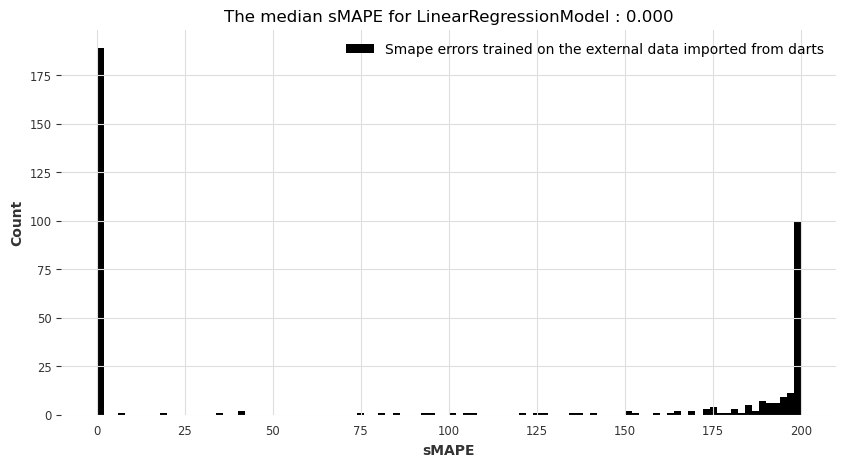

[I 2023-01-30 18:40:35,278] A new study created in memory with name: no-name-7e88d883-0db8-4546-ae9c-7571ffc085af
[I 2023-01-30 18:41:06,601] Trial 0 finished with value: 81.61740943484787 and parameters: {'out_len': 12}. Best is trial 0 with value: 81.61740943484787.
[I 2023-01-30 18:41:34,533] Trial 1 finished with value: 77.70915780004051 and parameters: {'out_len': 8}. Best is trial 1 with value: 77.70915780004051.
[I 2023-01-30 18:42:00,513] Trial 2 finished with value: 71.72417029810859 and parameters: {'out_len': 5}. Best is trial 2 with value: 71.72417029810859.
[I 2023-01-30 18:42:30,697] Trial 3 finished with value: 79.7553289219476 and parameters: {'out_len': 9}. Best is trial 2 with value: 71.72417029810859.
[I 2023-01-30 18:42:54,236] Trial 4 finished with value: 75.40245227455249 and parameters: {'out_len': 2}. Best is trial 2 with value: 71.72417029810859.
[I 2023-01-30 18:43:16,401] Trial 5 finished with value: 72.53544535012284 and parameters: {'out_len': 1}. Best is t

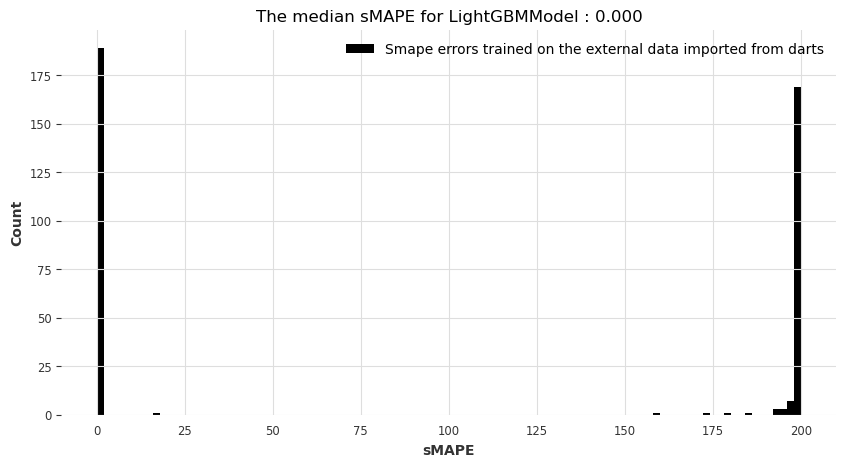

[I 2023-01-30 18:50:21,038] A new study created in memory with name: no-name-38861e09-7ba9-4bee-ab5c-9fe24ea49289
[I 2023-01-30 18:51:11,264] Trial 0 finished with value: 45.73199269701179 and parameters: {'out_len': 4, 'n_estimators': 92, 'max_depth': 23}. Best is trial 0 with value: 45.73199269701179.
[I 2023-01-30 18:51:54,223] Trial 1 finished with value: 37.249161572882436 and parameters: {'out_len': 6, 'n_estimators': 86, 'max_depth': 30}. Best is trial 1 with value: 37.249161572882436.
[I 2023-01-30 18:52:25,034] Trial 2 finished with value: 60.616886995649544 and parameters: {'out_len': 8, 'n_estimators': 61, 'max_depth': 14}. Best is trial 1 with value: 37.249161572882436.
[I 2023-01-30 18:53:10,341] Trial 3 finished with value: 44.974528287828434 and parameters: {'out_len': 1, 'n_estimators': 70, 'max_depth': 22}. Best is trial 1 with value: 37.249161572882436.
[I 2023-01-30 18:53:38,552] Trial 4 finished with value: 53.14904986840608 and parameters: {'out_len': 10, 'n_estima

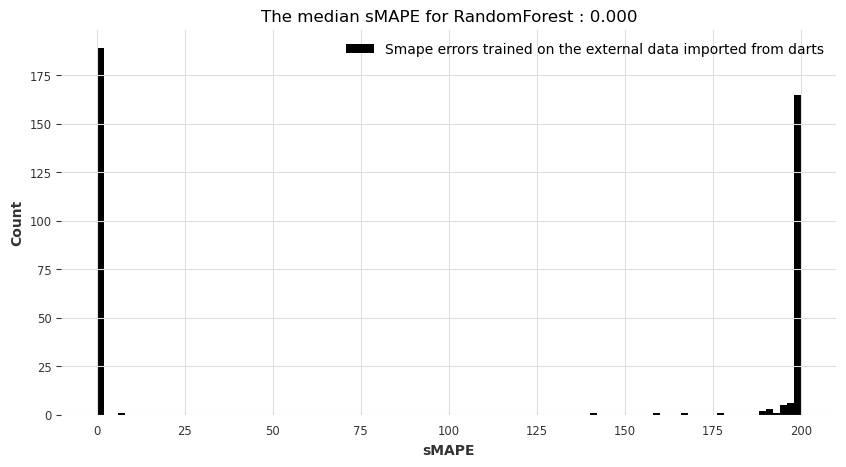

Visualization of performances taking the mean of the smapes over cross-validation


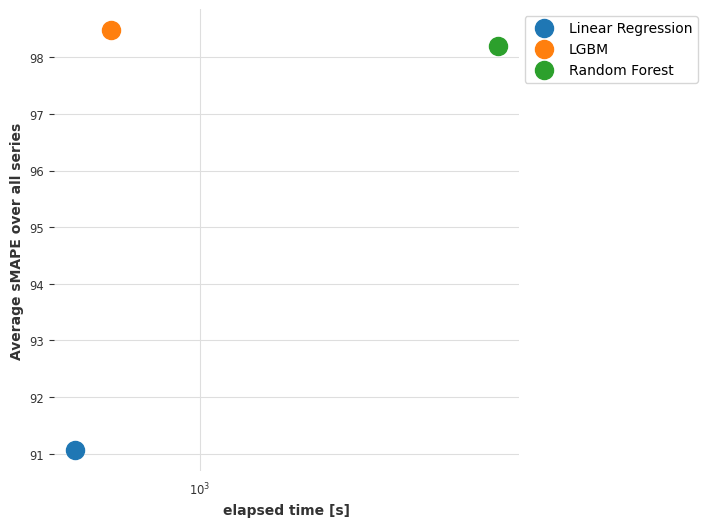

Visualization of performances taking the median of the smapes over cross-validation


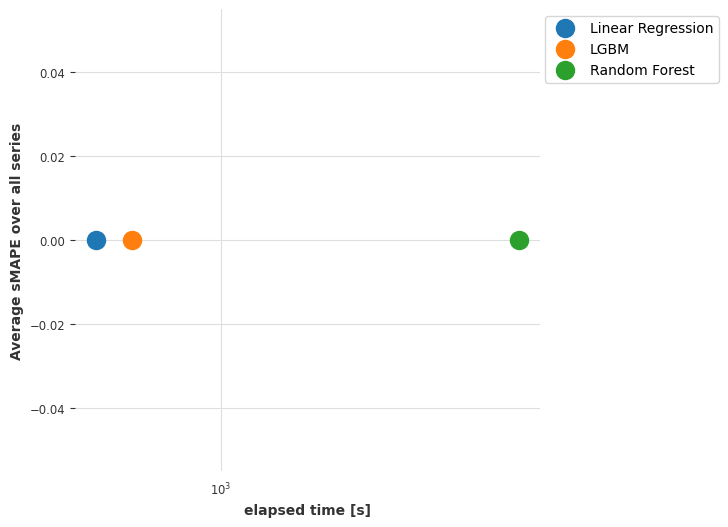

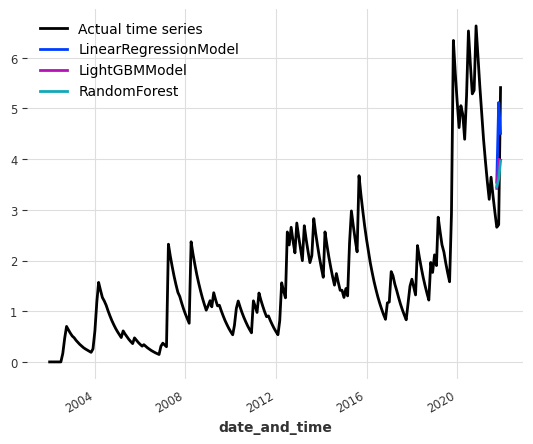

The results for index_cit_t1_t2 with an horizon of 6 are:


[I 2023-01-30 20:31:13,052] A new study created in memory with name: no-name-d74a1467-2a4b-43a7-aec5-e4b8493e6c69
[I 2023-01-30 20:31:32,059] Trial 0 finished with value: 90.86002115988245 and parameters: {'out_len': 3}. Best is trial 0 with value: 90.86002115988245.
[I 2023-01-30 20:31:51,662] Trial 1 finished with value: 86.1688321575891 and parameters: {'out_len': 10}. Best is trial 1 with value: 86.1688321575891.
[I 2023-01-30 20:32:10,606] Trial 2 finished with value: 93.27364284870993 and parameters: {'out_len': 1}. Best is trial 1 with value: 86.1688321575891.
[I 2023-01-30 20:32:29,471] Trial 3 finished with value: 93.27364284870993 and parameters: {'out_len': 1}. Best is trial 1 with value: 86.1688321575891.
[I 2023-01-30 20:32:49,196] Trial 4 finished with value: 87.88960143465182 and parameters: {'out_len': 7}. Best is trial 1 with value: 86.1688321575891.
[I 2023-01-30 20:33:08,720] Trial 5 finished with value: 87.88960143465182 and parameters: {'out_len': 7}. Best is trial

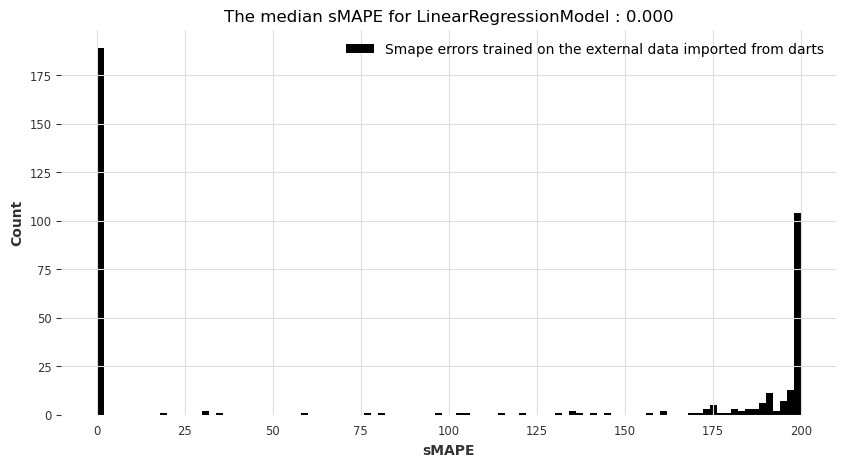

[I 2023-01-30 20:37:52,296] A new study created in memory with name: no-name-a496c60b-6c10-4c68-b693-0fef4af37b12
[I 2023-01-30 20:38:19,666] Trial 0 finished with value: 85.47364552346687 and parameters: {'out_len': 12}. Best is trial 0 with value: 85.47364552346687.
[I 2023-01-30 20:38:44,656] Trial 1 finished with value: 78.5281203654163 and parameters: {'out_len': 6}. Best is trial 1 with value: 78.5281203654163.
[I 2023-01-30 20:39:04,742] Trial 2 finished with value: 71.80367074606245 and parameters: {'out_len': 1}. Best is trial 2 with value: 71.80367074606245.
[I 2023-01-30 20:39:30,966] Trial 3 finished with value: 81.28879865443194 and parameters: {'out_len': 8}. Best is trial 2 with value: 71.80367074606245.
[I 2023-01-30 20:39:53,601] Trial 4 finished with value: 72.49313446492528 and parameters: {'out_len': 4}. Best is trial 2 with value: 71.80367074606245.
[I 2023-01-30 20:40:20,972] Trial 5 finished with value: 78.48648937376588 and parameters: {'out_len': 10}. Best is t

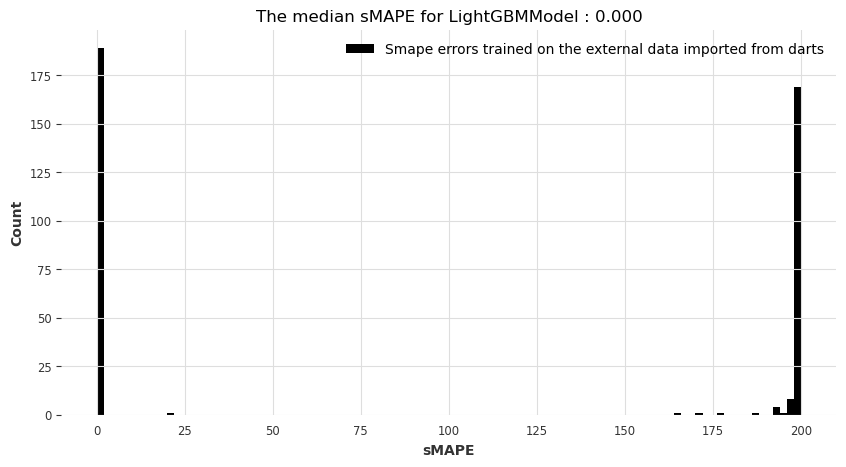

[I 2023-01-30 20:45:45,967] A new study created in memory with name: no-name-1e8cb3cd-3ea9-413b-8c11-b47b87cfea07
[I 2023-01-30 20:46:16,404] Trial 0 finished with value: 67.92957545865401 and parameters: {'out_len': 7, 'n_estimators': 97, 'max_depth': 8}. Best is trial 0 with value: 67.92957545865401.
[I 2023-01-30 20:46:54,185] Trial 1 finished with value: 64.69635757689694 and parameters: {'out_len': 1, 'n_estimators': 80, 'max_depth': 11}. Best is trial 1 with value: 64.69635757689694.
[I 2023-01-30 20:47:23,306] Trial 2 finished with value: 42.727809799334565 and parameters: {'out_len': 11, 'n_estimators': 86, 'max_depth': 29}. Best is trial 2 with value: 42.727809799334565.
[I 2023-01-30 20:47:58,127] Trial 3 finished with value: 51.138281876009046 and parameters: {'out_len': 7, 'n_estimators': 77, 'max_depth': 18}. Best is trial 2 with value: 42.727809799334565.
[I 2023-01-30 20:48:35,144] Trial 4 finished with value: 38.60390463107401 and parameters: {'out_len': 3, 'n_estimator

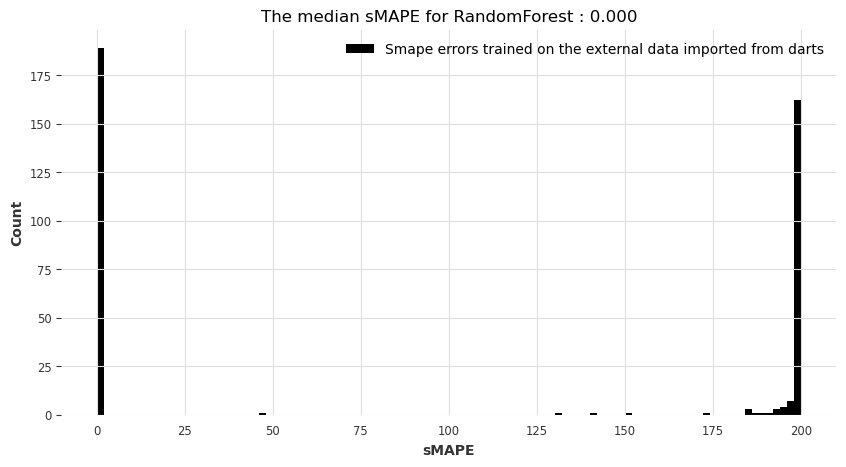

Visualization of performances taking the mean of the smapes over cross-validation


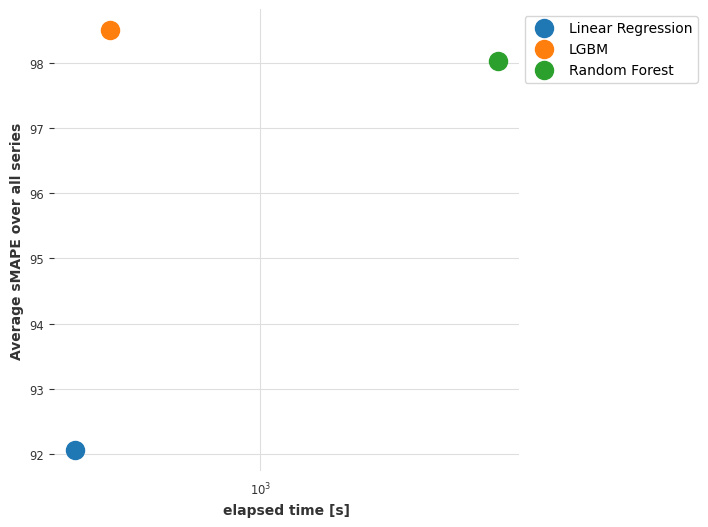

Visualization of performances taking the median of the smapes over cross-validation


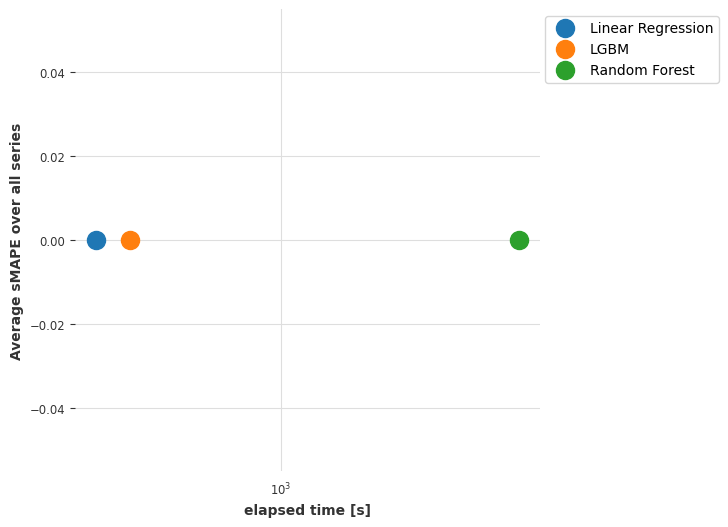

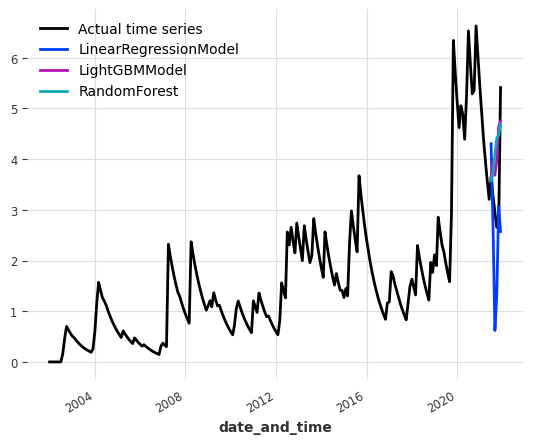

The results for index_cit_t1_t2 with an horizon of 12 are:


[I 2023-01-30 21:40:00,554] A new study created in memory with name: no-name-903570c2-4d21-4639-adfb-76c73da8bd2a
[I 2023-01-30 21:40:19,715] Trial 0 finished with value: 87.0520195622278 and parameters: {'out_len': 10}. Best is trial 0 with value: 87.0520195622278.
[I 2023-01-30 21:40:39,080] Trial 1 finished with value: 89.88275644050462 and parameters: {'out_len': 12}. Best is trial 0 with value: 87.0520195622278.
[I 2023-01-30 21:40:58,327] Trial 2 finished with value: 87.35936144635922 and parameters: {'out_len': 6}. Best is trial 0 with value: 87.0520195622278.
[I 2023-01-30 21:41:16,744] Trial 3 finished with value: 84.30110782473226 and parameters: {'out_len': 1}. Best is trial 3 with value: 84.30110782473226.
[I 2023-01-30 21:41:34,912] Trial 4 finished with value: 86.23953948820719 and parameters: {'out_len': 7}. Best is trial 3 with value: 84.30110782473226.
[I 2023-01-30 21:41:53,785] Trial 5 finished with value: 85.29503431198424 and parameters: {'out_len': 5}. Best is tri

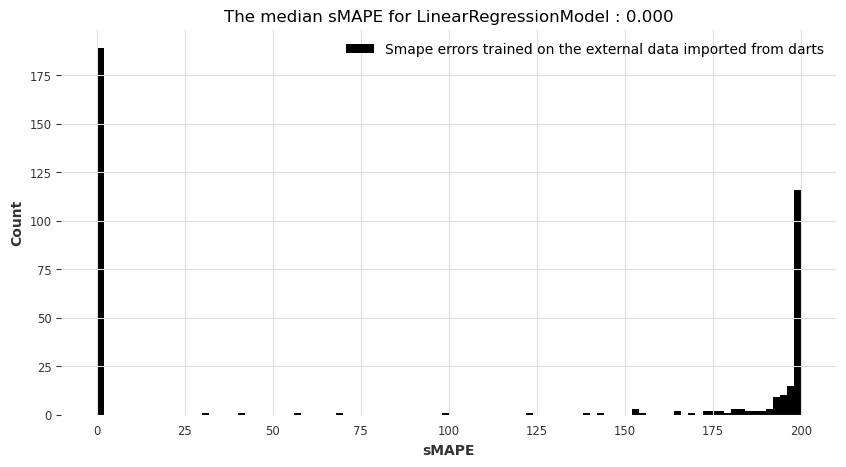

[I 2023-01-30 21:46:26,953] A new study created in memory with name: no-name-cab94c54-125e-4b38-a9f9-fa9031854b14
[I 2023-01-30 21:46:50,210] Trial 0 finished with value: 80.54422448386475 and parameters: {'out_len': 6}. Best is trial 0 with value: 80.54422448386475.
[I 2023-01-30 21:47:16,939] Trial 1 finished with value: 83.9763593461154 and parameters: {'out_len': 12}. Best is trial 0 with value: 80.54422448386475.
[I 2023-01-30 21:47:43,700] Trial 2 finished with value: 81.95120845419653 and parameters: {'out_len': 10}. Best is trial 0 with value: 80.54422448386475.
[I 2023-01-30 21:48:05,020] Trial 3 finished with value: 75.61912585614274 and parameters: {'out_len': 3}. Best is trial 3 with value: 75.61912585614274.
[I 2023-01-30 21:48:24,591] Trial 4 finished with value: 75.33469021514806 and parameters: {'out_len': 2}. Best is trial 4 with value: 75.33469021514806.
[I 2023-01-30 21:48:48,646] Trial 5 finished with value: 80.54422448386475 and parameters: {'out_len': 6}. Best is 

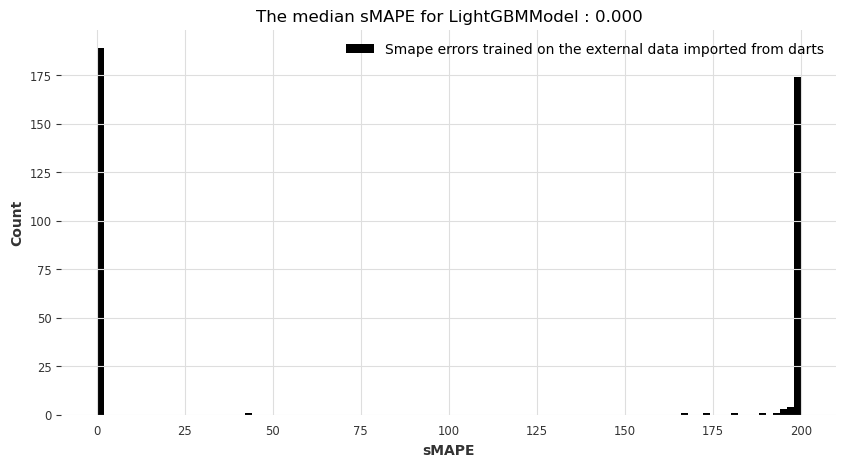

[I 2023-01-30 21:54:10,512] A new study created in memory with name: no-name-3b6209f6-c4a0-42ed-9b01-14110d5939c7
[I 2023-01-30 21:54:51,778] Trial 0 finished with value: 56.92043621478045 and parameters: {'out_len': 3, 'n_estimators': 83, 'max_depth': 22}. Best is trial 0 with value: 56.92043621478045.
[I 2023-01-30 21:55:31,678] Trial 1 finished with value: 56.06874513269218 and parameters: {'out_len': 5, 'n_estimators': 94, 'max_depth': 30}. Best is trial 1 with value: 56.06874513269218.
[I 2023-01-30 21:56:02,265] Trial 2 finished with value: 55.469000978537004 and parameters: {'out_len': 6, 'n_estimators': 55, 'max_depth': 29}. Best is trial 2 with value: 55.469000978537004.
[I 2023-01-30 21:56:25,290] Trial 3 finished with value: 71.4901211877398 and parameters: {'out_len': 12, 'n_estimators': 65, 'max_depth': 9}. Best is trial 2 with value: 55.469000978537004.
[I 2023-01-30 21:56:59,367] Trial 4 finished with value: 62.91026986347293 and parameters: {'out_len': 7, 'n_estimators'

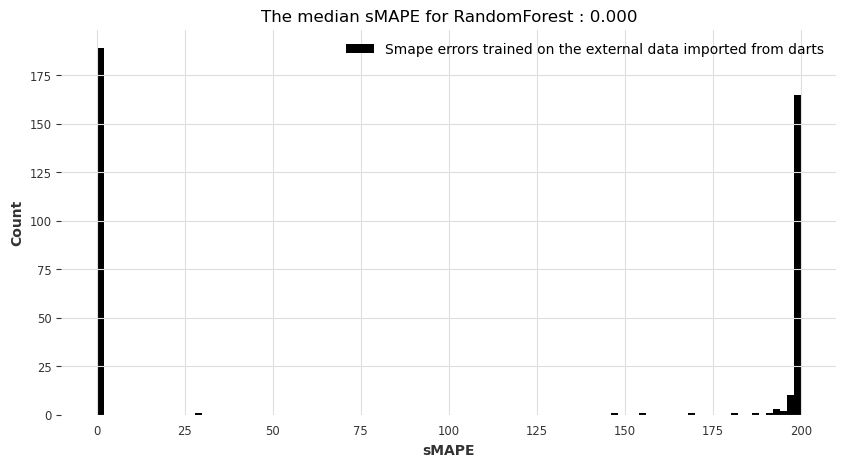

Visualization of performances taking the mean of the smapes over cross-validation


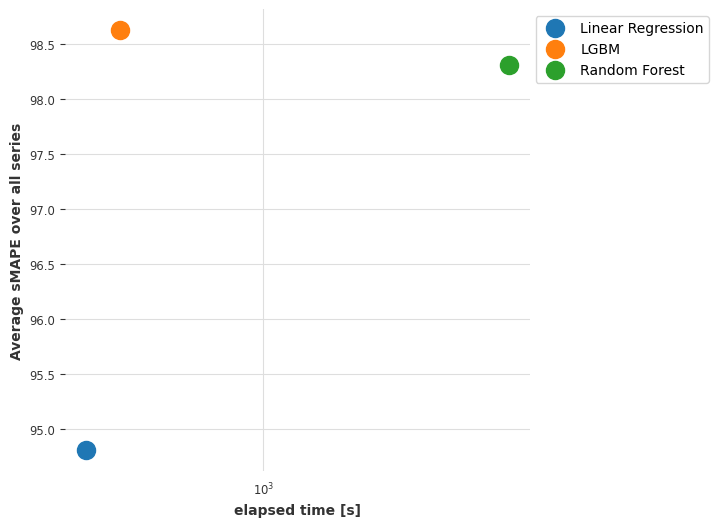

Visualization of performances taking the median of the smapes over cross-validation


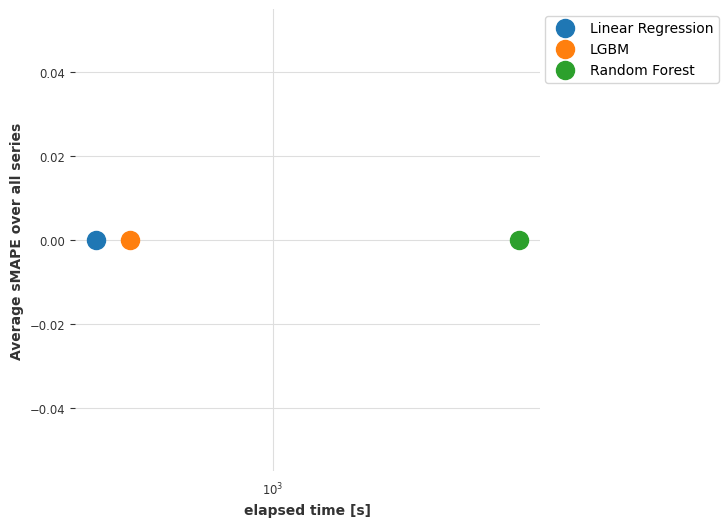

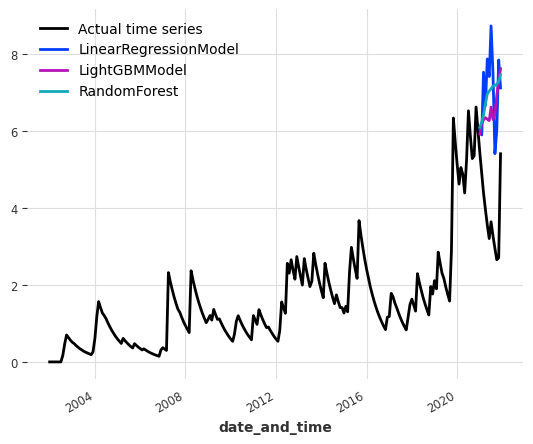

The results for index_cit_t2_t1 are:
The results for index_cit_t2_t1 with an horizon of 3 are:


[I 2023-01-30 22:56:43,481] A new study created in memory with name: no-name-5c530ab1-5a26-4b9b-9dc5-6ec8918e8974
[I 2023-01-30 22:57:03,238] Trial 0 finished with value: 78.15432105546498 and parameters: {'out_len': 7}. Best is trial 0 with value: 78.15432105546498.
[I 2023-01-30 22:57:22,731] Trial 1 finished with value: 80.71606517387407 and parameters: {'out_len': 6}. Best is trial 0 with value: 78.15432105546498.
[I 2023-01-30 22:57:42,050] Trial 2 finished with value: 87.45648658929444 and parameters: {'out_len': 1}. Best is trial 0 with value: 78.15432105546498.
[I 2023-01-30 22:58:01,432] Trial 3 finished with value: 85.25725962260877 and parameters: {'out_len': 3}. Best is trial 0 with value: 78.15432105546498.
[I 2023-01-30 22:58:21,218] Trial 4 finished with value: 78.83046325672468 and parameters: {'out_len': 9}. Best is trial 0 with value: 78.15432105546498.
[I 2023-01-30 22:58:40,396] Trial 5 finished with value: 87.45648658929444 and parameters: {'out_len': 1}. Best is t

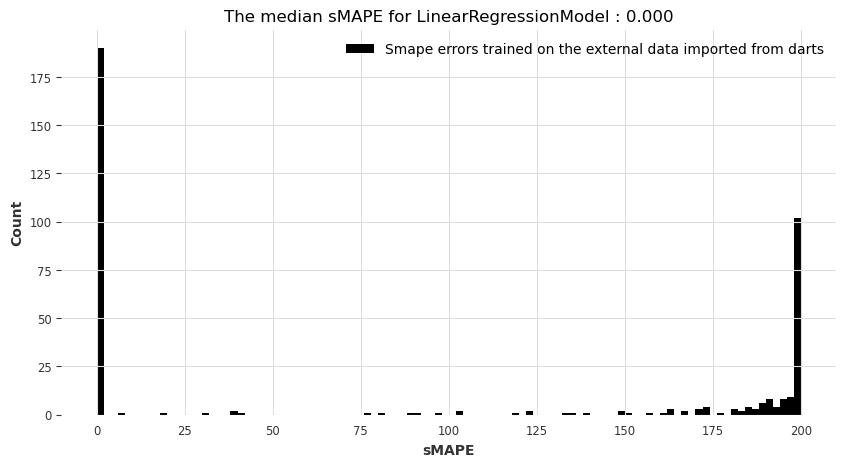

[I 2023-01-30 23:03:30,326] A new study created in memory with name: no-name-e0b9b4fd-0f0c-4efb-b8b5-39b380595ccb
[I 2023-01-30 23:03:54,292] Trial 0 finished with value: 68.61104095082176 and parameters: {'out_len': 5}. Best is trial 0 with value: 68.61104095082176.
[I 2023-01-30 23:04:20,754] Trial 1 finished with value: 74.37495538547823 and parameters: {'out_len': 8}. Best is trial 0 with value: 68.61104095082176.
[I 2023-01-30 23:04:47,064] Trial 2 finished with value: 74.37495538547823 and parameters: {'out_len': 8}. Best is trial 0 with value: 68.61104095082176.
[I 2023-01-30 23:05:10,682] Trial 3 finished with value: 76.29061647960518 and parameters: {'out_len': 3}. Best is trial 0 with value: 68.61104095082176.
[I 2023-01-30 23:05:38,363] Trial 4 finished with value: 77.50987026268105 and parameters: {'out_len': 12}. Best is trial 0 with value: 68.61104095082176.
[I 2023-01-30 23:06:00,558] Trial 5 finished with value: 76.29061647960518 and parameters: {'out_len': 3}. Best is 

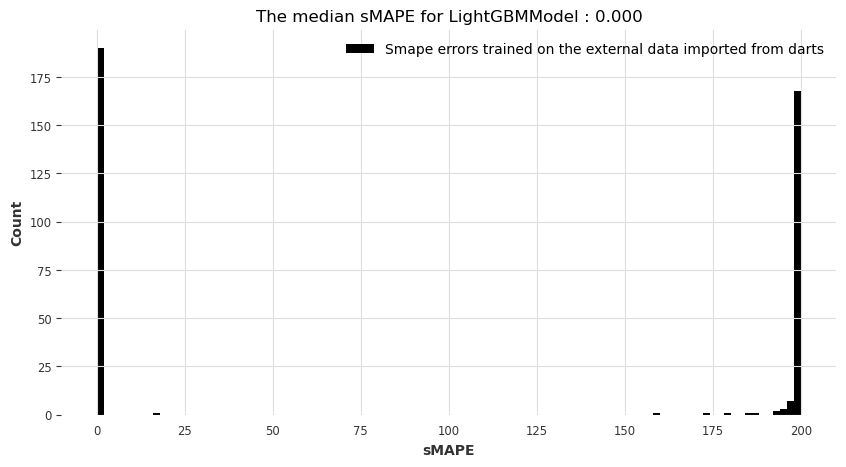

[I 2023-01-30 23:12:07,322] A new study created in memory with name: no-name-058c387c-e557-442c-95ce-47f048dd6f49
[I 2023-01-30 23:12:42,695] Trial 0 finished with value: 31.61815340607959 and parameters: {'out_len': 8, 'n_estimators': 80, 'max_depth': 26}. Best is trial 0 with value: 31.61815340607959.
[I 2023-01-30 23:13:18,364] Trial 1 finished with value: 56.61459456542139 and parameters: {'out_len': 1, 'n_estimators': 57, 'max_depth': 16}. Best is trial 0 with value: 31.61815340607959.
[I 2023-01-30 23:13:53,861] Trial 2 finished with value: 66.8738048896161 and parameters: {'out_len': 1, 'n_estimators': 64, 'max_depth': 13}. Best is trial 0 with value: 31.61815340607959.
[I 2023-01-30 23:14:25,247] Trial 3 finished with value: 45.96520948316013 and parameters: {'out_len': 10, 'n_estimators': 82, 'max_depth': 23}. Best is trial 0 with value: 31.61815340607959.
[I 2023-01-30 23:14:54,883] Trial 4 finished with value: 49.81660596343352 and parameters: {'out_len': 10, 'n_estimators':

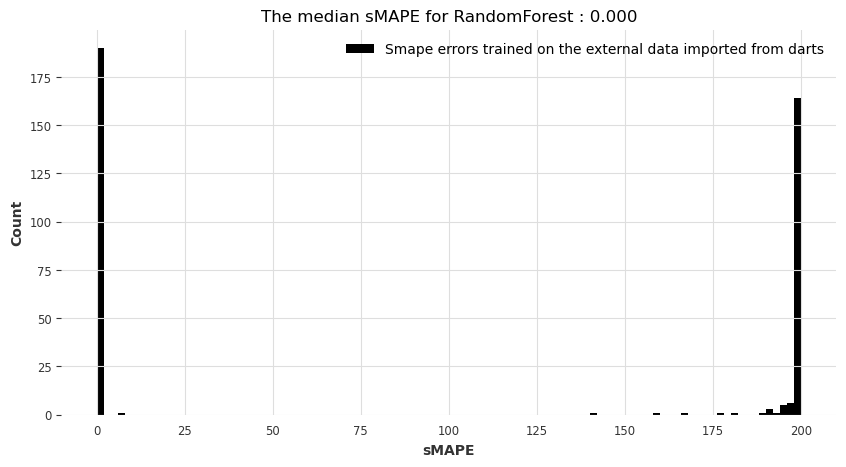

Visualization of performances taking the mean of the smapes over cross-validation


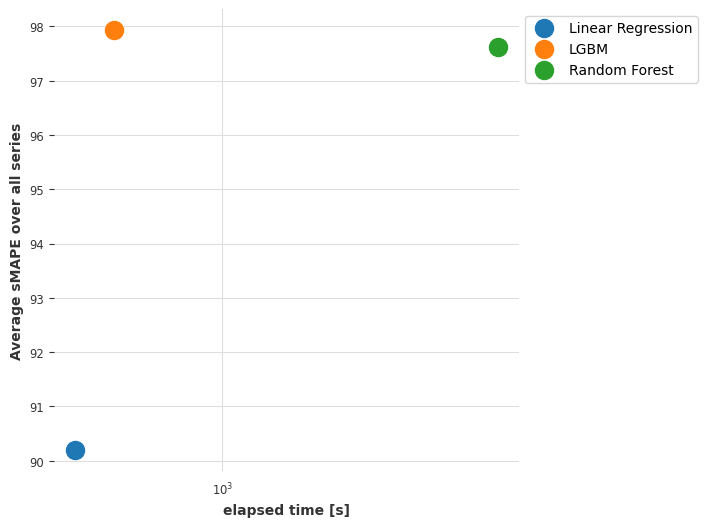

Visualization of performances taking the median of the smapes over cross-validation


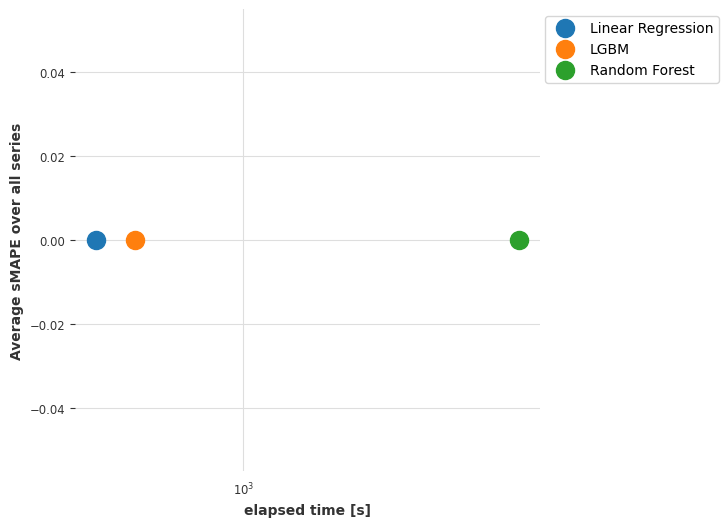

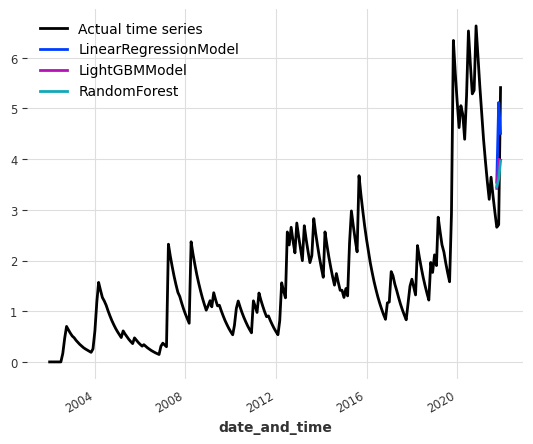

The results for index_cit_t2_t1 with an horizon of 6 are:


[I 2023-01-31 00:41:42,562] A new study created in memory with name: no-name-af55393d-75c9-4d99-ba02-b9764ef4d91b
[I 2023-01-31 00:42:01,947] Trial 0 finished with value: 85.66224772704551 and parameters: {'out_len': 5}. Best is trial 0 with value: 85.66224772704551.
[I 2023-01-31 00:42:21,765] Trial 1 finished with value: 87.67596477549517 and parameters: {'out_len': 12}. Best is trial 0 with value: 85.66224772704551.
[I 2023-01-31 00:42:41,600] Trial 2 finished with value: 84.17172914014616 and parameters: {'out_len': 7}. Best is trial 2 with value: 84.17172914014616.
[I 2023-01-31 00:43:01,184] Trial 3 finished with value: 86.82947821225567 and parameters: {'out_len': 6}. Best is trial 2 with value: 84.17172914014616.
[I 2023-01-31 00:43:20,346] Trial 4 finished with value: 86.13461034711459 and parameters: {'out_len': 4}. Best is trial 2 with value: 84.17172914014616.
[I 2023-01-31 00:43:39,163] Trial 5 finished with value: 84.4581607969043 and parameters: {'out_len': 8}. Best is t

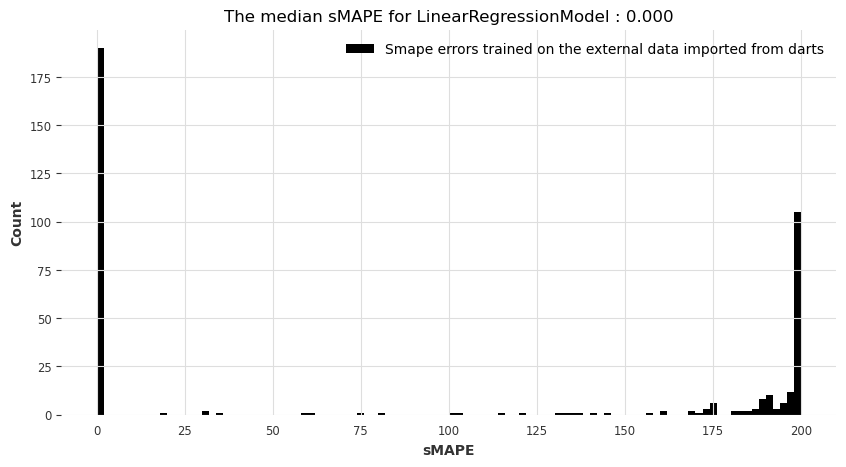

[I 2023-01-31 00:48:24,938] A new study created in memory with name: no-name-e0e3a93a-8c98-4bdd-aee9-9870626abedf
[I 2023-01-31 00:48:48,769] Trial 0 finished with value: 67.19854059861638 and parameters: {'out_len': 5}. Best is trial 0 with value: 67.19854059861638.
[I 2023-01-31 00:49:09,813] Trial 1 finished with value: 69.4997354667001 and parameters: {'out_len': 2}. Best is trial 0 with value: 67.19854059861638.
[I 2023-01-31 00:49:33,352] Trial 2 finished with value: 67.19854059861638 and parameters: {'out_len': 5}. Best is trial 0 with value: 67.19854059861638.
[I 2023-01-31 00:49:57,108] Trial 3 finished with value: 67.19854059861638 and parameters: {'out_len': 5}. Best is trial 0 with value: 67.19854059861638.
[I 2023-01-31 00:50:21,492] Trial 4 finished with value: 72.09742200914347 and parameters: {'out_len': 6}. Best is trial 0 with value: 67.19854059861638.
[I 2023-01-31 00:50:48,251] Trial 5 finished with value: 74.13220992908033 and parameters: {'out_len': 8}. Best is tr

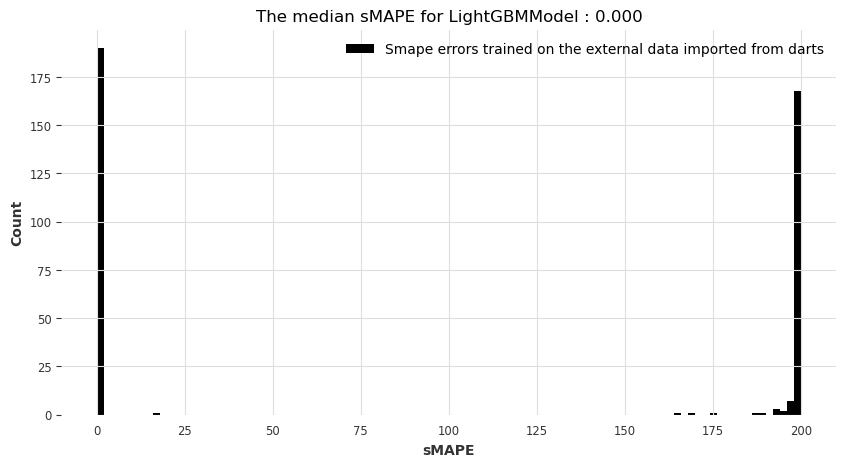

[I 2023-01-31 00:56:06,752] A new study created in memory with name: no-name-a6abc319-59b9-494e-a09c-da8b4dbc0f1c
[I 2023-01-31 00:56:39,231] Trial 0 finished with value: 61.47952652248414 and parameters: {'out_len': 7, 'n_estimators': 98, 'max_depth': 10}. Best is trial 0 with value: 61.47952652248414.
[I 2023-01-31 00:57:10,462] Trial 1 finished with value: 37.366647875641945 and parameters: {'out_len': 10, 'n_estimators': 84, 'max_depth': 25}. Best is trial 1 with value: 37.366647875641945.
[I 2023-01-31 00:57:35,831] Trial 2 finished with value: 60.871337749421315 and parameters: {'out_len': 5, 'n_estimators': 52, 'max_depth': 8}. Best is trial 1 with value: 37.366647875641945.
[I 2023-01-31 00:58:04,451] Trial 3 finished with value: 37.55034423704331 and parameters: {'out_len': 11, 'n_estimators': 76, 'max_depth': 21}. Best is trial 1 with value: 37.366647875641945.
[I 2023-01-31 00:58:32,291] Trial 4 finished with value: 38.187231315466946 and parameters: {'out_len': 10, 'n_estim

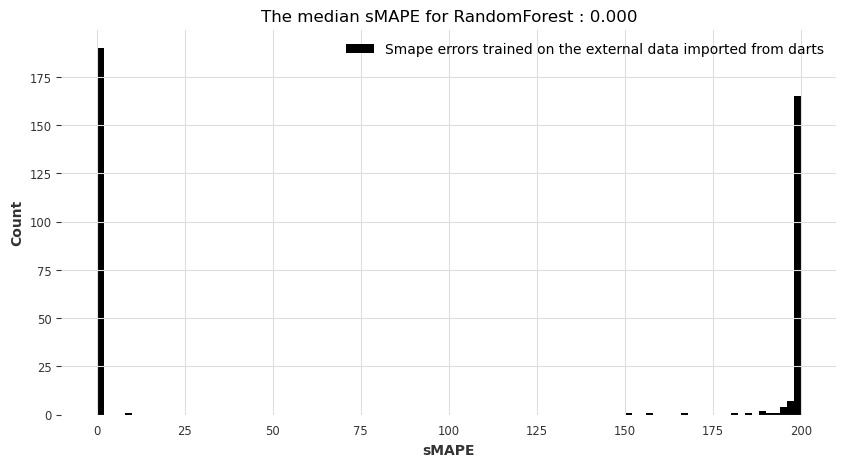

Visualization of performances taking the mean of the smapes over cross-validation


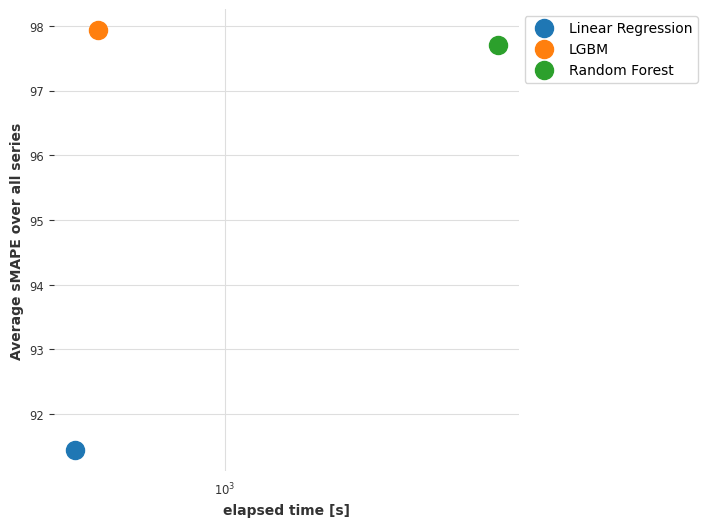

Visualization of performances taking the median of the smapes over cross-validation


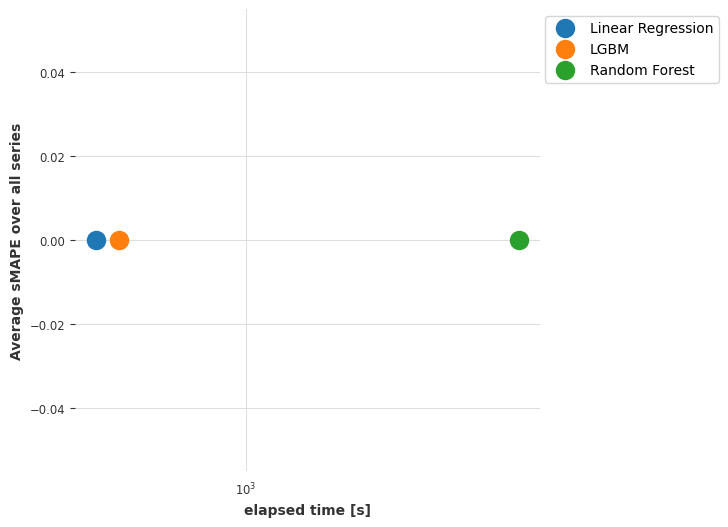

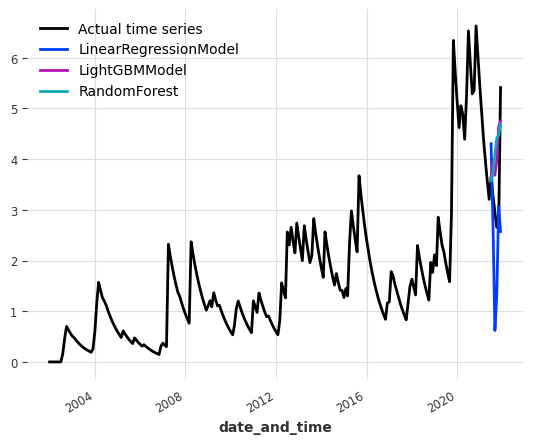

The results for index_cit_t2_t1 with an horizon of 12 are:


[I 2023-01-31 02:24:01,953] A new study created in memory with name: no-name-f713981c-8ee1-4c99-8b76-4138ab5dfa4a
[I 2023-01-31 02:24:19,946] Trial 0 finished with value: 88.81292525747693 and parameters: {'out_len': 5}. Best is trial 0 with value: 88.81292525747693.
[I 2023-01-31 02:24:38,733] Trial 1 finished with value: 87.76794106799585 and parameters: {'out_len': 6}. Best is trial 1 with value: 87.76794106799585.
[I 2023-01-31 02:24:58,430] Trial 2 finished with value: 86.07699356668228 and parameters: {'out_len': 11}. Best is trial 2 with value: 86.07699356668228.
[I 2023-01-31 02:25:17,828] Trial 3 finished with value: 87.1597309025337 and parameters: {'out_len': 10}. Best is trial 2 with value: 86.07699356668228.
[I 2023-01-31 02:25:36,336] Trial 4 finished with value: 86.18713495139457 and parameters: {'out_len': 9}. Best is trial 2 with value: 86.07699356668228.
[I 2023-01-31 02:25:56,342] Trial 5 finished with value: 87.32459395511378 and parameters: {'out_len': 12}. Best is

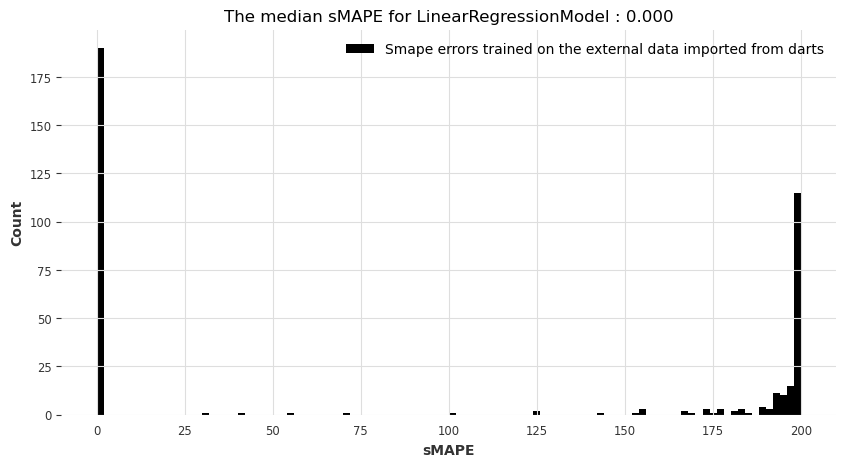

[I 2023-01-31 02:30:33,063] A new study created in memory with name: no-name-6a5032b6-85fb-4c1b-938f-6afc774b52d3
[I 2023-01-31 02:30:52,992] Trial 0 finished with value: 74.2330912823493 and parameters: {'out_len': 1}. Best is trial 0 with value: 74.2330912823493.
[I 2023-01-31 02:31:19,628] Trial 1 finished with value: 84.81770662547773 and parameters: {'out_len': 12}. Best is trial 0 with value: 74.2330912823493.
[I 2023-01-31 02:31:45,559] Trial 2 finished with value: 77.65821322756118 and parameters: {'out_len': 9}. Best is trial 0 with value: 74.2330912823493.
[I 2023-01-31 02:32:05,970] Trial 3 finished with value: 76.88705668107991 and parameters: {'out_len': 2}. Best is trial 0 with value: 74.2330912823493.
[I 2023-01-31 02:32:31,884] Trial 4 finished with value: 77.65821322756118 and parameters: {'out_len': 9}. Best is trial 0 with value: 74.2330912823493.
[I 2023-01-31 02:32:55,971] Trial 5 finished with value: 78.76051166982623 and parameters: {'out_len': 7}. Best is trial 

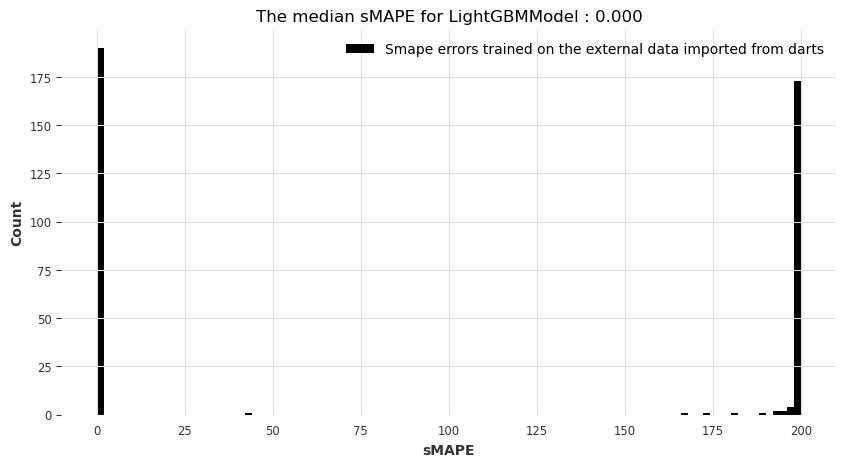

[I 2023-01-31 02:38:12,923] A new study created in memory with name: no-name-baaf9dc6-fa5c-430e-8fd6-6ecf05e09876
[I 2023-01-31 02:38:45,574] Trial 0 finished with value: 49.201518977768856 and parameters: {'out_len': 9, 'n_estimators': 99, 'max_depth': 19}. Best is trial 0 with value: 49.201518977768856.
[I 2023-01-31 02:39:11,128] Trial 1 finished with value: 48.4782695786793 and parameters: {'out_len': 12, 'n_estimators': 79, 'max_depth': 21}. Best is trial 1 with value: 48.4782695786793.
[I 2023-01-31 02:39:41,123] Trial 2 finished with value: 45.05916643223164 and parameters: {'out_len': 6, 'n_estimators': 54, 'max_depth': 25}. Best is trial 2 with value: 45.05916643223164.
[I 2023-01-31 02:40:08,480] Trial 3 finished with value: 55.17489505680131 and parameters: {'out_len': 11, 'n_estimators': 87, 'max_depth': 18}. Best is trial 2 with value: 45.05916643223164.
[I 2023-01-31 02:40:42,023] Trial 4 finished with value: 64.67417091841328 and parameters: {'out_len': 2, 'n_estimators'

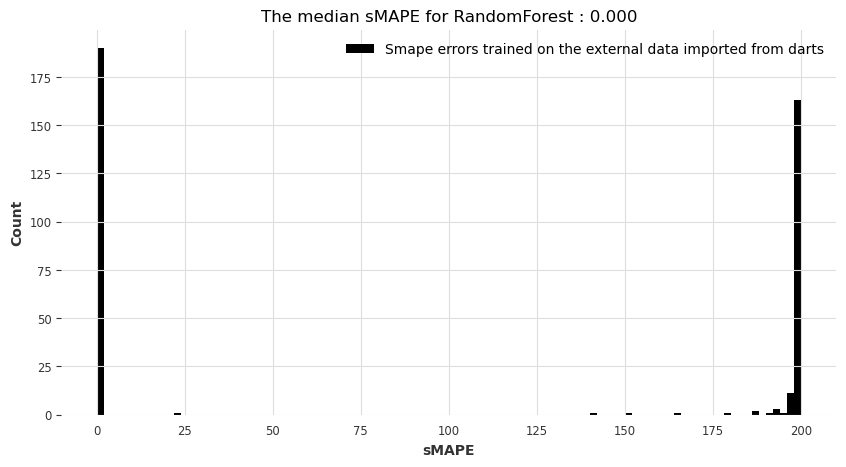

Visualization of performances taking the mean of the smapes over cross-validation


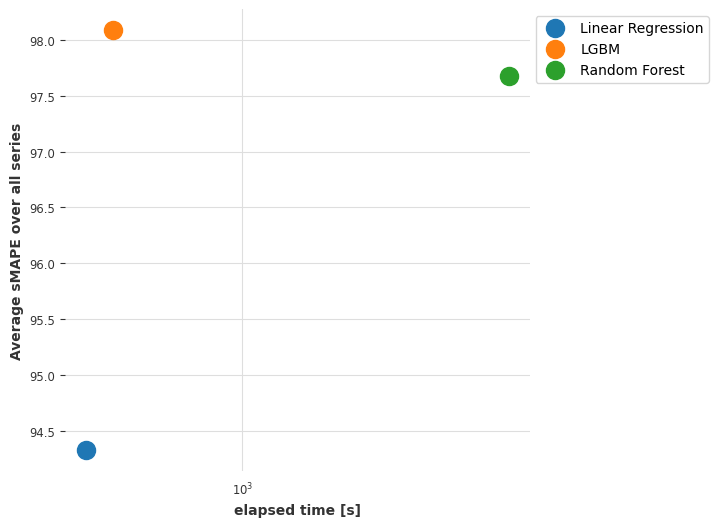

Visualization of performances taking the median of the smapes over cross-validation


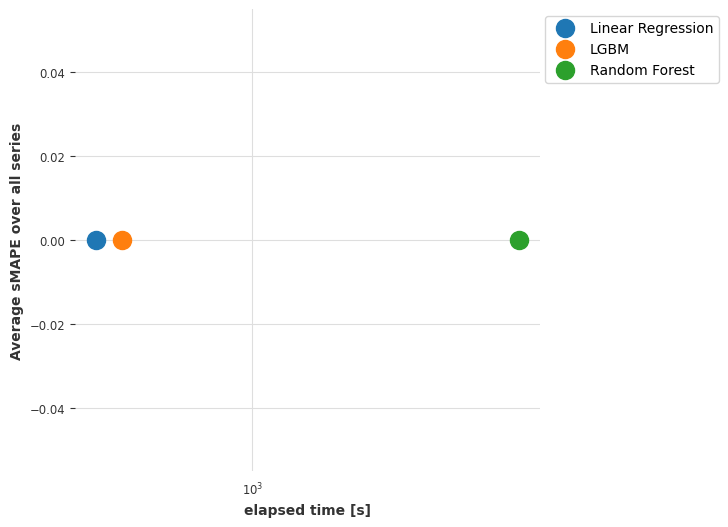

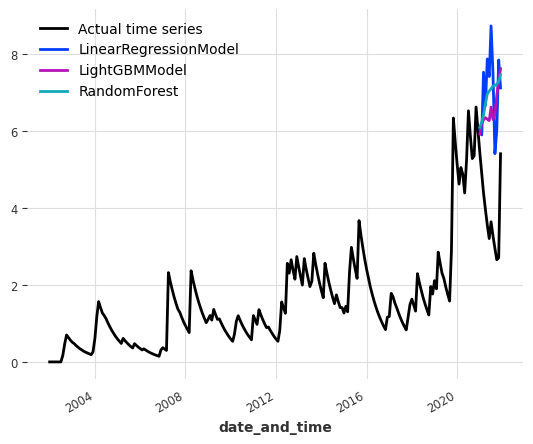

The results for index_colab_increm are:
The results for index_colab_increm with an horizon of 3 are:


[I 2023-01-31 04:00:48,715] A new study created in memory with name: no-name-f2c5218c-442a-42f6-827d-5c846ea43b07
[I 2023-01-31 04:01:08,612] Trial 0 finished with value: 88.8389419223903 and parameters: {'out_len': 9}. Best is trial 0 with value: 88.8389419223903.
[I 2023-01-31 04:01:28,587] Trial 1 finished with value: 79.8101941117674 and parameters: {'out_len': 12}. Best is trial 1 with value: 79.8101941117674.
[I 2023-01-31 04:01:49,753] Trial 2 finished with value: 88.8389419223903 and parameters: {'out_len': 9}. Best is trial 1 with value: 79.8101941117674.
[I 2023-01-31 04:02:09,322] Trial 3 finished with value: 88.97371479958029 and parameters: {'out_len': 3}. Best is trial 1 with value: 79.8101941117674.
[I 2023-01-31 04:02:29,238] Trial 4 finished with value: 88.8389419223903 and parameters: {'out_len': 9}. Best is trial 1 with value: 79.8101941117674.
[I 2023-01-31 04:02:48,555] Trial 5 finished with value: 83.27236388114832 and parameters: {'out_len': 7}. Best is trial 1 w

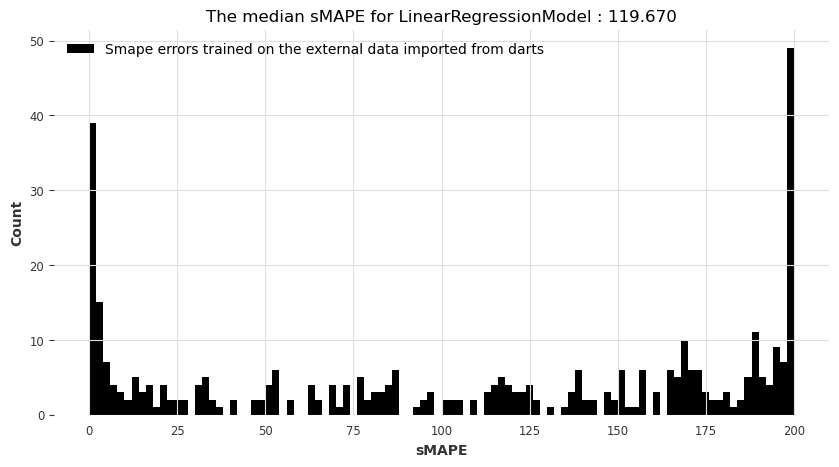

[I 2023-01-31 04:07:42,111] A new study created in memory with name: no-name-f1b518ee-0f1f-4d13-ab03-5d43f0c42996
[I 2023-01-31 04:08:06,916] Trial 0 finished with value: 57.35956208789874 and parameters: {'out_len': 5}. Best is trial 0 with value: 57.35956208789874.
[I 2023-01-31 04:08:29,545] Trial 1 finished with value: 57.75008160782559 and parameters: {'out_len': 4}. Best is trial 0 with value: 57.35956208789874.
[I 2023-01-31 04:08:52,833] Trial 2 finished with value: 57.35956208789874 and parameters: {'out_len': 5}. Best is trial 0 with value: 57.35956208789874.
[I 2023-01-31 04:09:14,652] Trial 3 finished with value: 57.49379622072897 and parameters: {'out_len': 3}. Best is trial 0 with value: 57.35956208789874.
[I 2023-01-31 04:09:42,363] Trial 4 finished with value: 59.60230455486177 and parameters: {'out_len': 12}. Best is trial 0 with value: 57.35956208789874.
[I 2023-01-31 04:10:07,805] Trial 5 finished with value: 60.2444070025753 and parameters: {'out_len': 8}. Best is t

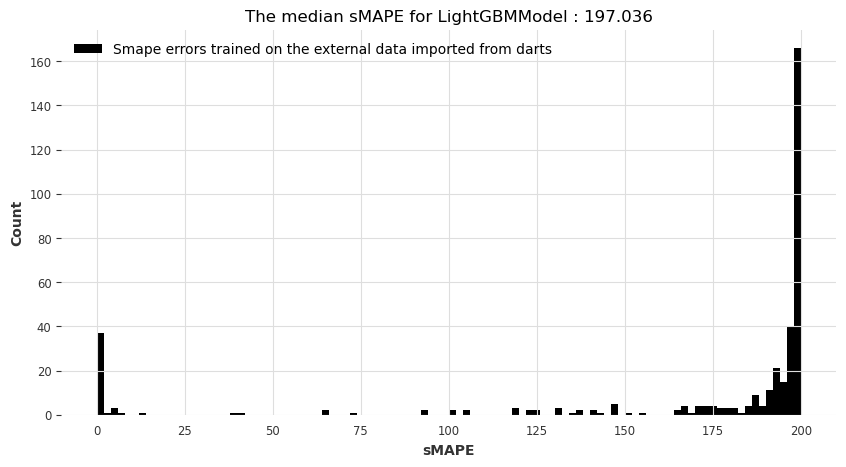

[I 2023-01-31 04:15:24,913] A new study created in memory with name: no-name-06a463cd-f2d2-4b45-843d-ee5503fd05da
[I 2023-01-31 04:16:15,178] Trial 0 finished with value: 50.166493689995534 and parameters: {'out_len': 3, 'n_estimators': 57, 'max_depth': 26}. Best is trial 0 with value: 50.166493689995534.
[I 2023-01-31 04:17:02,681] Trial 1 finished with value: 54.0589813108869 and parameters: {'out_len': 2, 'n_estimators': 51, 'max_depth': 19}. Best is trial 0 with value: 50.166493689995534.
[I 2023-01-31 04:17:32,334] Trial 2 finished with value: 53.86443849106308 and parameters: {'out_len': 12, 'n_estimators': 65, 'max_depth': 29}. Best is trial 0 with value: 50.166493689995534.
[I 2023-01-31 04:18:24,227] Trial 3 finished with value: 51.482415941261486 and parameters: {'out_len': 3, 'n_estimators': 61, 'max_depth': 23}. Best is trial 0 with value: 50.166493689995534.
[I 2023-01-31 04:19:01,071] Trial 4 finished with value: 49.887644353147536 and parameters: {'out_len': 2, 'n_estima

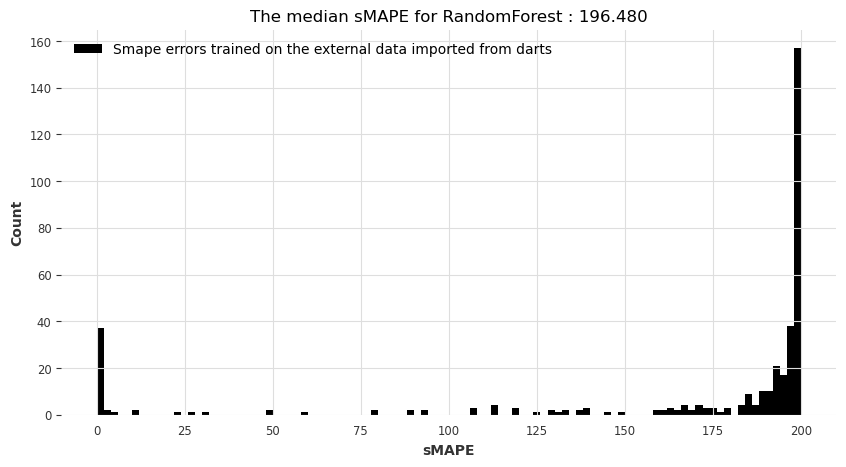

Visualization of performances taking the mean of the smapes over cross-validation


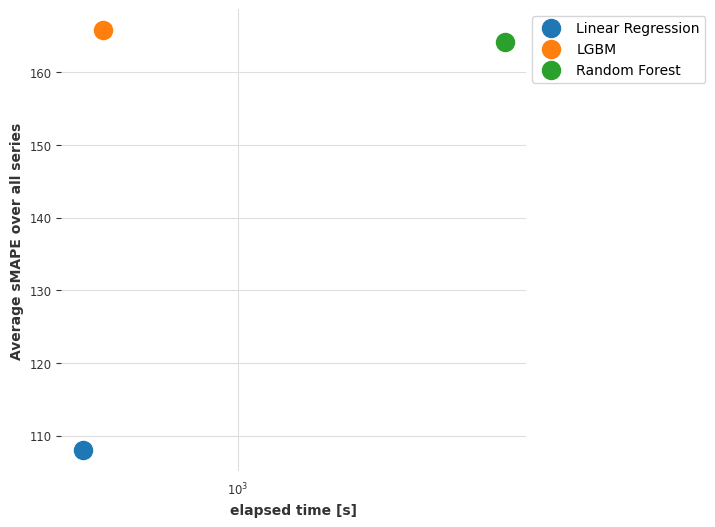

Visualization of performances taking the median of the smapes over cross-validation


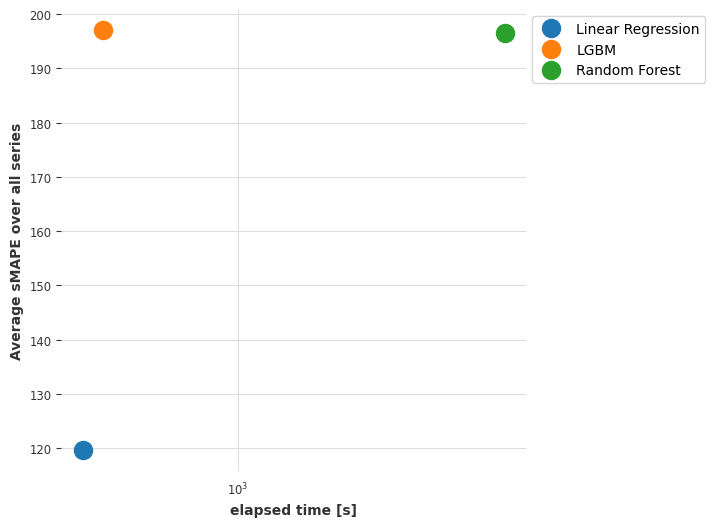

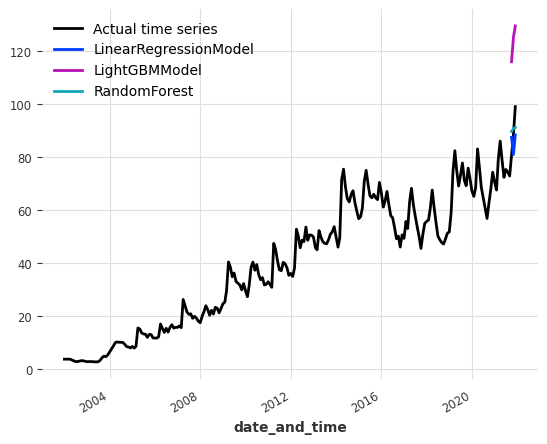

The results for index_colab_increm with an horizon of 6 are:


[I 2023-01-31 05:32:05,736] A new study created in memory with name: no-name-225b1268-6786-4290-a772-e2425b68b4f6
[I 2023-01-31 05:32:25,338] Trial 0 finished with value: 107.76369201721509 and parameters: {'out_len': 9}. Best is trial 0 with value: 107.76369201721509.
[I 2023-01-31 05:32:45,157] Trial 1 finished with value: 108.76916871048155 and parameters: {'out_len': 8}. Best is trial 0 with value: 107.76369201721509.
[I 2023-01-31 05:33:04,913] Trial 2 finished with value: 105.14748181331201 and parameters: {'out_len': 10}. Best is trial 2 with value: 105.14748181331201.
[I 2023-01-31 05:33:24,358] Trial 3 finished with value: 103.78574539991864 and parameters: {'out_len': 7}. Best is trial 3 with value: 103.78574539991864.
[I 2023-01-31 05:33:43,535] Trial 4 finished with value: 95.51293601992376 and parameters: {'out_len': 2}. Best is trial 4 with value: 95.51293601992376.
[I 2023-01-31 05:34:02,884] Trial 5 finished with value: 101.39229060579171 and parameters: {'out_len': 5}.

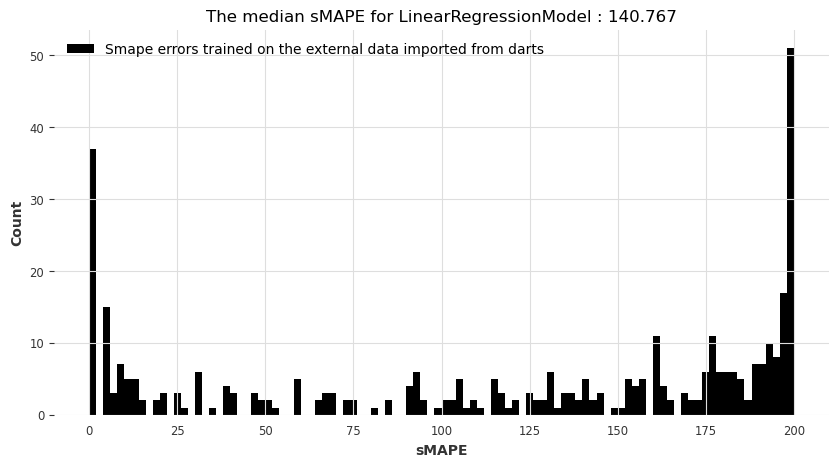

[I 2023-01-31 05:38:45,047] A new study created in memory with name: no-name-81681d8f-ff87-4e7f-a913-8fd1620e3cb3
[I 2023-01-31 05:39:07,884] Trial 0 finished with value: 64.81981632101436 and parameters: {'out_len': 4}. Best is trial 0 with value: 64.81981632101436.
[I 2023-01-31 05:39:27,687] Trial 1 finished with value: 63.60314211392319 and parameters: {'out_len': 1}. Best is trial 1 with value: 63.60314211392319.
[I 2023-01-31 05:39:50,308] Trial 2 finished with value: 63.730994894858284 and parameters: {'out_len': 5}. Best is trial 1 with value: 63.60314211392319.
[I 2023-01-31 05:40:14,084] Trial 3 finished with value: 63.730994894858284 and parameters: {'out_len': 5}. Best is trial 1 with value: 63.60314211392319.
[I 2023-01-31 05:40:33,326] Trial 4 finished with value: 63.60314211392319 and parameters: {'out_len': 1}. Best is trial 1 with value: 63.60314211392319.
[I 2023-01-31 05:41:00,303] Trial 5 finished with value: 63.364504543418455 and parameters: {'out_len': 9}. Best i

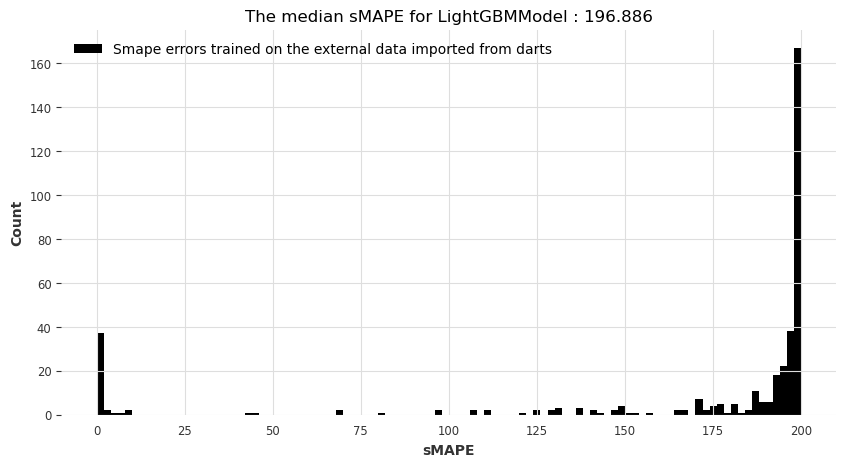

[I 2023-01-31 05:47:50,051] A new study created in memory with name: no-name-e61f7248-67b0-41af-8e3a-21212a767dc6
[I 2023-01-31 05:48:46,677] Trial 0 finished with value: 59.572423081303114 and parameters: {'out_len': 4, 'n_estimators': 99, 'max_depth': 12}. Best is trial 0 with value: 59.572423081303114.
[I 2023-01-31 05:49:19,500] Trial 1 finished with value: 58.45153612119413 and parameters: {'out_len': 11, 'n_estimators': 98, 'max_depth': 10}. Best is trial 1 with value: 58.45153612119413.
[I 2023-01-31 05:49:54,497] Trial 2 finished with value: 55.7074052211711 and parameters: {'out_len': 11, 'n_estimators': 81, 'max_depth': 27}. Best is trial 2 with value: 55.7074052211711.
[I 2023-01-31 05:50:43,496] Trial 3 finished with value: 60.350556649209835 and parameters: {'out_len': 6, 'n_estimators': 87, 'max_depth': 14}. Best is trial 2 with value: 55.7074052211711.
[I 2023-01-31 05:51:26,868] Trial 4 finished with value: 57.15168315833261 and parameters: {'out_len': 5, 'n_estimators'

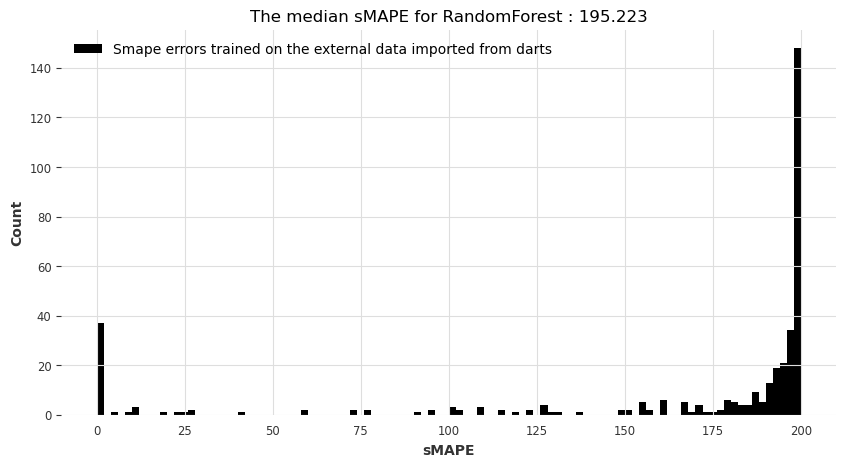

Visualization of performances taking the mean of the smapes over cross-validation


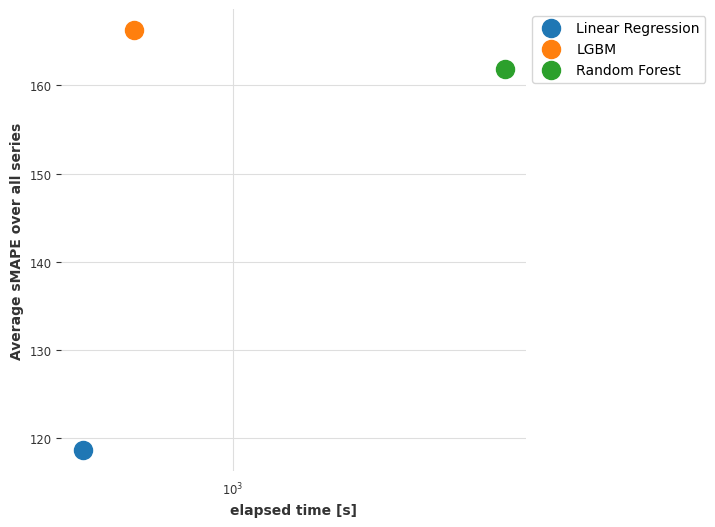

Visualization of performances taking the median of the smapes over cross-validation


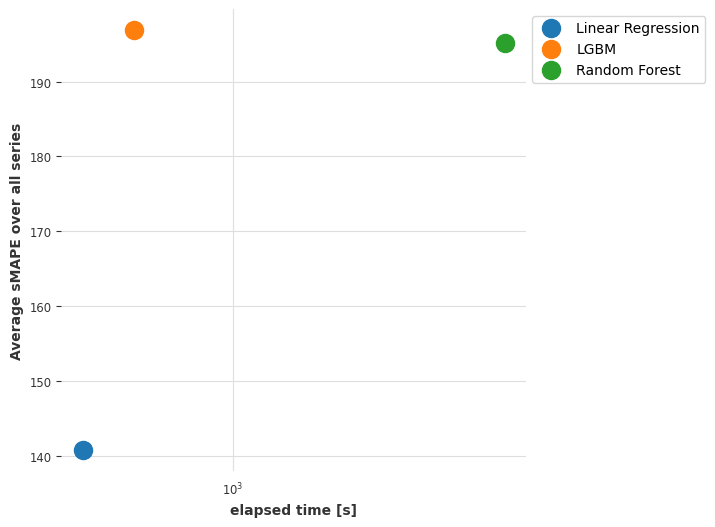

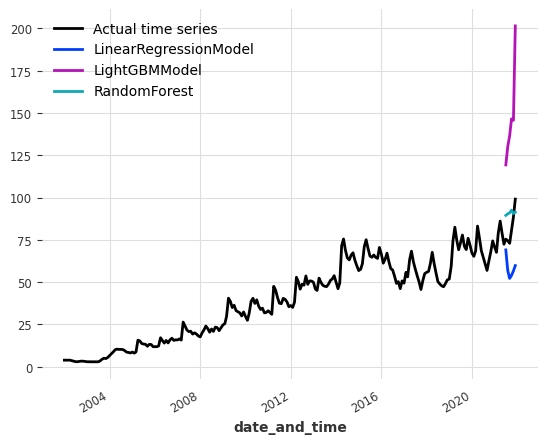

The results for index_colab_increm with an horizon of 12 are:


[I 2023-01-31 07:16:19,988] A new study created in memory with name: no-name-3b413786-053c-47ec-9cf8-f1fb8accfcab
[I 2023-01-31 07:16:39,103] Trial 0 finished with value: 111.8739119480219 and parameters: {'out_len': 8}. Best is trial 0 with value: 111.8739119480219.
[I 2023-01-31 07:16:57,704] Trial 1 finished with value: 115.14868642112764 and parameters: {'out_len': 6}. Best is trial 0 with value: 111.8739119480219.
[I 2023-01-31 07:17:16,647] Trial 2 finished with value: 115.14868642112764 and parameters: {'out_len': 6}. Best is trial 0 with value: 111.8739119480219.
[I 2023-01-31 07:17:35,104] Trial 3 finished with value: 110.18794663077851 and parameters: {'out_len': 2}. Best is trial 3 with value: 110.18794663077851.
[I 2023-01-31 07:17:53,002] Trial 4 finished with value: 112.57211295712904 and parameters: {'out_len': 3}. Best is trial 3 with value: 110.18794663077851.
[I 2023-01-31 07:18:12,260] Trial 5 finished with value: 115.39504137836487 and parameters: {'out_len': 9}. Be

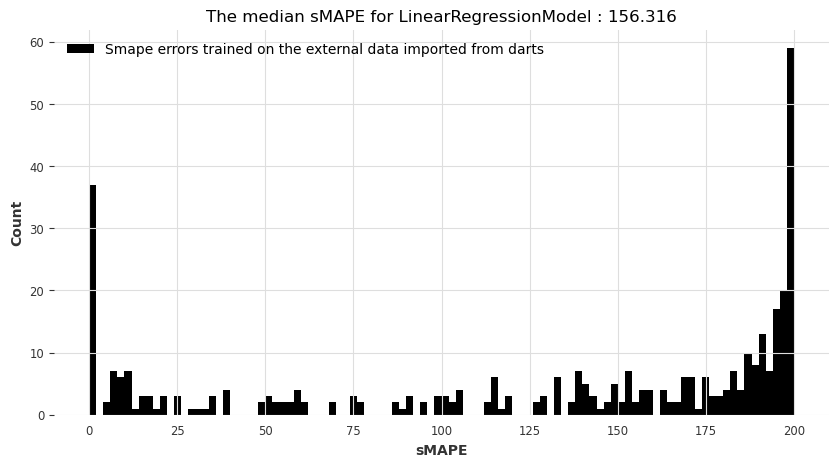

[I 2023-01-31 07:22:50,670] A new study created in memory with name: no-name-e841e314-00cd-4d5d-a28e-640dcc44da39
[I 2023-01-31 07:23:09,178] Trial 0 finished with value: 71.08507068565642 and parameters: {'out_len': 1}. Best is trial 0 with value: 71.08507068565642.
[I 2023-01-31 07:23:30,088] Trial 1 finished with value: 69.33481727245434 and parameters: {'out_len': 3}. Best is trial 1 with value: 69.33481727245434.
[I 2023-01-31 07:23:56,945] Trial 2 finished with value: 77.95305008895747 and parameters: {'out_len': 12}. Best is trial 1 with value: 69.33481727245434.
[I 2023-01-31 07:24:17,863] Trial 3 finished with value: 71.41966227787513 and parameters: {'out_len': 4}. Best is trial 1 with value: 69.33481727245434.
[I 2023-01-31 07:24:44,497] Trial 4 finished with value: 71.9475396970997 and parameters: {'out_len': 9}. Best is trial 1 with value: 69.33481727245434.
[I 2023-01-31 07:25:07,116] Trial 5 finished with value: 71.51535814756878 and parameters: {'out_len': 6}. Best is t

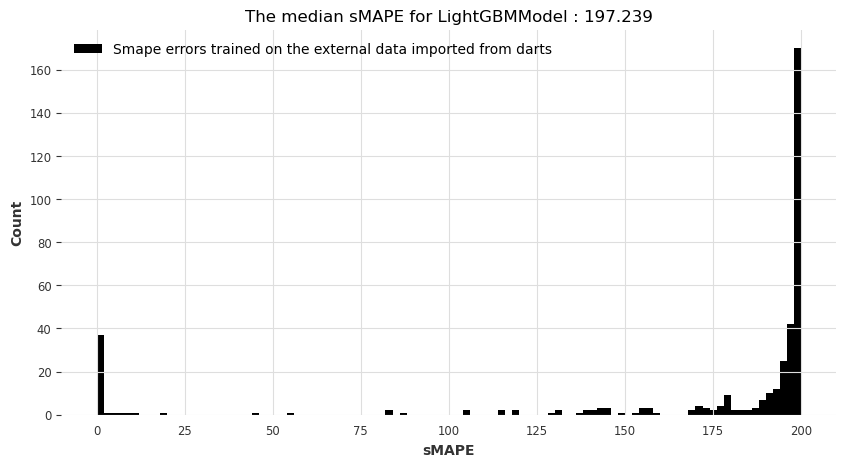

[I 2023-01-31 07:30:44,892] A new study created in memory with name: no-name-117f4cb2-2275-4642-b0f6-32b679f2375b
[I 2023-01-31 07:31:25,684] Trial 0 finished with value: 69.18941173534611 and parameters: {'out_len': 4, 'n_estimators': 68, 'max_depth': 11}. Best is trial 0 with value: 69.18941173534611.
[I 2023-01-31 07:32:22,657] Trial 1 finished with value: 67.50561390678415 and parameters: {'out_len': 2, 'n_estimators': 75, 'max_depth': 19}. Best is trial 1 with value: 67.50561390678415.
[I 2023-01-31 07:33:09,108] Trial 2 finished with value: 63.913636159396866 and parameters: {'out_len': 9, 'n_estimators': 99, 'max_depth': 30}. Best is trial 2 with value: 63.913636159396866.
[I 2023-01-31 07:34:19,522] Trial 3 finished with value: 64.16197223602467 and parameters: {'out_len': 1, 'n_estimators': 93, 'max_depth': 21}. Best is trial 2 with value: 63.913636159396866.
[I 2023-01-31 07:35:29,832] Trial 4 finished with value: 61.47007612304235 and parameters: {'out_len': 1, 'n_estimators

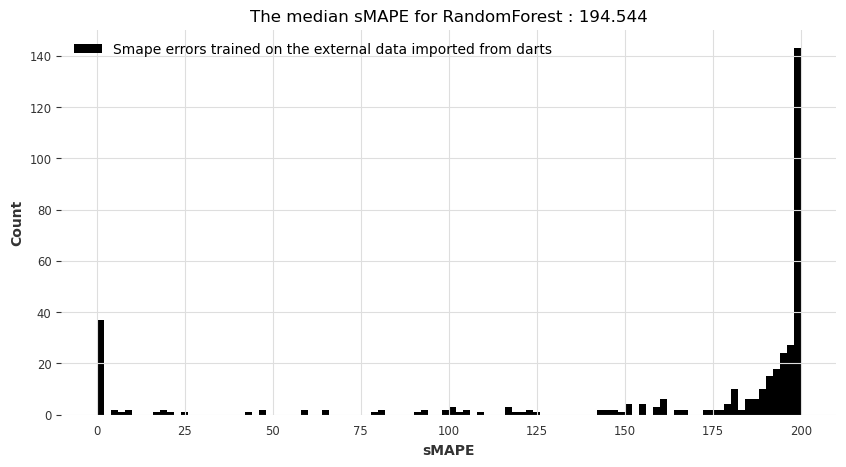

Visualization of performances taking the mean of the smapes over cross-validation


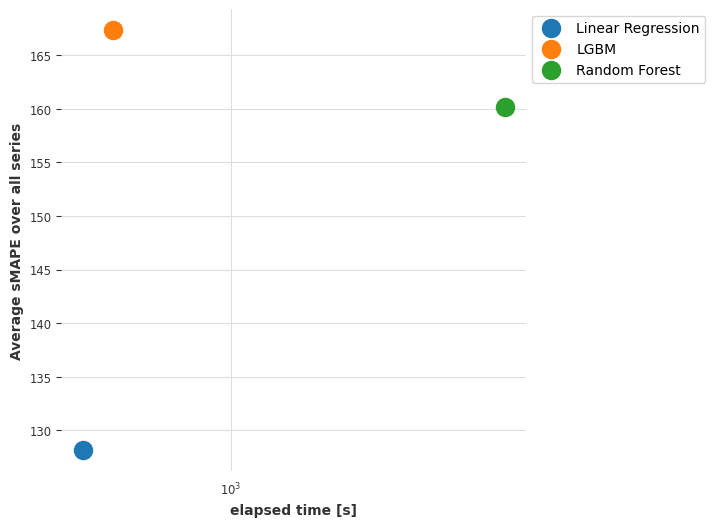

Visualization of performances taking the median of the smapes over cross-validation


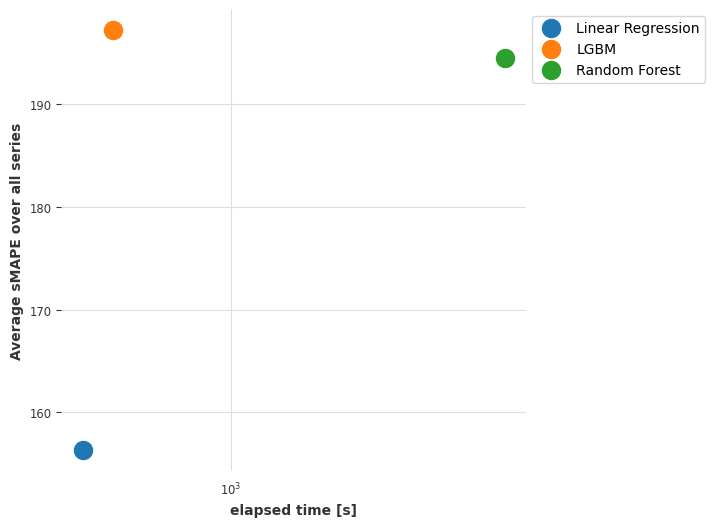

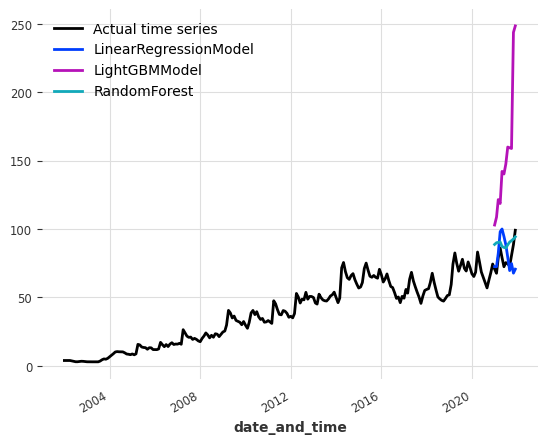

The results for index_colab_notincrem are:
The results for index_colab_notincrem with an horizon of 3 are:


[I 2023-01-31 09:06:28,774] A new study created in memory with name: no-name-6d95cf1d-e467-45d9-b7be-726449a74b6d
[I 2023-01-31 09:06:48,930] Trial 0 finished with value: 80.63737108642954 and parameters: {'out_len': 2}. Best is trial 0 with value: 80.63737108642954.
[I 2023-01-31 09:07:07,919] Trial 1 finished with value: 75.15022721640467 and parameters: {'out_len': 6}. Best is trial 1 with value: 75.15022721640467.
[I 2023-01-31 09:07:27,224] Trial 2 finished with value: 80.55399575116066 and parameters: {'out_len': 1}. Best is trial 1 with value: 75.15022721640467.
[I 2023-01-31 09:07:46,652] Trial 3 finished with value: 77.25691825470341 and parameters: {'out_len': 4}. Best is trial 1 with value: 75.15022721640467.
[I 2023-01-31 09:08:06,536] Trial 4 finished with value: 78.19372656597464 and parameters: {'out_len': 9}. Best is trial 1 with value: 75.15022721640467.
[I 2023-01-31 09:08:26,104] Trial 5 finished with value: 75.15022721640467 and parameters: {'out_len': 6}. Best is t

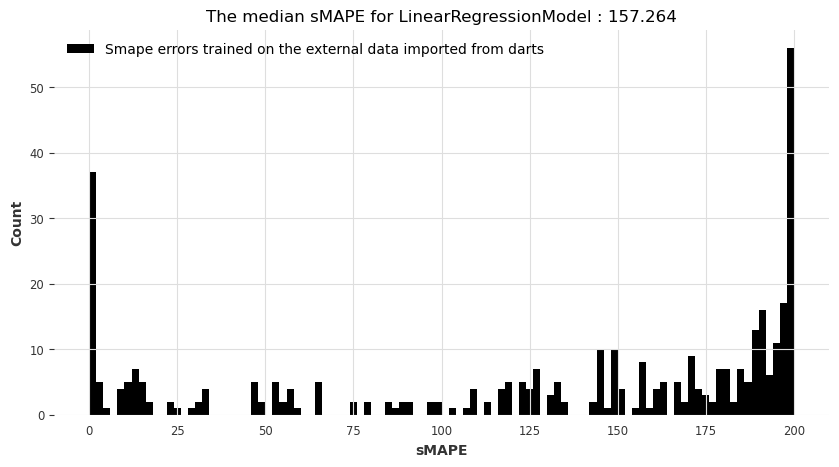

[I 2023-01-31 09:13:14,269] A new study created in memory with name: no-name-2dc72fcb-13bb-43dd-981f-5dc8fb8afbd6
[I 2023-01-31 09:13:42,214] Trial 0 finished with value: 58.62219760851907 and parameters: {'out_len': 11}. Best is trial 0 with value: 58.62219760851907.
[I 2023-01-31 09:14:06,726] Trial 1 finished with value: 54.59447416408107 and parameters: {'out_len': 7}. Best is trial 1 with value: 54.59447416408107.
[I 2023-01-31 09:14:26,778] Trial 2 finished with value: 49.79733485793192 and parameters: {'out_len': 1}. Best is trial 2 with value: 49.79733485793192.
[I 2023-01-31 09:14:51,291] Trial 3 finished with value: 53.064920028902456 and parameters: {'out_len': 6}. Best is trial 2 with value: 49.79733485793192.
[I 2023-01-31 09:15:19,111] Trial 4 finished with value: 58.02949962526593 and parameters: {'out_len': 12}. Best is trial 2 with value: 49.79733485793192.
[I 2023-01-31 09:15:45,295] Trial 5 finished with value: 55.225882332218454 and parameters: {'out_len': 9}. Best 

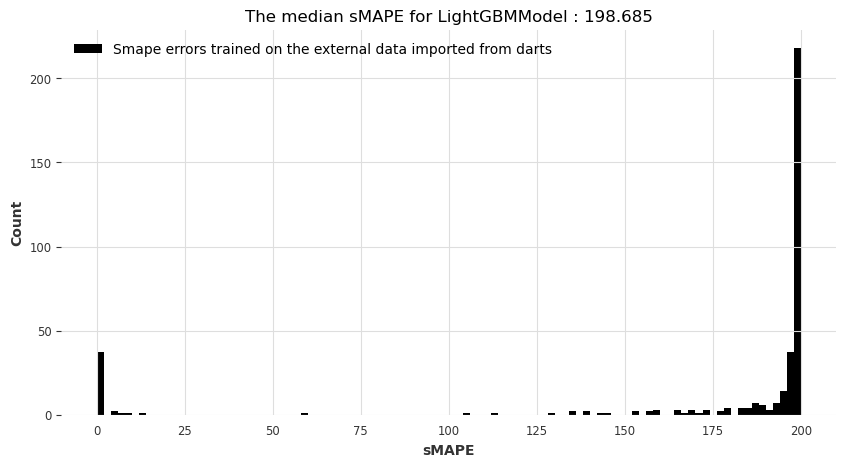

[I 2023-01-31 09:21:46,993] A new study created in memory with name: no-name-17a136f4-e7d1-444f-9c4c-e006c5c999bd
[I 2023-01-31 09:22:24,354] Trial 0 finished with value: 49.387779092472655 and parameters: {'out_len': 8, 'n_estimators': 51, 'max_depth': 25}. Best is trial 0 with value: 49.387779092472655.
[I 2023-01-31 09:22:56,832] Trial 1 finished with value: 52.406144872656746 and parameters: {'out_len': 11, 'n_estimators': 71, 'max_depth': 15}. Best is trial 0 with value: 49.387779092472655.
[I 2023-01-31 09:23:43,609] Trial 2 finished with value: 51.293818366466354 and parameters: {'out_len': 8, 'n_estimators': 92, 'max_depth': 14}. Best is trial 0 with value: 49.387779092472655.
[I 2023-01-31 09:24:56,311] Trial 3 finished with value: 39.17602087095865 and parameters: {'out_len': 1, 'n_estimators': 88, 'max_depth': 22}. Best is trial 3 with value: 39.17602087095865.
[I 2023-01-31 09:25:31,324] Trial 4 finished with value: 52.87414202779351 and parameters: {'out_len': 11, 'n_estim

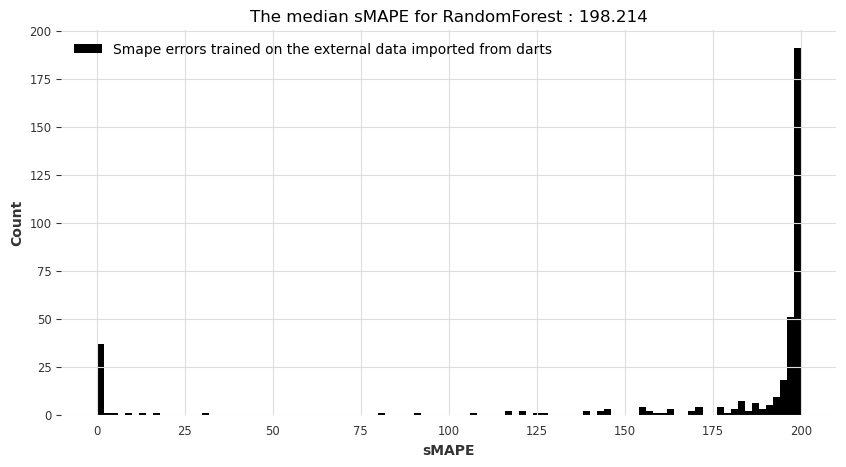

Visualization of performances taking the mean of the smapes over cross-validation


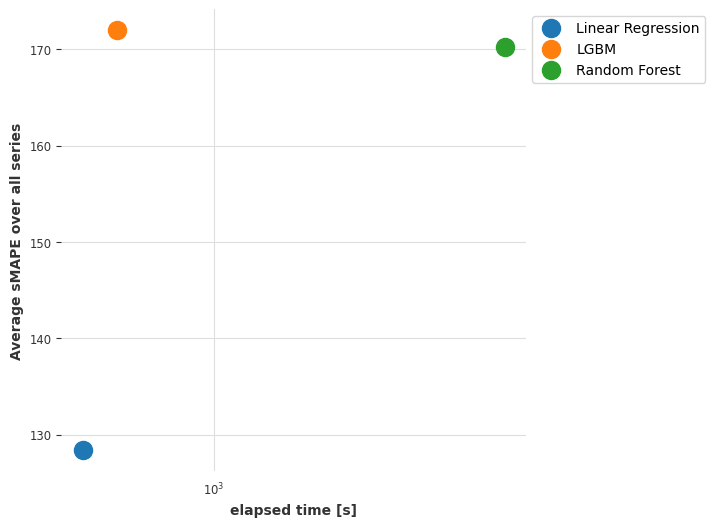

Visualization of performances taking the median of the smapes over cross-validation


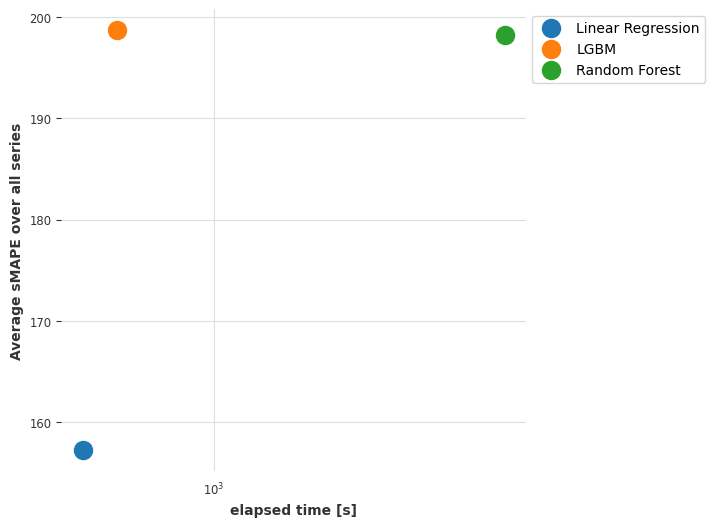

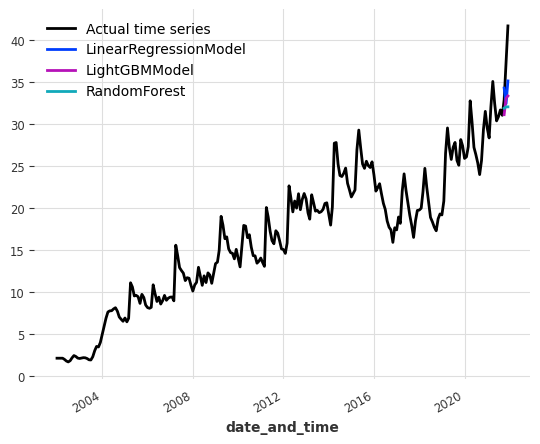

The results for index_colab_notincrem with an horizon of 6 are:


[I 2023-01-31 11:25:41,902] A new study created in memory with name: no-name-d02e7000-188e-405c-91b2-171ac9515b16
[I 2023-01-31 11:26:11,071] Trial 0 finished with value: 93.89316288142831 and parameters: {'out_len': 5}. Best is trial 0 with value: 93.89316288142831.
[I 2023-01-31 11:26:39,546] Trial 1 finished with value: 96.94572039695078 and parameters: {'out_len': 9}. Best is trial 0 with value: 93.89316288142831.
[I 2023-01-31 11:27:06,932] Trial 2 finished with value: 93.29300624625047 and parameters: {'out_len': 3}. Best is trial 2 with value: 93.29300624625047.
[I 2023-01-31 11:28:05,244] Trial 3 finished with value: 92.14409499524095 and parameters: {'out_len': 4}. Best is trial 3 with value: 92.14409499524095.
[I 2023-01-31 11:29:31,929] Trial 4 finished with value: 90.77230764572212 and parameters: {'out_len': 8}. Best is trial 4 with value: 90.77230764572212.
[I 2023-01-31 11:30:37,077] Trial 5 finished with value: 93.89316288142831 and parameters: {'out_len': 5}. Best is t

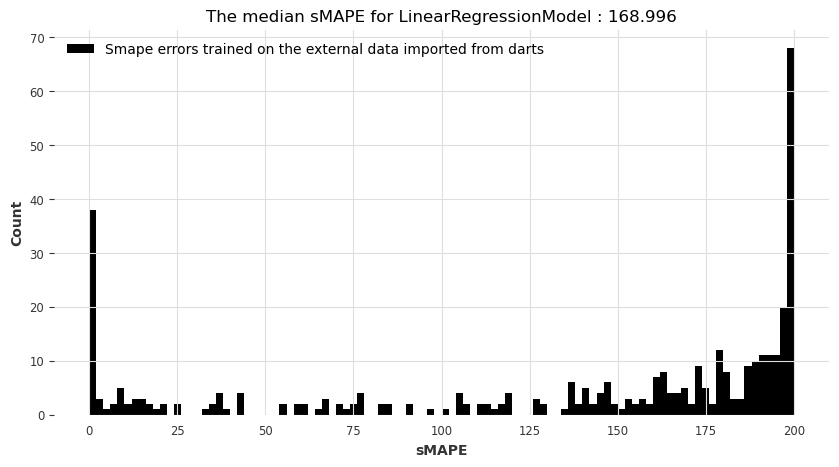

[I 2023-01-31 11:48:27,096] A new study created in memory with name: no-name-8cae0e1b-56dd-4cdc-b0ac-599bc6081192
[I 2023-01-31 11:49:18,539] Trial 0 finished with value: 60.442863566477286 and parameters: {'out_len': 8}. Best is trial 0 with value: 60.442863566477286.
[I 2023-01-31 11:50:10,947] Trial 1 finished with value: 60.82972305128614 and parameters: {'out_len': 10}. Best is trial 0 with value: 60.442863566477286.
[I 2023-01-31 11:50:59,083] Trial 2 finished with value: 60.31211637282711 and parameters: {'out_len': 6}. Best is trial 2 with value: 60.31211637282711.
[I 2023-01-31 11:51:44,617] Trial 3 finished with value: 60.31211637282711 and parameters: {'out_len': 6}. Best is trial 2 with value: 60.31211637282711.
[I 2023-01-31 11:52:31,368] Trial 4 finished with value: 58.93311433846191 and parameters: {'out_len': 5}. Best is trial 4 with value: 58.93311433846191.
[I 2023-01-31 11:53:16,985] Trial 5 finished with value: 60.07258718991188 and parameters: {'out_len': 4}. Best 

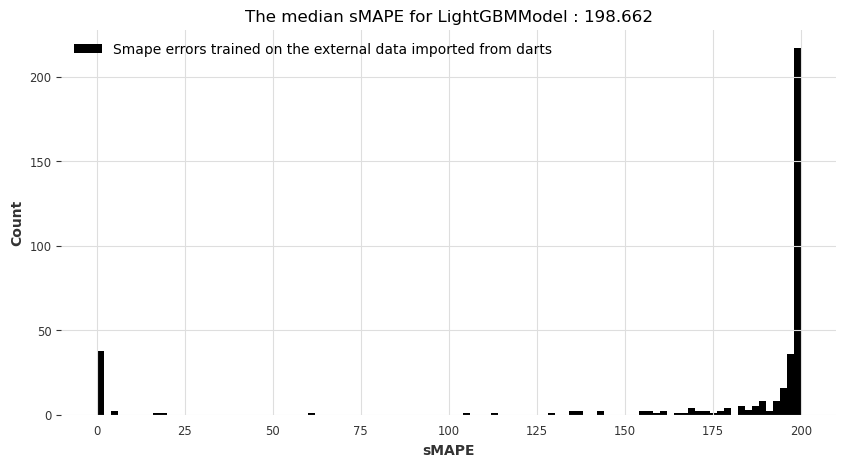

[I 2023-01-31 12:03:26,426] A new study created in memory with name: no-name-da4777ee-4814-47e7-9b1b-b288d1a45d4f
[I 2023-01-31 12:04:18,470] Trial 0 finished with value: 58.70913466610842 and parameters: {'out_len': 11, 'n_estimators': 55, 'max_depth': 11}. Best is trial 0 with value: 58.70913466610842.
[I 2023-01-31 12:05:19,694] Trial 1 finished with value: 56.8083561194585 and parameters: {'out_len': 11, 'n_estimators': 75, 'max_depth': 14}. Best is trial 1 with value: 56.8083561194585.
[I 2023-01-31 12:06:17,587] Trial 2 finished with value: 56.97024506243169 and parameters: {'out_len': 10, 'n_estimators': 57, 'max_depth': 13}. Best is trial 1 with value: 56.8083561194585.
[I 2023-01-31 12:07:28,988] Trial 3 finished with value: 54.61826697085989 and parameters: {'out_len': 9, 'n_estimators': 66, 'max_depth': 20}. Best is trial 3 with value: 54.61826697085989.
[I 2023-01-31 12:08:33,801] Trial 4 finished with value: 66.50458664191815 and parameters: {'out_len': 5, 'n_estimators': 

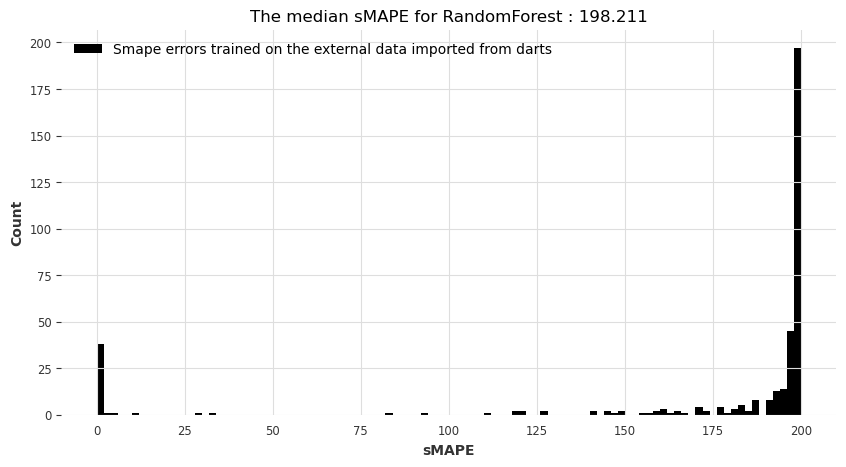

Visualization of performances taking the mean of the smapes over cross-validation


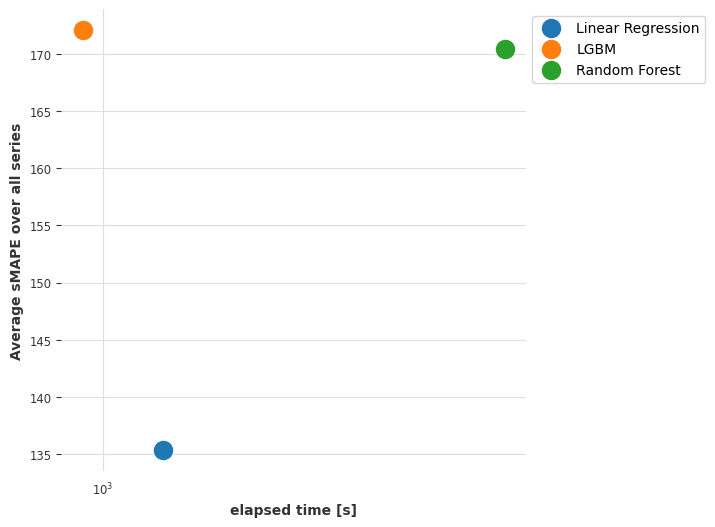

Visualization of performances taking the median of the smapes over cross-validation


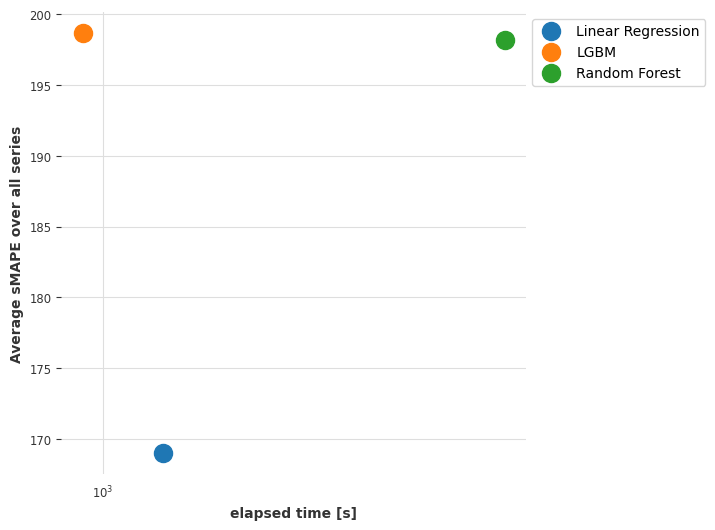

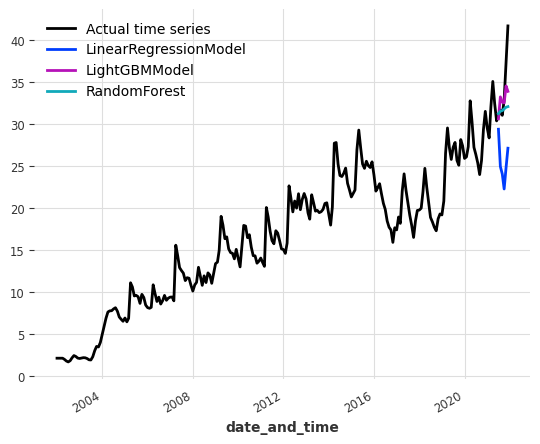

The results for index_colab_notincrem with an horizon of 12 are:


[I 2023-01-31 14:18:30,525] A new study created in memory with name: no-name-c0ba9f9e-c5a2-4740-8601-fc39cb210ae8
[I 2023-01-31 14:18:57,743] Trial 0 finished with value: 113.40036589601942 and parameters: {'out_len': 2}. Best is trial 0 with value: 113.40036589601942.
[I 2023-01-31 14:19:22,706] Trial 1 finished with value: 110.09818184374726 and parameters: {'out_len': 6}. Best is trial 1 with value: 110.09818184374726.
[I 2023-01-31 14:19:49,847] Trial 2 finished with value: 105.24063384080301 and parameters: {'out_len': 9}. Best is trial 2 with value: 105.24063384080301.
[I 2023-01-31 14:20:16,757] Trial 3 finished with value: 103.43566342164651 and parameters: {'out_len': 11}. Best is trial 3 with value: 103.43566342164651.
[I 2023-01-31 14:20:45,389] Trial 4 finished with value: 109.0047612046828 and parameters: {'out_len': 7}. Best is trial 3 with value: 103.43566342164651.
[I 2023-01-31 14:21:11,992] Trial 5 finished with value: 109.0047612046828 and parameters: {'out_len': 7}.

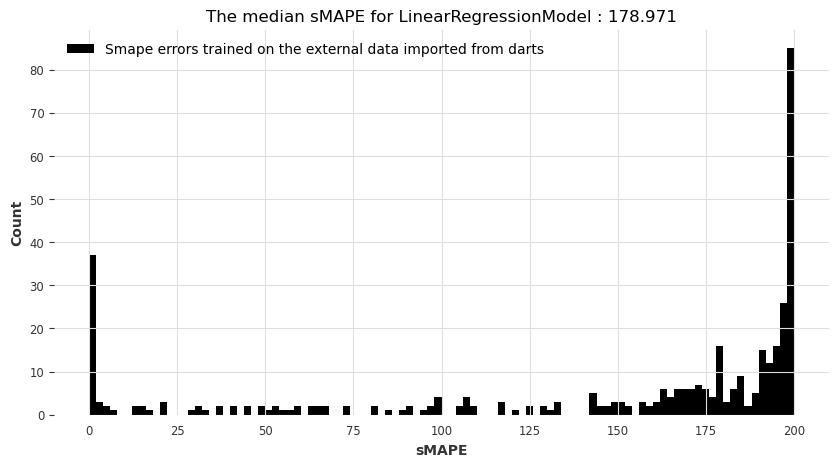

[I 2023-01-31 14:26:54,838] A new study created in memory with name: no-name-9383d6ca-534c-482a-9c70-e8dfc0e752dc
[I 2023-01-31 14:27:14,968] Trial 0 finished with value: 72.08755552922433 and parameters: {'out_len': 1}. Best is trial 0 with value: 72.08755552922433.
[I 2023-01-31 14:27:39,481] Trial 1 finished with value: 69.42504489867162 and parameters: {'out_len': 5}. Best is trial 1 with value: 69.42504489867162.
[I 2023-01-31 14:28:03,729] Trial 2 finished with value: 68.76245724110522 and parameters: {'out_len': 3}. Best is trial 2 with value: 68.76245724110522.
[I 2023-01-31 14:28:31,257] Trial 3 finished with value: 69.72273443564774 and parameters: {'out_len': 4}. Best is trial 2 with value: 68.76245724110522.
[I 2023-01-31 14:29:13,443] Trial 4 finished with value: 71.89637951592016 and parameters: {'out_len': 9}. Best is trial 2 with value: 68.76245724110522.
[I 2023-01-31 14:29:40,950] Trial 5 finished with value: 69.72273443564774 and parameters: {'out_len': 4}. Best is t

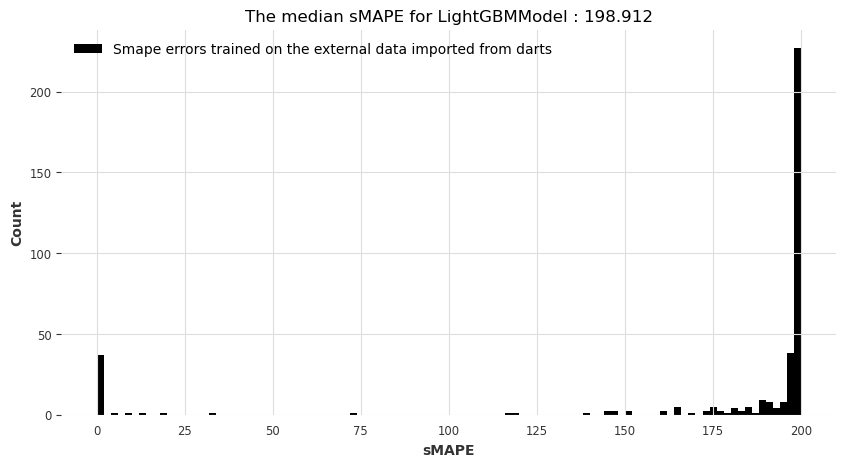

[I 2023-01-31 14:37:03,938] A new study created in memory with name: no-name-77732d5a-12cf-4ef7-a107-f4f3d59cdc8e
[I 2023-01-31 14:37:54,350] Trial 0 finished with value: 68.05869583806376 and parameters: {'out_len': 8, 'n_estimators': 81, 'max_depth': 17}. Best is trial 0 with value: 68.05869583806376.
[I 2023-01-31 14:39:03,631] Trial 1 finished with value: 63.28268683598002 and parameters: {'out_len': 2, 'n_estimators': 83, 'max_depth': 25}. Best is trial 1 with value: 63.28268683598002.
[I 2023-01-31 14:39:52,205] Trial 2 finished with value: 65.92723759781833 and parameters: {'out_len': 3, 'n_estimators': 55, 'max_depth': 19}. Best is trial 1 with value: 63.28268683598002.
[I 2023-01-31 14:41:03,280] Trial 3 finished with value: 65.6379941938248 and parameters: {'out_len': 3, 'n_estimators': 97, 'max_depth': 15}. Best is trial 1 with value: 63.28268683598002.
[I 2023-01-31 14:41:48,297] Trial 4 finished with value: 70.29609139598286 and parameters: {'out_len': 1, 'n_estimators': 5

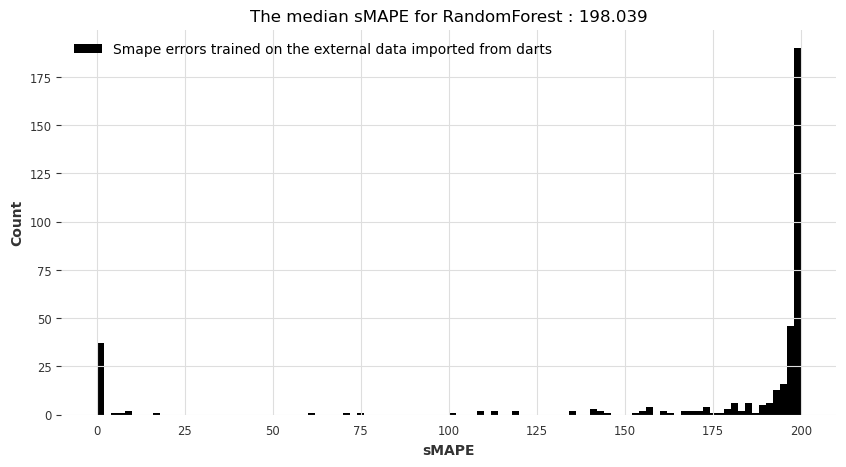

Visualization of performances taking the mean of the smapes over cross-validation


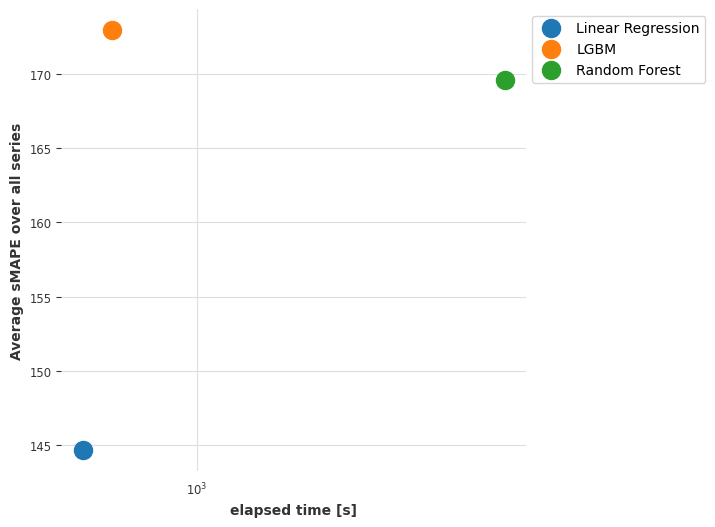

Visualization of performances taking the median of the smapes over cross-validation


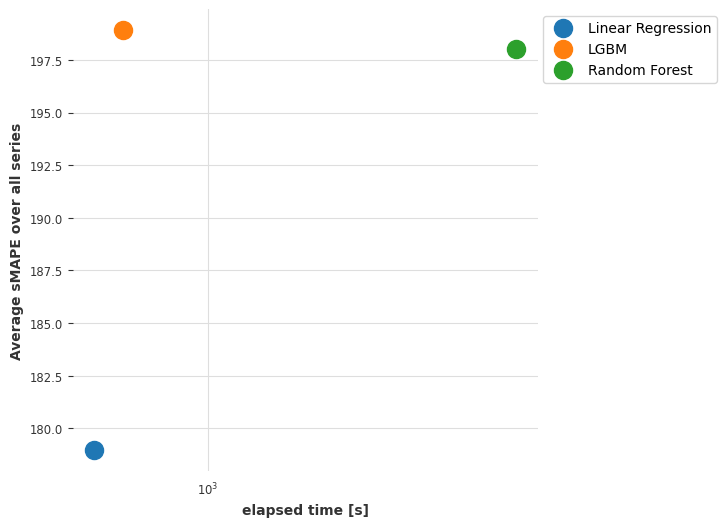

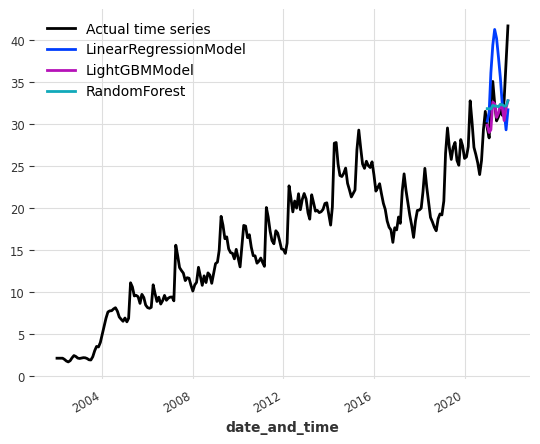

The results for index_keyword are:
The results for index_keyword with an horizon of 3 are:


[I 2023-01-31 16:20:57,646] A new study created in memory with name: no-name-78901a02-9001-4bd3-98e3-7d693524c2e7
[I 2023-01-31 16:21:27,363] Trial 0 finished with value: 9.618950267810979 and parameters: {'out_len': 2}. Best is trial 0 with value: 9.618950267810979.
[I 2023-01-31 16:21:58,691] Trial 1 finished with value: 8.988669648626848 and parameters: {'out_len': 8}. Best is trial 1 with value: 8.988669648626848.
[I 2023-01-31 16:22:27,610] Trial 2 finished with value: 8.988669648626848 and parameters: {'out_len': 8}. Best is trial 1 with value: 8.988669648626848.
[I 2023-01-31 16:22:53,807] Trial 3 finished with value: 9.618950267810979 and parameters: {'out_len': 2}. Best is trial 1 with value: 8.988669648626848.
[I 2023-01-31 16:23:23,833] Trial 4 finished with value: 11.204838391946094 and parameters: {'out_len': 12}. Best is trial 1 with value: 8.988669648626848.
[I 2023-01-31 16:23:50,816] Trial 5 finished with value: 8.062289436665104 and parameters: {'out_len': 9}. Best is

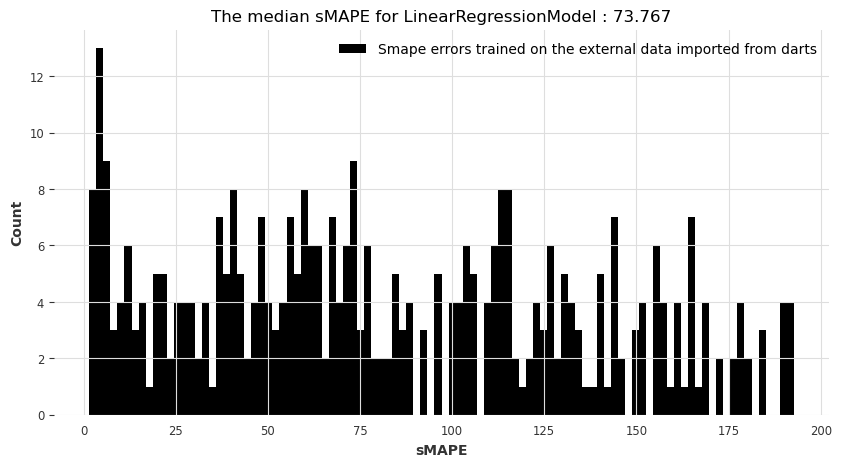

[I 2023-01-31 16:31:30,254] A new study created in memory with name: no-name-db4a1a69-f31a-45d5-8e97-42a24ee5f794
[I 2023-01-31 16:32:04,561] Trial 0 finished with value: 8.405926483598076 and parameters: {'out_len': 9}. Best is trial 0 with value: 8.405926483598076.
[I 2023-01-31 16:32:45,255] Trial 1 finished with value: 9.209252218426089 and parameters: {'out_len': 12}. Best is trial 0 with value: 8.405926483598076.
[I 2023-01-31 16:33:18,403] Trial 2 finished with value: 7.907966266122314 and parameters: {'out_len': 6}. Best is trial 2 with value: 7.907966266122314.
[I 2023-01-31 16:33:54,521] Trial 3 finished with value: 6.993862938249917 and parameters: {'out_len': 1}. Best is trial 3 with value: 6.993862938249917.
[I 2023-01-31 16:34:34,851] Trial 4 finished with value: 7.628957466892775 and parameters: {'out_len': 4}. Best is trial 3 with value: 6.993862938249917.
[I 2023-01-31 16:34:59,301] Trial 5 finished with value: 6.993862938249917 and parameters: {'out_len': 1}. Best is 

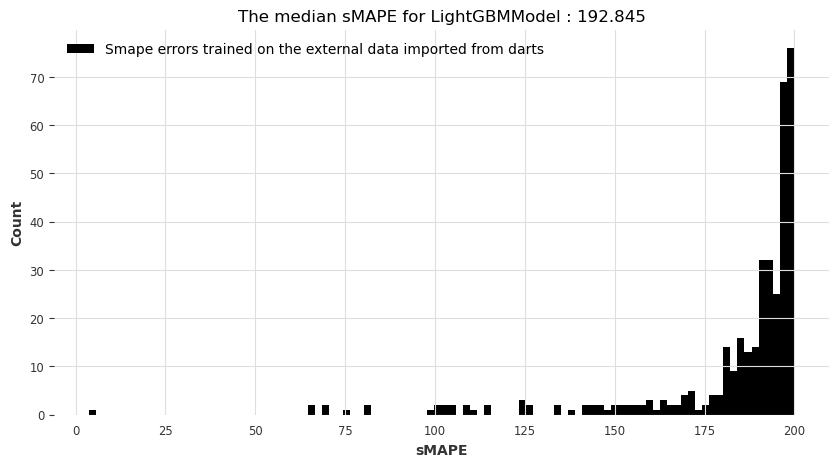

[I 2023-01-31 16:43:01,461] A new study created in memory with name: no-name-f7063bc8-d7f7-43ee-9022-62ce5dfed398
[I 2023-01-31 16:44:00,953] Trial 0 finished with value: 8.65701299487729 and parameters: {'out_len': 10, 'n_estimators': 72, 'max_depth': 18}. Best is trial 0 with value: 8.65701299487729.
[I 2023-01-31 16:44:49,626] Trial 1 finished with value: 9.370294136818448 and parameters: {'out_len': 12, 'n_estimators': 76, 'max_depth': 13}. Best is trial 0 with value: 8.65701299487729.
[I 2023-01-31 16:46:07,180] Trial 2 finished with value: 7.31568047689271 and parameters: {'out_len': 1, 'n_estimators': 63, 'max_depth': 21}. Best is trial 2 with value: 7.31568047689271.
[I 2023-01-31 16:47:09,422] Trial 3 finished with value: 8.613387378438803 and parameters: {'out_len': 10, 'n_estimators': 86, 'max_depth': 12}. Best is trial 2 with value: 7.31568047689271.
[I 2023-01-31 16:48:48,194] Trial 4 finished with value: 7.270902375988401 and parameters: {'out_len': 1, 'n_estimators': 62,

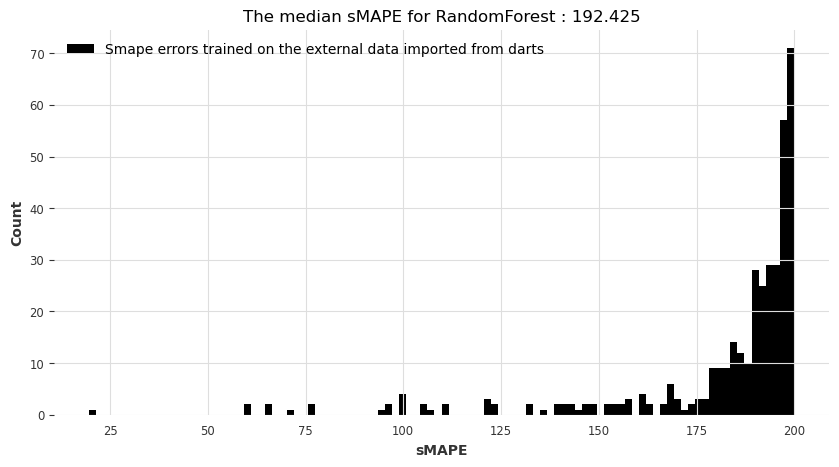

Visualization of performances taking the mean of the smapes over cross-validation


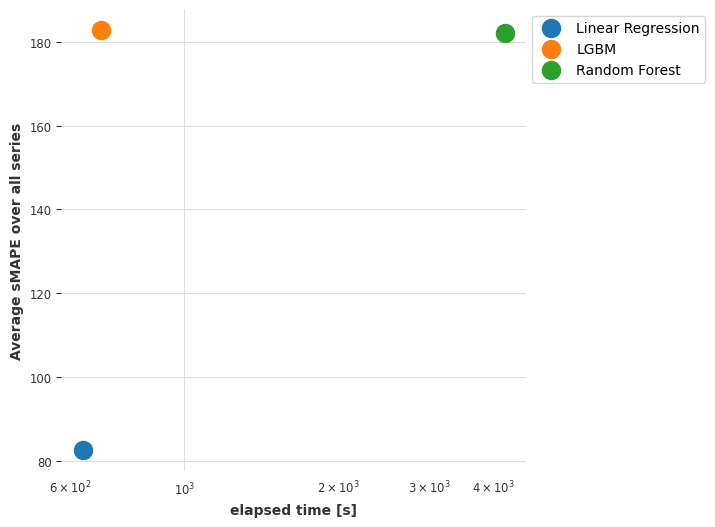

Visualization of performances taking the median of the smapes over cross-validation


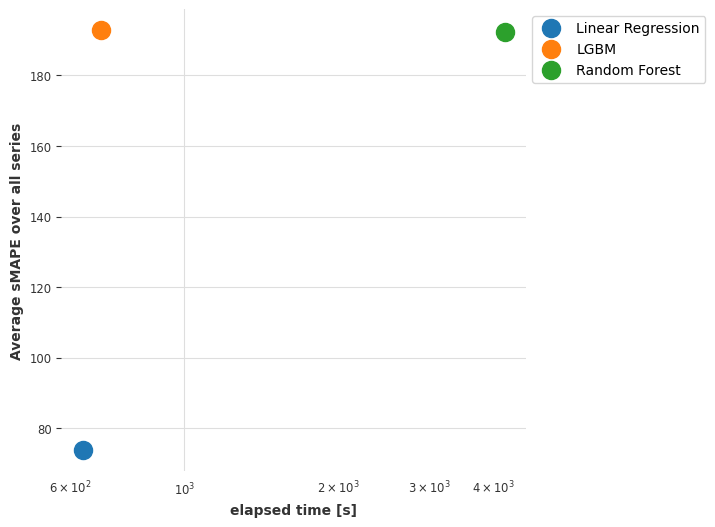

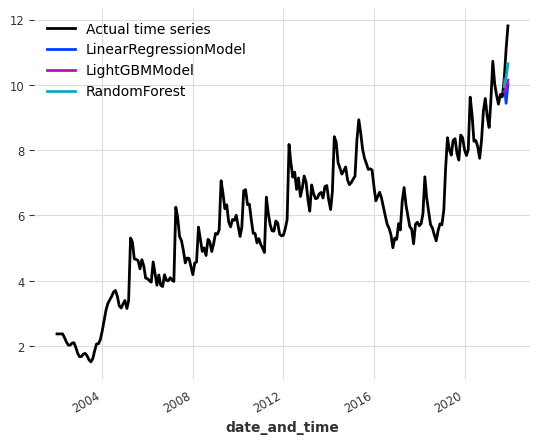

The results for index_keyword with an horizon of 6 are:


[I 2023-01-31 17:53:21,084] A new study created in memory with name: no-name-b8a27abb-4835-4b39-be86-65c96f4149ea
[I 2023-01-31 17:53:43,501] Trial 0 finished with value: 14.231398421841032 and parameters: {'out_len': 3}. Best is trial 0 with value: 14.231398421841032.
[I 2023-01-31 17:54:06,179] Trial 1 finished with value: 15.485256271886948 and parameters: {'out_len': 9}. Best is trial 0 with value: 14.231398421841032.
[I 2023-01-31 17:54:28,555] Trial 2 finished with value: 19.071932571637074 and parameters: {'out_len': 11}. Best is trial 0 with value: 14.231398421841032.
[I 2023-01-31 17:54:53,008] Trial 3 finished with value: 16.470269674644285 and parameters: {'out_len': 10}. Best is trial 0 with value: 14.231398421841032.
[I 2023-01-31 17:55:18,338] Trial 4 finished with value: 14.518914167194094 and parameters: {'out_len': 6}. Best is trial 0 with value: 14.231398421841032.
[I 2023-01-31 17:55:40,330] Trial 5 finished with value: 14.673477106466185 and parameters: {'out_len': 

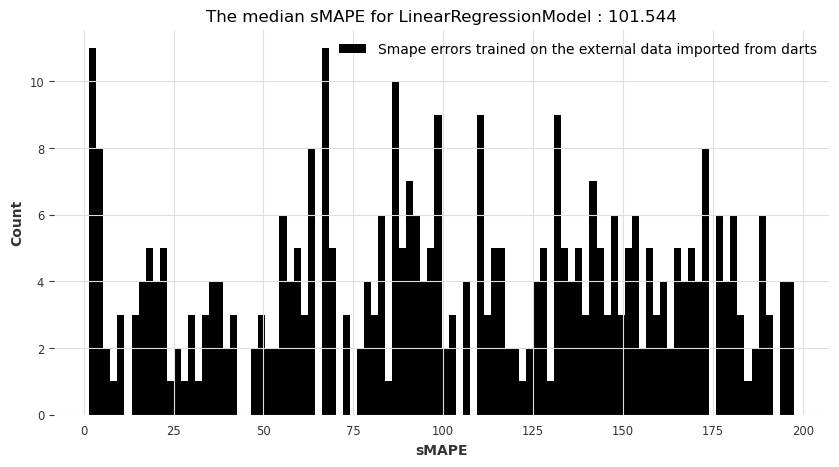

[I 2023-01-31 18:01:08,813] A new study created in memory with name: no-name-c61915b2-e65e-4970-ac89-67b267e13ded
[I 2023-01-31 18:01:42,137] Trial 0 finished with value: 11.318285046900474 and parameters: {'out_len': 12}. Best is trial 0 with value: 11.318285046900474.
[I 2023-01-31 18:02:11,522] Trial 1 finished with value: 9.805725550699051 and parameters: {'out_len': 9}. Best is trial 1 with value: 9.805725550699051.
[I 2023-01-31 18:02:41,311] Trial 2 finished with value: 9.805725550699051 and parameters: {'out_len': 9}. Best is trial 1 with value: 9.805725550699051.
[I 2023-01-31 18:03:10,080] Trial 3 finished with value: 9.21029167515124 and parameters: {'out_len': 1}. Best is trial 3 with value: 9.21029167515124.
[I 2023-01-31 18:03:35,075] Trial 4 finished with value: 8.982343093962559 and parameters: {'out_len': 3}. Best is trial 4 with value: 8.982343093962559.
[I 2023-01-31 18:04:15,518] Trial 5 finished with value: 9.904832539609192 and parameters: {'out_len': 7}. Best is 

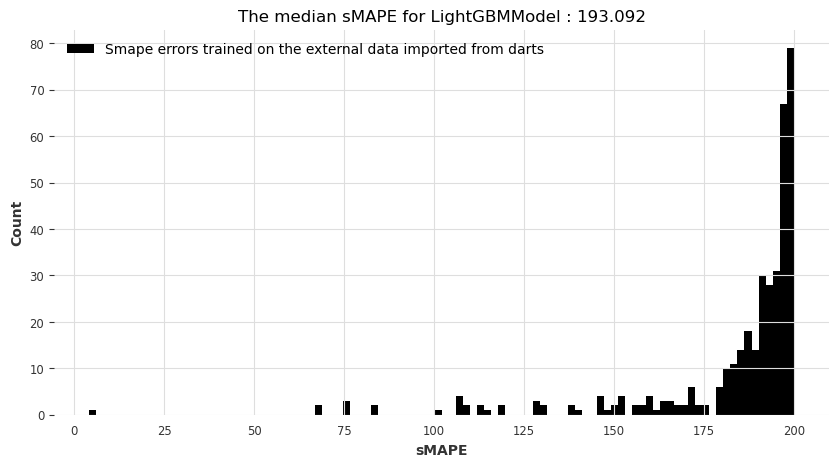

[I 2023-01-31 18:11:13,141] A new study created in memory with name: no-name-5d3a1f35-5cba-4a33-a88c-6f4d0ab27f51
[I 2023-01-31 18:12:12,979] Trial 0 finished with value: 8.982117124338954 and parameters: {'out_len': 5, 'n_estimators': 94, 'max_depth': 10}. Best is trial 0 with value: 8.982117124338954.
[I 2023-01-31 18:13:20,021] Trial 1 finished with value: 9.469238491670724 and parameters: {'out_len': 1, 'n_estimators': 90, 'max_depth': 9}. Best is trial 0 with value: 8.982117124338954.
[I 2023-01-31 18:14:01,922] Trial 2 finished with value: 10.934009867502146 and parameters: {'out_len': 10, 'n_estimators': 62, 'max_depth': 21}. Best is trial 0 with value: 8.982117124338954.
[I 2023-01-31 18:15:05,858] Trial 3 finished with value: 9.61583847545 and parameters: {'out_len': 1, 'n_estimators': 57, 'max_depth': 12}. Best is trial 0 with value: 8.982117124338954.
[I 2023-01-31 18:16:07,328] Trial 4 finished with value: 9.766220474849277 and parameters: {'out_len': 7, 'n_estimators': 87,

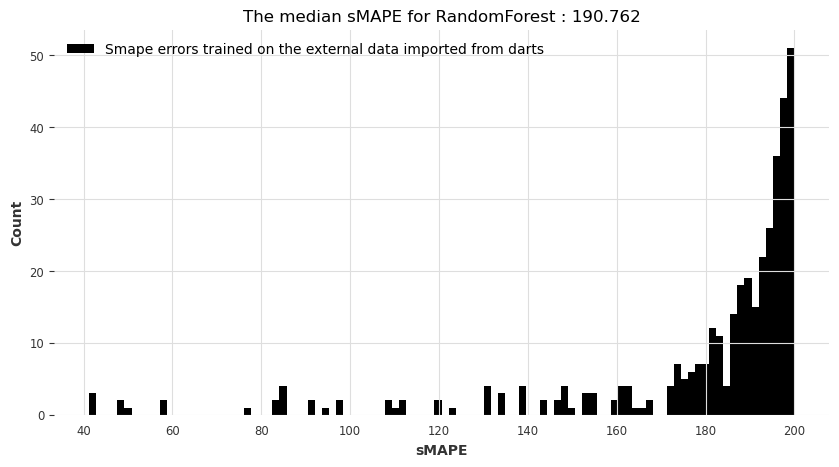

Visualization of performances taking the mean of the smapes over cross-validation


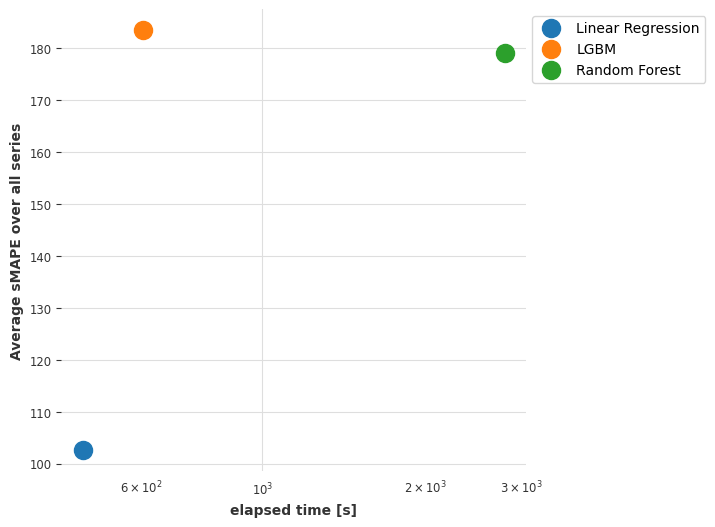

Visualization of performances taking the median of the smapes over cross-validation


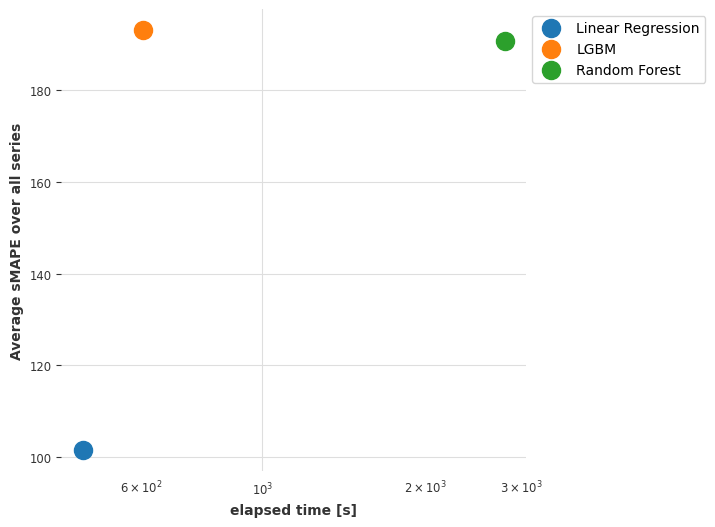

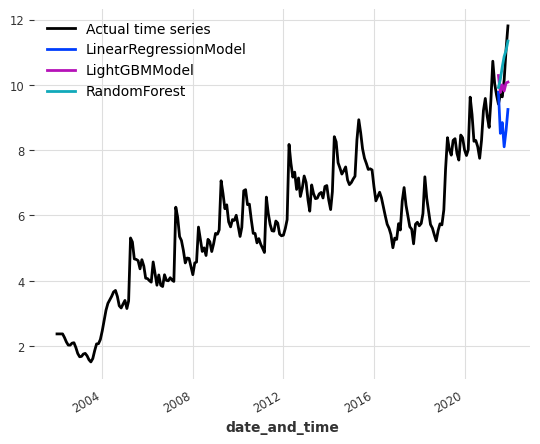

The results for index_keyword with an horizon of 12 are:


[I 2023-01-31 18:57:54,881] A new study created in memory with name: no-name-b13c53f4-2d61-4229-ab70-c6d7b5aa94a1
[I 2023-01-31 18:58:14,656] Trial 0 finished with value: 22.246834256102265 and parameters: {'out_len': 12}. Best is trial 0 with value: 22.246834256102265.
[I 2023-01-31 18:58:33,412] Trial 1 finished with value: 16.421099081888165 and parameters: {'out_len': 6}. Best is trial 1 with value: 16.421099081888165.
[I 2023-01-31 18:58:52,326] Trial 2 finished with value: 17.89419609866612 and parameters: {'out_len': 8}. Best is trial 1 with value: 16.421099081888165.
[I 2023-01-31 18:59:10,374] Trial 3 finished with value: 16.603442011710214 and parameters: {'out_len': 3}. Best is trial 1 with value: 16.421099081888165.
[I 2023-01-31 18:59:29,278] Trial 4 finished with value: 16.603442011710214 and parameters: {'out_len': 3}. Best is trial 1 with value: 16.421099081888165.
[I 2023-01-31 18:59:47,766] Trial 5 finished with value: 18.964624714792492 and parameters: {'out_len': 1}

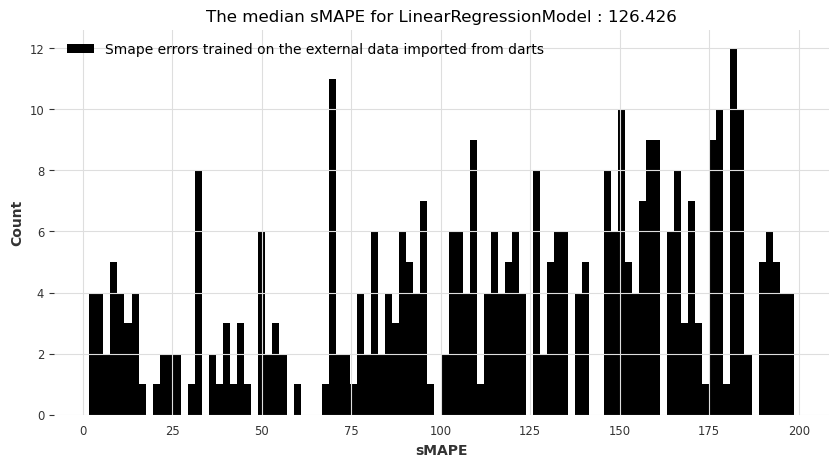

[I 2023-01-31 19:04:25,627] A new study created in memory with name: no-name-d59ab5ec-449a-48b2-969b-bad1c50c6274
[I 2023-01-31 19:04:50,466] Trial 0 finished with value: 11.347710051690273 and parameters: {'out_len': 8}. Best is trial 0 with value: 11.347710051690273.
[I 2023-01-31 19:05:10,054] Trial 1 finished with value: 10.878611589671635 and parameters: {'out_len': 1}. Best is trial 1 with value: 10.878611589671635.
[I 2023-01-31 19:05:34,502] Trial 2 finished with value: 11.347710051690273 and parameters: {'out_len': 8}. Best is trial 1 with value: 10.878611589671635.
[I 2023-01-31 19:05:56,883] Trial 3 finished with value: 10.994470717501825 and parameters: {'out_len': 4}. Best is trial 1 with value: 10.878611589671635.
[I 2023-01-31 19:06:18,025] Trial 4 finished with value: 11.128731139302293 and parameters: {'out_len': 3}. Best is trial 1 with value: 10.878611589671635.
[I 2023-01-31 19:06:44,439] Trial 5 finished with value: 10.967593479275838 and parameters: {'out_len': 10

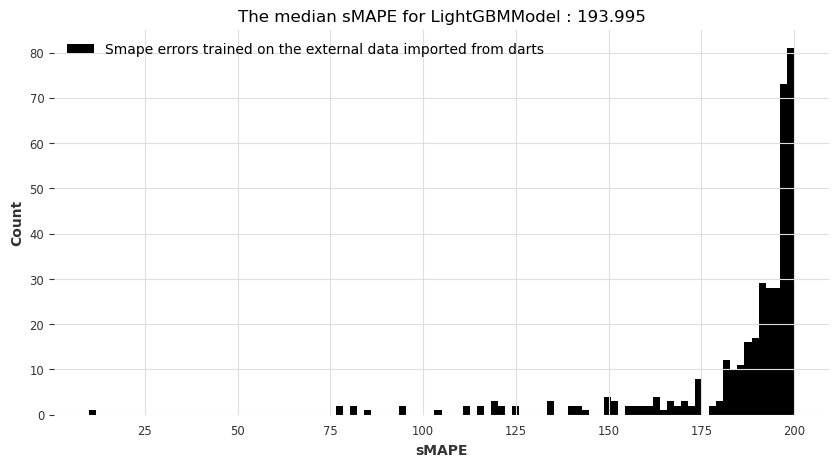

[I 2023-01-31 19:12:36,351] A new study created in memory with name: no-name-dfa5d07d-cbe1-49eb-9aec-b6ebafa32fea
[I 2023-01-31 19:13:20,542] Trial 0 finished with value: 11.659051874105575 and parameters: {'out_len': 6, 'n_estimators': 67, 'max_depth': 13}. Best is trial 0 with value: 11.659051874105575.
[I 2023-01-31 19:14:07,945] Trial 1 finished with value: 12.300813757606448 and parameters: {'out_len': 1, 'n_estimators': 54, 'max_depth': 15}. Best is trial 0 with value: 11.659051874105575.
[I 2023-01-31 19:14:33,171] Trial 2 finished with value: 12.934894132584901 and parameters: {'out_len': 12, 'n_estimators': 76, 'max_depth': 5}. Best is trial 0 with value: 11.659051874105575.
[I 2023-01-31 19:15:12,039] Trial 3 finished with value: 11.262700989861266 and parameters: {'out_len': 8, 'n_estimators': 84, 'max_depth': 10}. Best is trial 3 with value: 11.262700989861266.
[I 2023-01-31 19:15:53,108] Trial 4 finished with value: 11.325786853748113 and parameters: {'out_len': 7, 'n_esti

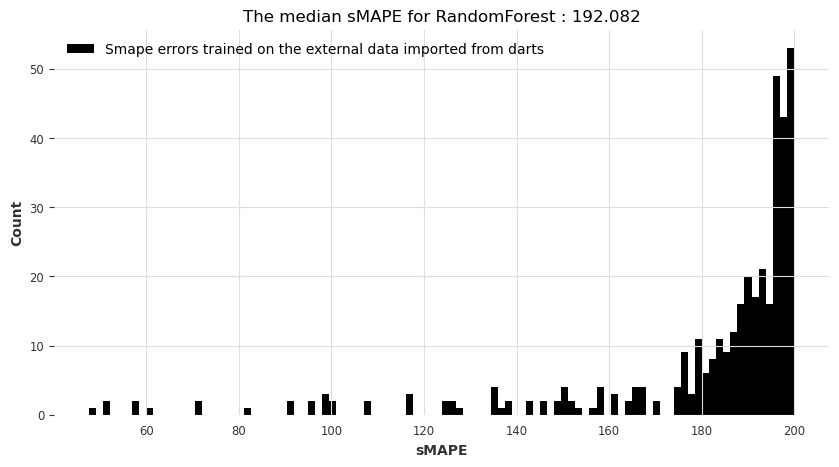

Visualization of performances taking the mean of the smapes over cross-validation


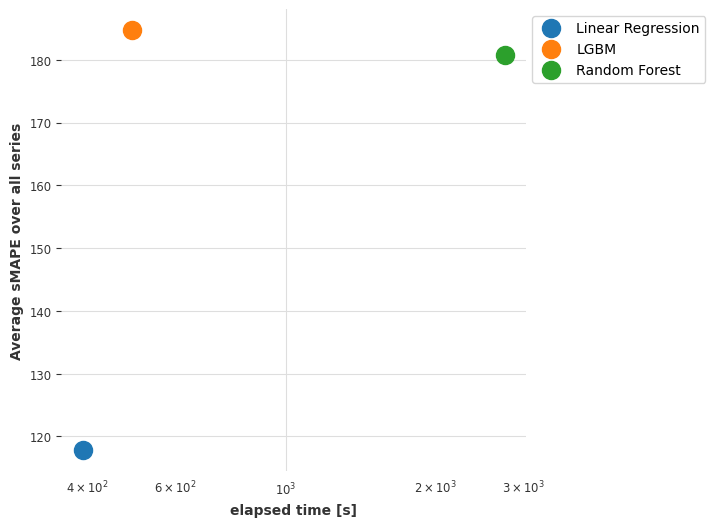

Visualization of performances taking the median of the smapes over cross-validation


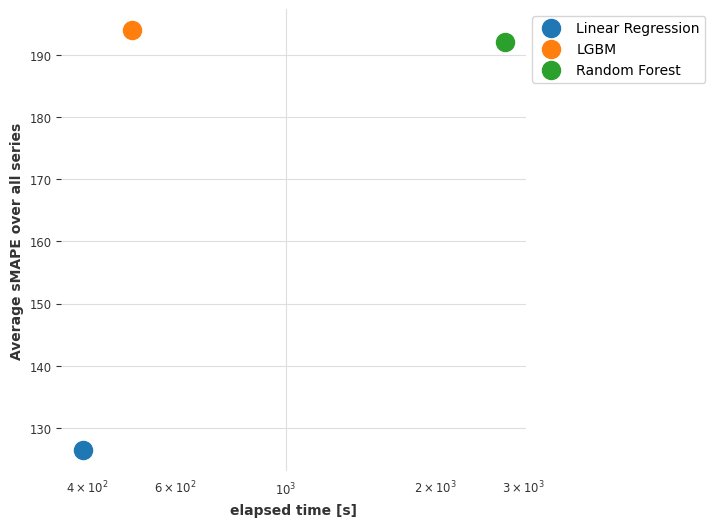

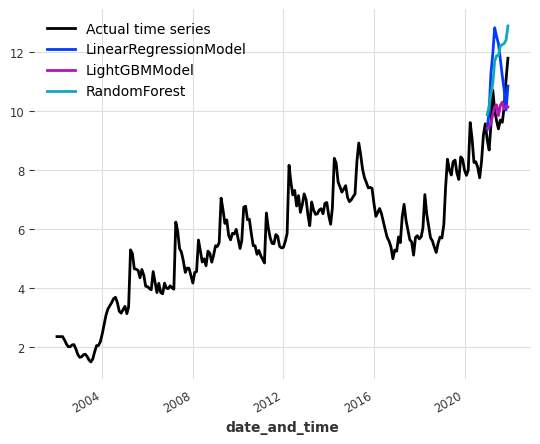

In [73]:
info_table = []

global horizon

for index in list_indices:
    dfofindex = dftm.loc[dftm['indextype']==index]
    print('The results for '+str(index)+' are:')
    listindex_byalgo=[]
 
    for horizon in [3,6,12]:
        print('The results for '+str(index)+' with an horizon of '+str(horizon)+' are:')
        lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean\
        =transfer_forecasting_mydata(external_data,dfofindex,horizon,list_concepts,1,15)
        
        listindex_byalgo=listindex_byalgo+\
        [lr_smapes_mean,lgbm_smapes_mean,rf_smapes_mean]
        
        plot_forecasting_models_global(modelnames,myforecasters,dfofindex,horizon,index) 
    
    list_toappend=[]    
    for i in range(3):
        for j in range(3):
            list_toappend.append(listindex_byalgo[i+j*3])
    info_table.append(list_toappend)

In [74]:
iterables = [["Linear Regression","LGBM", "Random Forest"], ["3 months", "6 months","12 months"]]

index = pd.MultiIndex.from_product(iterables, names=["Forecaster algorithm", "Forecasting horizon"])

df = pd.DataFrame({'Index citations t1-t2':info_table[0], 'Index citations t2-t1': info_table[1],
                   'Index colaboration incremental': info_table[2],'colaboration not incremental':info_table[3],
                   'Index keywords': info_table[4]}, index=index)
df

Index citations t1-t2  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                         91.063930   
                     6 months                         92.061407   
                     12 months                        94.809418   
LGBM                 3 months                         98.478667   
                     6 months                         98.500089   
                     12 months                        98.625046   
Random Forest        3 months                         98.189957   
                     6 months                         98.032974   
                     12 months                        98.312557   

                                          Index citations t2-t1  \
Forecaster algorithm Forecasting horizon                          
Linear Regression    3 months                         90.194964   
                     6 months                         91.442759   
                     12 months                        94.326306   
LGBM                 3 months                         97.931304   
                     6 months                         97.934869   
                     12 months                        98.088434   
Random Forest        3 months                         97.625732   
                     6 months                         97.702612   
                     12 months                        97.674448   

                                          Index colaboration incremental  \
Forecaster algorithm Forecasting horizon                                   
Linear Regression    3 months                                 107.992110   
                     6 months                                 118.682142   
                     12 months                                128.147511   
LGBM                 3 months                                 165.793448   
                     6 months                                 166.265829   
                     12 months                                167.358727   
Random Forest        3 months                                 164.160585   
                     6 months                                 161.823147   
                     12 months                                160.161062   

                                          colaboration not incremental  \
Forecaster algorithm Forecasting horizon                                 
Linear Regression    3 months                               128.385926   
                     6 months                               135.367419   
                     12 months                              144.676721   
LGBM                 3 months                               171.978842   
                     6 months                               172.054830   
                     12 months                              172.941600   
Random Forest        3 months                               170.194079   
                     6 months                               170.404026   
                     12 months                              169.590110   

                                          Index keywords  
Forecaster algorithm Forecasting horizon                  
Linear Regression    3 months                  82.520245  
                     6 months                 102.587858  
                     12 months                117.819539  
LGBM                 3 months                 182.815071  
                     6 months                 183.465655  
                     12 months                184.714365  
Random Forest        3 months                 182.063762  
                     6 months                 178.982197  
                     12 months                180.760350